# Deep Learning

## Assignment - 1

### Question 1:
### Gradient Descent And Varients 1

Our first task is to optimize the Rosebrock function using SGD. First let us visualise the functions contour plot.

In [1]:
import matplotlib.pyplot as plt
import numpy as np

In [2]:
def rosenbrock(x, y):
    return 100*(y - x**2)**2 + (x)**2

def gradient_x(params1, params2):
    return (2*params1) - (400*(params2 - (params1**2))*params1)
  
def gradient_y(params1, params2):
    return 200*(params2 - (params1**2))

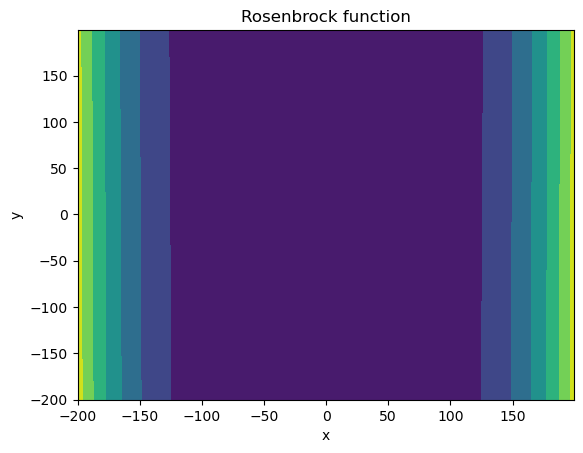

In [3]:
x = np.arange(-200, 200)
y = np.arange(-200, 200)

[X, Y] = np.meshgrid(x, y)

Rosenbrock = rosenbrock(X, Y)

plt.contourf(X, Y, Rosenbrock)
plt.xlabel('x')
plt.ylabel('y')
plt.title('Rosenbrock function')
plt.show()

Now we will initialise the parameters to a random value and then compute the gradient with respect to x and y

Now we will perform the gradient descent algorithm to obtain the global minimum and show the path of the descent

In [ ]:
# SGD
np.random.seed(42)
params = np.random.rand(2, 1)*100
step_size = 0.000001
epsilon = 0.00001

dx = gradient_x(params[0], params[1]) # Gradient with respect to x computed by hand
dy = gradient_y(params[0], params[1]) # Gradient with respect to y computed by hand

final_gradient = np.array([dx, dy])
initial_gradient = np.array([[0],[0]])

while np.all(step_size*abs(final_gradient - initial_gradient) > epsilon) :
    initial_gradient = final_gradient
    paramsf = params - step_size*initial_gradient # Taking a step in the direction of the gradient
 
    dx = gradient_x(paramsf[0], paramsf[1]) #Obtaining the new gradient values
    dy = gradient_y(paramsf[0], paramsf[1])

    final_gradient = np.array([dx, dy])
    print('-------')
    print('Initial Coordinates:')
    print(params)
    print('Final Coordinates:')
    print(paramsf)
    print('Gradient:')
    print(initial_gradient)
    
    plt.figure()
    plt.contourf(X, Y, Rosenbrock)
    plt.arrow(np.squeeze(params[0]), np.squeeze(params[1]), np.squeeze(paramsf[0] - params[0]), np.squeeze(paramsf[1] - params[1]), head_width = 2, width = 0.3, ec = 'white')
    plt.xlabel('x')
    plt.ylabel('y')
    plt.title('Rosenbrock function')
    plt.show()

    params = paramsf

We can observe that the step it takes at every iteration keeps decreasing as the gradient at that point starts to decrease slowly and at one point the change in the gradient is so small that we stop the computation. We observe that the y coordinate does not change as much while the x coordinate goes till 9.7 and stops. This is not the most optimal value for the optimization problem but we can achieve better results from the other optimization methods done below

Now we will attempt to Optimize the above function using the momentum optimization which will be implemented below.

In [ ]:
# Momentum
np.random.seed(42)
params = np.random.rand(2, 1)*100
beta = 0.99
step_size = 0.00002
epsilon = 0.0005

dx = gradient_x(params[0], params[1]) # Gradient with respect to x computed by hand
dy = gradient_y(params[0], params[1]) # Gradient with respect to y computed by hand

final_gradient = np.array([dx, dy])
initial_gradient = np.array([[0],[0]])

Vdw = 0.0

while np.all(step_size*abs(final_gradient - initial_gradient) > epsilon) :
    initial_gradient = final_gradient
    Vdw = beta*Vdw + (1-beta)*initial_gradient # Averaging out the gradients to smoothen the descent and give it momentum in the direction of descent
    
    paramsf = params - step_size*Vdw # Taking the jump using the velocity term above

    dx = gradient_x(paramsf[0], paramsf[1]) # Getting gradients of new parameters
    dy = gradient_y(paramsf[0], paramsf[1])

    final_gradient = np.array([dx, dy])
    print('-------')
    print('Initial Coordinates:')
    print(params)
    print('Final Coordinates:')
    print(paramsf)
    print('Gradient:')
    print(initial_gradient)
    
    plt.figure()
    plt.contourf(X, Y, Rosenbrock)
    plt.arrow(np.squeeze(params[0]), np.squeeze(params[1]), np.squeeze(paramsf[0] - params[0]), np.squeeze(paramsf[1] - params[1]), head_width = 2.5, width = 0.5, ec = 'white')
    plt.xlabel('x')
    plt.ylabel('y')
    plt.title('Rosenbrock function')
    plt.show()

    params = paramsf

We can observe how the momentum of the descent increased as it went down the slope because of which, it was slowly able to opimize along the y-axis which was not happening for SGD. We can see that the y-coordinate shifted slightly a bit more towards the optimal value. Had this been run for more iterations it is possible to see a drastic change in its y-coordinate. 

Now we will use another optimization method called Nestorov acceleration.

In [64]:
# Nestorov 

np.random.seed(42)
params = np.random.rand(2, 1)*100
beta = 0.99
step_size = 0.00002
epsilon = 0.0005

dx = gradient_x(params[0], params[1]) # Gradient with respect to x computed by hand
dy = gradient_y(params[0], params[1]) # Gradient with respect to y computed by hand

final_gradient = np.array([dx, dy])
initial_gradient = np.array([[0],[0]])

Vdw = 0.0

while np.all(step_size*abs(final_gradient - initial_gradient) > epsilon) :
    initial_gradient = final_gradient
    
    wla = params - step_size*Vdw # Computing the look ahead term

    la_x = gradient_x(wla[0], wla[1])
    la_y = gradient_y(wla[0], wla[1])
    lookahead_gradient = np.array([la_x ,la_y]) # Computing the gradients at the lookahead term

    
    Vdw = beta*Vdw + (1-beta)*lookahead_gradient # Averaging out the look ahead gradients to smoothen the descent and give it momentum in the direction of descent
    
    paramsf = params - step_size*Vdw # Making the optimization step in the direction of the computed gradient

    dx = gradient_x(paramsf[0], paramsf[1])
    dy = gradient_y(paramsf[0], paramsf[1])

    final_gradient = np.array([dx, dy])
    print('-------')
    print('Initial Coordinates:')
    print(params)
    print('Final Coordinates:')
    print(paramsf)
    print('Gradient:')
    print(initial_gradient)
    
    plt.figure()
    plt.contourf(X, Y, Rosenbrock)
    plt.arrow(np.squeeze(params[0]), np.squeeze(params[1]), np.squeeze(paramsf[0] - params[0]), np.squeeze(paramsf[1] - params[1]), head_width = 2.5, width = 0.5, ec = 'white')
    plt.xlabel('x')
    plt.ylabel('y')
    plt.title('Rosenbrock function')
    plt.show()

    params = paramsf

NameError: name 'gradient_x' is not defined

We can see that using nestorovs acceleration results in damped oscillations making it converge quicker to the desired optimal value. It however doesnt have as much momentum int he previous method but is more efficient in terms of optimization.

Now we will use the most common optimization method called as the Adam Optimization.

In [ ]:
# Adam Optimizer

np.random.seed(42)
params = np.random.rand(2, 1)*100
beta1 = 0.99
beta2 = 0.999
step_size = 0.1
epsilon = 0.001

dx = gradient_x(params[0], params[1]) # Gradient with respect to x computed by hand
dy = gradient_y(params[0], params[1]) # Gradient with respect to y computed by hand

final_gradient = np.array([dx, dy])
initial_gradient = np.array([[0],[0]])

Vdw = 0.0
Sdw = 0.0
t = 1

while np.all(step_size*abs(final_gradient - initial_gradient) > epsilon) :
    initial_gradient = final_gradient
    
    Vdw = beta1*Vdw + (1-beta1)*initial_gradient # Averaging out the gradients to smoothen the descent and give it momentum in the direction of descent
    Sdw = beta2*Sdw + (1-beta2)*initial_gradient*initial_gradient

    Vdwcorrected = Vdw/(1 - beta1**t)
    Sdwcorrected = Sdw/(1 - beta2**t)
    
    paramsf = params - step_size*(Vdwcorrected/(np.sqrt(Sdwcorrected) + epsilon)) # Taking the jump using the velocity term above

    dx = gradient_x(paramsf[0], paramsf[1]) # Getting gradients of new parameters
    dy = gradient_y(paramsf[0], paramsf[1])

    final_gradient = np.array([dx, dy])
    print('-------')
    print('Initial Coordinates:')
    print(params)
    print('Final Coordinates:')
    print(paramsf)
    print('Gradient:')
    print(initial_gradient)
    
    plt.figure()
    plt.contourf(X, Y, Rosenbrock)
    plt.arrow(np.squeeze(params[0]), np.squeeze(params[1]), np.squeeze(paramsf[0] - params[0]), np.squeeze(paramsf[1] - params[1]), head_width = 2.5, width = 0.5, ec = 'white')
    plt.xlabel('x')
    plt.ylabel('y')
    plt.title('Rosenbrock function')
    plt.show()

    params = paramsf
    t += 1

As we can see, the adam optimizer takes very small steps but converges at a more optimal point. It takes a while because of the small step size but converges with more damped oscillations resulting to less unneseccary movement making it a more commonly used optimization algorithm.

### Question 2:
### Gradient Descent and Variants 2

We will replicate the above process for a different function having a global minimum and a local minimum. Let us proceed by first Visualizing the function using contour plots.

In [4]:
def function(x, y):
    return ((50*(x**2 + y**2)**3)/9) - ((209*(x**2 + y**2)**2)/18) + ((59*(x**2 + y**2))/9)

def gradient_x1(x, y):
    return ((300*x*(x**2 + y**2)**2)/9) - ((836*(x**2 + y**2)*y)/18) + ((59*2*x)/9)
  
def gradient_y1(x, y):
    return ((300*y*(x**2 + y**2)**2)/9) - ((836*y*(x**2 + y**2))/18) + ((59*2*y)/9)

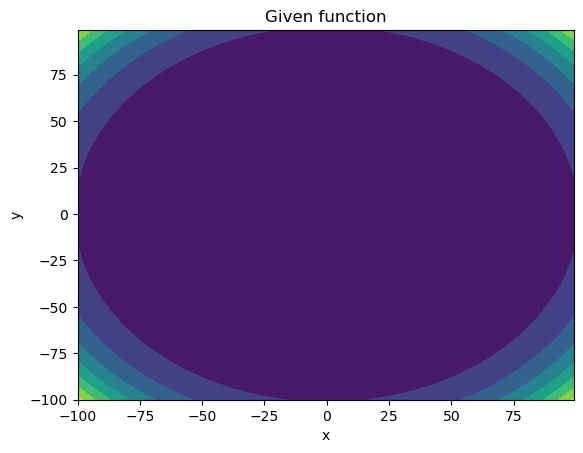

In [5]:
x = np.arange(-100, 100)
y = np.arange(-100, 100)

[X, Y] = np.meshgrid(x, y)

Function = function(X, Y)

plt.contourf(X, Y, Function)
plt.xlabel('x')
plt.ylabel('y')
plt.title('Given function')
plt.show()


We can see that function has multiple minima and should give the model a tough time to optimimze. Let us see how the different optimization methods take care of this problem.

Let us start by seeing te SGD method.

-------
Initial Coordinates:
[0.6 0.7]
Final Coordinates:
[0.65317778 0.71598333]
Gradient:
[-5.31777778 -1.59833333]


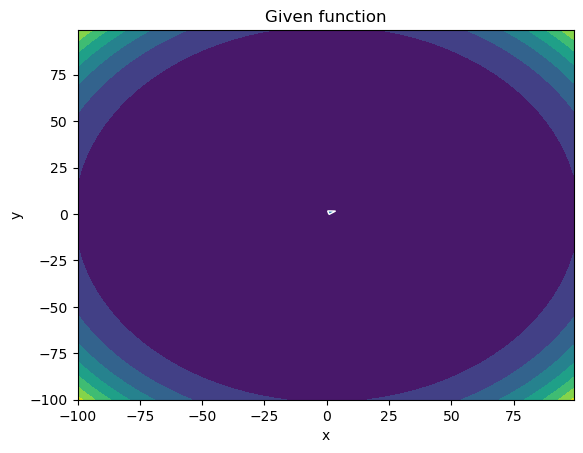

-------
Initial Coordinates:
[0.65317778 0.71598333]
Final Coordinates:
[0.68779438 0.72389569]
Gradient:
[-3.46166055 -0.79123585]


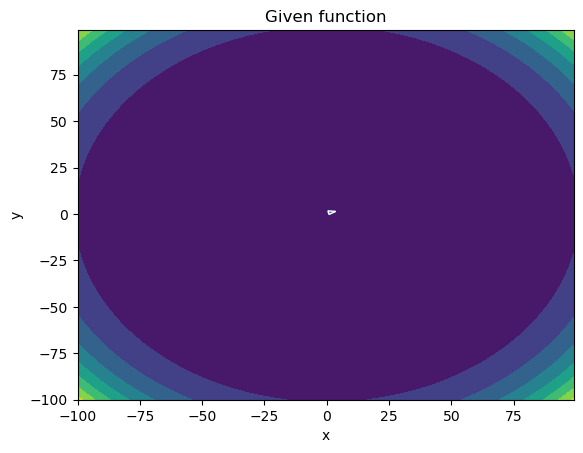

-------
Initial Coordinates:
[0.68779438 0.72389569]
Final Coordinates:
[0.70491592 0.7243202 ]
Gradient:
[-1.71215362 -0.04245126]


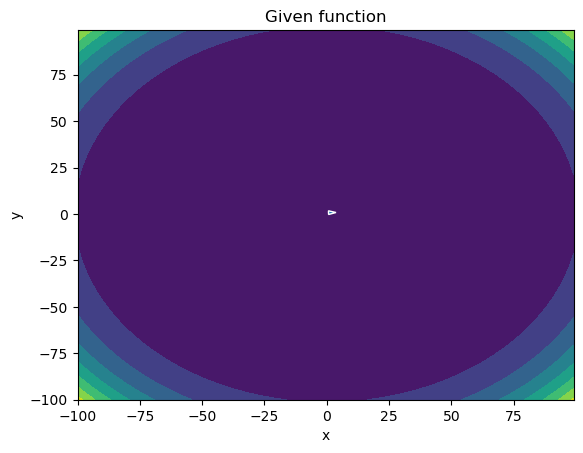

-------
Initial Coordinates:
[0.70491592 0.7243202 ]
Final Coordinates:
[0.71094182 0.72105217]
Gradient:
[-0.60259029  0.32680381]


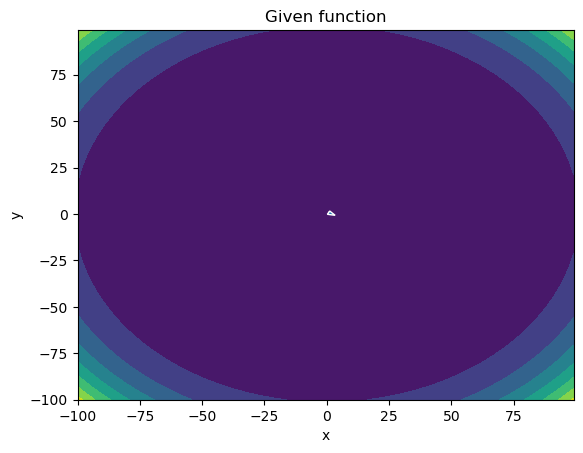

-------
Initial Coordinates:
[0.71094182 0.72105217]
Final Coordinates:
[0.71195906 0.71720065]
Gradient:
[-0.1017235   0.38515197]


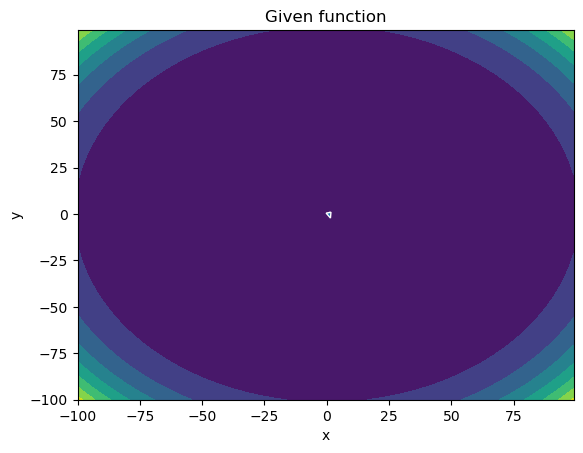

-------
Initial Coordinates:
[0.71195906 0.71720065]
Final Coordinates:
[0.71127671 0.71400879]
Gradient:
[0.06823427 0.3191859 ]


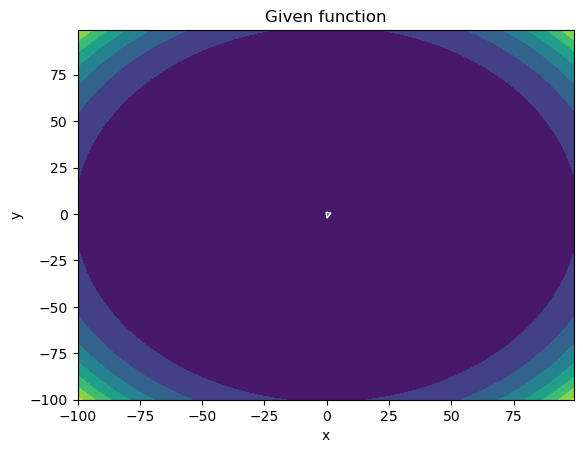

-------
Initial Coordinates:
[0.71127671 0.71400879]
Final Coordinates:
[0.7102454  0.71167971]
Gradient:
[0.10313151 0.23290741]


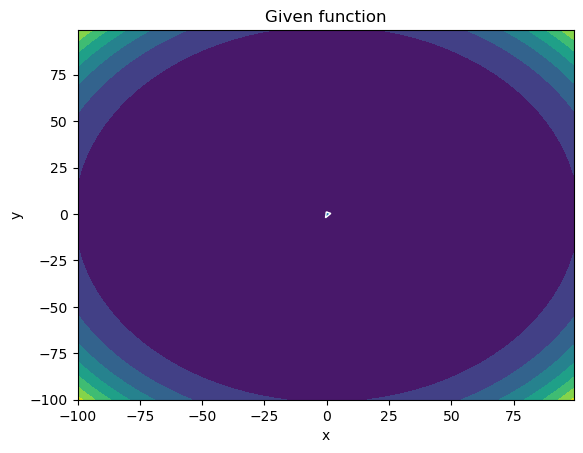

-------
Initial Coordinates:
[0.7102454  0.71167971]
Final Coordinates:
[0.70931974 0.71007738]
Gradient:
[0.09256595 0.16023335]


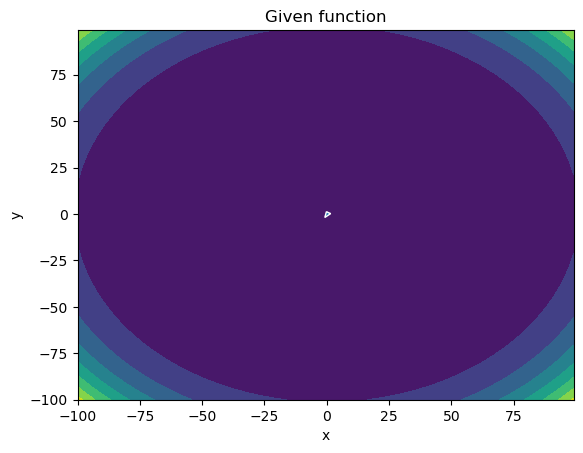

-------
Initial Coordinates:
[0.70931974 0.71007738]
Final Coordinates:
[0.70860797 0.70901001]
Gradient:
[0.07117668 0.10673717]


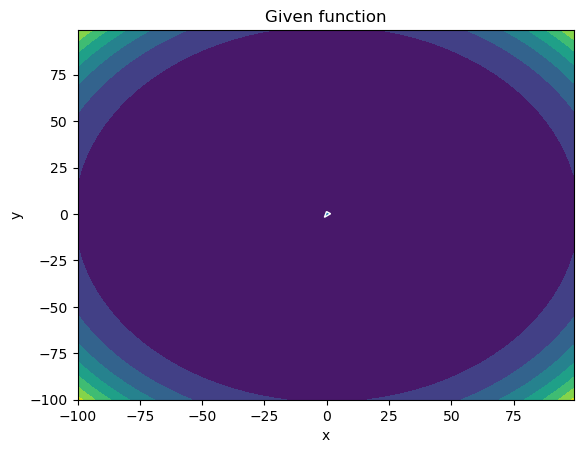

-------
Initial Coordinates:
[0.70860797 0.70901001]
Final Coordinates:
[0.70809935 0.70831337]
Gradient:
[0.05086183 0.06966364]


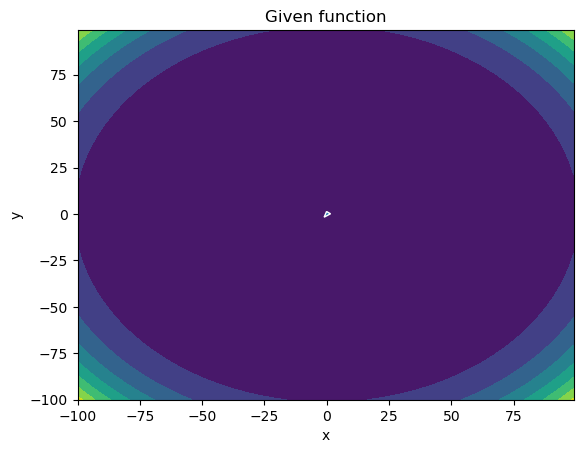

-------
Initial Coordinates:
[0.70809935 0.70831337]
Final Coordinates:
[0.70775108 0.70786526]
Gradient:
[0.0348272  0.04481158]


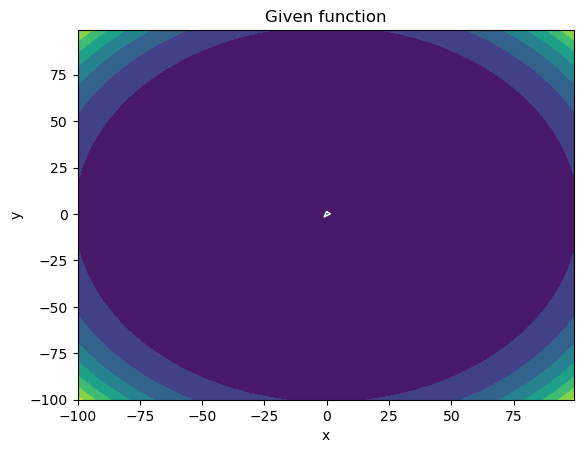

-------
Initial Coordinates:
[0.70775108 0.70786526]
Final Coordinates:
[0.70751921 0.70758021]
Gradient:
[0.02318699 0.02850482]


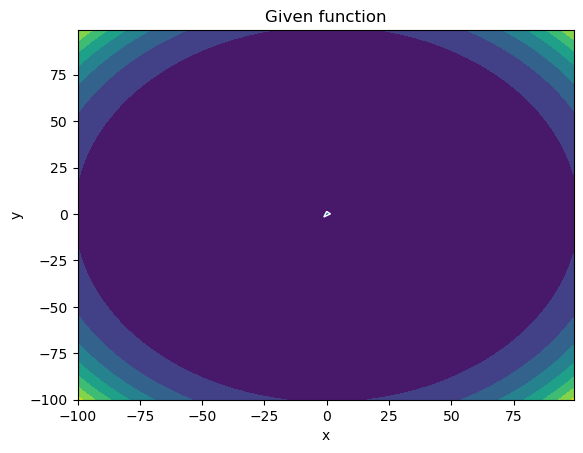

-------
Initial Coordinates:
[0.70751921 0.70758021]
Final Coordinates:
[0.70736791 0.70740052]
Gradient:
[0.01513073 0.01796871]


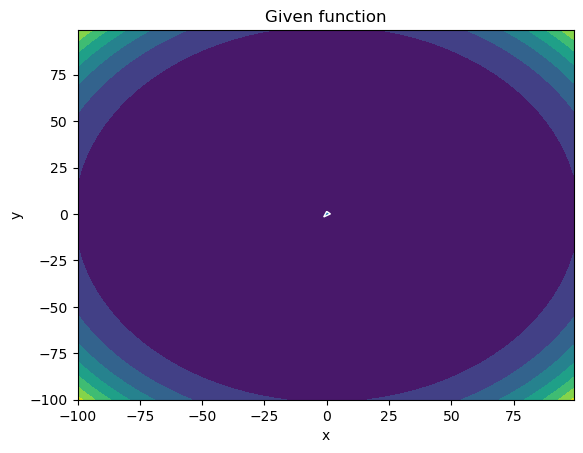

-------
Initial Coordinates:
[0.70736791 0.70740052]
Final Coordinates:
[0.70727065 0.7072881 ]
Gradient:
[0.00972548 0.01124198]


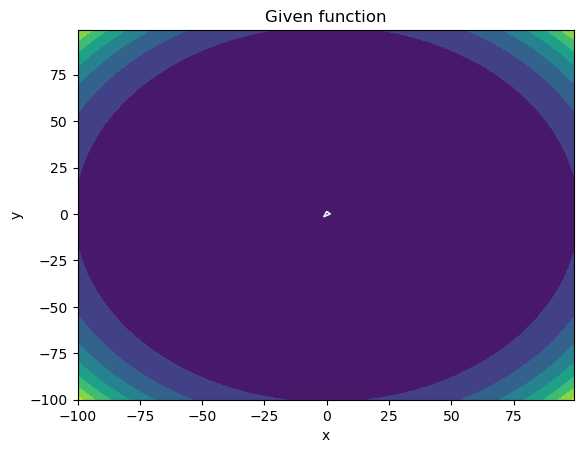

-------
Initial Coordinates:
[0.70727065 0.7072881 ]
Final Coordinates:
[0.70720887 0.70721821]
Gradient:
[0.00617773 0.00698876]


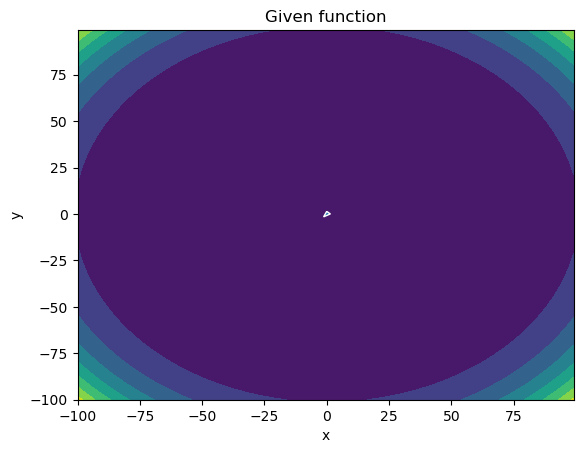

-------
Initial Coordinates:
[0.70720887 0.70721821]
Final Coordinates:
[0.70717  0.707175]
Gradient:
[0.00388713 0.0043211 ]


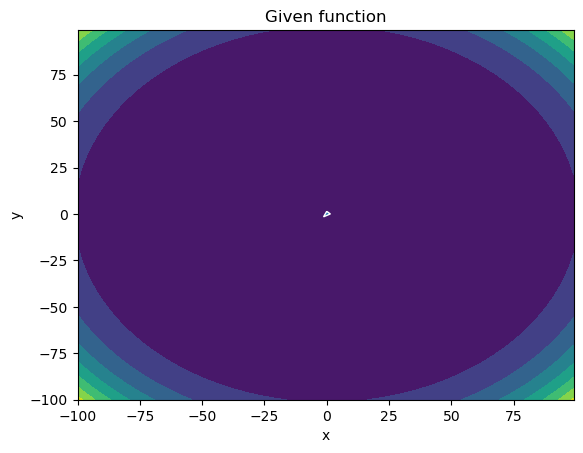

-------
Initial Coordinates:
[0.70717  0.707175]
Final Coordinates:
[0.70714573 0.70714841]
Gradient:
[0.00242696 0.00265925]


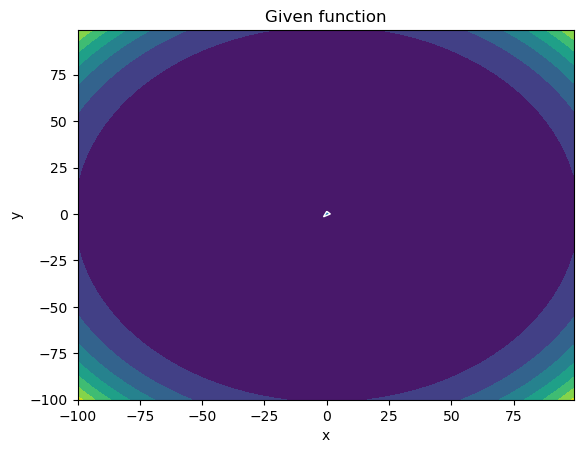

-------
Initial Coordinates:
[0.70714573 0.70714841]
Final Coordinates:
[0.70713068 0.70713211]
Gradient:
[0.0015056  0.00162996]


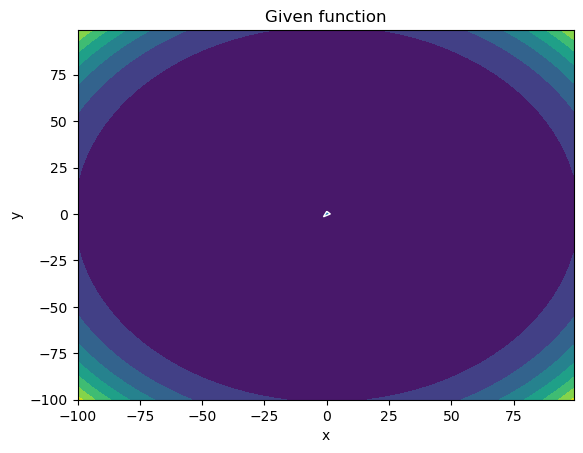

-------
Initial Coordinates:
[0.70713068 0.70713211]
Final Coordinates:
[0.70712139 0.70712215]
Gradient:
[0.00092901 0.0009956 ]


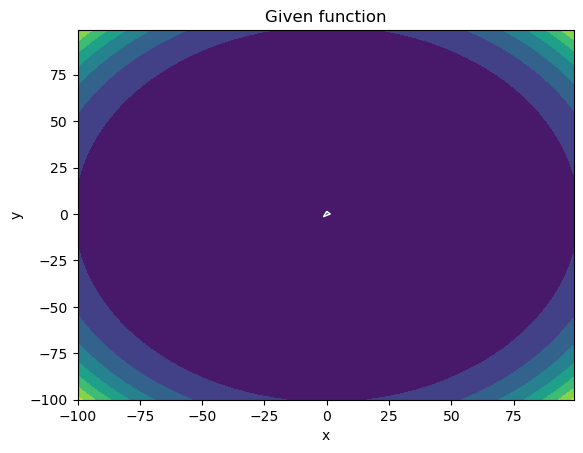

-------
Initial Coordinates:
[0.70712139 0.70712215]
Final Coordinates:
[0.70711568 0.70711609]
Gradient:
[0.00057064 0.0006063 ]


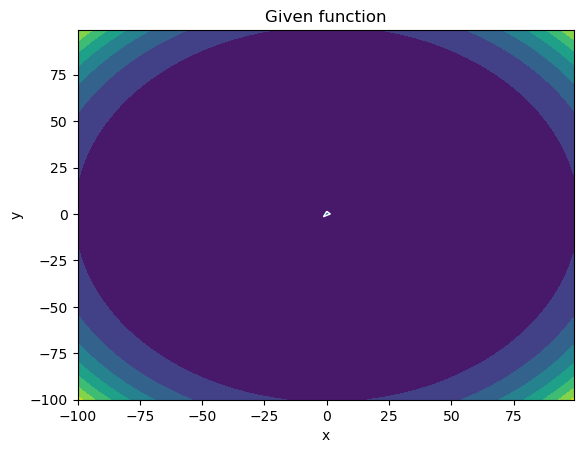

-------
Initial Coordinates:
[0.70711568 0.70711609]
Final Coordinates:
[0.70711219 0.70711241]
Gradient:
[0.00034916 0.00036825]


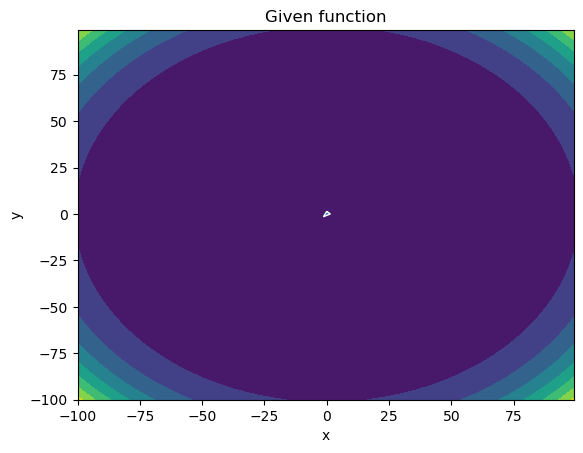

-------
Initial Coordinates:
[0.70711219 0.70711241]
Final Coordinates:
[0.70711006 0.70711018]
Gradient:
[0.00021294 0.00022316]


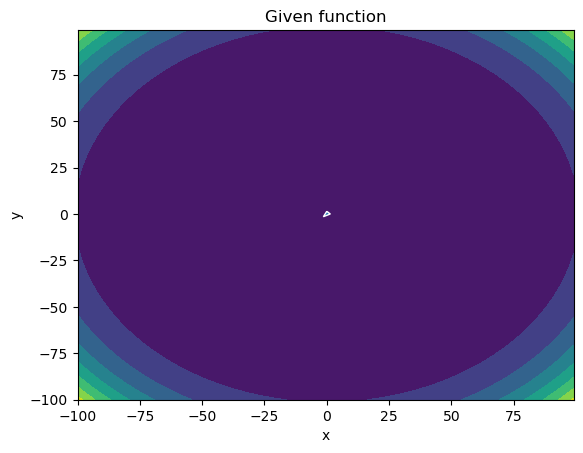

In [7]:
# SGD
np.random.seed(42)
params = np.array([0.6, 0.7])
step_size = 0.01
epsilon = 0.000001

dx = gradient_x1(params[0], params[1]) # Gradient with respect to x computed by hand
dy = gradient_y1(params[0], params[1]) # Gradient with respect to y computed by hand

final_gradient = np.array([dx, dy])
initial_gradient = np.array([[0],[0]])
while np.all(step_size*abs(final_gradient - initial_gradient) > epsilon) :
    initial_gradient = final_gradient
    paramsf = params - step_size*initial_gradient # Taking a step in the direction of the gradient
 
    dx = gradient_x1(paramsf[0], paramsf[1]) #Obtaining the new gradient values
    dy = gradient_y1(paramsf[0], paramsf[1])

    final_gradient = np.array([dx, dy])
    print('-------')
    print('Initial Coordinates:')
    print(params)
    print('Final Coordinates:')
    print(paramsf)
    print('Gradient:')
    print(initial_gradient)
    
    plt.figure()
    plt.contourf(X, Y, Function)
    plt.arrow(np.squeeze(params[0]), np.squeeze(params[1]), np.squeeze(paramsf[0] - params[0]), np.squeeze(paramsf[1] - params[1]), head_width = 2, width = 0.5, ec = 'white')
    plt.xlabel('x')
    plt.ylabel('y')
    plt.title('Given function')
    plt.show()

    params = paramsf

We can observe the convergence similar to that of of the rosenbrock function. It doesnt converge to the best possible value but let us see how the other optimization techniques work.

Now we will use the Momentum method.

-------
Initial Coordinates:
[[37.45401188]
 [95.07143064]]
Final Coordinates:
[[23.84753286]
 [60.52631778]]
Gradient:
[[1.36064790e+11]
 [3.45451129e+11]]


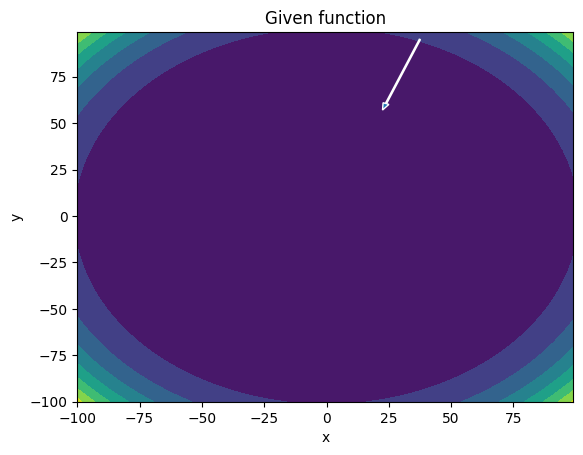

-------
Initial Coordinates:
[[23.84753286]
 [60.52631778]]
Final Coordinates:
[[10.17911352]
 [25.82328114]]
Gradient:
[[1.42258823e+10]
 [3.61243506e+10]]


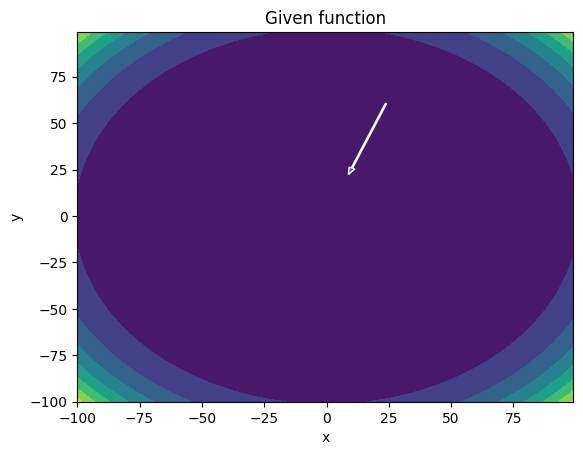

-------
Initial Coordinates:
[[10.17911352]
 [25.82328114]]
Final Coordinates:
[[-2.14251267]
 [-5.46045537]]
Gradient:
[[2.00487750e+08]
 [5.10035323e+08]]


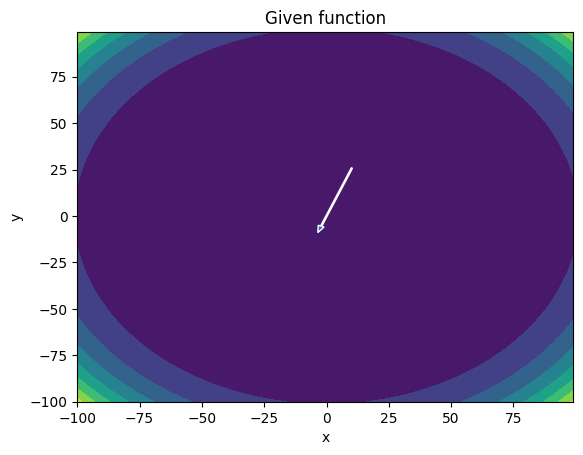

-------
Initial Coordinates:
[[-2.14251267]
 [-5.46045537]]
Final Coordinates:
[[-13.23196865]
 [-33.61579754]]
Gradient:
[[ -75848.42011224]
 [-206822.03989629]]


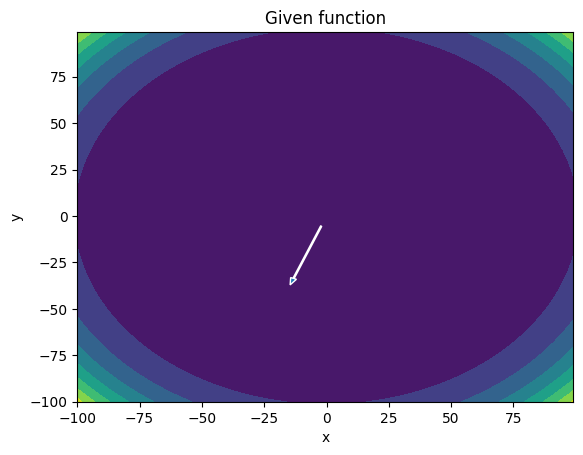

-------
Initial Coordinates:
[[-13.23196865]
 [-33.61579754]]
Final Coordinates:
[[-23.1375559 ]
 [-58.76494949]]
Gradient:
[[-7.49231329e+08]
 [-1.90656008e+09]]


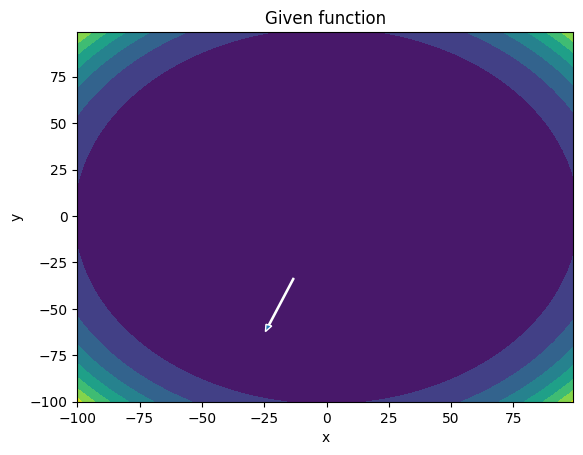

-------
Initial Coordinates:
[[-23.1375559 ]
 [-58.76494949]]
Final Coordinates:
[[-30.82665336]
 [-78.28388045]]
Gradient:
[[-1.22593106e+10]
 [-3.11530579e+10]]


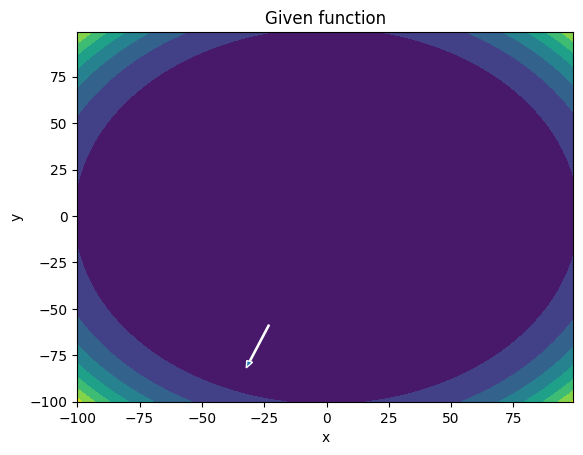

-------
Initial Coordinates:
[[-30.82665336]
 [-78.28388045]]
Final Coordinates:
[[-32.60061715]
 [-82.77818822]]
Gradient:
[[-5.14622393e+10]
 [-1.30727301e+11]]


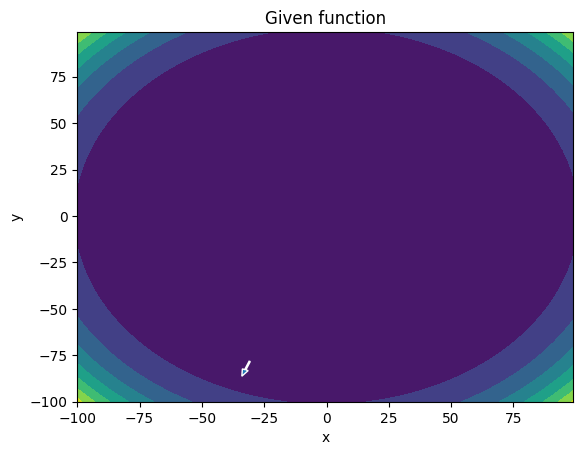

-------
Initial Coordinates:
[[-32.60061715]
 [-82.77818822]]
Final Coordinates:
[[-27.39238418]
 [-69.53990354]]
Gradient:
[[-6.80480038e+10]
 [-1.72831617e+11]]


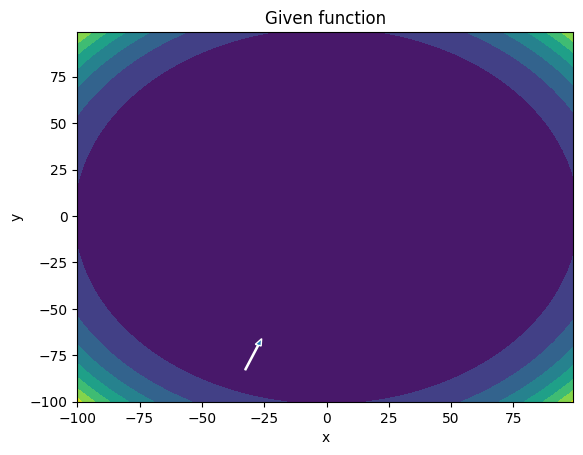

-------
Initial Coordinates:
[[-27.39238418]
 [-69.53990354]]
Final Coordinates:
[[-19.85751689]
 [-50.39394938]]
Gradient:
[[-2.84745762e+10]
 [-7.23149795e+10]]


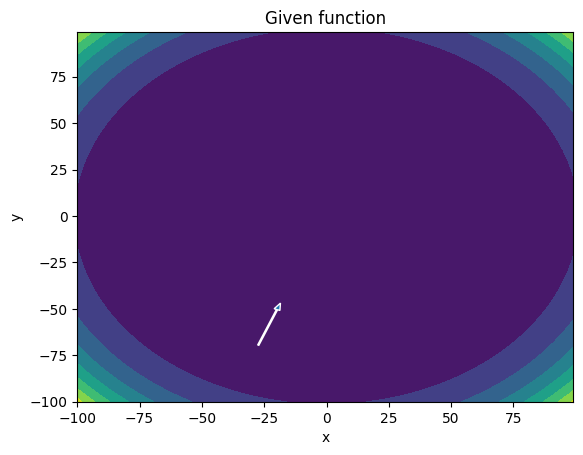

-------
Initial Coordinates:
[[-19.85751689]
 [-50.39394938]]
Final Coordinates:
[[-12.50707113]
 [-31.71737411]]
Gradient:
[[-5.69065203e+09]
 [-1.44521653e+10]]


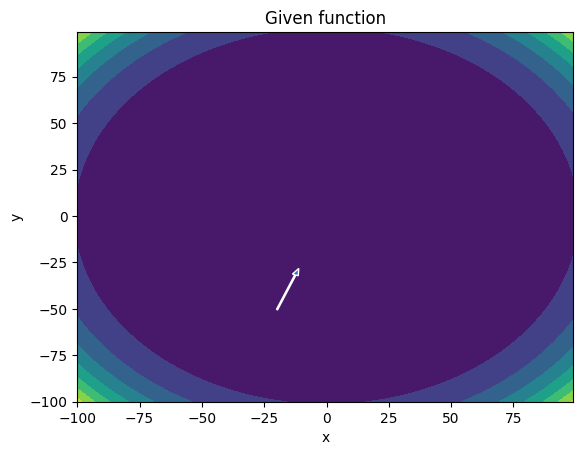

-------
Initial Coordinates:
[[-12.50707113]
 [-31.71737411]]
Final Coordinates:
[[ -5.83550859]
 [-14.76577069]]
Gradient:
[[-5.61613428e+08]
 [-1.42685669e+09]]


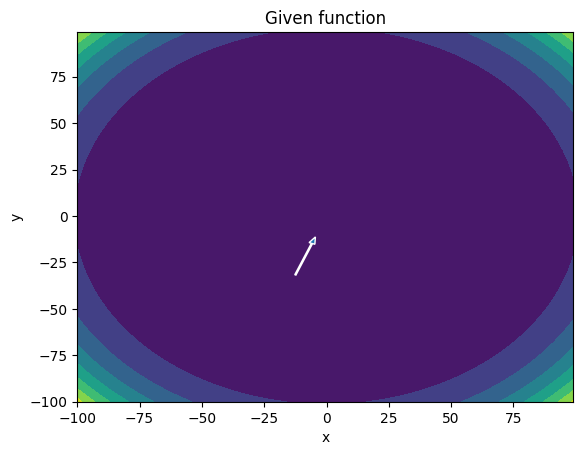

-------
Initial Coordinates:
[[ -5.83550859]
 [-14.76577069]]
Final Coordinates:
[[0.17011646]
 [0.49378275]]
Gradient:
[[-12187763.29322565]
 [-31103635.14369289]]


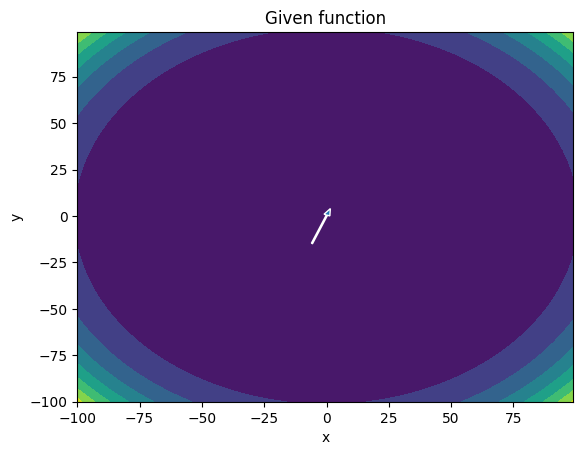

-------
Initial Coordinates:
[[0.17011646]
 [0.49378275]]
Final Coordinates:
[[ 5.57517901]
 [14.22738084]]
Gradient:
[[-3.60305872]
 [ 1.4432429 ]]


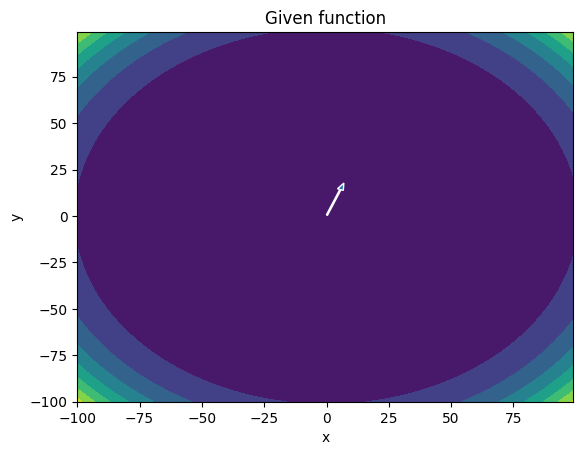

-------
Initial Coordinates:
[[ 5.57517901]
 [14.22738084]]
Final Coordinates:
[[10.43873748]
 [26.58504882]]
Gradient:
[[ 9978242.08411039]
 [25703072.124362  ]]


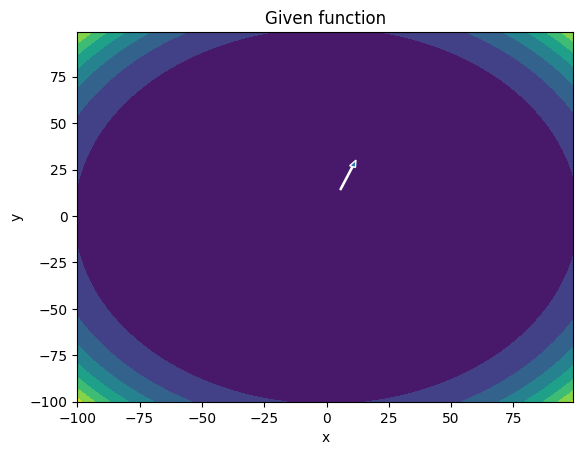

-------
Initial Coordinates:
[[10.43873748]
 [26.58504882]]
Final Coordinates:
[[14.79288704]
 [37.64808338]]
Gradient:
[[2.30530667e+08]
 [5.88666180e+08]]


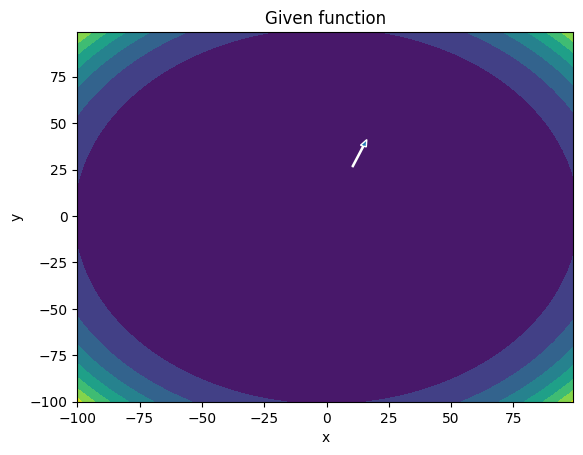

-------
Initial Coordinates:
[[14.79288704]
 [37.64808338]]
Final Coordinates:
[[18.5798972]
 [47.2691321]]
Gradient:
[[1.31724442e+09]
 [3.35682386e+09]]


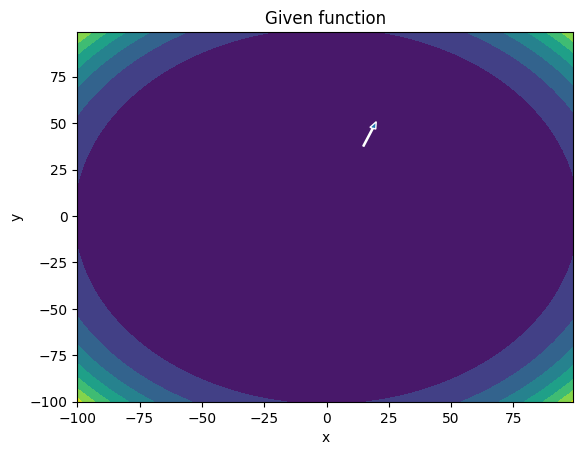

-------
Initial Coordinates:
[[18.5798972]
 [47.2691321]]
Final Coordinates:
[[21.57665499]
 [54.88017336]]
Gradient:
[[4.11551350e+09]
 [1.04790259e+10]]


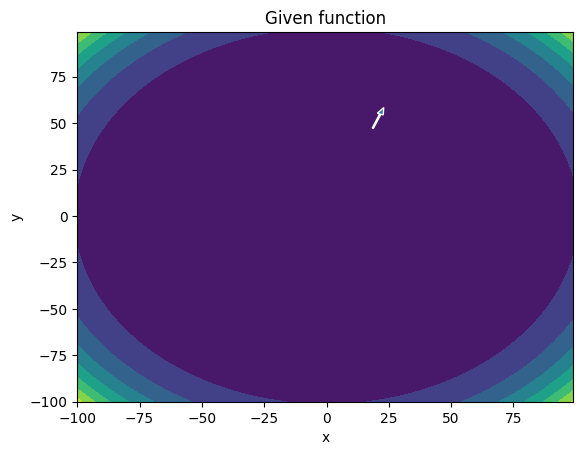

-------
Initial Coordinates:
[[21.57665499]
 [54.88017336]]
Final Coordinates:
[[23.4049252 ]
 [59.51892155]]
Gradient:
[[8.68811807e+09]
 [2.21118894e+10]]


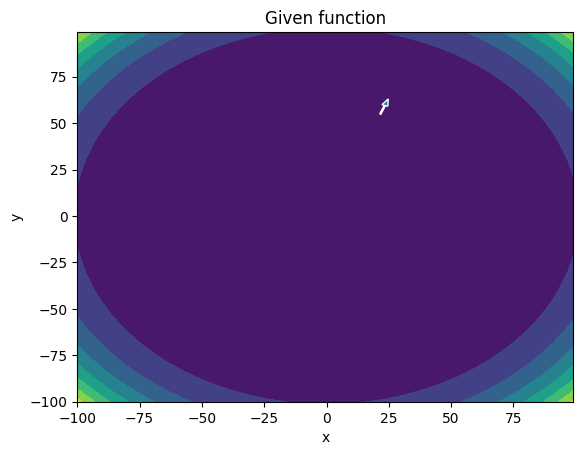

-------
Initial Coordinates:
[[23.4049252 ]
 [59.51892155]]
Final Coordinates:
[[23.74624591]
 [60.37565584]]
Gradient:
[[1.30412247e+10]
 [3.31813908e+10]]


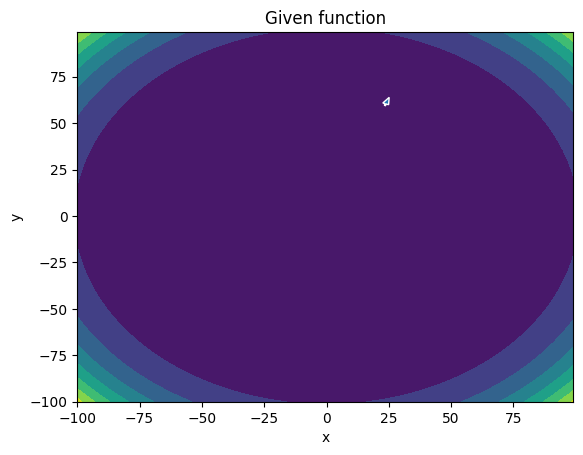

-------
Initial Coordinates:
[[23.74624591]
 [60.37565584]]
Final Coordinates:
[[22.65227577]
 [57.58240116]]
Gradient:
[[1.40115878e+10]
 [3.56431554e+10]]


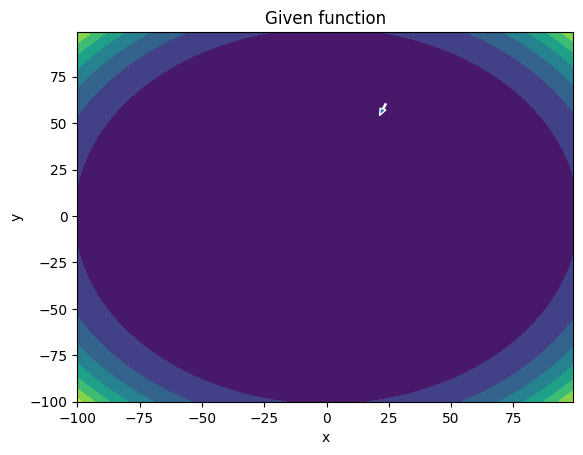

-------
Initial Coordinates:
[[22.65227577]
 [57.58240116]]
Final Coordinates:
[[20.56177349]
 [52.25560561]]
Gradient:
[[1.10592915e+10]
 [2.81286634e+10]]


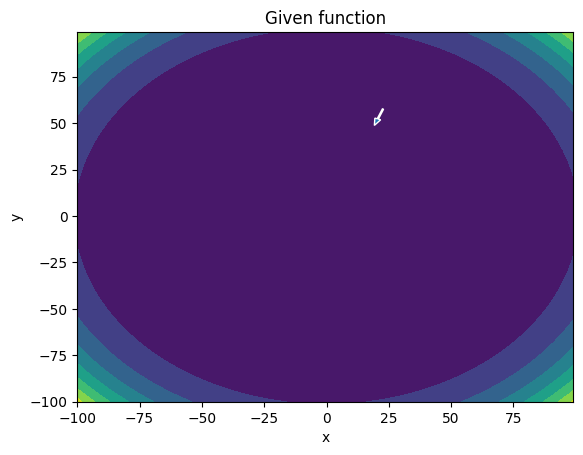

-------
Initial Coordinates:
[[20.56177349]
 [52.25560561]]
Final Coordinates:
[[17.99952211]
 [45.73012937]]
Gradient:
[[6.80799318e+09]
 [1.73136024e+10]]


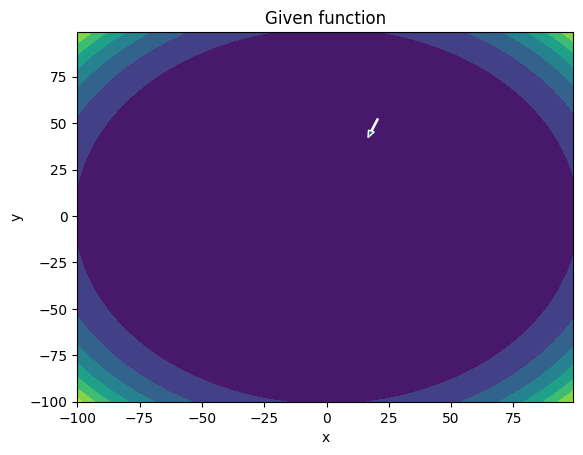

-------
Initial Coordinates:
[[17.99952211]
 [45.73012937]]
Final Coordinates:
[[15.34401868]
 [38.96851814]]
Gradient:
[[3.49477200e+09]
 [8.88682627e+09]]


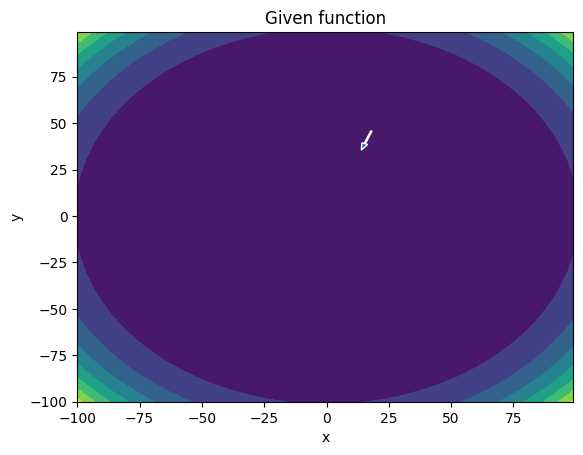

-------
Initial Coordinates:
[[15.34401868]
 [38.96851814]]
Final Coordinates:
[[12.7970321 ]
 [32.48376833]]
Gradient:
[[1.57033487e+09]
 [3.99299687e+09]]


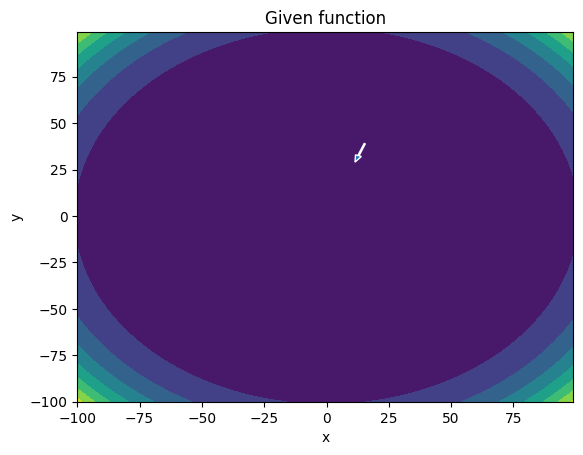

-------
Initial Coordinates:
[[12.7970321 ]
 [32.48376833]]
Final Coordinates:
[[10.44154601]
 [26.48678943]]
Gradient:
[[6.31981763e+08]
 [1.60704088e+09]]


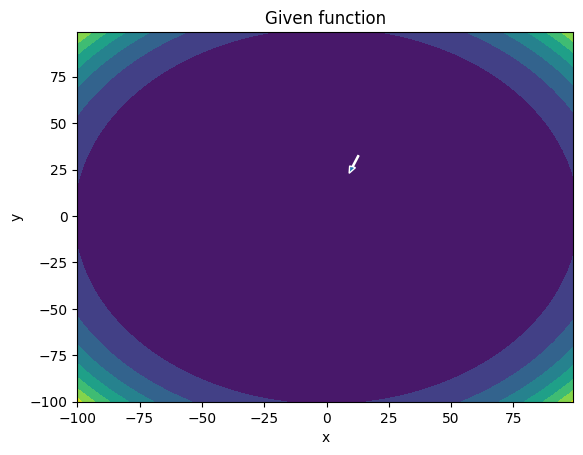

-------
Initial Coordinates:
[[10.44154601]
 [26.48678943]]
Final Coordinates:
[[ 8.29884008]
 [21.03159908]]
Gradient:
[[2.27684438e+08]
 [5.79093281e+08]]


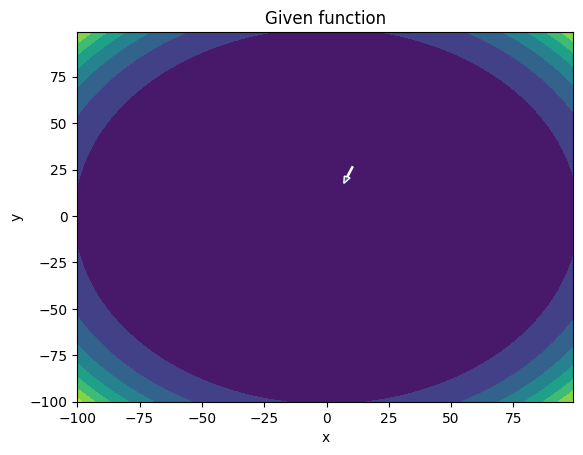

-------
Initial Coordinates:
[[ 8.29884008]
 [21.03159908]]
Final Coordinates:
[[ 6.3632257 ]
 [16.10365745]]
Gradient:
[[7.17903945e+07]
 [1.82703215e+08]]


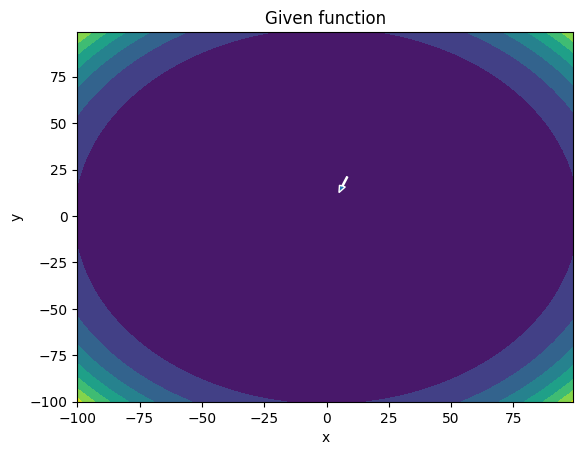

-------
Initial Coordinates:
[[ 6.3632257 ]
 [16.10365745]]
Final Coordinates:
[[ 4.61928852]
 [11.66370713]]
Gradient:
[[18842417.5963975 ]
 [48028478.77598754]]


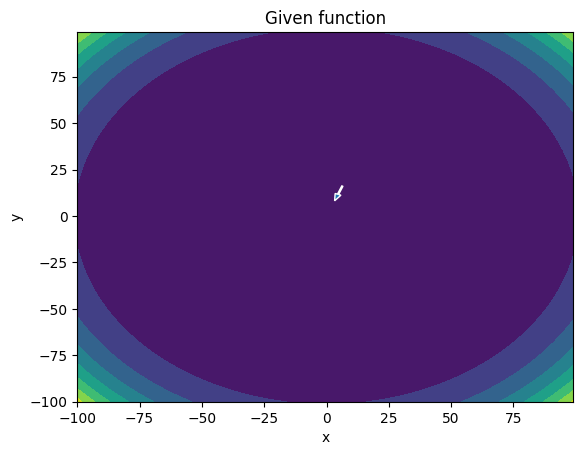

-------
Initial Coordinates:
[[ 4.61928852]
 [11.66370713]]
Final Coordinates:
[[3.0493722 ]
 [7.66679738]]
Gradient:
[[3728556.41411605]
 [9544621.72968028]]


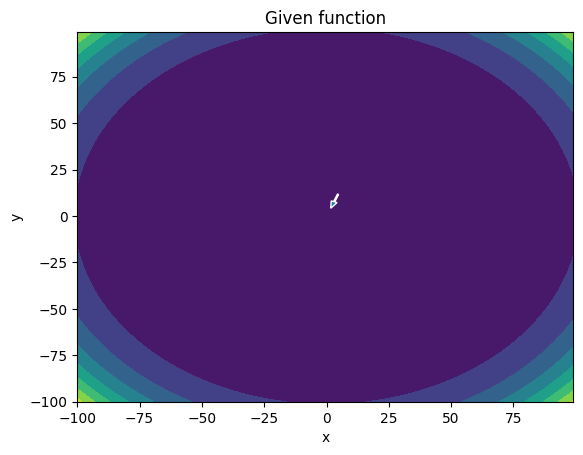

-------
Initial Coordinates:
[[3.0493722 ]
 [7.66679738]]
Final Coordinates:
[[1.63640283]
 [4.06946258]]
Gradient:
[[ 446893.64278127]
 [1160296.46655876]]


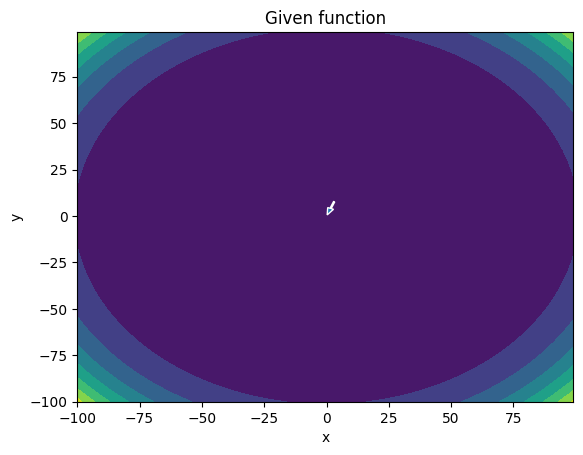

In [73]:
# Momentum
np.random.seed(42)
params = np.random.rand(2, 1)*100
beta = 0.9
step_size = 0.000000001
epsilon = 0.0005

dx = gradient_x1(params[0], params[1]) # Gradient with respect to x computed by hand
dy = gradient_y1(params[0], params[1]) # Gradient with respect to y computed by hand

final_gradient = np.array([dx, dy])
initial_gradient = np.array([[0],[0]])

Vdw = 0.0

while np.all(step_size*abs(final_gradient - initial_gradient) > epsilon) :
    initial_gradient = final_gradient
    Vdw = beta*Vdw + (1-beta)*initial_gradient # Averaging out the gradients to smoothen the descent and give it momentum in the direction of descent
    
    paramsf = params - step_size*Vdw # Taking the jump using the velocity term above

    dx = gradient_x1(paramsf[0], paramsf[1]) # Getting gradients of new parameters
    dy = gradient_y1(paramsf[0], paramsf[1])

    final_gradient = np.array([dx, dy])
    print('-------')
    print('Initial Coordinates:')
    print(params)
    print('Final Coordinates:')
    print(paramsf)
    print('Gradient:')
    print(initial_gradient)
    
    plt.figure()
    plt.contourf(X, Y, Function)
    plt.arrow(np.squeeze(params[0]), np.squeeze(params[1]), np.squeeze(paramsf[0] - params[0]), np.squeeze(paramsf[1] - params[1]), head_width = 2.5, width = 0.5, ec = 'white')
    plt.xlabel('x')
    plt.ylabel('y')
    plt.title('Given function')
    plt.show()

    params = paramsf

We can observe that the momentum techniqu converges alot closer to the center of the graph where the optimal value is retained. This is obviously a better result for us thaan SGD.

Now let us attemp the Nestorov acceleration method an dobserve our results.

-------
Initial Coordinates:
[[37.45401188]
 [95.07143064]]
Final Coordinates:
[[36.09336398]
 [91.61691935]]
Gradient:
[[1.36064790e+11]
 [3.45451129e+11]]


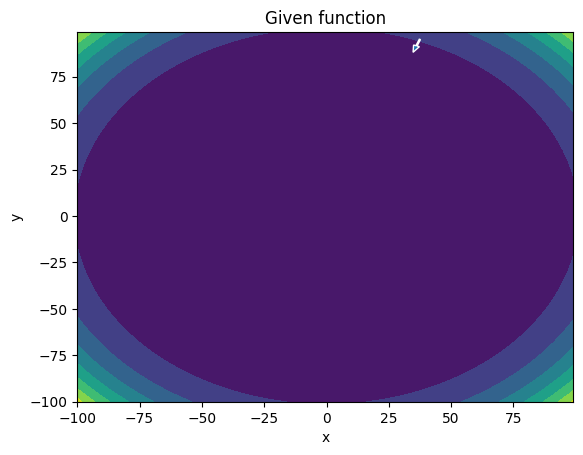

-------
Initial Coordinates:
[[36.09336398]
 [91.61691935]]
Final Coordinates:
[[33.81328397]
 [85.82804621]]
Gradient:
[[1.13075338e+11]
 [2.87086153e+11]]


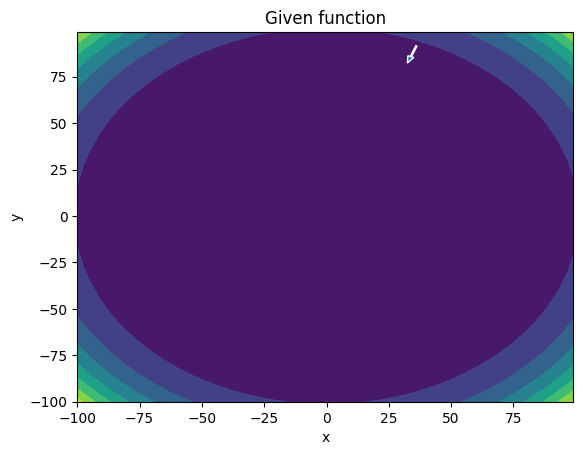

-------
Initial Coordinates:
[[33.81328397]
 [85.82804621]]
Final Coordinates:
[[30.98059853]
 [78.63611346]]
Gradient:
[[8.15874626e+10]
 [2.07145126e+11]]


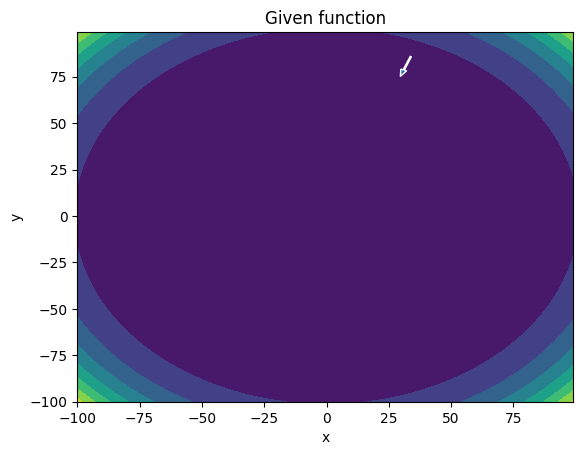

-------
Initial Coordinates:
[[30.98059853]
 [78.63611346]]
Final Coordinates:
[[27.85020498]
 [70.68826697]]
Gradient:
[[5.26705413e+10]
 [1.33730469e+11]]


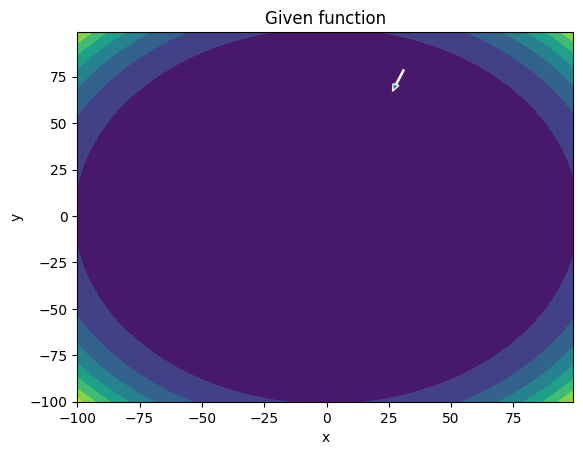

-------
Initial Coordinates:
[[27.85020498]
 [70.68826697]]
Final Coordinates:
[[24.58085326]
 [62.38755933]]
Gradient:
[[3.09145986e+10]
 [7.84953375e+10]]


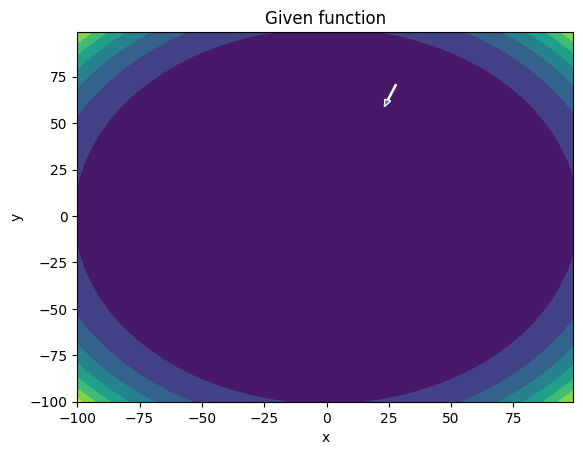

-------
Initial Coordinates:
[[24.58085326]
 [62.38755933]]
Final Coordinates:
[[21.26314367]
 [53.9640264 ]]
Gradient:
[[1.65527018e+10]
 [4.20317076e+10]]


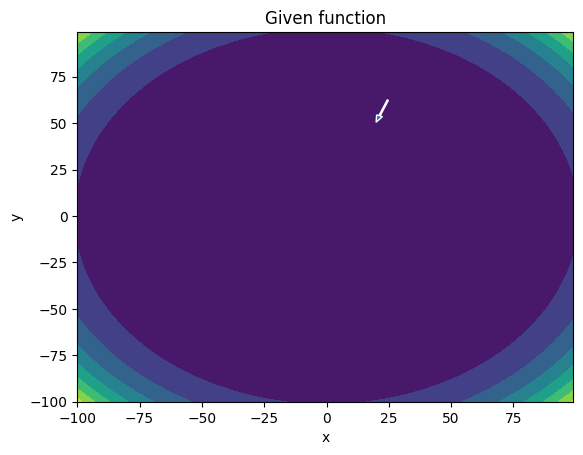

-------
Initial Coordinates:
[[21.26314367]
 [53.9640264 ]]
Final Coordinates:
[[17.94432209]
 [45.53763475]]
Gradient:
[[8.01350996e+09]
 [2.03505653e+10]]


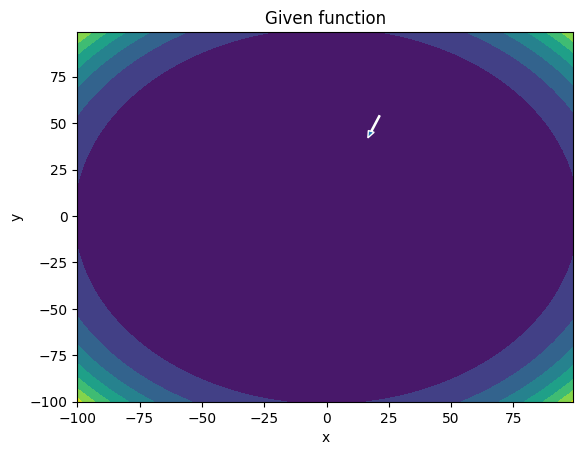

-------
Initial Coordinates:
[[17.94432209]
 [45.53763475]]
Final Coordinates:
[[14.64637341]
 [37.16421555]]
Gradient:
[[3.42783665e+09]
 [8.70667512e+09]]


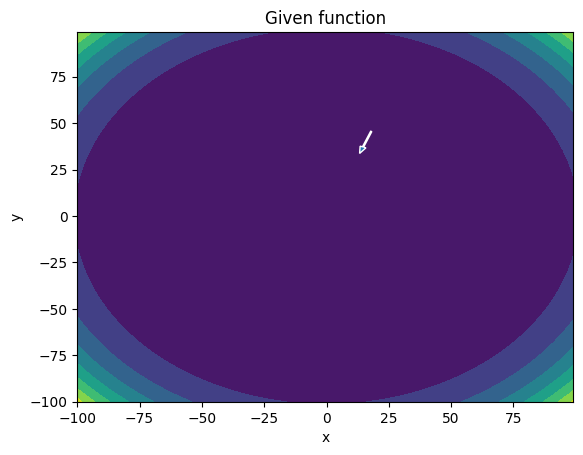

-------
Initial Coordinates:
[[14.64637341]
 [37.16421555]]
Final Coordinates:
[[11.37794749]
 [28.8657412 ]]
Gradient:
[[1.24035347e+09]
 [3.15155043e+09]]


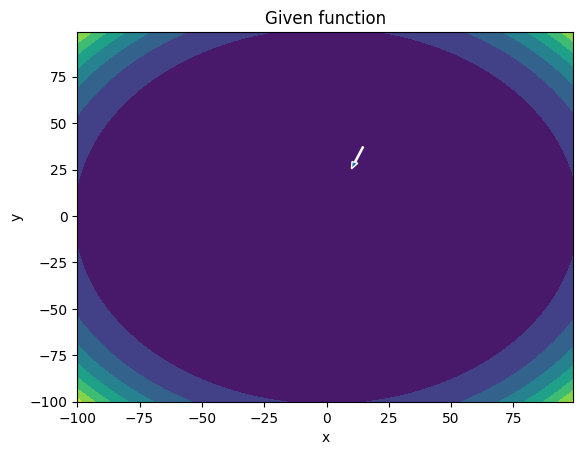

-------
Initial Coordinates:
[[11.37794749]
 [28.8657412 ]]
Final Coordinates:
[[ 8.1415647 ]
 [20.64861841]]
Gradient:
[[3.50200690e+08]
 [8.90439404e+08]]


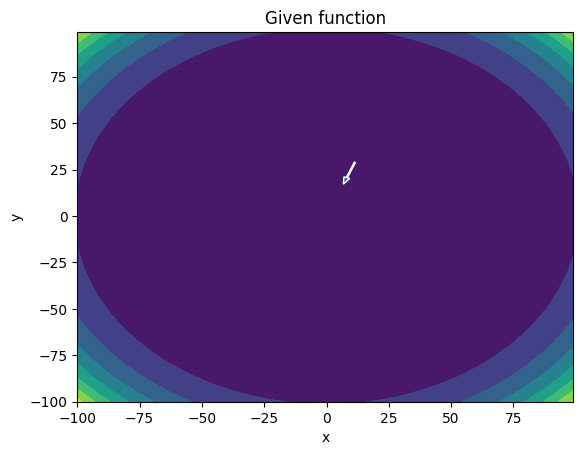

-------
Initial Coordinates:
[[ 8.1415647 ]
 [20.64861841]]
Final Coordinates:
[[ 4.93749462]
 [12.51353568]]
Gradient:
[[6.53941368e+07]
 [1.66578255e+08]]


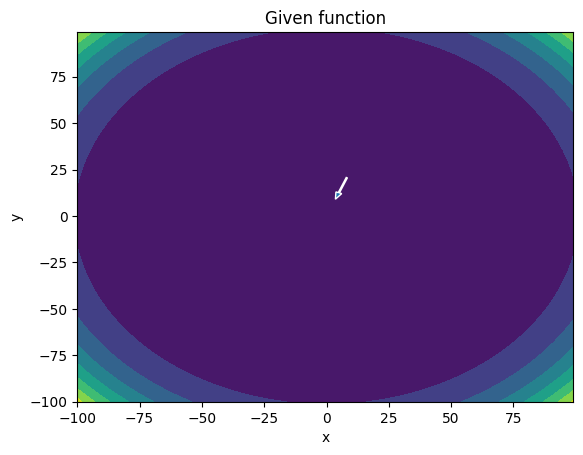

-------
Initial Coordinates:
[[ 4.93749462]
 [12.51353568]]
Final Coordinates:
[[1.765465  ]
 [4.45980312]]
Gradient:
[[ 5284857.62397553]
 [13555268.98708303]]


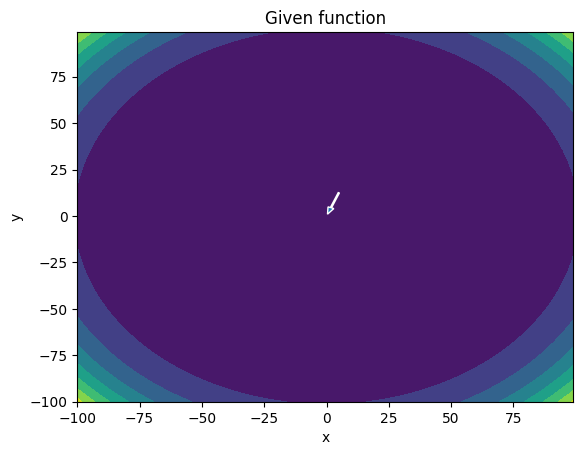

-------
Initial Coordinates:
[[1.765465  ]
 [4.45980312]]
Final Coordinates:
[[-1.37484425]
 [-3.51339189]]
Gradient:
[[26406.89752237]
 [73980.11265937]]


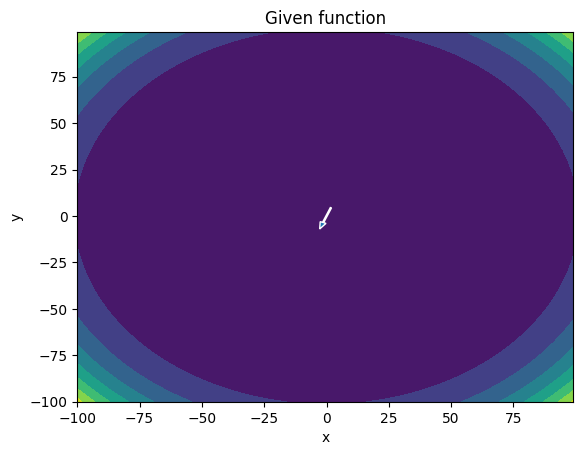

In [74]:
# Nestorov 

np.random.seed(42)
params = np.random.rand(2, 1)*100
beta = 0.99
step_size = 0.000000001
epsilon = 0.0005

dx = gradient_x1(params[0], params[1]) # Gradient with respect to x computed by hand
dy = gradient_y1(params[0], params[1]) # Gradient with respect to y computed by hand

final_gradient = np.array([dx, dy])
initial_gradient = np.array([[0],[0]])

Vdw = 0.0

while np.all(step_size*abs(final_gradient - initial_gradient) > epsilon) :
    initial_gradient = final_gradient
    
    wla = params - step_size*Vdw # Computing the look ahead term

    la_x = gradient_x1(wla[0], wla[1])
    la_y = gradient_y1(wla[0], wla[1])
    lookahead_gradient = np.array([la_x ,la_y]) # Computing the gradients at the lookahead term

    
    Vdw = beta*Vdw + (1-beta)*lookahead_gradient # Averaging out the look ahead gradients to smoothen the descent and give it momentum in the direction of descent
    
    paramsf = params - step_size*Vdw # Making the optimization step in the direction of the computed gradient

    dx = gradient_x1(paramsf[0], paramsf[1])
    dy = gradient_y1(paramsf[0], paramsf[1])

    final_gradient = np.array([dx, dy])
    print('-------')
    print('Initial Coordinates:')
    print(params)
    print('Final Coordinates:')
    print(paramsf)
    print('Gradient:')
    print(initial_gradient)
    
    plt.figure()
    plt.contourf(X, Y, Function)
    plt.arrow(np.squeeze(params[0]), np.squeeze(params[1]), np.squeeze(paramsf[0] - params[0]), np.squeeze(paramsf[1] - params[1]), head_width = 2.5, width = 0.5, ec = 'white')
    plt.xlabel('x')
    plt.ylabel('y')
    plt.title('Given function')
    plt.show()

    params = paramsf

As we can observe, it converges a little more better than momentum method and also converges quicker than that of monetum because of the damped oscillations.

Let us now observe the adam optimizers optimization.

-------
Initial Coordinates:
[[37.45401188]
 [95.07143064]]
Final Coordinates:
[[37.35401188]
 [94.97143064]]
Gradient:
[[1.36064790e+11]
 [3.45451129e+11]]


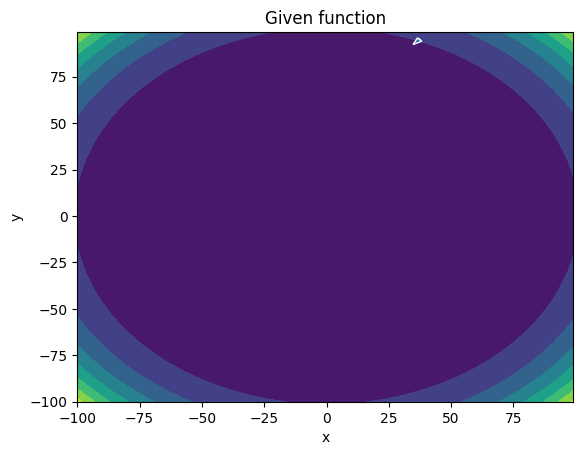

-------
Initial Coordinates:
[[37.35401188]
 [94.97143064]]
Final Coordinates:
[[37.25401263]
 [94.87143111]]
Gradient:
[[1.35013760e+11]
 [3.43339208e+11]]


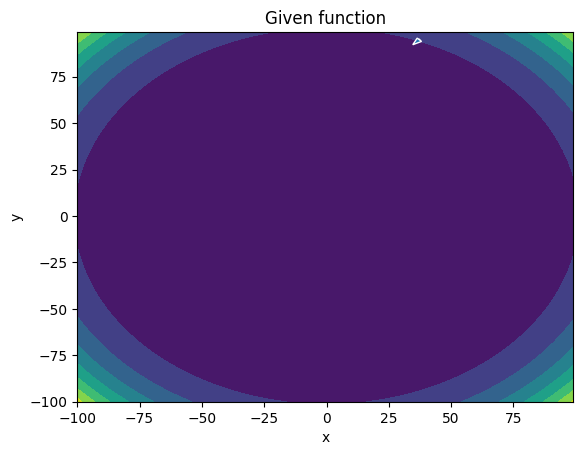

-------
Initial Coordinates:
[[37.25401263]
 [94.87143111]]
Final Coordinates:
[[37.15401463]
 [94.77143236]]
Gradient:
[[1.33969193e+11]
 [3.41238045e+11]]


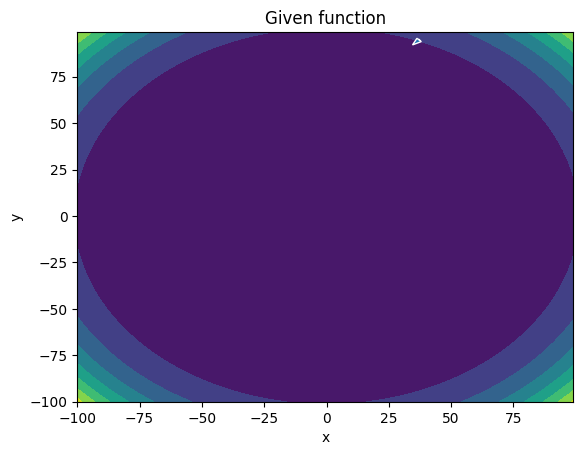

-------
Initial Coordinates:
[[37.15401463]
 [94.77143236]]
Final Coordinates:
[[37.05401837]
 [94.67143469]]
Gradient:
[[1.32931062e+11]
 [3.39147605e+11]]


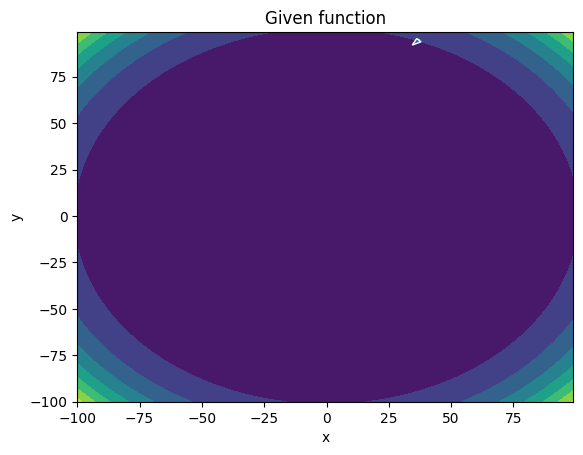

-------
Initial Coordinates:
[[37.05401837]
 [94.67143469]]
Final Coordinates:
[[36.95402434]
 [94.57143842]]
Gradient:
[[1.31899342e+11]
 [3.37067852e+11]]


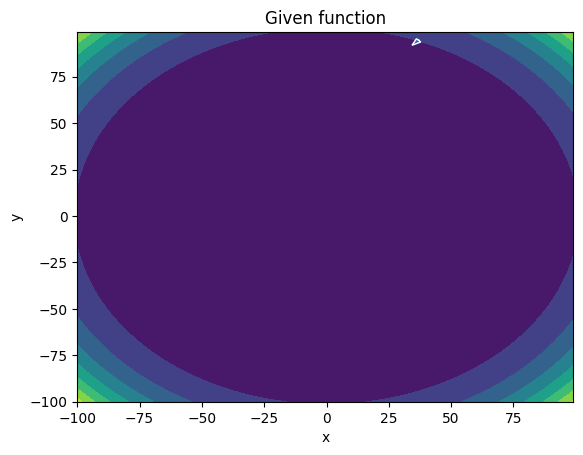

-------
Initial Coordinates:
[[36.95402434]
 [94.57143842]]
Final Coordinates:
[[36.85403302]
 [94.47144383]]
Gradient:
[[1.30874006e+11]
 [3.34998752e+11]]


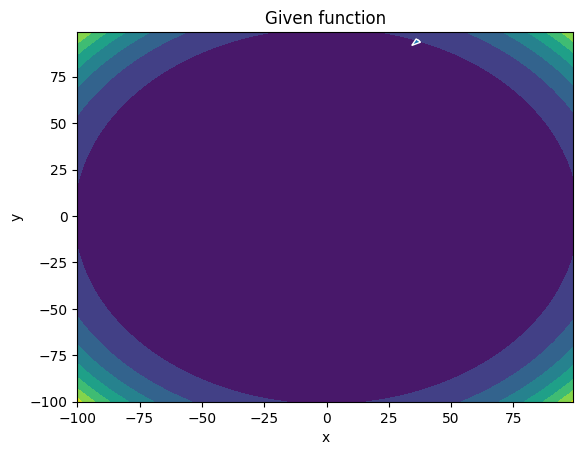

-------
Initial Coordinates:
[[36.85403302]
 [94.47144383]]
Final Coordinates:
[[36.75404486]
 [94.37145121]]
Gradient:
[[1.29855028e+11]
 [3.32940269e+11]]


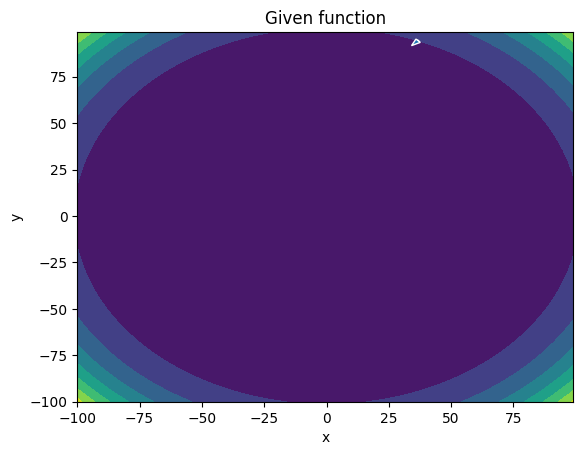

-------
Initial Coordinates:
[[36.75404486]
 [94.37145121]]
Final Coordinates:
[[36.65406032]
 [94.27146083]]
Gradient:
[[1.28842382e+11]
 [3.30892365e+11]]


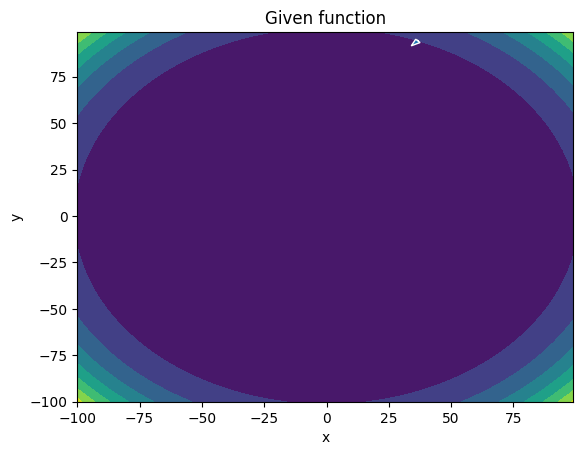

-------
Initial Coordinates:
[[36.65406032]
 [94.27146083]]
Final Coordinates:
[[36.55407984]
 [94.17147297]]
Gradient:
[[1.27836041e+11]
 [3.28855007e+11]]


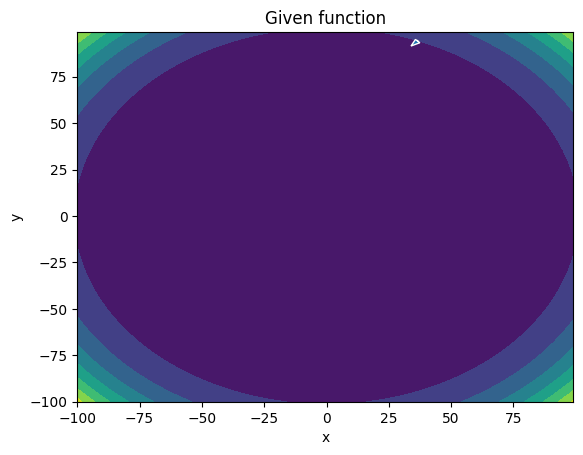

-------
Initial Coordinates:
[[36.55407984]
 [94.17147297]]
Final Coordinates:
[[36.45410381]
 [94.07148787]]
Gradient:
[[1.26835979e+11]
 [3.26828157e+11]]


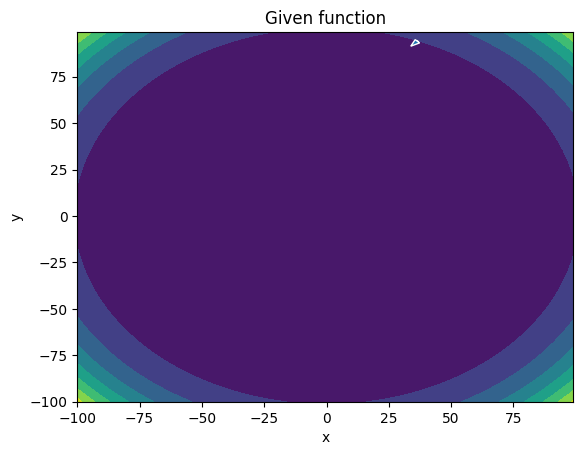

-------
Initial Coordinates:
[[36.45410381]
 [94.07148787]]
Final Coordinates:
[[36.35413265]
 [93.97150577]]
Gradient:
[[1.25842168e+11]
 [3.24811778e+11]]


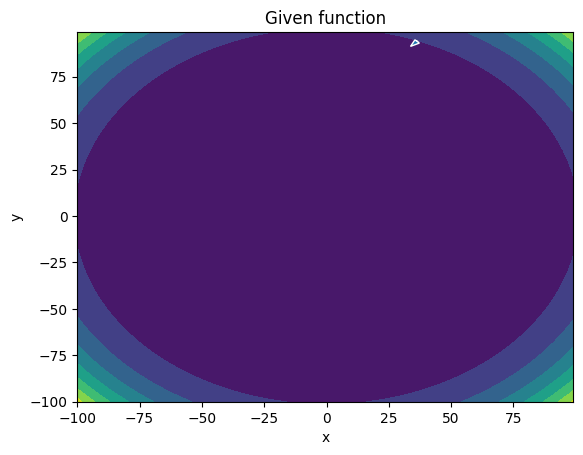

-------
Initial Coordinates:
[[36.35413265]
 [93.97150577]]
Final Coordinates:
[[36.25416671]
 [93.87152689]]
Gradient:
[[1.24854582e+11]
 [3.22805834e+11]]


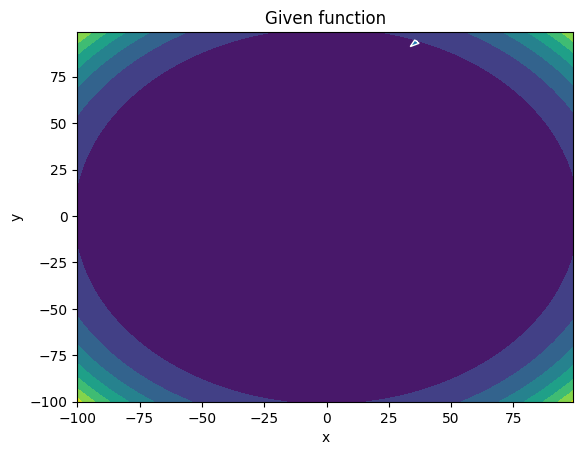

-------
Initial Coordinates:
[[36.25416671]
 [93.87152689]]
Final Coordinates:
[[36.15420635]
 [93.77155145]]
Gradient:
[[1.23873194e+11]
 [3.20810286e+11]]


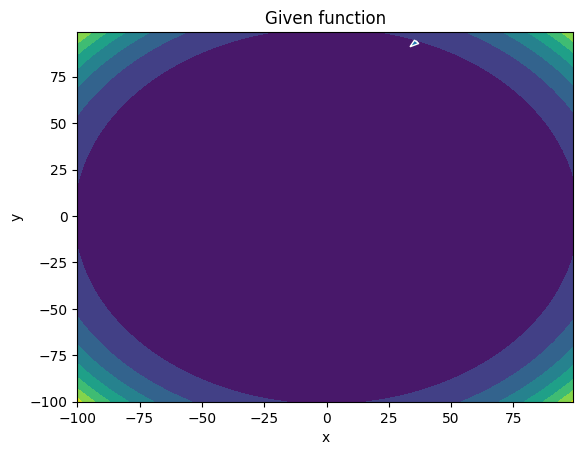

-------
Initial Coordinates:
[[36.15420635]
 [93.77155145]]
Final Coordinates:
[[36.05425188]
 [93.67157963]]
Gradient:
[[1.22897977e+11]
 [3.18825099e+11]]


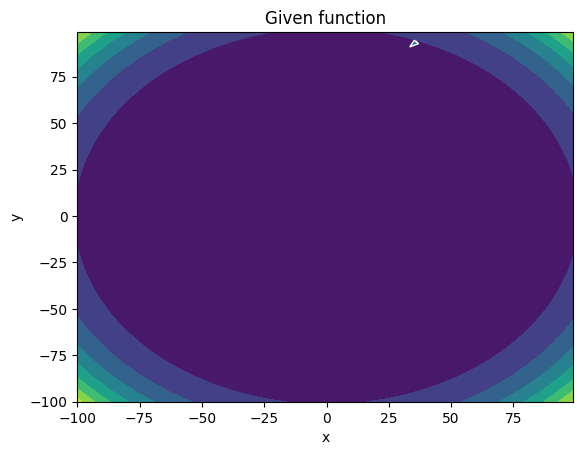

-------
Initial Coordinates:
[[36.05425188]
 [93.67157963]]
Final Coordinates:
[[35.95430361]
 [93.5716116 ]]
Gradient:
[[1.21928902e+11]
 [3.16850233e+11]]


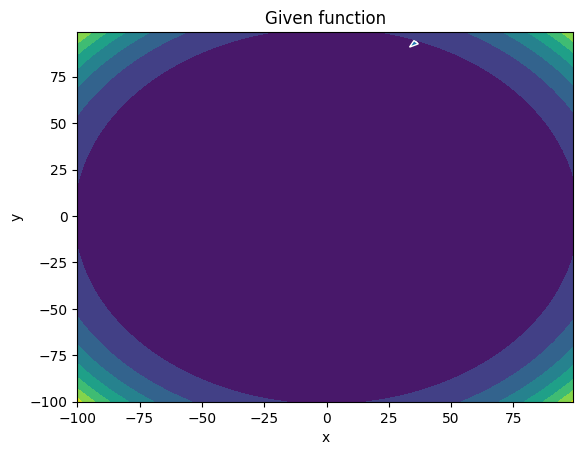

-------
Initial Coordinates:
[[35.95430361]
 [93.5716116 ]]
Final Coordinates:
[[35.85436179]
 [93.47164753]]
Gradient:
[[1.20965942e+11]
 [3.14885650e+11]]


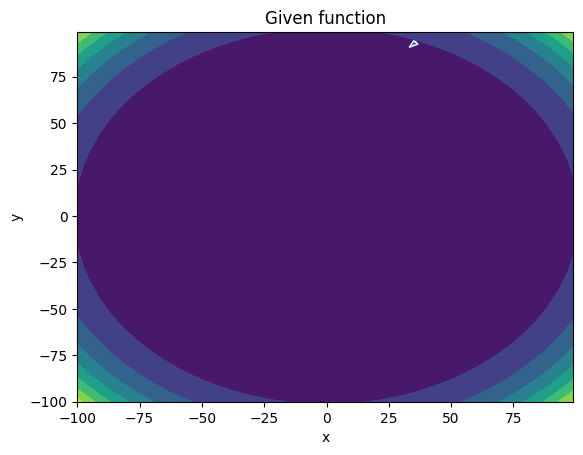

-------
Initial Coordinates:
[[35.85436179]
 [93.47164753]]
Final Coordinates:
[[35.75442668]
 [93.37168755]]
Gradient:
[[1.20009071e+11]
 [3.12931312e+11]]


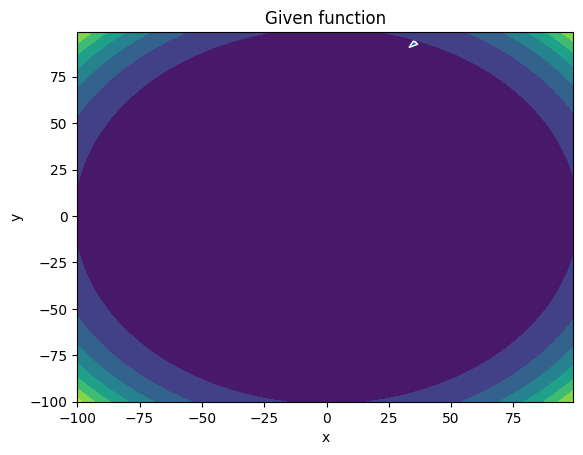

-------
Initial Coordinates:
[[35.75442668]
 [93.37168755]]
Final Coordinates:
[[35.65449848]
 [93.27173178]]
Gradient:
[[1.19058258e+11]
 [3.10987179e+11]]


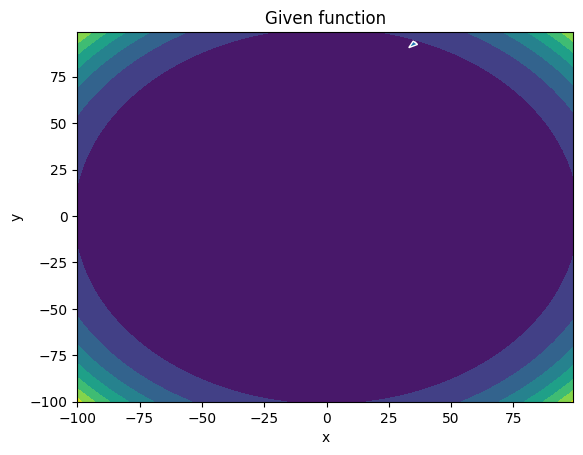

-------
Initial Coordinates:
[[35.65449848]
 [93.27173178]]
Final Coordinates:
[[35.55457739]
 [93.17178033]]
Gradient:
[[1.18113478e+11]
 [3.09053213e+11]]


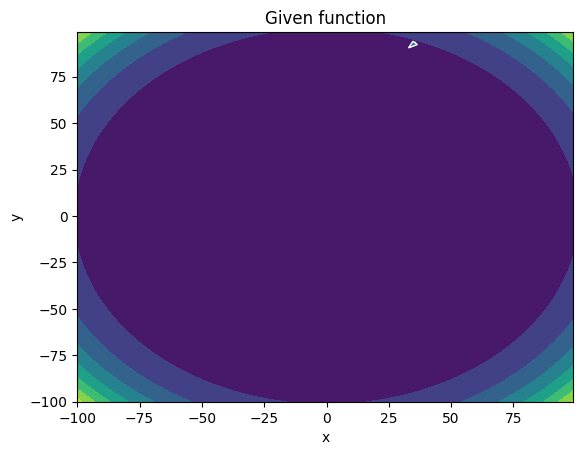

-------
Initial Coordinates:
[[35.55457739]
 [93.17178033]]
Final Coordinates:
[[35.45466358]
 [93.07183329]]
Gradient:
[[1.17174701e+11]
 [3.07129373e+11]]


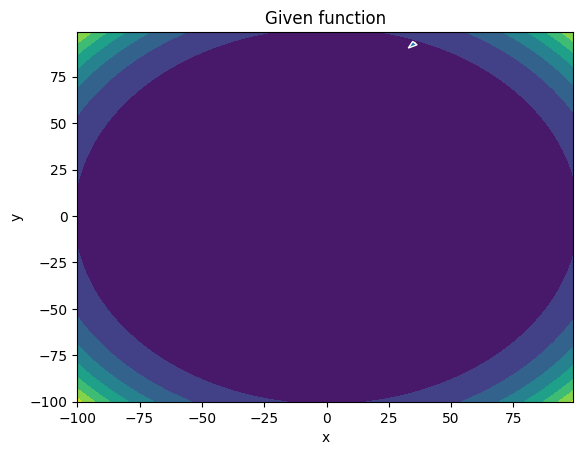

-------
Initial Coordinates:
[[35.45466358]
 [93.07183329]]
Final Coordinates:
[[35.35475716]
 [92.97189072]]
Gradient:
[[1.16241898e+11]
 [3.05215620e+11]]


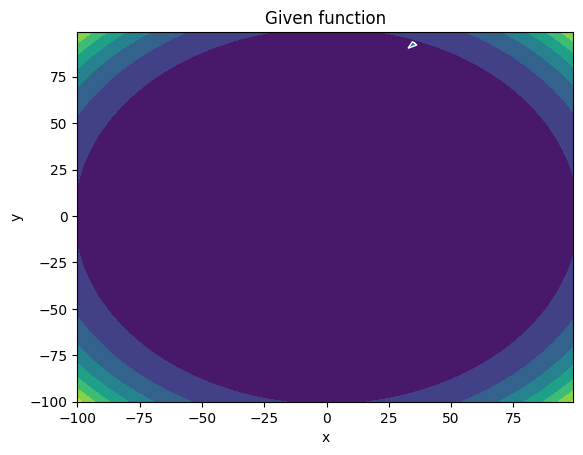

-------
Initial Coordinates:
[[35.35475716]
 [92.97189072]]
Final Coordinates:
[[35.25485826]
 [92.87195269]]
Gradient:
[[1.15315043e+11]
 [3.03311913e+11]]


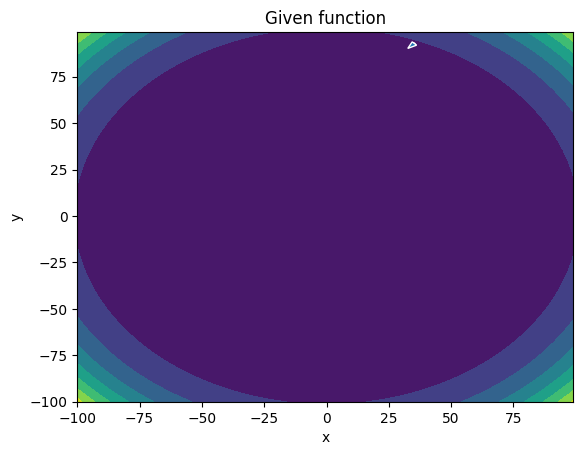

-------
Initial Coordinates:
[[35.25485826]
 [92.87195269]]
Final Coordinates:
[[35.15496696]
 [92.77201922]]
Gradient:
[[1.14394105e+11]
 [3.01418213e+11]]


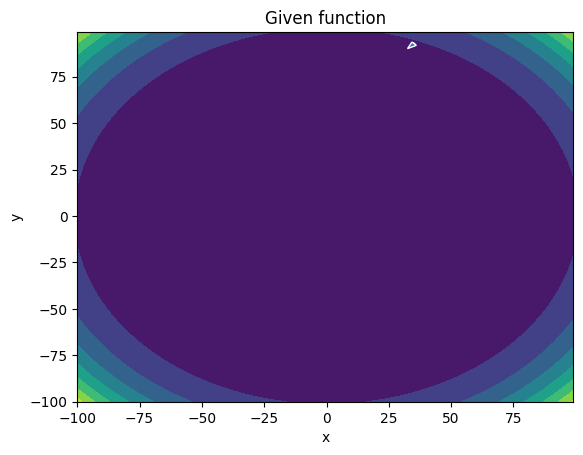

-------
Initial Coordinates:
[[35.15496696]
 [92.77201922]]
Final Coordinates:
[[35.05508332]
 [92.67209034]]
Gradient:
[[1.13479056e+11]
 [2.99534477e+11]]


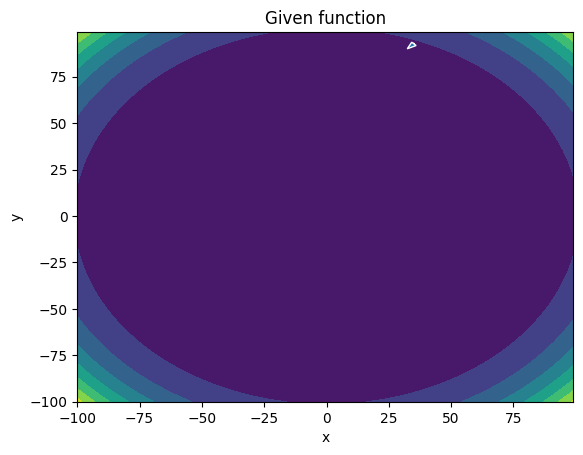

-------
Initial Coordinates:
[[35.05508332]
 [92.67209034]]
Final Coordinates:
[[34.95520737]
 [92.57216606]]
Gradient:
[[1.12569868e+11]
 [2.97660666e+11]]


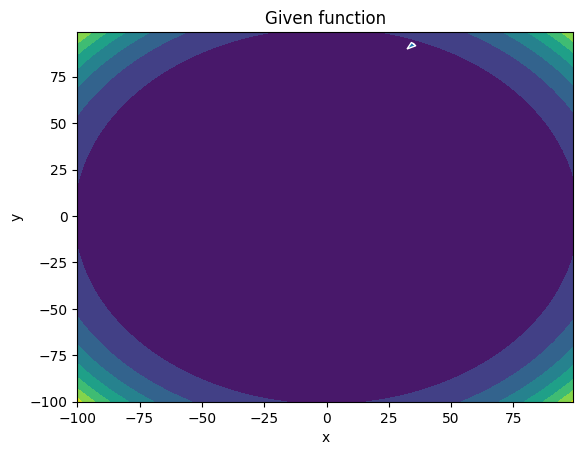

-------
Initial Coordinates:
[[34.95520737]
 [92.57216606]]
Final Coordinates:
[[34.85533914]
 [92.47224638]]
Gradient:
[[1.11666511e+11]
 [2.95796738e+11]]


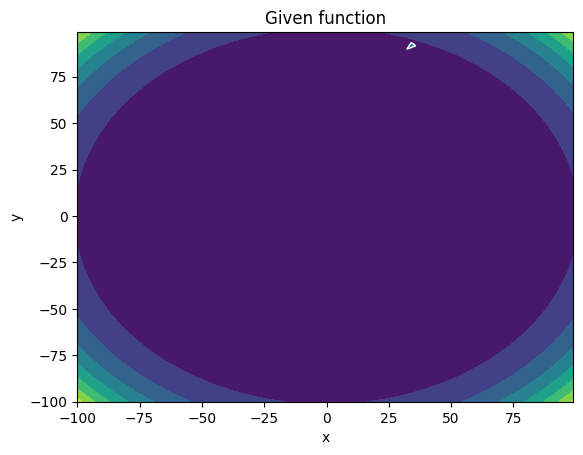

-------
Initial Coordinates:
[[34.85533914]
 [92.47224638]]
Final Coordinates:
[[34.75547861]
 [92.37233127]]
Gradient:
[[1.10768956e+11]
 [2.93942652e+11]]


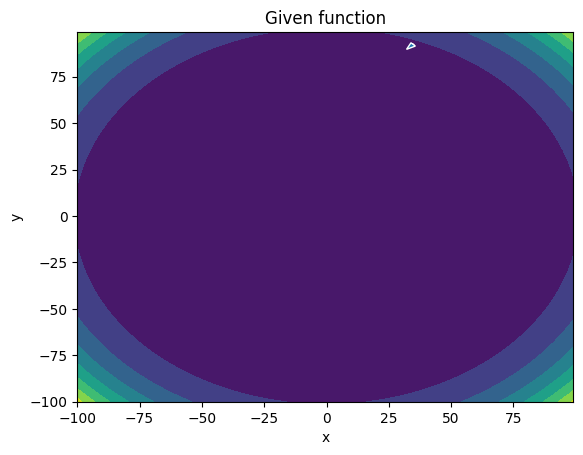

-------
Initial Coordinates:
[[34.75547861]
 [92.37233127]]
Final Coordinates:
[[34.65562576]
 [92.27242071]]
Gradient:
[[1.09877175e+11]
 [2.92098367e+11]]


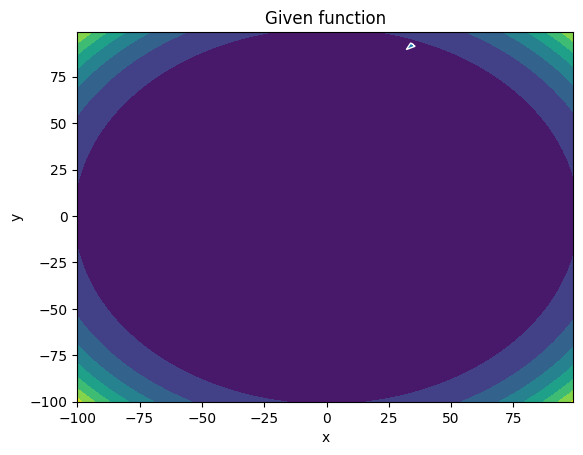

-------
Initial Coordinates:
[[34.65562576]
 [92.27242071]]
Final Coordinates:
[[34.55578055]
 [92.17251465]]
Gradient:
[[1.08991138e+11]
 [2.90263840e+11]]


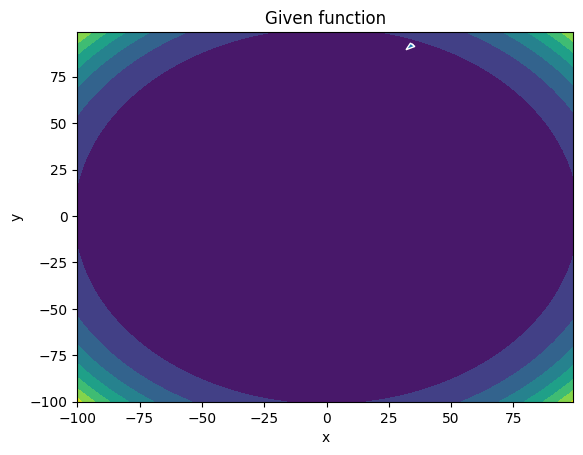

-------
Initial Coordinates:
[[34.55578055]
 [92.17251465]]
Final Coordinates:
[[34.45594292]
 [92.07261305]]
Gradient:
[[1.08110817e+11]
 [2.88439031e+11]]


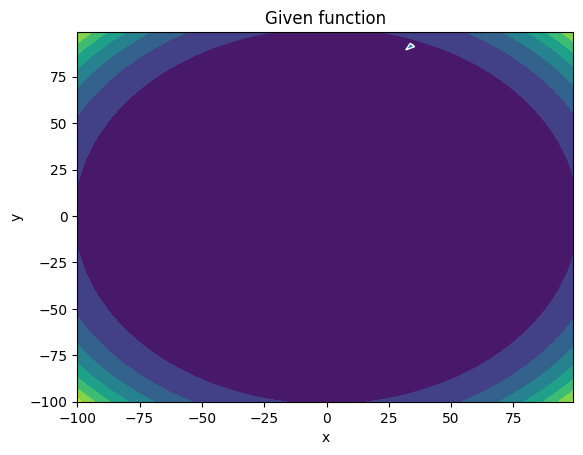

-------
Initial Coordinates:
[[34.45594292]
 [92.07261305]]
Final Coordinates:
[[34.3561128 ]
 [91.97271584]]
Gradient:
[[1.07236182e+11]
 [2.86623898e+11]]


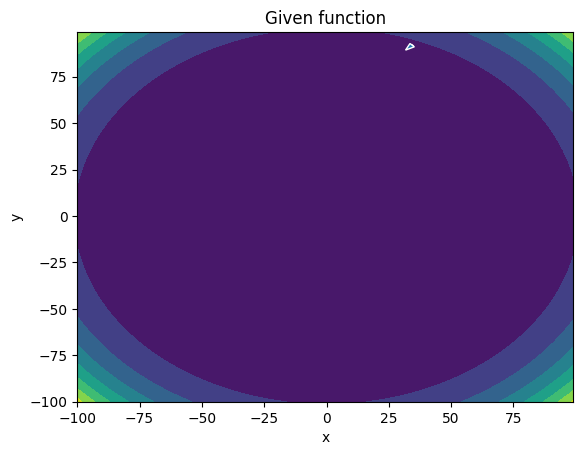

-------
Initial Coordinates:
[[34.3561128 ]
 [91.97271584]]
Final Coordinates:
[[34.25629009]
 [91.87282295]]
Gradient:
[[1.06367204e+11]
 [2.84818398e+11]]


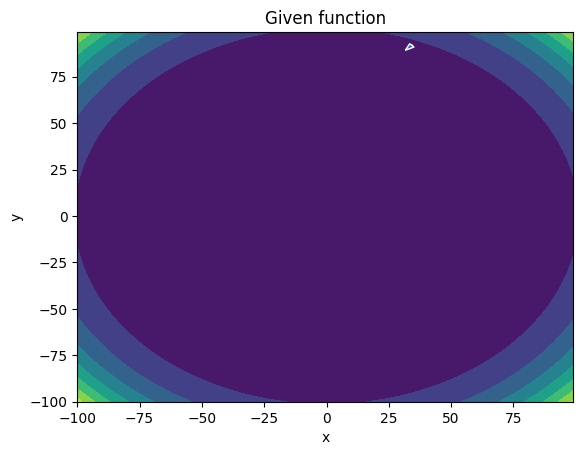

-------
Initial Coordinates:
[[34.25629009]
 [91.87282295]]
Final Coordinates:
[[34.15647469]
 [91.77293431]]
Gradient:
[[1.05503854e+11]
 [2.83022490e+11]]


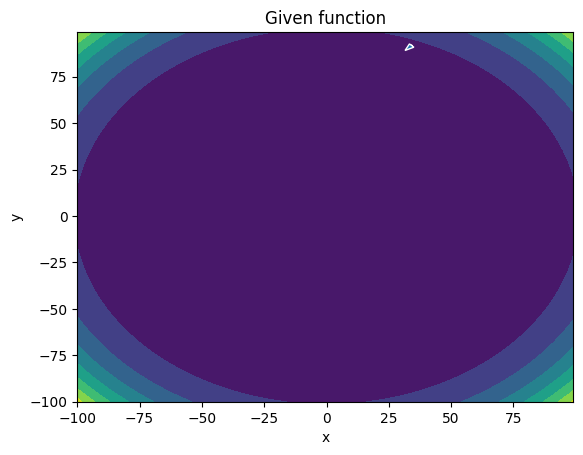

-------
Initial Coordinates:
[[34.15647469]
 [91.77293431]]
Final Coordinates:
[[34.05666649]
 [91.67304984]]
Gradient:
[[1.04646103e+11]
 [2.81236132e+11]]


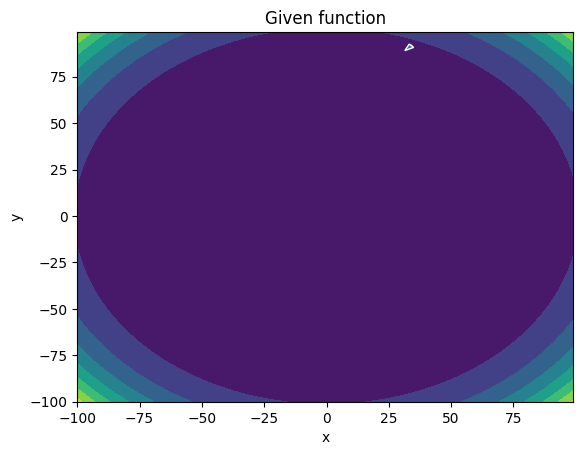

-------
Initial Coordinates:
[[34.05666649]
 [91.67304984]]
Final Coordinates:
[[33.95686536]
 [91.57316944]]
Gradient:
[[1.03793923e+11]
 [2.79459282e+11]]


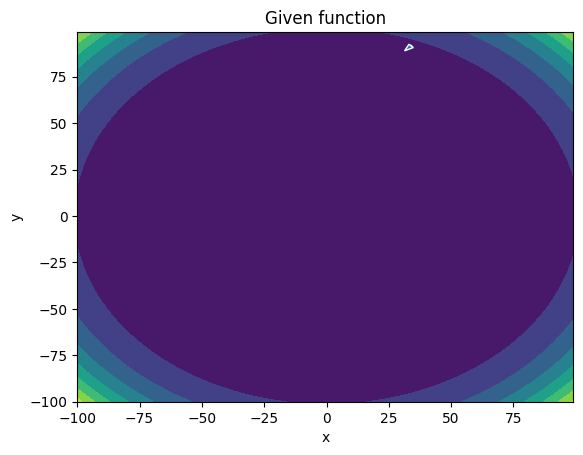

-------
Initial Coordinates:
[[33.95686536]
 [91.57316944]]
Final Coordinates:
[[33.85707118]
 [91.47329302]]
Gradient:
[[1.02947283e+11]
 [2.77691900e+11]]


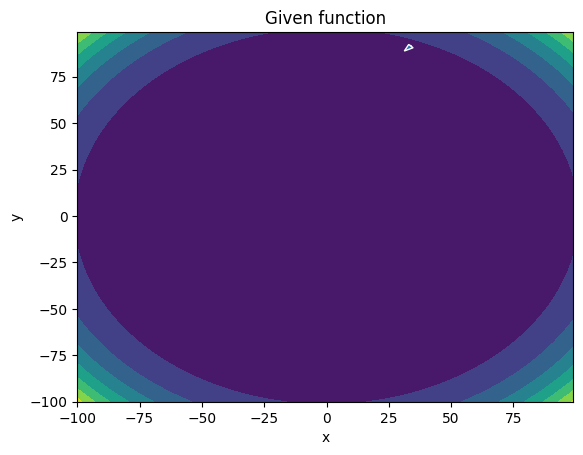

-------
Initial Coordinates:
[[33.85707118]
 [91.47329302]]
Final Coordinates:
[[33.7572838 ]
 [91.37342048]]
Gradient:
[[1.02106156e+11]
 [2.75933942e+11]]


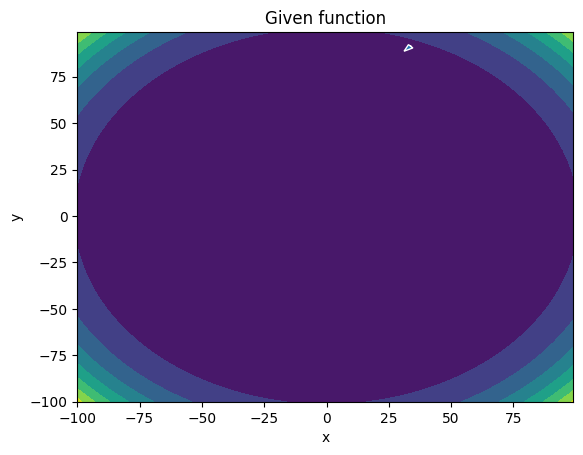

-------
Initial Coordinates:
[[33.7572838 ]
 [91.37342048]]
Final Coordinates:
[[33.65750308]
 [91.27355173]]
Gradient:
[[1.01270513e+11]
 [2.74185367e+11]]


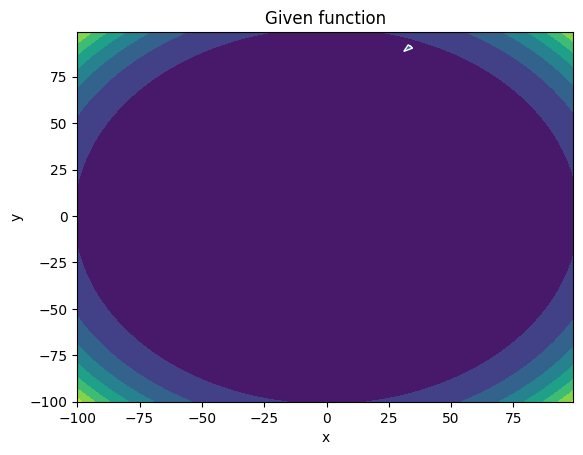

-------
Initial Coordinates:
[[33.65750308]
 [91.27355173]]
Final Coordinates:
[[33.55772887]
 [91.17368665]]
Gradient:
[[1.00440325e+11]
 [2.72446134e+11]]


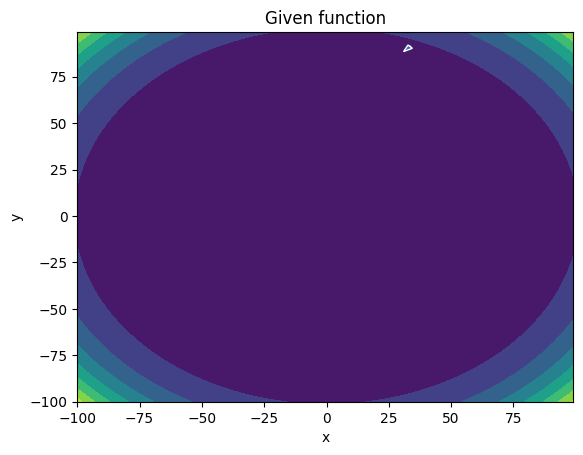

-------
Initial Coordinates:
[[33.55772887]
 [91.17368665]]
Final Coordinates:
[[33.45796101]
 [91.07382514]]
Gradient:
[[9.96155623e+10]
 [2.70716201e+11]]


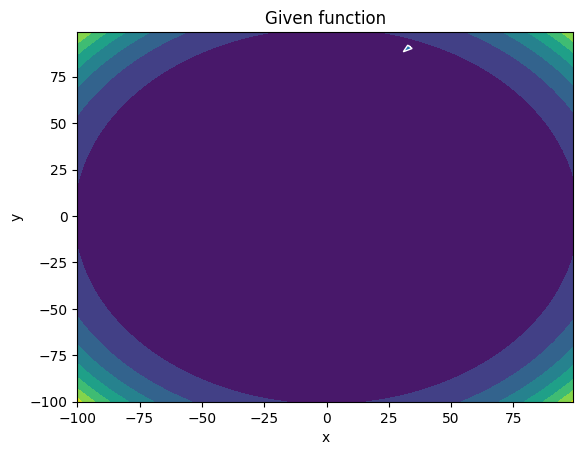

-------
Initial Coordinates:
[[33.45796101]
 [91.07382514]]
Final Coordinates:
[[33.35819934]
 [90.9739671 ]]
Gradient:
[[9.87961978e+10]
 [2.68995528e+11]]


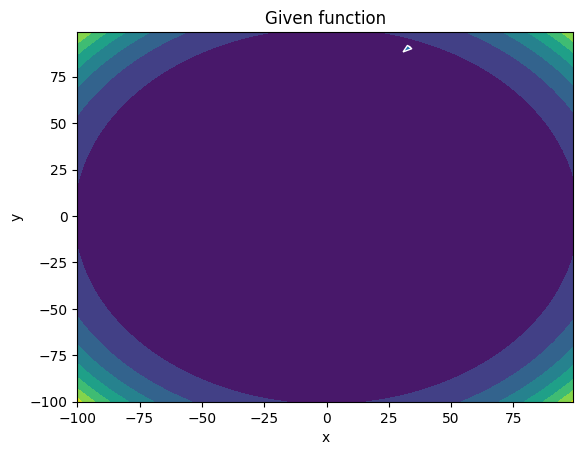

-------
Initial Coordinates:
[[33.35819934]
 [90.9739671 ]]
Final Coordinates:
[[33.25844371]
 [90.87411242]]
Gradient:
[[9.79822027e+10]
 [2.67284072e+11]]


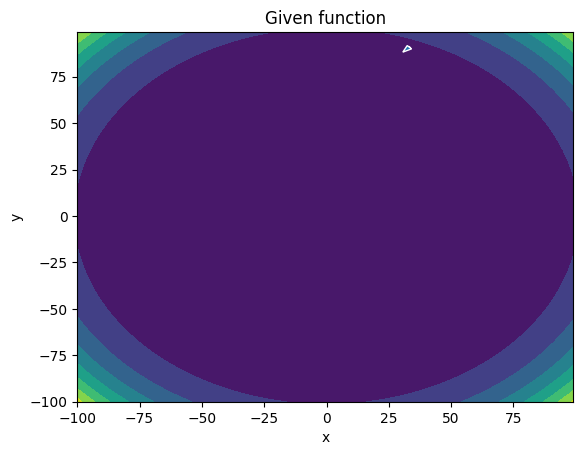

-------
Initial Coordinates:
[[33.25844371]
 [90.87411242]]
Final Coordinates:
[[33.15869395]
 [90.77426098]]
Gradient:
[[9.71735488e+10]
 [2.65581793e+11]]


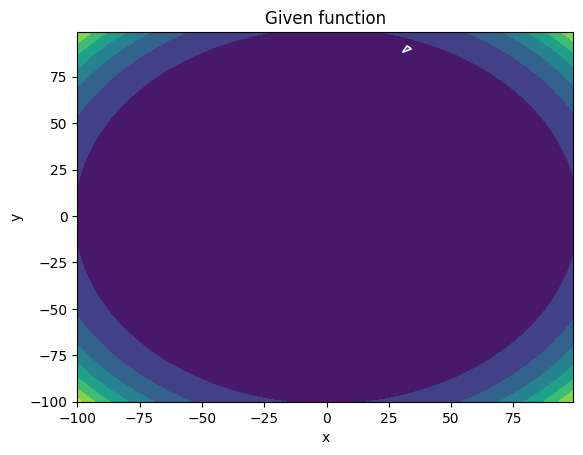

-------
Initial Coordinates:
[[33.15869395]
 [90.77426098]]
Final Coordinates:
[[33.05894989]
 [90.67441268]]
Gradient:
[[9.63702077e+10]
 [2.63888650e+11]]


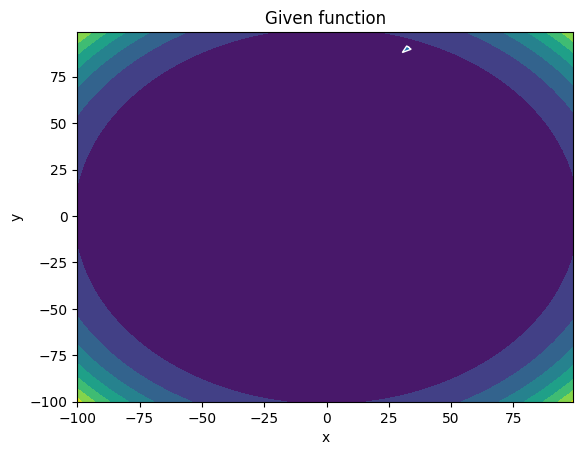

-------
Initial Coordinates:
[[33.05894989]
 [90.67441268]]
Final Coordinates:
[[32.95921139]
 [90.57456742]]
Gradient:
[[9.55721516e+10]
 [2.62204602e+11]]


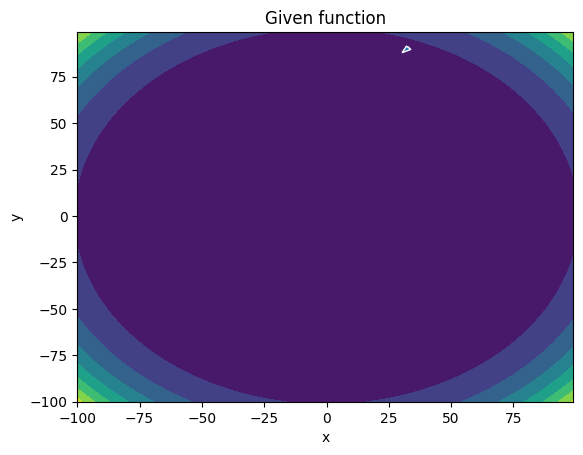

-------
Initial Coordinates:
[[32.95921139]
 [90.57456742]]
Final Coordinates:
[[32.85947828]
 [90.47472508]]
Gradient:
[[9.47793524e+10]
 [2.60529609e+11]]


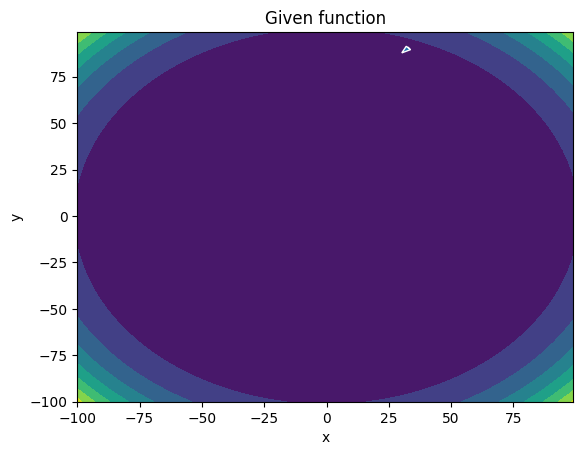

-------
Initial Coordinates:
[[32.85947828]
 [90.47472508]]
Final Coordinates:
[[32.75975039]
 [90.37488557]]
Gradient:
[[9.39917824e+10]
 [2.58863631e+11]]


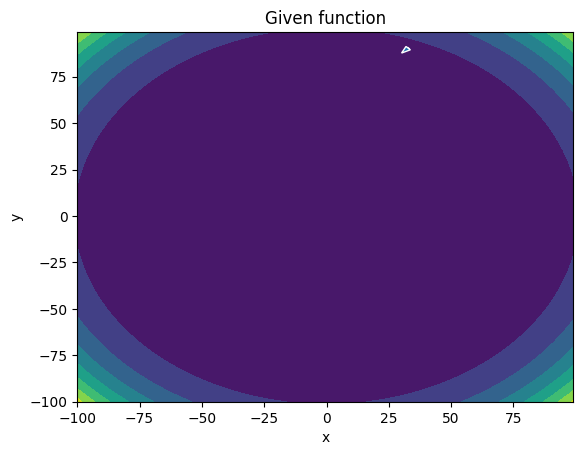

-------
Initial Coordinates:
[[32.75975039]
 [90.37488557]]
Final Coordinates:
[[32.66002757]
 [90.27504877]]
Gradient:
[[9.32094140e+10]
 [2.57206626e+11]]


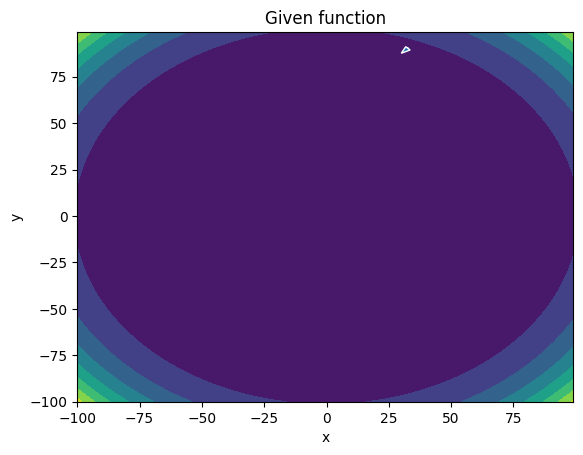

-------
Initial Coordinates:
[[32.66002757]
 [90.27504877]]
Final Coordinates:
[[32.56030968]
 [90.17521459]]
Gradient:
[[9.24322197e+10]
 [2.55558556e+11]]


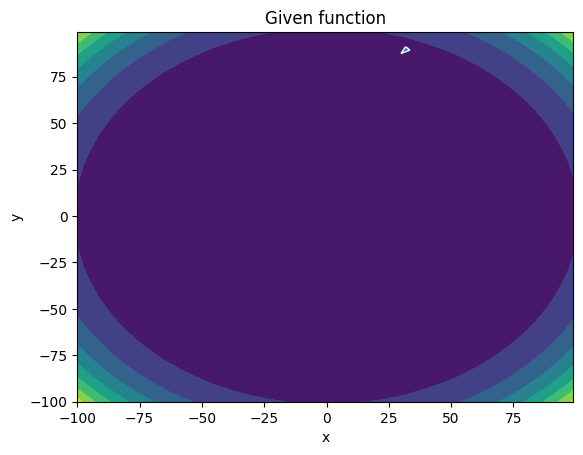

-------
Initial Coordinates:
[[32.56030968]
 [90.17521459]]
Final Coordinates:
[[32.46059654]
 [90.07538292]]
Gradient:
[[9.1660172e+10]
 [2.5391938e+11]]


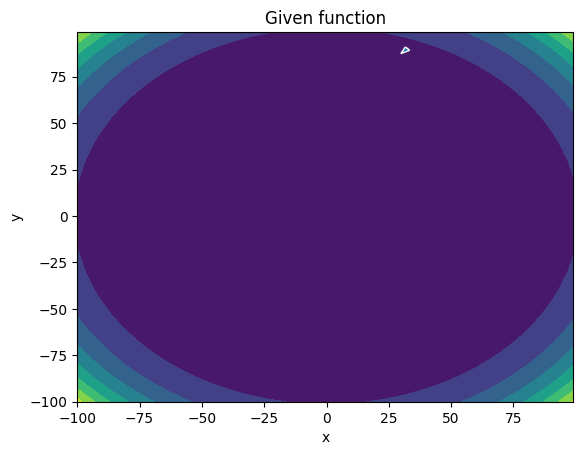

-------
Initial Coordinates:
[[32.46059654]
 [90.07538292]]
Final Coordinates:
[[32.36088802]
 [89.97555368]]
Gradient:
[[9.08932439e+10]
 [2.52289059e+11]]


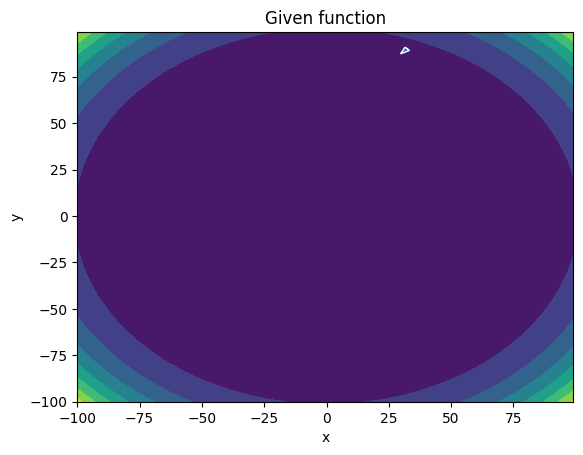

-------
Initial Coordinates:
[[32.36088802]
 [89.97555368]]
Final Coordinates:
[[32.26118397]
 [89.87572676]]
Gradient:
[[9.01314081e+10]
 [2.50667553e+11]]


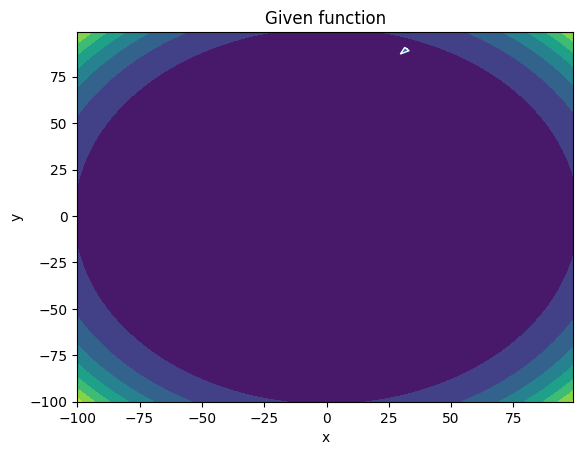

-------
Initial Coordinates:
[[32.26118397]
 [89.87572676]]
Final Coordinates:
[[32.16148426]
 [89.77590208]]
Gradient:
[[8.93746377e+10]
 [2.49054823e+11]]


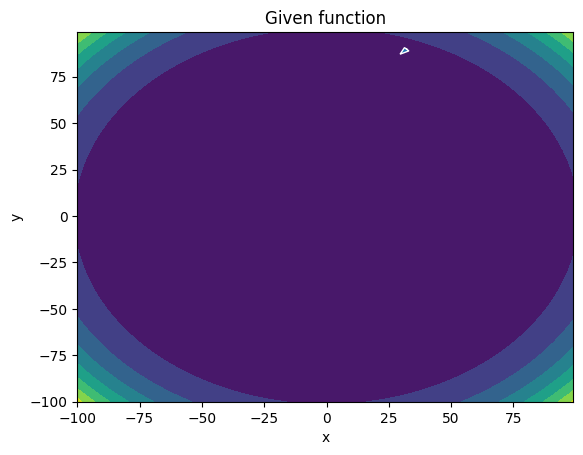

-------
Initial Coordinates:
[[32.16148426]
 [89.77590208]]
Final Coordinates:
[[32.06178873]
 [89.67607955]]
Gradient:
[[8.86229060e+10]
 [2.47450831e+11]]


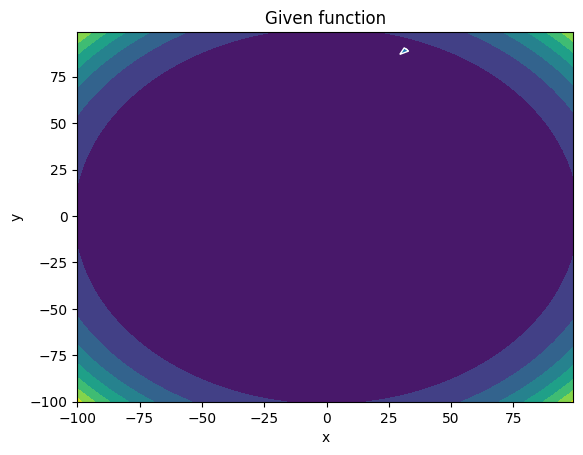

-------
Initial Coordinates:
[[32.06178873]
 [89.67607955]]
Final Coordinates:
[[31.96209727]
 [89.57625908]]
Gradient:
[[8.78761863e+10]
 [2.45855536e+11]]


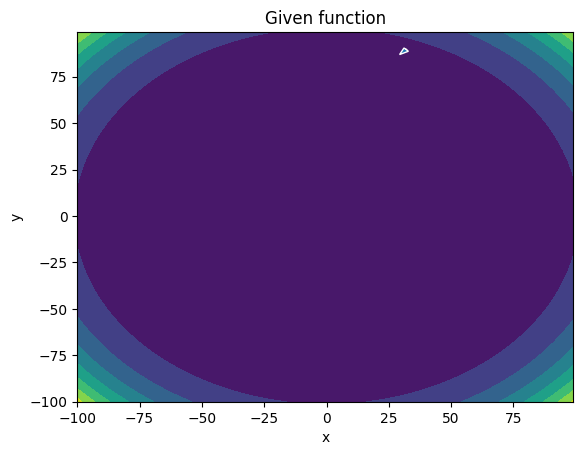

-------
Initial Coordinates:
[[31.96209727]
 [89.57625908]]
Final Coordinates:
[[31.86240974]
 [89.47644059]]
Gradient:
[[8.71344521e+10]
 [2.44268902e+11]]


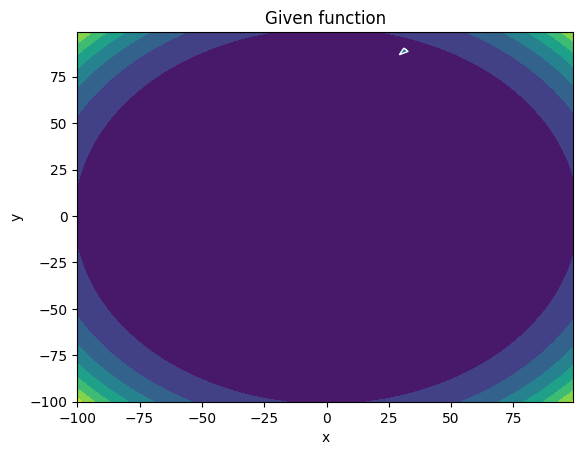

-------
Initial Coordinates:
[[31.86240974]
 [89.47644059]]
Final Coordinates:
[[31.76272603]
 [89.376624  ]]
Gradient:
[[8.63976770e+10]
 [2.42690888e+11]]


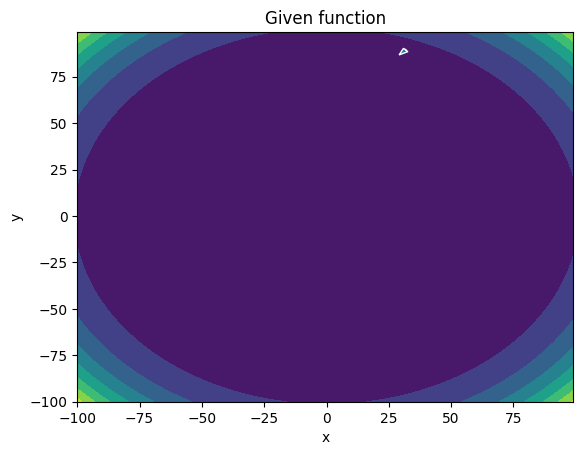

-------
Initial Coordinates:
[[31.76272603]
 [89.376624  ]]
Final Coordinates:
[[31.663046  ]
 [89.27680923]]
Gradient:
[[8.56658347e+10]
 [2.41121458e+11]]


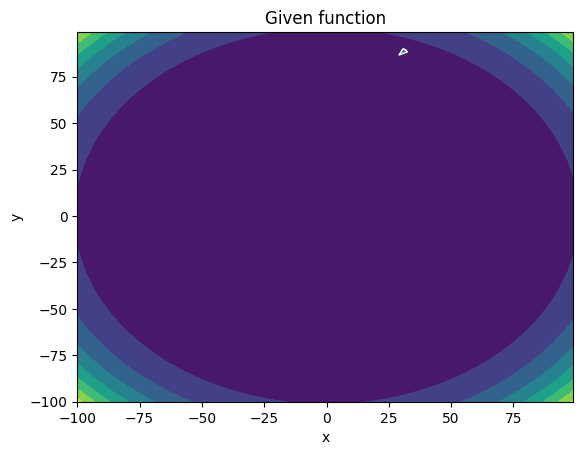

-------
Initial Coordinates:
[[31.663046  ]
 [89.27680923]]
Final Coordinates:
[[31.56336955]
 [89.17699622]]
Gradient:
[[8.49388993e+10]
 [2.39560573e+11]]


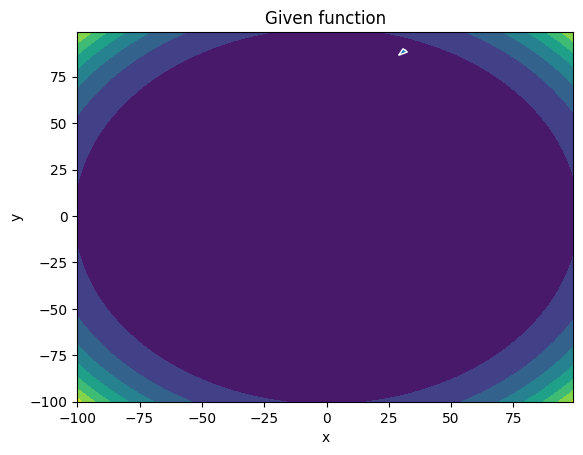

-------
Initial Coordinates:
[[31.56336955]
 [89.17699622]]
Final Coordinates:
[[31.46369657]
 [89.07718488]]
Gradient:
[[8.42168447e+10]
 [2.38008195e+11]]


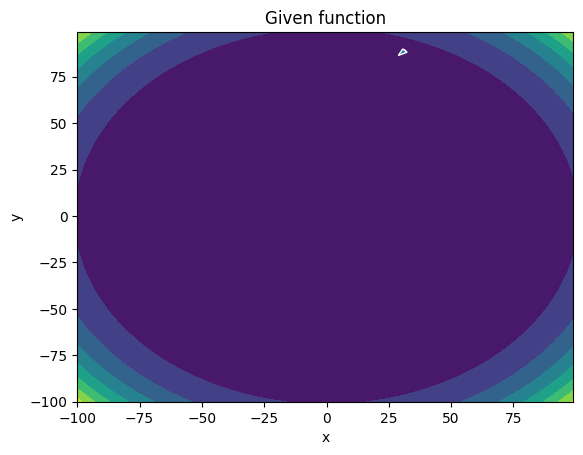

-------
Initial Coordinates:
[[31.46369657]
 [89.07718488]]
Final Coordinates:
[[31.36402695]
 [88.97737516]]
Gradient:
[[8.34996451e+10]
 [2.36464287e+11]]


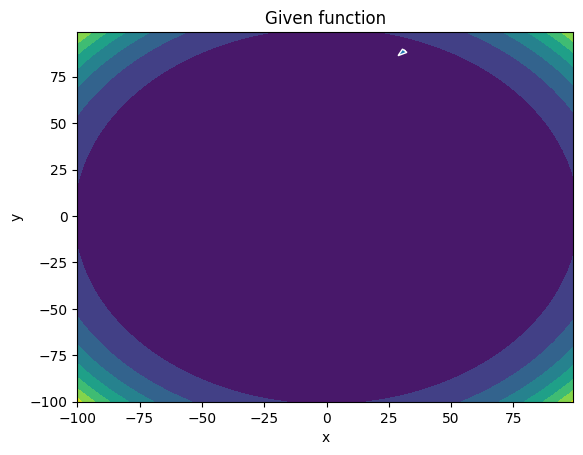

-------
Initial Coordinates:
[[31.36402695]
 [88.97737516]]
Final Coordinates:
[[31.2643606 ]
 [88.87756699]]
Gradient:
[[8.27872748e+10]
 [2.34928811e+11]]


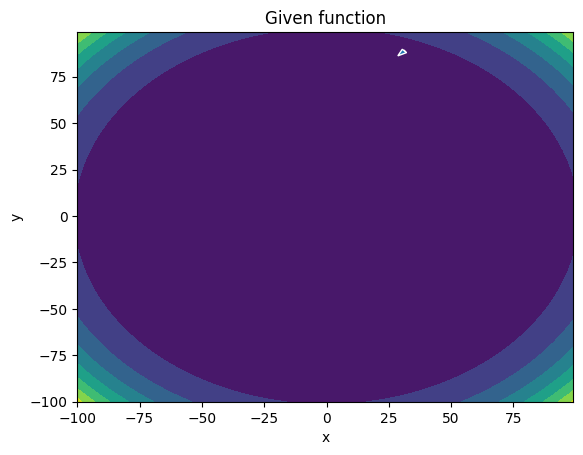

-------
Initial Coordinates:
[[31.2643606 ]
 [88.87756699]]
Final Coordinates:
[[31.16469741]
 [88.77776031]]
Gradient:
[[8.20797084e+10]
 [2.33401729e+11]]


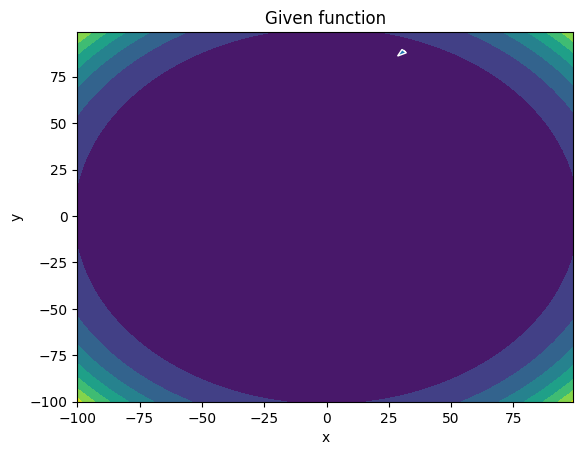

-------
Initial Coordinates:
[[31.16469741]
 [88.77776031]]
Final Coordinates:
[[31.06503731]
 [88.67795506]]
Gradient:
[[8.13769203e+10]
 [2.31883006e+11]]


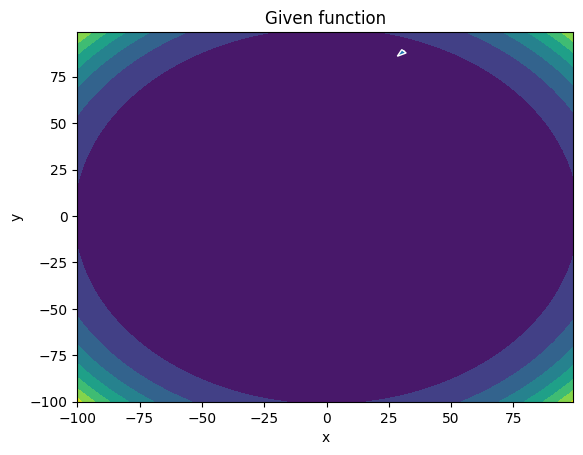

-------
Initial Coordinates:
[[31.06503731]
 [88.67795506]]
Final Coordinates:
[[30.96538019]
 [88.57815118]]
Gradient:
[[8.06788854e+10]
 [2.30372603e+11]]


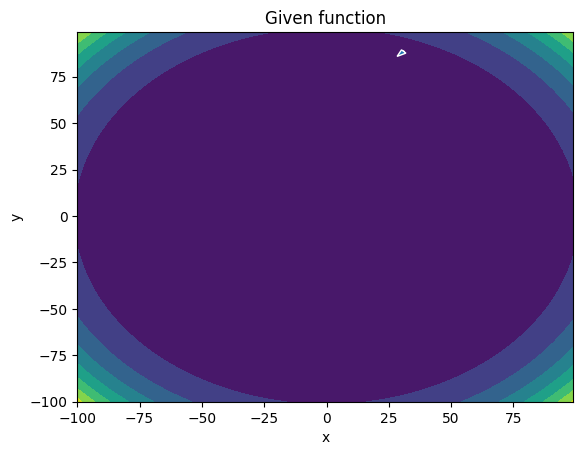

-------
Initial Coordinates:
[[30.96538019]
 [88.57815118]]
Final Coordinates:
[[30.86572598]
 [88.47834863]]
Gradient:
[[7.99855784e+10]
 [2.28870485e+11]]


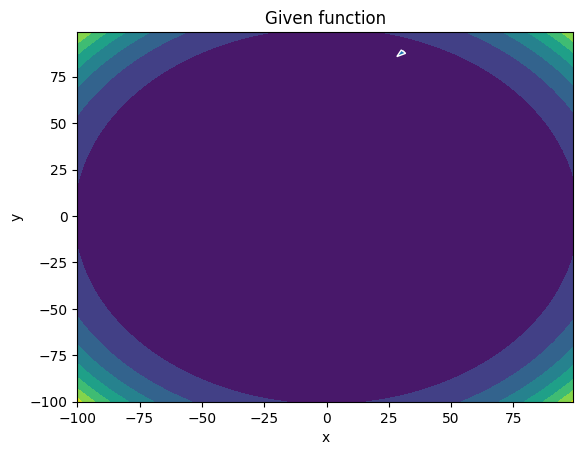

-------
Initial Coordinates:
[[30.86572598]
 [88.47834863]]
Final Coordinates:
[[30.76607461]
 [88.37854734]]
Gradient:
[[7.92969743e+10]
 [2.27376614e+11]]


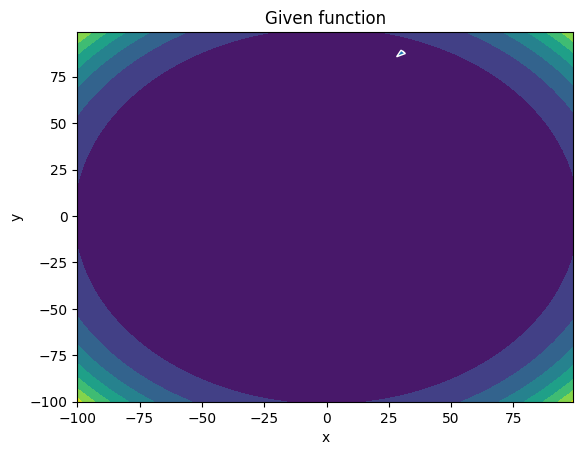

-------
Initial Coordinates:
[[30.76607461]
 [88.37854734]]
Final Coordinates:
[[30.66642599]
 [88.27874728]]
Gradient:
[[7.86130483e+10]
 [2.25890954e+11]]


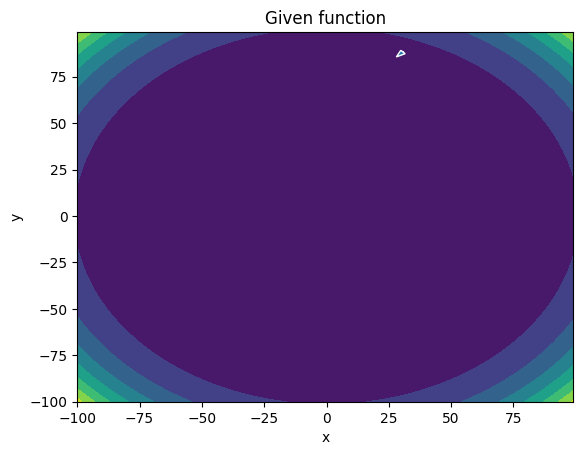

-------
Initial Coordinates:
[[30.66642599]
 [88.27874728]]
Final Coordinates:
[[30.56678007]
 [88.17894841]]
Gradient:
[[7.79337755e+10]
 [2.24413470e+11]]


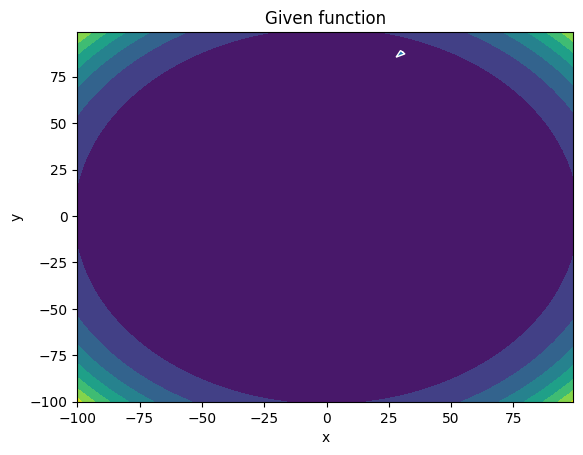

-------
Initial Coordinates:
[[30.56678007]
 [88.17894841]]
Final Coordinates:
[[30.46713676]
 [88.07915066]]
Gradient:
[[7.72591313e+10]
 [2.22944124e+11]]


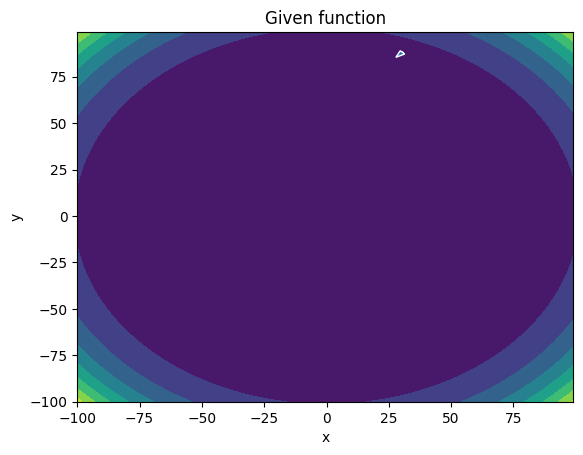

-------
Initial Coordinates:
[[30.46713676]
 [88.07915066]]
Final Coordinates:
[[30.36749602]
 [87.97935402]]
Gradient:
[[7.65890912e+10]
 [2.21482882e+11]]


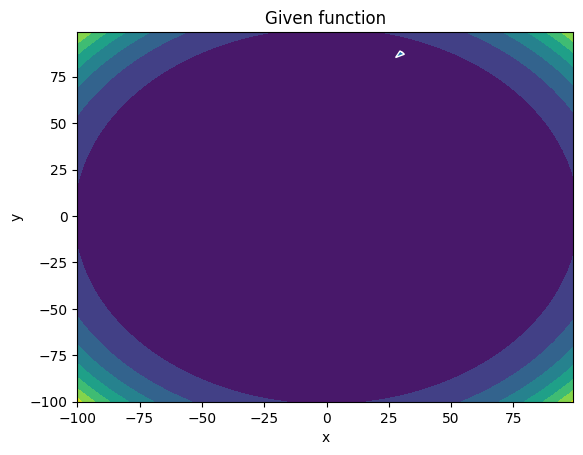

-------
Initial Coordinates:
[[30.36749602]
 [87.97935402]]
Final Coordinates:
[[30.26785779]
 [87.87955843]]
Gradient:
[[7.59236308e+10]
 [2.20029707e+11]]


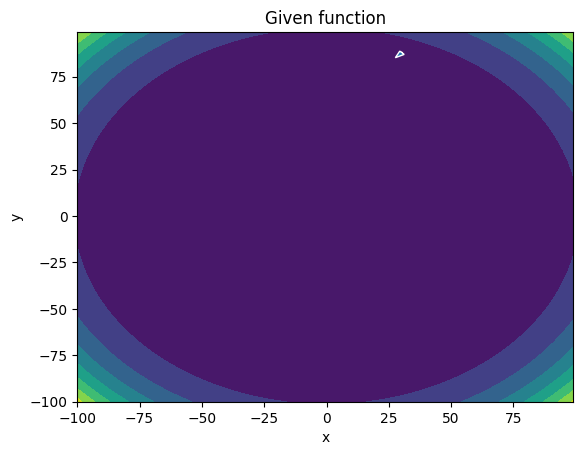

-------
Initial Coordinates:
[[30.26785779]
 [87.87955843]]
Final Coordinates:
[[30.168222  ]
 [87.77976387]]
Gradient:
[[7.52627257e+10]
 [2.18584564e+11]]


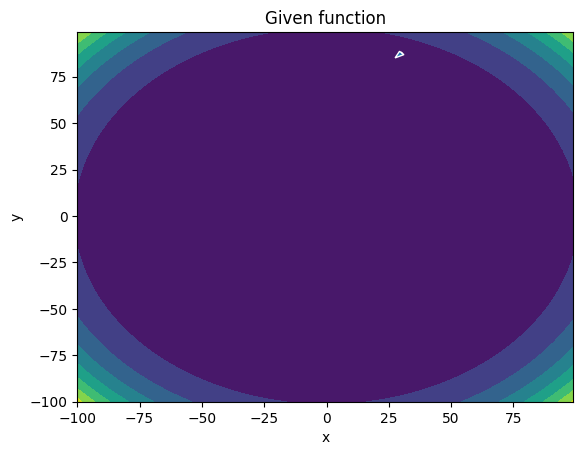

-------
Initial Coordinates:
[[30.168222  ]
 [87.77976387]]
Final Coordinates:
[[30.06858862]
 [87.6799703 ]]
Gradient:
[[7.46063519e+10]
 [2.17147417e+11]]


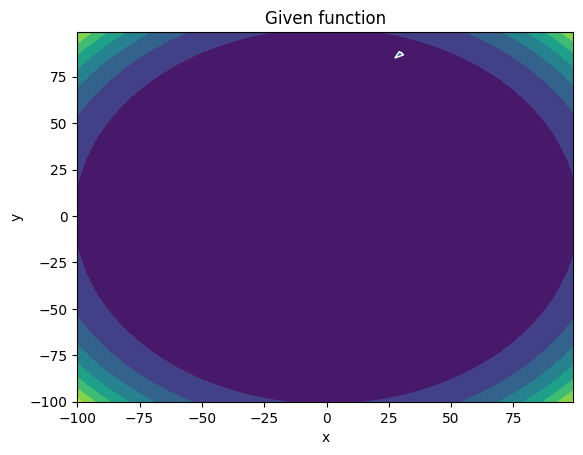

-------
Initial Coordinates:
[[30.06858862]
 [87.6799703 ]]
Final Coordinates:
[[29.96895758]
 [87.58017768]]
Gradient:
[[7.39544851e+10]
 [2.15718232e+11]]


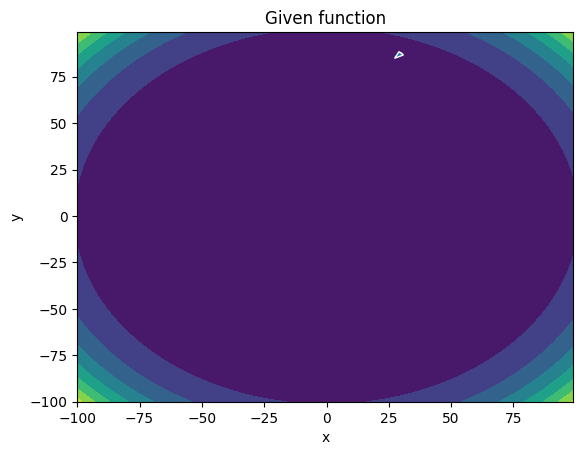

-------
Initial Coordinates:
[[29.96895758]
 [87.58017768]]
Final Coordinates:
[[29.86932886]
 [87.48038599]]
Gradient:
[[7.33071015e+10]
 [2.14296973e+11]]


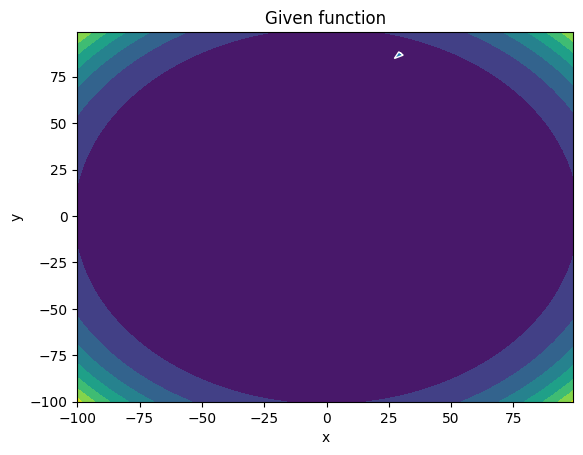

-------
Initial Coordinates:
[[29.86932886]
 [87.48038599]]
Final Coordinates:
[[29.7697024 ]
 [87.38059521]]
Gradient:
[[7.26641772e+10]
 [2.12883605e+11]]


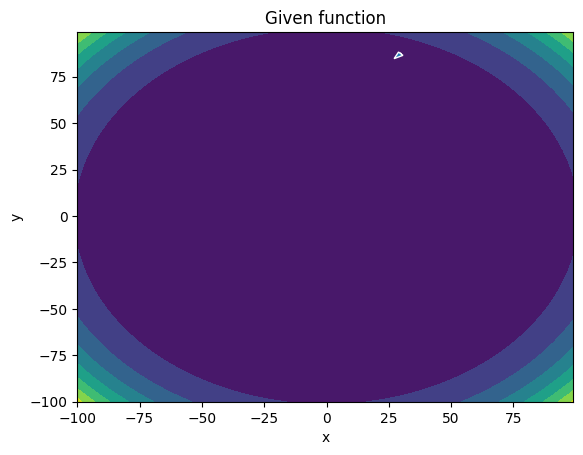

-------
Initial Coordinates:
[[29.7697024 ]
 [87.38059521]]
Final Coordinates:
[[29.67007817]
 [87.28080529]]
Gradient:
[[7.20256884e+10]
 [2.11478094e+11]]


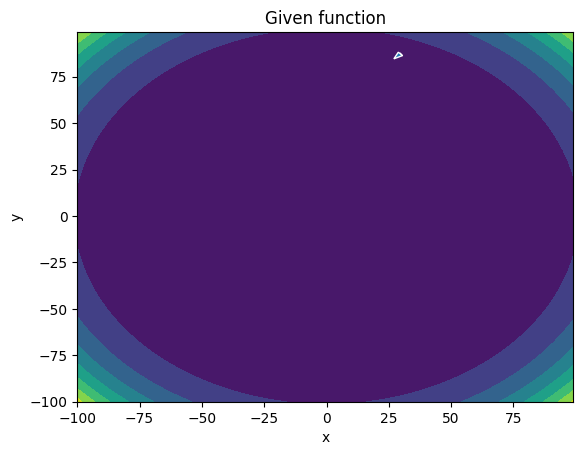

-------
Initial Coordinates:
[[29.67007817]
 [87.28080529]]
Final Coordinates:
[[29.57045614]
 [87.18101623]]
Gradient:
[[7.13916116e+10]
 [2.10080404e+11]]


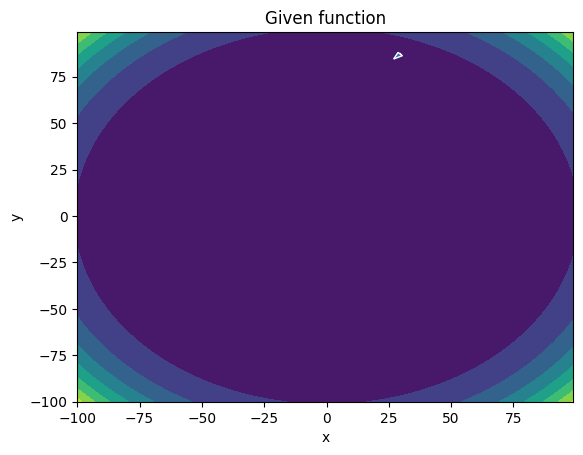

-------
Initial Coordinates:
[[29.57045614]
 [87.18101623]]
Final Coordinates:
[[29.47083627]
 [87.08122799]]
Gradient:
[[7.07619233e+10]
 [2.08690502e+11]]


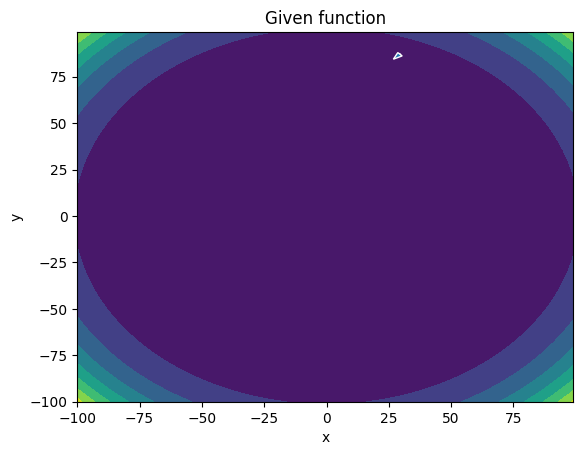

-------
Initial Coordinates:
[[29.47083627]
 [87.08122799]]
Final Coordinates:
[[29.37121852]
 [86.98144055]]
Gradient:
[[7.01365999e+10]
 [2.07308352e+11]]


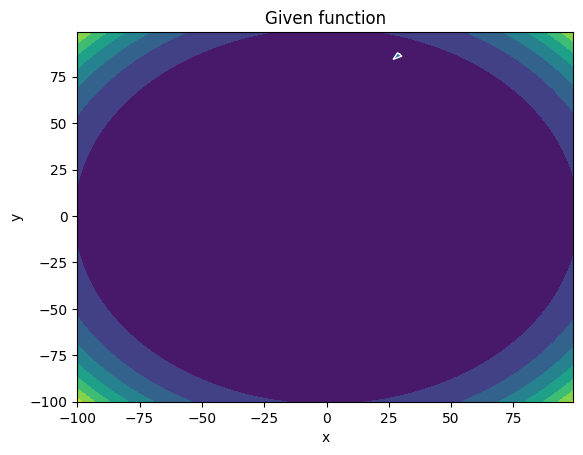

-------
Initial Coordinates:
[[29.37121852]
 [86.98144055]]
Final Coordinates:
[[29.27160288]
 [86.8816539 ]]
Gradient:
[[6.95156181e+10]
 [2.05933921e+11]]


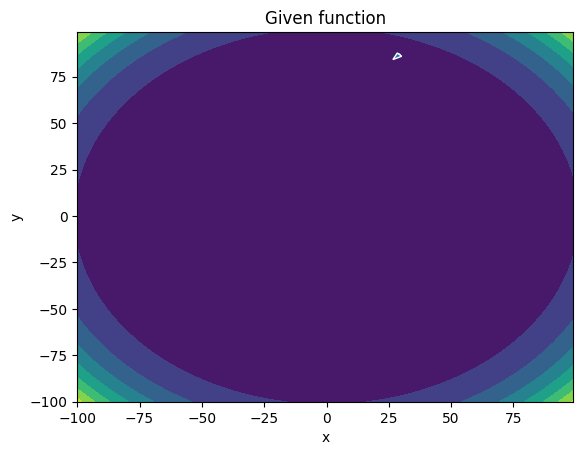

-------
Initial Coordinates:
[[29.27160288]
 [86.8816539 ]]
Final Coordinates:
[[29.17198932]
 [86.78186802]]
Gradient:
[[6.88989549e+10]
 [2.04567174e+11]]


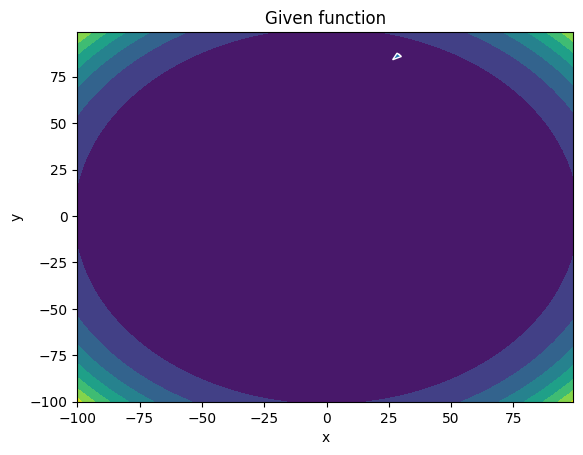

-------
Initial Coordinates:
[[29.17198932]
 [86.78186802]]
Final Coordinates:
[[29.07237782]
 [86.68208288]]
Gradient:
[[6.82865870e+10]
 [2.03208078e+11]]


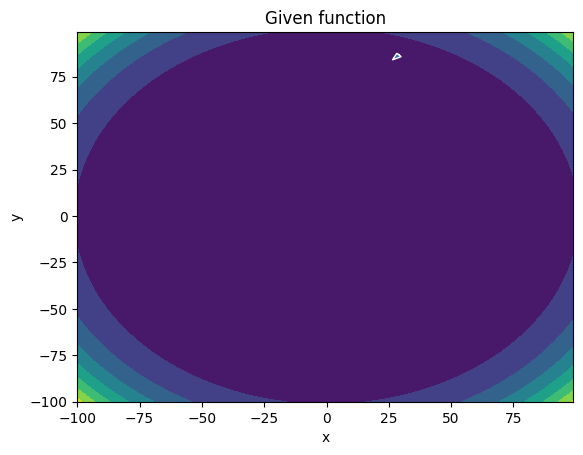

-------
Initial Coordinates:
[[29.07237782]
 [86.68208288]]
Final Coordinates:
[[28.97276834]
 [86.58229847]]
Gradient:
[[6.76784914e+10]
 [2.01856599e+11]]


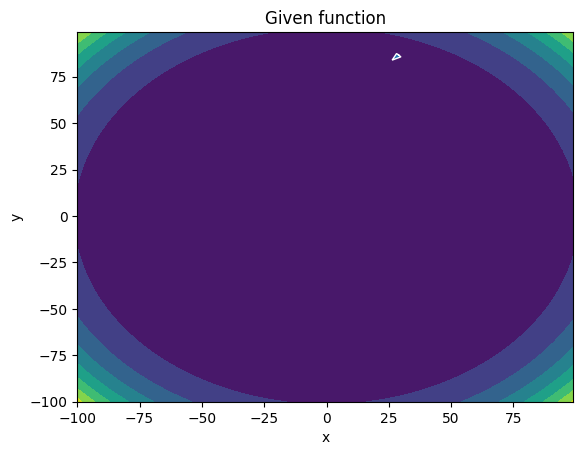

-------
Initial Coordinates:
[[28.97276834]
 [86.58229847]]
Final Coordinates:
[[28.87316089]
 [86.48251477]]
Gradient:
[[6.70746452e+10]
 [2.00512702e+11]]


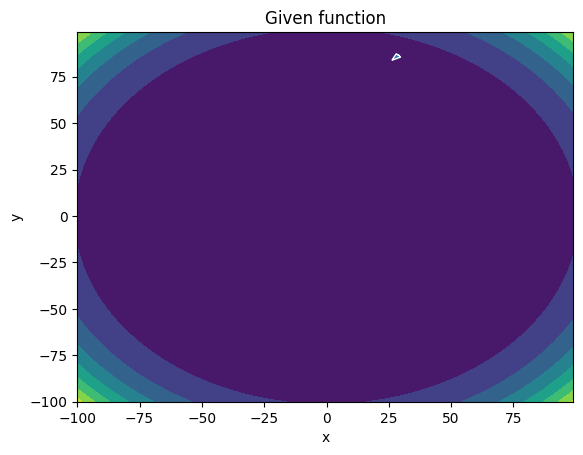

-------
Initial Coordinates:
[[28.87316089]
 [86.48251477]]
Final Coordinates:
[[28.77355543]
 [86.38273178]]
Gradient:
[[6.64750256e+10]
 [1.99176355e+11]]


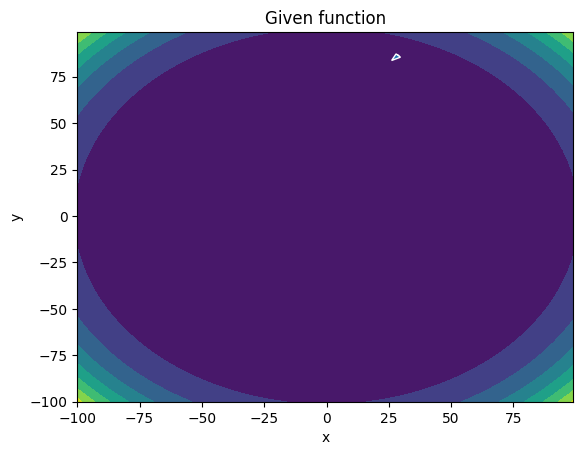

-------
Initial Coordinates:
[[28.77355543]
 [86.38273178]]
Final Coordinates:
[[28.67395195]
 [86.28294948]]
Gradient:
[[6.58796099e+10]
 [1.97847524e+11]]


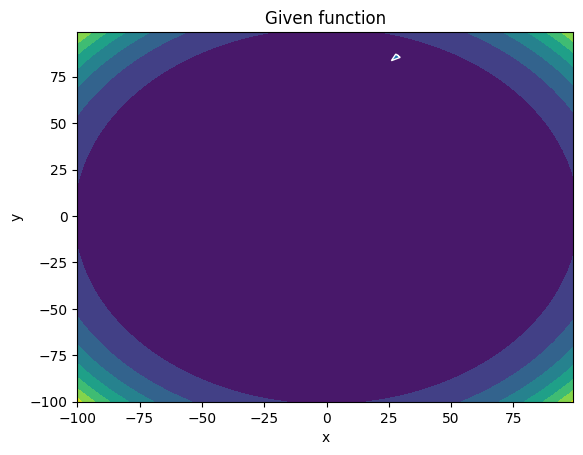

-------
Initial Coordinates:
[[28.67395195]
 [86.28294948]]
Final Coordinates:
[[28.57435044]
 [86.18316785]]
Gradient:
[[6.52883754e+10]
 [1.96526175e+11]]


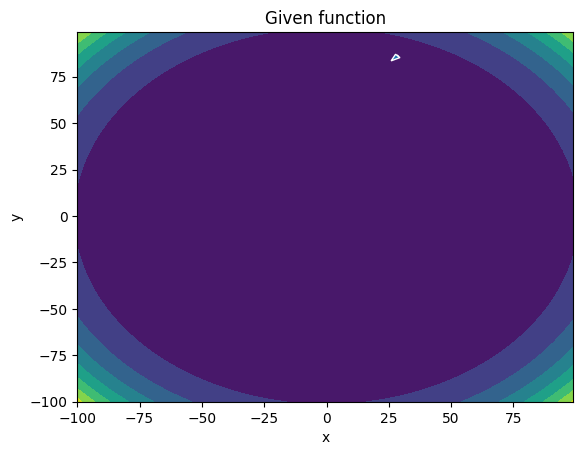

-------
Initial Coordinates:
[[28.57435044]
 [86.18316785]]
Final Coordinates:
[[28.47475089]
 [86.08338688]]
Gradient:
[[6.47012996e+10]
 [1.95212276e+11]]


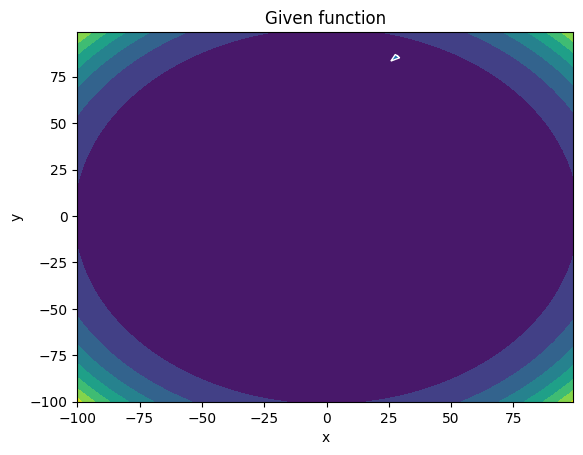

-------
Initial Coordinates:
[[28.47475089]
 [86.08338688]]
Final Coordinates:
[[28.37515329]
 [85.98360657]]
Gradient:
[[6.41183600e+10]
 [1.93905792e+11]]


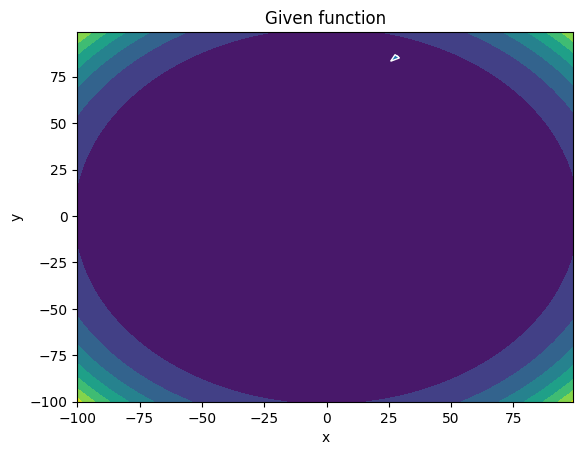

-------
Initial Coordinates:
[[28.37515329]
 [85.98360657]]
Final Coordinates:
[[28.27555762]
 [85.8838269 ]]
Gradient:
[[6.35395344e+10]
 [1.92606692e+11]]


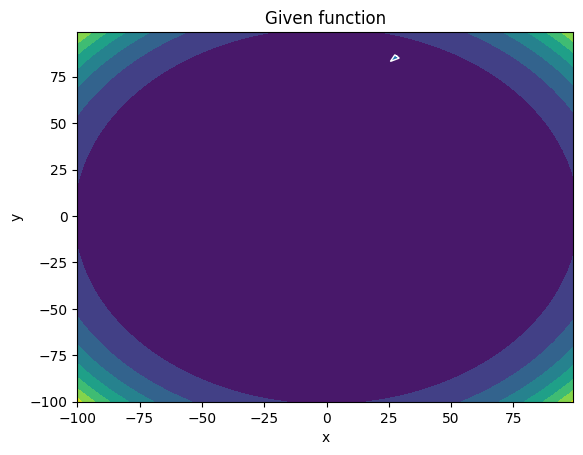

-------
Initial Coordinates:
[[28.27555762]
 [85.8838269 ]]
Final Coordinates:
[[28.17596389]
 [85.78404787]]
Gradient:
[[6.29648004e+10]
 [1.91314942e+11]]


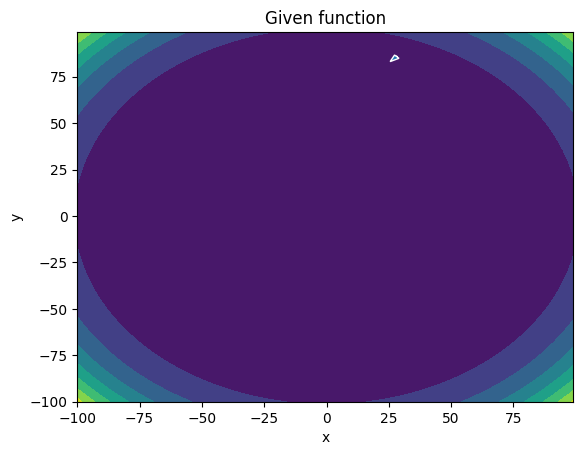

-------
Initial Coordinates:
[[28.17596389]
 [85.78404787]]
Final Coordinates:
[[28.07637208]
 [85.68426946]]
Gradient:
[[6.23941359e+10]
 [1.90030510e+11]]


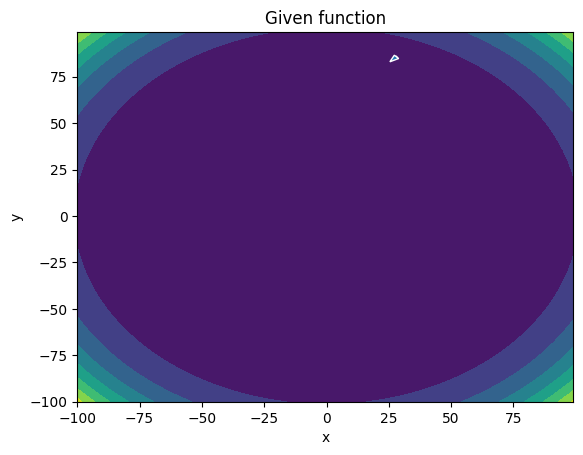

-------
Initial Coordinates:
[[28.07637208]
 [85.68426946]]
Final Coordinates:
[[27.97678219]
 [85.58449167]]
Gradient:
[[6.18275187e+10]
 [1.88753362e+11]]


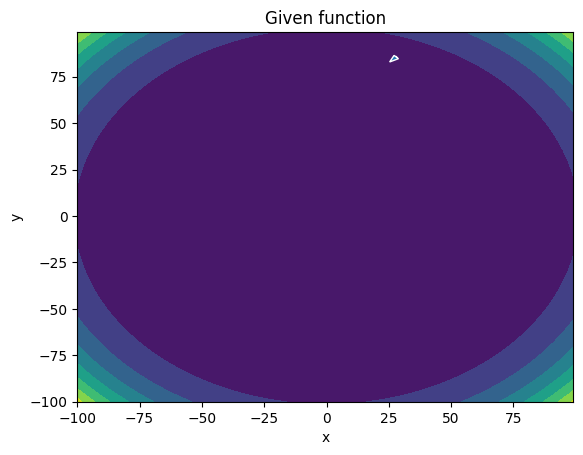

-------
Initial Coordinates:
[[27.97678219]
 [85.58449167]]
Final Coordinates:
[[27.87719422]
 [85.48471449]]
Gradient:
[[6.12649270e+10]
 [1.87483467e+11]]


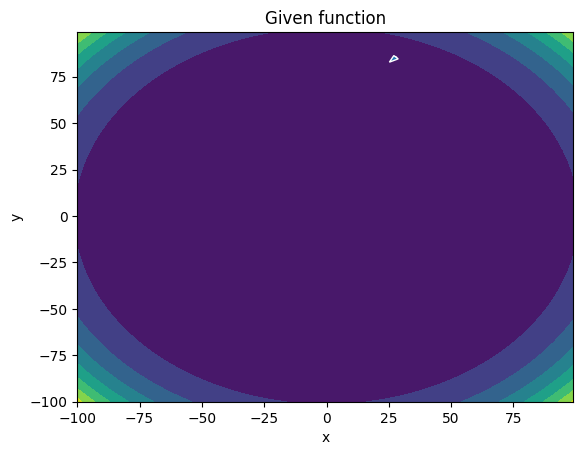

-------
Initial Coordinates:
[[27.87719422]
 [85.48471449]]
Final Coordinates:
[[27.77760816]
 [85.38493792]]
Gradient:
[[6.07063388e+10]
 [1.86220792e+11]]


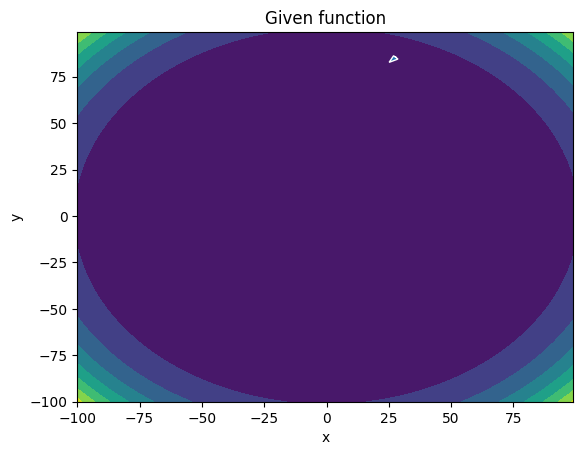

-------
Initial Coordinates:
[[27.77760816]
 [85.38493792]]
Final Coordinates:
[[27.67802401]
 [85.28516194]]
Gradient:
[[6.01517323e+10]
 [1.84965304e+11]]


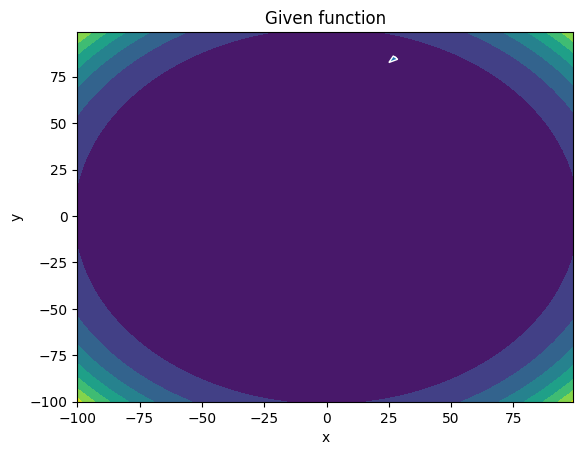

-------
Initial Coordinates:
[[27.67802401]
 [85.28516194]]
Final Coordinates:
[[27.57844178]
 [85.18538656]]
Gradient:
[[5.96010857e+10]
 [1.83716972e+11]]


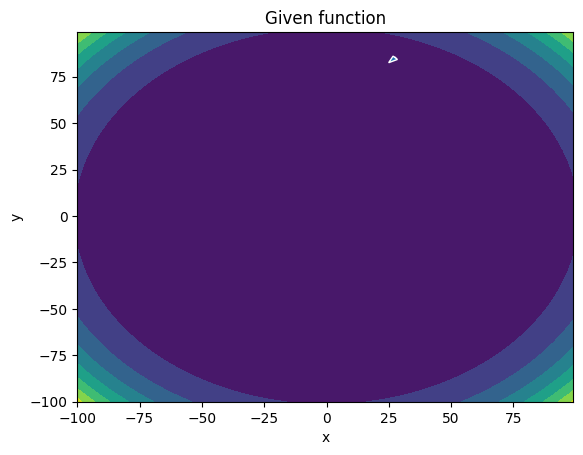

-------
Initial Coordinates:
[[27.57844178]
 [85.18538656]]
Final Coordinates:
[[27.47886146]
 [85.08561176]]
Gradient:
[[5.90543775e+10]
 [1.82475763e+11]]


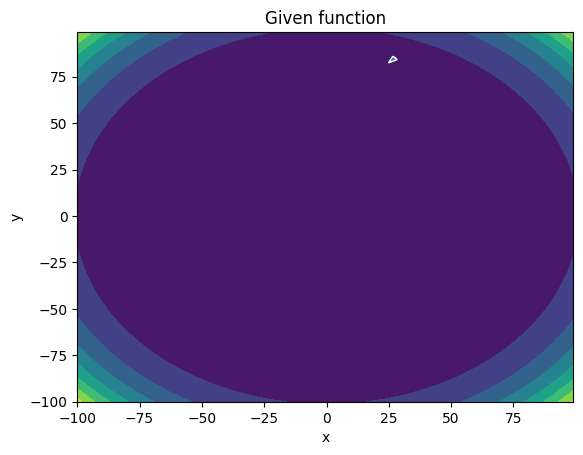

-------
Initial Coordinates:
[[27.47886146]
 [85.08561176]]
Final Coordinates:
[[27.37928305]
 [84.98583755]]
Gradient:
[[5.85115861e+10]
 [1.81241645e+11]]


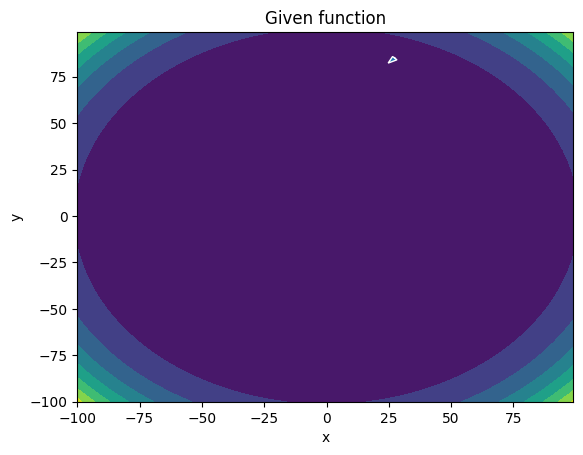

-------
Initial Coordinates:
[[27.37928305]
 [84.98583755]]
Final Coordinates:
[[27.27970657]
 [84.88606392]]
Gradient:
[[5.79726900e+10]
 [1.80014587e+11]]


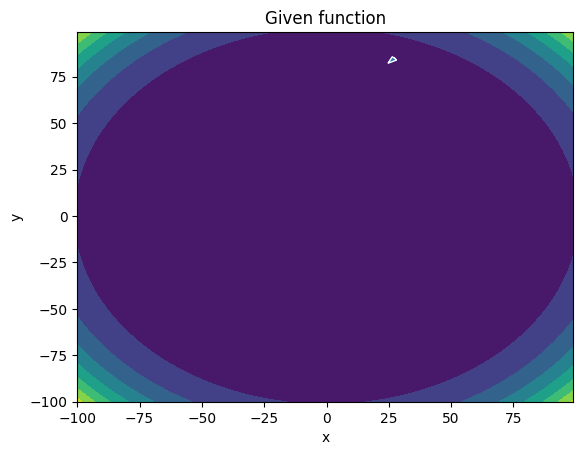

-------
Initial Coordinates:
[[27.27970657]
 [84.88606392]]
Final Coordinates:
[[27.180132  ]
 [84.78629086]]
Gradient:
[[5.74376678e+10]
 [1.78794557e+11]]


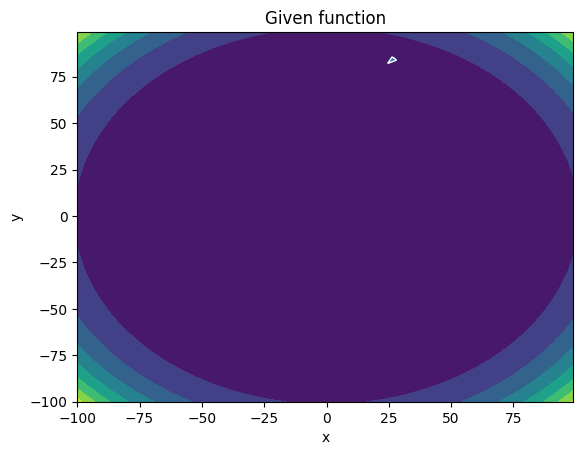

-------
Initial Coordinates:
[[27.180132  ]
 [84.78629086]]
Final Coordinates:
[[27.08055936]
 [84.68651837]]
Gradient:
[[5.69064983e+10]
 [1.77581522e+11]]


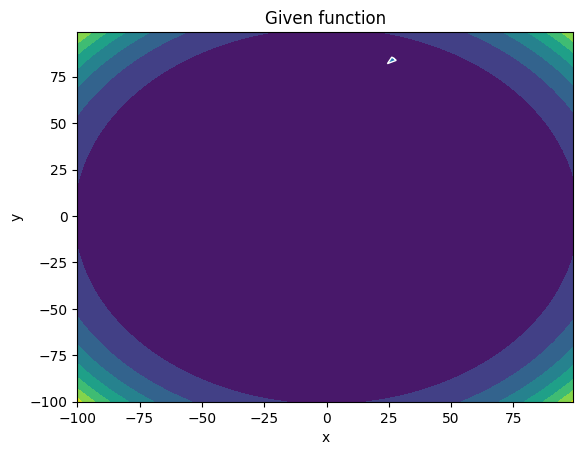

-------
Initial Coordinates:
[[27.08055936]
 [84.68651837]]
Final Coordinates:
[[26.98098864]
 [84.58674645]]
Gradient:
[[5.63791602e+10]
 [1.76375453e+11]]


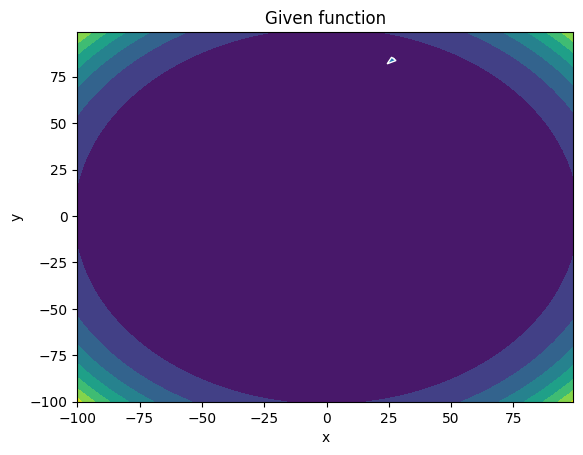

-------
Initial Coordinates:
[[26.98098864]
 [84.58674645]]
Final Coordinates:
[[26.88141986]
 [84.4869751 ]]
Gradient:
[[5.58556324e+10]
 [1.75176316e+11]]


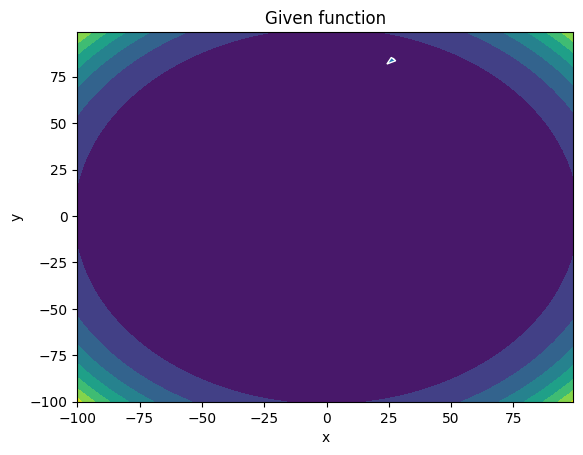

-------
Initial Coordinates:
[[26.88141986]
 [84.4869751 ]]
Final Coordinates:
[[26.78185303]
 [84.38720431]]
Gradient:
[[5.53358938e+10]
 [1.73984081e+11]]


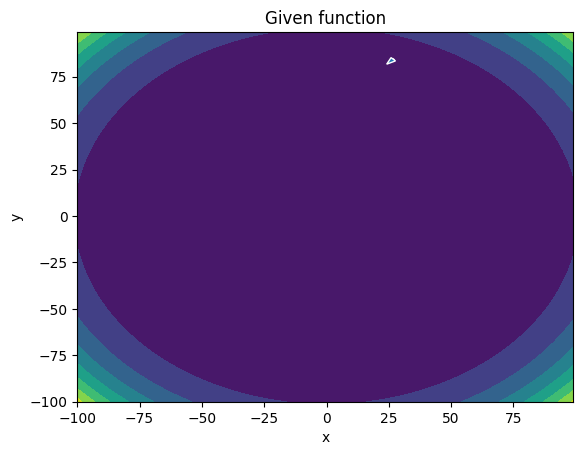

-------
Initial Coordinates:
[[26.78185303]
 [84.38720431]]
Final Coordinates:
[[26.68228814]
 [84.28743408]]
Gradient:
[[5.48199236e+10]
 [1.72798716e+11]]


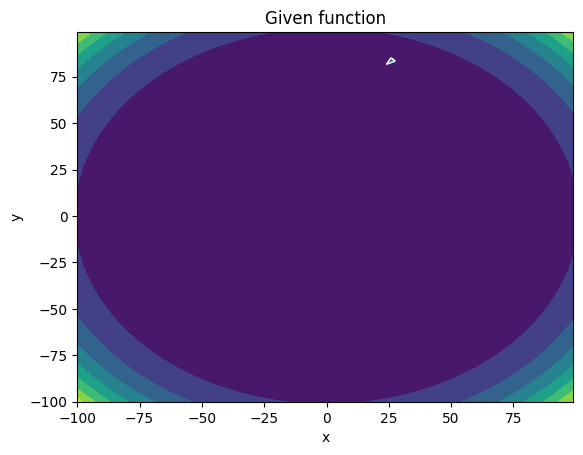

-------
Initial Coordinates:
[[26.68228814]
 [84.28743408]]
Final Coordinates:
[[26.58272521]
 [84.1876644 ]]
Gradient:
[[5.43077007e+10]
 [1.71620190e+11]]


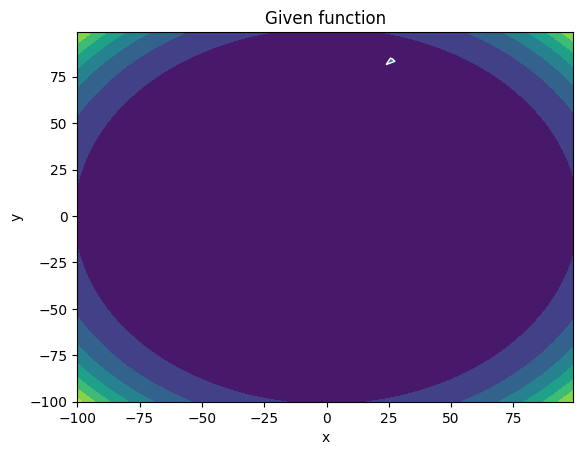

-------
Initial Coordinates:
[[26.58272521]
 [84.1876644 ]]
Final Coordinates:
[[26.48316424]
 [84.08789529]]
Gradient:
[[5.37992045e+10]
 [1.70448473e+11]]


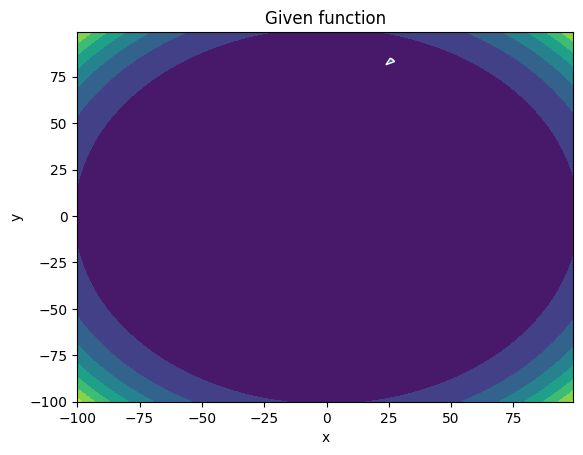

-------
Initial Coordinates:
[[26.48316424]
 [84.08789529]]
Final Coordinates:
[[26.38360524]
 [83.98812673]]
Gradient:
[[5.32944142e+10]
 [1.69283534e+11]]


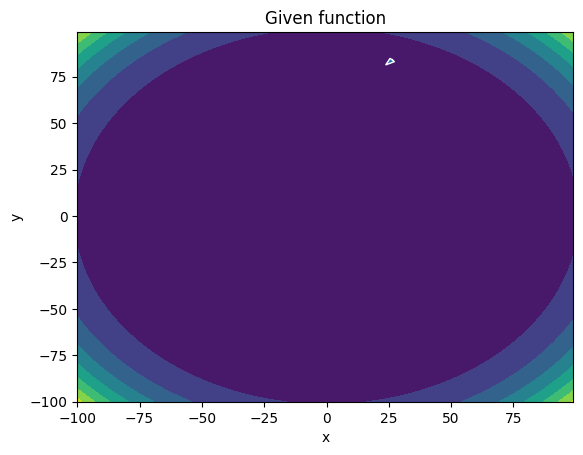

-------
Initial Coordinates:
[[26.38360524]
 [83.98812673]]
Final Coordinates:
[[26.28404822]
 [83.88835872]]
Gradient:
[[5.27933092e+10]
 [1.68125340e+11]]


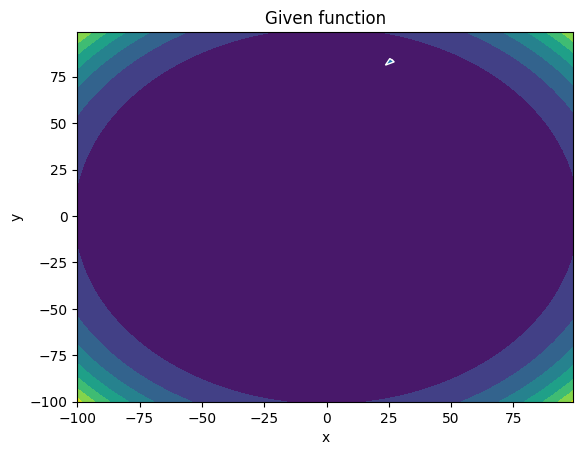

-------
Initial Coordinates:
[[26.28404822]
 [83.88835872]]
Final Coordinates:
[[26.1844932 ]
 [83.78859127]]
Gradient:
[[5.22958688e+10]
 [1.66973863e+11]]


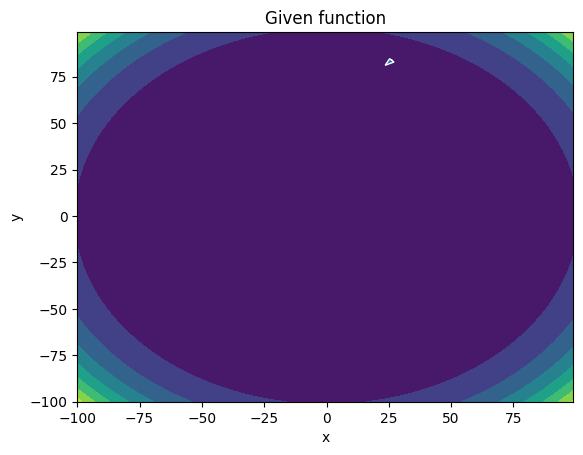

-------
Initial Coordinates:
[[26.1844932 ]
 [83.78859127]]
Final Coordinates:
[[26.08494018]
 [83.68882437]]
Gradient:
[[5.18020727e+10]
 [1.65829070e+11]]


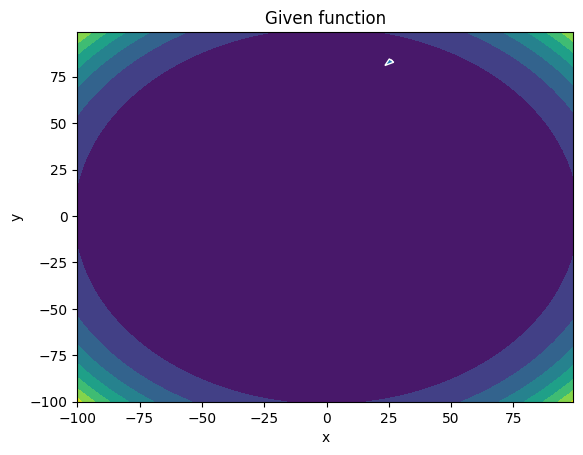

-------
Initial Coordinates:
[[26.08494018]
 [83.68882437]]
Final Coordinates:
[[25.98538917]
 [83.58905802]]
Gradient:
[[5.13119005e+10]
 [1.64690933e+11]]


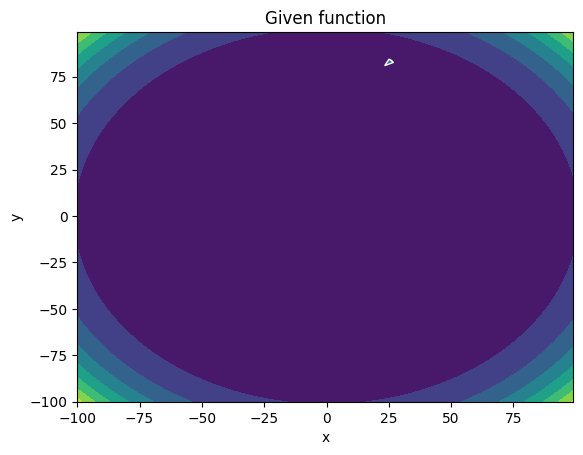

-------
Initial Coordinates:
[[25.98538917]
 [83.58905802]]
Final Coordinates:
[[25.88584018]
 [83.48929221]]
Gradient:
[[5.08253318e+10]
 [1.63559419e+11]]


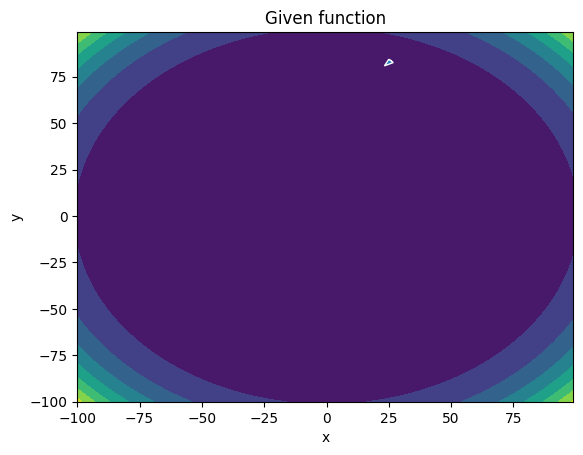

-------
Initial Coordinates:
[[25.88584018]
 [83.48929221]]
Final Coordinates:
[[25.78629323]
 [83.38952696]]
Gradient:
[[5.03423464e+10]
 [1.62434499e+11]]


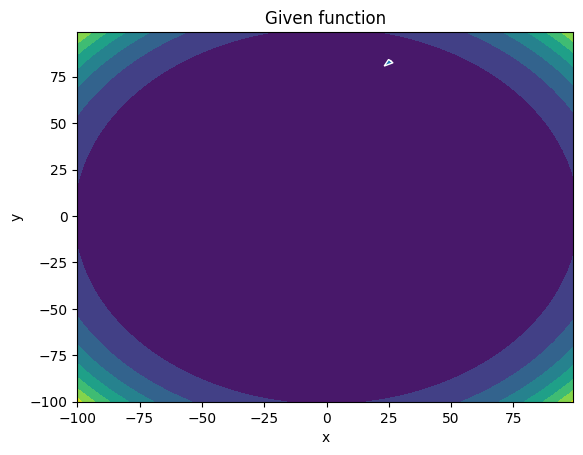

-------
Initial Coordinates:
[[25.78629323]
 [83.38952696]]
Final Coordinates:
[[25.68674833]
 [83.28976226]]
Gradient:
[[4.98629242e+10]
 [1.61316143e+11]]


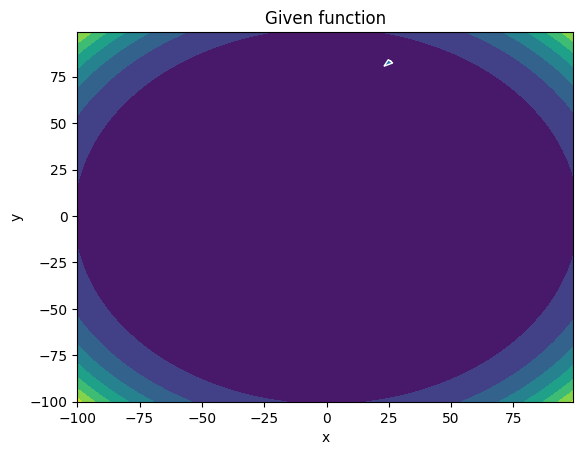

-------
Initial Coordinates:
[[25.68674833]
 [83.28976226]]
Final Coordinates:
[[25.58720549]
 [83.18999811]]
Gradient:
[[4.93870451e+10]
 [1.60204321e+11]]


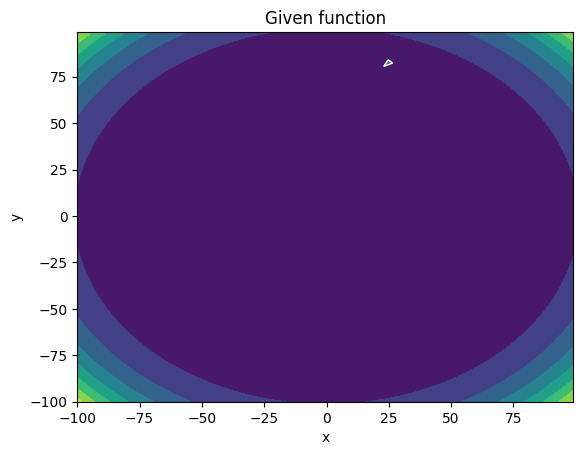

-------
Initial Coordinates:
[[25.58720549]
 [83.18999811]]
Final Coordinates:
[[25.48766472]
 [83.0902345 ]]
Gradient:
[[4.89146891e+10]
 [1.59099002e+11]]


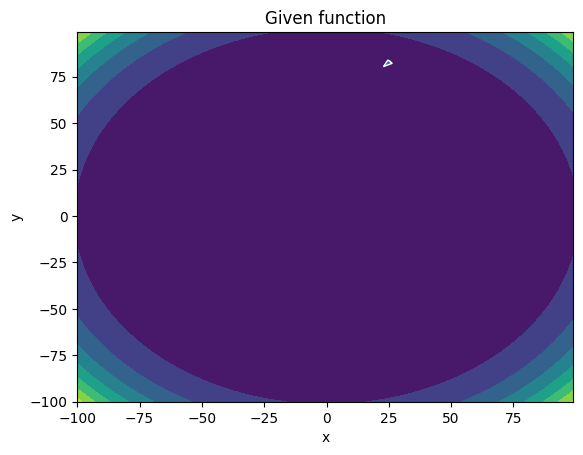

-------
Initial Coordinates:
[[25.48766472]
 [83.0902345 ]]
Final Coordinates:
[[25.38812603]
 [82.99047145]]
Gradient:
[[4.84458362e+10]
 [1.58000156e+11]]


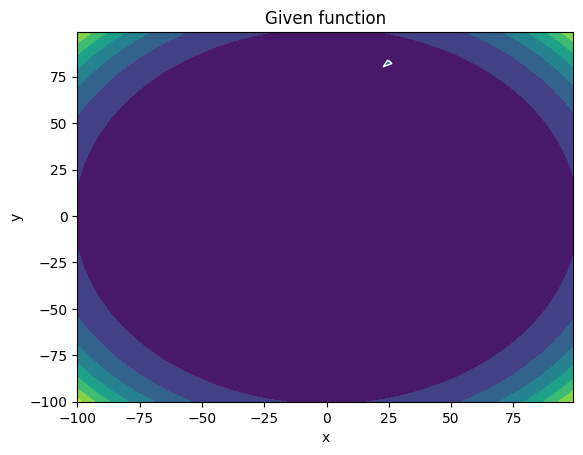

-------
Initial Coordinates:
[[25.38812603]
 [82.99047145]]
Final Coordinates:
[[25.28858945]
 [82.89070894]]
Gradient:
[[4.79804667e+10]
 [1.56907754e+11]]


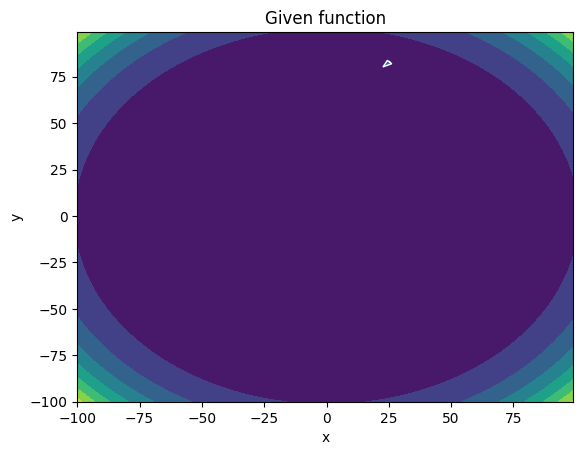

-------
Initial Coordinates:
[[25.28858945]
 [82.89070894]]
Final Coordinates:
[[25.18905498]
 [82.79094698]]
Gradient:
[[4.75185608e+10]
 [1.55821766e+11]]


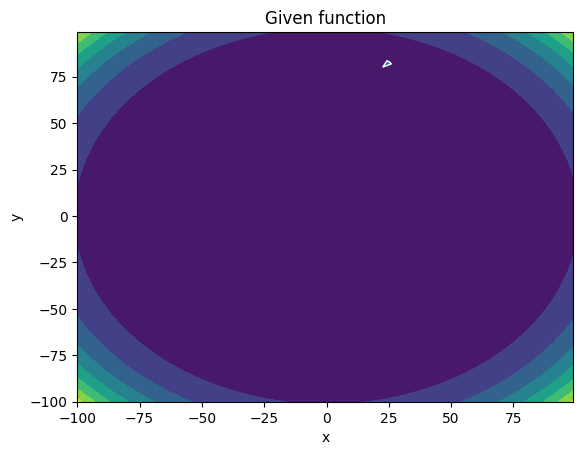

-------
Initial Coordinates:
[[25.18905498]
 [82.79094698]]
Final Coordinates:
[[25.08952264]
 [82.69118557]]
Gradient:
[[4.70600988e+10]
 [1.54742163e+11]]


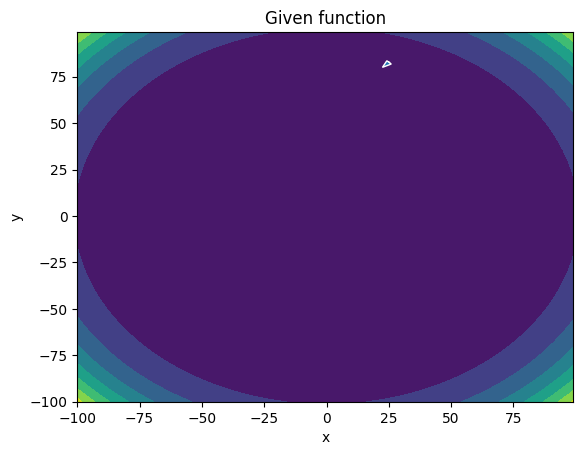

-------
Initial Coordinates:
[[25.08952264]
 [82.69118557]]
Final Coordinates:
[[24.98999244]
 [82.59142471]]
Gradient:
[[4.66050611e+10]
 [1.53668914e+11]]


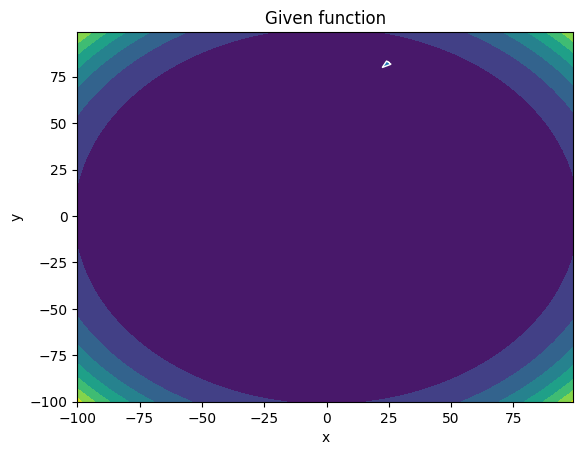

-------
Initial Coordinates:
[[24.98999244]
 [82.59142471]]
Final Coordinates:
[[24.8904644]
 [82.4916644]]
Gradient:
[[4.61534282e+10]
 [1.52601990e+11]]


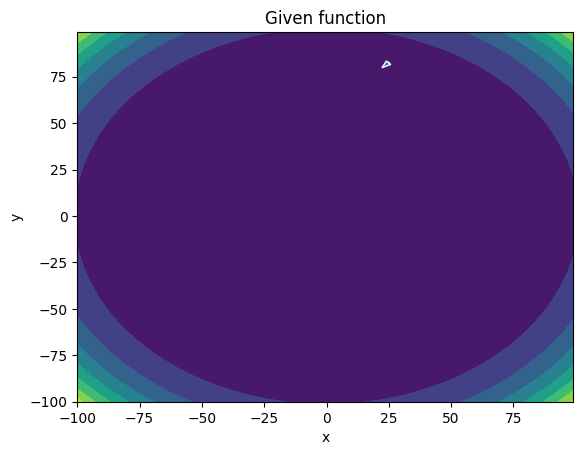

-------
Initial Coordinates:
[[24.8904644]
 [82.4916644]]
Final Coordinates:
[[24.79093853]
 [82.39190464]]
Gradient:
[[4.57051806e+10]
 [1.51541362e+11]]


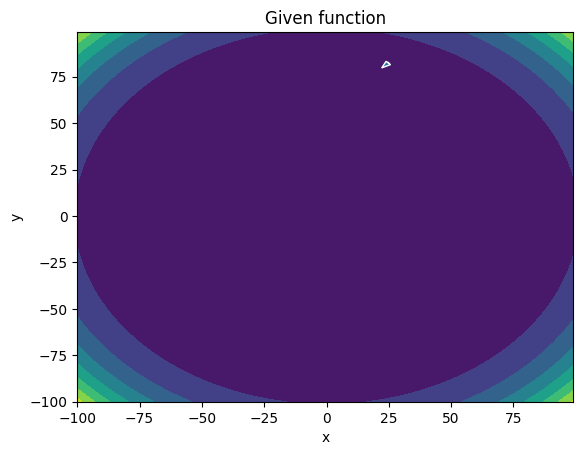

-------
Initial Coordinates:
[[24.79093853]
 [82.39190464]]
Final Coordinates:
[[24.69141485]
 [82.29214543]]
Gradient:
[[4.52602990e+10]
 [1.50487001e+11]]


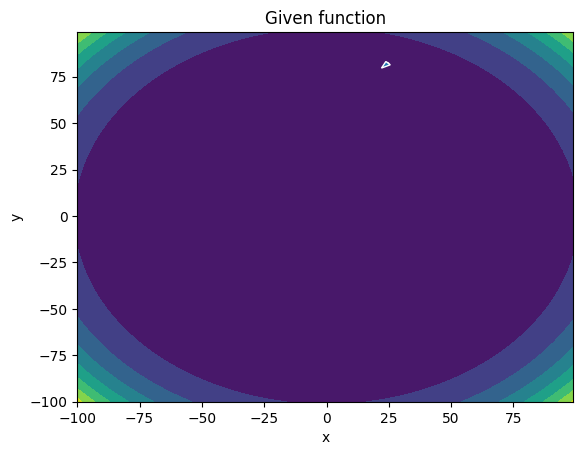

-------
Initial Coordinates:
[[24.69141485]
 [82.29214543]]
Final Coordinates:
[[24.59189338]
 [82.19238677]]
Gradient:
[[4.48187641e+10]
 [1.49438878e+11]]


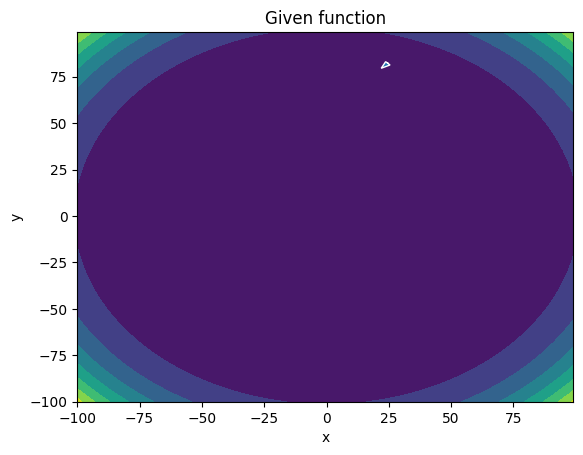

-------
Initial Coordinates:
[[24.59189338]
 [82.19238677]]
Final Coordinates:
[[24.49237413]
 [82.09262866]]
Gradient:
[[4.43805566e+10]
 [1.48396963e+11]]


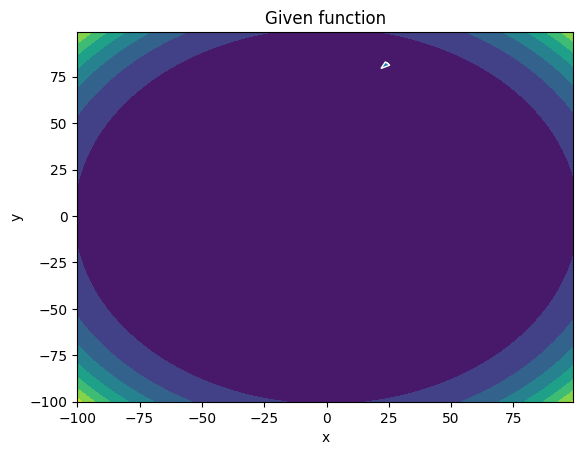

-------
Initial Coordinates:
[[24.49237413]
 [82.09262866]]
Final Coordinates:
[[24.39285711]
 [81.99287111]]
Gradient:
[[4.39456575e+10]
 [1.47361227e+11]]


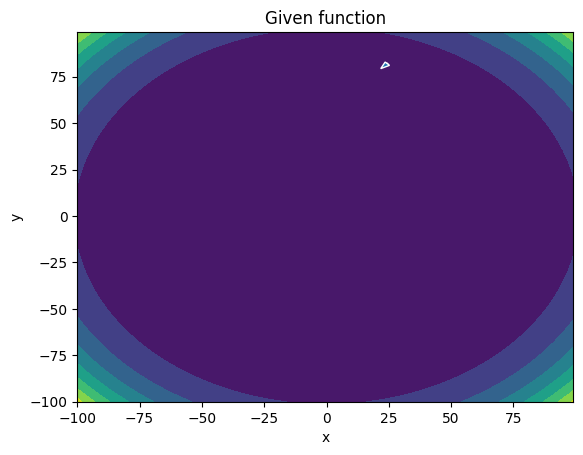

-------
Initial Coordinates:
[[24.39285711]
 [81.99287111]]
Final Coordinates:
[[24.29334236]
 [81.89311411]]
Gradient:
[[4.35140476e+10]
 [1.46331642e+11]]


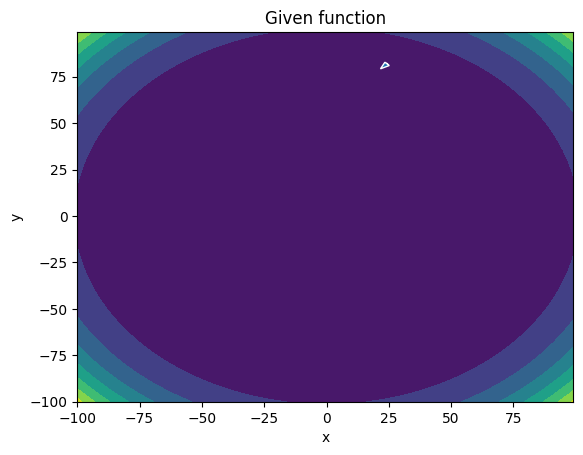

-------
Initial Coordinates:
[[24.29334236]
 [81.89311411]]
Final Coordinates:
[[24.19382987]
 [81.79335766]]
Gradient:
[[4.30857080e+10]
 [1.45308179e+11]]


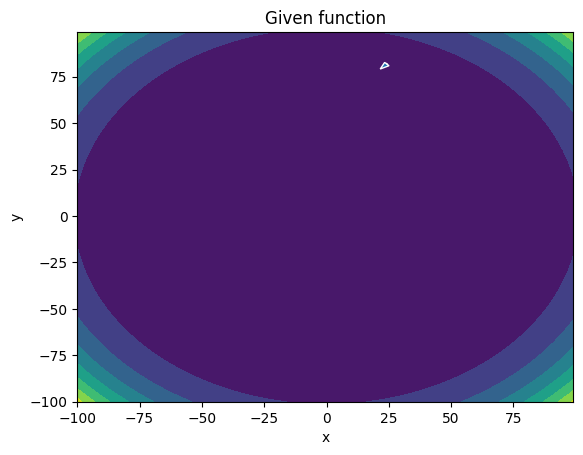

-------
Initial Coordinates:
[[24.19382987]
 [81.79335766]]
Final Coordinates:
[[24.09431968]
 [81.69360176]]
Gradient:
[[4.26606198e+10]
 [1.44290809e+11]]


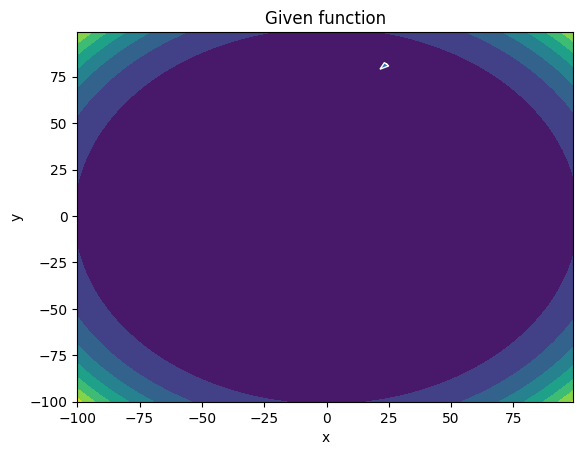

-------
Initial Coordinates:
[[24.09431968]
 [81.69360176]]
Final Coordinates:
[[23.9948118 ]
 [81.59384643]]
Gradient:
[[4.22387641e+10]
 [1.43279504e+11]]


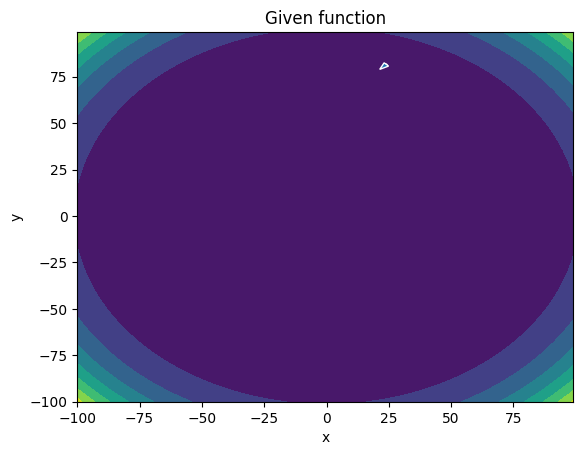

-------
Initial Coordinates:
[[23.9948118 ]
 [81.59384643]]
Final Coordinates:
[[23.89530624]
 [81.49409164]]
Gradient:
[[4.18201222e+10]
 [1.42274235e+11]]


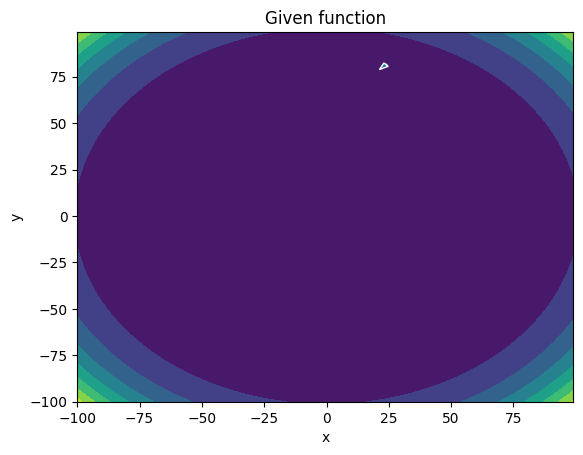

-------
Initial Coordinates:
[[23.89530624]
 [81.49409164]]
Final Coordinates:
[[23.79580303]
 [81.39433742]]
Gradient:
[[4.14046754e+10]
 [1.41274973e+11]]


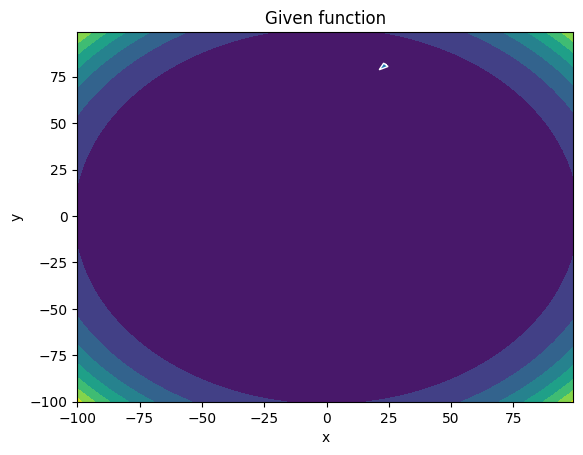

-------
Initial Coordinates:
[[23.79580303]
 [81.39433742]]
Final Coordinates:
[[23.69630219]
 [81.29458375]]
Gradient:
[[4.09924051e+10]
 [1.40281691e+11]]


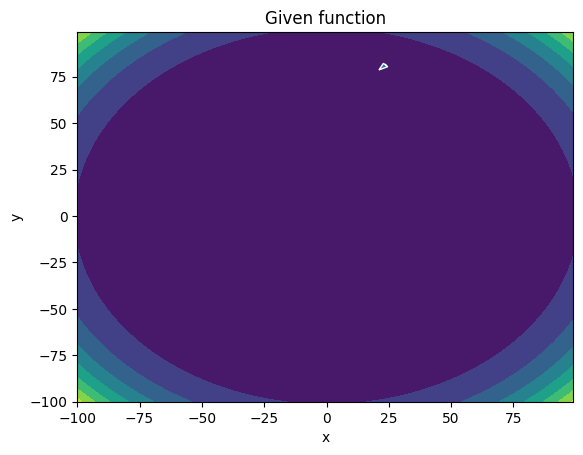

-------
Initial Coordinates:
[[23.69630219]
 [81.29458375]]
Final Coordinates:
[[23.59680373]
 [81.19483064]]
Gradient:
[[4.05832927e+10]
 [1.39294360e+11]]


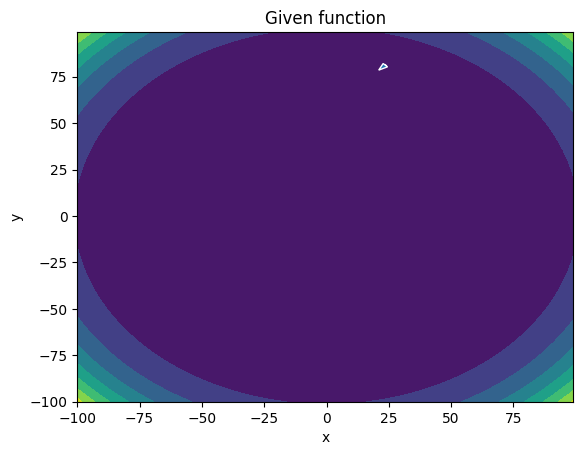

-------
Initial Coordinates:
[[23.59680373]
 [81.19483064]]
Final Coordinates:
[[23.49730767]
 [81.09507809]]
Gradient:
[[4.01773198e+10]
 [1.38312951e+11]]


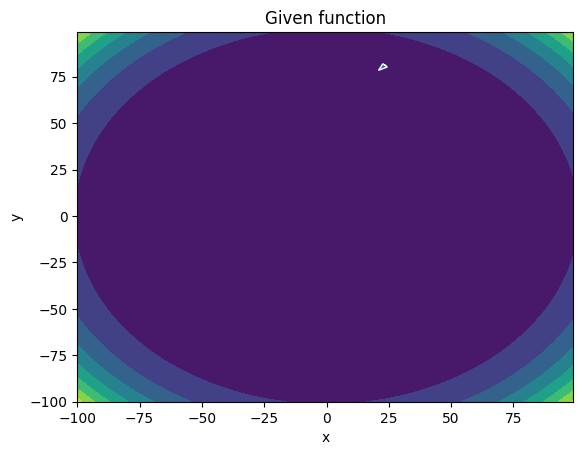

-------
Initial Coordinates:
[[23.49730767]
 [81.09507809]]
Final Coordinates:
[[23.39781404]
 [80.99532611]]
Gradient:
[[3.97744681e+10]
 [1.37337438e+11]]


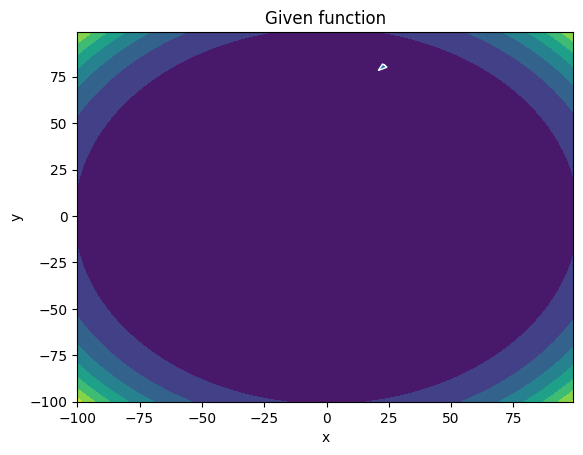

-------
Initial Coordinates:
[[23.39781404]
 [80.99532611]]
Final Coordinates:
[[23.29832285]
 [80.89557468]]
Gradient:
[[3.93747191e+10]
 [1.36367792e+11]]


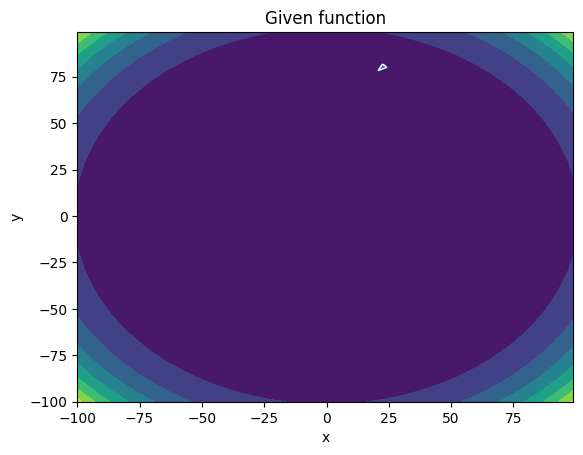

-------
Initial Coordinates:
[[23.29832285]
 [80.89557468]]
Final Coordinates:
[[23.19883412]
 [80.79582382]]
Gradient:
[[3.89780548e+10]
 [1.35403985e+11]]


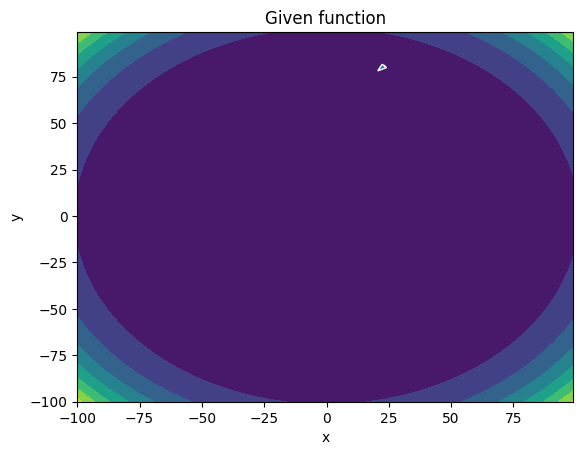

-------
Initial Coordinates:
[[23.19883412]
 [80.79582382]]
Final Coordinates:
[[23.09934788]
 [80.69607352]]
Gradient:
[[3.85844568e+10]
 [1.34445989e+11]]


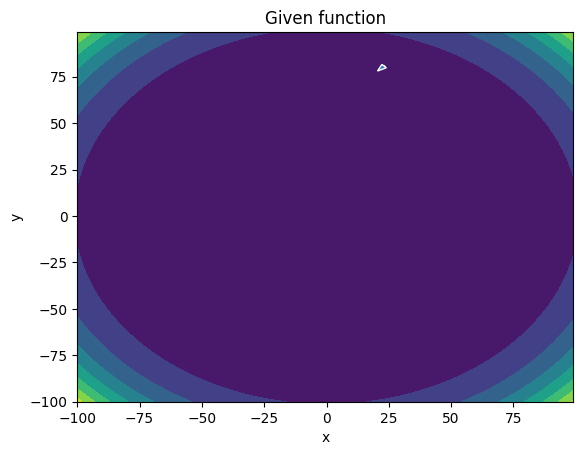

-------
Initial Coordinates:
[[23.09934788]
 [80.69607352]]
Final Coordinates:
[[22.99986415]
 [80.59632378]]
Gradient:
[[3.81939072e+10]
 [1.33493778e+11]]


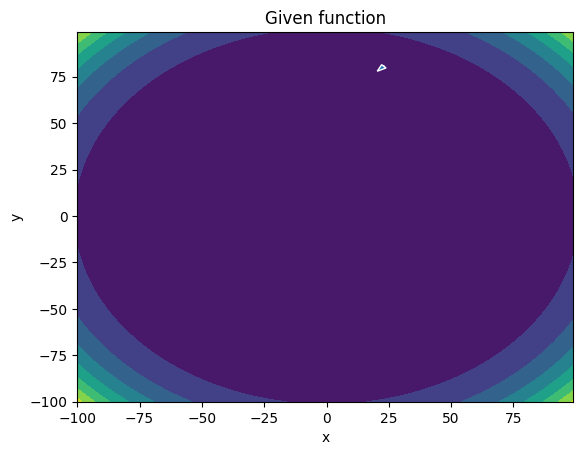

-------
Initial Coordinates:
[[22.99986415]
 [80.59632378]]
Final Coordinates:
[[22.90038295]
 [80.49657461]]
Gradient:
[[3.78063879e+10]
 [1.32547322e+11]]


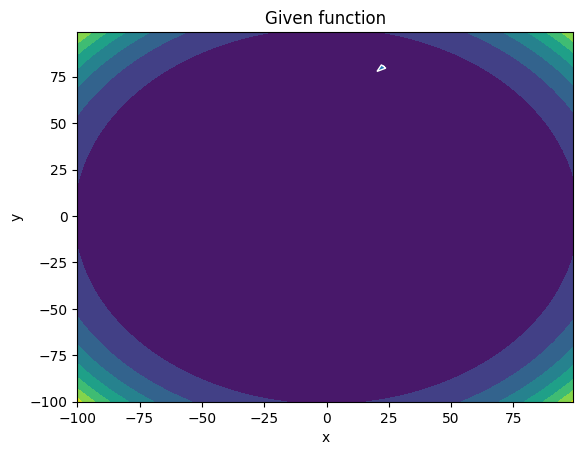

-------
Initial Coordinates:
[[22.90038295]
 [80.49657461]]
Final Coordinates:
[[22.80090429]
 [80.39682601]]
Gradient:
[[3.74218810e+10]
 [1.31606595e+11]]


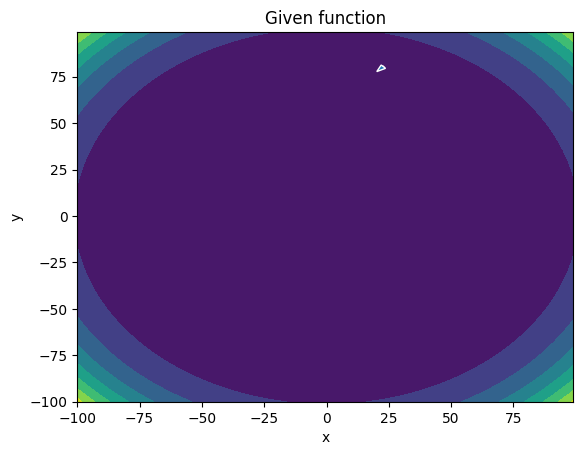

-------
Initial Coordinates:
[[22.80090429]
 [80.39682601]]
Final Coordinates:
[[22.70142821]
 [80.29707798]]
Gradient:
[[3.70403685e+10]
 [1.30671570e+11]]


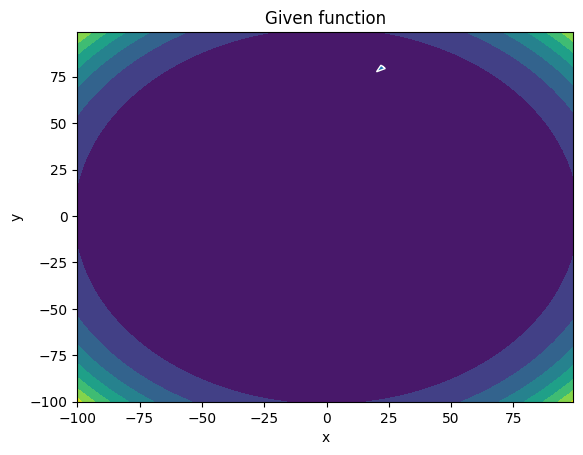

-------
Initial Coordinates:
[[22.70142821]
 [80.29707798]]
Final Coordinates:
[[22.60195472]
 [80.19733051]]
Gradient:
[[3.66618329e+10]
 [1.29742219e+11]]


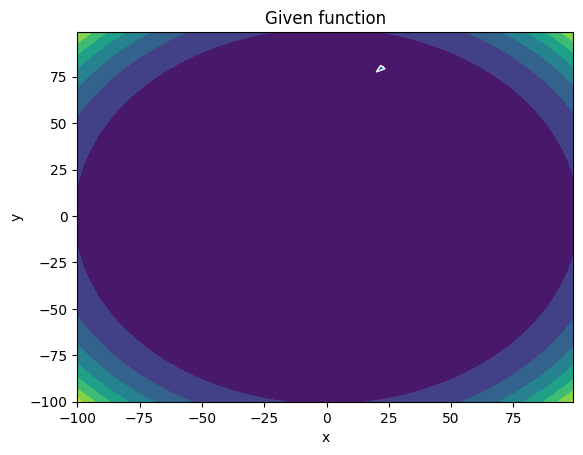

-------
Initial Coordinates:
[[22.60195472]
 [80.19733051]]
Final Coordinates:
[[22.50248385]
 [80.09758362]]
Gradient:
[[3.62862562e+10]
 [1.28818514e+11]]


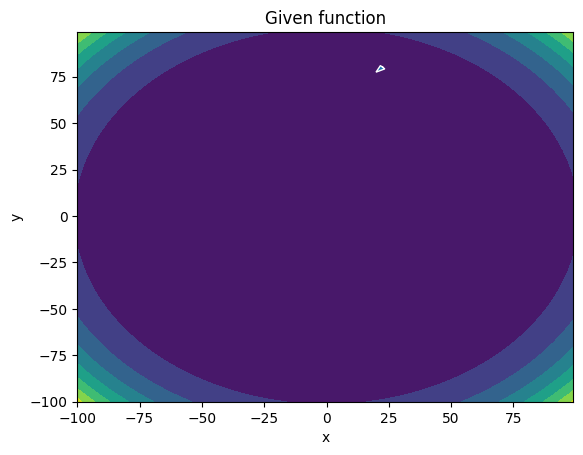

-------
Initial Coordinates:
[[22.50248385]
 [80.09758362]]
Final Coordinates:
[[22.40301562]
 [79.9978373 ]]
Gradient:
[[3.59136209e+10]
 [1.27900429e+11]]


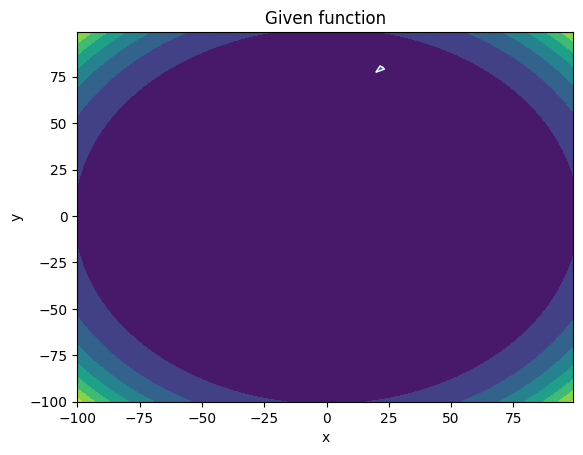

-------
Initial Coordinates:
[[22.40301562]
 [79.9978373 ]]
Final Coordinates:
[[22.30355006]
 [79.89809154]]
Gradient:
[[3.55439094e+10]
 [1.26987937e+11]]


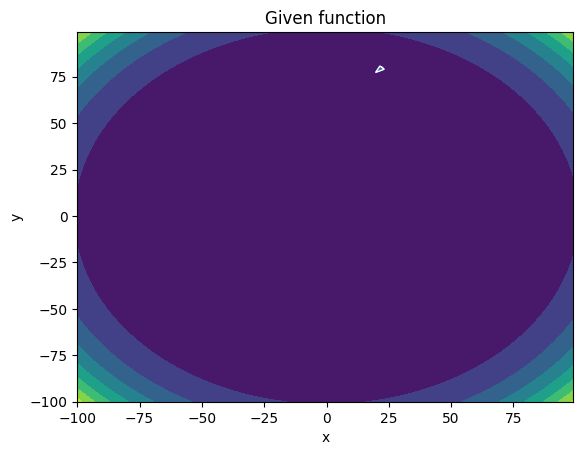

-------
Initial Coordinates:
[[22.30355006]
 [79.89809154]]
Final Coordinates:
[[22.20408718]
 [79.79834637]]
Gradient:
[[3.51771041e+10]
 [1.26081011e+11]]


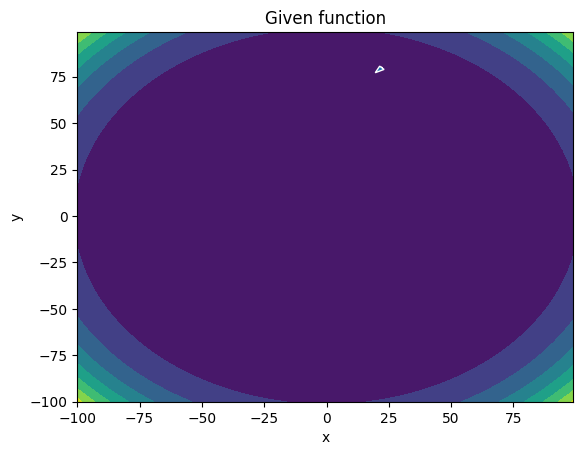

-------
Initial Coordinates:
[[22.20408718]
 [79.79834637]]
Final Coordinates:
[[22.10462702]
 [79.69860176]]
Gradient:
[[3.48131878e+10]
 [1.25179624e+11]]


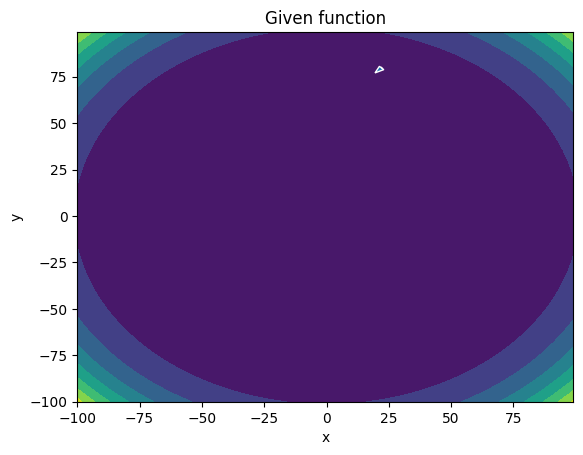

-------
Initial Coordinates:
[[22.10462702]
 [79.69860176]]
Final Coordinates:
[[22.00516959]
 [79.59885774]]
Gradient:
[[3.44521429e+10]
 [1.24283749e+11]]


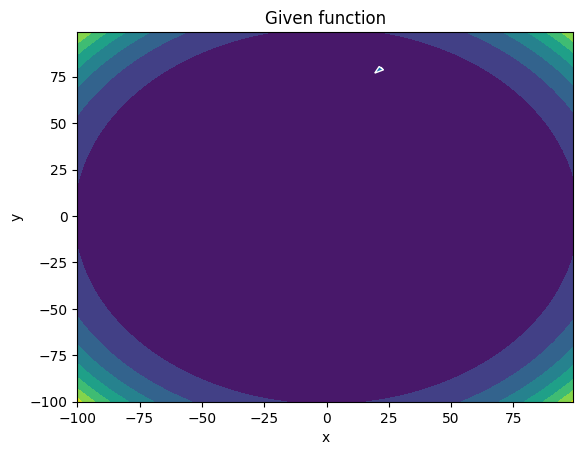

-------
Initial Coordinates:
[[22.00516959]
 [79.59885774]]
Final Coordinates:
[[21.90571493]
 [79.49911429]]
Gradient:
[[3.40939523e+10]
 [1.23393360e+11]]


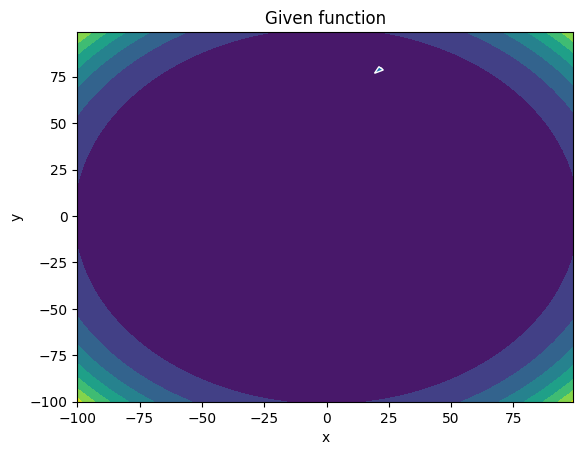

-------
Initial Coordinates:
[[21.90571493]
 [79.49911429]]
Final Coordinates:
[[21.80626305]
 [79.39937141]]
Gradient:
[[3.37385987e+10]
 [1.22508430e+11]]


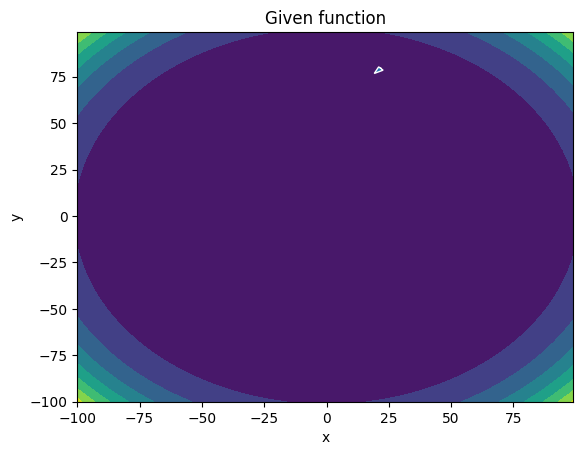

-------
Initial Coordinates:
[[21.80626305]
 [79.39937141]]
Final Coordinates:
[[21.70681399]
 [79.29962912]]
Gradient:
[[3.33860650e+10]
 [1.21628932e+11]]


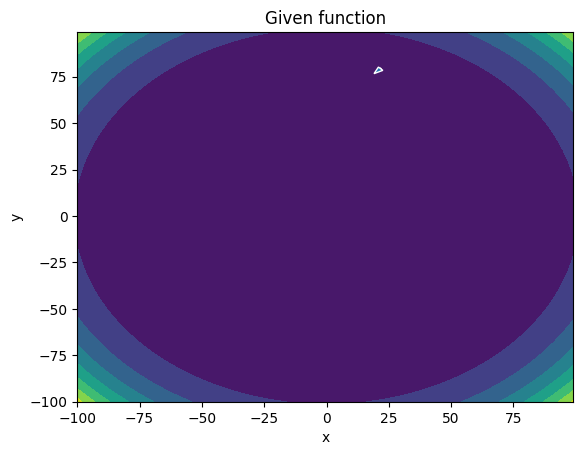

-------
Initial Coordinates:
[[21.70681399]
 [79.29962912]]
Final Coordinates:
[[21.60736777]
 [79.19988741]]
Gradient:
[[3.30363341e+10]
 [1.20754841e+11]]


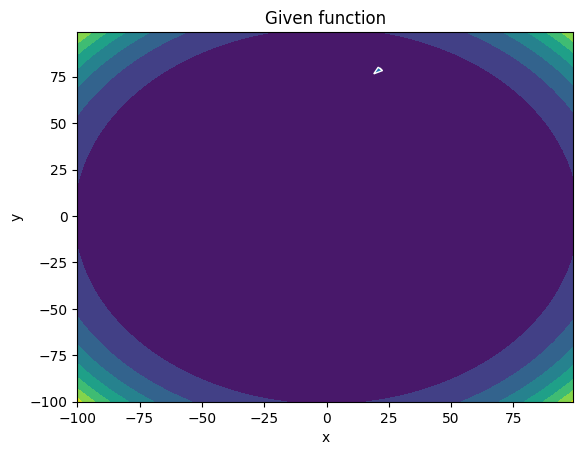

-------
Initial Coordinates:
[[21.60736777]
 [79.19988741]]
Final Coordinates:
[[21.50792441]
 [79.10014627]]
Gradient:
[[3.26893890e+10]
 [1.19886129e+11]]


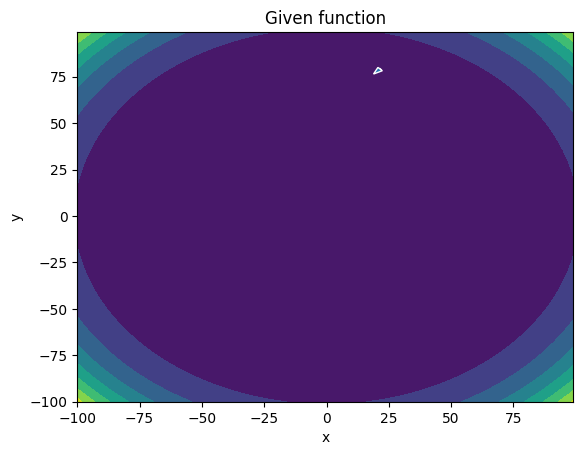

-------
Initial Coordinates:
[[21.50792441]
 [79.10014627]]
Final Coordinates:
[[21.40848394]
 [79.00040573]]
Gradient:
[[3.23452129e+10]
 [1.19022771e+11]]


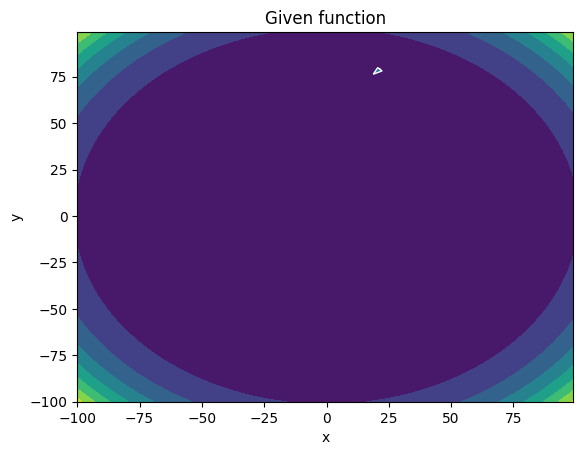

-------
Initial Coordinates:
[[21.40848394]
 [79.00040573]]
Final Coordinates:
[[21.3090464 ]
 [78.90066576]]
Gradient:
[[3.20037887e+10]
 [1.18164741e+11]]


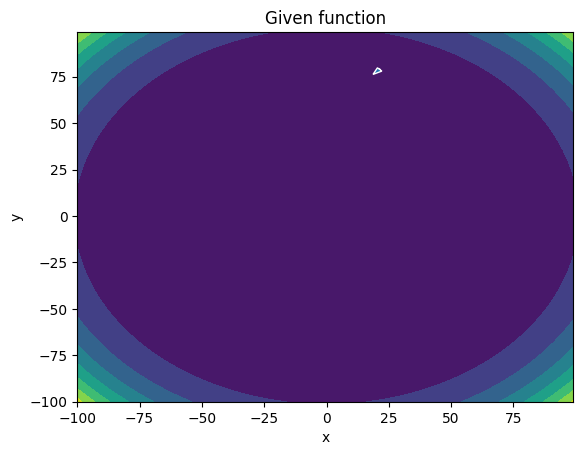

-------
Initial Coordinates:
[[21.3090464 ]
 [78.90066576]]
Final Coordinates:
[[21.2096118 ]
 [78.80092638]]
Gradient:
[[3.16650999e+10]
 [1.17312012e+11]]


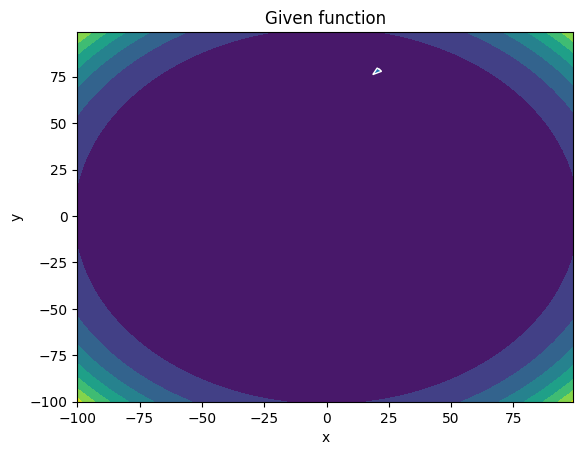

-------
Initial Coordinates:
[[21.2096118 ]
 [78.80092638]]
Final Coordinates:
[[21.11018018]
 [78.70118758]]
Gradient:
[[3.13291296e+10]
 [1.16464559e+11]]


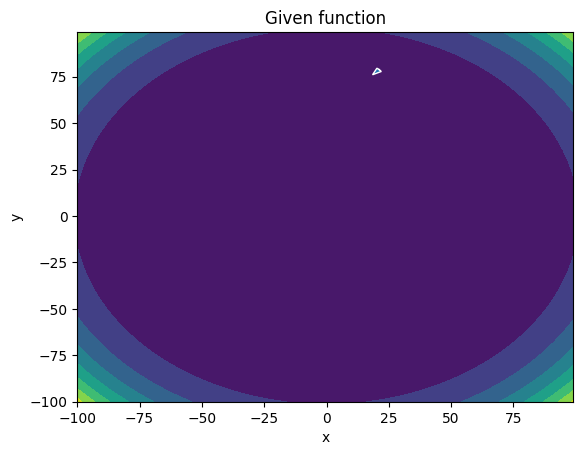

-------
Initial Coordinates:
[[21.11018018]
 [78.70118758]]
Final Coordinates:
[[21.01075157]
 [78.60144938]]
Gradient:
[[3.09958612e+10]
 [1.15622356e+11]]


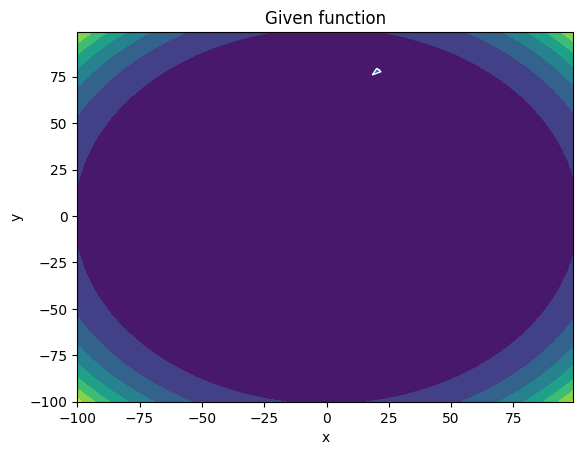

-------
Initial Coordinates:
[[21.01075157]
 [78.60144938]]
Final Coordinates:
[[20.91132598]
 [78.50171176]]
Gradient:
[[3.06652781e+10]
 [1.14785376e+11]]


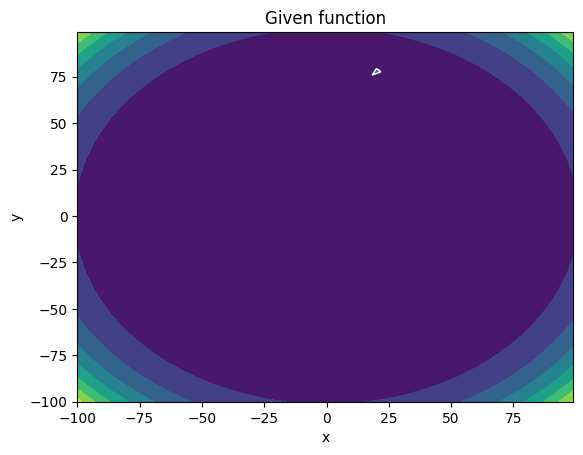

-------
Initial Coordinates:
[[20.91132598]
 [78.50171176]]
Final Coordinates:
[[20.81190347]
 [78.40197473]]
Gradient:
[[3.03373640e+10]
 [1.13953595e+11]]


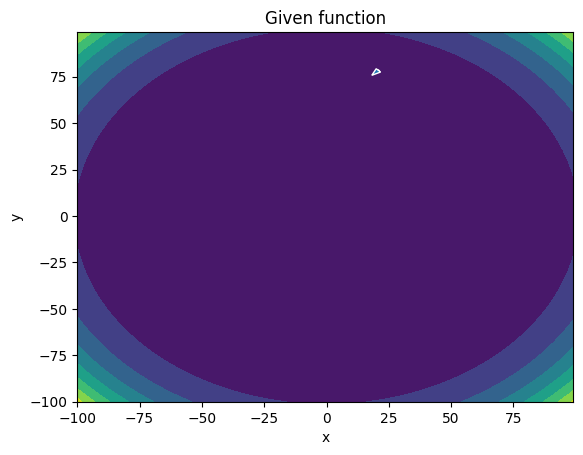

-------
Initial Coordinates:
[[20.81190347]
 [78.40197473]]
Final Coordinates:
[[20.71248404]
 [78.30223829]]
Gradient:
[[3.00121022e+10]
 [1.13126987e+11]]


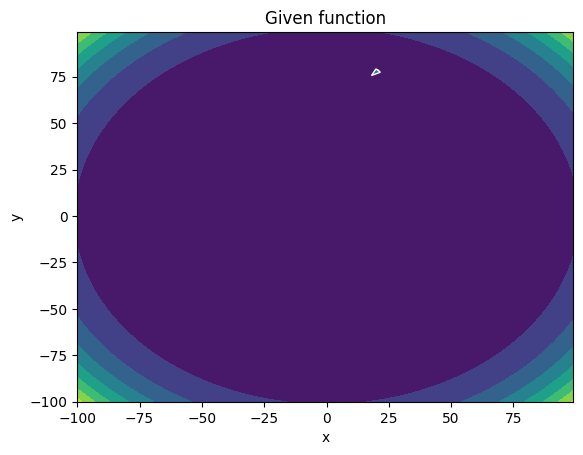

-------
Initial Coordinates:
[[20.71248404]
 [78.30223829]]
Final Coordinates:
[[20.61306774]
 [78.20250244]]
Gradient:
[[2.96894765e+10]
 [1.12305526e+11]]


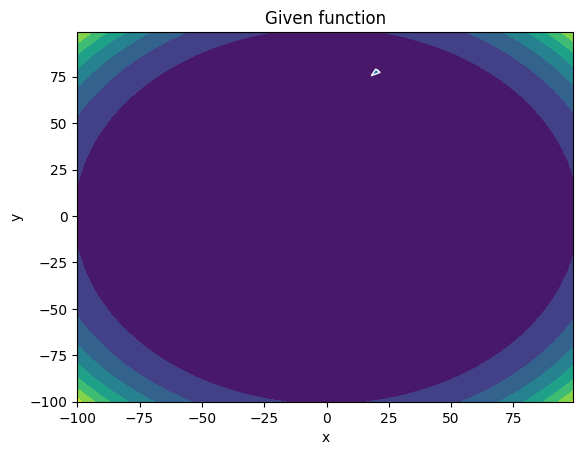

-------
Initial Coordinates:
[[20.61306774]
 [78.20250244]]
Final Coordinates:
[[20.51365459]
 [78.10276718]]
Gradient:
[[2.93694705e+10]
 [1.11489187e+11]]


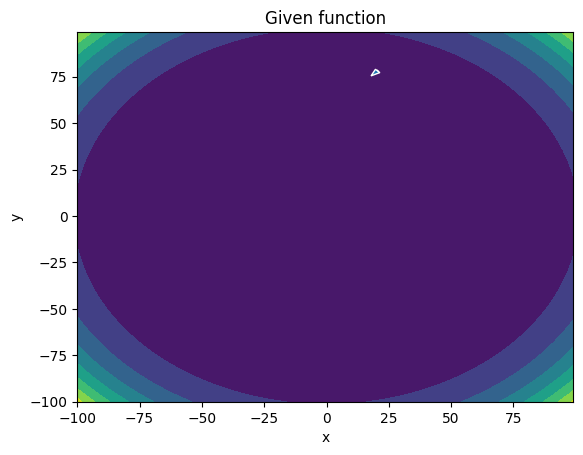

-------
Initial Coordinates:
[[20.51365459]
 [78.10276718]]
Final Coordinates:
[[20.41424463]
 [78.00303252]]
Gradient:
[[2.90520682e+10]
 [1.10677945e+11]]


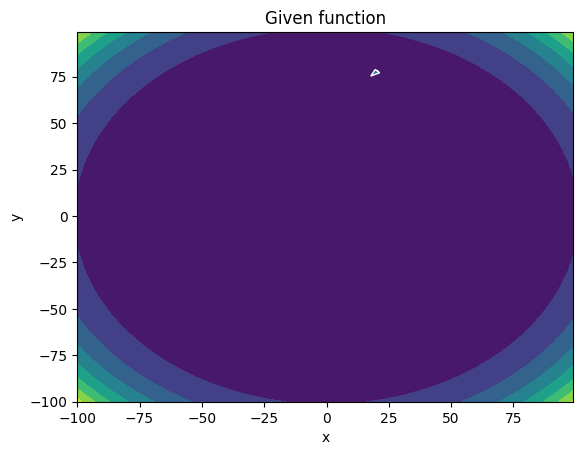

-------
Initial Coordinates:
[[20.41424463]
 [78.00303252]]
Final Coordinates:
[[20.31483789]
 [77.90329845]]
Gradient:
[[2.87372532e+10]
 [1.09871774e+11]]


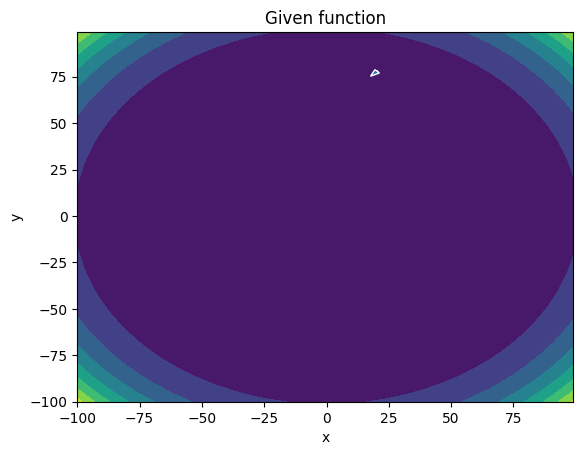

-------
Initial Coordinates:
[[20.31483789]
 [77.90329845]]
Final Coordinates:
[[20.2154344 ]
 [77.80356498]]
Gradient:
[[2.84250096e+10]
 [1.09070649e+11]]


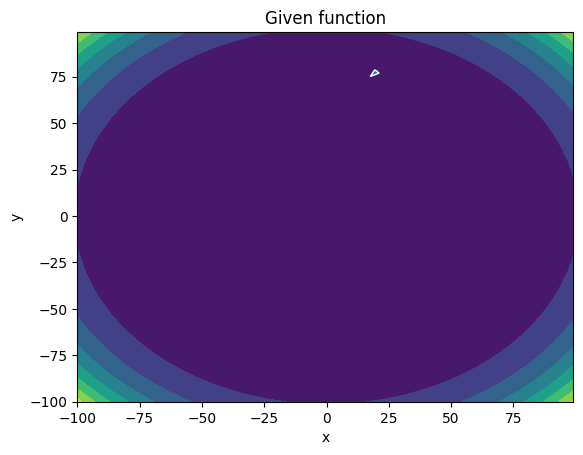

-------
Initial Coordinates:
[[20.2154344 ]
 [77.80356498]]
Final Coordinates:
[[20.11603419]
 [77.70383211]]
Gradient:
[[2.81153212e+10]
 [1.08274545e+11]]


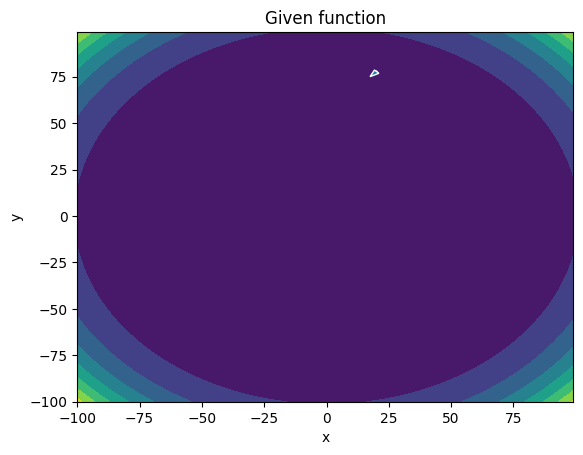

-------
Initial Coordinates:
[[20.11603419]
 [77.70383211]]
Final Coordinates:
[[20.01663729]
 [77.60409984]]
Gradient:
[[2.78081723e+10]
 [1.07483437e+11]]


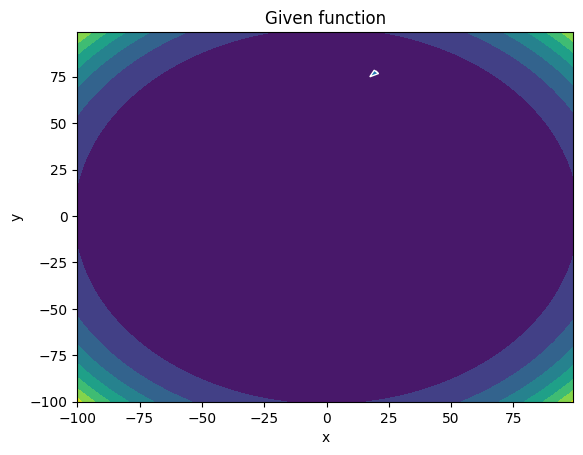

-------
Initial Coordinates:
[[20.01663729]
 [77.60409984]]
Final Coordinates:
[[19.91724375]
 [77.50436816]]
Gradient:
[[2.75035469e+10]
 [1.06697301e+11]]


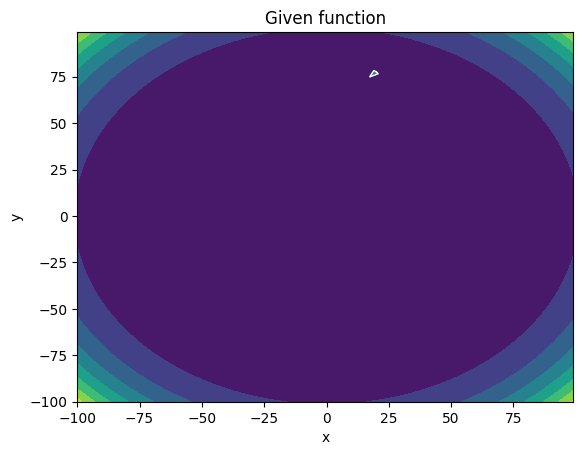

-------
Initial Coordinates:
[[19.91724375]
 [77.50436816]]
Final Coordinates:
[[19.81785359]
 [77.40463709]]
Gradient:
[[2.72014291e+10]
 [1.05916111e+11]]


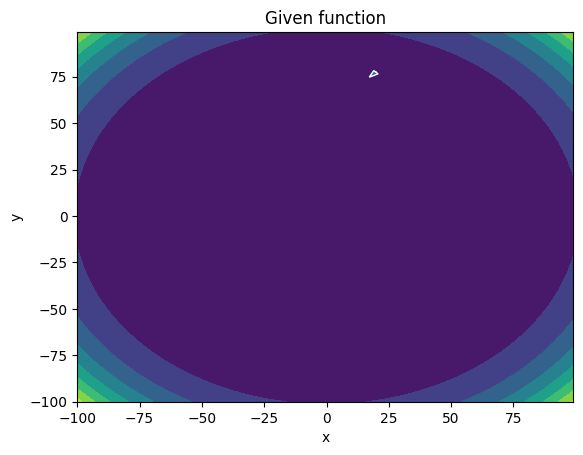

-------
Initial Coordinates:
[[19.81785359]
 [77.40463709]]
Final Coordinates:
[[19.71846685]
 [77.30490661]]
Gradient:
[[2.69018034e+10]
 [1.05139843e+11]]


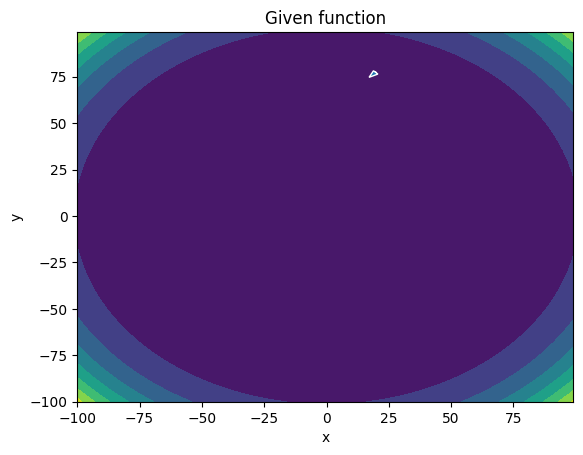

-------
Initial Coordinates:
[[19.71846685]
 [77.30490661]]
Final Coordinates:
[[19.61908357]
 [77.20517675]]
Gradient:
[[2.66046539e+10]
 [1.04368473e+11]]


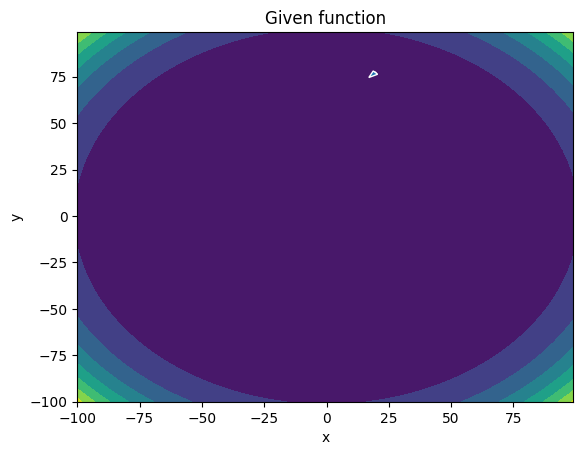

-------
Initial Coordinates:
[[19.61908357]
 [77.20517675]]
Final Coordinates:
[[19.51970378]
 [77.10544748]]
Gradient:
[[2.63099652e+10]
 [1.03601975e+11]]


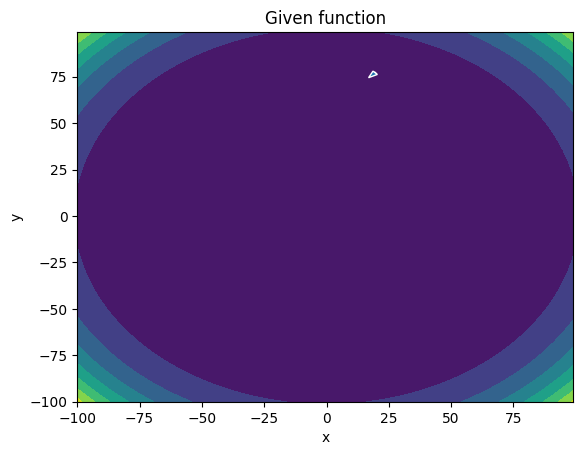

-------
Initial Coordinates:
[[19.51970378]
 [77.10544748]]
Final Coordinates:
[[19.42032751]
 [77.00571882]]
Gradient:
[[2.60177216e+10]
 [1.02840325e+11]]


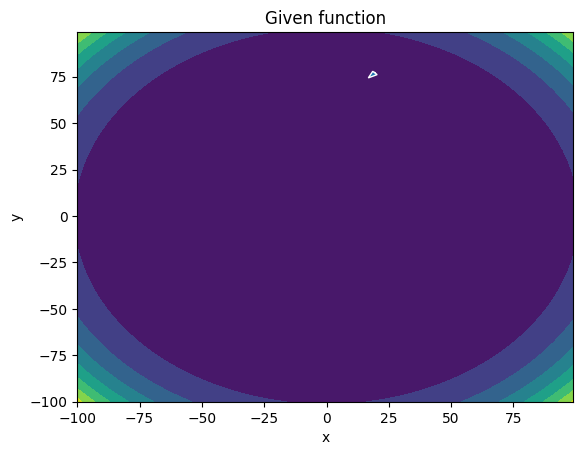

-------
Initial Coordinates:
[[19.42032751]
 [77.00571882]]
Final Coordinates:
[[19.32095482]
 [76.90599076]]
Gradient:
[[2.57279078e+10]
 [1.02083499e+11]]


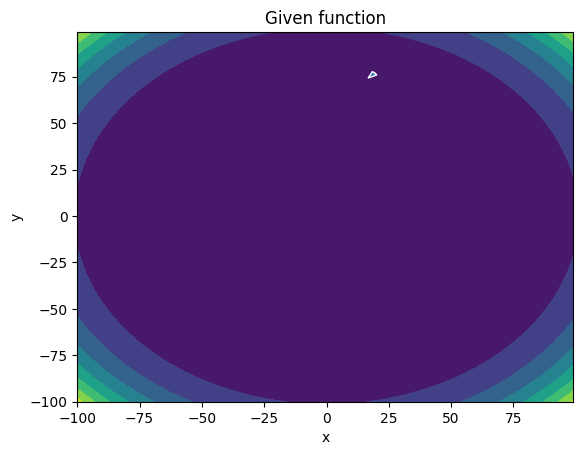

-------
Initial Coordinates:
[[19.32095482]
 [76.90599076]]
Final Coordinates:
[[19.22158572]
 [76.80626332]]
Gradient:
[[2.54405083e+10]
 [1.01331473e+11]]


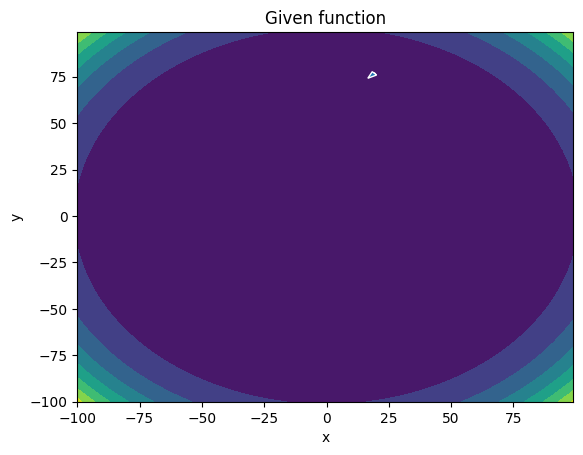

-------
Initial Coordinates:
[[19.22158572]
 [76.80626332]]
Final Coordinates:
[[19.12222027]
 [76.70653648]]
Gradient:
[[2.51555077e+10]
 [1.00584222e+11]]


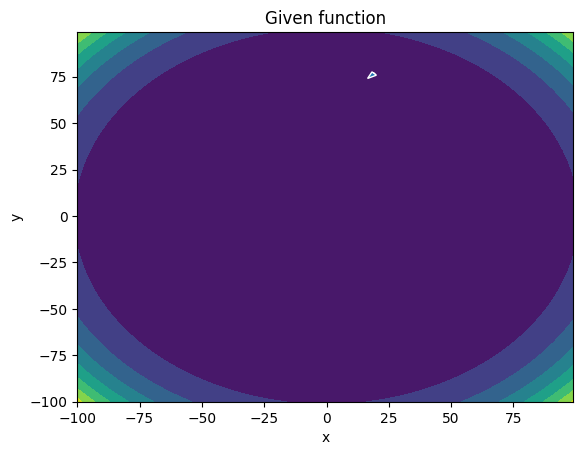

-------
Initial Coordinates:
[[19.12222027]
 [76.70653648]]
Final Coordinates:
[[19.0228585 ]
 [76.60681025]]
Gradient:
[[2.48728910e+10]
 [9.98417226e+10]]


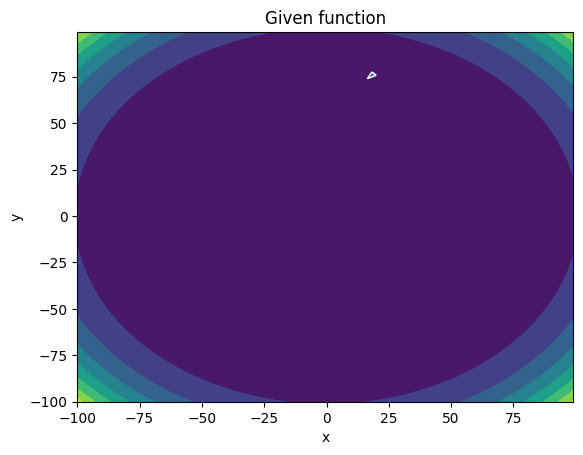

-------
Initial Coordinates:
[[19.0228585 ]
 [76.60681025]]
Final Coordinates:
[[18.92350045]
 [76.50708463]]
Gradient:
[[2.45926428e+10]
 [9.91039504e+10]]


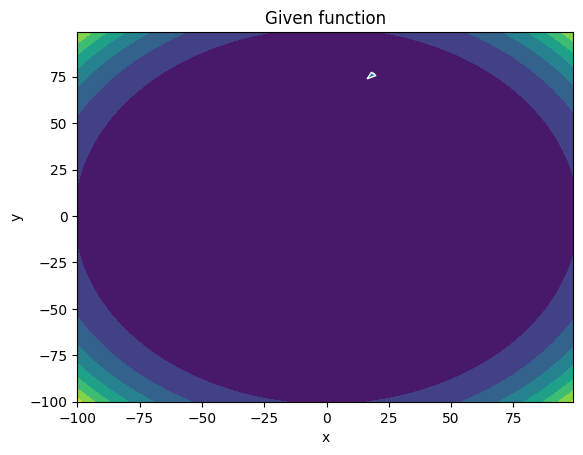

-------
Initial Coordinates:
[[18.92350045]
 [76.50708463]]
Final Coordinates:
[[18.82414616]
 [76.40735962]]
Gradient:
[[2.43147480e+10]
 [9.83708816e+10]]


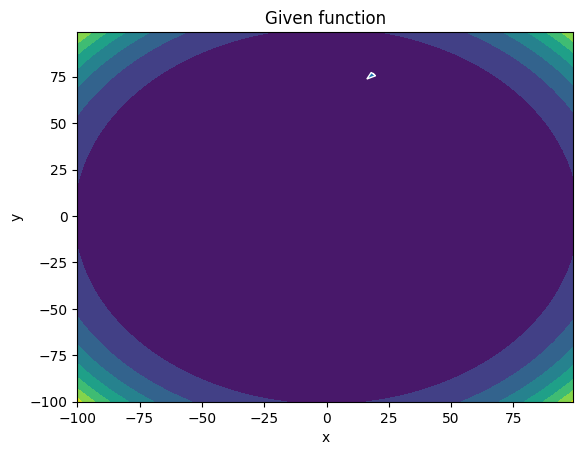

-------
Initial Coordinates:
[[18.82414616]
 [76.40735962]]
Final Coordinates:
[[18.72479568]
 [76.30763523]]
Gradient:
[[2.40391915e+10]
 [9.76424924e+10]]


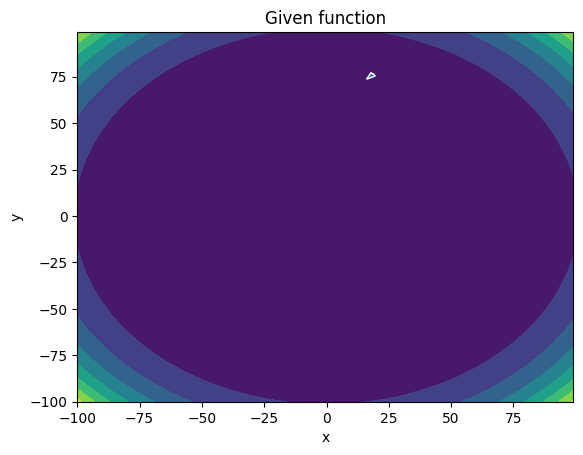

-------
Initial Coordinates:
[[18.72479568]
 [76.30763523]]
Final Coordinates:
[[18.62544904]
 [76.20791145]]
Gradient:
[[2.37659585e+10]
 [9.69187590e+10]]


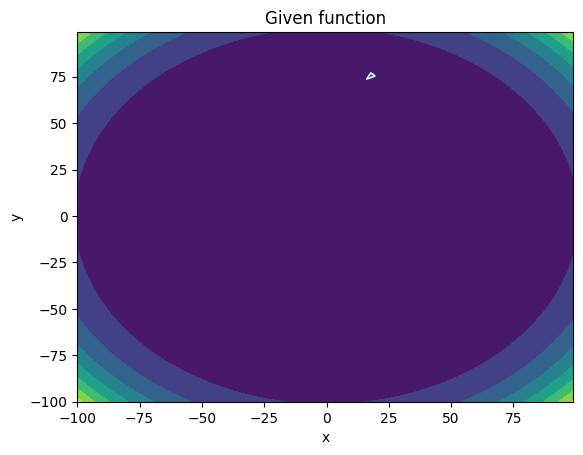

-------
Initial Coordinates:
[[18.62544904]
 [76.20791145]]
Final Coordinates:
[[18.52610629]
 [76.10818828]]
Gradient:
[[2.34950339e+10]
 [9.61996577e+10]]


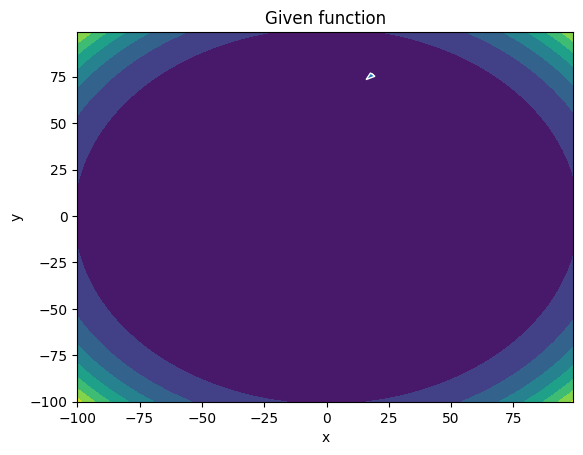

-------
Initial Coordinates:
[[18.52610629]
 [76.10818828]]
Final Coordinates:
[[18.42676747]
 [76.00846573]]
Gradient:
[[2.3226403e+10]
 [9.5485165e+10]]


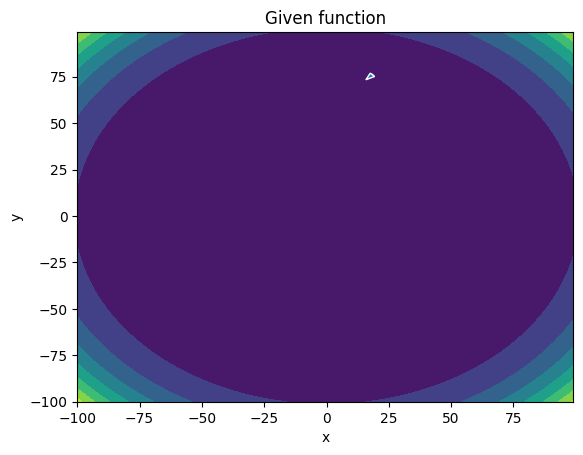

-------
Initial Coordinates:
[[18.42676747]
 [76.00846573]]
Final Coordinates:
[[18.32743262]
 [75.9087438 ]]
Gradient:
[[2.29600509e+10]
 [9.47752572e+10]]


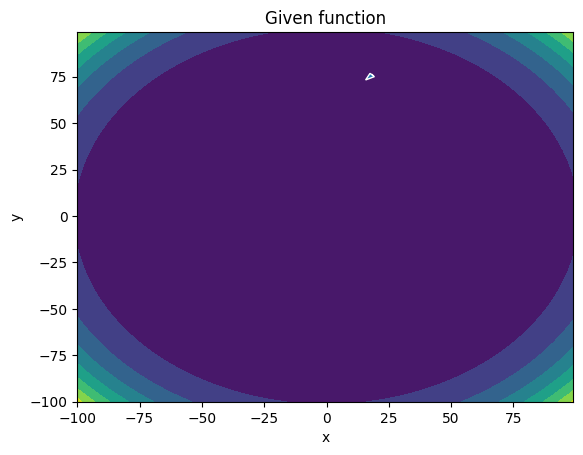

-------
Initial Coordinates:
[[18.32743262]
 [75.9087438 ]]
Final Coordinates:
[[18.2281018 ]
 [75.80902248]]
Gradient:
[[2.26959628e+10]
 [9.40699112e+10]]


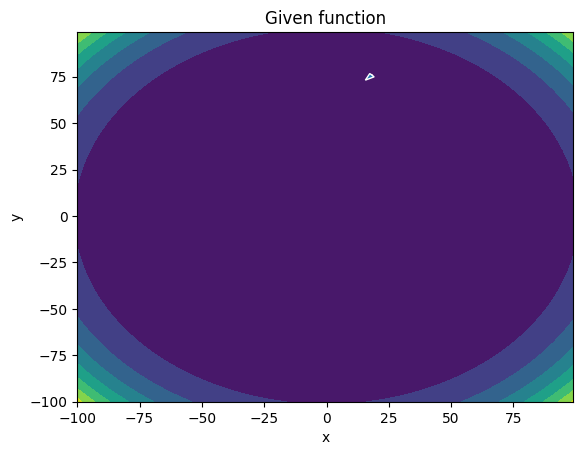

-------
Initial Coordinates:
[[18.2281018 ]
 [75.80902248]]
Final Coordinates:
[[18.12877504]
 [75.70930178]]
Gradient:
[[2.24341242e+10]
 [9.33691034e+10]]


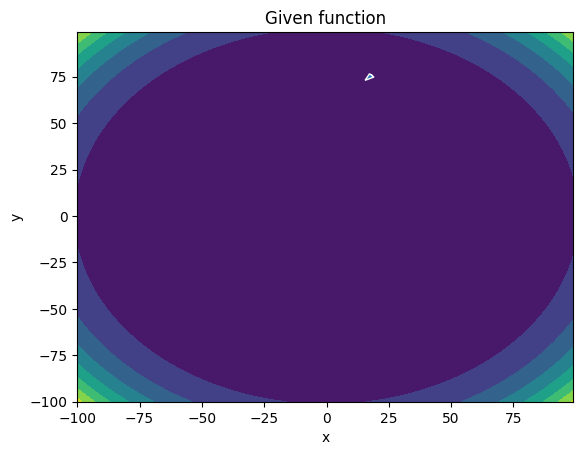

-------
Initial Coordinates:
[[18.12877504]
 [75.70930178]]
Final Coordinates:
[[18.0294524 ]
 [75.60958171]]
Gradient:
[[2.21745205e+10]
 [9.26728106e+10]]


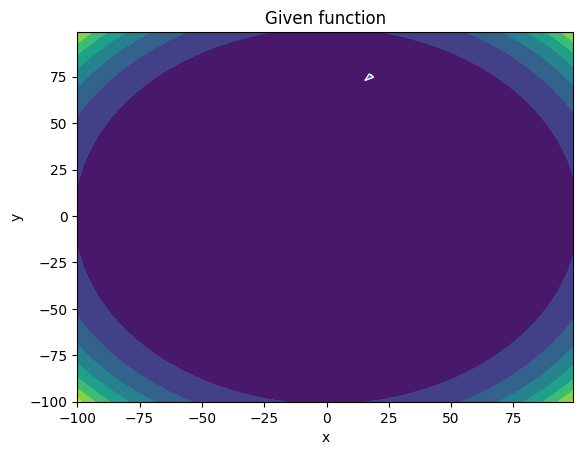

-------
Initial Coordinates:
[[18.0294524 ]
 [75.60958171]]
Final Coordinates:
[[17.93013391]
 [75.50986225]]
Gradient:
[[2.19171371e+10]
 [9.19810098e+10]]


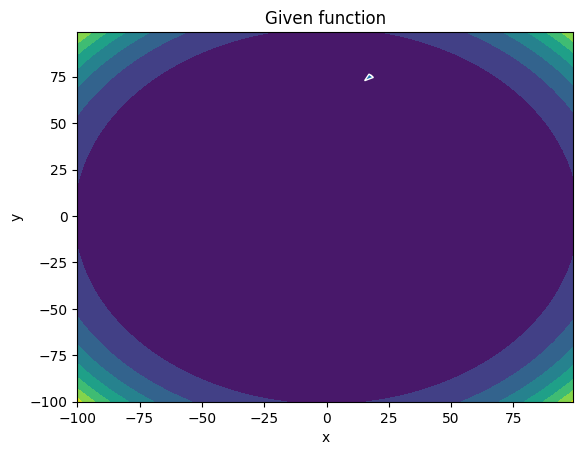

-------
Initial Coordinates:
[[17.93013391]
 [75.50986225]]
Final Coordinates:
[[17.83081963]
 [75.41014342]]
Gradient:
[[2.16619595e+10]
 [9.12936777e+10]]


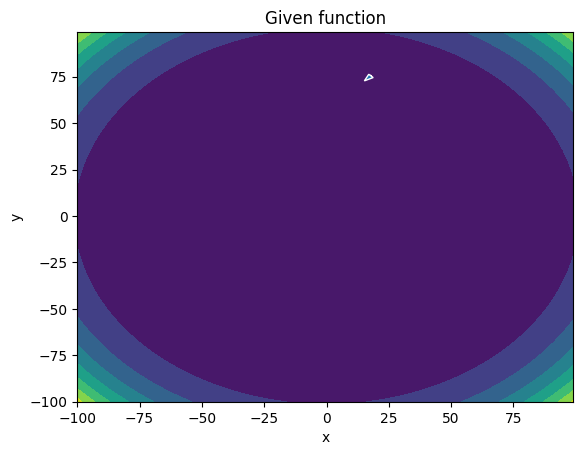

-------
Initial Coordinates:
[[17.83081963]
 [75.41014342]]
Final Coordinates:
[[17.73150961]
 [75.31042521]]
Gradient:
[[2.14089734e+10]
 [9.06107914e+10]]


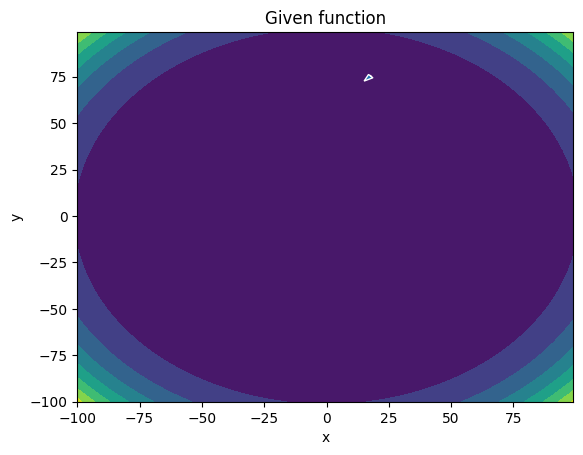

-------
Initial Coordinates:
[[17.73150961]
 [75.31042521]]
Final Coordinates:
[[17.6322039 ]
 [75.21070762]]
Gradient:
[[2.11581645e+10]
 [8.99323280e+10]]


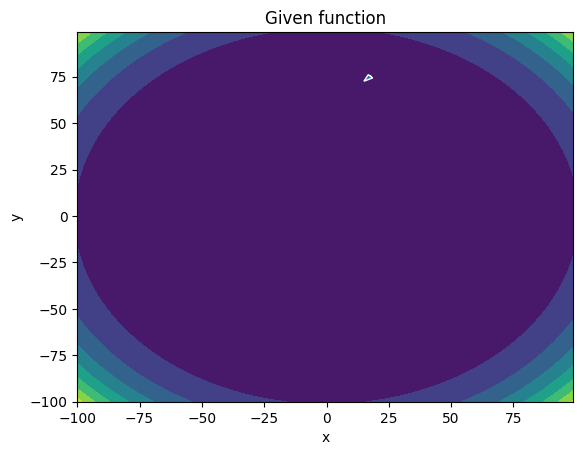

-------
Initial Coordinates:
[[17.6322039 ]
 [75.21070762]]
Final Coordinates:
[[17.53290255]
 [75.11099066]]
Gradient:
[[2.09095185e+10]
 [8.92582647e+10]]


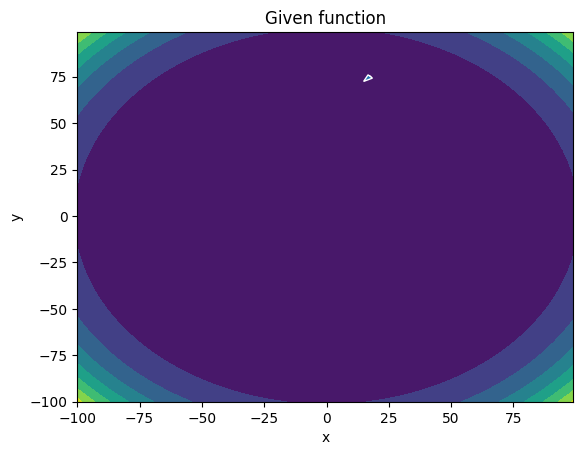

-------
Initial Coordinates:
[[17.53290255]
 [75.11099066]]
Final Coordinates:
[[17.4336056 ]
 [75.01127432]]
Gradient:
[[2.06630211e+10]
 [8.85885787e+10]]


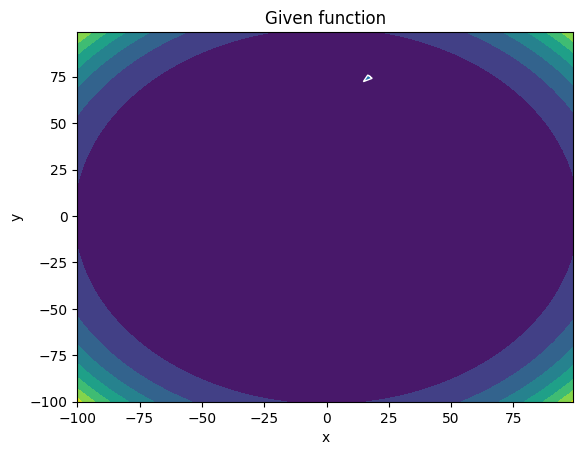

-------
Initial Coordinates:
[[17.4336056 ]
 [75.01127432]]
Final Coordinates:
[[17.33431312]
 [74.91155861]]
Gradient:
[[2.04186583e+10]
 [8.79232474e+10]]


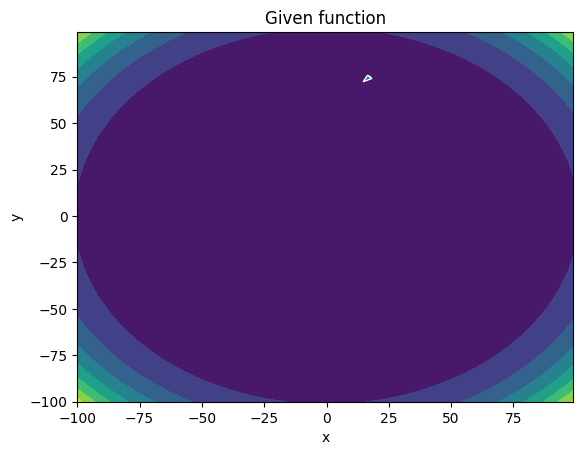

-------
Initial Coordinates:
[[17.33431312]
 [74.91155861]]
Final Coordinates:
[[17.23502516]
 [74.81184353]]
Gradient:
[[2.01764160e+10]
 [8.72622481e+10]]


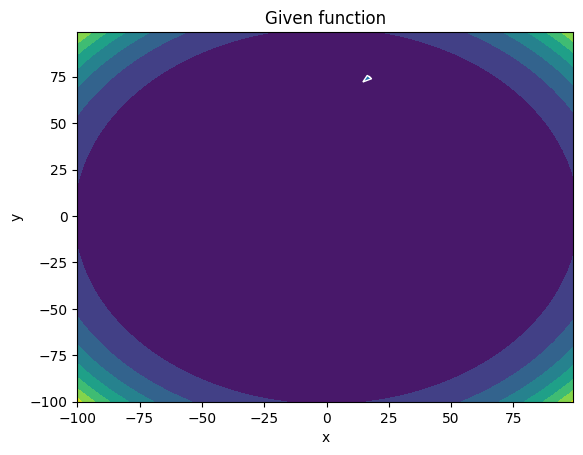

-------
Initial Coordinates:
[[17.23502516]
 [74.81184353]]
Final Coordinates:
[[17.13574176]
 [74.71212908]]
Gradient:
[[1.99362802e+10]
 [8.66055583e+10]]


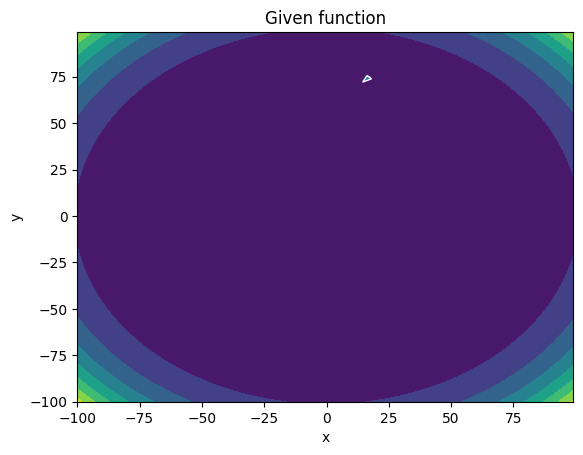

-------
Initial Coordinates:
[[17.13574176]
 [74.71212908]]
Final Coordinates:
[[17.036463  ]
 [74.61241525]]
Gradient:
[[1.96982369e+10]
 [8.59531558e+10]]


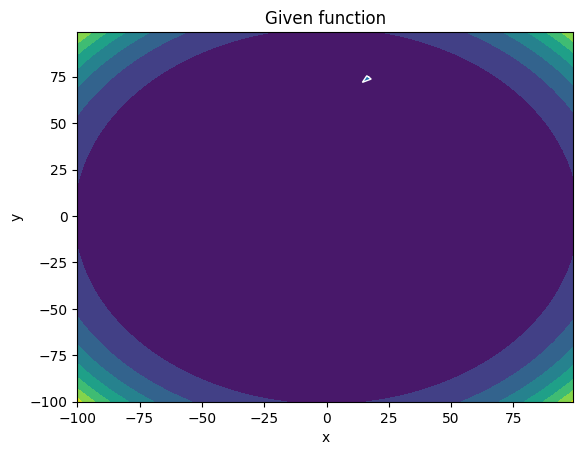

-------
Initial Coordinates:
[[17.036463  ]
 [74.61241525]]
Final Coordinates:
[[16.93718891]
 [74.51270206]]
Gradient:
[[1.94622723e+10]
 [8.53050180e+10]]


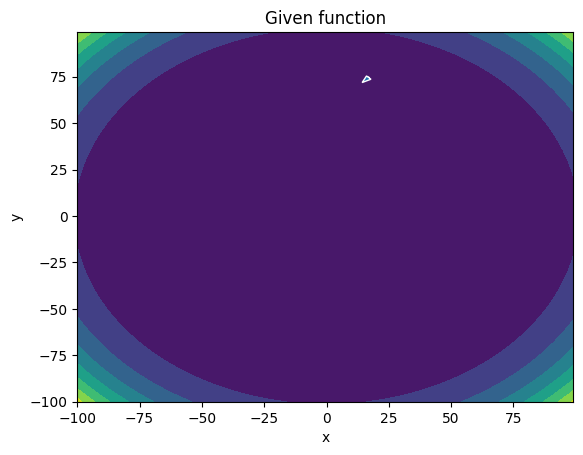

-------
Initial Coordinates:
[[16.93718891]
 [74.51270206]]
Final Coordinates:
[[16.83791957]
 [74.4129895 ]]
Gradient:
[[1.92283726e+10]
 [8.46611229e+10]]


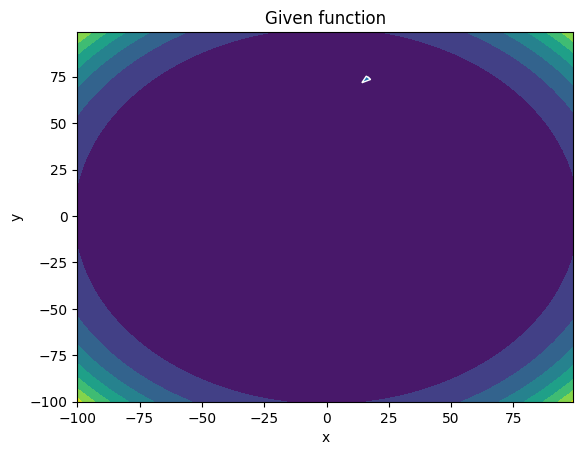

-------
Initial Coordinates:
[[16.83791957]
 [74.4129895 ]]
Final Coordinates:
[[16.73865503]
 [74.31327757]]
Gradient:
[[1.89965240e+10]
 [8.40214481e+10]]


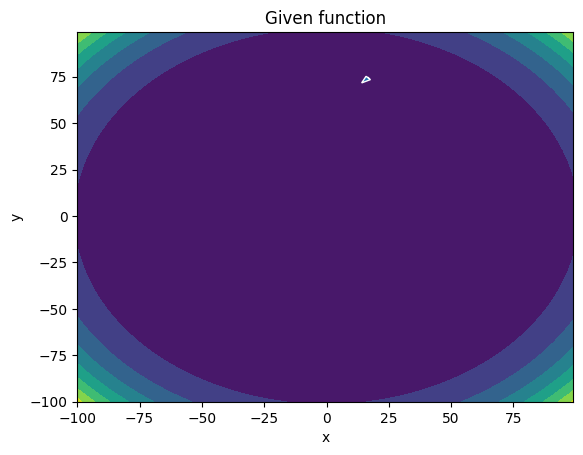

-------
Initial Coordinates:
[[16.73865503]
 [74.31327757]]
Final Coordinates:
[[16.63939535]
 [74.21356628]]
Gradient:
[[1.87667128e+10]
 [8.33859716e+10]]


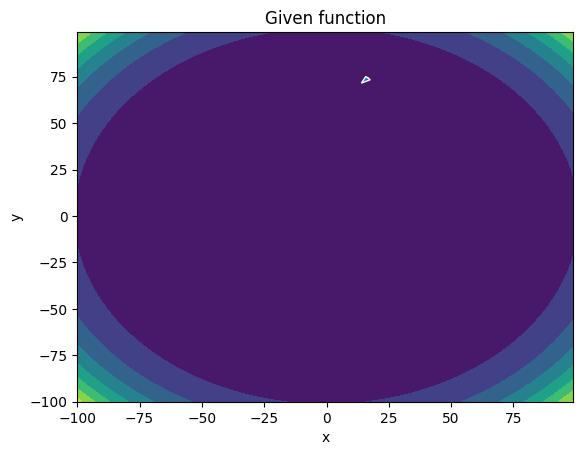

-------
Initial Coordinates:
[[16.63939535]
 [74.21356628]]
Final Coordinates:
[[16.54014059]
 [74.11385562]]
Gradient:
[[1.85389255e+10]
 [8.27546715e+10]]


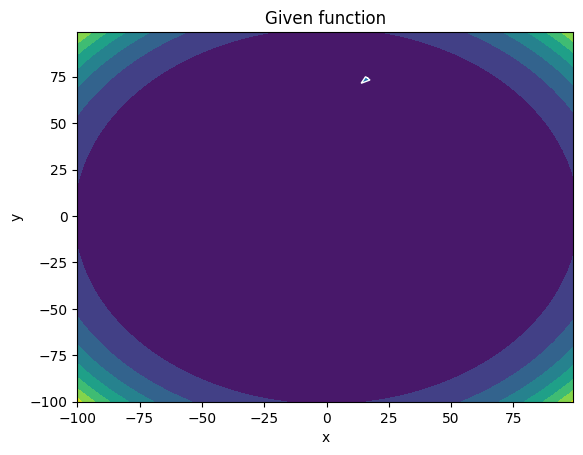

-------
Initial Coordinates:
[[16.54014059]
 [74.11385562]]
Final Coordinates:
[[16.44089082]
 [74.01414559]]
Gradient:
[[1.83131484e+10]
 [8.21275257e+10]]


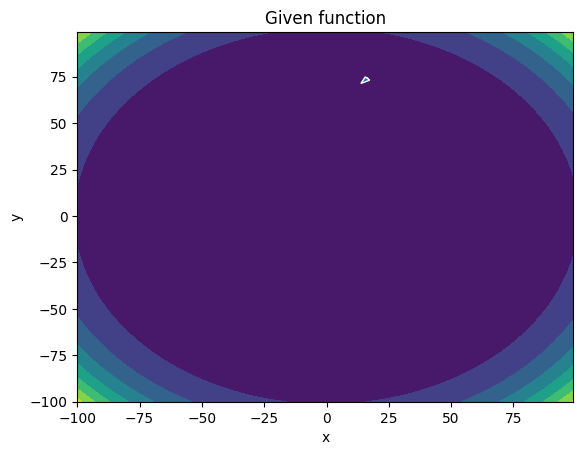

-------
Initial Coordinates:
[[16.44089082]
 [74.01414559]]
Final Coordinates:
[[16.34164609]
 [73.91443621]]
Gradient:
[[1.80893681e+10]
 [8.15045125e+10]]


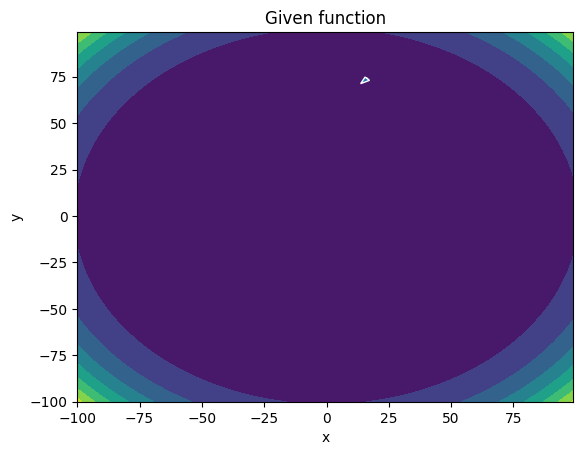

-------
Initial Coordinates:
[[16.34164609]
 [73.91443621]]
Final Coordinates:
[[16.24240648]
 [73.81472745]]
Gradient:
[[1.78675711e+10]
 [8.08856101e+10]]


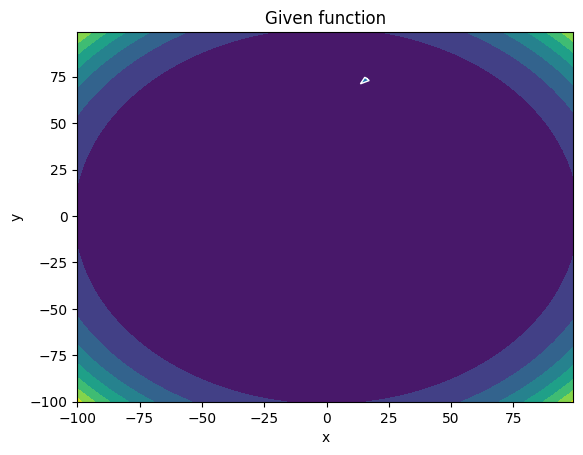

-------
Initial Coordinates:
[[16.24240648]
 [73.81472745]]
Final Coordinates:
[[16.14317205]
 [73.71501934]]
Gradient:
[[1.76477441e+10]
 [8.02707968e+10]]


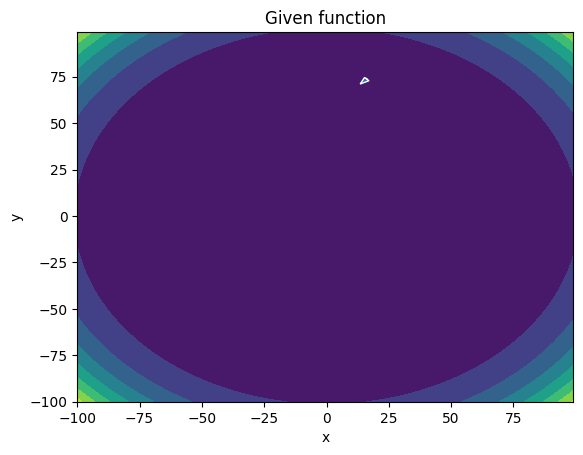

-------
Initial Coordinates:
[[16.14317205]
 [73.71501934]]
Final Coordinates:
[[16.04394286]
 [73.61531186]]
Gradient:
[[1.74298738e+10]
 [7.96600510e+10]]


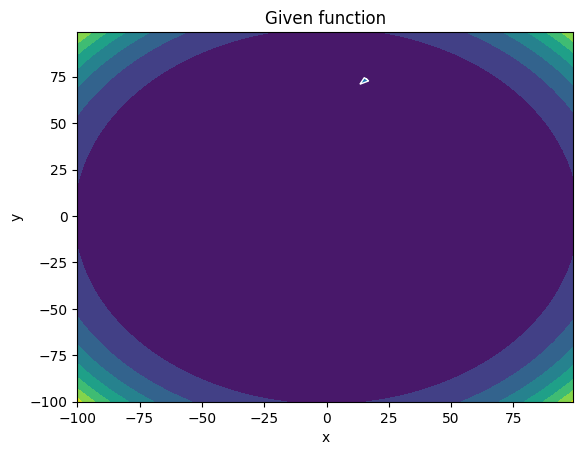

-------
Initial Coordinates:
[[16.04394286]
 [73.61531186]]
Final Coordinates:
[[15.94471899]
 [73.51560503]]
Gradient:
[[1.72139470e+10]
 [7.90533512e+10]]


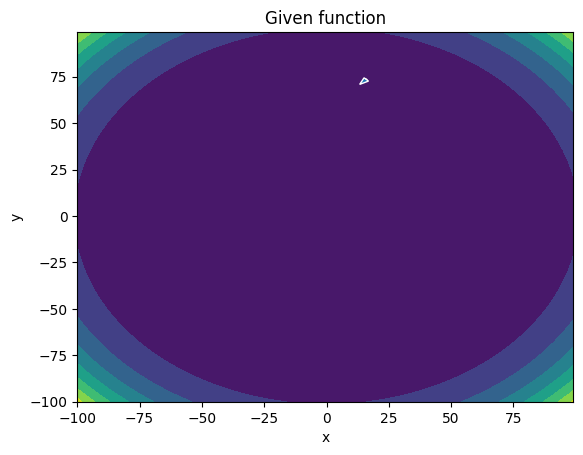

-------
Initial Coordinates:
[[15.94471899]
 [73.51560503]]
Final Coordinates:
[[15.8455005 ]
 [73.41589883]]
Gradient:
[[1.69999504e+10]
 [7.84506759e+10]]


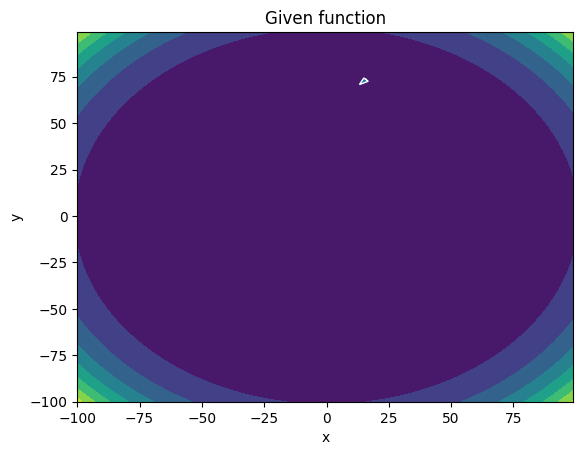

-------
Initial Coordinates:
[[15.8455005 ]
 [73.41589883]]
Final Coordinates:
[[15.74628747]
 [73.31619328]]
Gradient:
[[1.67878710e+10]
 [7.78520038e+10]]


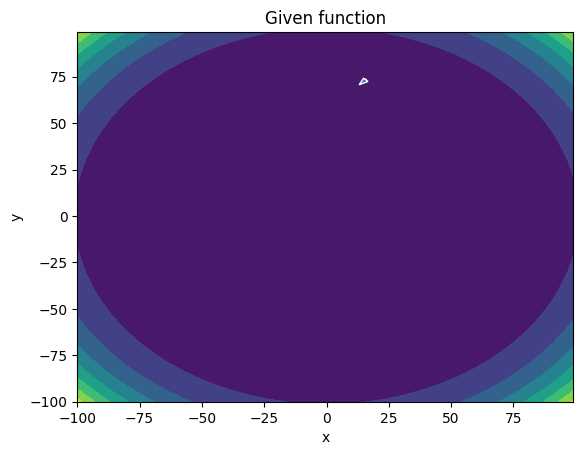

-------
Initial Coordinates:
[[15.74628747]
 [73.31619328]]
Final Coordinates:
[[15.64707998]
 [73.21648837]]
Gradient:
[[1.65776956e+10]
 [7.72573137e+10]]


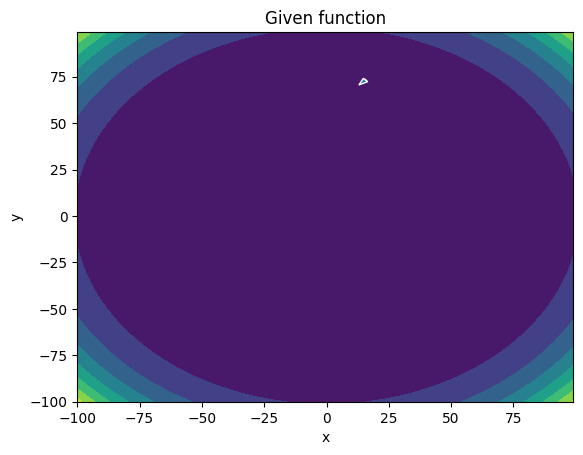

-------
Initial Coordinates:
[[15.64707998]
 [73.21648837]]
Final Coordinates:
[[15.54787809]
 [73.1167841 ]]
Gradient:
[[1.63694114e+10]
 [7.66665843e+10]]


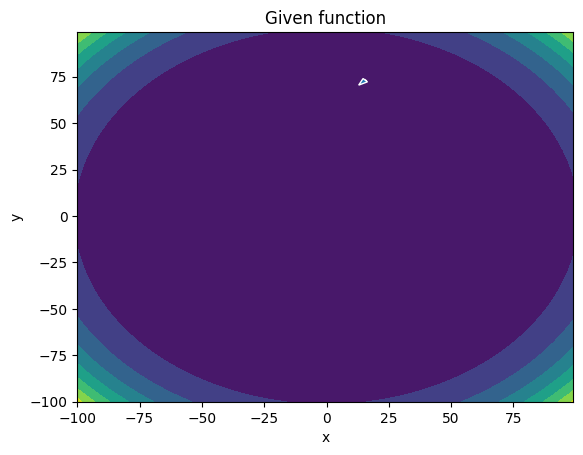

-------
Initial Coordinates:
[[15.54787809]
 [73.1167841 ]]
Final Coordinates:
[[15.44868188]
 [73.01708047]]
Gradient:
[[1.61630054e+10]
 [7.60797945e+10]]


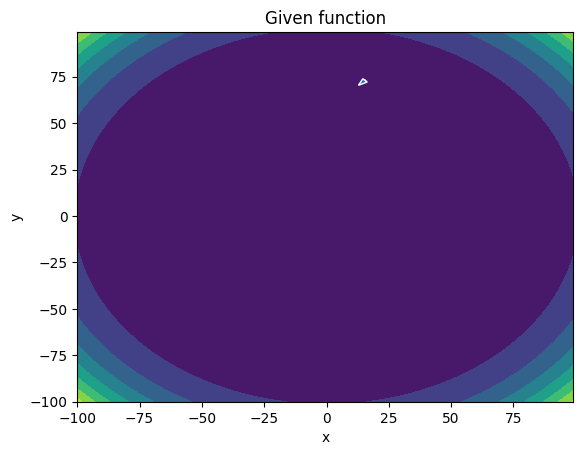

-------
Initial Coordinates:
[[15.44868188]
 [73.01708047]]
Final Coordinates:
[[15.34949143]
 [72.91737749]]
Gradient:
[[1.59584647e+10]
 [7.54969233e+10]]


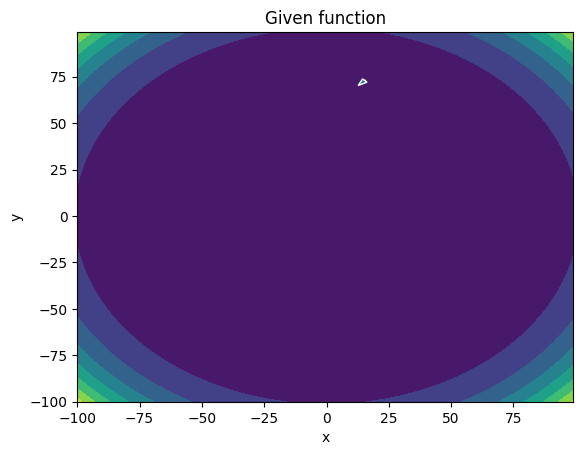

-------
Initial Coordinates:
[[15.34949143]
 [72.91737749]]
Final Coordinates:
[[15.25030682]
 [72.81767515]]
Gradient:
[[1.57557765e+10]
 [7.49179497e+10]]


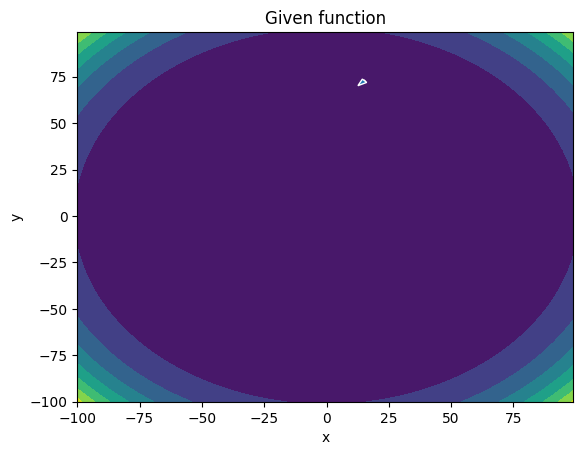

-------
Initial Coordinates:
[[15.25030682]
 [72.81767515]]
Final Coordinates:
[[15.15112813]
 [72.71797346]]
Gradient:
[[1.55549281e+10]
 [7.43428528e+10]]


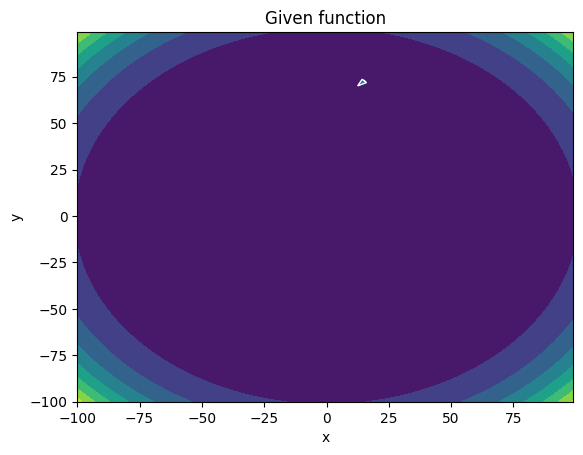

-------
Initial Coordinates:
[[15.15112813]
 [72.71797346]]
Final Coordinates:
[[15.05195544]
 [72.61827242]]
Gradient:
[[1.53559068e+10]
 [7.37716119e+10]]


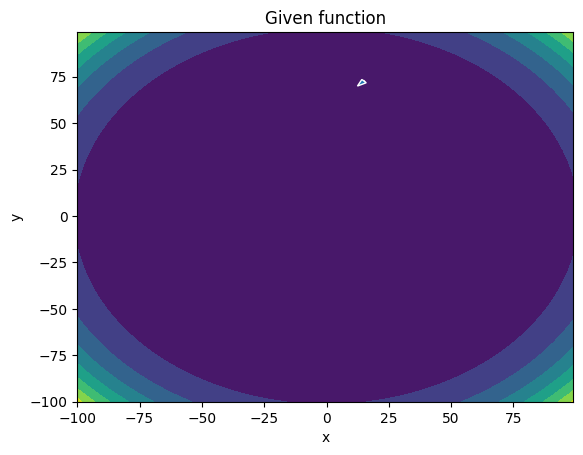

-------
Initial Coordinates:
[[15.05195544]
 [72.61827242]]
Final Coordinates:
[[14.95278884]
 [72.51857202]]
Gradient:
[[1.51587000e+10]
 [7.32042062e+10]]


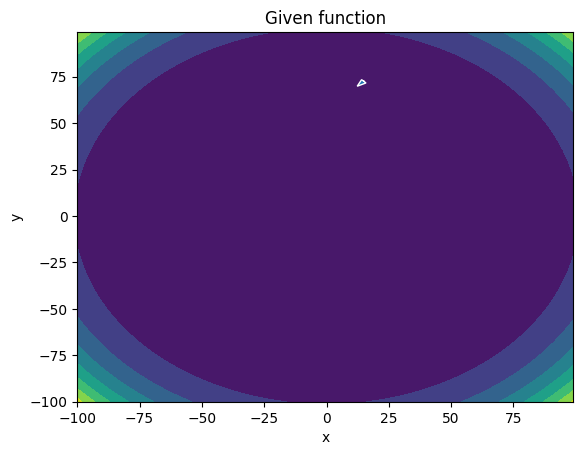

-------
Initial Coordinates:
[[14.95278884]
 [72.51857202]]
Final Coordinates:
[[14.85362841]
 [72.41887228]]
Gradient:
[[1.49632951e+10]
 [7.26406151e+10]]


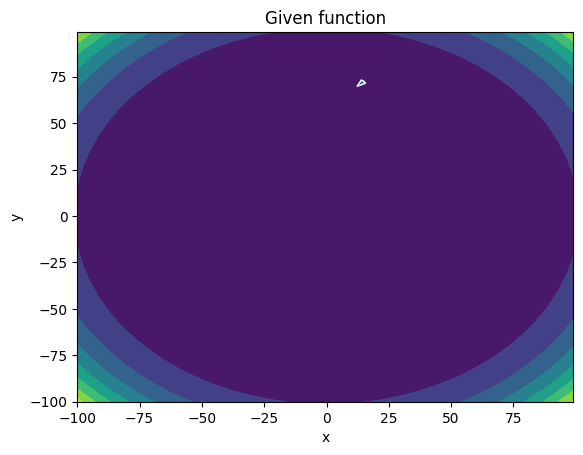

-------
Initial Coordinates:
[[14.85362841]
 [72.41887228]]
Final Coordinates:
[[14.75447425]
 [72.31917318]]
Gradient:
[[1.47696796e+10]
 [7.20808180e+10]]


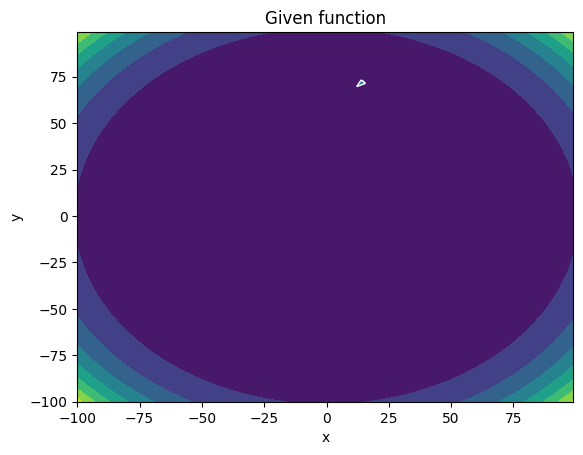

-------
Initial Coordinates:
[[14.75447425]
 [72.31917318]]
Final Coordinates:
[[14.65532644]
 [72.21947473]]
Gradient:
[[1.45778411e+10]
 [7.15247945e+10]]


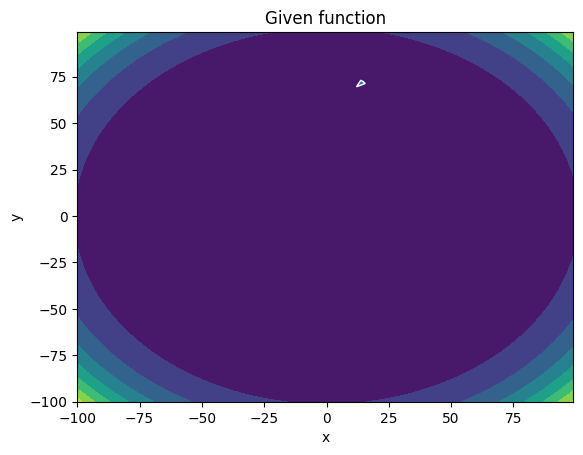

-------
Initial Coordinates:
[[14.65532644]
 [72.21947473]]
Final Coordinates:
[[14.55618507]
 [72.11977693]]
Gradient:
[[1.43877673e+10]
 [7.09725241e+10]]


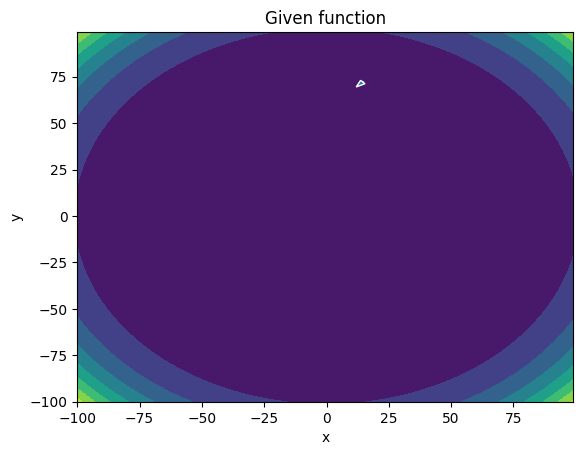

-------
Initial Coordinates:
[[14.55618507]
 [72.11977693]]
Final Coordinates:
[[14.45705025]
 [72.02007978]]
Gradient:
[[1.41994457e+10]
 [7.04239865e+10]]


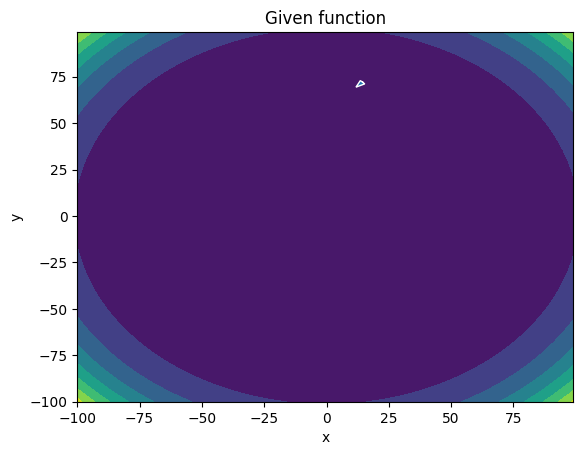

-------
Initial Coordinates:
[[14.45705025]
 [72.02007978]]
Final Coordinates:
[[14.35792205]
 [71.92038328]]
Gradient:
[[1.40128642e+10]
 [6.98791615e+10]]


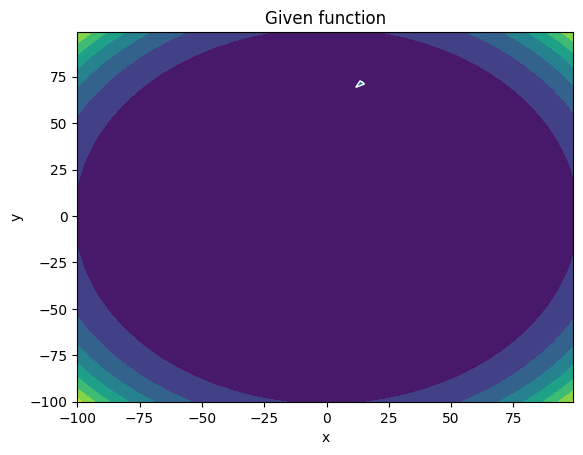

-------
Initial Coordinates:
[[14.35792205]
 [71.92038328]]
Final Coordinates:
[[14.2588006 ]
 [71.82068744]]
Gradient:
[[1.38280106e+10]
 [6.93380289e+10]]


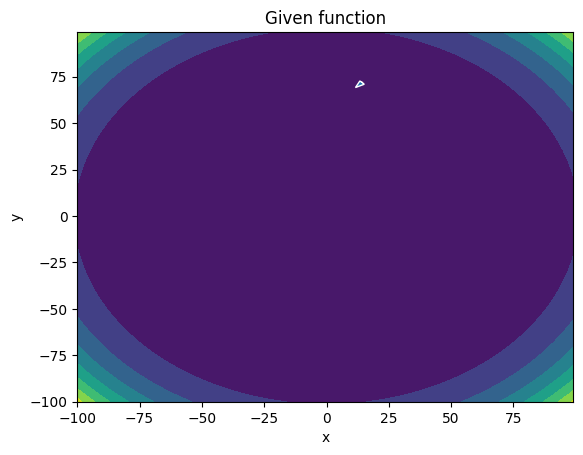

-------
Initial Coordinates:
[[14.2588006 ]
 [71.82068744]]
Final Coordinates:
[[14.15968597]
 [71.72099224]]
Gradient:
[[1.36448727e+10]
 [6.88005686e+10]]


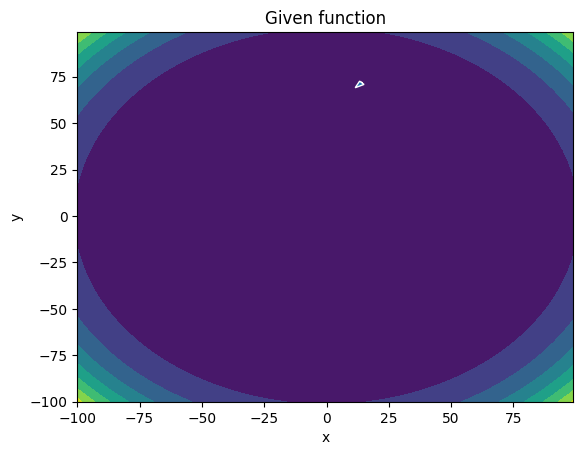

-------
Initial Coordinates:
[[14.15968597]
 [71.72099224]]
Final Coordinates:
[[14.06057829]
 [71.6212977 ]]
Gradient:
[[1.34634384e+10]
 [6.82667606e+10]]


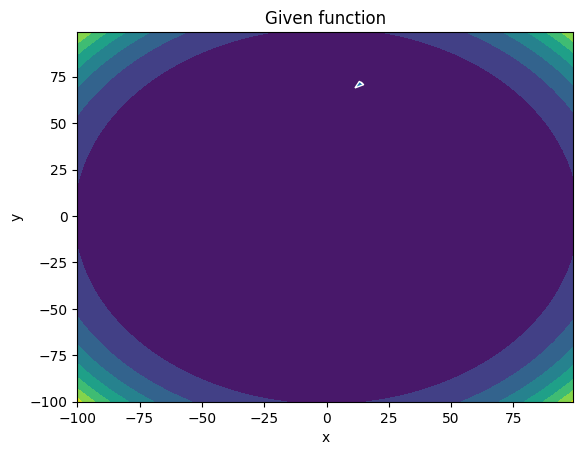

-------
Initial Coordinates:
[[14.06057829]
 [71.6212977 ]]
Final Coordinates:
[[13.96147765]
 [71.52160382]]
Gradient:
[[1.32836958e+10]
 [6.77365850e+10]]


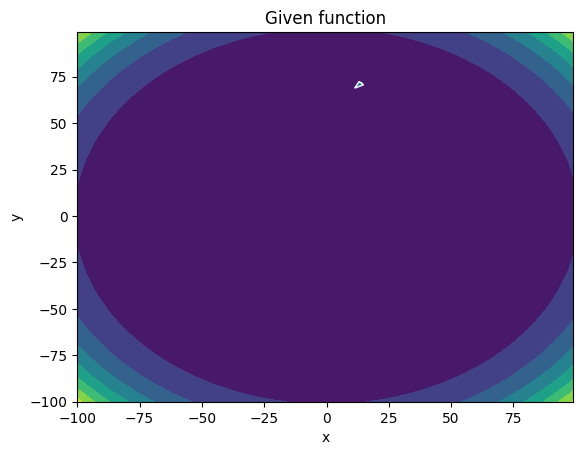

-------
Initial Coordinates:
[[13.96147765]
 [71.52160382]]
Final Coordinates:
[[13.86238416]
 [71.42191059]]
Gradient:
[[1.31056329e+10]
 [6.72100218e+10]]


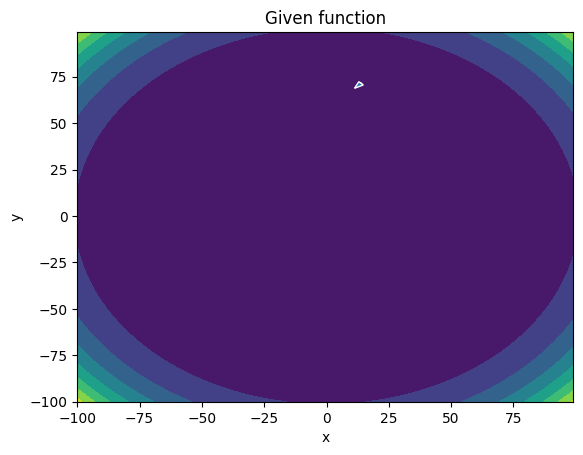

-------
Initial Coordinates:
[[13.86238416]
 [71.42191059]]
Final Coordinates:
[[13.76329793]
 [71.32221801]]
Gradient:
[[1.29292378e+10]
 [6.66870514e+10]]


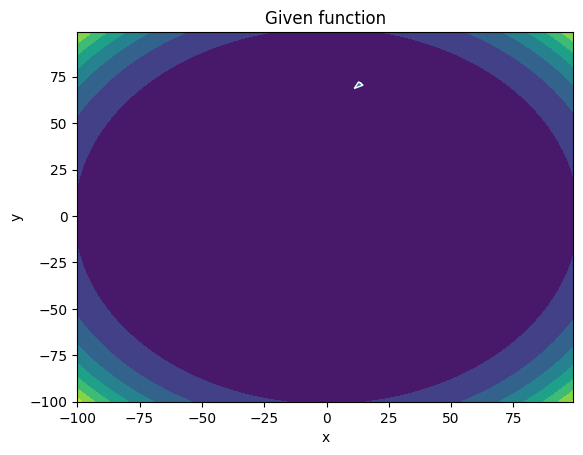

-------
Initial Coordinates:
[[13.76329793]
 [71.32221801]]
Final Coordinates:
[[13.66421907]
 [71.22252609]]
Gradient:
[[1.27544986e+10]
 [6.61676540e+10]]


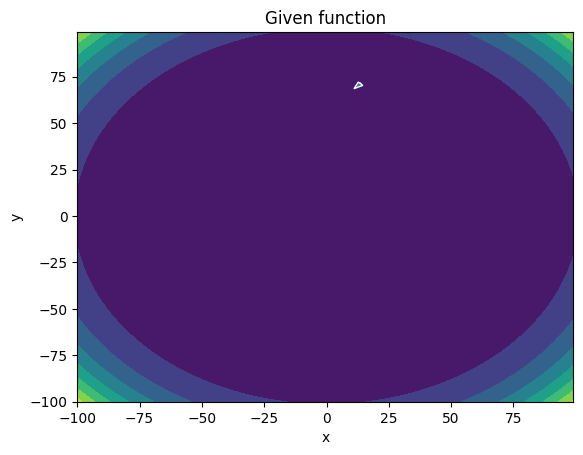

-------
Initial Coordinates:
[[13.66421907]
 [71.22252609]]
Final Coordinates:
[[13.56514771]
 [71.12283483]]
Gradient:
[[1.25814037e+10]
 [6.56518101e+10]]


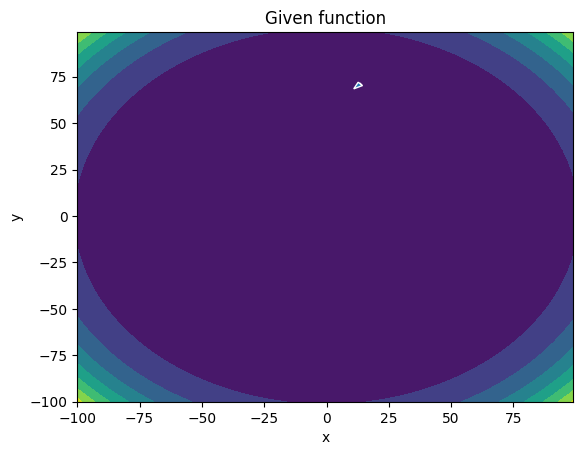

-------
Initial Coordinates:
[[13.56514771]
 [71.12283483]]
Final Coordinates:
[[13.46608395]
 [71.02314422]]
Gradient:
[[1.24099412e+10]
 [6.51394999e+10]]


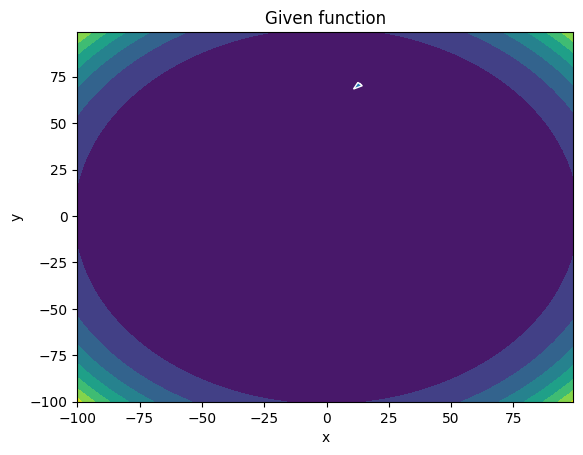

-------
Initial Coordinates:
[[13.46608395]
 [71.02314422]]
Final Coordinates:
[[13.36702792]
 [70.92345427]]
Gradient:
[[1.22400995e+10]
 [6.46307041e+10]]


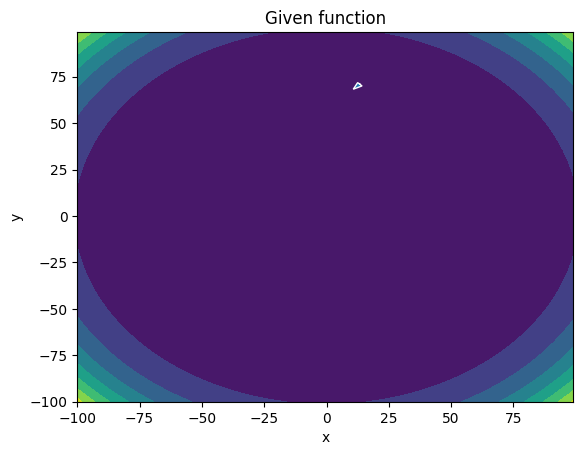

-------
Initial Coordinates:
[[13.36702792]
 [70.92345427]]
Final Coordinates:
[[13.26797975]
 [70.82376498]]
Gradient:
[[1.20718671e+10]
 [6.41254034e+10]]


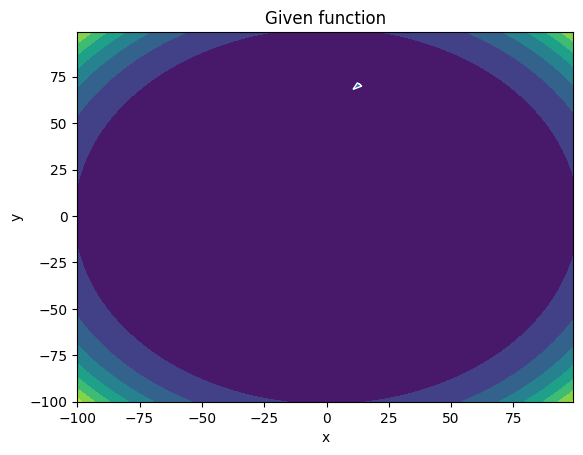

-------
Initial Coordinates:
[[13.26797975]
 [70.82376498]]
Final Coordinates:
[[13.16893956]
 [70.72407635]]
Gradient:
[[1.19052323e+10]
 [6.36235782e+10]]


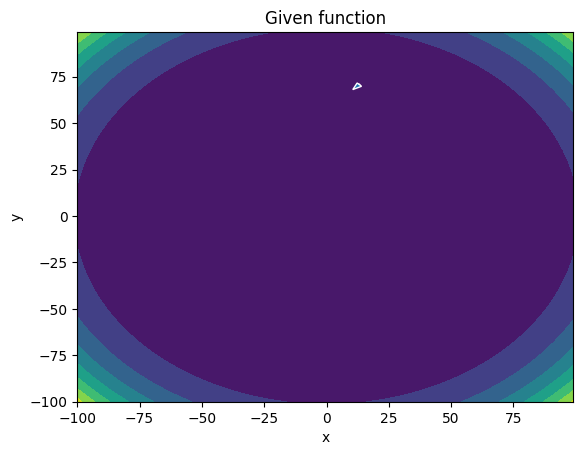

-------
Initial Coordinates:
[[13.16893956]
 [70.72407635]]
Final Coordinates:
[[13.06990748]
 [70.62438837]]
Gradient:
[[1.17401838e+10]
 [6.31252095e+10]]


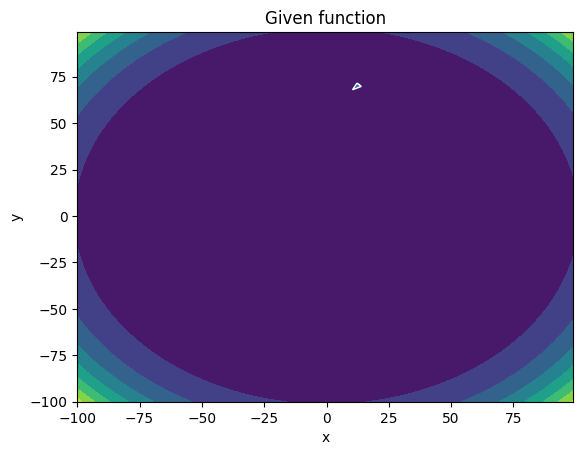

-------
Initial Coordinates:
[[13.06990748]
 [70.62438837]]
Final Coordinates:
[[12.97088364]
 [70.52470106]]
Gradient:
[[1.15767101e+10]
 [6.26302780e+10]]


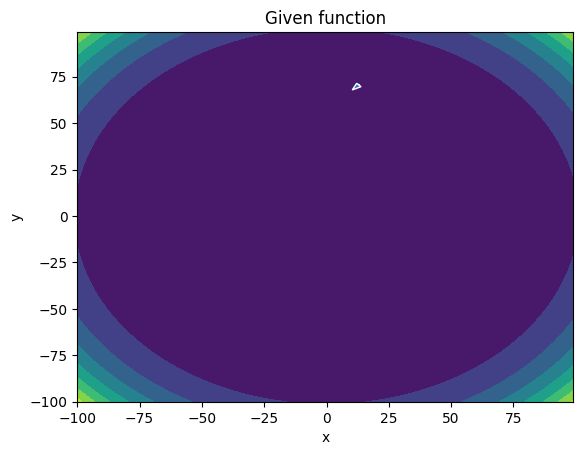

-------
Initial Coordinates:
[[12.97088364]
 [70.52470106]]
Final Coordinates:
[[12.87186819]
 [70.4250144 ]]
Gradient:
[[1.14147997e+10]
 [6.21387646e+10]]


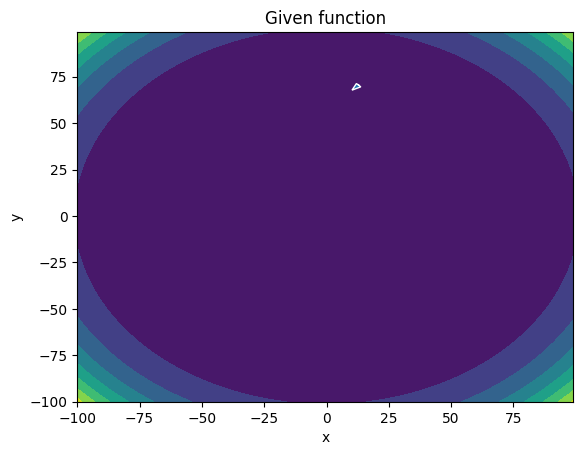

-------
Initial Coordinates:
[[12.87186819]
 [70.4250144 ]]
Final Coordinates:
[[12.77286125]
 [70.3253284 ]]
Gradient:
[[1.12544415e+10]
 [6.16506504e+10]]


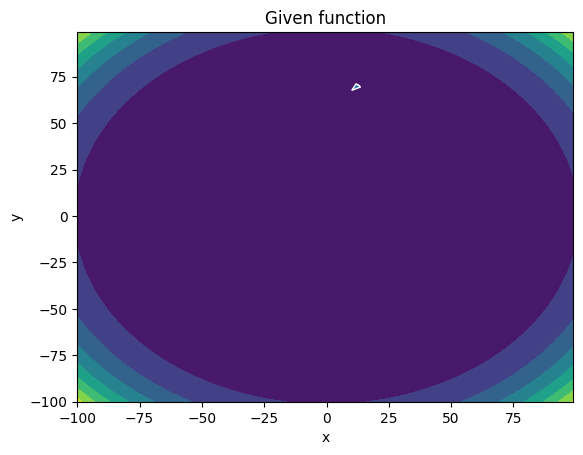

-------
Initial Coordinates:
[[12.77286125]
 [70.3253284 ]]
Final Coordinates:
[[12.67386298]
 [70.22564307]]
Gradient:
[[1.10956242e+10]
 [6.11659164e+10]]


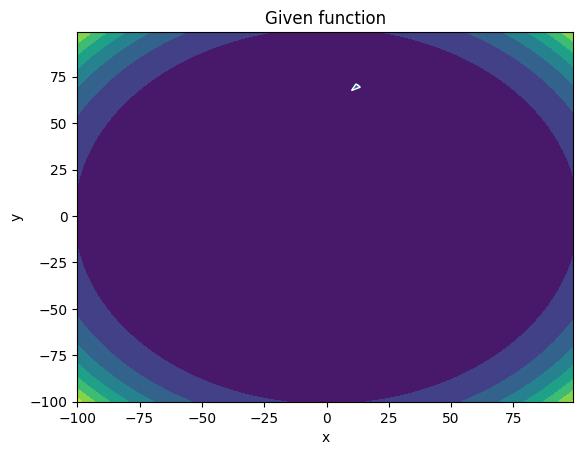

-------
Initial Coordinates:
[[12.67386298]
 [70.22564307]]
Final Coordinates:
[[12.57487353]
 [70.12595839]]
Gradient:
[[1.09383366e+10]
 [6.06845437e+10]]


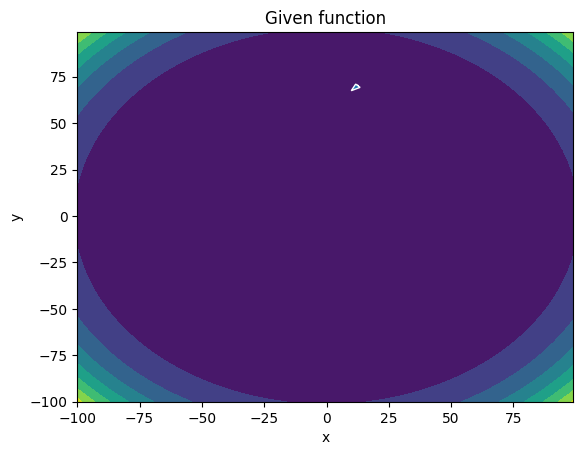

-------
Initial Coordinates:
[[12.57487353]
 [70.12595839]]
Final Coordinates:
[[12.47589303]
 [70.02627438]]
Gradient:
[[1.07825675e+10]
 [6.02065135e+10]]


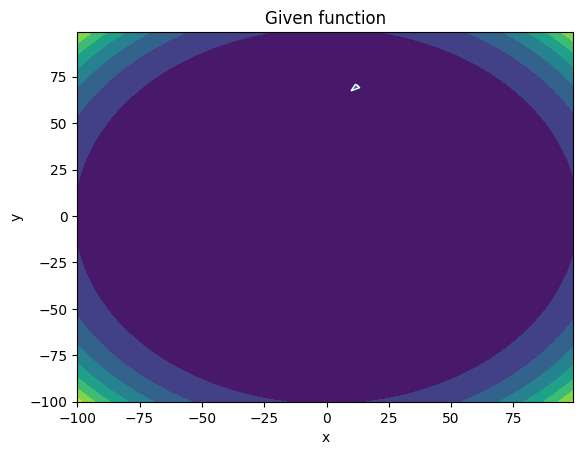

-------
Initial Coordinates:
[[12.47589303]
 [70.02627438]]
Final Coordinates:
[[12.37692166]
 [69.92659102]]
Gradient:
[[1.06283059e+10]
 [5.97318072e+10]]


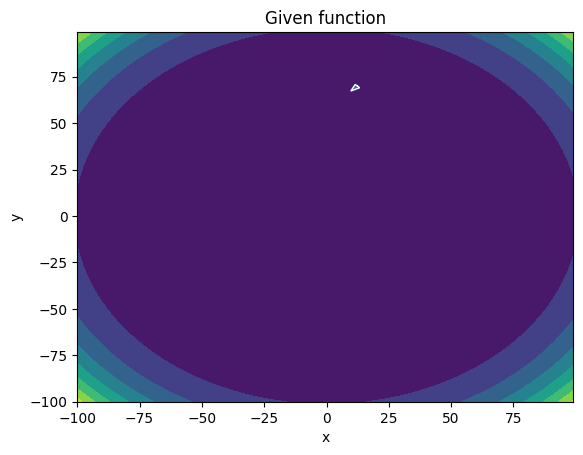

-------
Initial Coordinates:
[[12.37692166]
 [69.92659102]]
Final Coordinates:
[[12.27795957]
 [69.82690833]]
Gradient:
[[1.04755408e+10]
 [5.92604060e+10]]


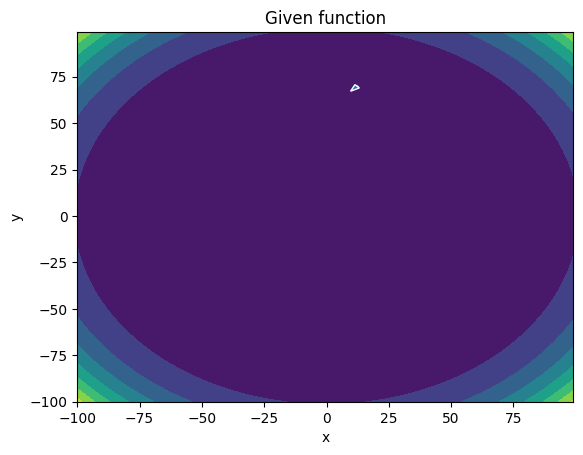

-------
Initial Coordinates:
[[12.27795957]
 [69.82690833]]
Final Coordinates:
[[12.17900691]
 [69.7272263 ]]
Gradient:
[[1.03242613e+10]
 [5.87922914e+10]]


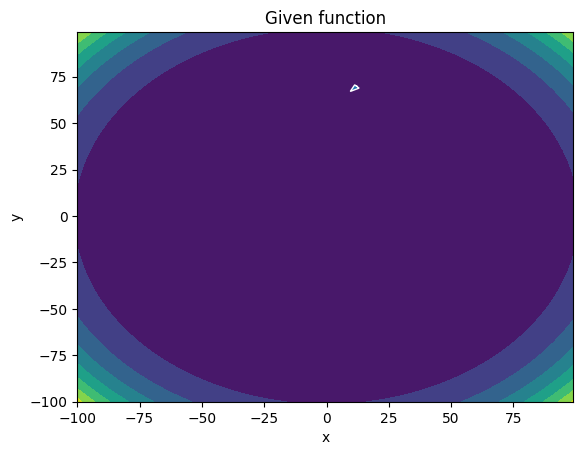

-------
Initial Coordinates:
[[12.17900691]
 [69.7272263 ]]
Final Coordinates:
[[12.08006386]
 [69.62754493]]
Gradient:
[[1.01744563e+10]
 [5.83274449e+10]]


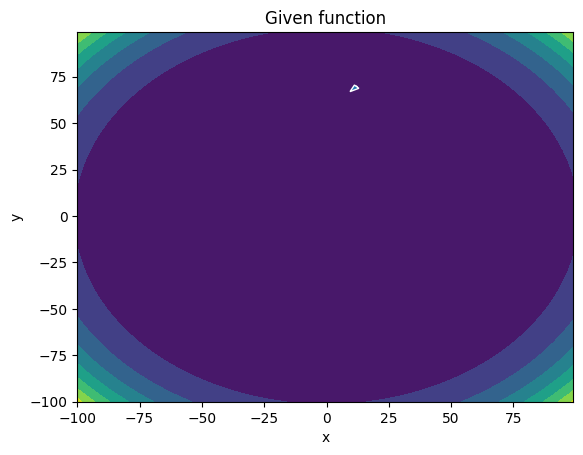

-------
Initial Coordinates:
[[12.08006386]
 [69.62754493]]
Final Coordinates:
[[11.9811306 ]
 [69.52786423]]
Gradient:
[[1.00261151e+10]
 [5.78658481e+10]]


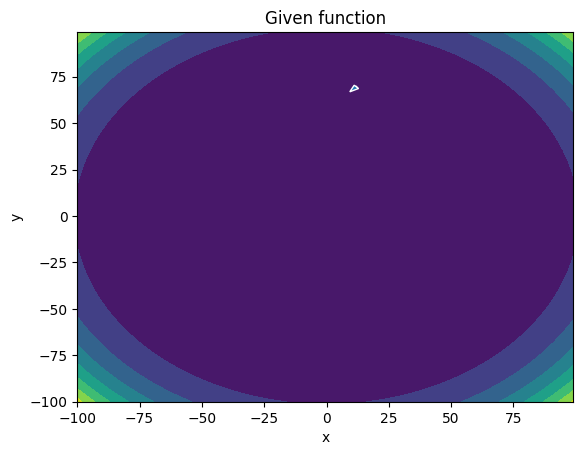

-------
Initial Coordinates:
[[11.9811306 ]
 [69.52786423]]
Final Coordinates:
[[11.88220729]
 [69.42818419]]
Gradient:
[[9.87922698e+09]
 [5.74074827e+10]]


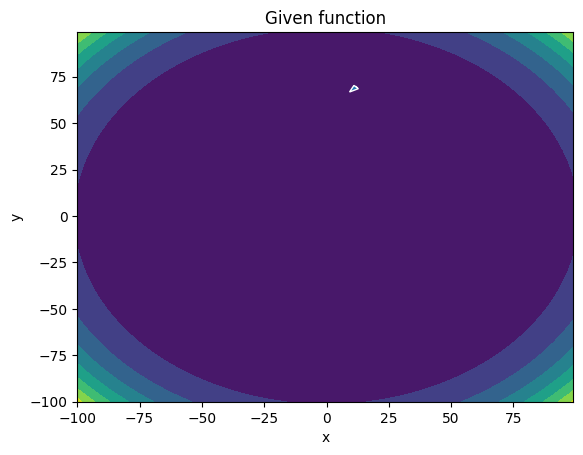

-------
Initial Coordinates:
[[11.88220729]
 [69.42818419]]
Final Coordinates:
[[11.78329412]
 [69.32850481]]
Gradient:
[[9.73378108e+09]
 [5.69523303e+10]]


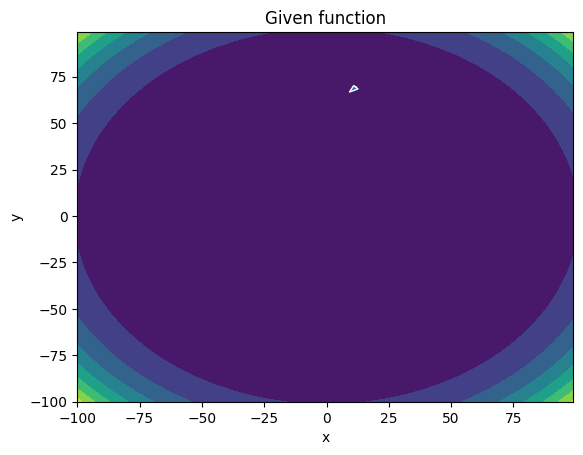

-------
Initial Coordinates:
[[11.78329412]
 [69.32850481]]
Final Coordinates:
[[11.68439128]
 [69.22882609]]
Gradient:
[[9.58976679e+09]
 [5.65003729e+10]]


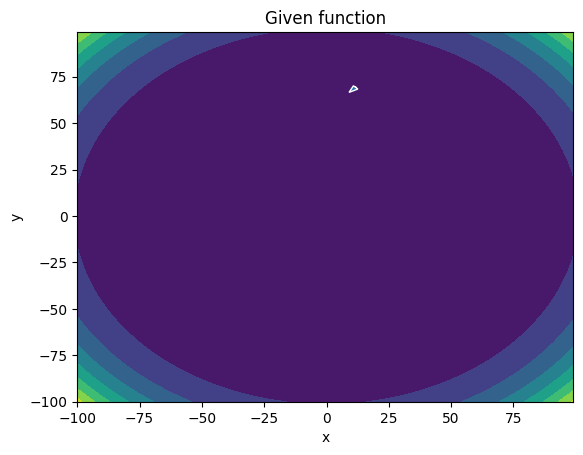

-------
Initial Coordinates:
[[11.68439128]
 [69.22882609]]
Final Coordinates:
[[11.58549895]
 [69.12914804]]
Gradient:
[[9.44717349e+09]
 [5.60515921e+10]]


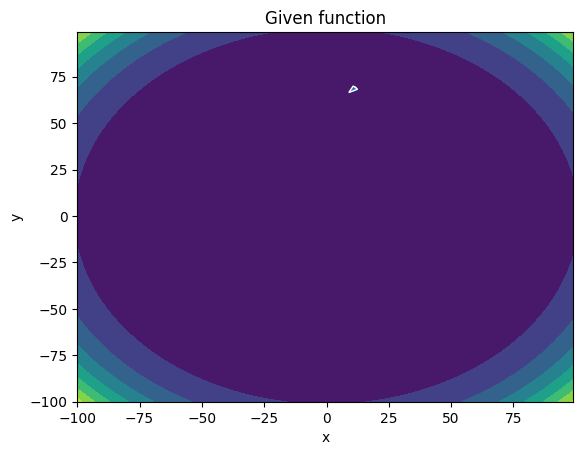

-------
Initial Coordinates:
[[11.58549895]
 [69.12914804]]
Final Coordinates:
[[11.48661734]
 [69.02947065]]
Gradient:
[[9.30599063e+09]
 [5.56059701e+10]]


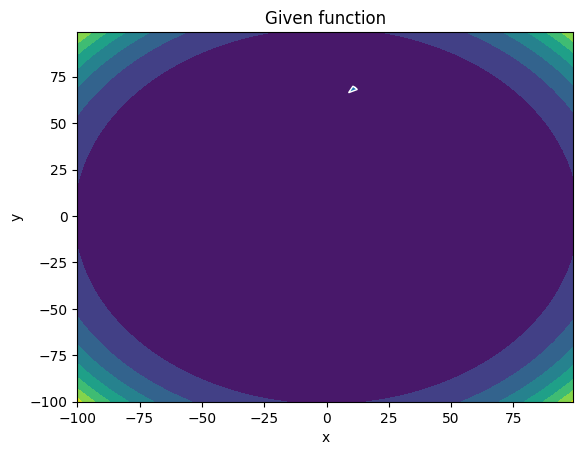

-------
Initial Coordinates:
[[11.48661734]
 [69.02947065]]
Final Coordinates:
[[11.38774664]
 [68.92979392]]
Gradient:
[[9.16620770e+09]
 [5.51634889e+10]]


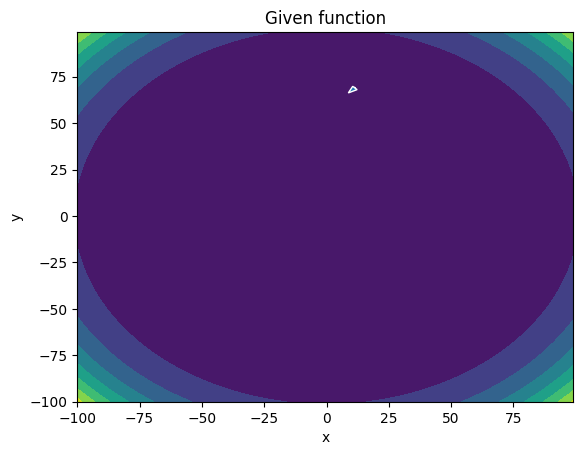

-------
Initial Coordinates:
[[11.38774664]
 [68.92979392]]
Final Coordinates:
[[11.28888706]
 [68.83011786]]
Gradient:
[[9.02781427e+09]
 [5.47241304e+10]]


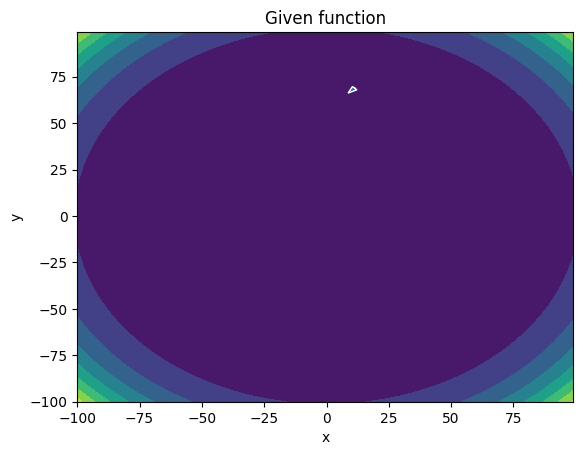

-------
Initial Coordinates:
[[11.28888706]
 [68.83011786]]
Final Coordinates:
[[11.19003882]
 [68.73044246]]
Gradient:
[[8.89079994e+09]
 [5.42878770e+10]]


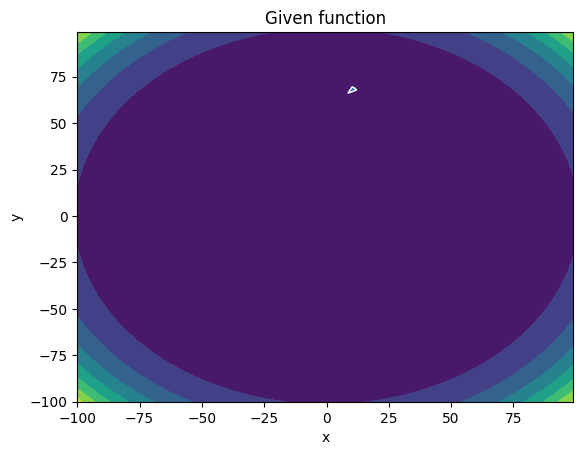

-------
Initial Coordinates:
[[11.19003882]
 [68.73044246]]
Final Coordinates:
[[11.09120214]
 [68.63076773]]
Gradient:
[[8.75515440e+09]
 [5.38547108e+10]]


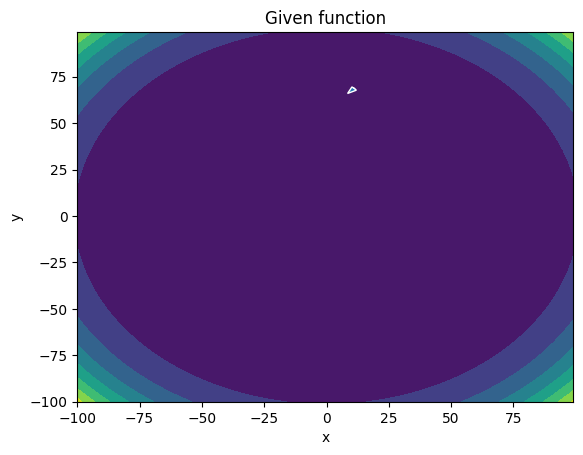

-------
Initial Coordinates:
[[11.09120214]
 [68.63076773]]
Final Coordinates:
[[10.99237725]
 [68.53109366]]
Gradient:
[[8.62086736e+09]
 [5.34246141e+10]]


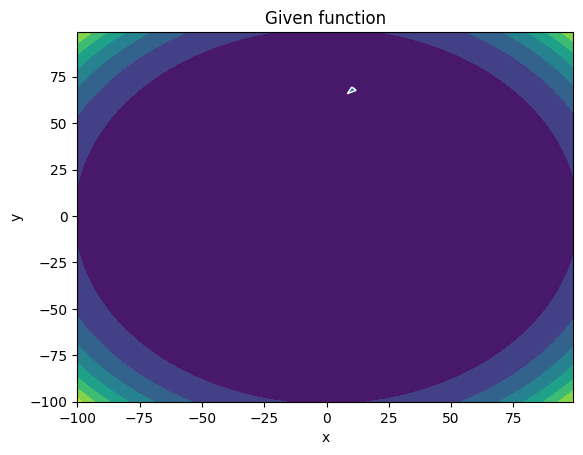

-------
Initial Coordinates:
[[10.99237725]
 [68.53109366]]
Final Coordinates:
[[10.89356437]
 [68.43142025]]
Gradient:
[[8.48792862e+09]
 [5.29975694e+10]]


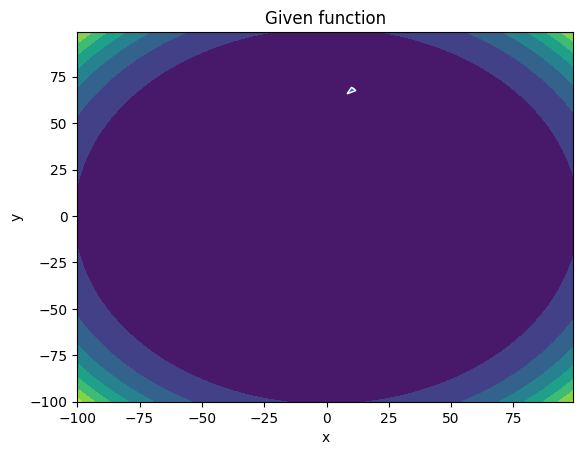

-------
Initial Coordinates:
[[10.89356437]
 [68.43142025]]
Final Coordinates:
[[10.79476375]
 [68.33174751]]
Gradient:
[[8.35632800e+09]
 [5.25735591e+10]]


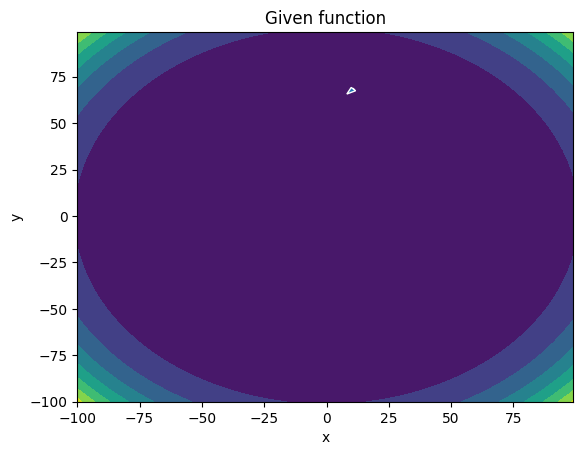

-------
Initial Coordinates:
[[10.79476375]
 [68.33174751]]
Final Coordinates:
[[10.69597563]
 [68.23207543]]
Gradient:
[[8.22605542e+09]
 [5.21525657e+10]]


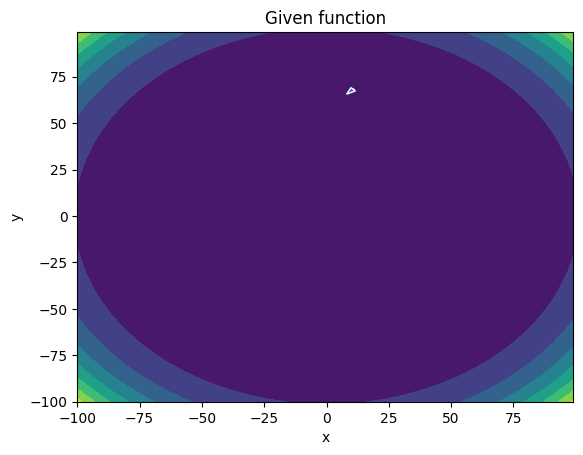

-------
Initial Coordinates:
[[10.69597563]
 [68.23207543]]
Final Coordinates:
[[10.59720027]
 [68.13240402]]
Gradient:
[[8.09710081e+09]
 [5.17345719e+10]]


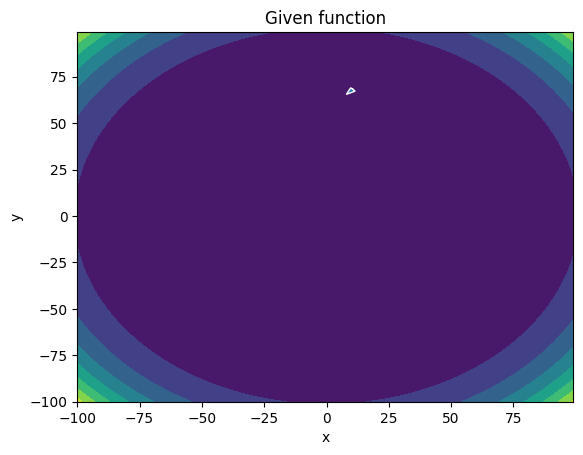

-------
Initial Coordinates:
[[10.59720027]
 [68.13240402]]
Final Coordinates:
[[10.49843793]
 [68.03273327]]
Gradient:
[[7.96945418e+09]
 [5.13195603e+10]]


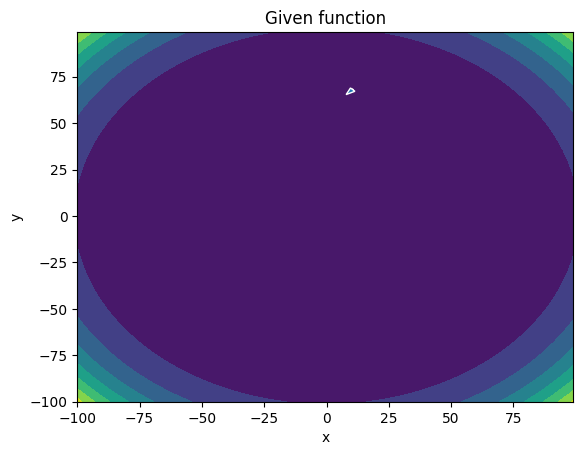

-------
Initial Coordinates:
[[10.49843793]
 [68.03273327]]
Final Coordinates:
[[10.39968888]
 [67.93306318]]
Gradient:
[[7.84310561e+09]
 [5.09075136e+10]]


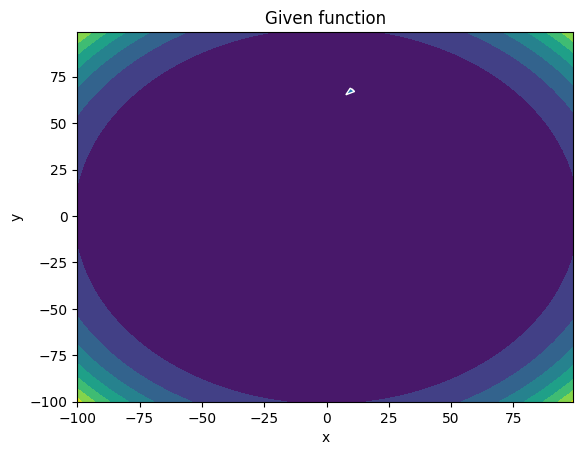

-------
Initial Coordinates:
[[10.39968888]
 [67.93306318]]
Final Coordinates:
[[10.30095339]
 [67.83339376]]
Gradient:
[[7.71804521e+09]
 [5.04984147e+10]]


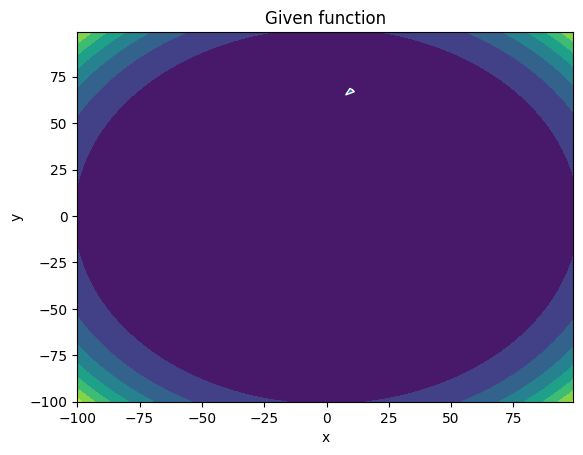

-------
Initial Coordinates:
[[10.30095339]
 [67.83339376]]
Final Coordinates:
[[10.20223176]
 [67.733725  ]]
Gradient:
[[7.59426315e+09]
 [5.00922465e+10]]


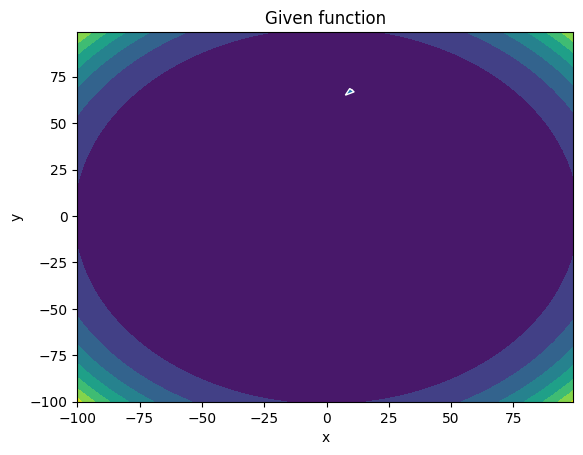

-------
Initial Coordinates:
[[10.20223176]
 [67.733725  ]]
Final Coordinates:
[[10.10352429]
 [67.6340569 ]]
Gradient:
[[7.47174966e+09]
 [4.96889919e+10]]


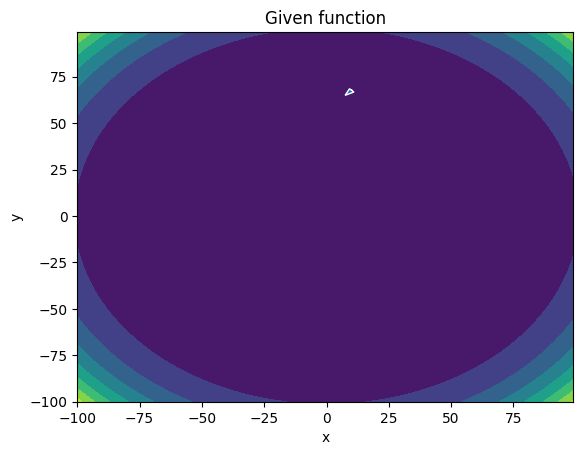

-------
Initial Coordinates:
[[10.10352429]
 [67.6340569 ]]
Final Coordinates:
[[10.00483127]
 [67.53438947]]
Gradient:
[[7.35049504e+09]
 [4.92886340e+10]]


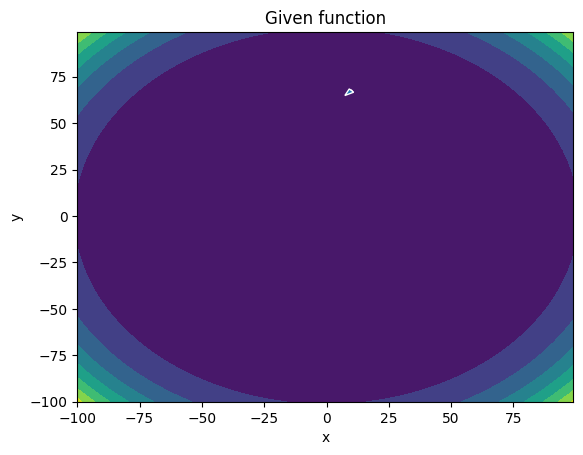

-------
Initial Coordinates:
[[10.00483127]
 [67.53438947]]
Final Coordinates:
[[ 9.90615302]
 [67.4347227 ]]
Gradient:
[[7.23048963e+09]
 [4.88911558e+10]]


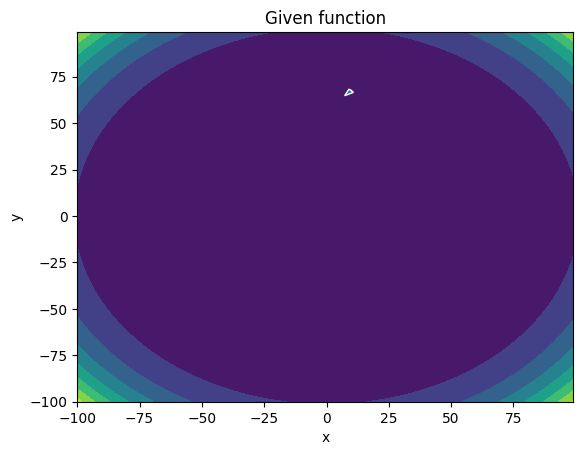

-------
Initial Coordinates:
[[ 9.90615302]
 [67.4347227 ]]
Final Coordinates:
[[ 9.80748986]
 [67.33505659]]
Gradient:
[[7.11172382e+09]
 [4.84965406e+10]]


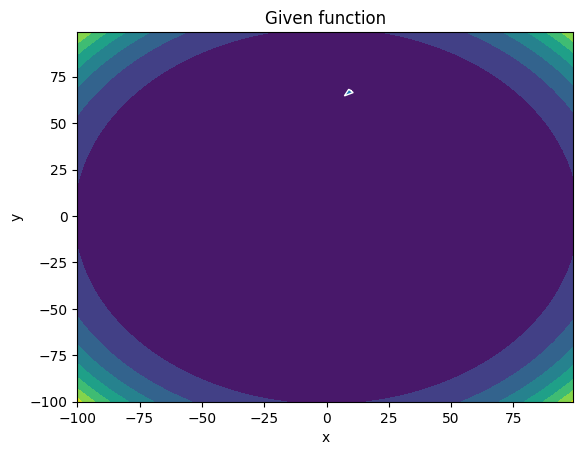

-------
Initial Coordinates:
[[ 9.80748986]
 [67.33505659]]
Final Coordinates:
[[ 9.70884214]
 [67.23539115]]
Gradient:
[[6.99418806e+09]
 [4.81047716e+10]]


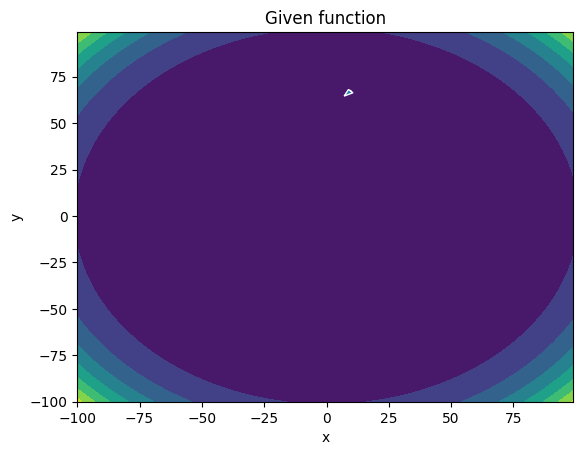

-------
Initial Coordinates:
[[ 9.70884214]
 [67.23539115]]
Final Coordinates:
[[ 9.61021019]
 [67.13572636]]
Gradient:
[[6.87787287e+09]
 [4.77158320e+10]]


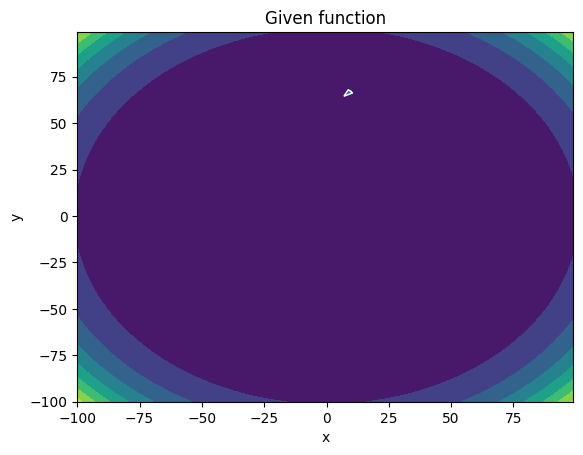

-------
Initial Coordinates:
[[ 9.61021019]
 [67.13572636]]
Final Coordinates:
[[ 9.51159438]
 [67.03606224]]
Gradient:
[[6.76276881e+09]
 [4.73297053e+10]]


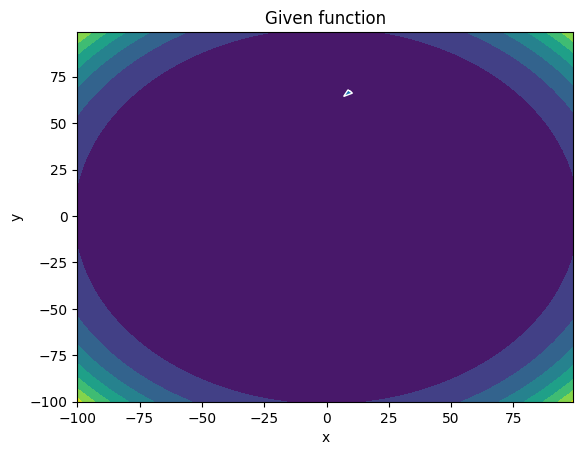

-------
Initial Coordinates:
[[ 9.51159438]
 [67.03606224]]
Final Coordinates:
[[ 9.41299507]
 [66.93639879]]
Gradient:
[[6.6488665e+09]
 [4.6946375e+10]]


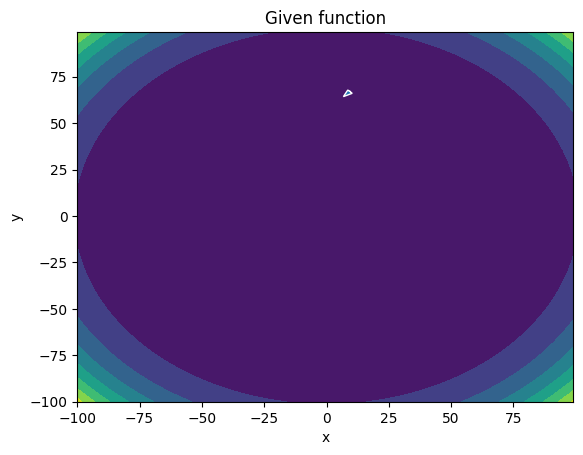

-------
Initial Coordinates:
[[ 9.41299507]
 [66.93639879]]
Final Coordinates:
[[ 9.31441266]
 [66.83673599]]
Gradient:
[[6.53615662e+09]
 [4.65658244e+10]]


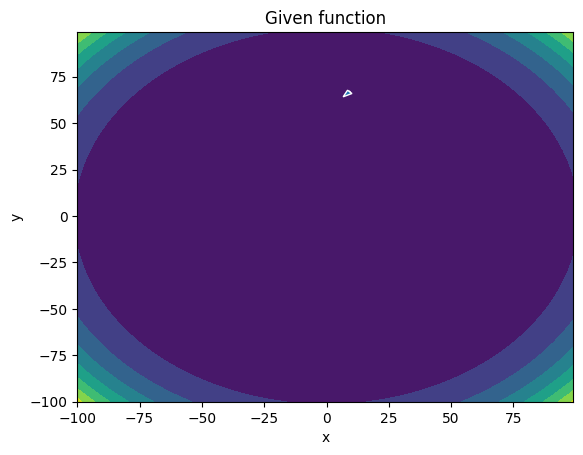

-------
Initial Coordinates:
[[ 9.31441266]
 [66.83673599]]
Final Coordinates:
[[ 9.21584752]
 [66.73707385]]
Gradient:
[[6.42462989e+09]
 [4.61880374e+10]]


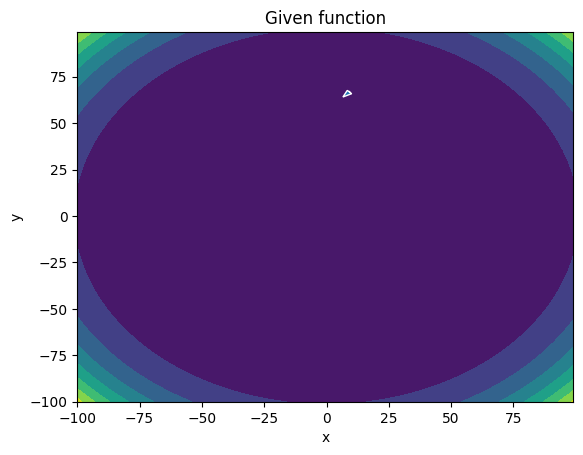

-------
Initial Coordinates:
[[ 9.21584752]
 [66.73707385]]
Final Coordinates:
[[ 9.11730008]
 [66.63741238]]
Gradient:
[[6.31427711e+09]
 [4.58129974e+10]]


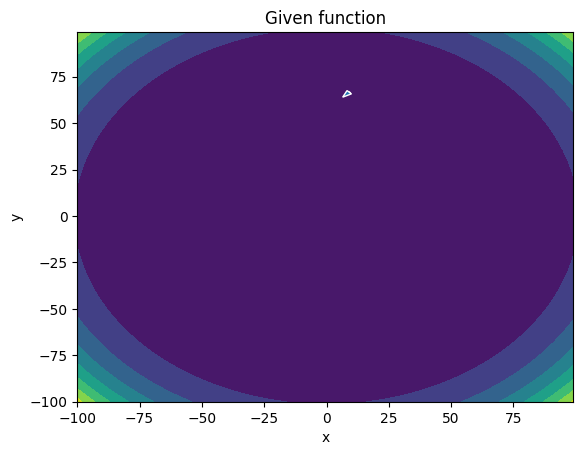

-------
Initial Coordinates:
[[ 9.11730008]
 [66.63741238]]
Final Coordinates:
[[ 9.01877075]
 [66.53775156]]
Gradient:
[[6.20508911e+09]
 [4.54406883e+10]]


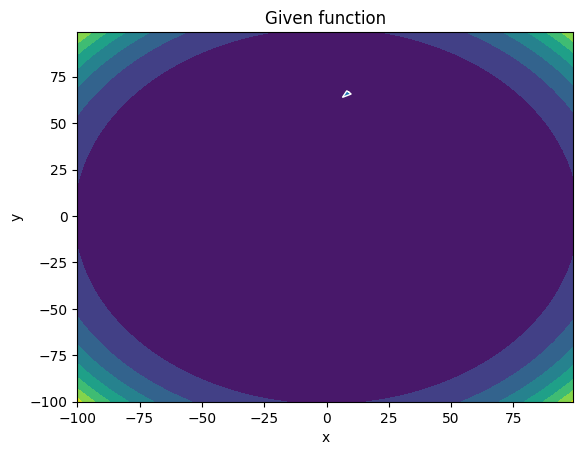

-------
Initial Coordinates:
[[ 9.01877075]
 [66.53775156]]
Final Coordinates:
[[ 8.92025997]
 [66.4380914 ]]
Gradient:
[[6.09705679e+09]
 [4.50710938e+10]]


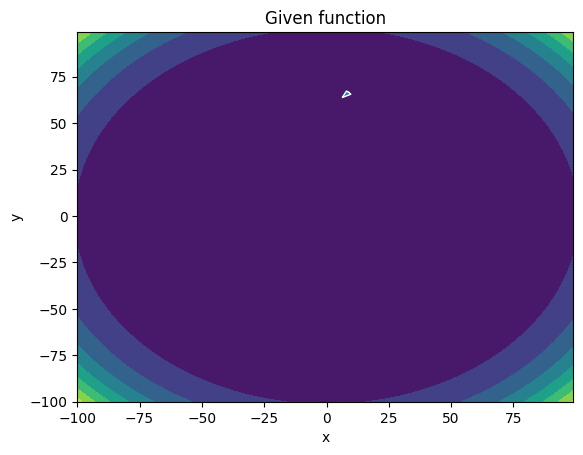

-------
Initial Coordinates:
[[ 8.92025997]
 [66.4380914 ]]
Final Coordinates:
[[ 8.82176819]
 [66.3384319 ]]
Gradient:
[[5.99017111e+09]
 [4.47041978e+10]]


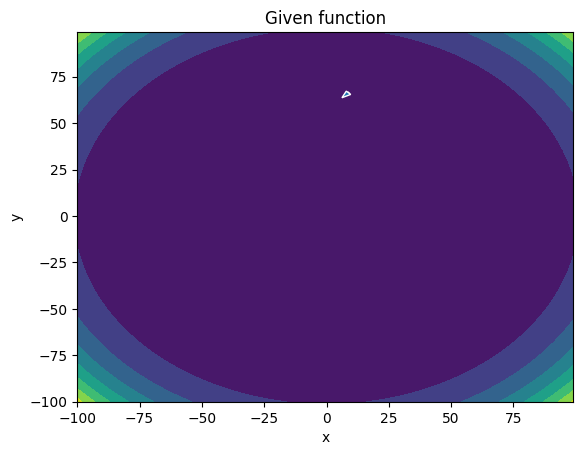

-------
Initial Coordinates:
[[ 8.82176819]
 [66.3384319 ]]
Final Coordinates:
[[ 8.7232959 ]
 [66.23877306]]
Gradient:
[[5.88442308e+09]
 [4.43399842e+10]]


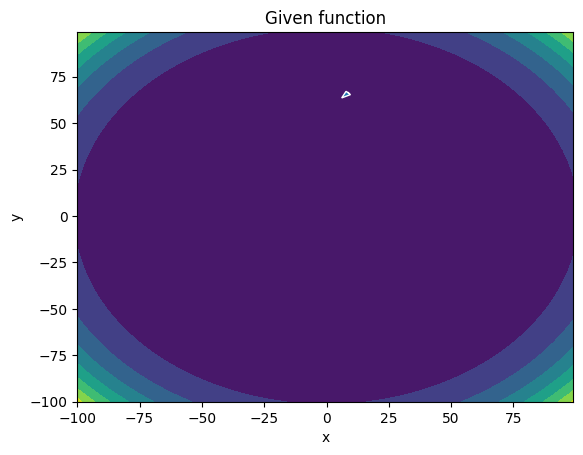

-------
Initial Coordinates:
[[ 8.7232959 ]
 [66.23877306]]
Final Coordinates:
[[ 8.62484356]
 [66.13911488]]
Gradient:
[[5.77980375e+09]
 [4.39784371e+10]]


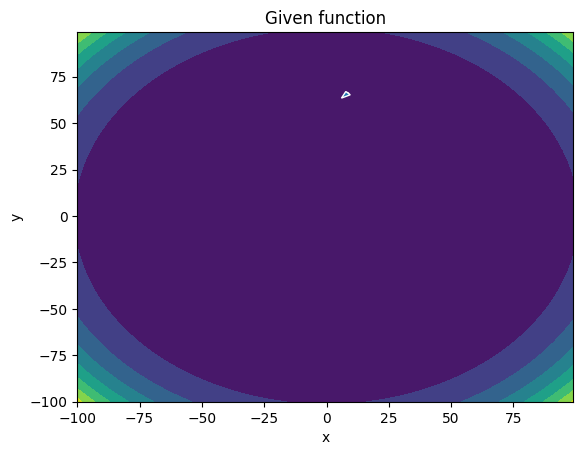

-------
Initial Coordinates:
[[ 8.62484356]
 [66.13911488]]
Final Coordinates:
[[ 8.52641168]
 [66.03945736]]
Gradient:
[[5.67630425e+09]
 [4.36195405e+10]]


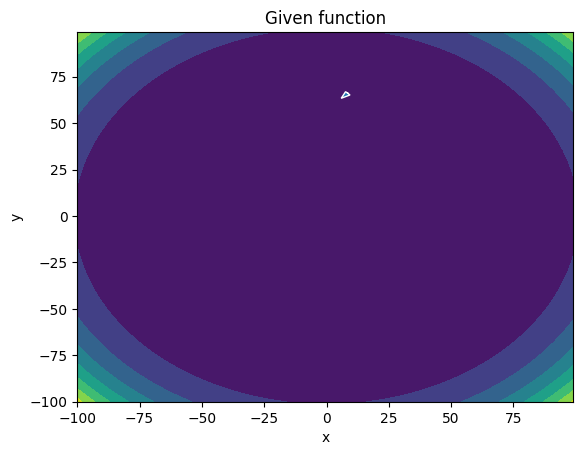

-------
Initial Coordinates:
[[ 8.52641168]
 [66.03945736]]
Final Coordinates:
[[ 8.4280008 ]
 [65.93980049]]
Gradient:
[[5.57391576e+09]
 [4.32632785e+10]]


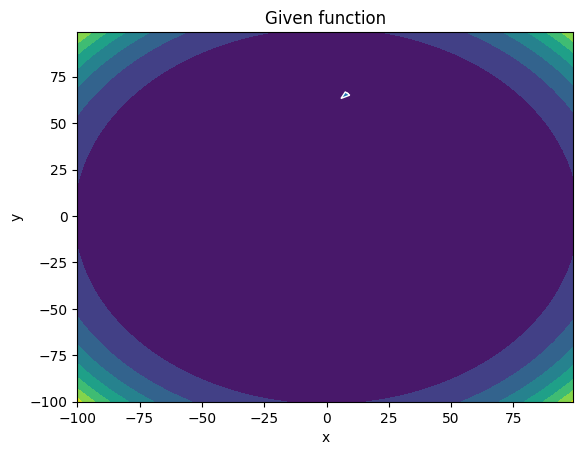

-------
Initial Coordinates:
[[ 8.4280008 ]
 [65.93980049]]
Final Coordinates:
[[ 8.32961144]
 [65.84014428]]
Gradient:
[[5.47262951e+09]
 [4.29096354e+10]]


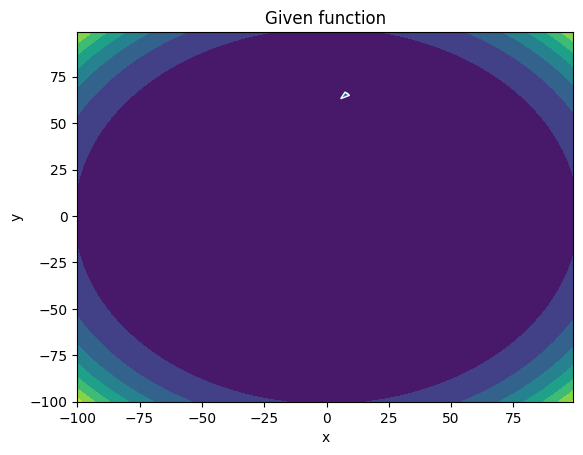

-------
Initial Coordinates:
[[ 8.32961144]
 [65.84014428]]
Final Coordinates:
[[ 8.23124417]
 [65.74048872]]
Gradient:
[[5.37243679e+09]
 [4.25585954e+10]]


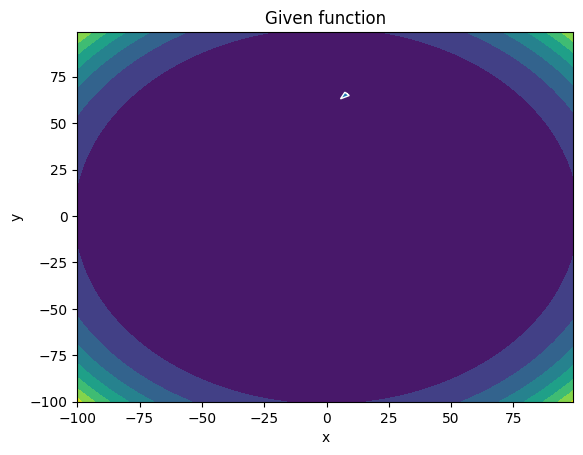

-------
Initial Coordinates:
[[ 8.23124417]
 [65.74048872]]
Final Coordinates:
[[ 8.13289958]
 [65.64083382]]
Gradient:
[[5.27332893e+09]
 [4.22101430e+10]]


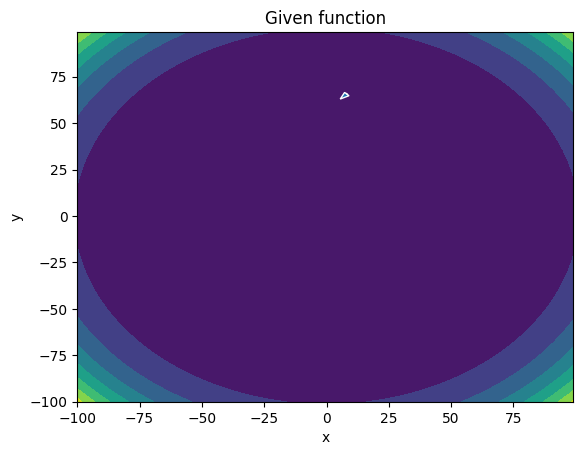

-------
Initial Coordinates:
[[ 8.13289958]
 [65.64083382]]
Final Coordinates:
[[ 8.03457826]
 [65.54117957]]
Gradient:
[[5.17529735e+09]
 [4.18642624e+10]]


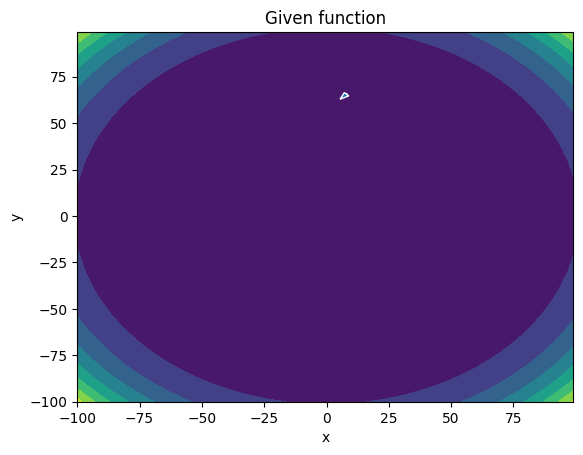

-------
Initial Coordinates:
[[ 8.03457826]
 [65.54117957]]
Final Coordinates:
[[ 7.93628086]
 [65.44152598]]
Gradient:
[[5.07833350e+09]
 [4.15209381e+10]]


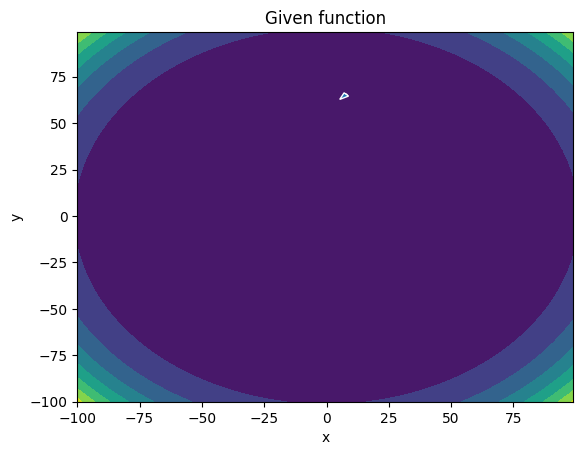

-------
Initial Coordinates:
[[ 7.93628086]
 [65.44152598]]
Final Coordinates:
[[ 7.83800802]
 [65.34187304]]
Gradient:
[[4.98242889e+09]
 [4.11801548e+10]]


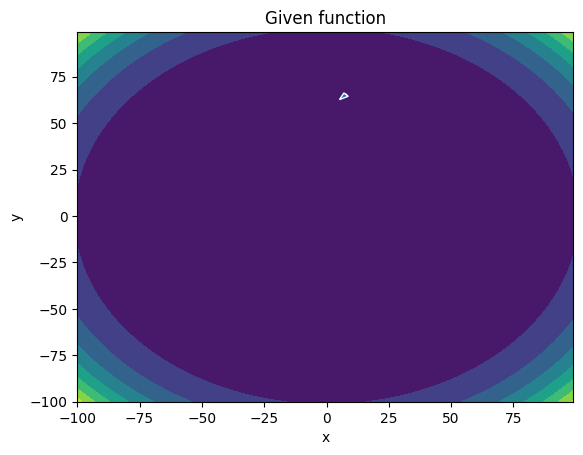

-------
Initial Coordinates:
[[ 7.83800802]
 [65.34187304]]
Final Coordinates:
[[ 7.73976042]
 [65.24222075]]
Gradient:
[[4.88757509e+09]
 [4.08418971e+10]]


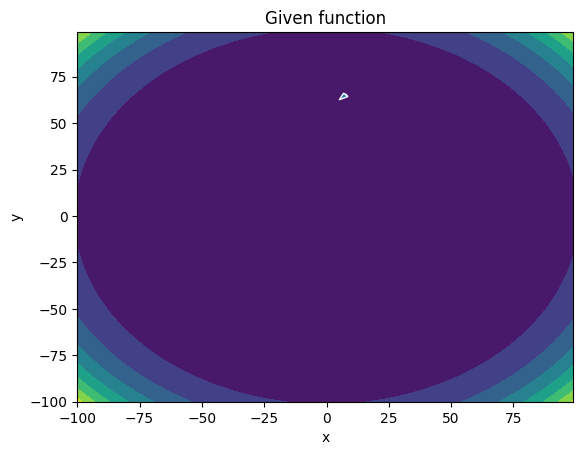

-------
Initial Coordinates:
[[ 7.73976042]
 [65.24222075]]
Final Coordinates:
[[ 7.64153878]
 [65.1425691 ]]
Gradient:
[[4.79376374e+09]
 [4.05061495e+10]]


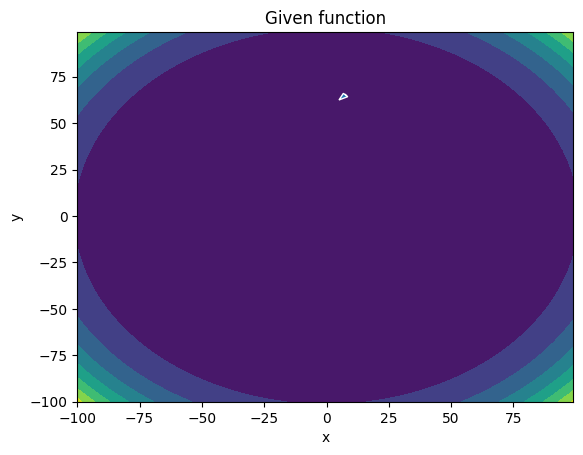

-------
Initial Coordinates:
[[ 7.64153878]
 [65.1425691 ]]
Final Coordinates:
[[ 7.54334381]
 [65.04291811]]
Gradient:
[[4.70098652e+09]
 [4.01728969e+10]]


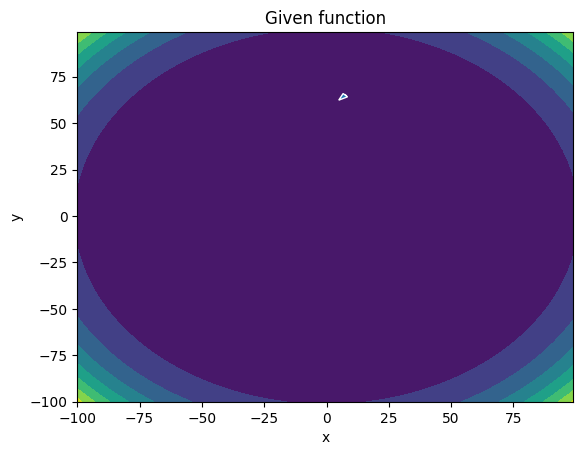

-------
Initial Coordinates:
[[ 7.54334381]
 [65.04291811]]
Final Coordinates:
[[ 7.4451763 ]
 [64.94326777]]
Gradient:
[[4.60923517e+09]
 [3.98421240e+10]]


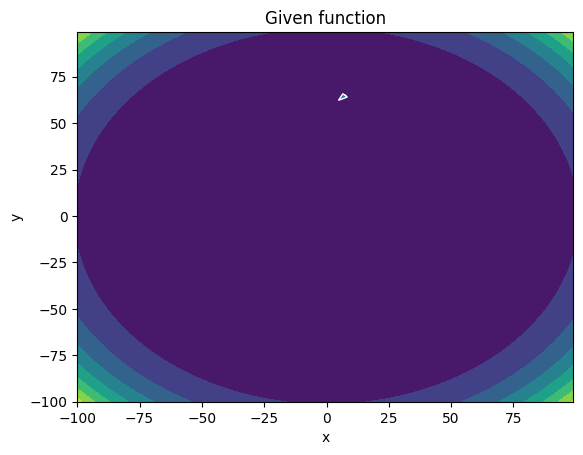

-------
Initial Coordinates:
[[ 7.4451763 ]
 [64.94326777]]
Final Coordinates:
[[ 7.34703704]
 [64.84361808]]
Gradient:
[[4.51850150e+09]
 [3.95138157e+10]]


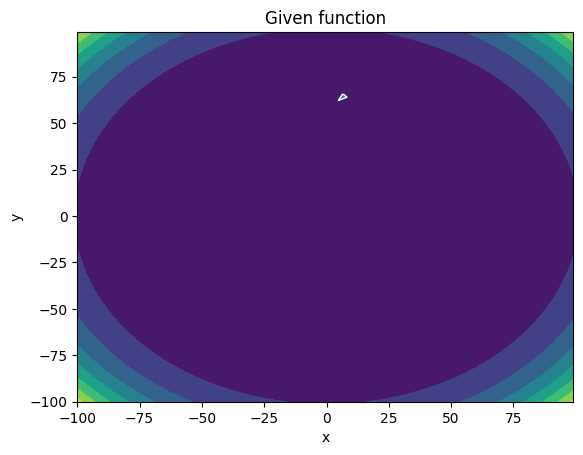

-------
Initial Coordinates:
[[ 7.34703704]
 [64.84361808]]
Final Coordinates:
[[ 7.24892686]
 [64.74396903]]
Gradient:
[[4.42877736e+09]
 [3.91879571e+10]]


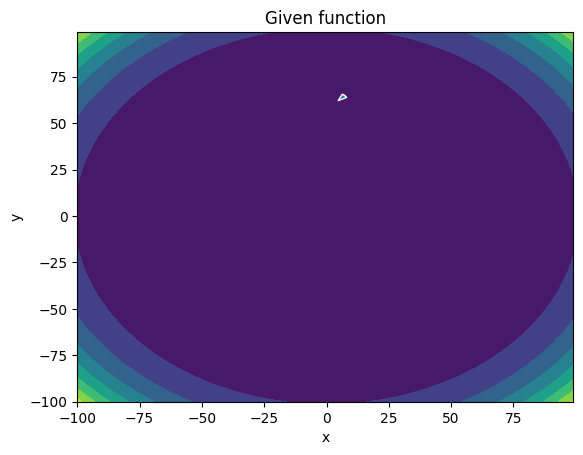

-------
Initial Coordinates:
[[ 7.24892686]
 [64.74396903]]
Final Coordinates:
[[ 7.15084662]
 [64.64432063]]
Gradient:
[[4.34005468e+09]
 [3.88645329e+10]]


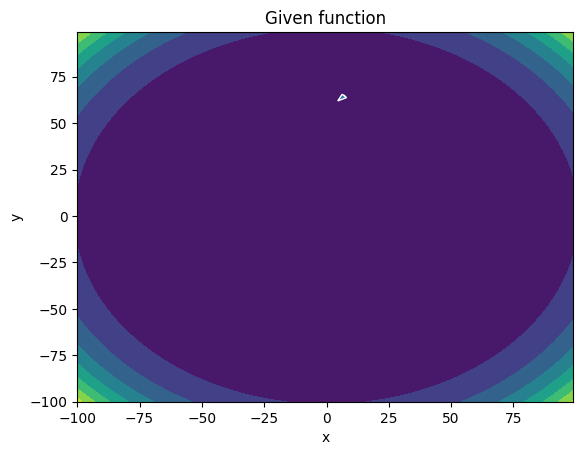

-------
Initial Coordinates:
[[ 7.15084662]
 [64.64432063]]
Final Coordinates:
[[ 7.05279723]
 [64.54467287]]
Gradient:
[[4.25232542e+09]
 [3.85435285e+10]]


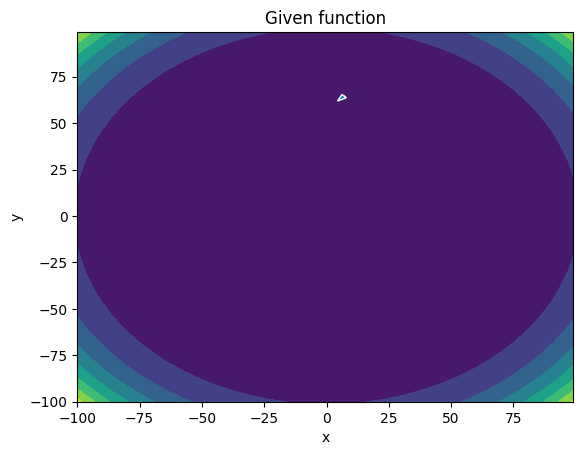

-------
Initial Coordinates:
[[ 7.05279723]
 [64.54467287]]
Final Coordinates:
[[ 6.95477963]
 [64.44502576]]
Gradient:
[[4.16558164e+09]
 [3.82249288e+10]]


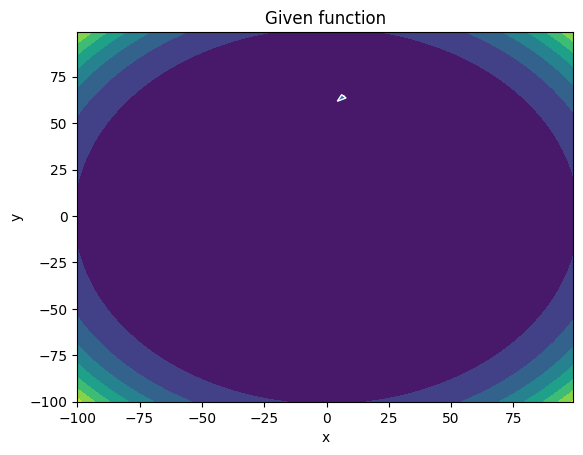

-------
Initial Coordinates:
[[ 6.95477963]
 [64.44502576]]
Final Coordinates:
[[ 6.8567948 ]
 [64.34537928]]
Gradient:
[[4.07981542e+09]
 [3.79087191e+10]]


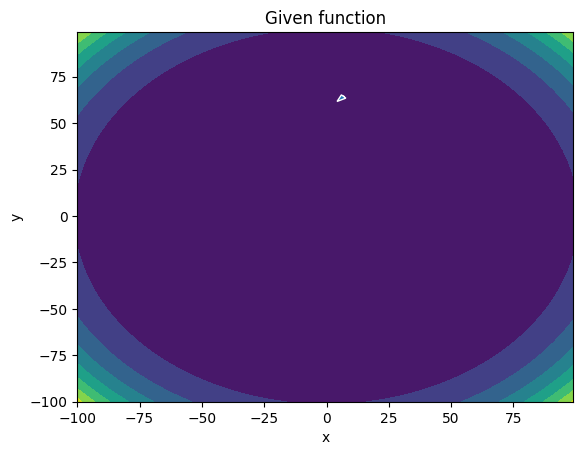

-------
Initial Coordinates:
[[ 6.8567948 ]
 [64.34537928]]
Final Coordinates:
[[ 6.75884377]
 [64.24573345]]
Gradient:
[[3.99501893e+09]
 [3.75948846e+10]]


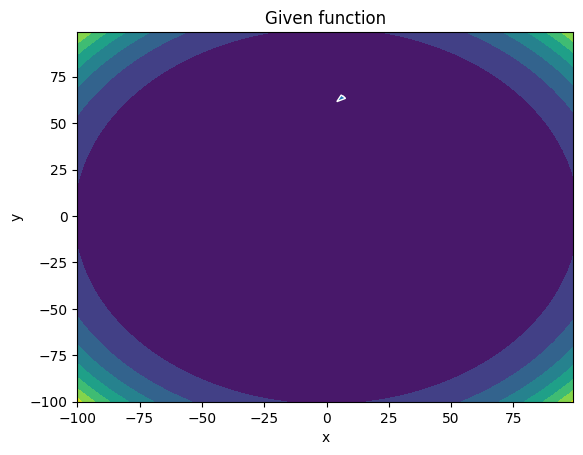

-------
Initial Coordinates:
[[ 6.75884377]
 [64.24573345]]
Final Coordinates:
[[ 6.66092761]
 [64.14608826]]
Gradient:
[[3.91118438e+09]
 [3.72834108e+10]]


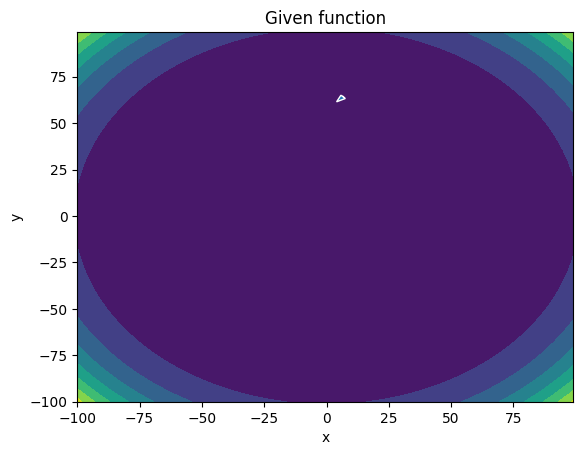

-------
Initial Coordinates:
[[ 6.66092761]
 [64.14608826]]
Final Coordinates:
[[ 6.56304745]
 [64.04644371]]
Gradient:
[[3.82830406e+09]
 [3.69742828e+10]]


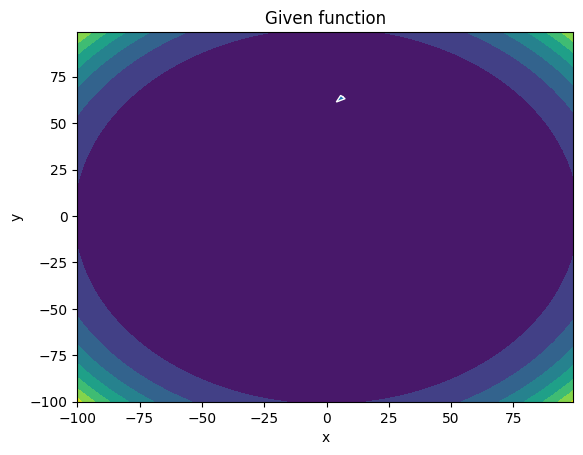

-------
Initial Coordinates:
[[ 6.56304745]
 [64.04644371]]
Final Coordinates:
[[ 6.46520445]
 [63.9467998 ]]
Gradient:
[[3.74637030e+09]
 [3.66674863e+10]]


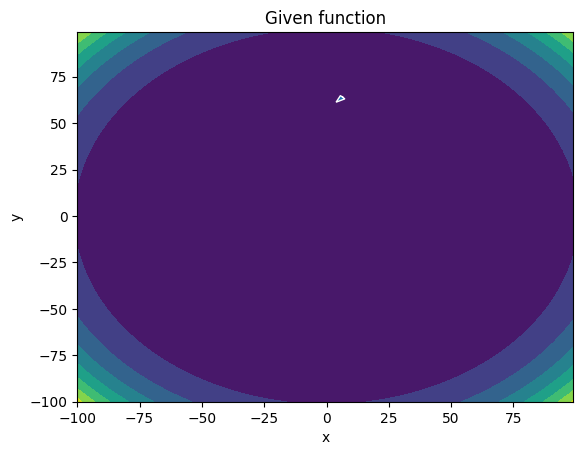

-------
Initial Coordinates:
[[ 6.46520445]
 [63.9467998 ]]
Final Coordinates:
[[ 6.36739985]
 [63.84715652]]
Gradient:
[[3.66537553e+09]
 [3.63630068e+10]]


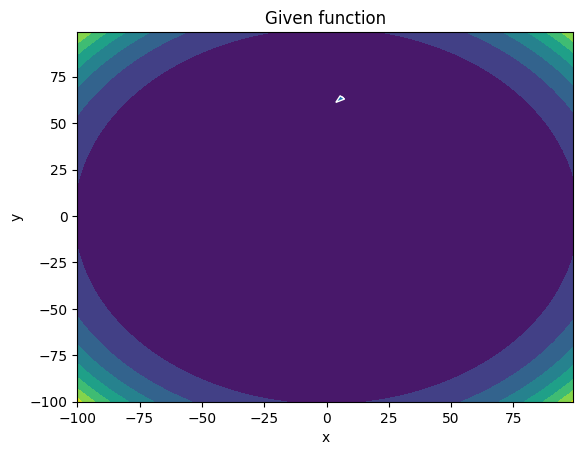

-------
Initial Coordinates:
[[ 6.36739985]
 [63.84715652]]
Final Coordinates:
[[ 6.26963493]
 [63.74751388]]
Gradient:
[[3.58531221e+09]
 [3.60608297e+10]]


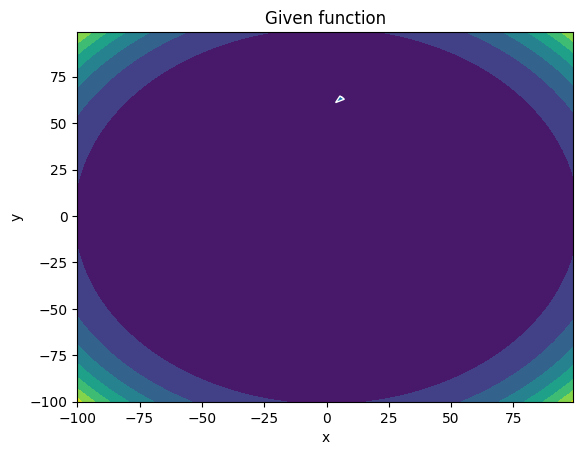

-------
Initial Coordinates:
[[ 6.26963493]
 [63.74751388]]
Final Coordinates:
[[ 6.17191104]
 [63.64787187]]
Gradient:
[[3.50617287e+09]
 [3.57609408e+10]]


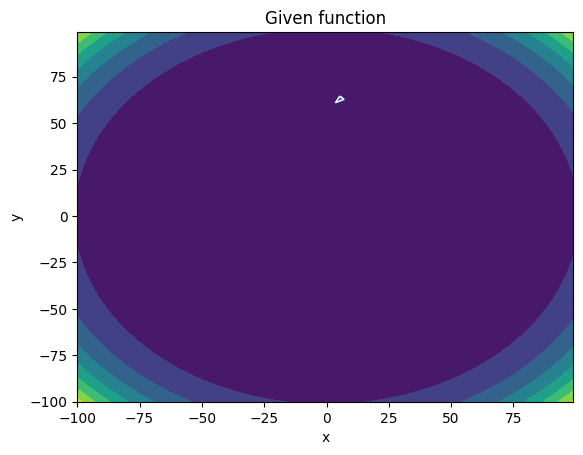

-------
Initial Coordinates:
[[ 6.17191104]
 [63.64787187]]
Final Coordinates:
[[ 6.07422958]
 [63.54823049]]
Gradient:
[[3.42795011e+09]
 [3.54633258e+10]]


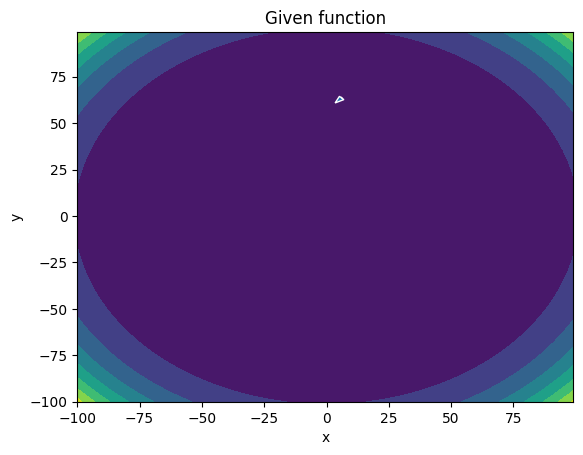

-------
Initial Coordinates:
[[ 6.07422958]
 [63.54823049]]
Final Coordinates:
[[ 5.97659205]
 [63.44858974]]
Gradient:
[[3.35063662e+09]
 [3.51679704e+10]]


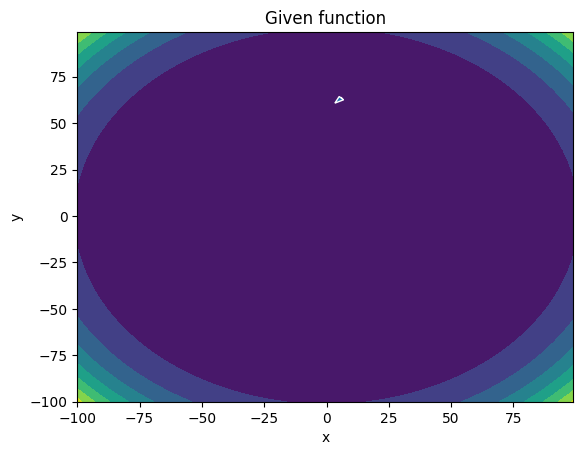

-------
Initial Coordinates:
[[ 5.97659205]
 [63.44858974]]
Final Coordinates:
[[ 5.87899999]
 [63.34894963]]
Gradient:
[[3.27422512e+09]
 [3.48748605e+10]]


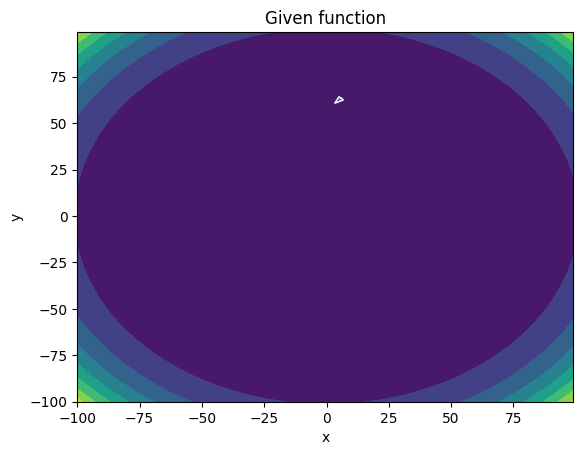

-------
Initial Coordinates:
[[ 5.87899999]
 [63.34894963]]
Final Coordinates:
[[ 5.78145503]
 [63.24931014]]
Gradient:
[[3.19870841e+09]
 [3.45839820e+10]]


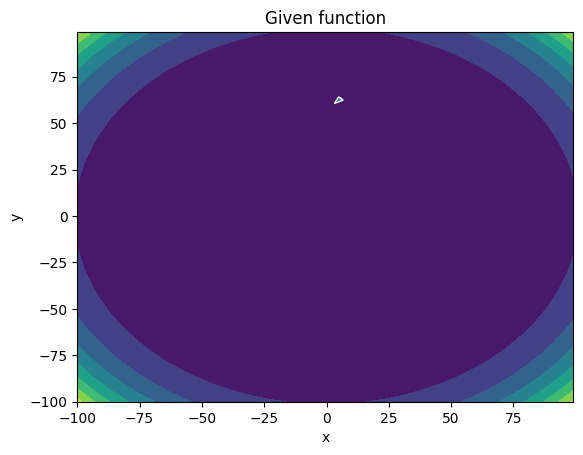

-------
Initial Coordinates:
[[ 5.78145503]
 [63.24931014]]
Final Coordinates:
[[ 5.6839589 ]
 [63.14967127]]
Gradient:
[[3.12407939e+09]
 [3.42953207e+10]]


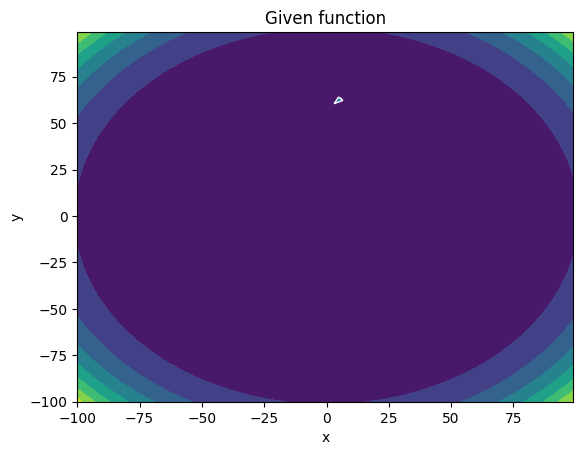

-------
Initial Coordinates:
[[ 5.6839589 ]
 [63.14967127]]
Final Coordinates:
[[ 5.58651339]
 [63.05003303]]
Gradient:
[[3.05033099e+09]
 [3.40088628e+10]]


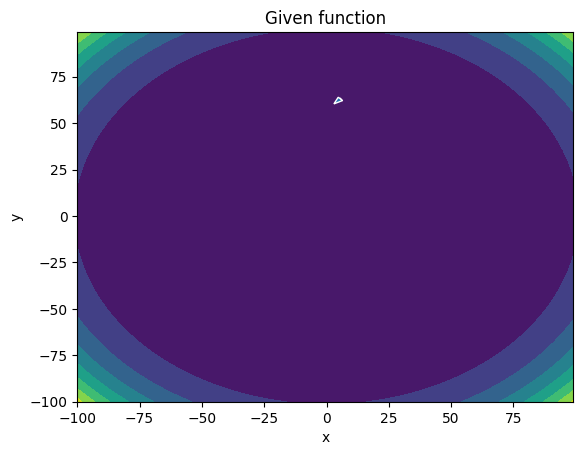

-------
Initial Coordinates:
[[ 5.58651339]
 [63.05003303]]
Final Coordinates:
[[ 5.48912041]
 [62.95039541]]
Gradient:
[[2.97745624e+09]
 [3.37245943e+10]]


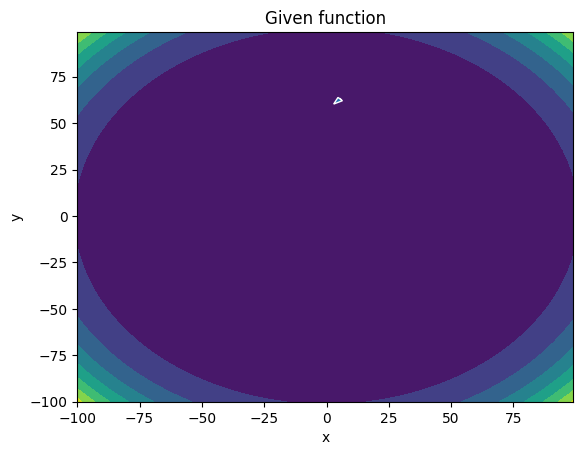

-------
Initial Coordinates:
[[ 5.48912041]
 [62.95039541]]
Final Coordinates:
[[ 5.39178196]
 [62.85075842]]
Gradient:
[[2.90544823e+09]
 [3.34425013e+10]]


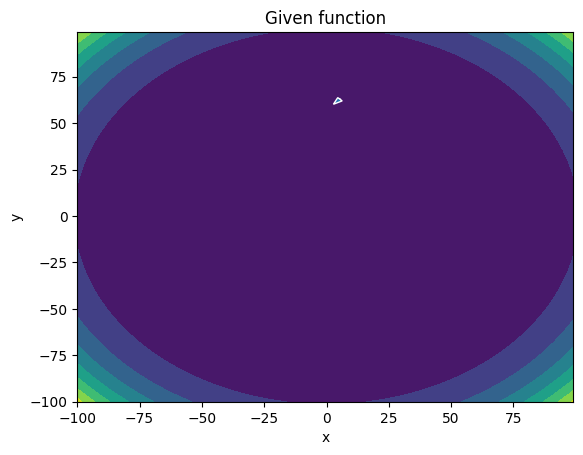

-------
Initial Coordinates:
[[ 5.39178196]
 [62.85075842]]
Final Coordinates:
[[ 5.29450013]
 [62.75112204]]
Gradient:
[[2.83430015e+09]
 [3.31625700e+10]]


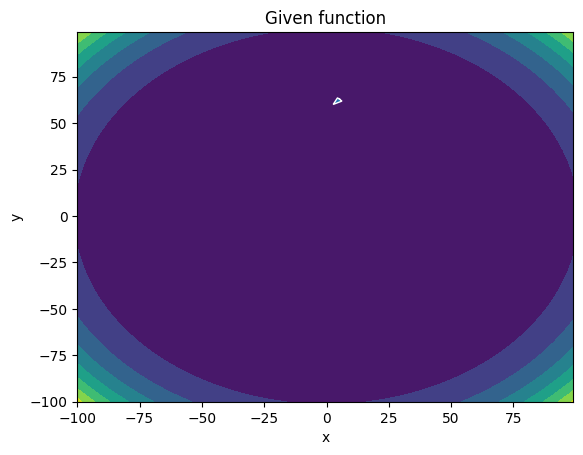

-------
Initial Coordinates:
[[ 5.29450013]
 [62.75112204]]
Final Coordinates:
[[ 5.19727716]
 [62.65148628]]
Gradient:
[[2.76400524e+09]
 [3.28847868e+10]]


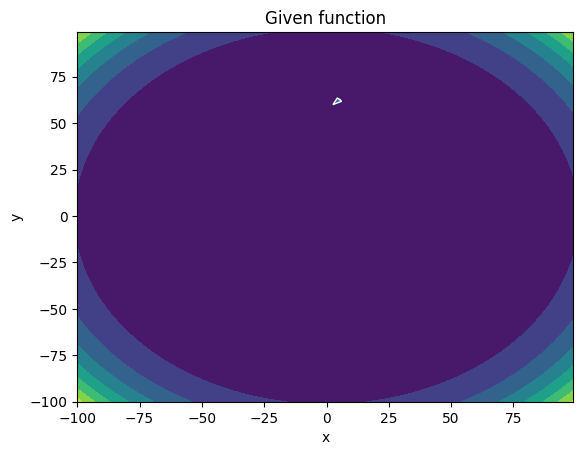

-------
Initial Coordinates:
[[ 5.19727716]
 [62.65148628]]
Final Coordinates:
[[ 5.10011538]
 [62.55185114]]
Gradient:
[[2.69455683e+09]
 [3.26091378e+10]]


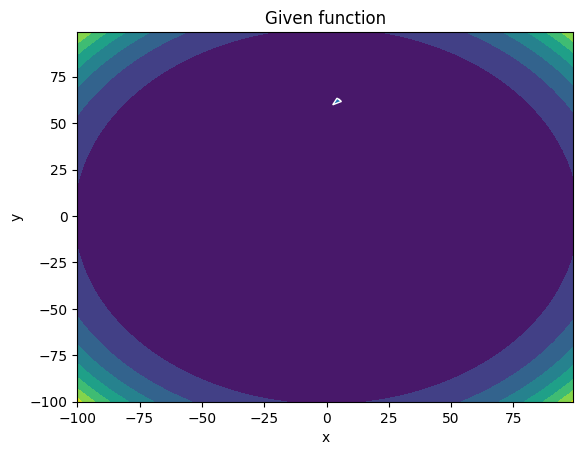

-------
Initial Coordinates:
[[ 5.10011538]
 [62.55185114]]
Final Coordinates:
[[ 5.00301728]
 [62.45221661]]
Gradient:
[[2.62594836e+09]
 [3.23356094e+10]]


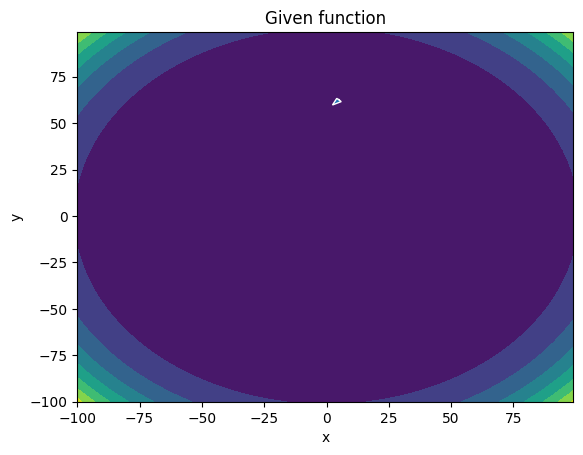

-------
Initial Coordinates:
[[ 5.00301728]
 [62.45221661]]
Final Coordinates:
[[ 4.90598546]
 [62.35258269]]
Gradient:
[[2.55817332e+09]
 [3.20641882e+10]]


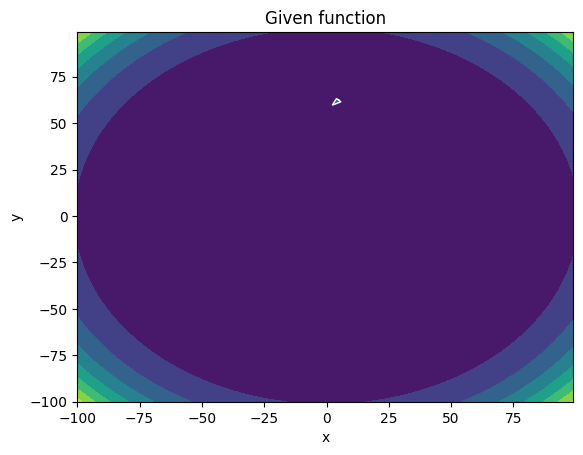

-------
Initial Coordinates:
[[ 4.90598546]
 [62.35258269]]
Final Coordinates:
[[ 4.8090227 ]
 [62.25294938]]
Gradient:
[[2.49122530e+09]
 [3.17948605e+10]]


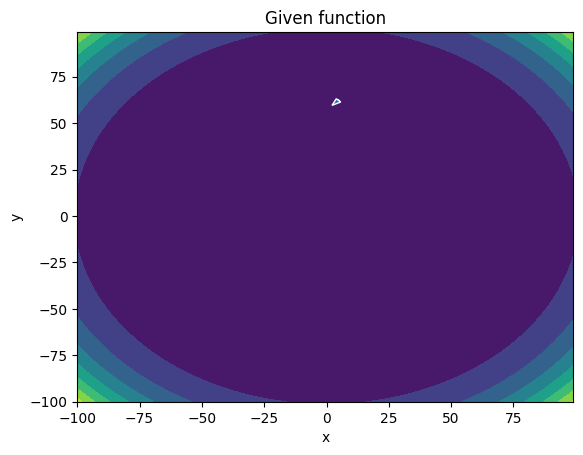

-------
Initial Coordinates:
[[ 4.8090227 ]
 [62.25294938]]
Final Coordinates:
[[ 4.71213192]
 [62.15331669]]
Gradient:
[[2.42509800e+09]
 [3.15276129e+10]]


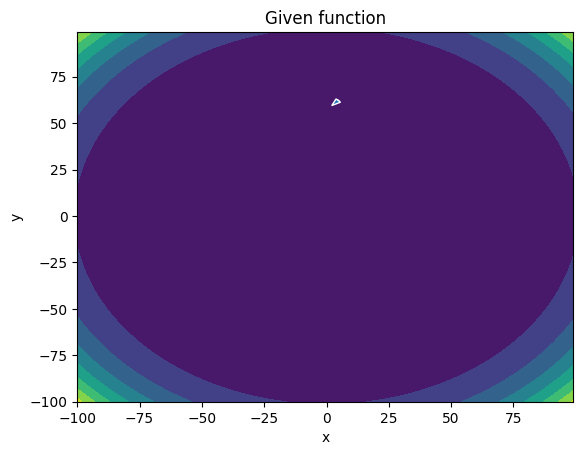

-------
Initial Coordinates:
[[ 4.71213192]
 [62.15331669]]
Final Coordinates:
[[ 4.61531623]
 [62.05368459]]
Gradient:
[[2.35978519e+09]
 [3.12624320e+10]]


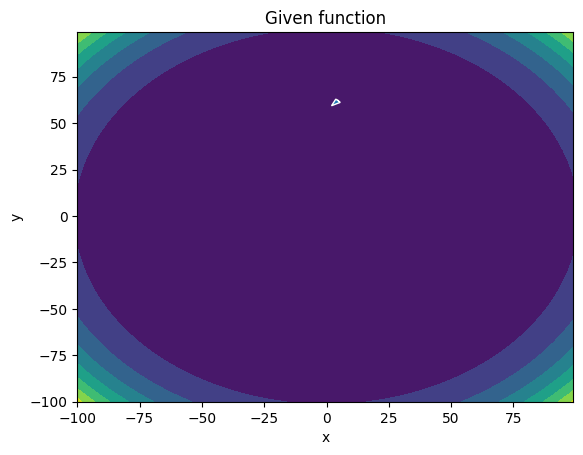

-------
Initial Coordinates:
[[ 4.61531623]
 [62.05368459]]
Final Coordinates:
[[ 4.51857891]
 [61.95405311]]
Gradient:
[[2.29528075e+09]
 [3.09993045e+10]]


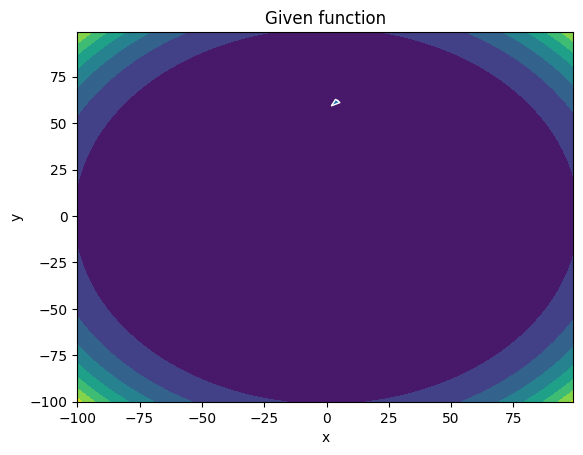

-------
Initial Coordinates:
[[ 4.51857891]
 [61.95405311]]
Final Coordinates:
[[ 4.42192347]
 [61.85442222]]
Gradient:
[[2.23157867e+09]
 [3.07382171e+10]]


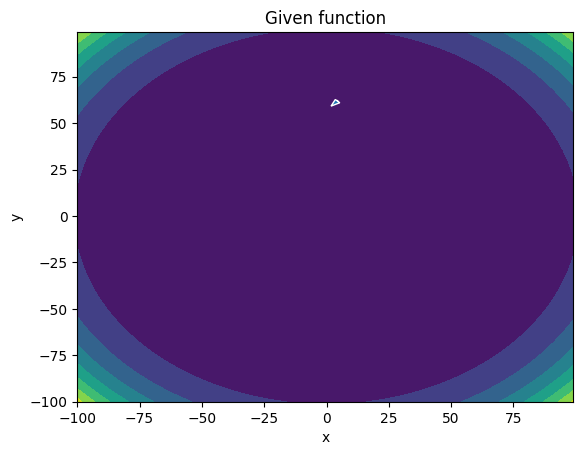

-------
Initial Coordinates:
[[ 4.42192347]
 [61.85442222]]
Final Coordinates:
[[ 4.32535361]
 [61.75479193]]
Gradient:
[[2.16867304e+09]
 [3.04791564e+10]]


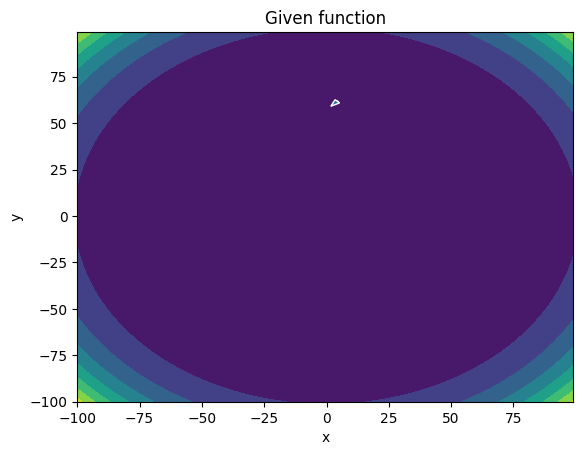

-------
Initial Coordinates:
[[ 4.32535361]
 [61.75479193]]
Final Coordinates:
[[ 4.22887328]
 [61.65516225]]
Gradient:
[[2.10655805e+09]
 [3.02221094e+10]]


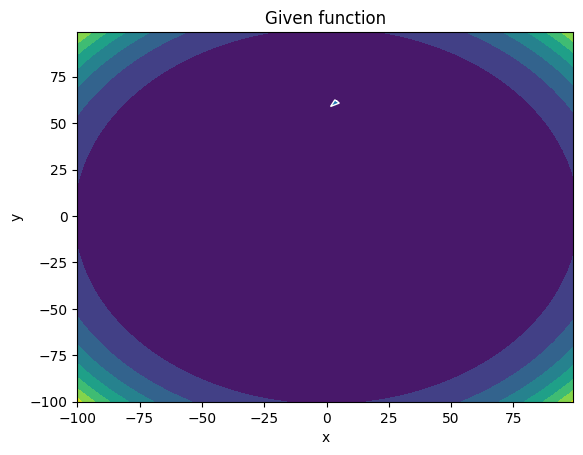

-------
Initial Coordinates:
[[ 4.22887328]
 [61.65516225]]
Final Coordinates:
[[ 4.13248666]
 [61.55553316]]
Gradient:
[[2.04522803e+09]
 [2.99670630e+10]]


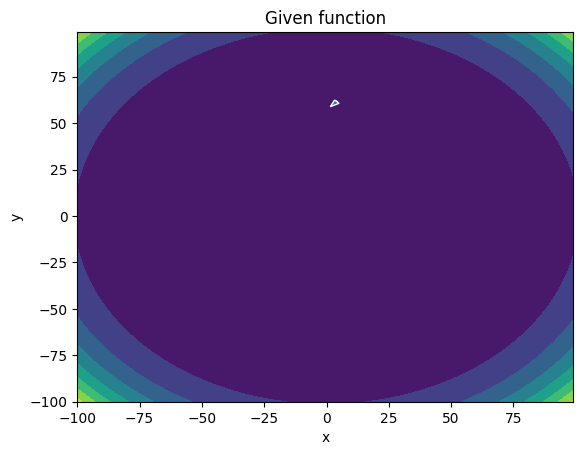

-------
Initial Coordinates:
[[ 4.13248666]
 [61.55553316]]
Final Coordinates:
[[ 4.03619824]
 [61.45590466]]
Gradient:
[[1.98467742e+09]
 [2.97140039e+10]]


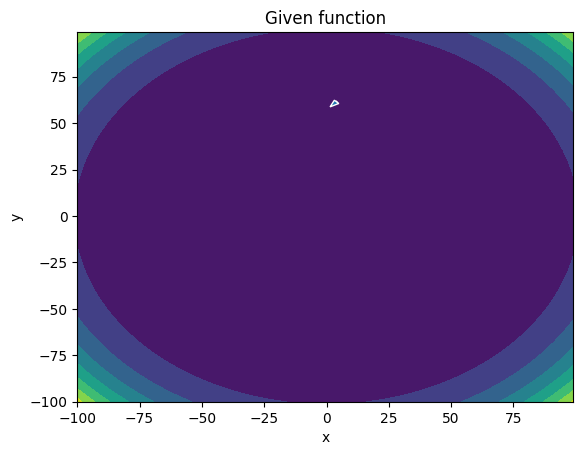

-------
Initial Coordinates:
[[ 4.03619824]
 [61.45590466]]
Final Coordinates:
[[ 3.94001278]
 [61.35627675]]
Gradient:
[[1.92490080e+09]
 [2.94629193e+10]]


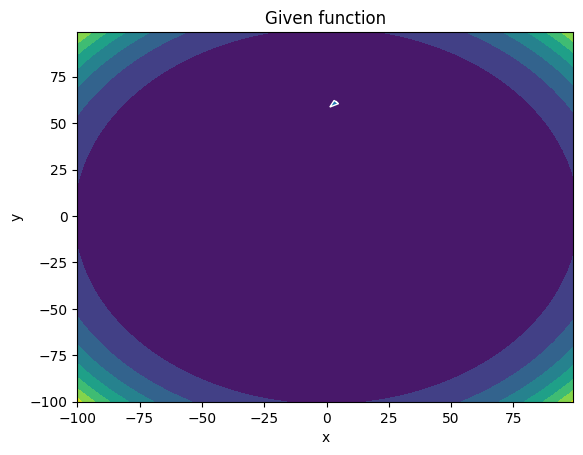

-------
Initial Coordinates:
[[ 3.94001278]
 [61.35627675]]
Final Coordinates:
[[ 3.84393536]
 [61.25664944]]
Gradient:
[[1.86589287e+09]
 [2.92137960e+10]]


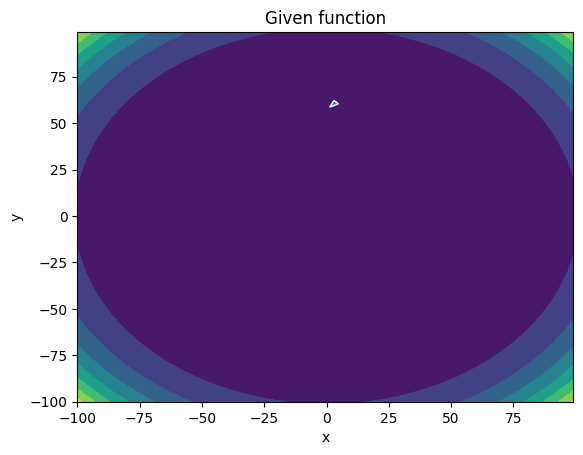

-------
Initial Coordinates:
[[ 3.84393536]
 [61.25664944]]
Final Coordinates:
[[ 3.74797143]
 [61.15702271]]
Gradient:
[[1.80764848e+09]
 [2.89666212e+10]]


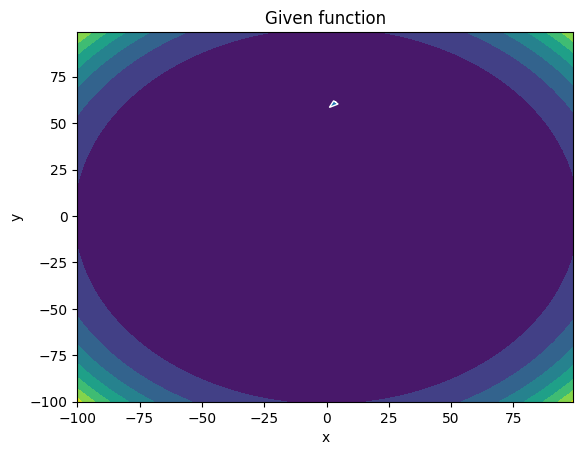

-------
Initial Coordinates:
[[ 3.74797143]
 [61.15702271]]
Final Coordinates:
[[ 3.6521268 ]
 [61.05739657]]
Gradient:
[[1.75016264e+09]
 [2.87213821e+10]]


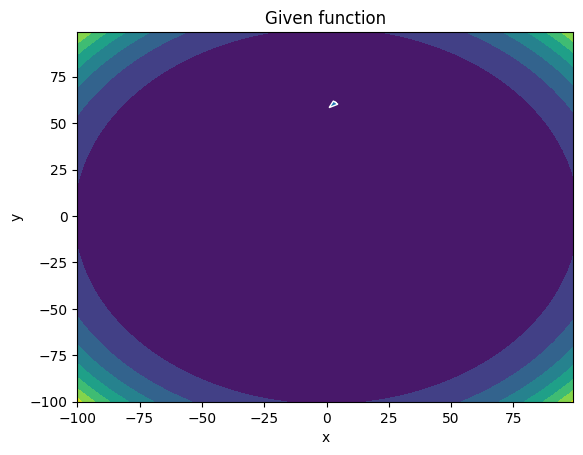

-------
Initial Coordinates:
[[ 3.6521268 ]
 [61.05739657]]
Final Coordinates:
[[ 3.5564077]
 [60.957771 ]]
Gradient:
[[1.69343052e+09]
 [2.84780656e+10]]


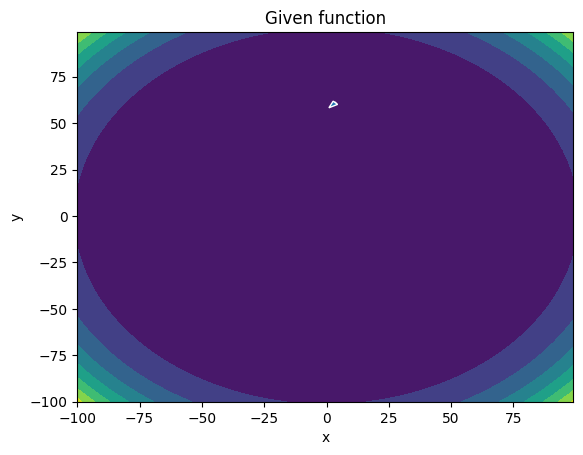

-------
Initial Coordinates:
[[ 3.5564077]
 [60.957771 ]]
Final Coordinates:
[[ 3.4608208 ]
 [60.85814602]]
Gradient:
[[1.63744745e+09]
 [2.82366592e+10]]


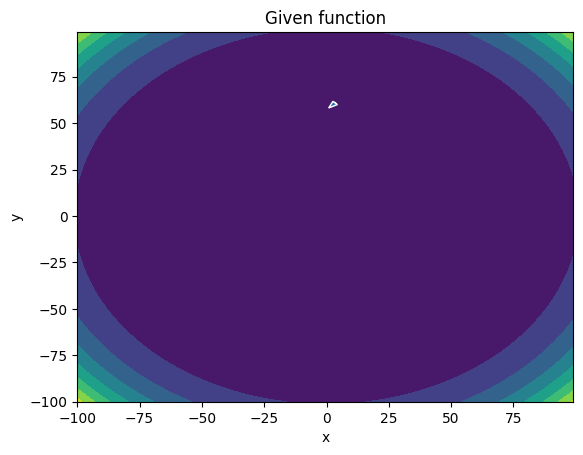

-------
Initial Coordinates:
[[ 3.4608208 ]
 [60.85814602]]
Final Coordinates:
[[ 3.36537327]
 [60.75852162]]
Gradient:
[[1.58220896e+09]
 [2.79971499e+10]]


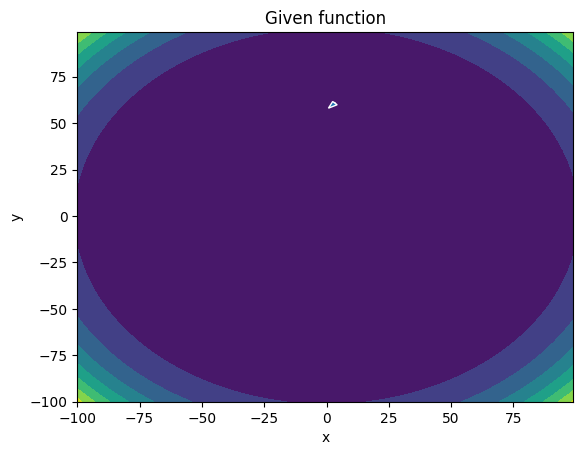

-------
Initial Coordinates:
[[ 3.36537327]
 [60.75852162]]
Final Coordinates:
[[ 3.2700728 ]
 [60.65889779]]
Gradient:
[[1.52771077e+09]
 [2.77595251e+10]]


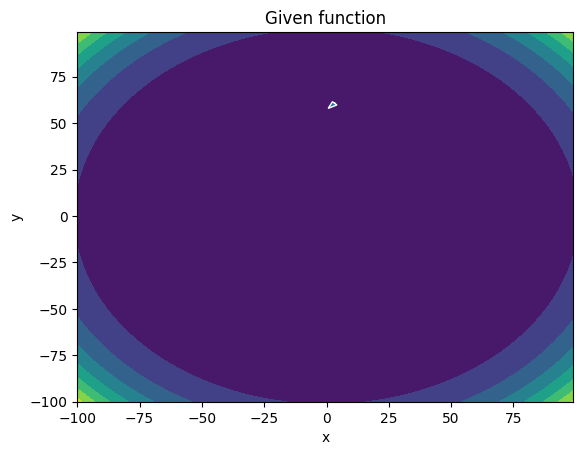

-------
Initial Coordinates:
[[ 3.2700728 ]
 [60.65889779]]
Final Coordinates:
[[ 3.17492768]
 [60.55927454]]
Gradient:
[[1.47394879e+09]
 [2.75237722e+10]]


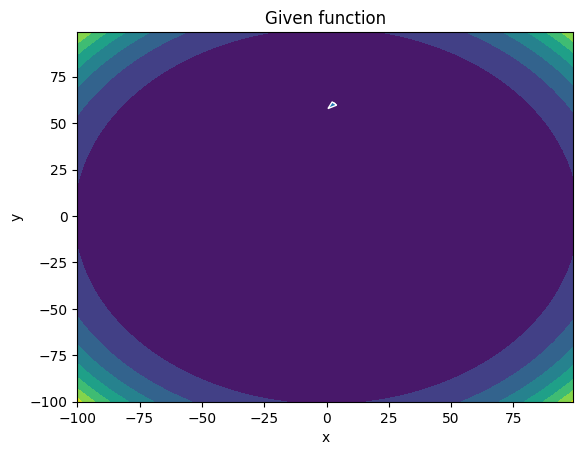

-------
Initial Coordinates:
[[ 3.17492768]
 [60.55927454]]
Final Coordinates:
[[ 3.07994682]
 [60.45965186]]
Gradient:
[[1.42091918e+09]
 [2.72898784e+10]]


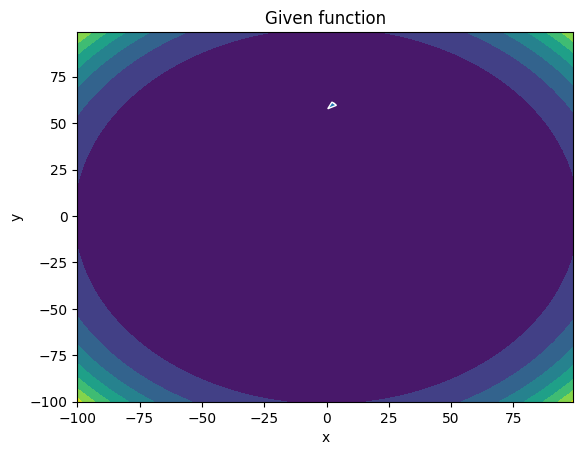

-------
Initial Coordinates:
[[ 3.07994682]
 [60.45965186]]
Final Coordinates:
[[ 2.98513986]
 [60.36002974]]
Gradient:
[[1.36861835e+09]
 [2.70578313e+10]]


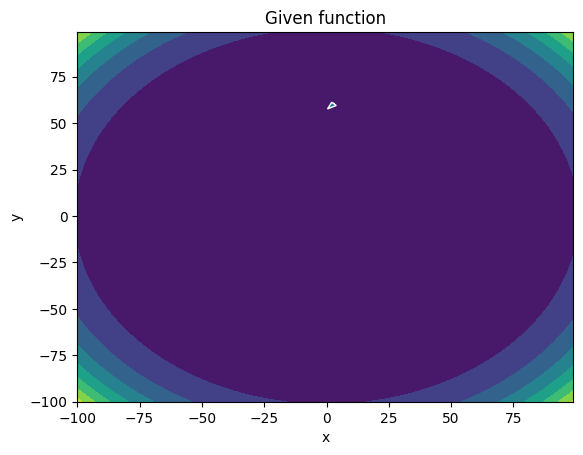

-------
Initial Coordinates:
[[ 2.98513986]
 [60.36002974]]
Final Coordinates:
[[ 2.89051718]
 [60.26040819]]
Gradient:
[[1.31704293e+09]
 [2.68276181e+10]]


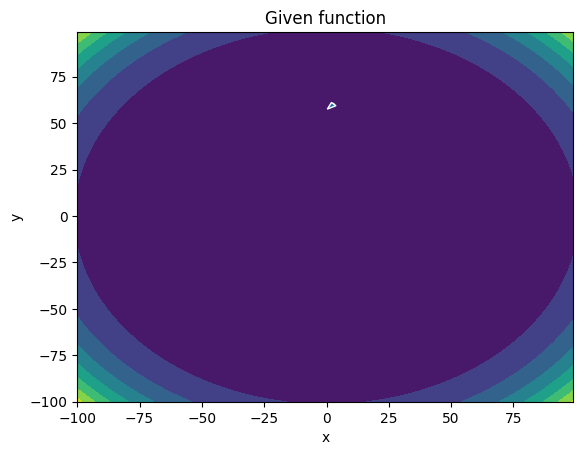

-------
Initial Coordinates:
[[ 2.89051718]
 [60.26040819]]
Final Coordinates:
[[ 2.79609003]
 [60.16078721]]
Gradient:
[[1.26618987e+09]
 [2.65992265e+10]]


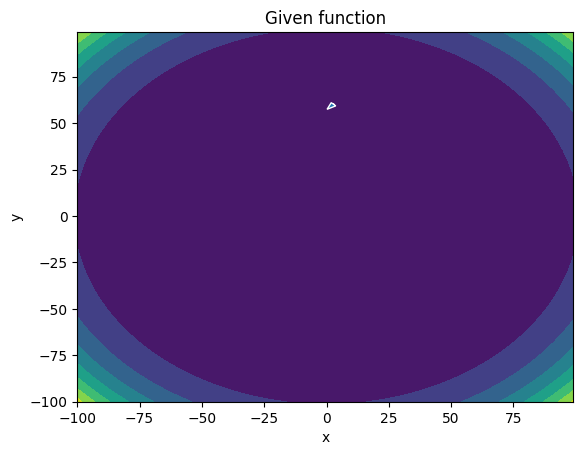

-------
Initial Coordinates:
[[ 2.79609003]
 [60.16078721]]
Final Coordinates:
[[ 2.70187056]
 [60.06116679]]
Gradient:
[[1.21605642e+09]
 [2.63726438e+10]]


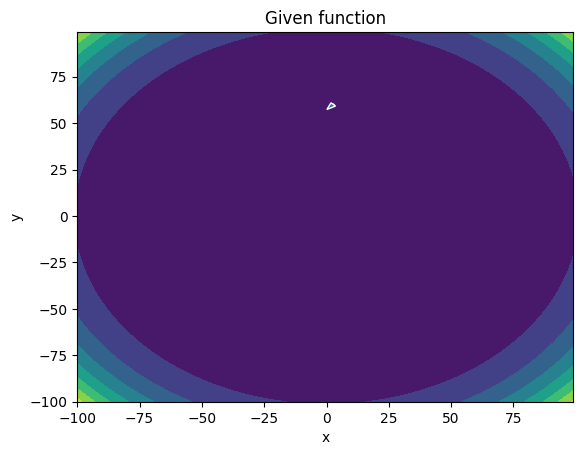

-------
Initial Coordinates:
[[ 2.70187056]
 [60.06116679]]
Final Coordinates:
[[ 2.607872  ]
 [59.96154692]]
Gradient:
[[1.16664015e+09]
 [2.61478576e+10]]


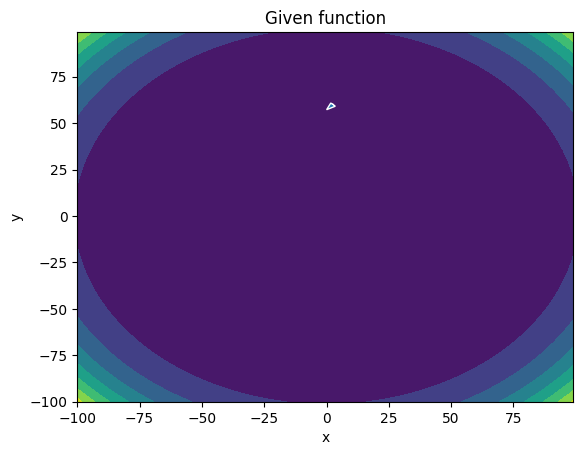

-------
Initial Coordinates:
[[ 2.607872  ]
 [59.96154692]]
Final Coordinates:
[[ 2.51410866]
 [59.86192761]]
Gradient:
[[1.11793900e+09]
 [2.59248555e+10]]


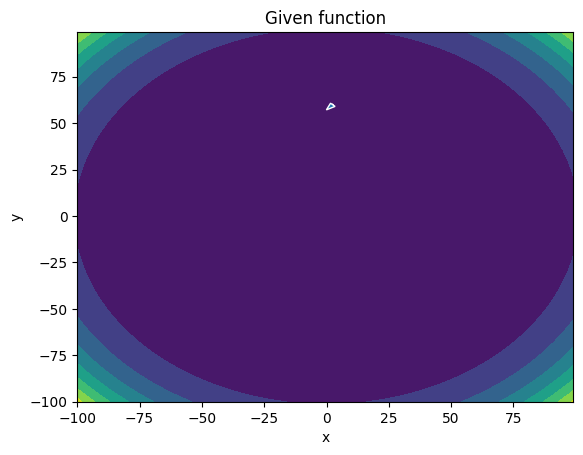

-------
Initial Coordinates:
[[ 2.51410866]
 [59.86192761]]
Final Coordinates:
[[ 2.42059614]
 [59.76230886]]
Gradient:
[[1.06995130e+09]
 [2.57036249e+10]]


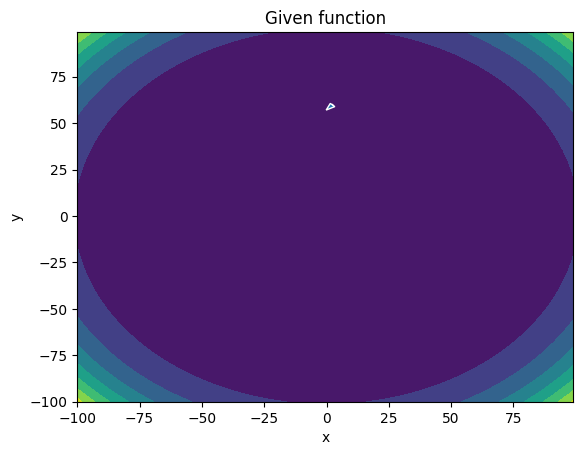

-------
Initial Coordinates:
[[ 2.42059614]
 [59.76230886]]
Final Coordinates:
[[ 2.32735143]
 [59.66269065]]
Gradient:
[[1.02267582e+09]
 [2.54841534e+10]]


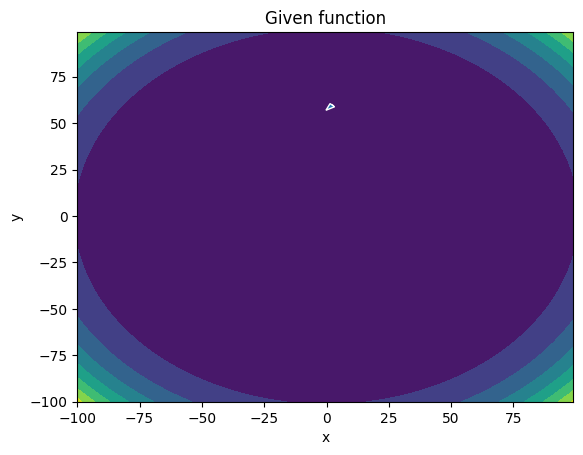

-------
Initial Coordinates:
[[ 2.32735143]
 [59.66269065]]
Final Coordinates:
[[ 2.23439306]
 [59.563073  ]]
Gradient:
[[9.76111804e+08]
 [2.52664287e+10]]


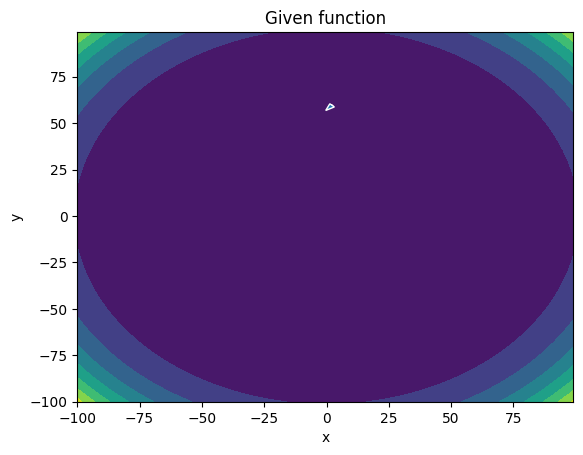

-------
Initial Coordinates:
[[ 2.23439306]
 [59.563073  ]]
Final Coordinates:
[[ 2.14174128]
 [59.46345589]]
Gradient:
[[9.30259007e+08]
 [2.50504382e+10]]


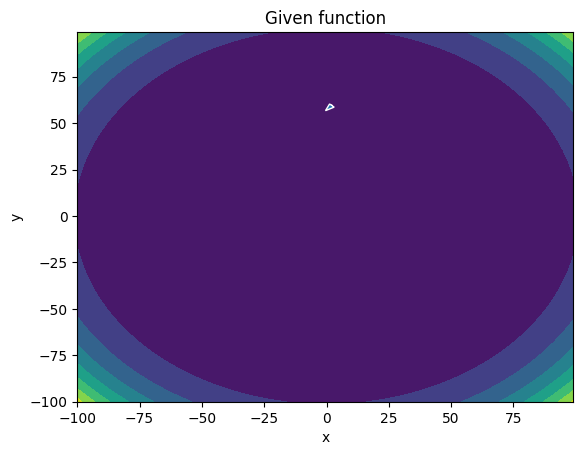

-------
Initial Coordinates:
[[ 2.14174128]
 [59.46345589]]
Final Coordinates:
[[ 2.04941826]
 [59.36383933]]
Gradient:
[[8.85117767e+08]
 [2.48361695e+10]]


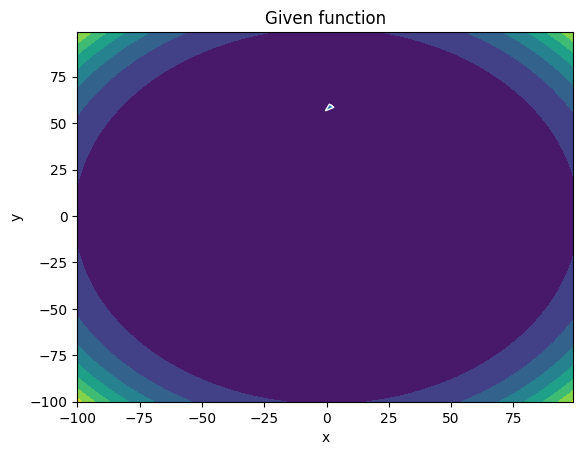

-------
Initial Coordinates:
[[ 2.04941826]
 [59.36383933]]
Final Coordinates:
[[ 1.95744829]
 [59.26422331]]
Gradient:
[[8.40689052e+08]
 [2.46236101e+10]]


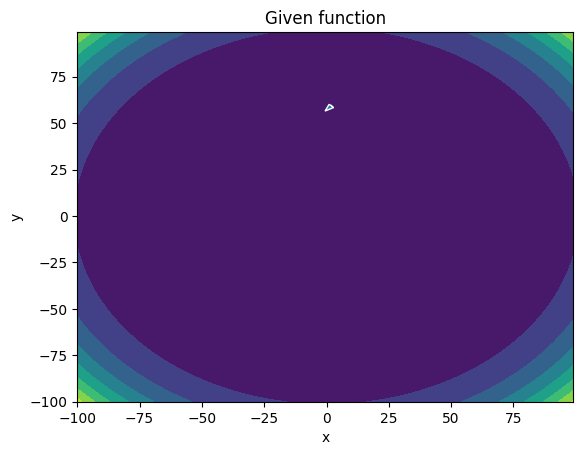

-------
Initial Coordinates:
[[ 1.95744829]
 [59.26422331]]
Final Coordinates:
[[ 1.86585805]
 [59.16460783]]
Gradient:
[[7.96974532e+08]
 [2.44127476e+10]]


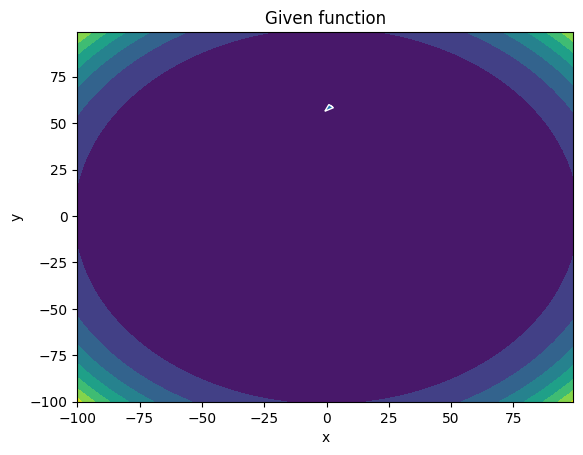

-------
Initial Coordinates:
[[ 1.86585805]
 [59.16460783]]
Final Coordinates:
[[ 1.77467688]
 [59.06499289]]
Gradient:
[[7.53976651e+08]
 [2.42035694e+10]]


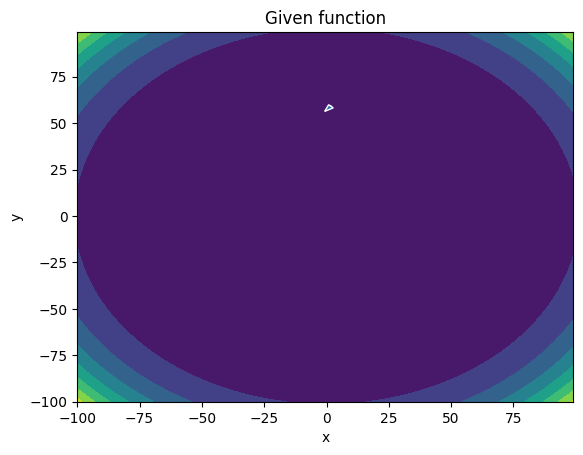

-------
Initial Coordinates:
[[ 1.77467688]
 [59.06499289]]
Final Coordinates:
[[ 1.68393713]
 [58.96537848]]
Gradient:
[[7.11698714e+08]
 [2.39960630e+10]]


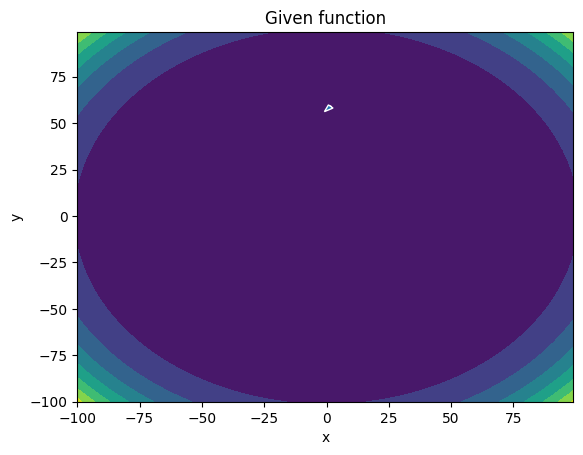

-------
Initial Coordinates:
[[ 1.68393713]
 [58.96537848]]
Final Coordinates:
[[ 1.59367445]
 [58.86576461]]
Gradient:
[[6.70144987e+08]
 [2.37902158e+10]]


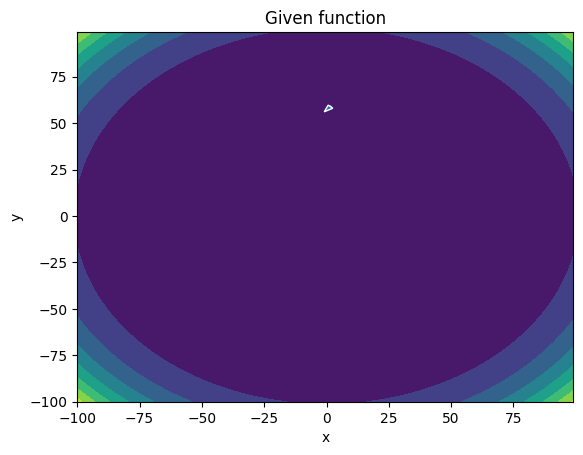

-------
Initial Coordinates:
[[ 1.59367445]
 [58.86576461]]
Final Coordinates:
[[ 1.5039283 ]
 [58.76615127]]
Gradient:
[[6.2932080e+08]
 [2.3586015e+10]]


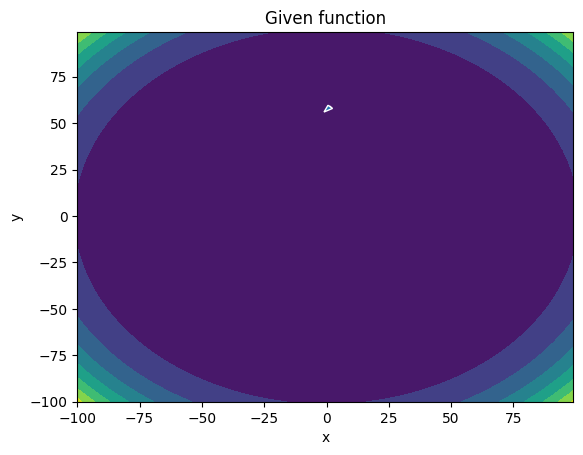

-------
Initial Coordinates:
[[ 1.5039283 ]
 [58.76615127]]
Final Coordinates:
[[ 1.41474233]
 [58.66653846]]
Gradient:
[[5.89232676e+08]
 [2.33834478e+10]]


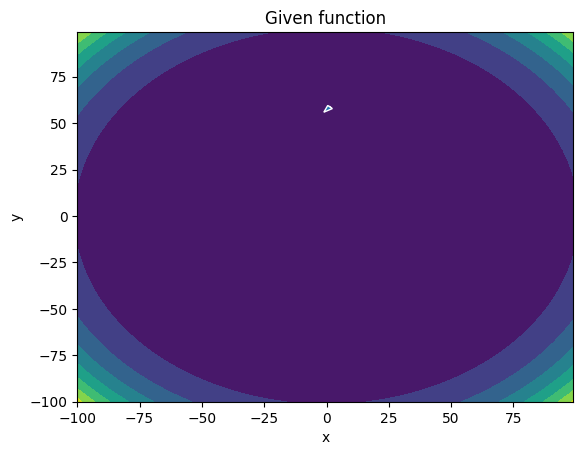

-------
Initial Coordinates:
[[ 1.41474233]
 [58.66653846]]
Final Coordinates:
[[ 1.32616495]
 [58.56692618]]
Gradient:
[[5.49888465e+08]
 [2.31825015e+10]]


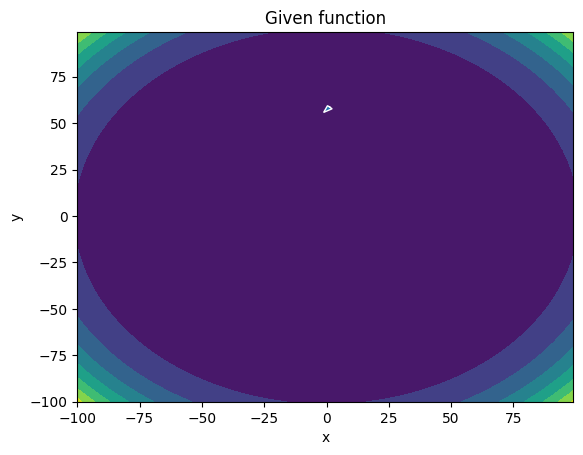

-------
Initial Coordinates:
[[ 1.32616495]
 [58.56692618]]
Final Coordinates:
[[ 1.23824994]
 [58.46731443]]
Gradient:
[[5.11297507e+08]
 [2.29831629e+10]]


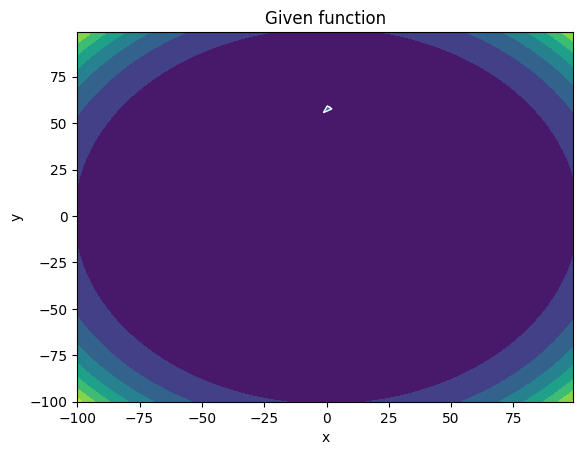

-------
Initial Coordinates:
[[ 1.23824994]
 [58.46731443]]
Final Coordinates:
[[ 1.15105711]
 [58.3677032 ]]
Gradient:
[[4.73470805e+08]
 [2.27854188e+10]]


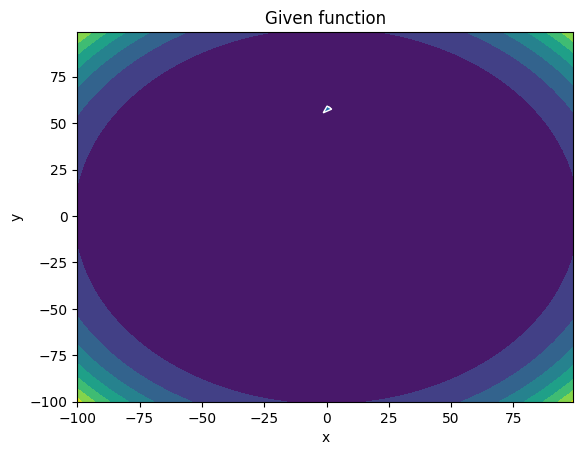

-------
Initial Coordinates:
[[ 1.15105711]
 [58.3677032 ]]
Final Coordinates:
[[ 1.06465305]
 [58.2680925 ]]
Gradient:
[[4.36421227e+08]
 [2.25892561e+10]]


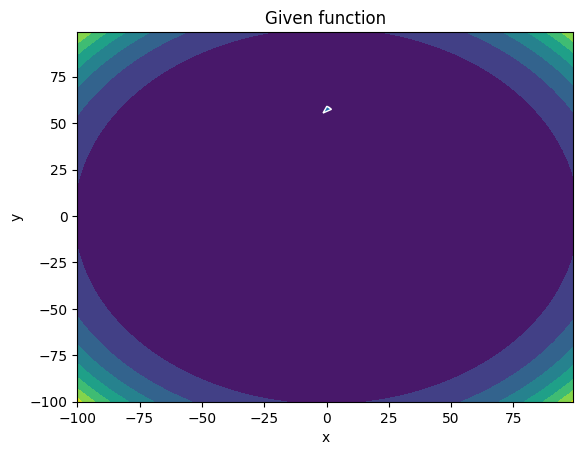

-------
Initial Coordinates:
[[ 1.06465305]
 [58.2680925 ]]
Final Coordinates:
[[ 0.97911202]
 [58.16848233]]
Gradient:
[[4.00163726e+08]
 [2.23946609e+10]]


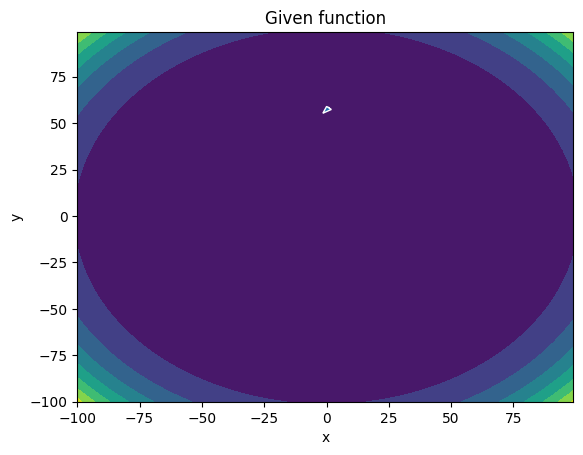

-------
Initial Coordinates:
[[ 0.97911202]
 [58.16848233]]
Final Coordinates:
[[ 0.89451692]
 [58.06887268]]
Gradient:
[[3.64715595e+08]
 [2.22016197e+10]]


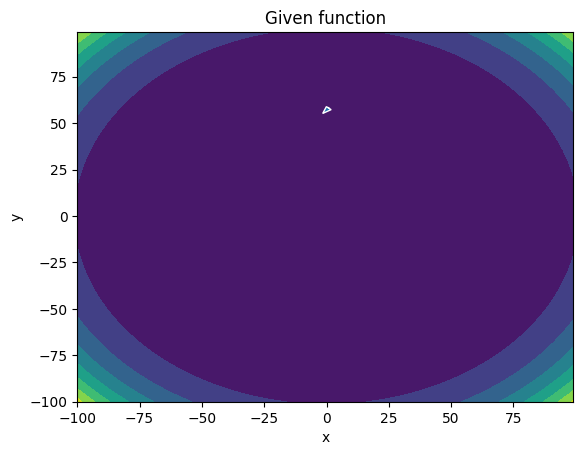

-------
Initial Coordinates:
[[ 0.89451692]
 [58.06887268]]
Final Coordinates:
[[ 0.81096032]
 [57.96926356]]
Gradient:
[[3.30096736e+08]
 [2.20101182e+10]]


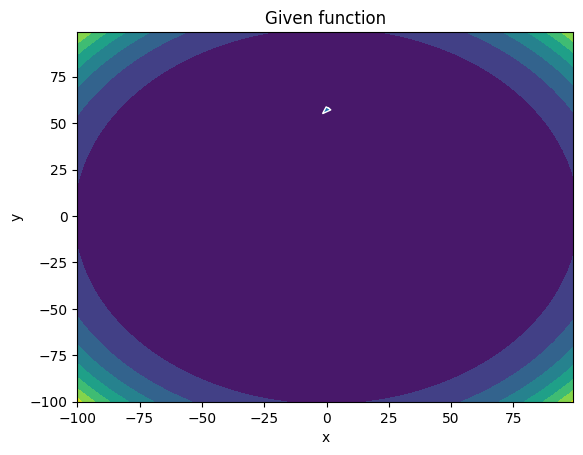

-------
Initial Coordinates:
[[ 0.81096032]
 [57.96926356]]
Final Coordinates:
[[ 0.72854568]
 [57.86965496]]
Gradient:
[[2.96329970e+08]
 [2.18201421e+10]]


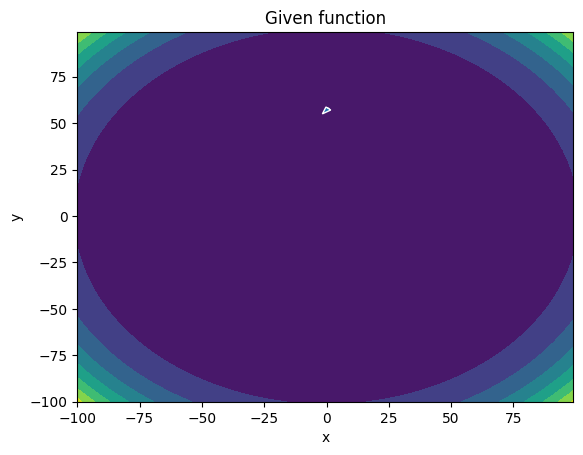

-------
Initial Coordinates:
[[ 0.72854568]
 [57.86965496]]
Final Coordinates:
[[ 0.64738862]
 [57.77004689]]
Gradient:
[[2.63441364e+08]
 [2.16316765e+10]]


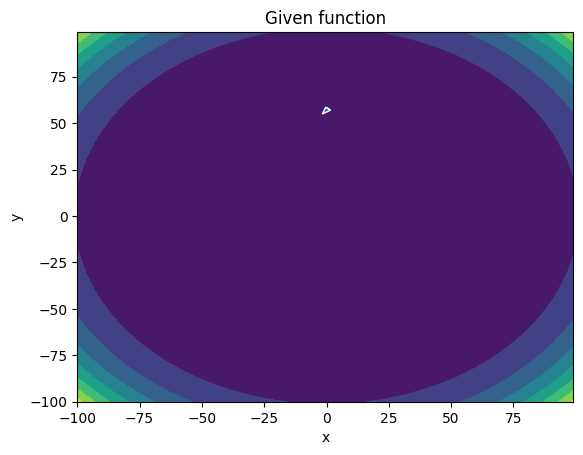

-------
Initial Coordinates:
[[ 0.64738862]
 [57.77004689]]
Final Coordinates:
[[ 0.56761833]
 [57.67043935]]
Gradient:
[[2.31460589e+08]
 [2.14447063e+10]]


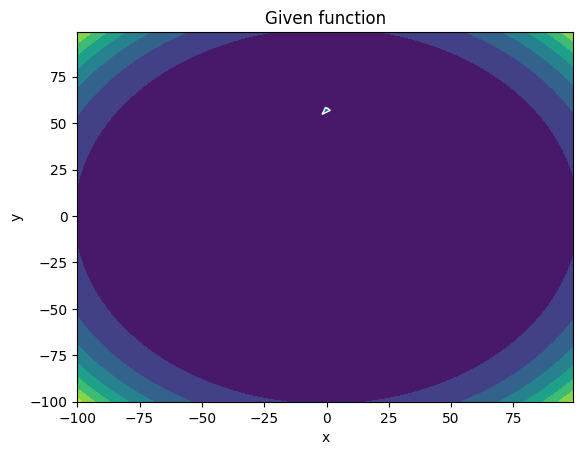

-------
Initial Coordinates:
[[ 0.56761833]
 [57.67043935]]
Final Coordinates:
[[ 0.48937899]
 [57.57083234]]
Gradient:
[[2.00421288e+08]
 [2.12592157e+10]]


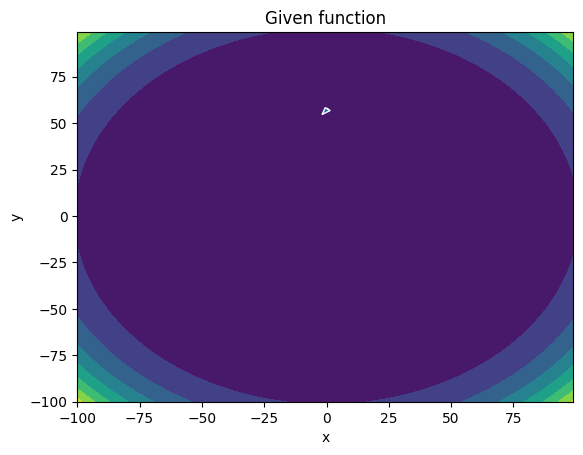

-------
Initial Coordinates:
[[ 0.48937899]
 [57.57083234]]
Final Coordinates:
[[ 0.41283127]
 [57.47122587]]
Gradient:
[[1.70361458e+08]
 [2.10751884e+10]]


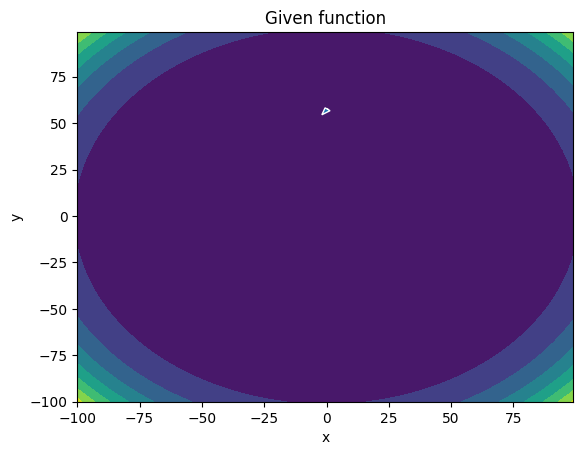

-------
Initial Coordinates:
[[ 0.41283127]
 [57.47122587]]
Final Coordinates:
[[ 0.33815379]
 [57.37161993]]
Gradient:
[[1.41323822e+08]
 [2.08926076e+10]]


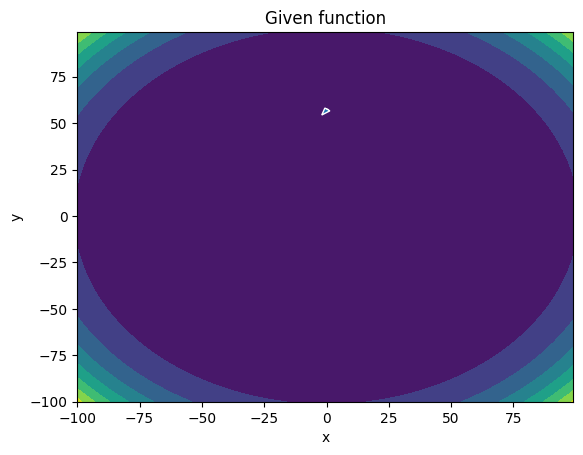

-------
Initial Coordinates:
[[ 0.33815379]
 [57.37161993]]
Final Coordinates:
[[ 0.2655444 ]
 [57.27201454]]
Gradient:
[[1.13356167e+08]
 [2.07114557e+10]]


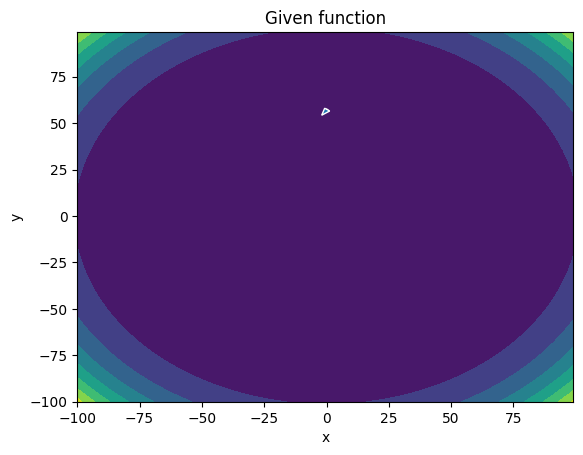

-------
Initial Coordinates:
[[ 0.2655444 ]
 [57.27201454]]
Final Coordinates:
[[ 0.19522125]
 [57.17240969]]
Gradient:
[[8.65116156e+07]
 [2.05317144e+10]]


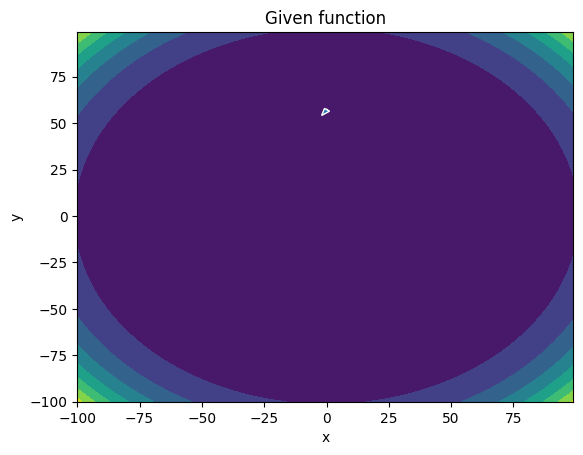

-------
Initial Coordinates:
[[ 0.19522125]
 [57.17240969]]
Final Coordinates:
[[ 0.12742338]
 [57.07280541]]
Gradient:
[[6.08487854e+07]
 [2.03533646e+10]]


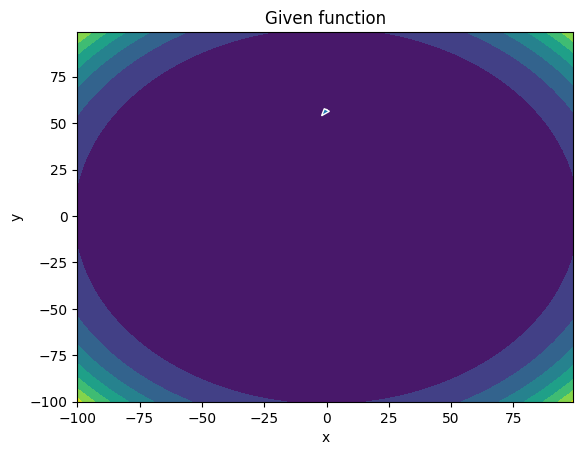

-------
Initial Coordinates:
[[ 0.12742338]
 [57.07280541]]
Final Coordinates:
[[ 0.06241059]
 [56.97320168]]
Gradient:
[[3.64317784e+07]
 [2.01763863e+10]]


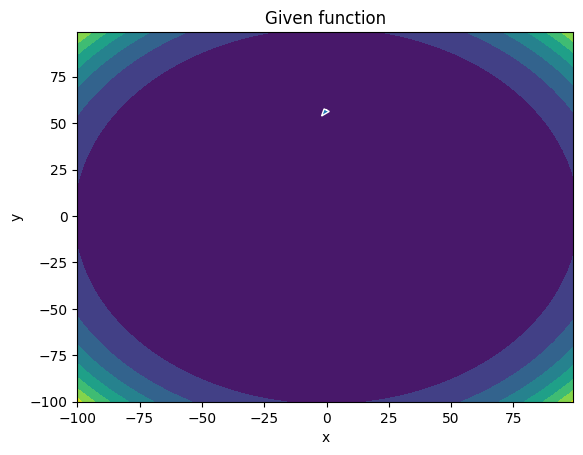

-------
Initial Coordinates:
[[ 0.06241059]
 [56.97320168]]
Final Coordinates:
[[4.62413625e-04]
 [5.68735985e+01]]
Gradient:
[[1.33299217e+07]
 [2.00007587e+10]]


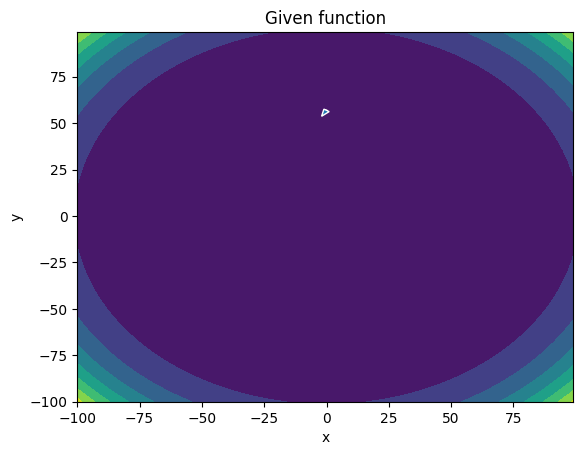

-------
Initial Coordinates:
[[4.62413625e-04]
 [5.68735985e+01]]
Final Coordinates:
[[-0.05812423]
 [56.77399598]]
Gradient:
[[-8.38282212e+06]
 [ 1.98264603e+10]]


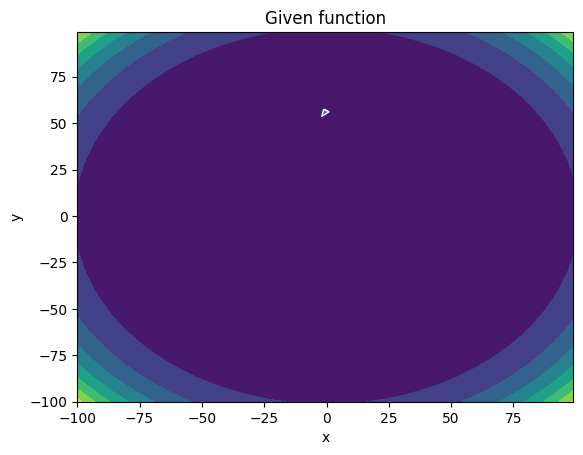

-------
Initial Coordinates:
[[-0.05812423]
 [56.77399598]]
Final Coordinates:
[[-0.11303895]
 [56.67439402]]
Gradient:
[[-2.86288692e+07]
 [ 1.96534687e+10]]


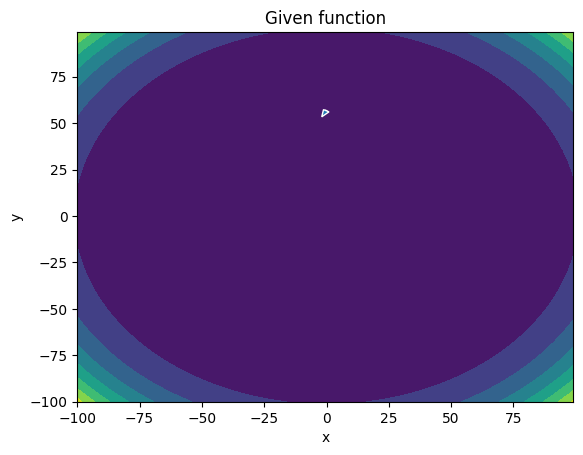

-------
Initial Coordinates:
[[-0.11303895]
 [56.67439402]]
Final Coordinates:
[[-0.16396372]
 [56.57479268]]
Gradient:
[[-4.73285402e+07]
 [ 1.94817609e+10]]


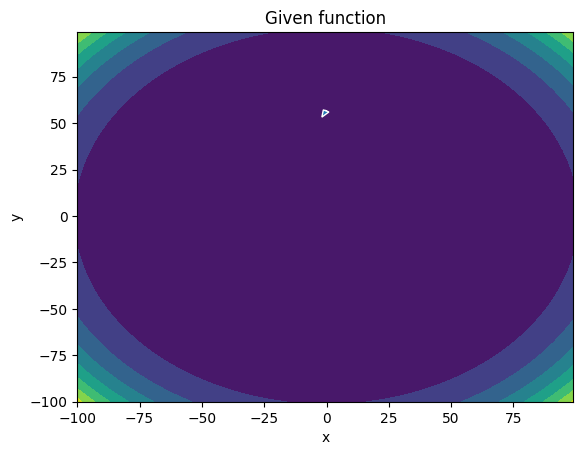

-------
Initial Coordinates:
[[-0.16396372]
 [56.57479268]]
Final Coordinates:
[[-0.21058057]
 [56.47519198]]
Gradient:
[[-6.44021635e+07]
 [ 1.93113136e+10]]


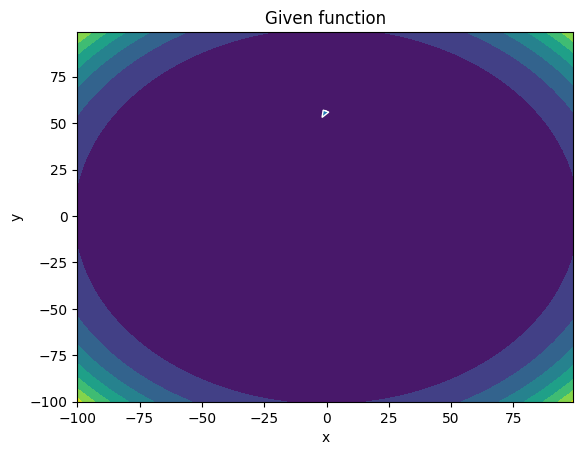

-------
Initial Coordinates:
[[-0.21058057]
 [56.47519198]]
Final Coordinates:
[[-0.25258143]
 [56.37559193]]
Gradient:
[[-7.97727766e+07]
 [ 1.91421032e+10]]


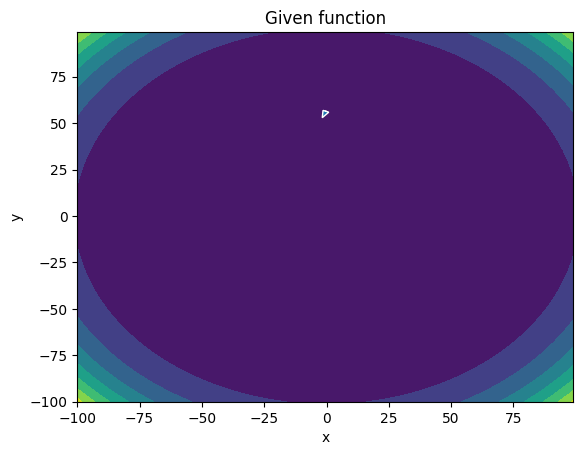

-------
Initial Coordinates:
[[-0.25258143]
 [56.37559193]]
Final Coordinates:
[[-0.28967942]
 [56.27599257]]
Gradient:
[[-9.33693762e+07]
 [ 1.89741067e+10]]


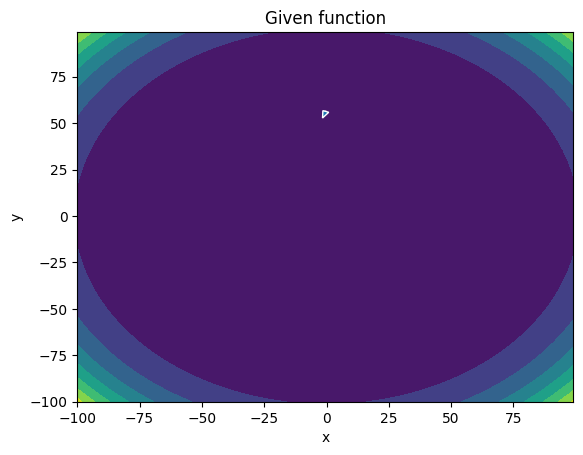

-------
Initial Coordinates:
[[-0.28967942]
 [56.27599257]]
Final Coordinates:
[[-0.32162118]
 [56.17639391]]
Gradient:
[[-1.05130574e+08]
 [ 1.88073015e+10]]


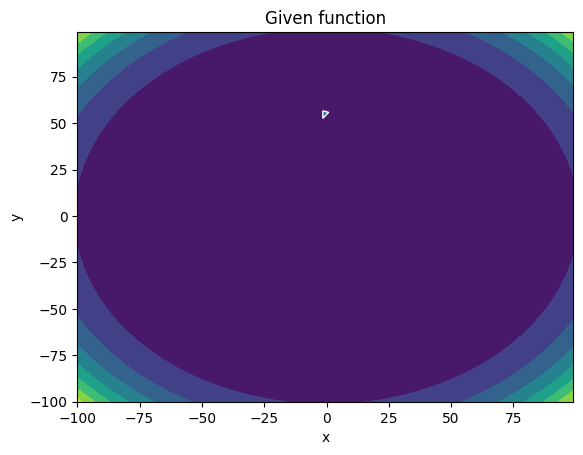

-------
Initial Coordinates:
[[-0.32162118]
 [56.17639391]]
Final Coordinates:
[[-0.34819917]
 [56.07679599]]
Gradient:
[[-1.15008415e+08]
 [ 1.86416665e+10]]


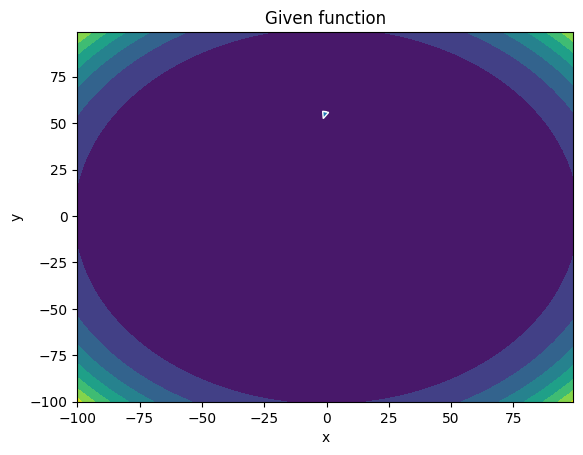

-------
Initial Coordinates:
[[-0.34819917]
 [56.07679599]]
Final Coordinates:
[[-0.36926285]
 [55.97719883]]
Gradient:
[[-1.22972030e+08]
 [ 1.84771823e+10]]


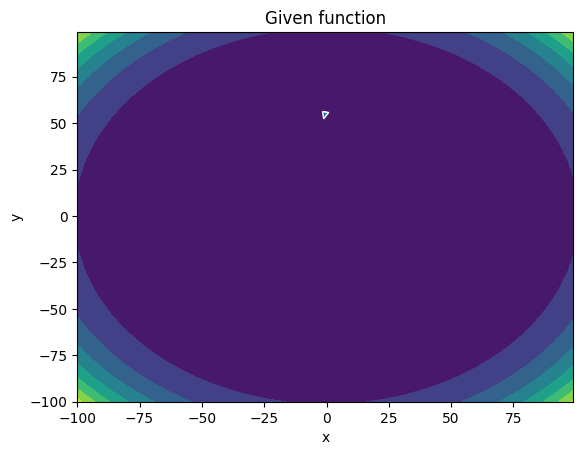

-------
Initial Coordinates:
[[-0.36926285]
 [55.97719883]]
Final Coordinates:
[[-0.38472748]
 [55.87760248]]
Gradient:
[[-1.29010743e+08]
 [ 1.83138317e+10]]


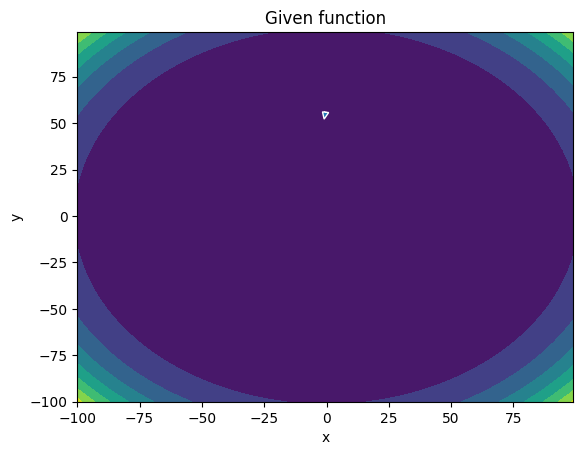

-------
Initial Coordinates:
[[-0.38472748]
 [55.87760248]]
Final Coordinates:
[[-0.39457975]
 [55.77800697]]
Gradient:
[[-1.33136278e+08]
 [ 1.81516002e+10]]


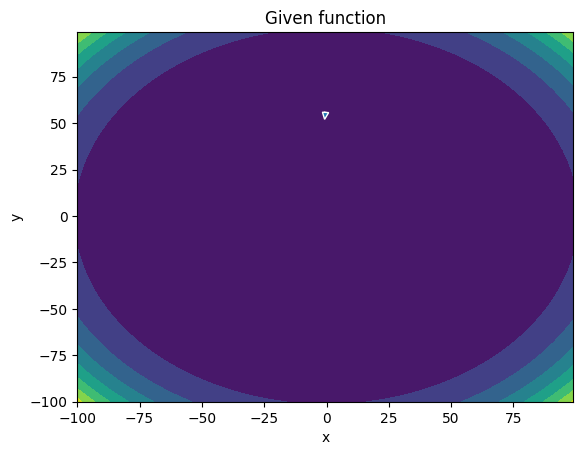

-------
Initial Coordinates:
[[-0.39457975]
 [55.77800697]]
Final Coordinates:
[[-0.39887957]
 [55.67841234]]
Gradient:
[[-1.35383800e+08]
 [ 1.79904762e+10]]


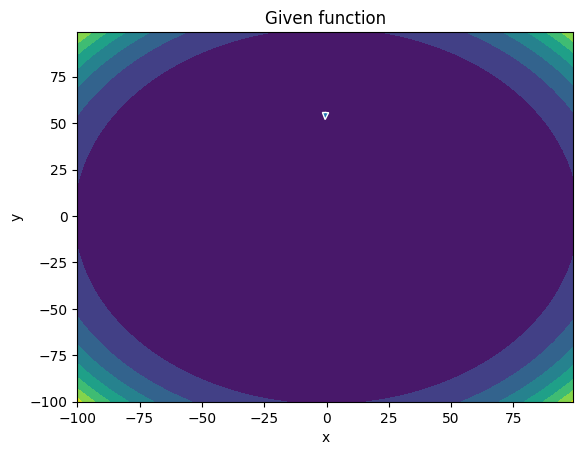

-------
Initial Coordinates:
[[-0.39887957]
 [55.67841234]]
Final Coordinates:
[[-0.39775816]
 [55.57881863]]
Gradient:
[[-1.35811686e+08]
 [ 1.78304510e+10]]


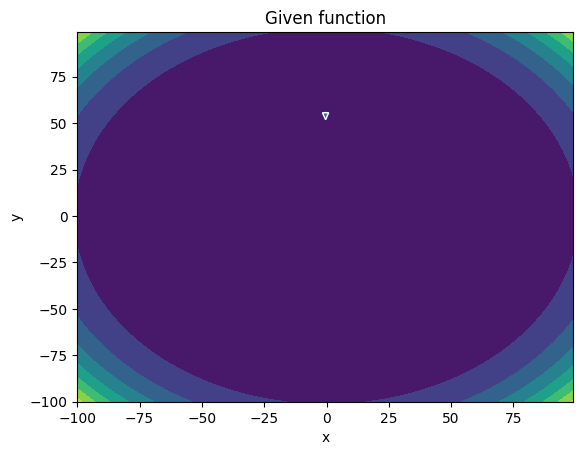

-------
Initial Coordinates:
[[-0.39775816]
 [55.57881863]]
Final Coordinates:
[[-0.39141304]
 [55.47922587]]
Gradient:
[[-1.34500088e+08]
 [ 1.76715188e+10]]


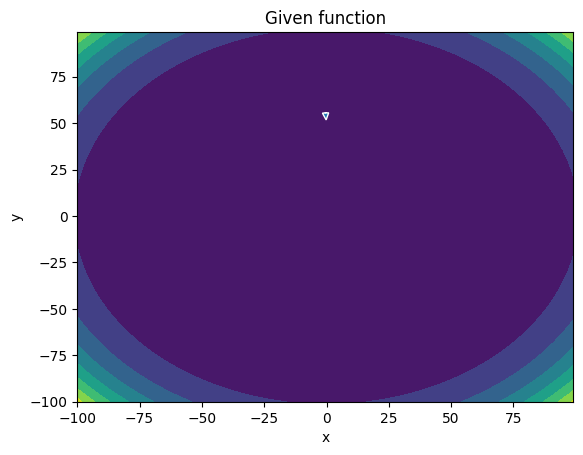

-------
Initial Coordinates:
[[-0.39141304]
 [55.47922587]]
Final Coordinates:
[[-0.38010066]
 [55.37963412]]
Gradient:
[[-1.31548527e+08]
 [ 1.75136766e+10]]


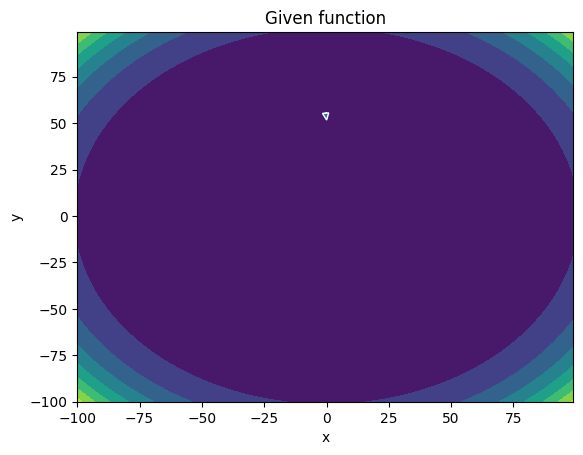

-------
Initial Coordinates:
[[-0.38010066]
 [55.37963412]]
Final Coordinates:
[[-0.36412802]
 [55.28004342]]
Gradient:
[[-1.27072869e+08]
 [ 1.73569235e+10]]


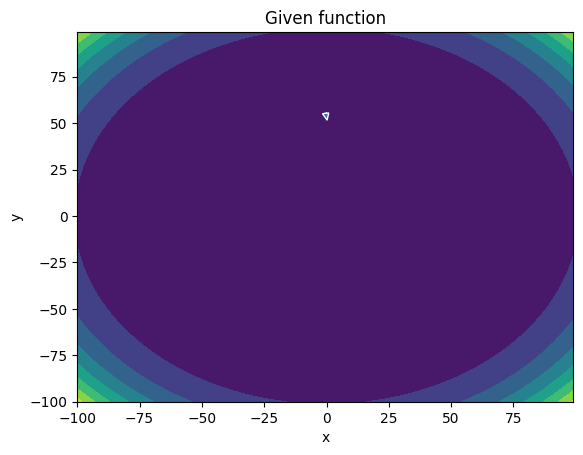

-------
Initial Coordinates:
[[-0.36412802]
 [55.28004342]]
Final Coordinates:
[[-0.3438442]
 [55.1804538]]
Gradient:
[[-1.21202050e+08]
 [ 1.72012605e+10]]


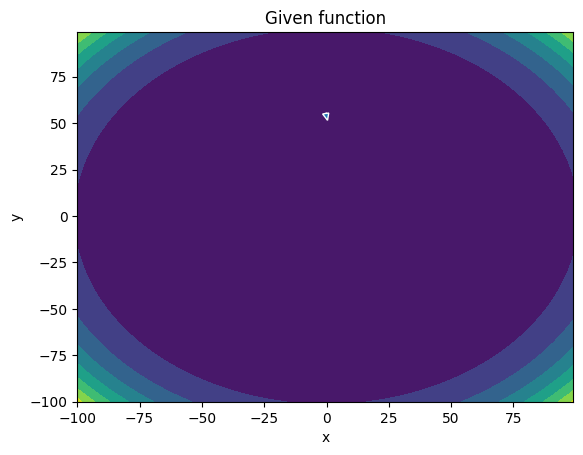

-------
Initial Coordinates:
[[-0.3438442]
 [55.1804538]]
Final Coordinates:
[[-0.31963286]
 [55.08086531]]
Gradient:
[[-1.14074927e+08]
 [ 1.70466898e+10]]


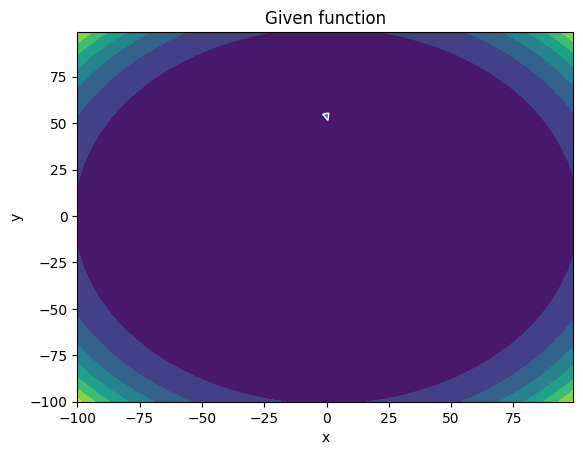

-------
Initial Coordinates:
[[-0.31963286]
 [55.08086531]]
Final Coordinates:
[[-0.2919063 ]
 [54.98127799]]
Gradient:
[[-1.05837523e+08]
 [ 1.68932144e+10]]


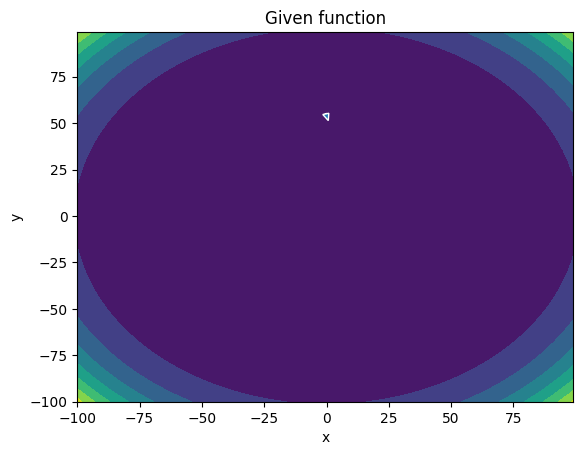

-------
Initial Coordinates:
[[-0.2919063 ]
 [54.98127799]]
Final Coordinates:
[[-0.26110145]
 [54.88169187]]
Gradient:
[[-9.66408706e+07]
 [ 1.67408376e+10]]


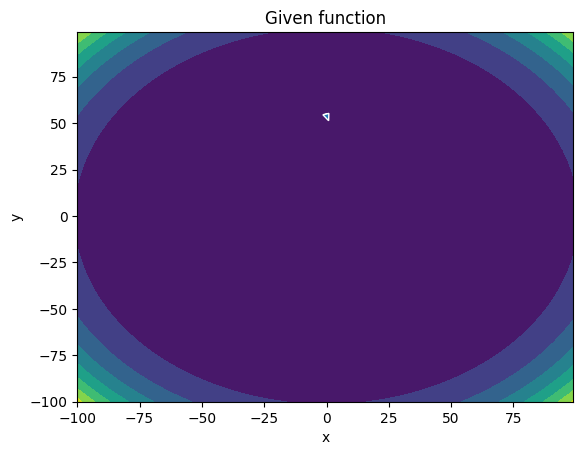

-------
Initial Coordinates:
[[-0.26110145]
 [54.88169187]]
Final Coordinates:
[[-0.22767804]
 [54.782107  ]]
Gradient:
[[-8.66395247e+07]
 [ 1.65895626e+10]]


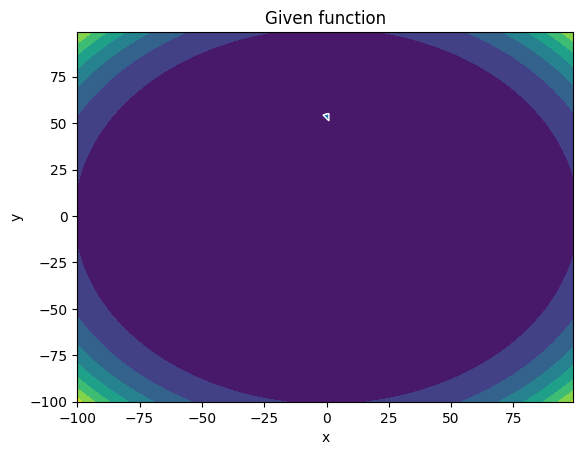

-------
Initial Coordinates:
[[-0.22767804]
 [54.782107  ]]
Final Coordinates:
[[-0.19211877]
 [54.6825234 ]]
Gradient:
[[-7.59907811e+07]
 [ 1.64393919e+10]]


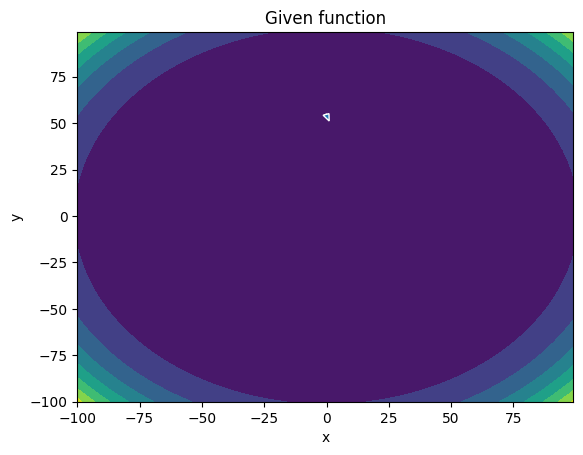

-------
Initial Coordinates:
[[-0.19211877]
 [54.6825234 ]]
Final Coordinates:
[[-0.15493126]
 [54.5829411 ]]
Gradient:
[[-6.48545297e+07]
 [ 1.62903273e+10]]


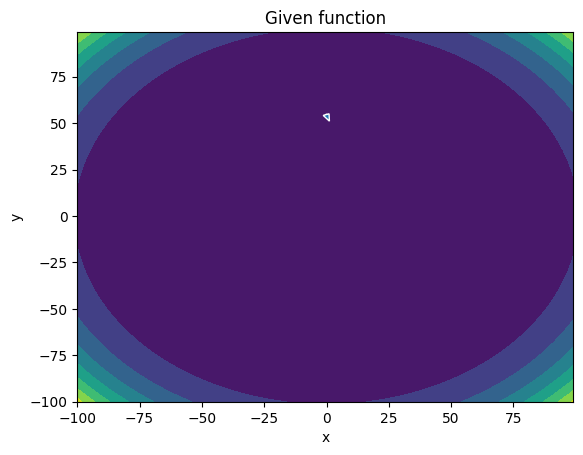

-------
Initial Coordinates:
[[-0.15493126]
 [54.5829411 ]]
Final Coordinates:
[[-0.11665128]
 [54.48336014]]
Gradient:
[[-5.33936386e+07]
 [ 1.61423692e+10]]


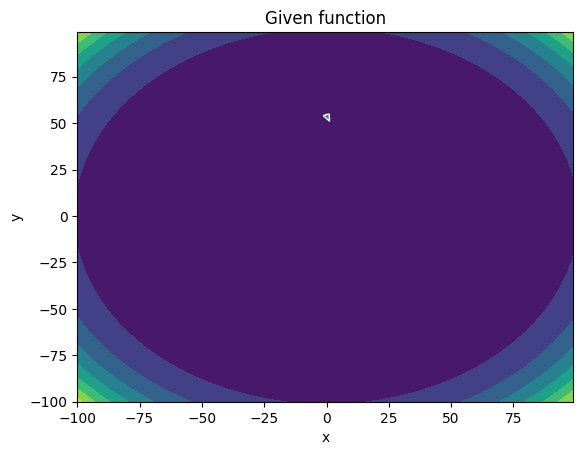

-------
Initial Coordinates:
[[-0.11665128]
 [54.48336014]]
Final Coordinates:
[[-0.07784665]
 [54.38378054]]
Gradient:
[[-4.17747029e+07]
 [ 1.59955165e+10]]


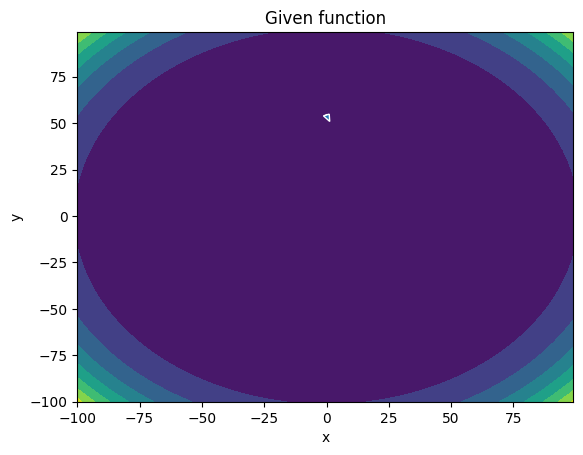

-------
Initial Coordinates:
[[-0.07784665]
 [54.38378054]]
Final Coordinates:
[[-3.91205489e-02]
 [ 5.42842023e+01]]
Gradient:
[[-3.01689289e+07]
 [ 1.58497667e+10]]


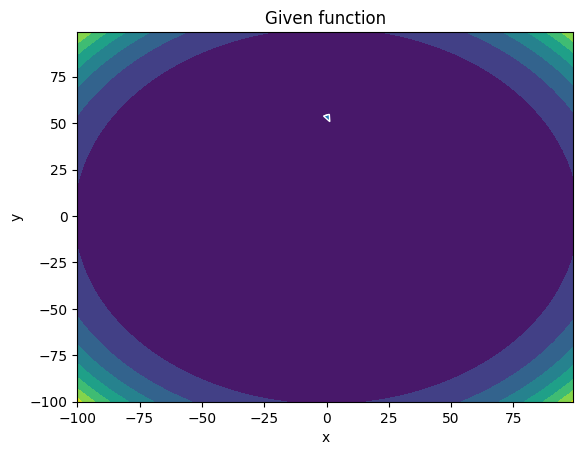

-------
Initial Coordinates:
[[-3.91205489e-02]
 [ 5.42842023e+01]]
Final Coordinates:
[[-1.11300751e-03]
 [ 5.41846255e+01]]
Gradient:
[[-1.87528409e+07]
 [ 1.57051150e+10]]


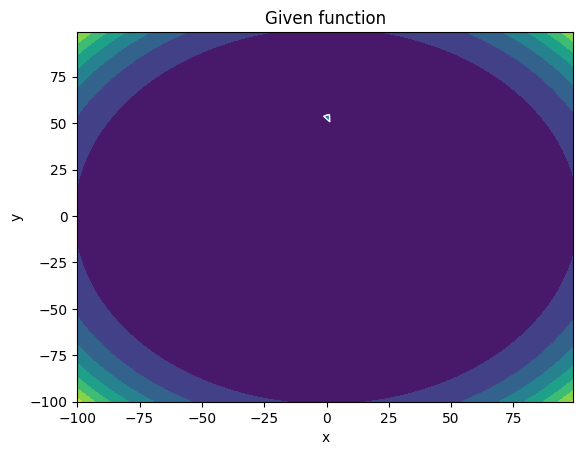

-------
Initial Coordinates:
[[-1.11300751e-03]
 [ 5.41846255e+01]]
Final Coordinates:
[[3.55014863e-02]
 [5.40850501e+01]]
Gradient:
[[-7.70839936e+06]
 [ 1.55615550e+10]]


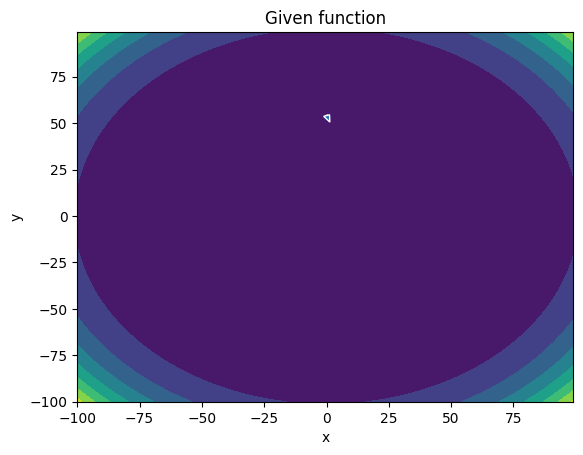

-------
Initial Coordinates:
[[3.55014863e-02]
 [5.40850501e+01]]
Final Coordinates:
[[ 0.07002235]
 [53.98547616]]
Gradient:
[[2.77798186e+06]
 [1.54190781e+10]]


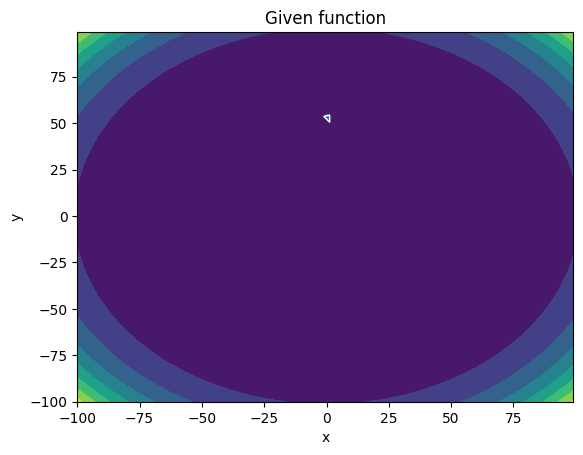

-------
Initial Coordinates:
[[ 0.07002235]
 [53.98547616]]
Final Coordinates:
[[ 0.10173934]
 [53.88590366]]
Gradient:
[[1.25180820e+07]
 [1.52776737e+10]]


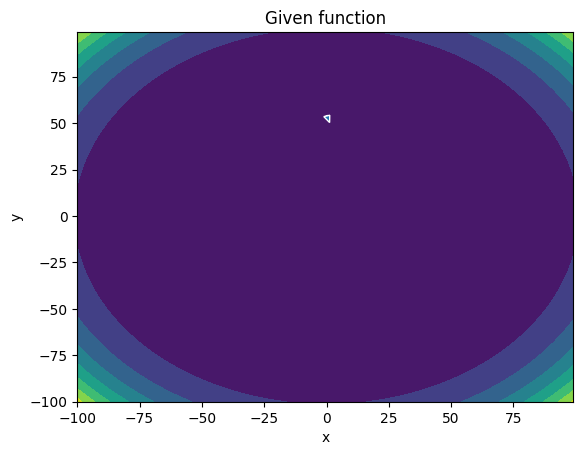

-------
Initial Coordinates:
[[ 0.10173934]
 [53.88590366]]
Final Coordinates:
[[ 0.12995818]
 [53.78633263]]
Gradient:
[[2.13266766e+07]
 [1.51373296e+10]]


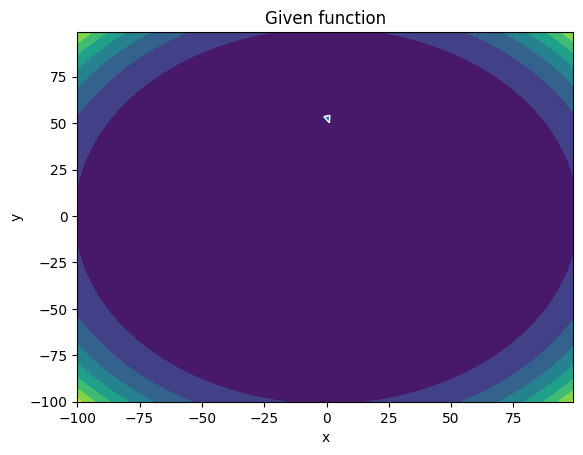

-------
Initial Coordinates:
[[ 0.12995818]
 [53.78633263]]
Final Coordinates:
[[ 0.15403476]
 [53.68676308]]
Gradient:
[[2.90287080e+07]
 [1.49980323e+10]]


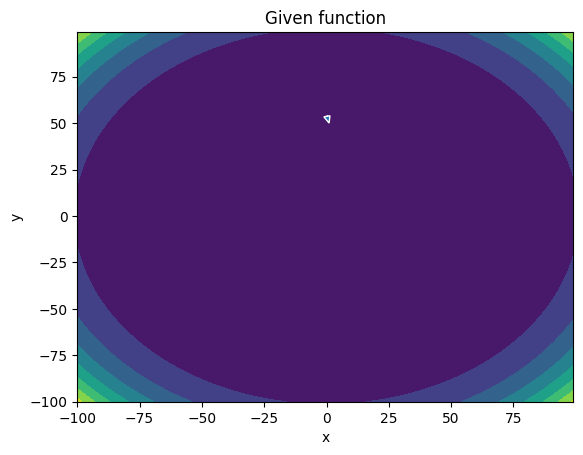

-------
Initial Coordinates:
[[ 0.15403476]
 [53.68676308]]
Final Coordinates:
[[ 0.17341429]
 [53.58719503]]
Gradient:
[[3.54684946e+07]
 [1.48597678e+10]]


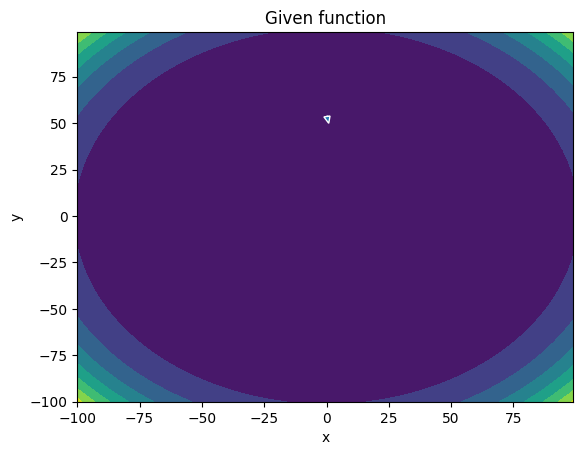

-------
Initial Coordinates:
[[ 0.17341429]
 [53.58719503]]
Final Coordinates:
[[ 0.18766977]
 [53.4876285 ]]
Gradient:
[[4.05199312e+07]
 [1.47225220e+10]]


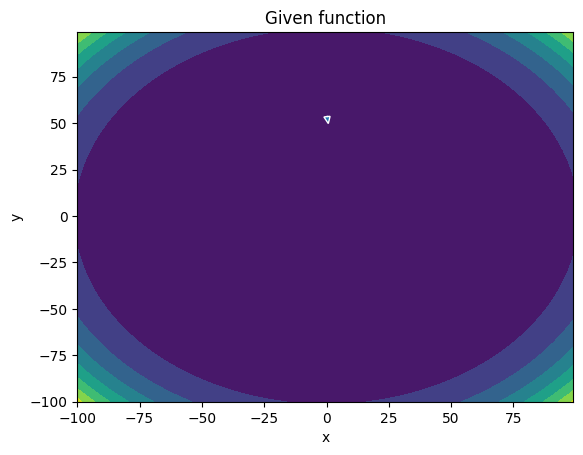

-------
Initial Coordinates:
[[ 0.18766977]
 [53.4876285 ]]
Final Coordinates:
[[ 0.19653256]
 [53.3880635 ]]
Gradient:
[[4.40959971e+07]
 [1.45862823e+10]]


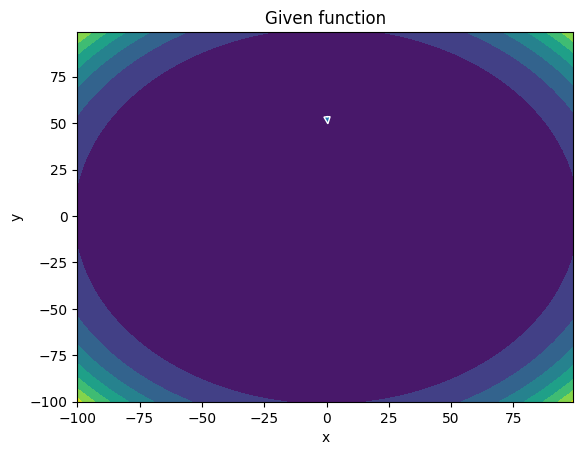

-------
Initial Coordinates:
[[ 0.19653256]
 [53.3880635 ]]
Final Coordinates:
[[ 0.19990933]
 [53.28850005]]
Gradient:
[[4.61556874e+07]
 [1.44510375e+10]]


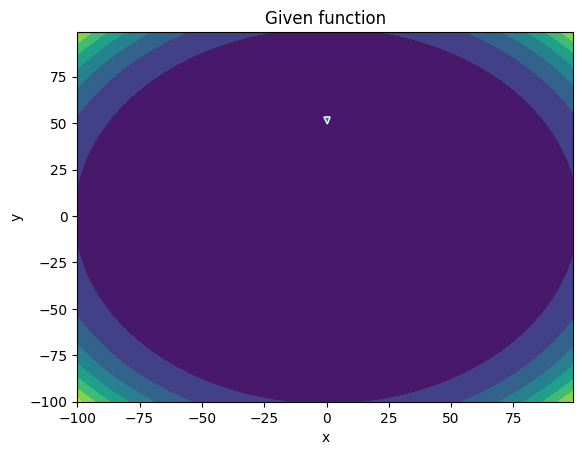

-------
Initial Coordinates:
[[ 0.19990933]
 [53.28850005]]
Final Coordinates:
[[ 0.19788352]
 [53.18893816]]
Gradient:
[[4.67069588e+07]
 [1.43167792e+10]]


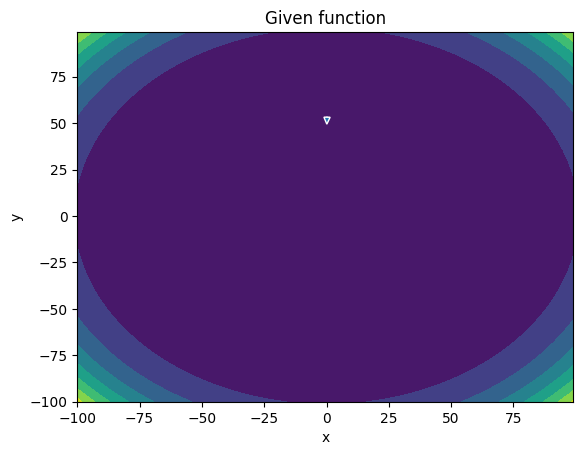

-------
Initial Coordinates:
[[ 0.19788352]
 [53.18893816]]
Final Coordinates:
[[ 0.1907032 ]
 [53.08937786]]
Gradient:
[[4.58053201e+07]
 [1.41835011e+10]]


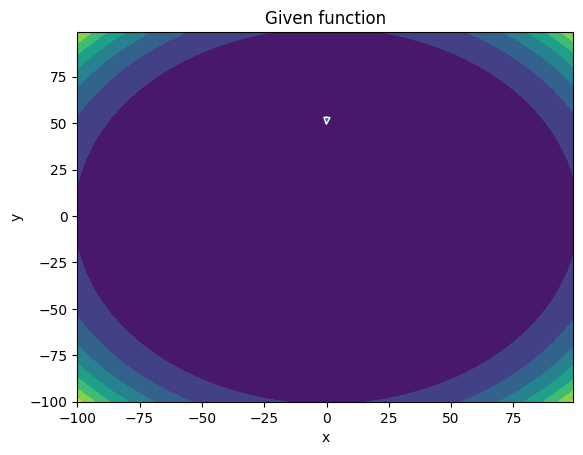

-------
Initial Coordinates:
[[ 0.1907032 ]
 [53.08937786]]
Final Coordinates:
[[ 0.17876076]
 [52.98981917]]
Gradient:
[[4.35488617e+07]
 [1.40511998e+10]]


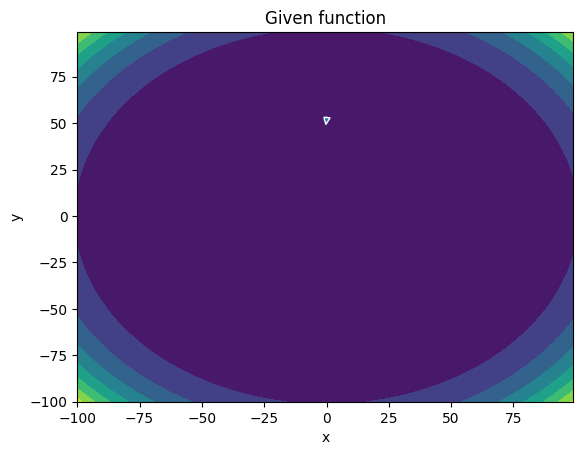

-------
Initial Coordinates:
[[ 0.17876076]
 [52.98981917]]
Final Coordinates:
[[ 0.16257067]
 [52.8902621 ]]
Gradient:
[[4.00712977e+07]
 [1.39198734e+10]]


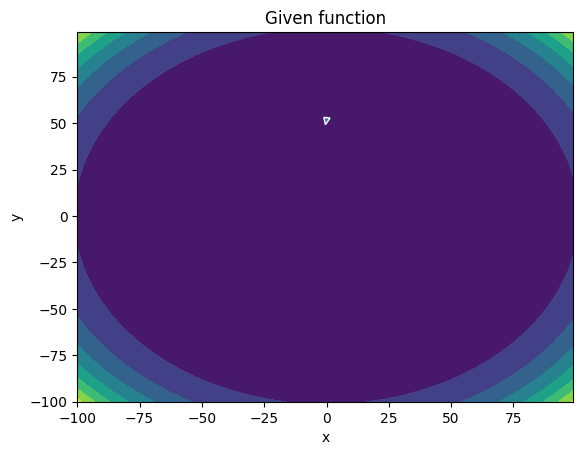

-------
Initial Coordinates:
[[ 0.16257067]
 [52.8902621 ]]
Final Coordinates:
[[ 0.1427502 ]
 [52.79070669]]
Gradient:
[[3.55347481e+07]
 [1.37895217e+10]]


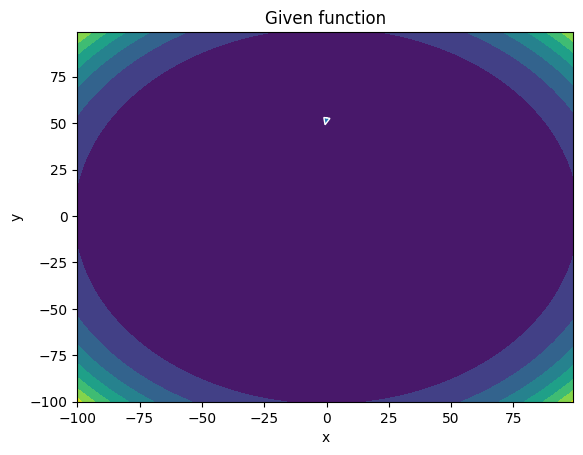

-------
Initial Coordinates:
[[ 0.1427502 ]
 [52.79070669]]
Final Coordinates:
[[ 0.12000629]
 [52.69115293]]
Gradient:
[[3.01236101e+07]
 [1.36601451e+10]]


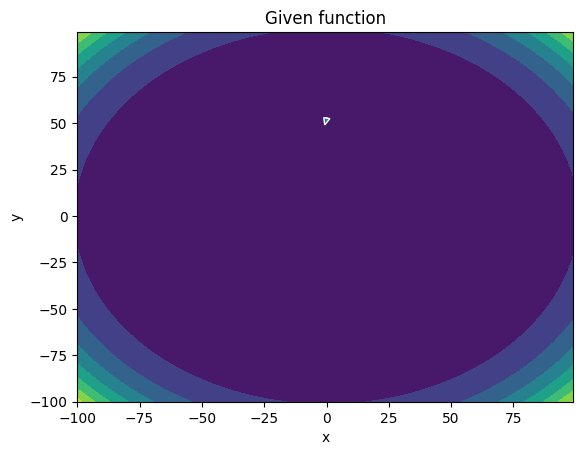

-------
Initial Coordinates:
[[ 0.12000629]
 [52.69115293]]
Final Coordinates:
[[ 0.09512864]
 [52.59160087]]
Gradient:
[[2.40402142e+07]
 [1.35317440e+10]]


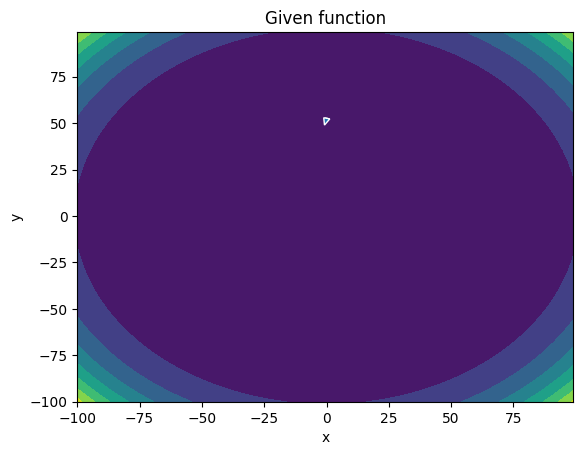

-------
Initial Coordinates:
[[ 0.09512864]
 [52.59160087]]
Final Coordinates:
[[ 0.06898719]
 [52.4920505 ]]
Gradient:
[[1.75022765e+07]
 [1.34043182e+10]]


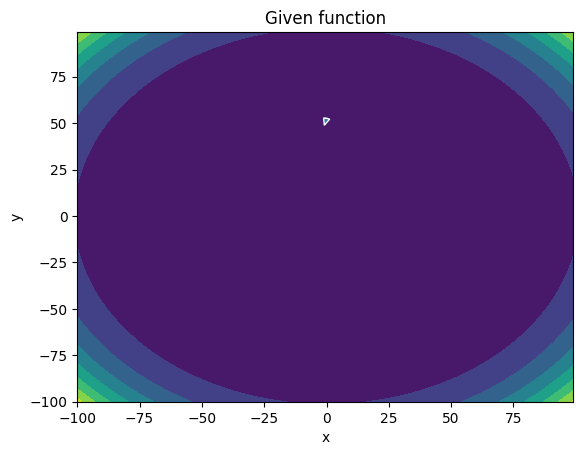

-------
Initial Coordinates:
[[ 0.06898719]
 [52.4920505 ]]
Final Coordinates:
[[4.25292355e-02]
 [5.23925019e+01]]
Gradient:
[[1.07415261e+07]
 [1.32778663e+10]]


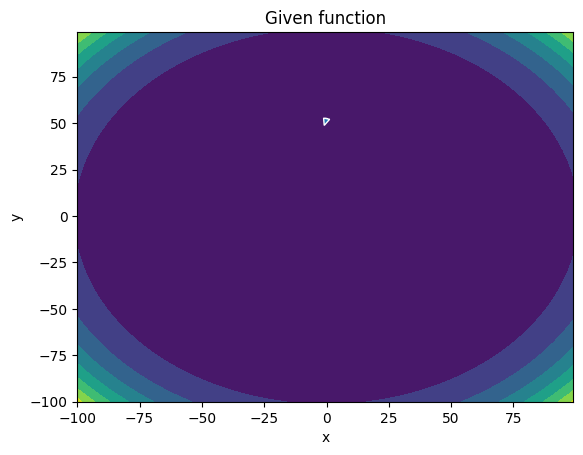

-------
Initial Coordinates:
[[4.25292355e-02]
 [5.23925019e+01]]
Final Coordinates:
[[1.67695435e-02]
 [5.22929549e+01]]
Gradient:
[[4.00231419e+06]
 [1.31523854e+10]]


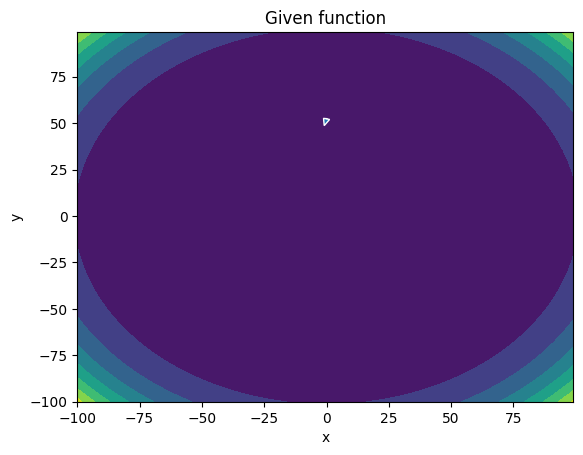

-------
Initial Coordinates:
[[1.67695435e-02]
 [5.22929549e+01]]
Final Coordinates:
[[-7.23489190e-03]
 [ 5.21934098e+01]]
Gradient:
[[-2.46149025e+06]
 [ 1.30278705e+10]]


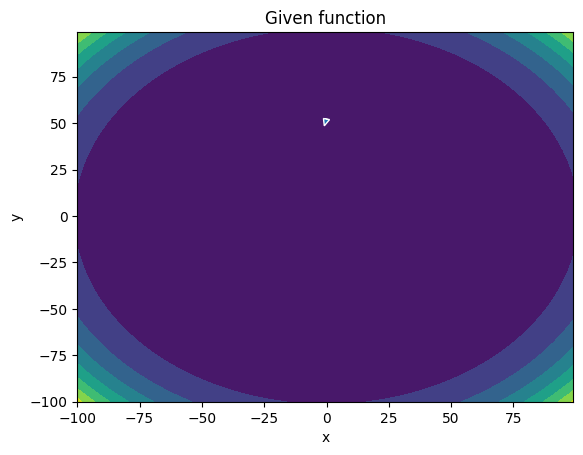

-------
Initial Coordinates:
[[-7.23489190e-03]
 [ 5.21934098e+01]]
Final Coordinates:
[[-2.84326339e-02]
 [ 5.20938664e+01]]
Gradient:
[[-8.39327277e+06]
 [ 1.29043148e+10]]


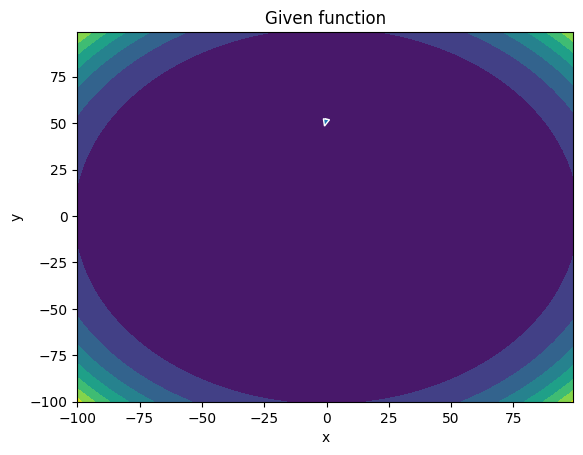

-------
Initial Coordinates:
[[-2.84326339e-02]
 [ 5.20938664e+01]]
Final Coordinates:
[[-4.58496249e-02]
 [ 5.19943247e+01]]
Gradient:
[[-1.35456832e+07]
 [ 1.27817097e+10]]


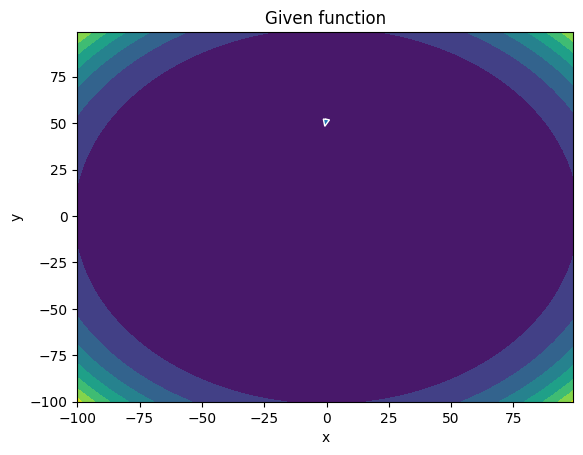

-------
Initial Coordinates:
[[-4.58496249e-02]
 [ 5.19943247e+01]]
Final Coordinates:
[[-0.05867609]
 [51.89478488]]
Gradient:
[[-1.76979630e+07]
 [ 1.26600454e+10]]


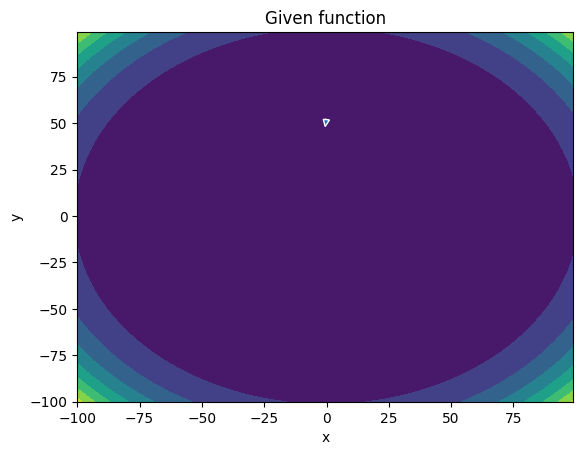

-------
Initial Coordinates:
[[-0.05867609]
 [51.89478488]]
Final Coordinates:
[[-0.06634883]
 [51.79524683]]
Gradient:
[[-2.06761229e+07]
 [ 1.25393120e+10]]


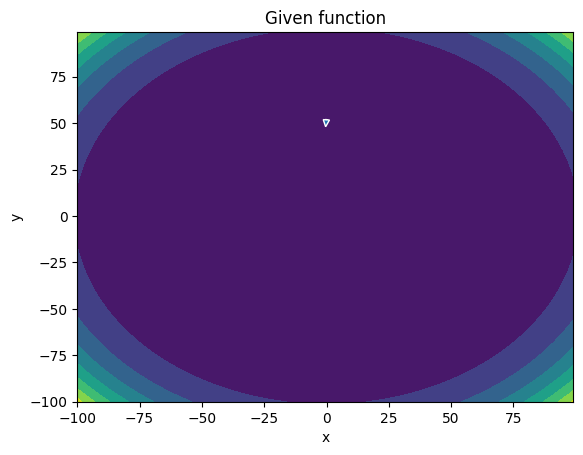

-------
Initial Coordinates:
[[-0.06634883]
 [51.79524683]]
Final Coordinates:
[[-0.06860638]
 [51.69571058]]
Gradient:
[[-2.2371068e+07]
 [ 1.2419500e+10]]


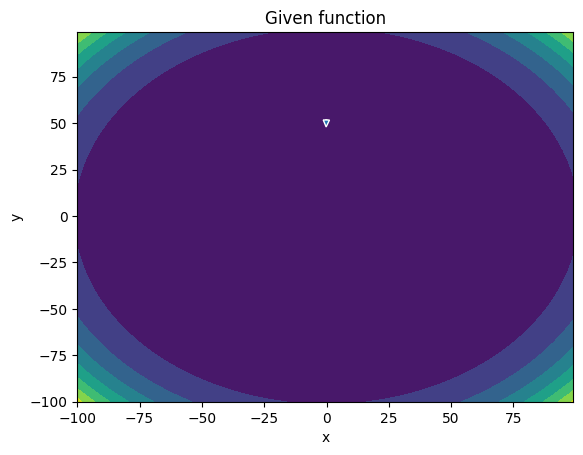

-------
Initial Coordinates:
[[-0.06860638]
 [51.69571058]]
Final Coordinates:
[[-0.06550405]
 [51.59617616]]
Gradient:
[[-2.27493811e+07]
 [ 1.23006018e+10]]


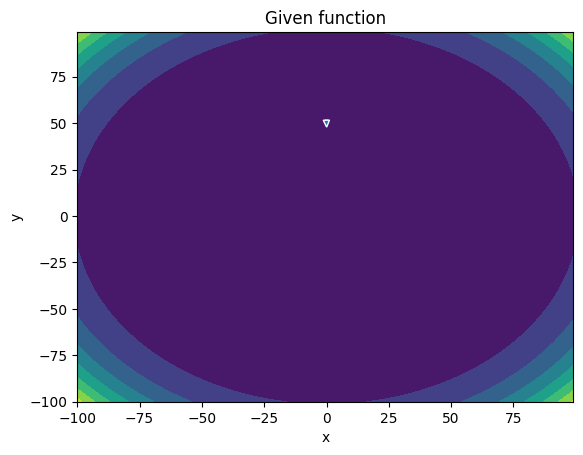

-------
Initial Coordinates:
[[-0.06550405]
 [51.59617616]]
Final Coordinates:
[[-0.05739277]
 [51.49664358]]
Gradient:
[[-2.18540686e+07]
 [ 1.21826114e+10]]


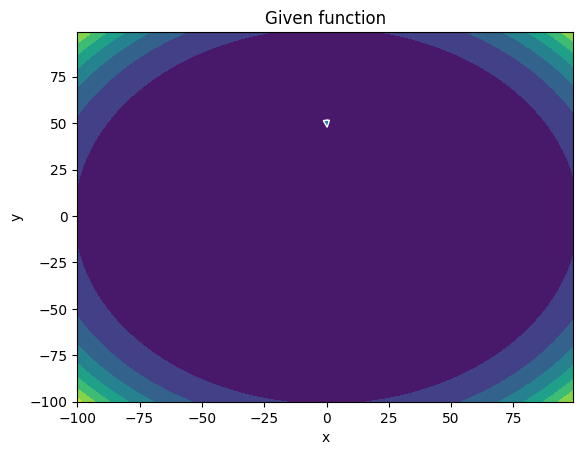

-------
Initial Coordinates:
[[-0.05739277]
 [51.49664358]]
Final Coordinates:
[[-4.48783129e-02]
 [ 5.13971128e+01]]
Gradient:
[[-1.97966952e+07]
 [ 1.20655250e+10]]


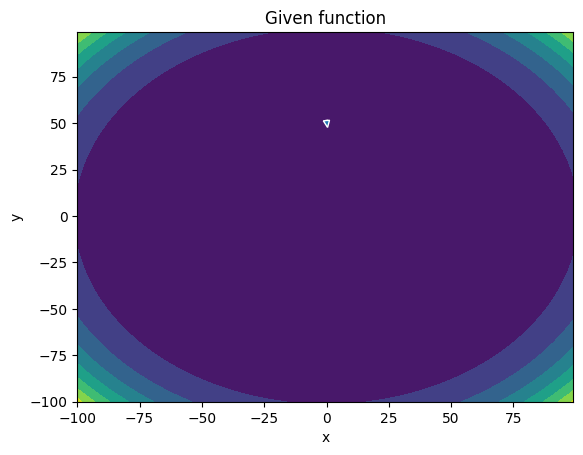

-------
Initial Coordinates:
[[-4.48783129e-02]
 [ 5.13971128e+01]]
Final Coordinates:
[[-2.87794037e-02]
 [ 5.12975840e+01]]
Gradient:
[[-1.67452337e+07]
 [ 1.19493402e+10]]


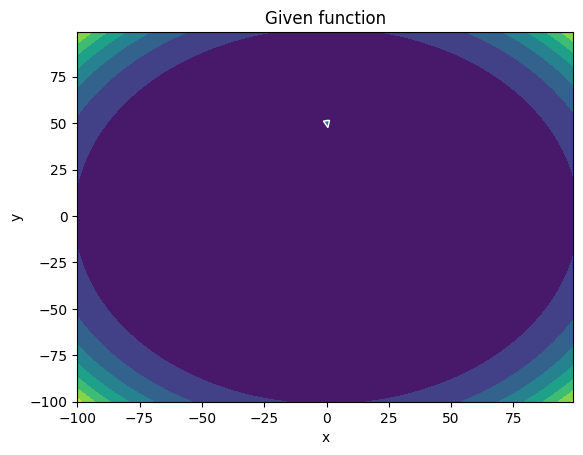

-------
Initial Coordinates:
[[-2.87794037e-02]
 [ 5.12975840e+01]]
Final Coordinates:
[[-1.00957613e-02]
 [ 5.11980570e+01]]
Gradient:
[[-1.29121394e+07]
 [ 1.18340549e+10]]


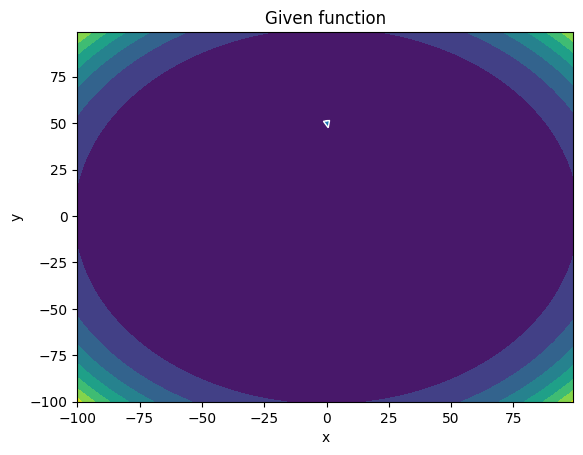

-------
Initial Coordinates:
[[-1.00957613e-02]
 [ 5.11980570e+01]]
Final Coordinates:
[[1.00141263e-02]
 [5.10985319e+01]]
Gradient:
[[-8.54519245e+06]
 [ 1.17196674e+10]]


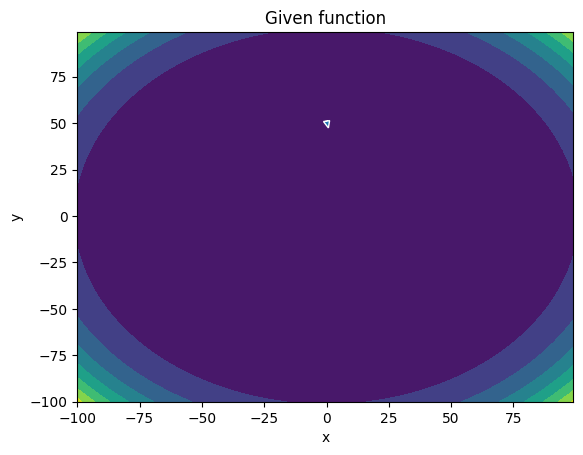

-------
Initial Coordinates:
[[1.00141263e-02]
 [5.10985319e+01]]
Final Coordinates:
[[3.02570425e-02]
 [5.09990087e+01]]
Gradient:
[[-3.92092455e+06]
 [ 1.16061747e+10]]


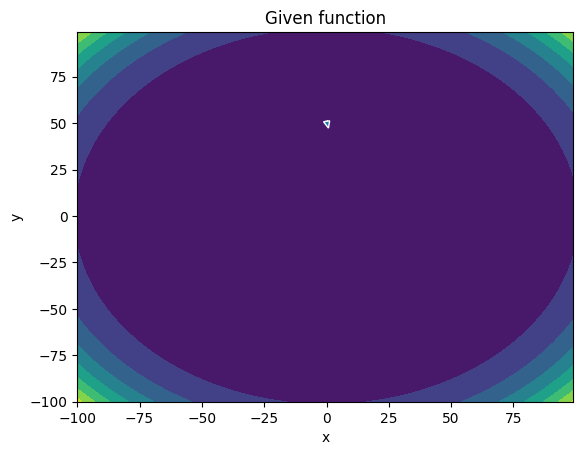

-------
Initial Coordinates:
[[3.02570425e-02]
 [5.09990087e+01]]
Final Coordinates:
[[4.92510174e-02]
 [5.08994874e+01]]
Gradient:
[[6.62095608e+05]
 [1.14935722e+10]]


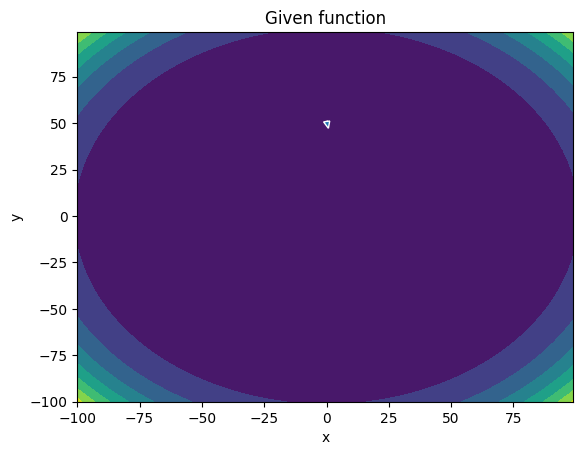

-------
Initial Coordinates:
[[4.92510174e-02]
 [5.08994874e+01]]
Final Coordinates:
[[ 0.06561421]
 [50.79996807]]
Gradient:
[[4.89460527e+06]
 [1.13818537e+10]]


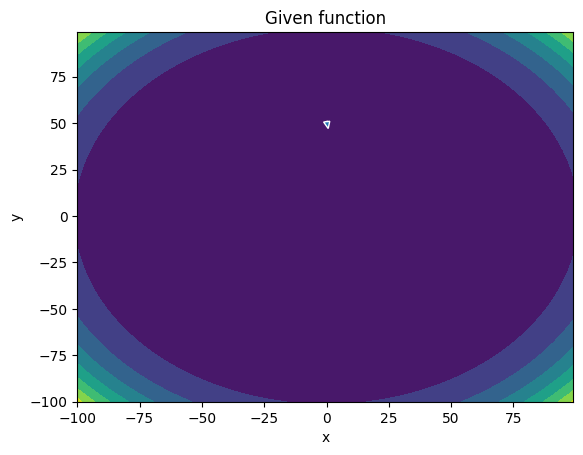

-------
Initial Coordinates:
[[ 0.06561421]
 [50.79996807]]
Final Coordinates:
[[ 0.07810292]
 [50.70045067]]
Gradient:
[[8.47701500e+06]
 [1.12710109e+10]]


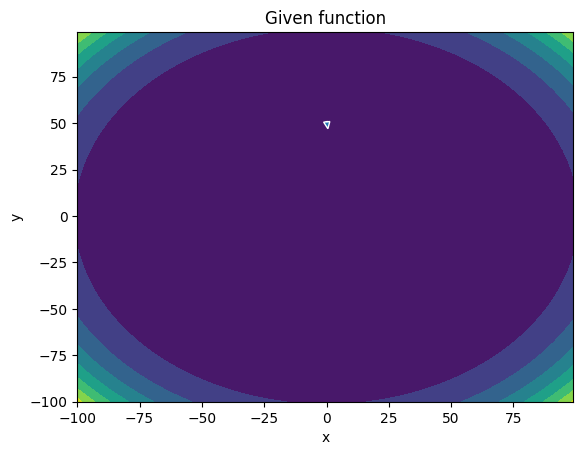

-------
Initial Coordinates:
[[ 0.07810292]
 [50.70045067]]
Final Coordinates:
[[ 0.08577355]
 [50.60093522]]
Gradient:
[[1.11496579e+07]
 [1.11610348e+10]]


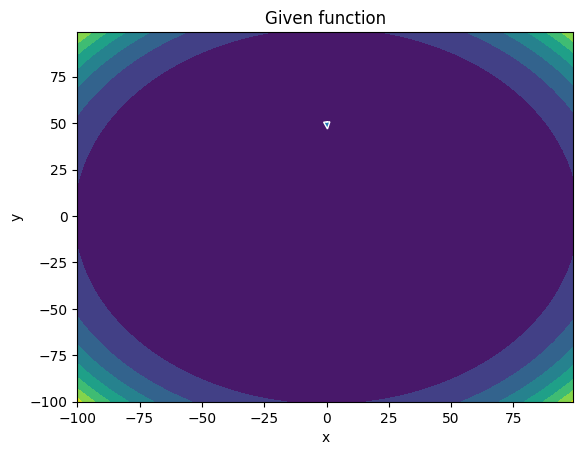

-------
Initial Coordinates:
[[ 0.08577355]
 [50.60093522]]
Final Coordinates:
[[ 0.08811555]
 [50.50142174]]
Gradient:
[[1.27268586e+07]
 [1.10519164e+10]]


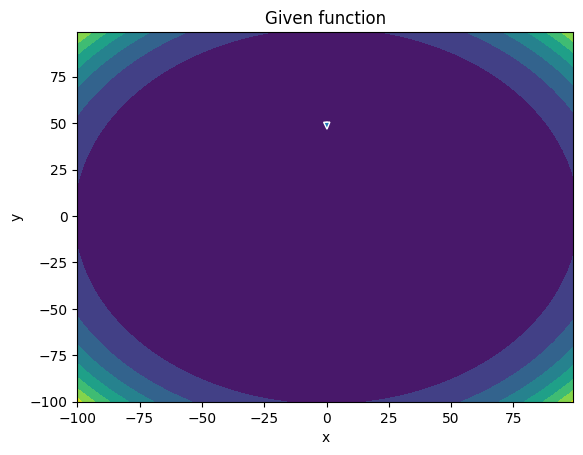

-------
Initial Coordinates:
[[ 0.08811555]
 [50.50142174]]
Final Coordinates:
[[ 0.08510848]
 [50.40191024]]
Gradient:
[[1.31230655e+07]
 [1.09436479e+10]]


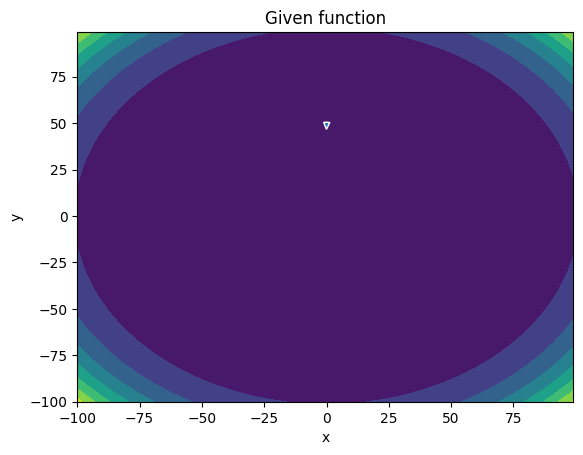

-------
Initial Coordinates:
[[ 0.08510848]
 [50.40191024]]
Final Coordinates:
[[ 0.07719862]
 [50.30240074]]
Gradient:
[[1.23613495e+07]
 [1.08362238e+10]]


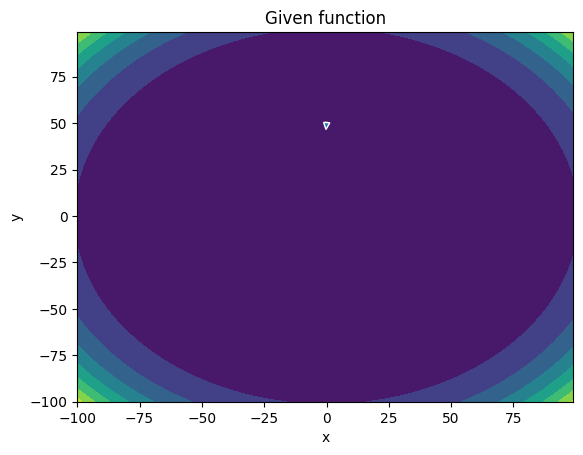

-------
Initial Coordinates:
[[ 0.07719862]
 [50.30240074]]
Final Coordinates:
[[ 0.06523082]
 [50.20289324]]
Gradient:
[[1.05642073e+07]
 [1.07296405e+10]]


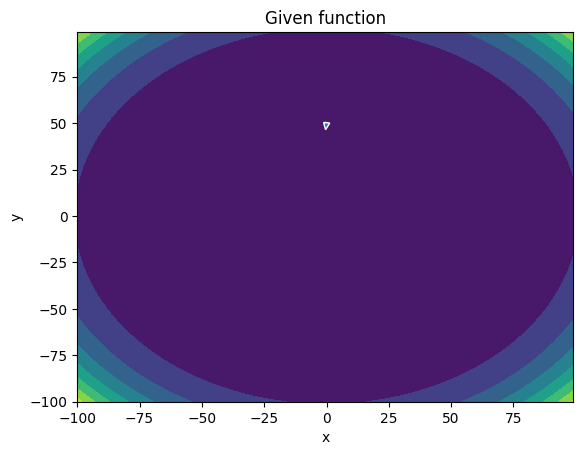

-------
Initial Coordinates:
[[ 0.06523082]
 [50.20289324]]
Final Coordinates:
[[ 0.05037694]
 [50.10338777]]
Gradient:
[[7.93520193e+06]
 [1.06238960e+10]]


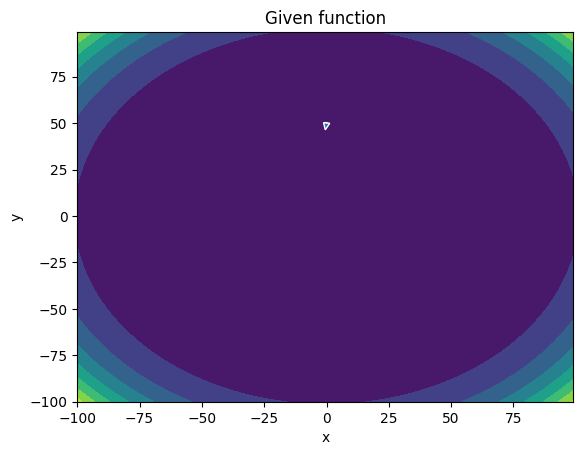

-------
Initial Coordinates:
[[ 0.05037694]
 [50.10338777]]
Final Coordinates:
[[3.40765229e-02]
 [5.00038843e+01]]
Gradient:
[[4.74064380e+06]
 [1.05189889e+10]]


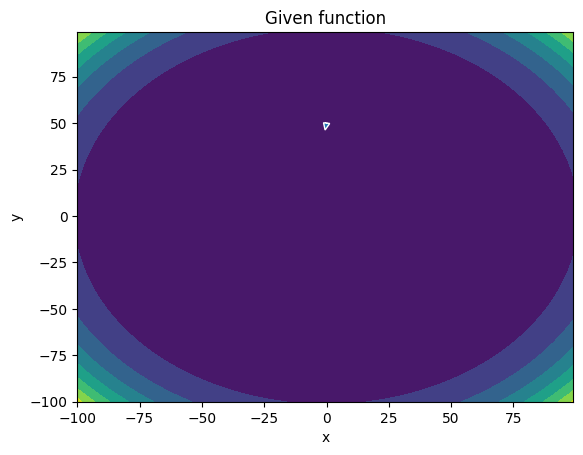

-------
Initial Coordinates:
[[3.40765229e-02]
 [5.00038843e+01]]
Final Coordinates:
[[1.79699184e-02]
 [4.99043830e+01]]
Gradient:
[[1.29457757e+06]
 [1.04149169e+10]]


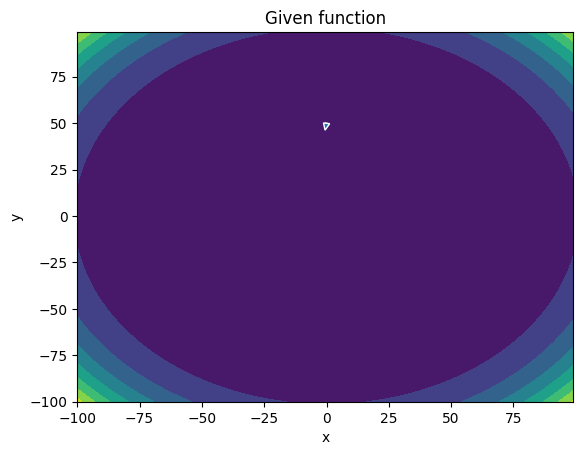

-------
Initial Coordinates:
[[1.79699184e-02]
 [4.99043830e+01]]
Final Coordinates:
[[3.78002964e-03]
 [4.98048837e+01]]
Gradient:
[[-2.05713429e+06]
 [ 1.03116768e+10]]


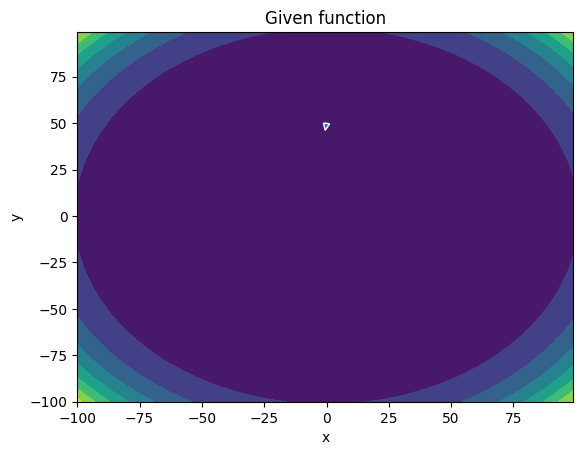

-------
Initial Coordinates:
[[3.78002964e-03]
 [4.98048837e+01]]
Final Coordinates:
[[-6.89196708e-03]
 [ 4.97053864e+01]]
Gradient:
[[-4.96256937e+06]
 [ 1.02092635e+10]]


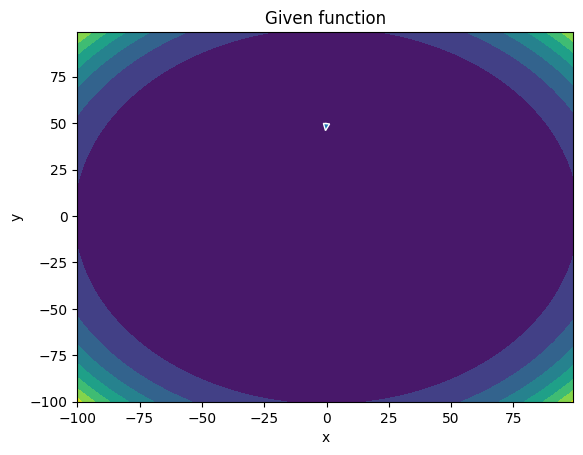

-------
Initial Coordinates:
[[-6.89196708e-03]
 [ 4.97053864e+01]]
Final Coordinates:
[[-1.28315140e-02]
 [ 4.96058913e+01]]
Gradient:
[[-7.10581887e+06]
 [ 1.01076703e+10]]


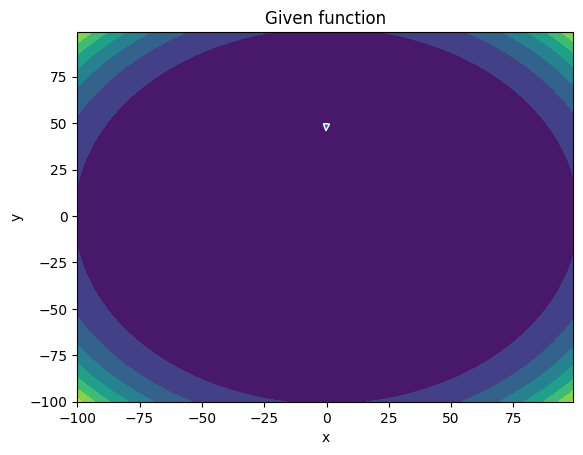

-------
Initial Coordinates:
[[-1.28315140e-02]
 [ 4.96058913e+01]]
Final Coordinates:
[[-1.34361312e-02]
 [ 4.95063983e+01]]
Gradient:
[[-8.25929433e+06]
 [ 1.00068903e+10]]


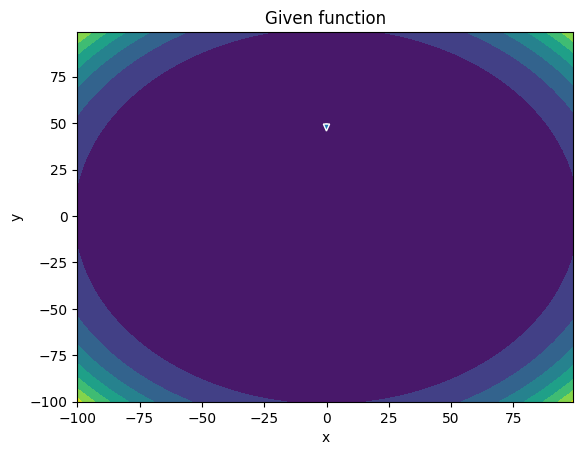

-------
Initial Coordinates:
[[-1.34361312e-02]
 [ 4.95063983e+01]]
Final Coordinates:
[[-8.80296502e-03]
 [ 4.94069074e+01]]
Gradient:
[[-8.32559551e+06]
 [ 9.90691706e+09]]


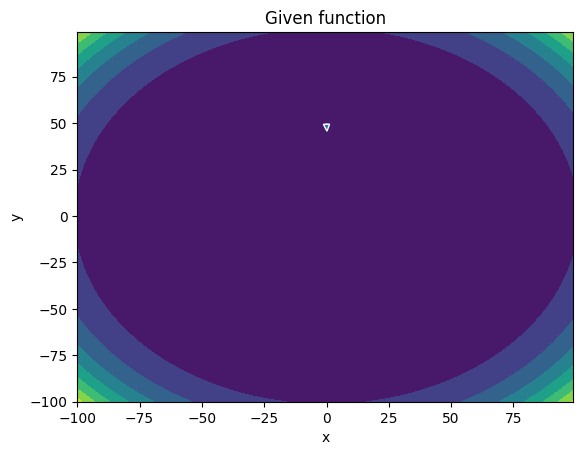

-------
Initial Coordinates:
[[-8.80296502e-03]
 [ 4.94069074e+01]]
Final Coordinates:
[[3.24171992e-04]
 [4.93074186e+01]]
Gradient:
[[-7.34987380e+06]
 [ 9.80774552e+09]]


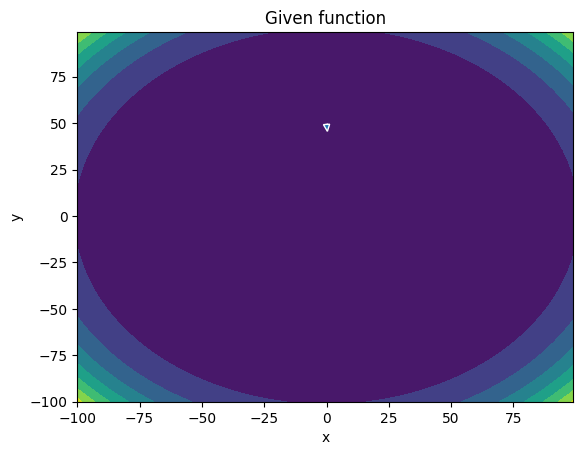

-------
Initial Coordinates:
[[3.24171992e-04]
 [4.93074186e+01]]
Final Coordinates:
[[1.26700843e-02]
 [4.92079320e+01]]
Gradient:
[[-5.50376169e+06]
 [ 9.70937202e+09]]


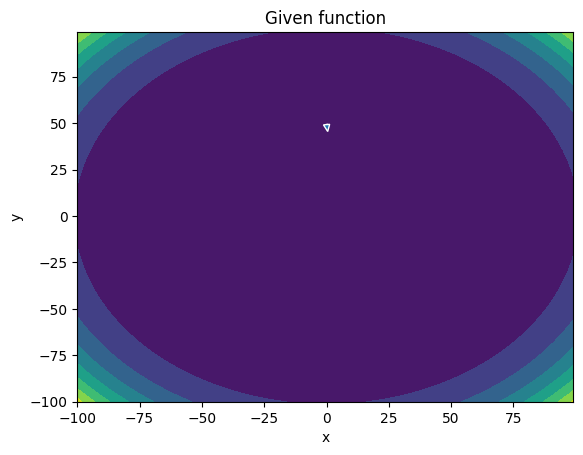

-------
Initial Coordinates:
[[1.26700843e-02]
 [4.92079320e+01]]
Final Coordinates:
[[2.65440844e-02]
 [4.91084475e+01]]
Gradient:
[[-3.05772531e+06]
 [ 9.61179341e+09]]


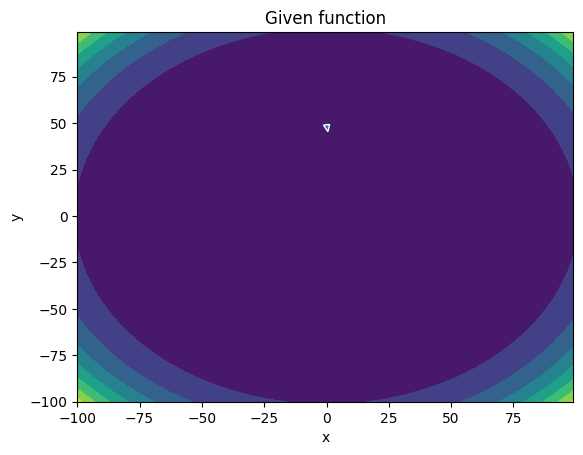

-------
Initial Coordinates:
[[2.65440844e-02]
 [4.91084475e+01]]
Final Coordinates:
[[3.99732264e-02]
 [4.90089653e+01]]
Gradient:
[[-3.54482843e+05]
 [ 9.51500600e+09]]


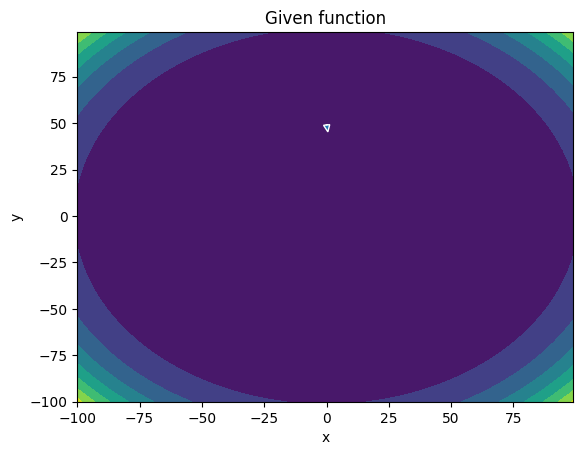

-------
Initial Coordinates:
[[3.99732264e-02]
 [4.90089653e+01]]
Final Coordinates:
[[ 0.05092995]
 [48.90948518]]
Gradient:
[[2.21974454e+06]
 [9.41900465e+09]]


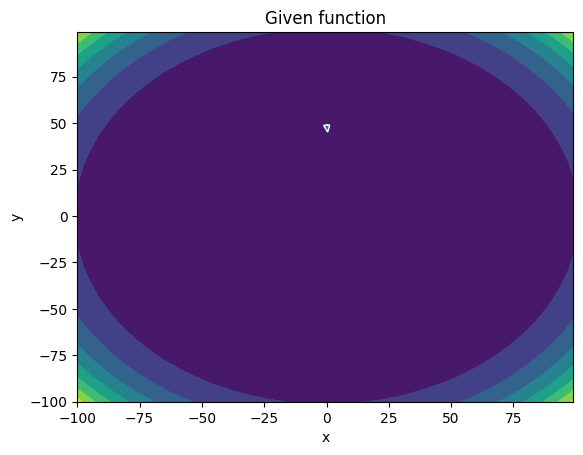

-------
Initial Coordinates:
[[ 0.05092995]
 [48.90948518]]
Final Coordinates:
[[ 0.05769635]
 [48.8100073 ]]
Gradient:
[[4.28068478e+06]
 [9.32378263e+09]]


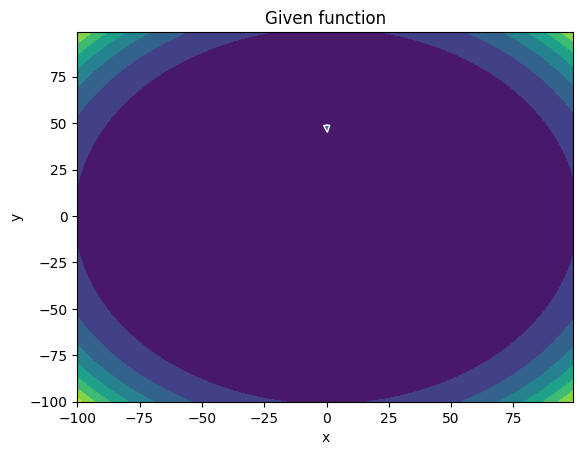

-------
Initial Coordinates:
[[ 0.05769635]
 [48.8100073 ]]
Final Coordinates:
[[ 0.05926   ]
 [48.71053163]]
Gradient:
[[5.51517174e+06]
 [9.22933235e+09]]


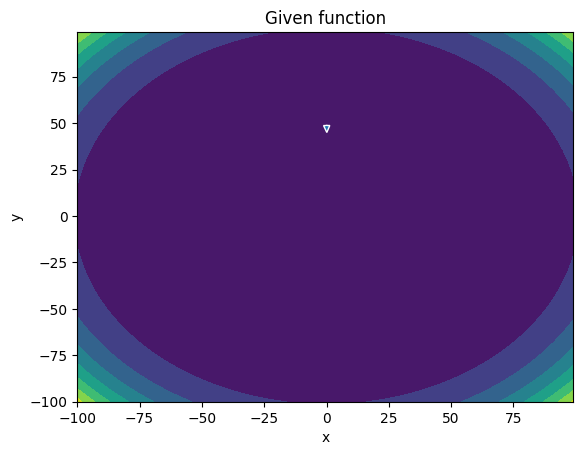

-------
Initial Coordinates:
[[ 0.05926   ]
 [48.71053163]]
Final Coordinates:
[[ 0.05553694]
 [48.6110582 ]]
Gradient:
[[5.75284529e+06]
 [9.13564685e+09]]


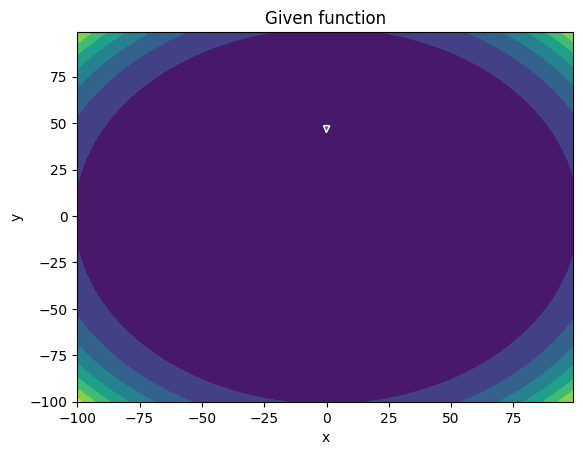

-------
Initial Coordinates:
[[ 0.05553694]
 [48.6110582 ]]
Final Coordinates:
[[4.73434647e-02]
 [4.85115870e+01]]
Gradient:
[[5.00211866e+06]
 [9.04272105e+09]]


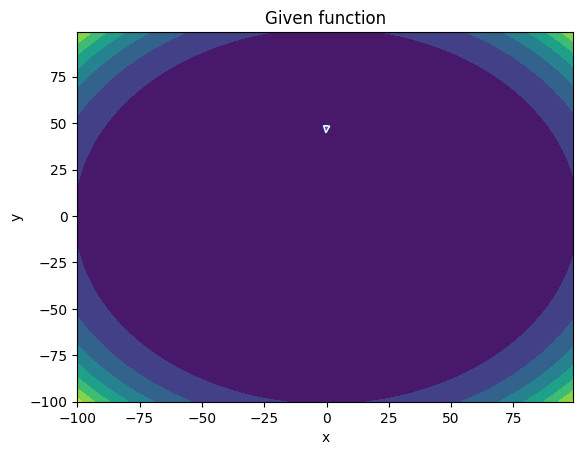

-------
Initial Coordinates:
[[4.73434647e-02]
 [4.85115870e+01]]
Final Coordinates:
[[3.62292824e-02]
 [4.84121181e+01]]
Gradient:
[[3.43782665e+06]
 [8.95055184e+09]]


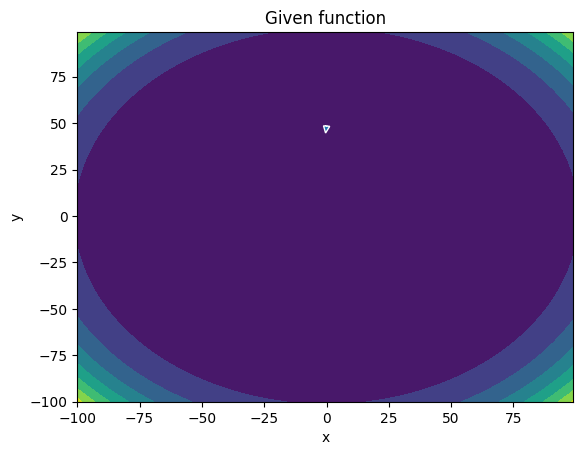

-------
Initial Coordinates:
[[3.62292824e-02]
 [4.84121181e+01]]
Final Coordinates:
[[2.42815068e-02]
 [4.83126514e+01]]
Gradient:
[[1.36386651e+06]
 [8.85913706e+09]]


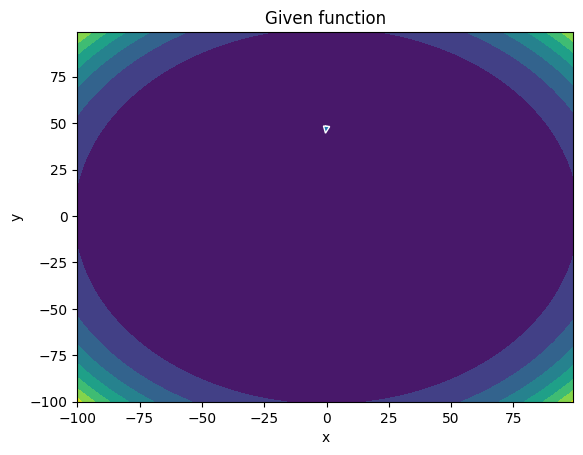

-------
Initial Coordinates:
[[2.42815068e-02]
 [4.83126514e+01]]
Final Coordinates:
[[1.38561075e-02]
 [4.82131871e+01]]
Gradient:
[[-8.27820047e+05]
 [ 8.76847428e+09]]


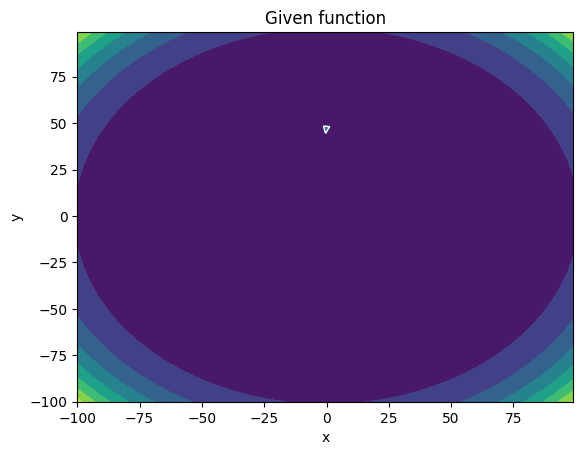

-------
Initial Coordinates:
[[1.38561075e-02]
 [4.82131871e+01]]
Final Coordinates:
[[7.11943244e-03]
 [4.81137250e+01]]
Gradient:
[[-2.70947828e+06]
 [ 8.67855971e+09]]


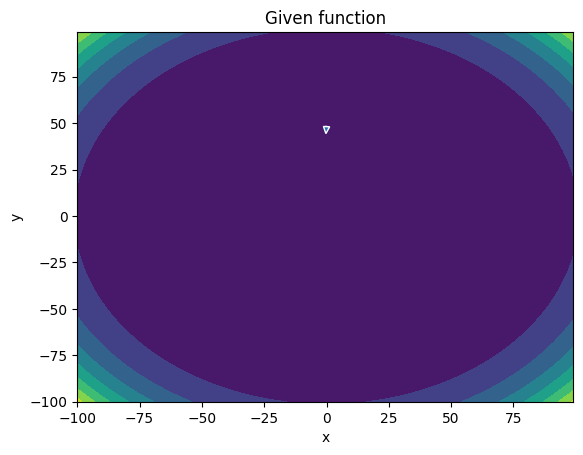

-------
Initial Coordinates:
[[7.11943244e-03]
 [4.81137250e+01]]
Final Coordinates:
[[5.46072319e-03]
 [4.80142653e+01]]
Gradient:
[[-3.90123398e+06]
 [ 8.58938818e+09]]


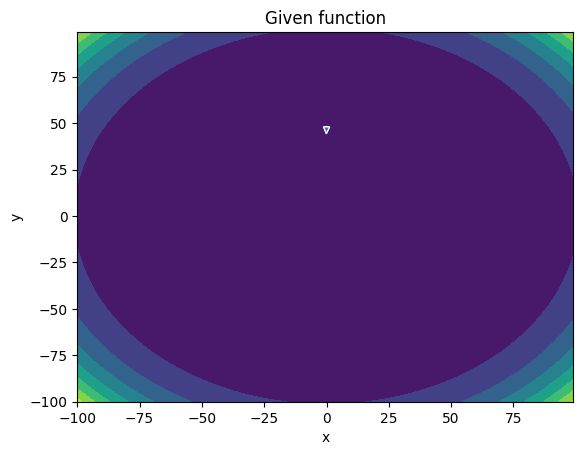

-------
Initial Coordinates:
[[5.46072319e-03]
 [4.80142653e+01]]
Final Coordinates:
[[9.09492412e-03]
 [4.79148080e+01]]
Gradient:
[[-4.17355599e+06]
 [ 8.50095404e+09]]


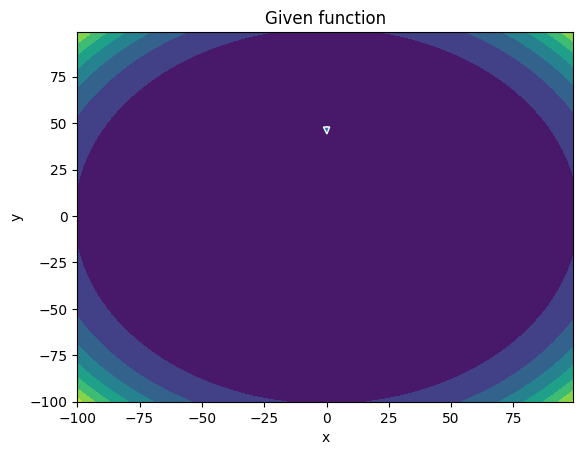

-------
Initial Coordinates:
[[9.09492412e-03]
 [4.79148080e+01]]
Final Coordinates:
[[1.70581848e-02]
 [4.78153529e+01]]
Gradient:
[[-3.51115715e+06]
 [ 8.41325235e+09]]


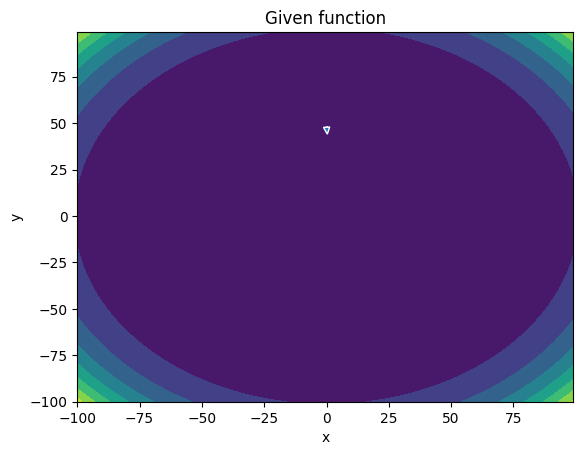

-------
Initial Coordinates:
[[1.70581848e-02]
 [4.78153529e+01]]
Final Coordinates:
[[2.74463437e-02]
 [4.77159003e+01]]
Gradient:
[[-2.10511478e+06]
 [ 8.32627913e+09]]


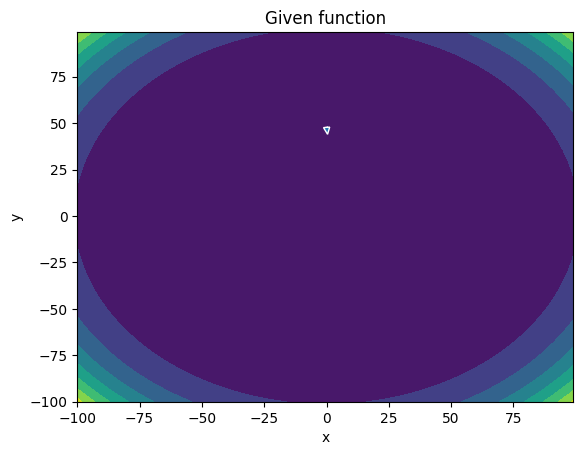

-------
Initial Coordinates:
[[2.74463437e-02]
 [4.77159003e+01]]
Final Coordinates:
[[3.77352464e-02]
 [4.76164500e+01]]
Gradient:
[[-3.03126435e+05]
 [ 8.24003054e+09]]


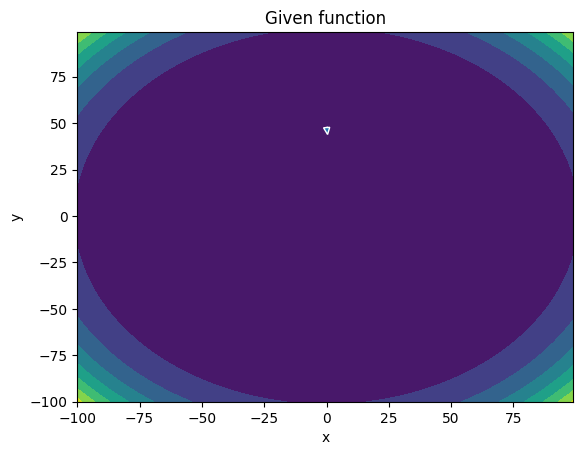

-------
Initial Coordinates:
[[3.77352464e-02]
 [4.76164500e+01]]
Final Coordinates:
[[4.52827387e-02]
 [4.75170021e+01]]
Gradient:
[[1.45204129e+06]
 [8.15450167e+09]]


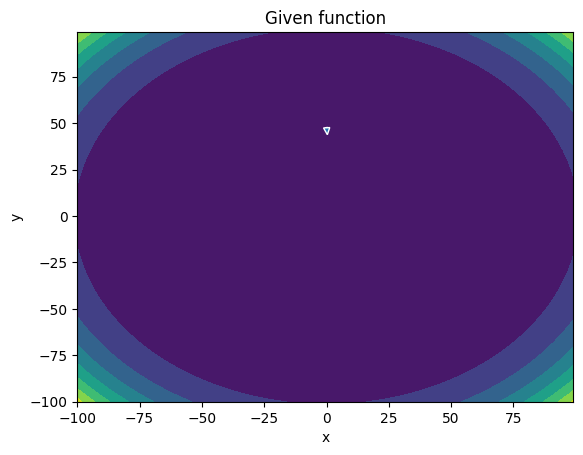

-------
Initial Coordinates:
[[4.52827387e-02]
 [4.75170021e+01]]
Final Coordinates:
[[ 0.04810512]
 [47.41755667]]
Gradient:
[[2.71210615e+06]
 [8.06968618e+09]]


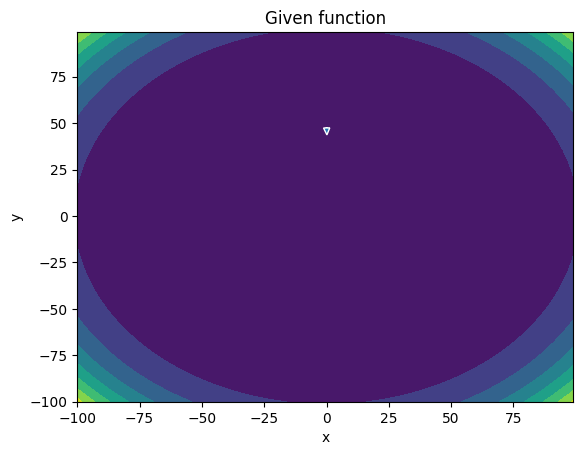

-------
Initial Coordinates:
[[ 0.04810512]
 [47.41755667]]
Final Coordinates:
[[4.55789040e-02]
 [4.73181136e+01]]
Gradient:
[[3.15472235e+06]
 [7.98557734e+09]]


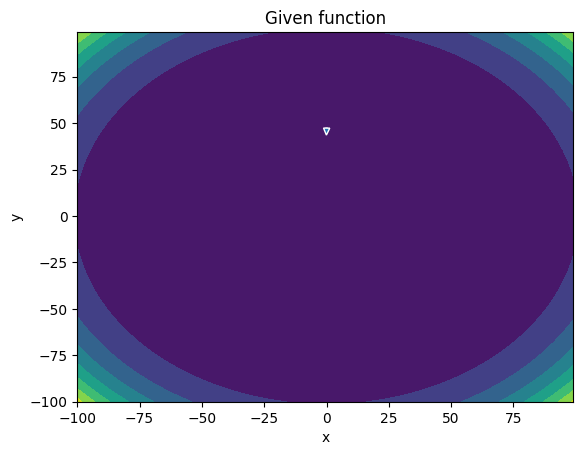

-------
Initial Coordinates:
[[4.55789040e-02]
 [4.73181136e+01]]
Final Coordinates:
[[3.86024996e-02]
 [4.72186731e+01]]
Gradient:
[[2.69587814e+06]
 [7.90216975e+09]]


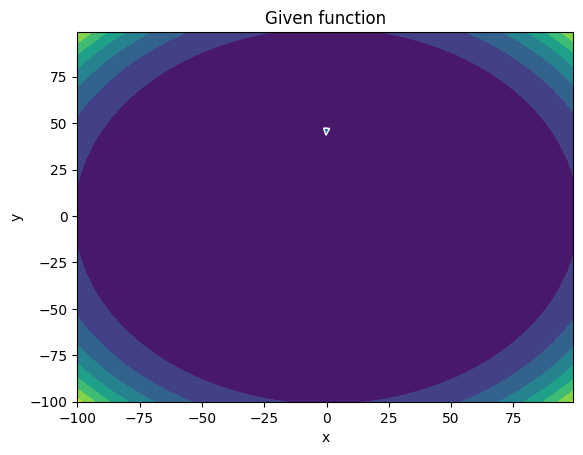

-------
Initial Coordinates:
[[3.86024996e-02]
 [4.72186731e+01]]
Final Coordinates:
[[2.93046255e-02]
 [4.71192349e+01]]
Gradient:
[[1.50698716e+06]
 [7.81946007e+09]]


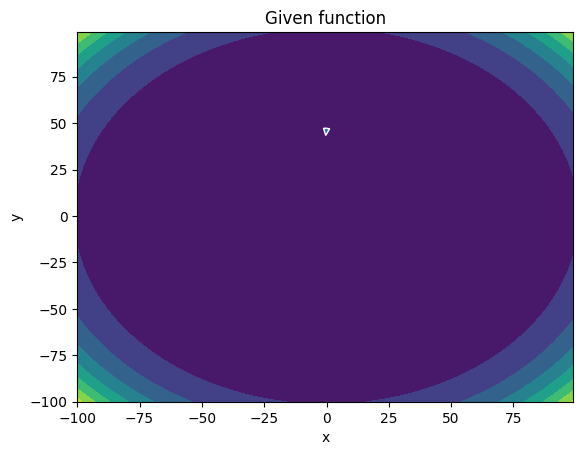

-------
Initial Coordinates:
[[2.93046255e-02]
 [4.71192349e+01]]
Final Coordinates:
[[2.05664922e-02]
 [4.70197993e+01]]
Gradient:
[[-4.36634420e+04]
 [ 7.73744606e+09]]


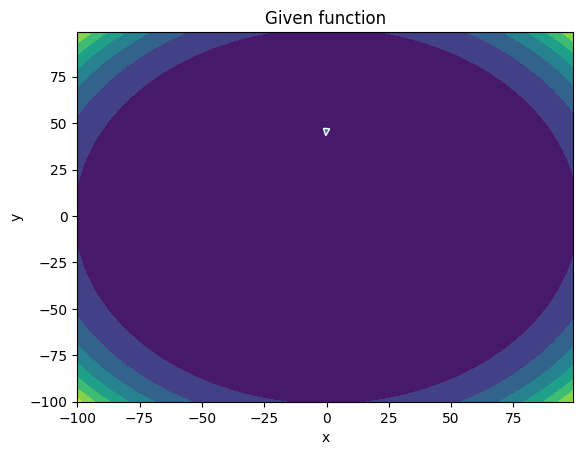

-------
Initial Coordinates:
[[2.05664922e-02]
 [4.70197993e+01]]
Final Coordinates:
[[1.52445148e-02]
 [4.69203662e+01]]
Gradient:
[[-1.47719293e+06]
 [ 7.65612498e+09]]


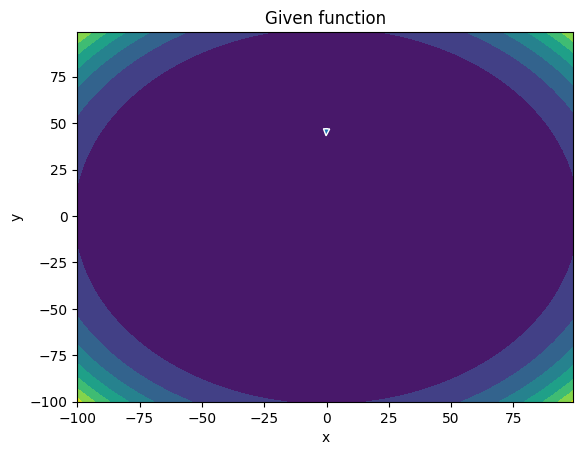

-------
Initial Coordinates:
[[1.52445148e-02]
 [4.69203662e+01]]
Final Coordinates:
[[1.50822739e-02]
 [4.68209356e+01]]
Gradient:
[[-2.33468278e+06]
 [ 7.57549273e+09]]


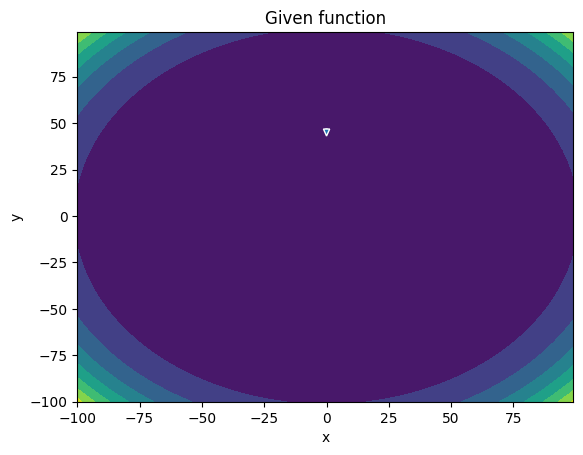

-------
Initial Coordinates:
[[1.50822739e-02]
 [4.68209356e+01]]
Final Coordinates:
[[1.99886108e-02]
 [4.67215075e+01]]
Gradient:
[[-2.35104729e+06]
 [ 7.49554452e+09]]


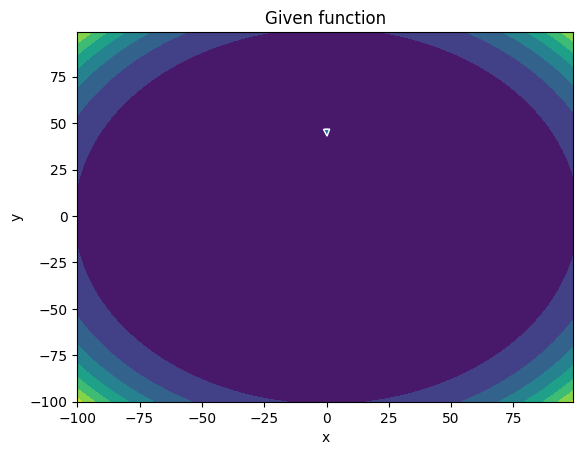

-------
Initial Coordinates:
[[1.99886108e-02]
 [4.67215075e+01]]
Final Coordinates:
[[2.81344251e-02]
 [4.66220819e+01]]
Gradient:
[[-1.56190098e+06]
 [ 7.41627589e+09]]


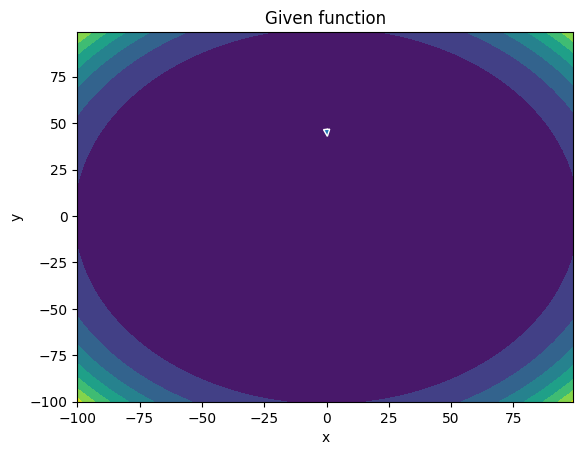

-------
Initial Coordinates:
[[2.81344251e-02]
 [4.66220819e+01]]
Final Coordinates:
[[3.65156426e-02]
 [4.65226589e+01]]
Gradient:
[[-2.75800847e+05]
 [ 7.33768278e+09]]


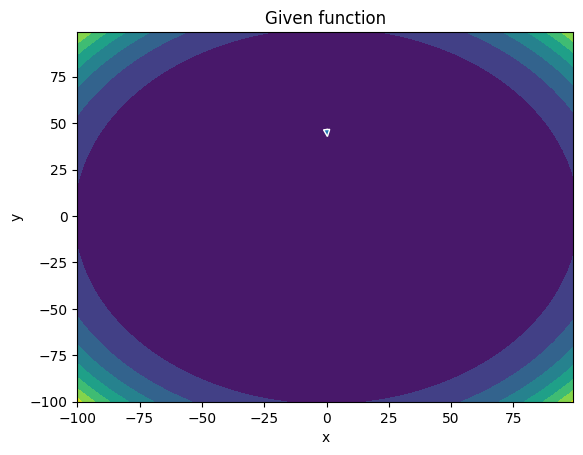

-------
Initial Coordinates:
[[3.65156426e-02]
 [4.65226589e+01]]
Final Coordinates:
[[4.18821407e-02]
 [4.64232385e+01]]
Gradient:
[[1.02528574e+06]
 [7.25976036e+09]]


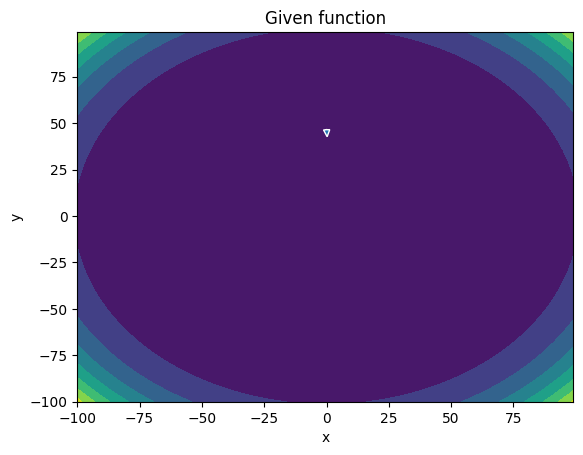

-------
Initial Coordinates:
[[4.18821407e-02]
 [4.64232385e+01]]
Final Coordinates:
[[4.21369814e-02]
 [4.63238207e+01]]
Gradient:
[[1.83745087e+06]
 [7.18250252e+09]]


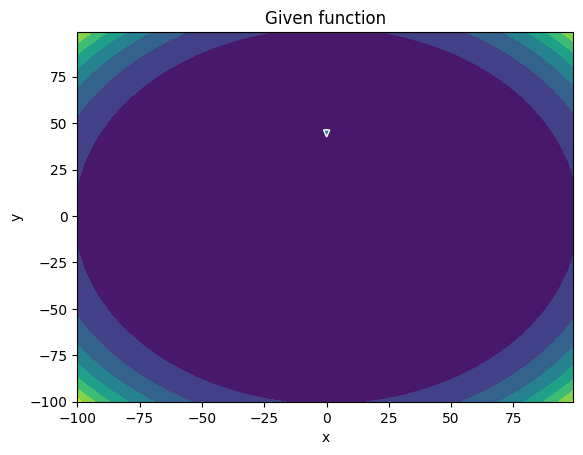

-------
Initial Coordinates:
[[4.21369814e-02]
 [4.63238207e+01]]
Final Coordinates:
[[3.73663706e-02]
 [4.62244055e+01]]
Gradient:
[[1.85099124e+06]
 [7.10590313e+09]]


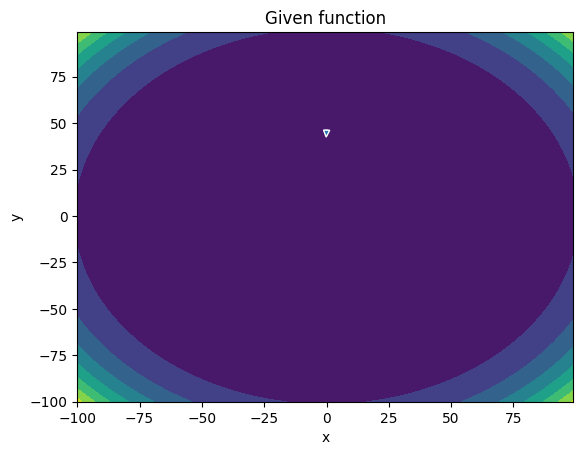

-------
Initial Coordinates:
[[3.73663706e-02]
 [4.62244055e+01]]
Final Coordinates:
[[2.9742008e-02]
 [4.6124993e+01]]
Gradient:
[[1.09930330e+06]
 [7.02995798e+09]]


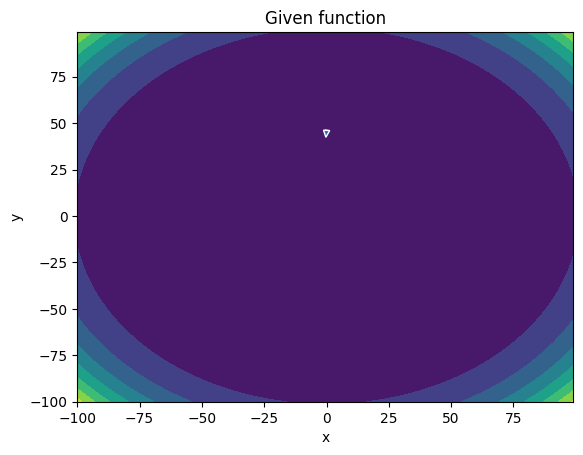

-------
Initial Coordinates:
[[2.9742008e-02]
 [4.6124993e+01]]
Final Coordinates:
[[2.27193313e-02]
 [4.60255831e+01]]
Gradient:
[[-7.02712015e+04]
 [ 6.95466463e+09]]


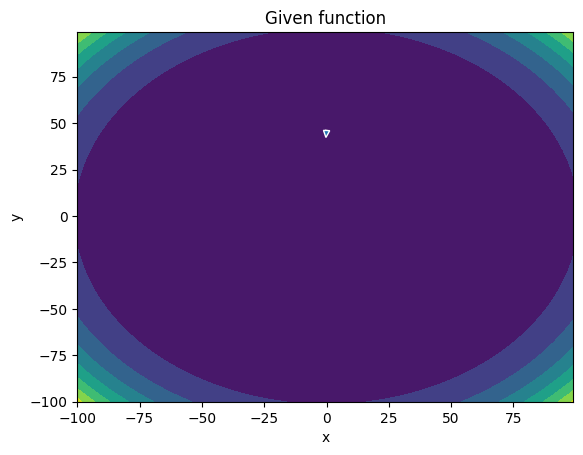

-------
Initial Coordinates:
[[2.27193313e-02]
 [4.60255831e+01]]
Final Coordinates:
[[1.96403047e-02]
 [4.59261758e+01]]
Gradient:
[[-1.12988598e+06]
 [ 6.88002065e+09]]


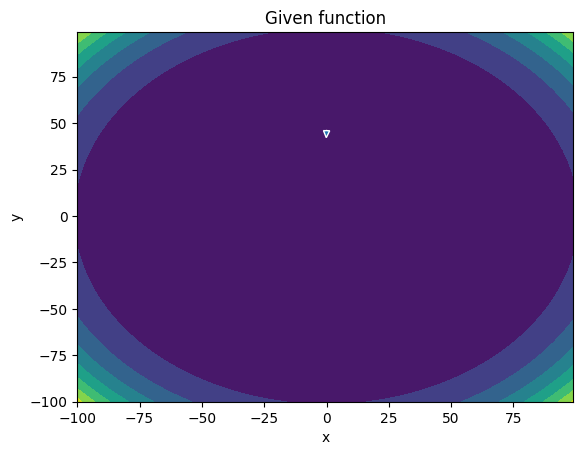

-------
Initial Coordinates:
[[1.96403047e-02]
 [4.59261758e+01]]
Final Coordinates:
[[2.19294422e-02]
 [4.58267713e+01]]
Gradient:
[[-1.58647078e+06]
 [ 6.80602244e+09]]


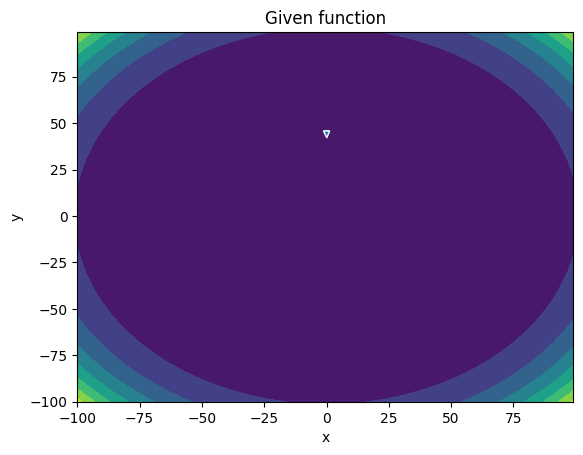

-------
Initial Coordinates:
[[2.19294422e-02]
 [4.58267713e+01]]
Final Coordinates:
[[2.83233383e-02]
 [4.57273694e+01]]
Gradient:
[[-1.24592147e+06]
 [ 6.73266569e+09]]


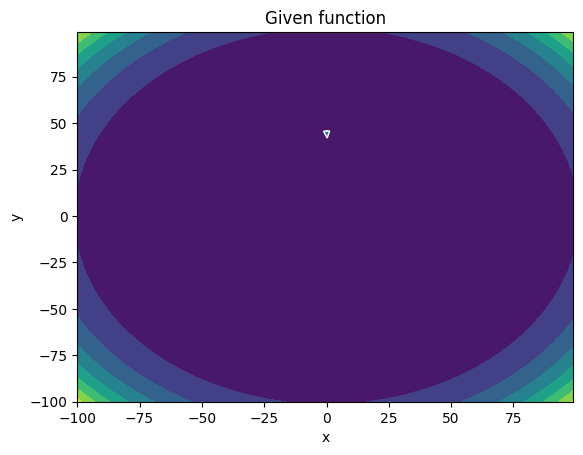

-------
Initial Coordinates:
[[2.83233383e-02]
 [4.57273694e+01]]
Final Coordinates:
[[3.55075898e-02]
 [4.56279703e+01]]
Gradient:
[[-3.12921118e+05]
 [ 6.65994620e+09]]


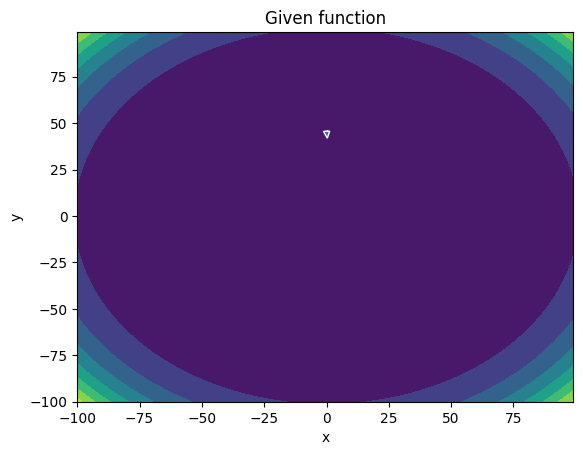

-------
Initial Coordinates:
[[3.55075898e-02]
 [4.56279703e+01]]
Final Coordinates:
[[3.95930871e-02]
 [4.55285739e+01]]
Gradient:
[[7.18172885e+05]
 [6.58785923e+09]]


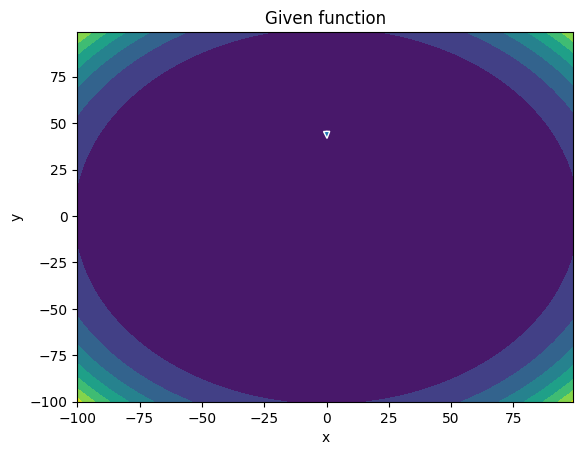

-------
Initial Coordinates:
[[3.95930871e-02]
 [4.55285739e+01]]
Final Coordinates:
[[3.83727819e-02]
 [4.54291803e+01]]
Gradient:
[[1.28752904e+06]
 [6.51639881e+09]]


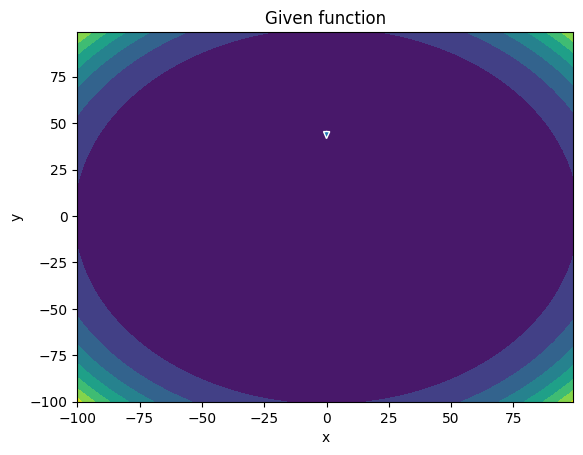

-------
Initial Coordinates:
[[3.83727819e-02]
 [4.54291803e+01]]
Final Coordinates:
[[3.27540881e-02]
 [4.53297895e+01]]
Gradient:
[[1.09356025e+06]
 [6.44555928e+09]]


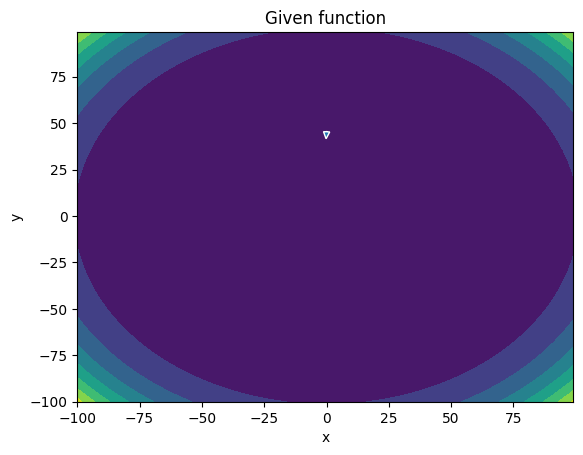

-------
Initial Coordinates:
[[3.27540881e-02]
 [4.53297895e+01]]
Final Coordinates:
[[2.62051558e-02]
 [4.52304014e+01]]
Gradient:
[[2.83787263e+05]
 [6.37533718e+09]]


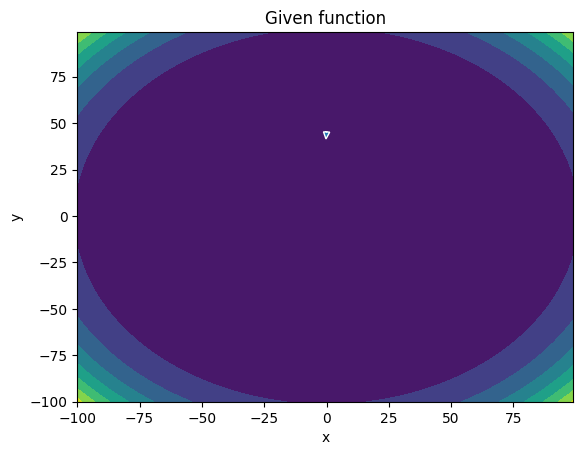

-------
Initial Coordinates:
[[2.62051558e-02]
 [4.52304014e+01]]
Final Coordinates:
[[2.29204162e-02]
 [4.51310162e+01]]
Gradient:
[[-6.41749140e+05]
 [ 6.30573044e+09]]


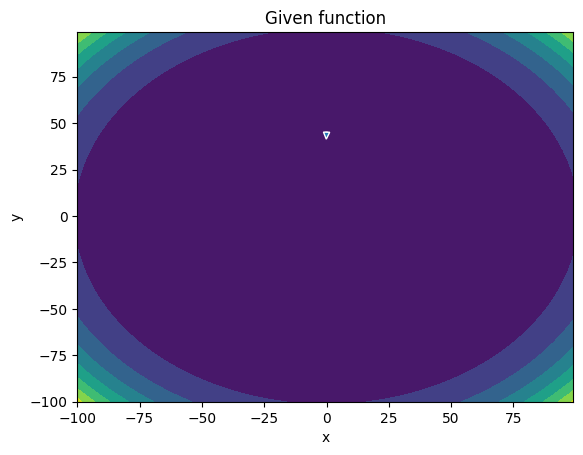

-------
Initial Coordinates:
[[2.29204162e-02]
 [4.51310162e+01]]
Final Coordinates:
[[2.50175189e-02]
 [4.50316338e+01]]
Gradient:
[[-1.09974328e+06]
 [ 6.23673628e+09]]


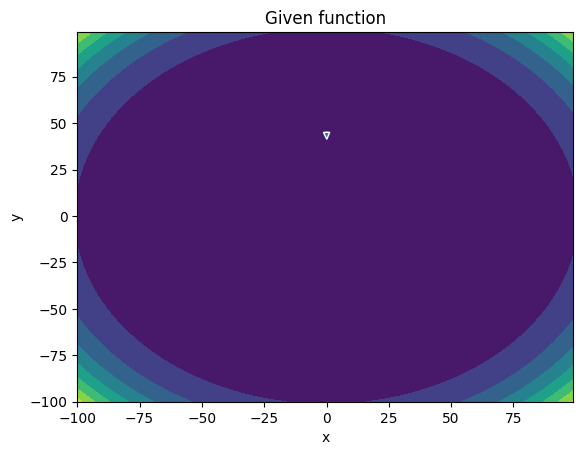

-------
Initial Coordinates:
[[2.50175189e-02]
 [4.50316338e+01]]
Final Coordinates:
[[3.09835590e-02]
 [4.49322543e+01]]
Gradient:
[[-8.11972863e+05]
 [ 6.16835087e+09]]


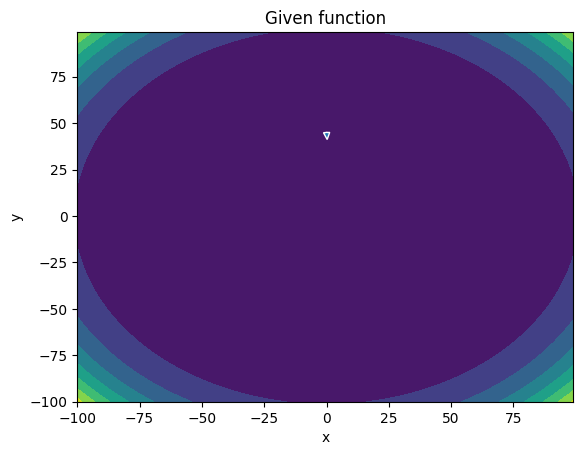

-------
Initial Coordinates:
[[3.09835590e-02]
 [4.49322543e+01]]
Final Coordinates:
[[3.66617990e-02]
 [4.48328776e+01]]
Gradient:
[[-3.54203811e+03]
 [ 6.10056995e+09]]


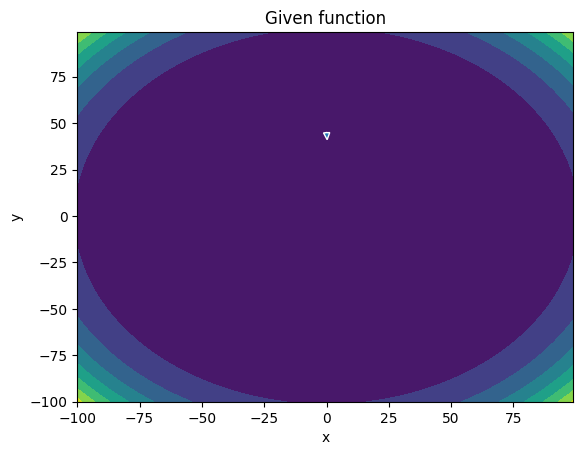

-------
Initial Coordinates:
[[3.66617990e-02]
 [4.48328776e+01]]
Final Coordinates:
[[3.79300396e-02]
 [4.47335039e+01]]
Gradient:
[[7.51913154e+05]
 [6.03338841e+09]]


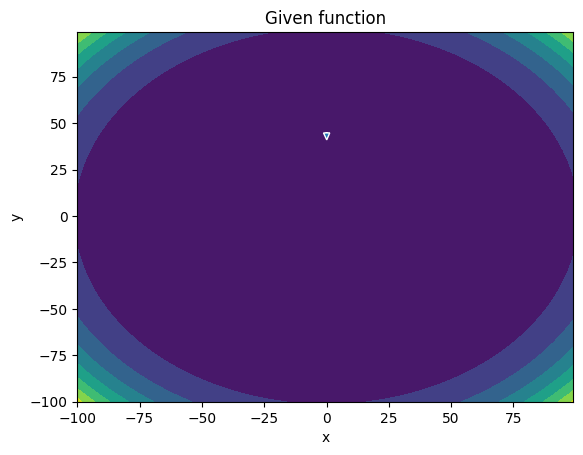

-------
Initial Coordinates:
[[3.79300396e-02]
 [4.47335039e+01]]
Final Coordinates:
[[3.40149161e-02]
 [4.46341330e+01]]
Gradient:
[[9.05336488e+05]
 [5.96680021e+09]]


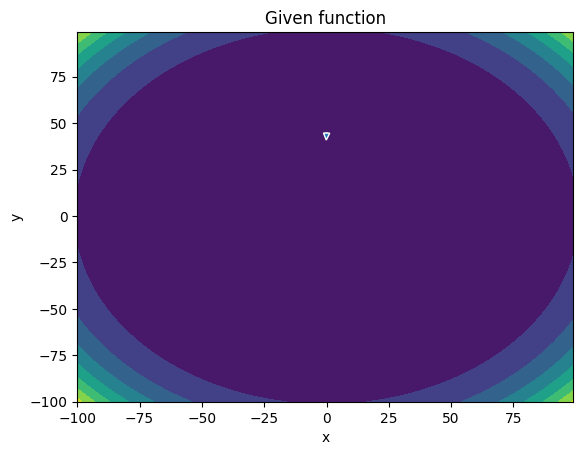

-------
Initial Coordinates:
[[3.40149161e-02]
 [4.46341330e+01]]
Final Coordinates:
[[2.81157011e-02]
 [4.45347651e+01]]
Gradient:
[[3.70187571e+05]
 [5.90080089e+09]]


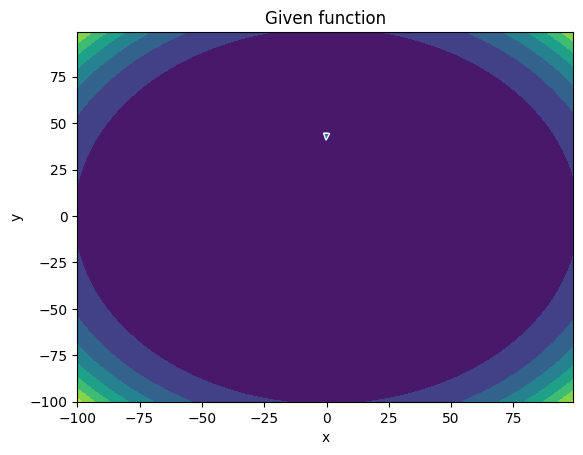

-------
Initial Coordinates:
[[2.81157011e-02]
 [4.45347651e+01]]
Final Coordinates:
[[2.51265396e-02]
 [4.44354001e+01]]
Gradient:
[[-4.15749089e+05]
 [ 5.83538827e+09]]


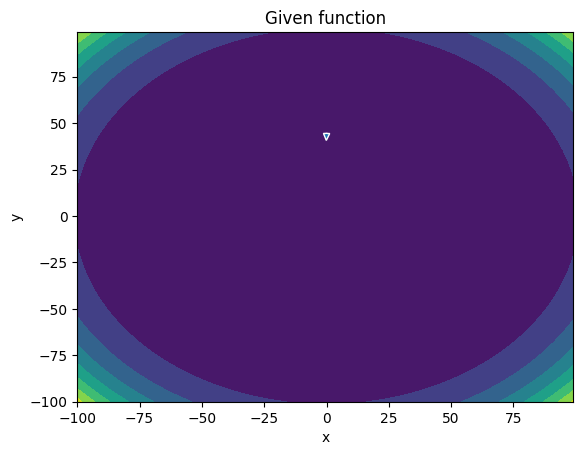

-------
Initial Coordinates:
[[2.51265396e-02]
 [4.44354001e+01]]
Final Coordinates:
[[2.75699445e-02]
 [4.43360382e+01]]
Gradient:
[[-8.09601895e+05]
 [ 5.77056012e+09]]


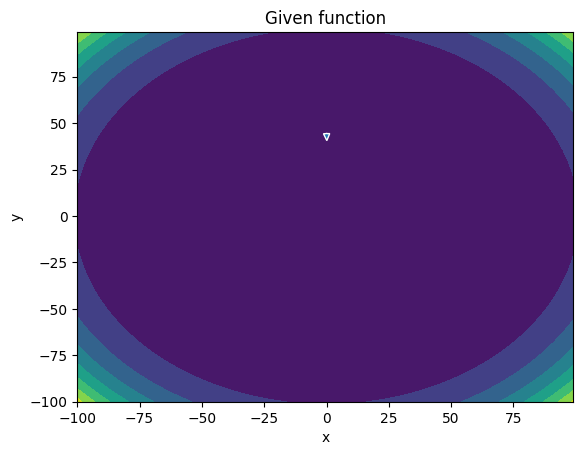

-------
Initial Coordinates:
[[2.75699445e-02]
 [4.43360382e+01]]
Final Coordinates:
[[3.32443642e-02]
 [4.42366792e+01]]
Gradient:
[[-4.96731684e+05]
 [ 5.70631296e+09]]


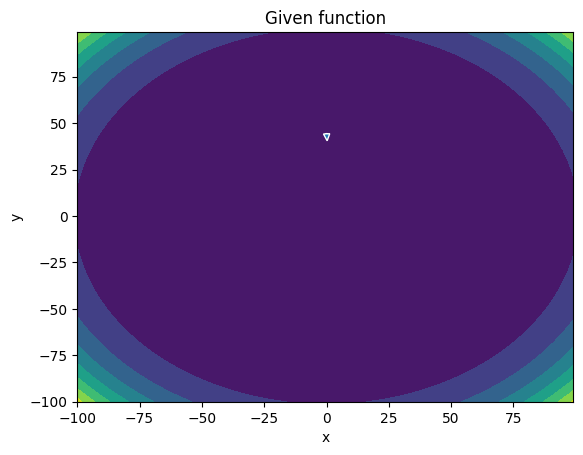

-------
Initial Coordinates:
[[3.32443642e-02]
 [4.42366792e+01]]
Final Coordinates:
[[3.70281042e-02]
 [4.41373232e+01]]
Gradient:
[[2.23017101e+05]
 [5.64264245e+09]]


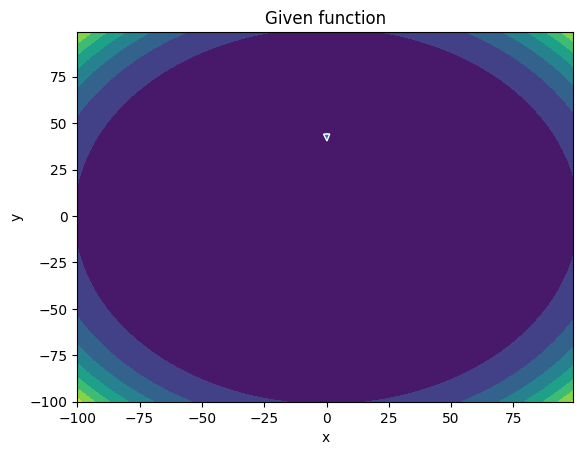

-------
Initial Coordinates:
[[3.70281042e-02]
 [4.41373232e+01]]
Final Coordinates:
[[3.54395553e-02]
 [4.40379703e+01]]
Gradient:
[[6.90708730e+05]
 [5.57954298e+09]]


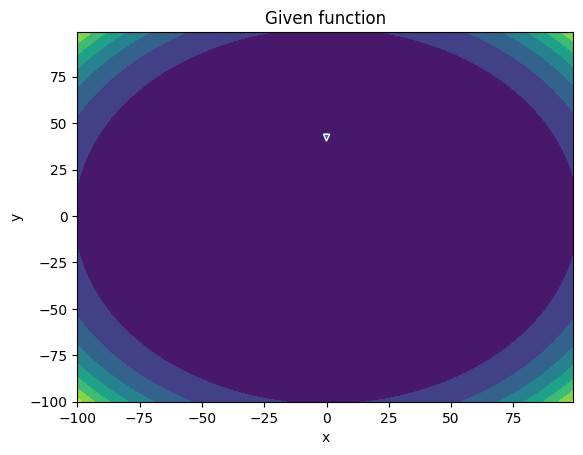

-------
Initial Coordinates:
[[3.54395553e-02]
 [4.40379703e+01]]
Final Coordinates:
[[3.02382742e-02]
 [4.39386204e+01]]
Gradient:
[[4.76427485e+05]
 [5.51700897e+09]]


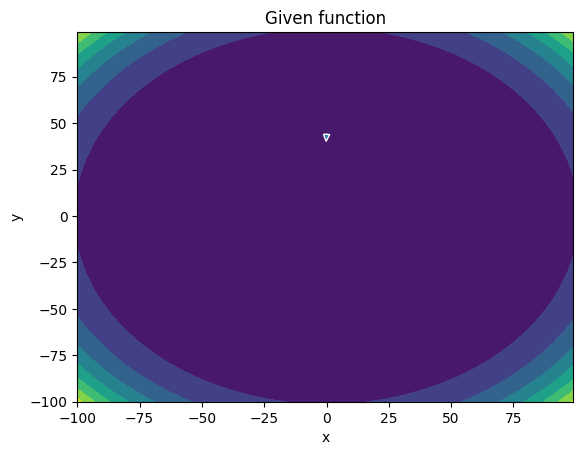

-------
Initial Coordinates:
[[3.02382742e-02]
 [4.39386204e+01]]
Final Coordinates:
[[2.68073749e-02]
 [4.38392736e+01]]
Gradient:
[[-1.82958576e+05]
 [ 5.45503749e+09]]


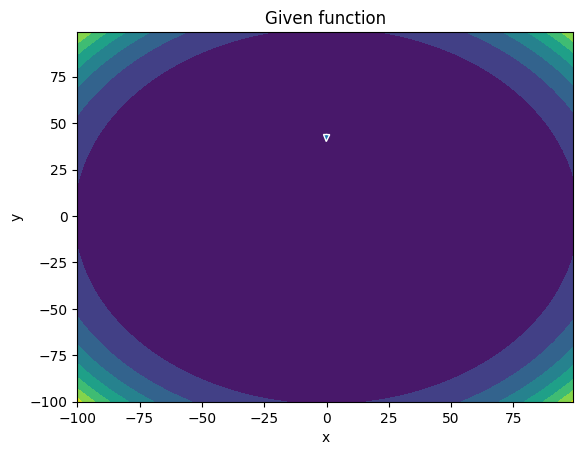

-------
Initial Coordinates:
[[2.68073749e-02]
 [4.38392736e+01]]
Final Coordinates:
[[2.88113209e-02]
 [4.37399300e+01]]
Gradient:
[[-6.12573672e+05]
 [ 5.39362682e+09]]


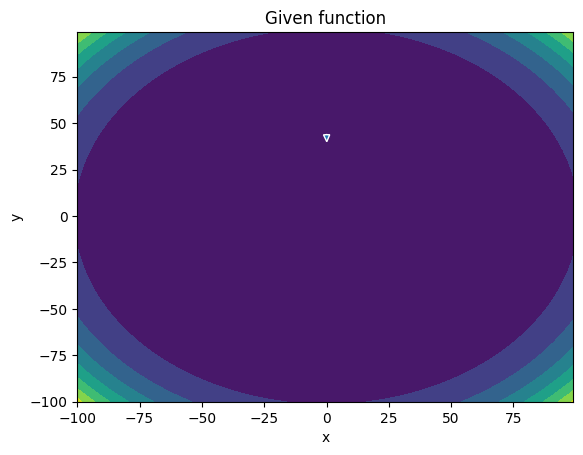

-------
Initial Coordinates:
[[2.88113209e-02]
 [4.37399300e+01]]
Final Coordinates:
[[3.40155211e-02]
 [4.36405894e+01]]
Gradient:
[[-3.71347870e+05]
 [ 5.33277404e+09]]


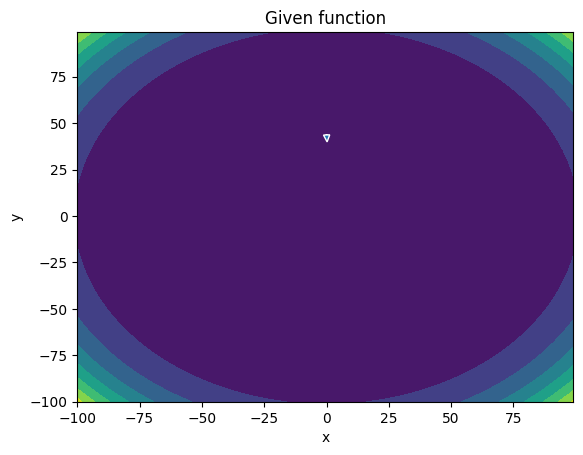

-------
Initial Coordinates:
[[3.40155211e-02]
 [4.36405894e+01]]
Final Coordinates:
[[3.65709164e-02]
 [4.35412520e+01]]
Gradient:
[[2.52457891e+05]
 [5.27247479e+09]]


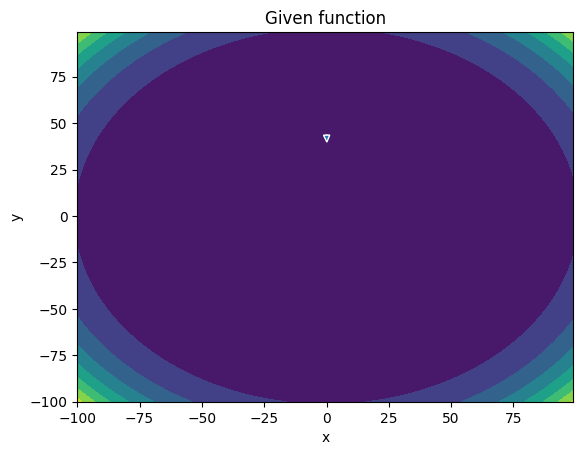

-------
Initial Coordinates:
[[3.65709164e-02]
 [4.35412520e+01]]
Final Coordinates:
[[3.36241566e-02]
 [4.34419178e+01]]
Gradient:
[[5.47595486e+05]
 [5.21272329e+09]]


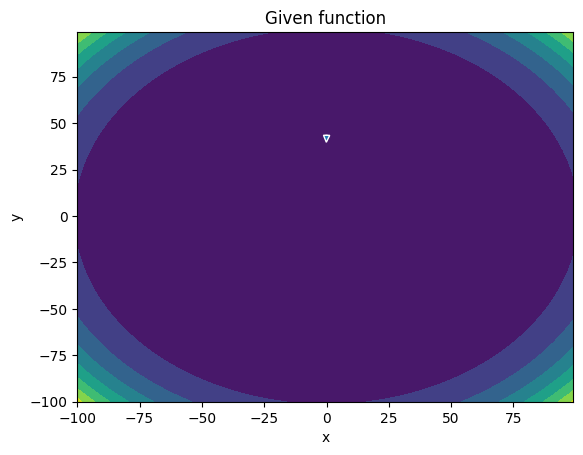

-------
Initial Coordinates:
[[3.36241566e-02]
 [4.34419178e+01]]
Final Coordinates:
[[2.89459381e-02]
 [4.33425867e+01]]
Gradient:
[[1.84095774e+05]
 [5.15351446e+09]]


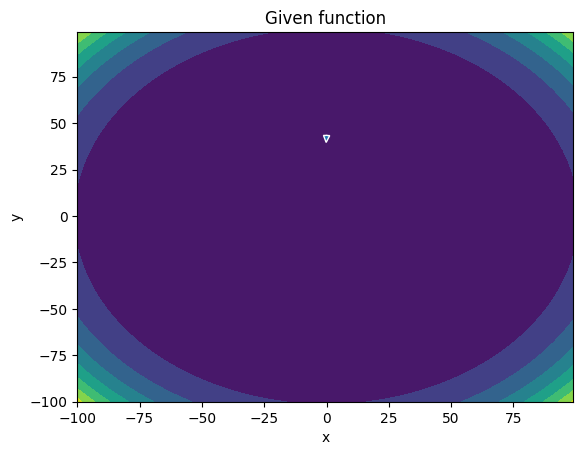

-------
Initial Coordinates:
[[2.89459381e-02]
 [4.33425867e+01]]
Final Coordinates:
[[2.85807305e-02]
 [4.32432589e+01]]
Gradient:
[[-3.76554307e+05]
 [ 5.09484625e+09]]


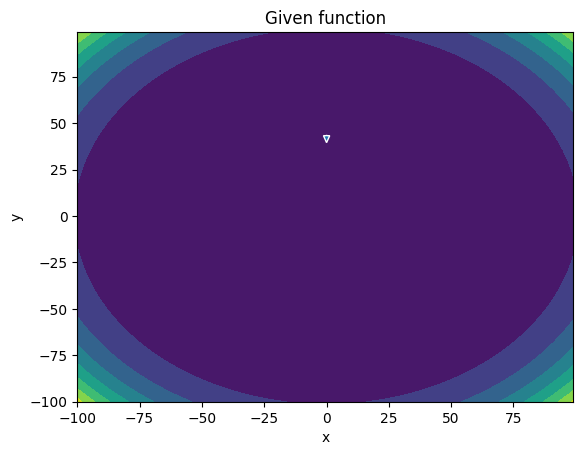

-------
Initial Coordinates:
[[2.85807305e-02]
 [4.32432589e+01]]
Final Coordinates:
[[3.29783989e-02]
 [4.31439343e+01]]
Gradient:
[[-4.24290188e+05]
 [ 5.03671686e+09]]


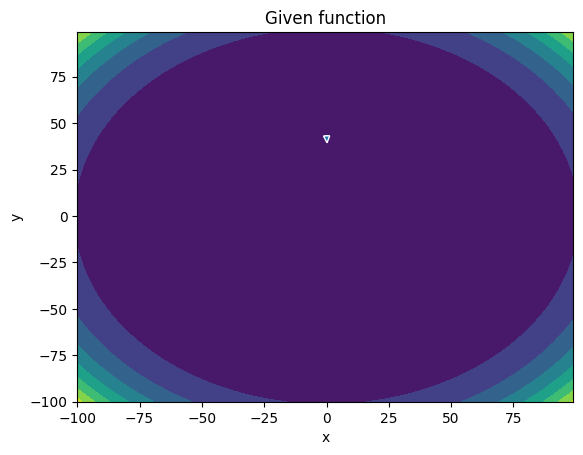

-------
Initial Coordinates:
[[3.29783989e-02]
 [4.31439343e+01]]
Final Coordinates:
[[3.62194676e-02]
 [4.30446130e+01]]
Gradient:
[[7.89309334e+04]
 [4.97912265e+09]]


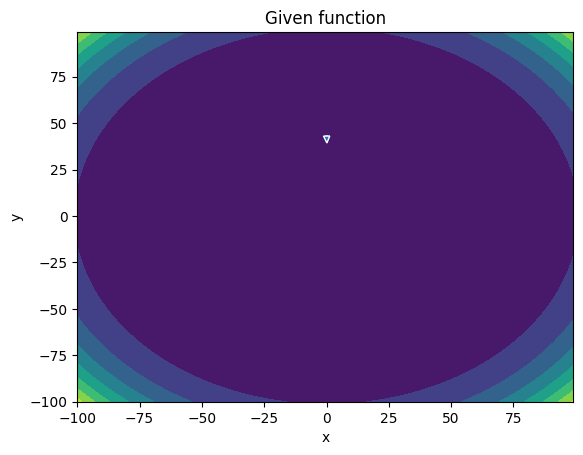

-------
Initial Coordinates:
[[3.62194676e-02]
 [4.30446130e+01]]
Final Coordinates:
[[3.38625606e-02]
 [4.29452950e+01]]
Gradient:
[[4.40567849e+05]
 [4.92205811e+09]]


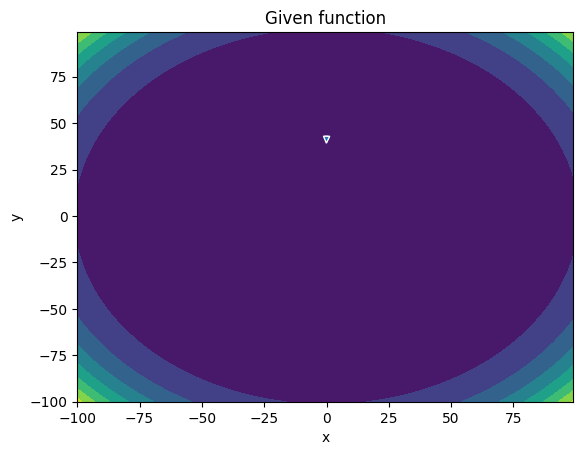

-------
Initial Coordinates:
[[3.38625606e-02]
 [4.29452950e+01]]
Final Coordinates:
[[2.95634337e-02]
 [4.28459802e+01]]
Gradient:
[[1.60798327e+05]
 [4.86551774e+09]]


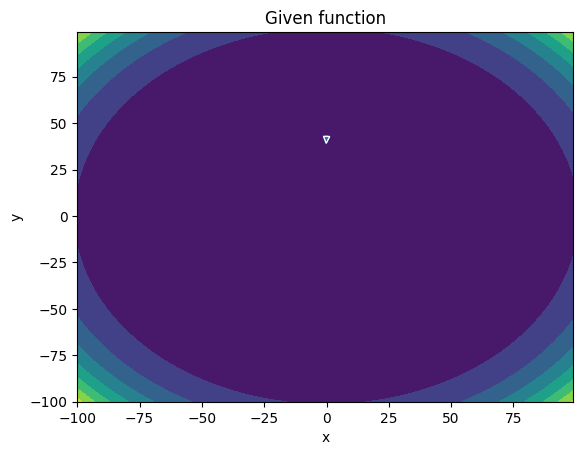

-------
Initial Coordinates:
[[2.95634337e-02]
 [4.28459802e+01]]
Final Coordinates:
[[2.99824459e-02]
 [4.27466689e+01]]
Gradient:
[[-3.32080071e+05]
 [ 4.80949942e+09]]


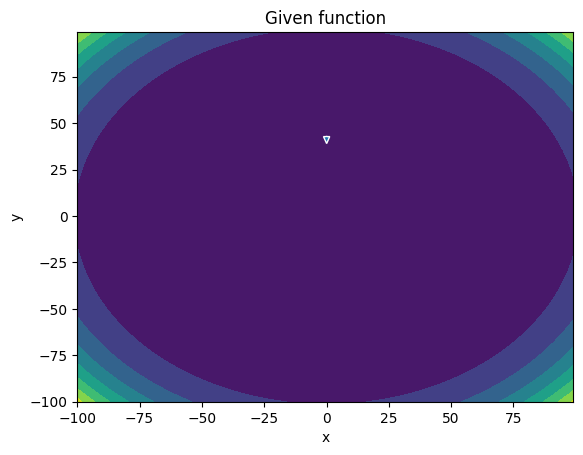

-------
Initial Coordinates:
[[2.99824459e-02]
 [4.27466689e+01]]
Final Coordinates:
[[3.44559635e-02]
 [4.26473608e+01]]
Gradient:
[[-2.90785227e+05]
 [ 4.75400161e+09]]


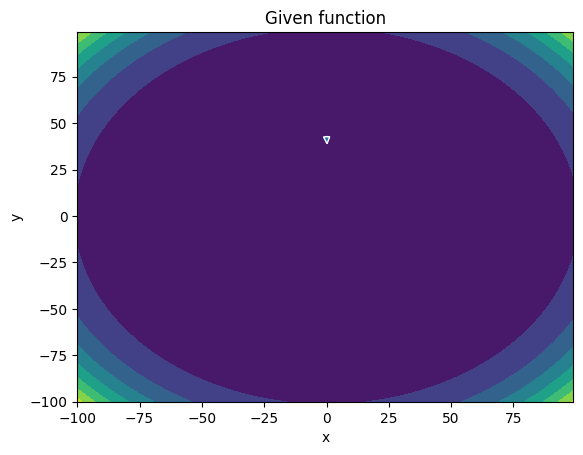

-------
Initial Coordinates:
[[3.44559635e-02]
 [4.26473608e+01]]
Final Coordinates:
[[3.57837827e-02]
 [4.25480562e+01]]
Gradient:
[[1.96822815e+05]
 [4.69902047e+09]]


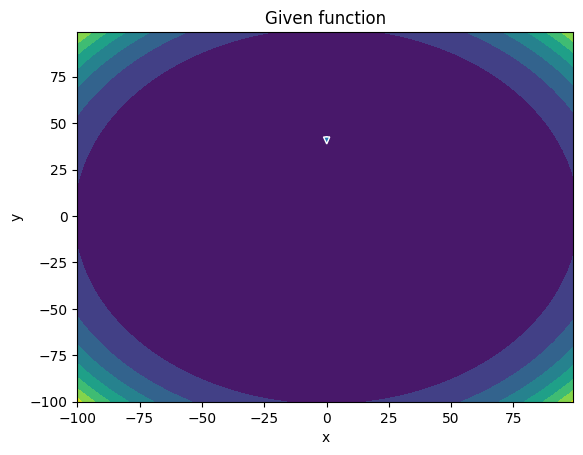

-------
Initial Coordinates:
[[3.57837827e-02]
 [4.25480562e+01]]
Final Coordinates:
[[3.19450816e-02]
 [4.24487549e+01]]
Gradient:
[[3.31722632e+05]
 [4.64455003e+09]]


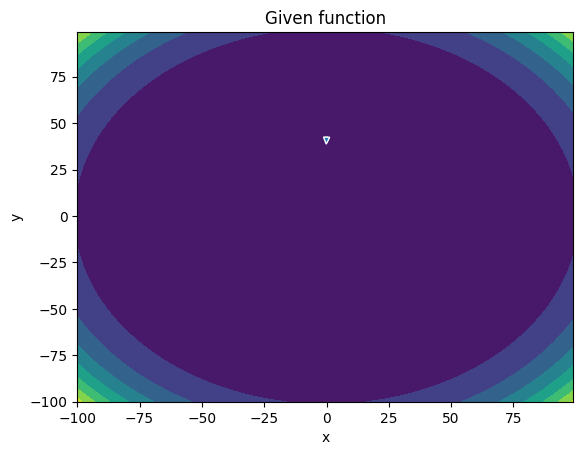

-------
Initial Coordinates:
[[3.19450816e-02]
 [4.24487549e+01]]
Final Coordinates:
[[2.98417459e-02]
 [4.23494571e+01]]
Gradient:
[[-9.51093068e+04]
 [ 4.59058590e+09]]


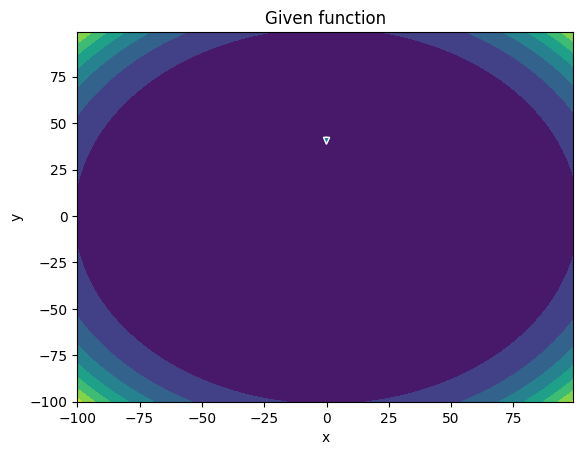

-------
Initial Coordinates:
[[2.98417459e-02]
 [4.23494571e+01]]
Final Coordinates:
[[3.33685182e-02]
 [4.22501627e+01]]
Gradient:
[[-3.27991540e+05]
 [ 4.53712699e+09]]


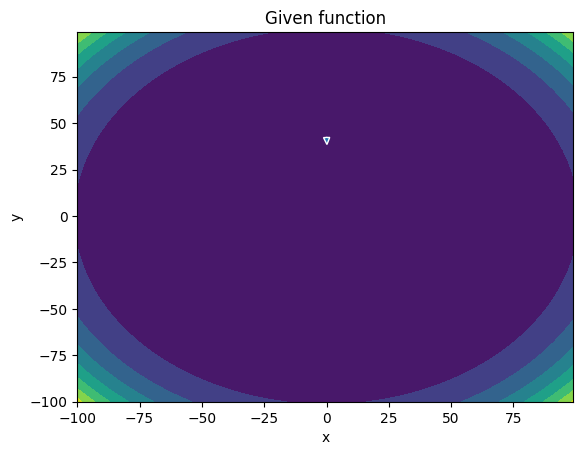

-------
Initial Coordinates:
[[3.33685182e-02]
 [4.22501627e+01]]
Final Coordinates:
[[3.59817960e-02]
 [4.21508718e+01]]
Gradient:
[[4.14634053e+04]
 [4.48417085e+09]]


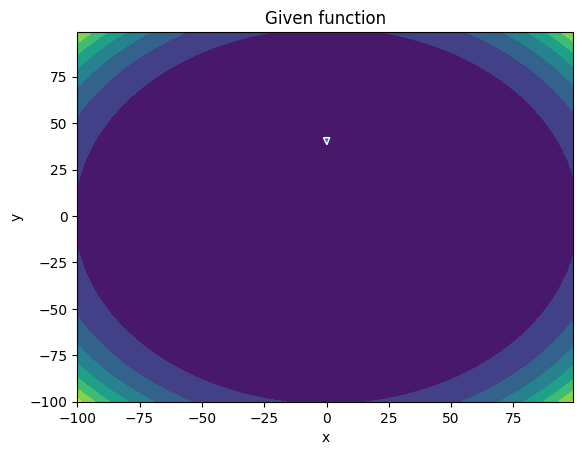

-------
Initial Coordinates:
[[3.59817960e-02]
 [4.21508718e+01]]
Final Coordinates:
[[3.27866599e-02]
 [4.20515845e+01]]
Gradient:
[[3.07875154e+05]
 [4.43171193e+09]]


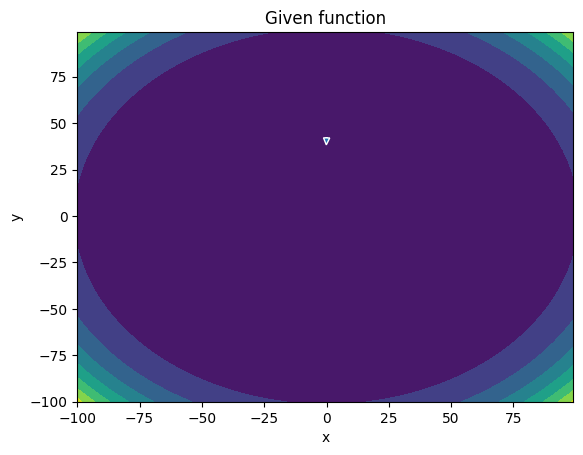

-------
Initial Coordinates:
[[3.27866599e-02]
 [4.20515845e+01]]
Final Coordinates:
[[3.04542697e-02]
 [4.19523006e+01]]
Gradient:
[[-3.61924746e+04]
 [ 4.37974493e+09]]


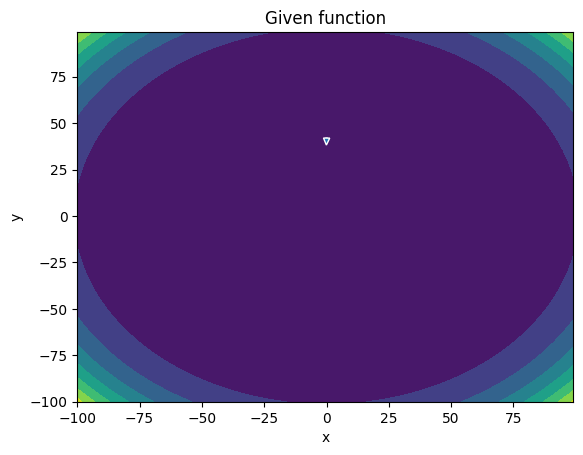

-------
Initial Coordinates:
[[3.04542697e-02]
 [4.19523006e+01]]
Final Coordinates:
[[3.39726349e-02]
 [4.18530203e+01]]
Gradient:
[[-2.84774786e+05]
 [ 4.32826871e+09]]


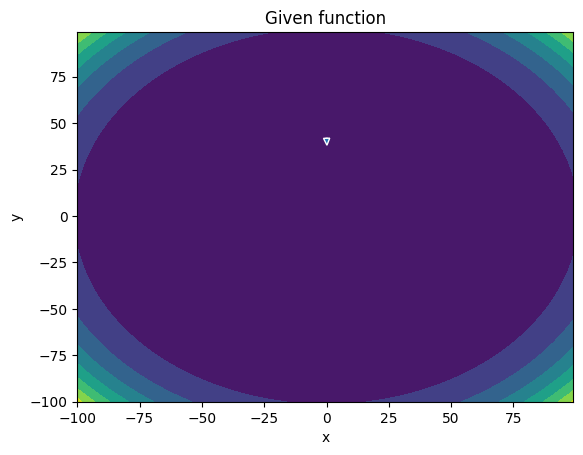

-------
Initial Coordinates:
[[3.39726349e-02]
 [4.18530203e+01]]
Final Coordinates:
[[3.58390016e-02]
 [4.17537436e+01]]
Gradient:
[[6.97087961e+04]
 [4.27728124e+09]]


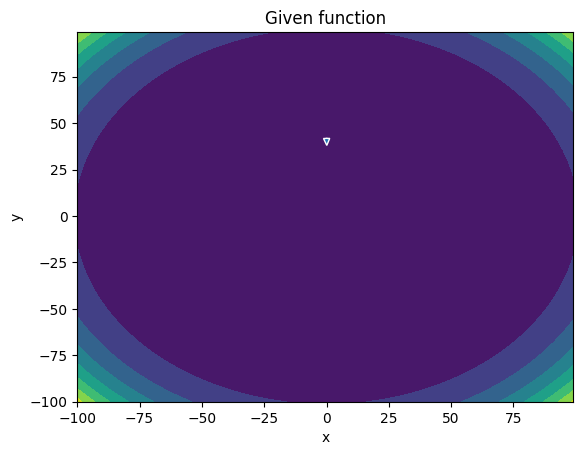

-------
Initial Coordinates:
[[3.58390016e-02]
 [4.17537436e+01]]
Final Coordinates:
[[3.21149914e-02]
 [4.16544705e+01]]
Gradient:
[[2.50116081e+05]
 [4.22677674e+09]]


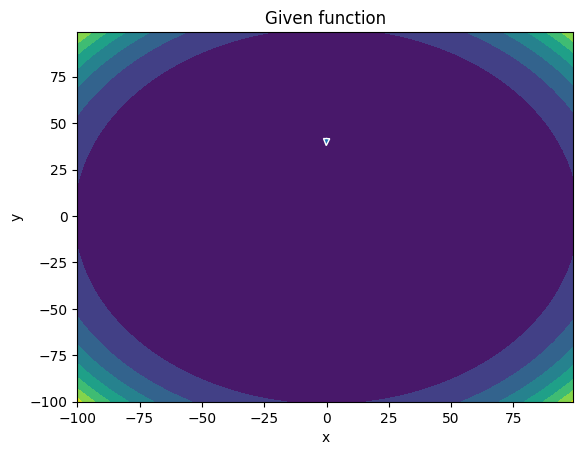

-------
Initial Coordinates:
[[3.21149914e-02]
 [4.16544705e+01]]
Final Coordinates:
[[3.16708938e-02]
 [4.15552011e+01]]
Gradient:
[[-1.33947297e+05]
 [ 4.17675037e+09]]


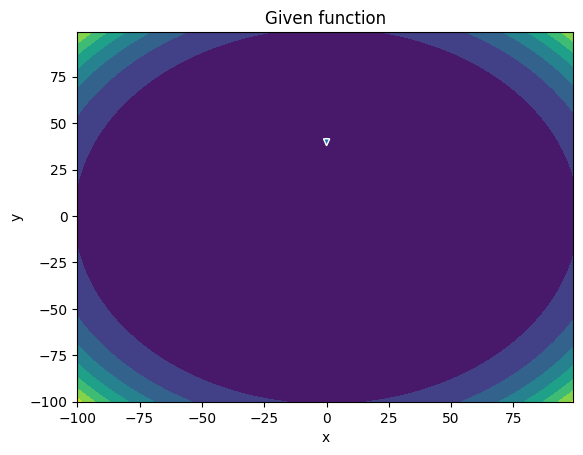

-------
Initial Coordinates:
[[3.16708938e-02]
 [4.15552011e+01]]
Final Coordinates:
[[3.56765431e-02]
 [4.14559353e+01]]
Gradient:
[[-1.84760386e+05]
 [ 4.12720163e+09]]


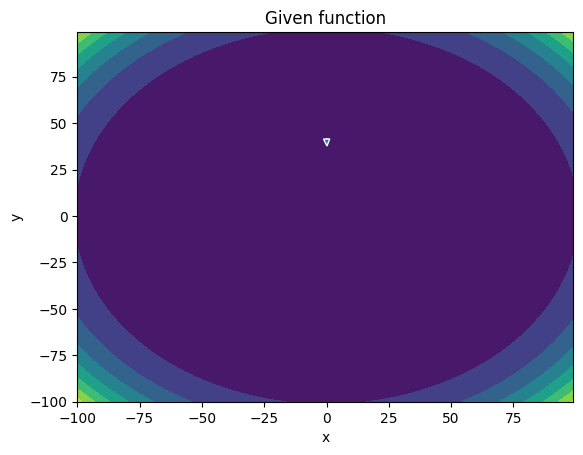

-------
Initial Coordinates:
[[3.56765431e-02]
 [4.14559353e+01]]
Final Coordinates:
[[3.43599543e-02]
 [4.13566732e+01]]
Gradient:
[[2.03460571e+05]
 [4.07812743e+09]]


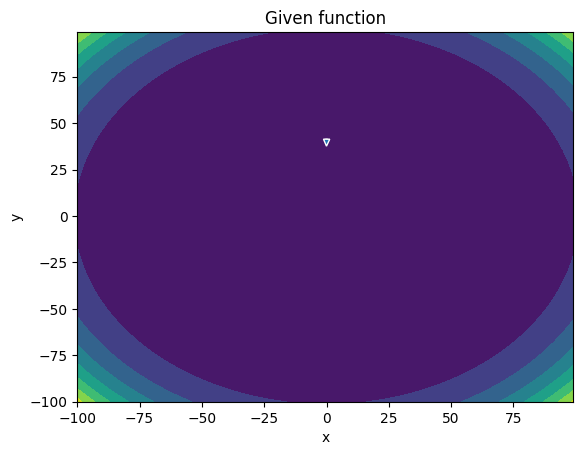

-------
Initial Coordinates:
[[3.43599543e-02]
 [4.13566732e+01]]
Final Coordinates:
[[3.14017072e-02]
 [4.12574148e+01]]
Gradient:
[[6.52681557e+04]
 [4.02952122e+09]]


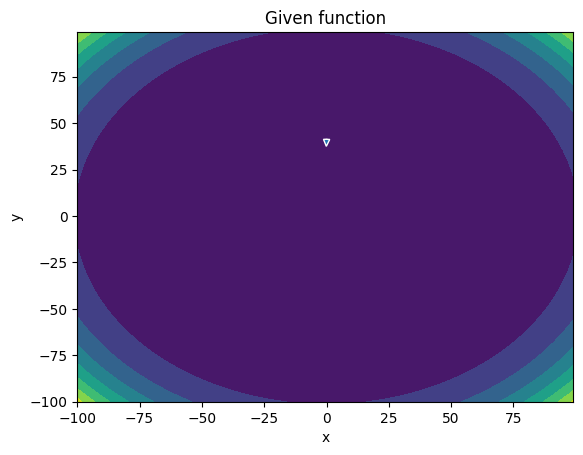

-------
Initial Coordinates:
[[3.14017072e-02]
 [4.12574148e+01]]
Final Coordinates:
[[3.48520852e-02]
 [4.11581602e+01]]
Gradient:
[[-2.28892348e+05]
 [ 3.98138085e+09]]


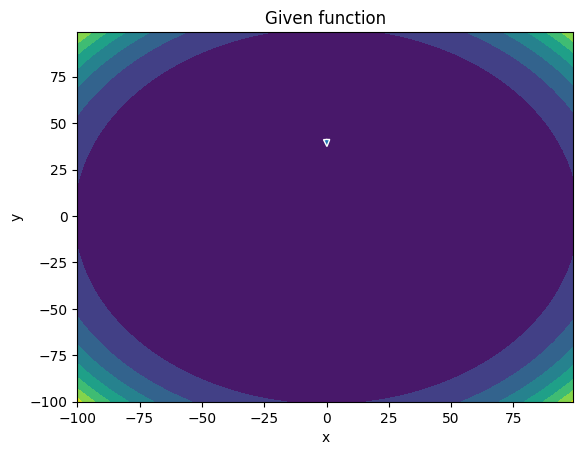

-------
Initial Coordinates:
[[3.48520852e-02]
 [4.11581602e+01]]
Final Coordinates:
[[3.53940670e-02]
 [4.10589093e+01]]
Gradient:
[[9.55550229e+04]
 [3.93370541e+09]]


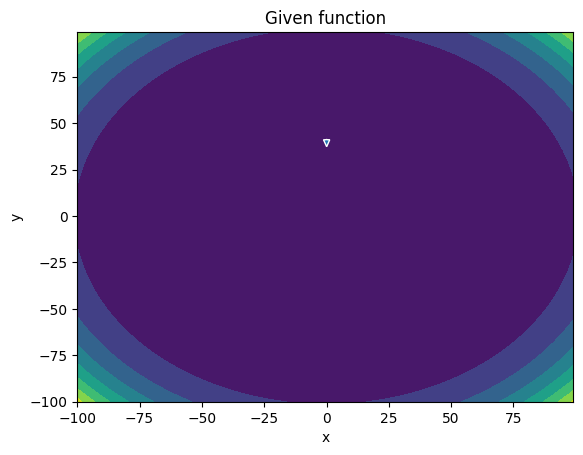

-------
Initial Coordinates:
[[3.53940670e-02]
 [4.10589093e+01]]
Final Coordinates:
[[3.17927050e-02]
 [4.09596623e+01]]
Gradient:
[[1.38228851e+05]
 [3.88648865e+09]]


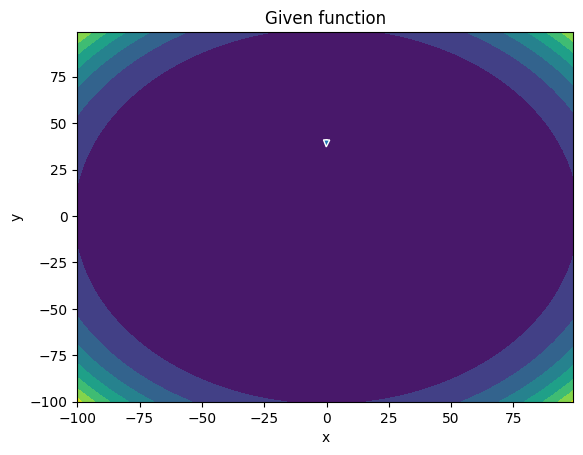

-------
Initial Coordinates:
[[3.17927050e-02]
 [4.09596623e+01]]
Final Coordinates:
[[3.48543203e-02]
 [4.08604190e+01]]
Gradient:
[[-2.08704962e+05]
 [ 3.83972685e+09]]


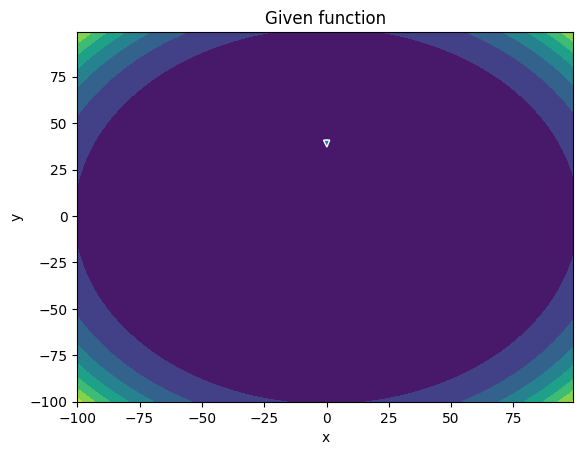

-------
Initial Coordinates:
[[3.48543203e-02]
 [4.08604190e+01]]
Final Coordinates:
[[3.54884642e-02]
 [4.07611797e+01]]
Gradient:
[[7.01070314e+04]
 [3.79342001e+09]]


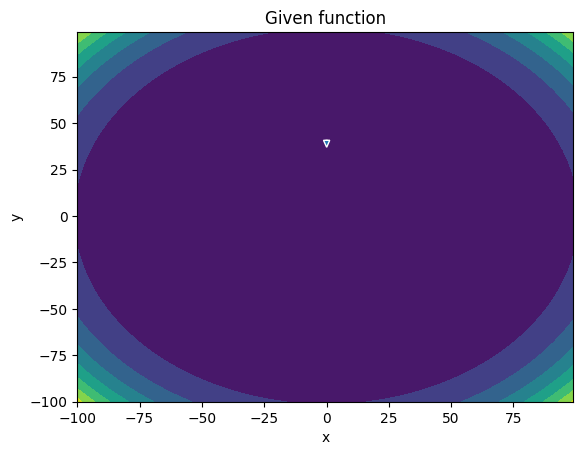

-------
Initial Coordinates:
[[3.54884642e-02]
 [4.07611797e+01]]
Final Coordinates:
[[3.20311563e-02]
 [4.06619442e+01]]
Gradient:
[[1.20140993e+05]
 [3.74756204e+09]]


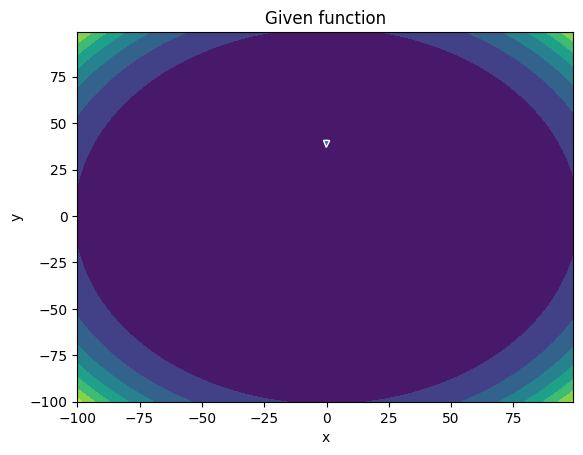

-------
Initial Coordinates:
[[3.20311563e-02]
 [4.06619442e+01]]
Final Coordinates:
[[3.58954049e-02]
 [4.05627127e+01]]
Gradient:
[[-2.03670101e+05]
 [ 3.70214913e+09]]


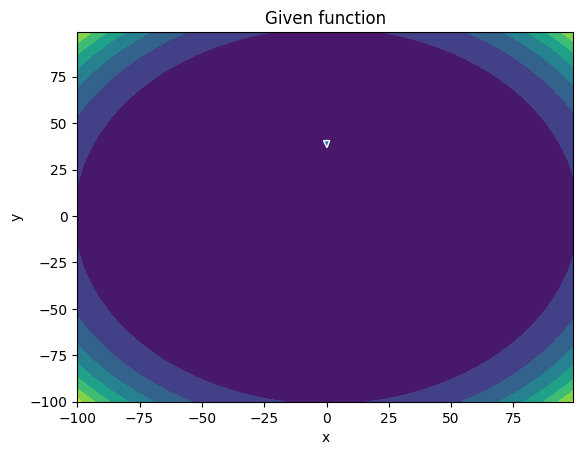

-------
Initial Coordinates:
[[3.58954049e-02]
 [4.05627127e+01]]
Final Coordinates:
[[3.44833607e-02]
 [4.04634851e+01]]
Gradient:
[[1.39447242e+05]
 [3.65718148e+09]]


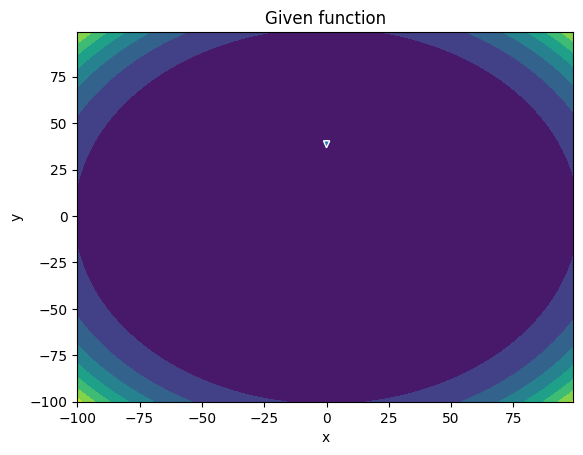

-------
Initial Coordinates:
[[3.44833607e-02]
 [4.04634851e+01]]
Final Coordinates:
[[3.29770964e-02]
 [4.03642615e+01]]
Gradient:
[[4.38322352e+03]
 [3.61265198e+09]]


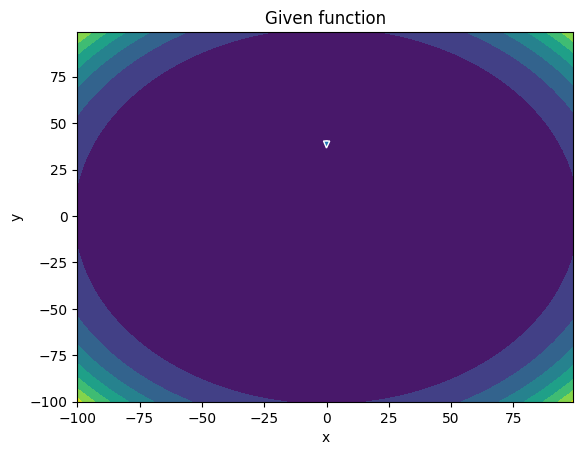

-------
Initial Coordinates:
[[3.29770964e-02]
 [4.03642615e+01]]
Final Coordinates:
[[3.69583467e-02]
 [4.02650418e+01]]
Gradient:
[[-1.36430822e+05]
 [ 3.56855900e+09]]


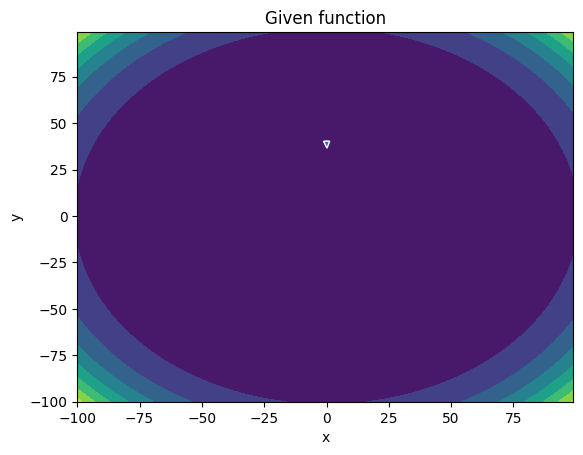

-------
Initial Coordinates:
[[3.69583467e-02]
 [4.02650418e+01]]
Final Coordinates:
[[3.23142103e-02]
 [4.01658263e+01]]
Gradient:
[[2.06281632e+05]
 [3.52490097e+09]]


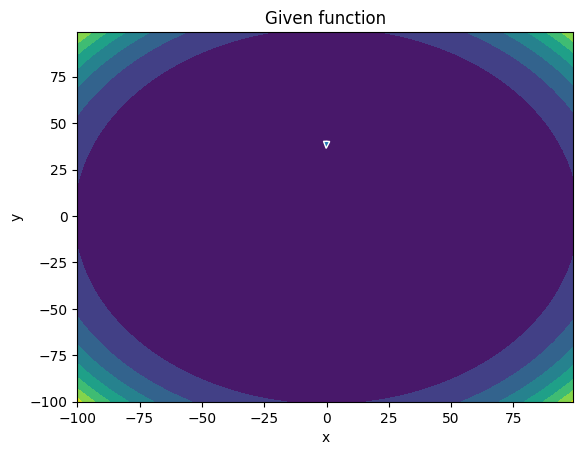

-------
Initial Coordinates:
[[3.23142103e-02]
 [4.01658263e+01]]
Final Coordinates:
[[3.64811464e-02]
 [4.00666148e+01]]
Gradient:
[[-2.06073346e+05]
 [ 3.48167042e+09]]


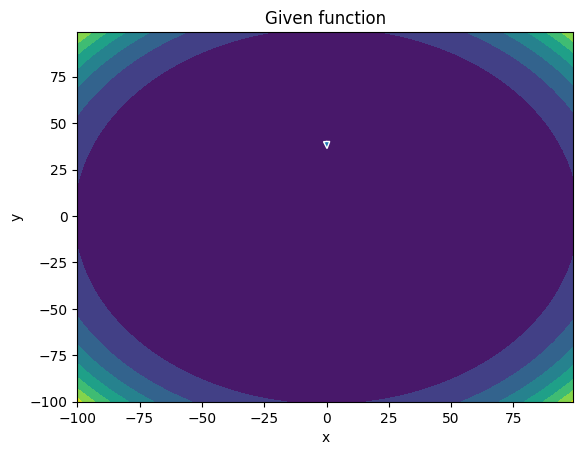

-------
Initial Coordinates:
[[3.64811464e-02]
 [4.00666148e+01]]
Final Coordinates:
[[3.41732533e-02]
 [3.99674074e+01]]
Gradient:
[[1.46530603e+05]
 [3.43886938e+09]]


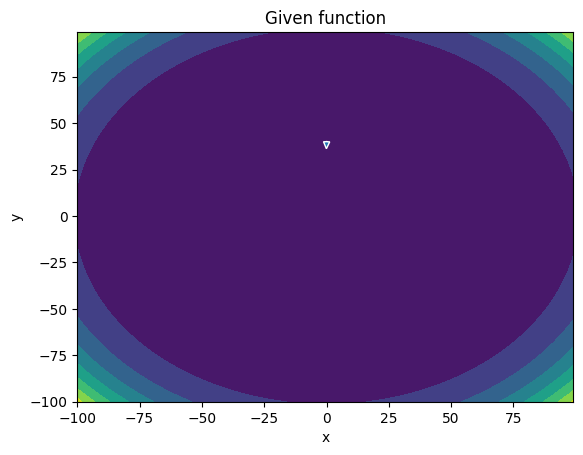

-------
Initial Coordinates:
[[3.41732533e-02]
 [3.99674074e+01]]
Final Coordinates:
[[3.45876128e-02]
 [3.98682041e+01]]
Gradient:
[[-5.85570207e+04]
 [ 3.39649011e+09]]


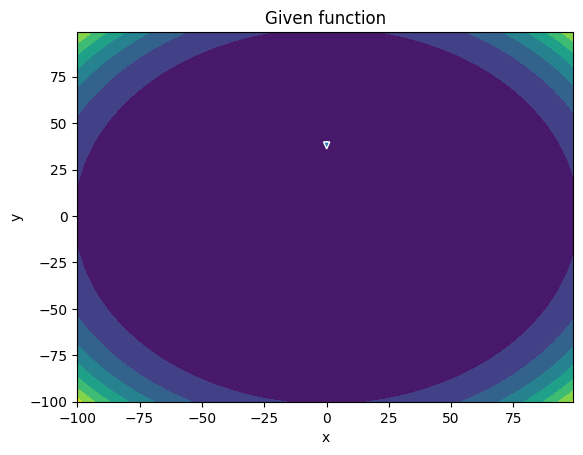

-------
Initial Coordinates:
[[3.45876128e-02]
 [3.98682041e+01]]
Final Coordinates:
[[3.63991730e-02]
 [3.97690051e+01]]
Gradient:
[[-3.03879466e+04]
 [ 3.35453219e+09]]


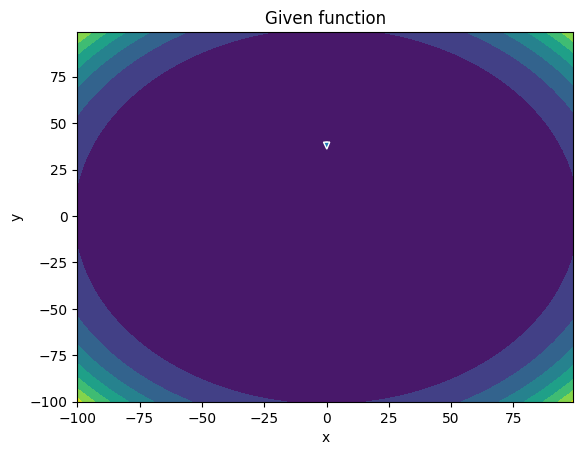

-------
Initial Coordinates:
[[3.63991730e-02]
 [3.97690051e+01]]
Final Coordinates:
[[3.25814865e-02]
 [3.96698102e+01]]
Gradient:
[[1.13691735e+05]
 [3.31299208e+09]]


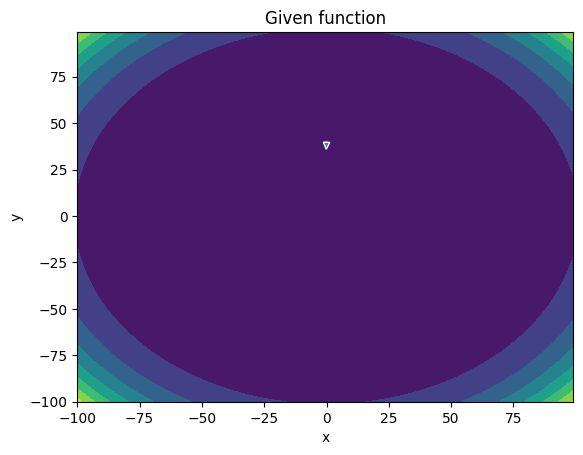

-------
Initial Coordinates:
[[3.25814865e-02]
 [3.96698102e+01]]
Final Coordinates:
[[3.93030556e-02]
 [3.95706195e+01]]
Gradient:
[[-2.09822920e+05]
 [ 3.27186459e+09]]


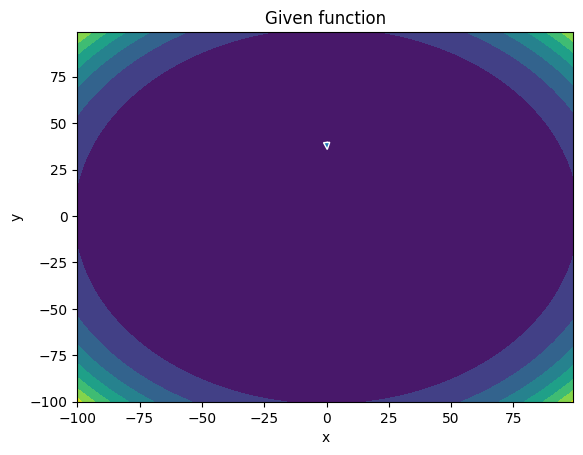

-------
Initial Coordinates:
[[3.93030556e-02]
 [3.95706195e+01]]
Final Coordinates:
[[2.99046212e-02]
 [3.94714331e+01]]
Gradient:
[[3.34413677e+05]
 [3.23115132e+09]]


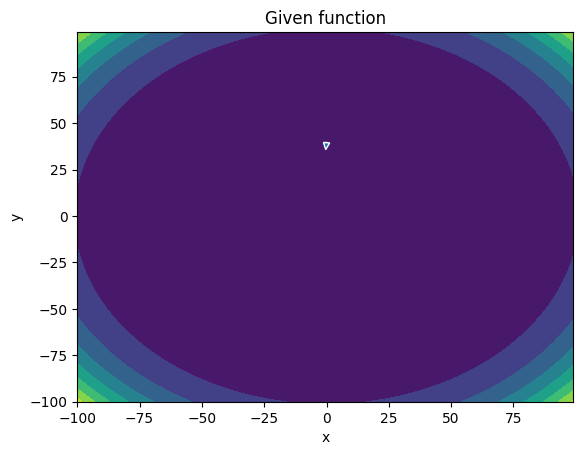

-------
Initial Coordinates:
[[2.99046212e-02]
 [3.94714331e+01]]
Final Coordinates:
[[ 0.03973239]
 [39.37225103]]
Gradient:
[[-4.36529813e+05]
 [ 3.19084142e+09]]


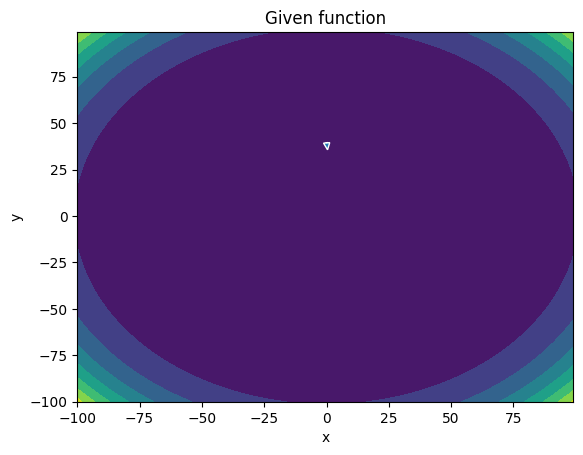

-------
Initial Coordinates:
[[ 0.03973239]
 [39.37225103]]
Final Coordinates:
[[3.50023826e-02]
 [3.92730733e+01]]
Gradient:
[[3.47938143e+05]
 [3.15094192e+09]]


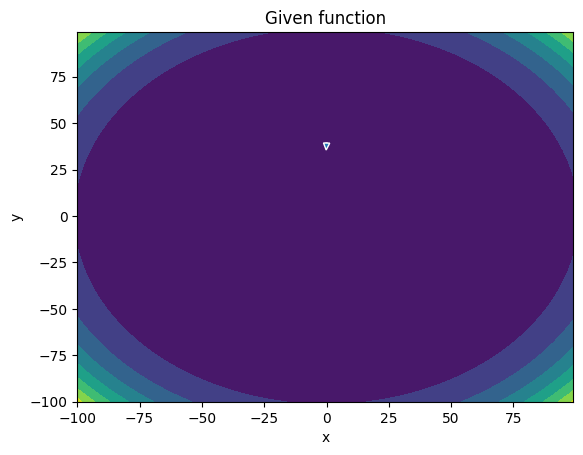

-------
Initial Coordinates:
[[3.50023826e-02]
 [3.92730733e+01]]
Final Coordinates:
[[3.20271081e-02]
 [3.91738999e+01]]
Gradient:
[[-3.77190751e+04]
 [ 3.11144007e+09]]


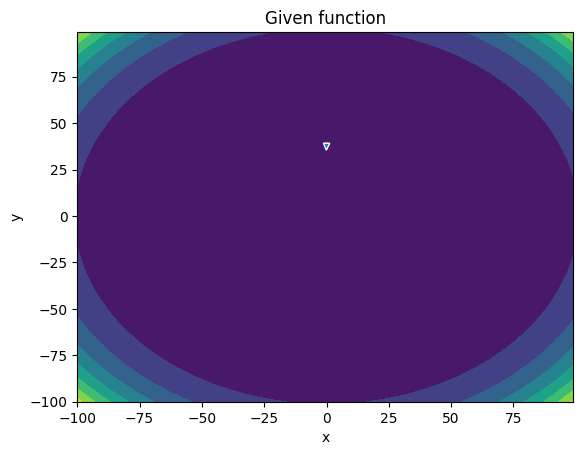

-------
Initial Coordinates:
[[3.20271081e-02]
 [3.91738999e+01]]
Final Coordinates:
[[ 0.04035708]
 [39.07473088]]
Gradient:
[[-2.77947857e+05]
 [ 3.07233768e+09]]


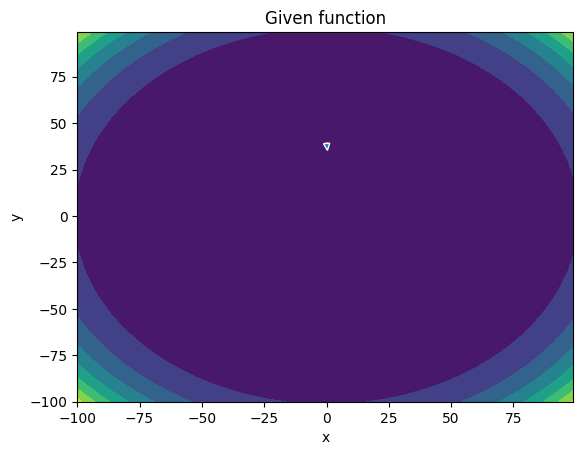

-------
Initial Coordinates:
[[ 0.04035708]
 [39.07473088]]
Final Coordinates:
[[3.37792795e-02]
 [3.89755663e+01]]
Gradient:
[[3.65144775e+05]
 [3.03363427e+09]]


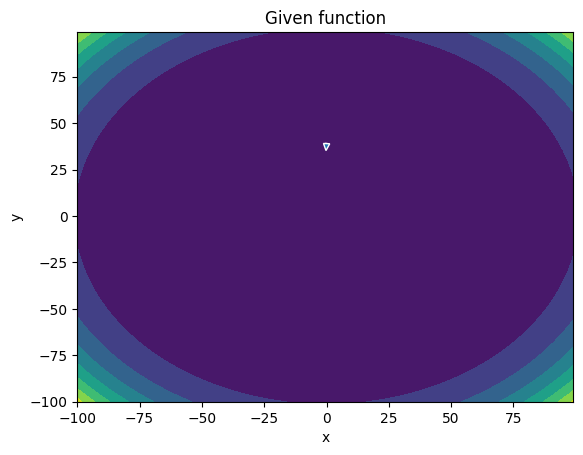

-------
Initial Coordinates:
[[3.37792795e-02]
 [3.89755663e+01]]
Final Coordinates:
[[3.35352430e-02]
 [3.88764062e+01]]
Gradient:
[[-1.51503569e+05]
 [ 2.99531927e+09]]


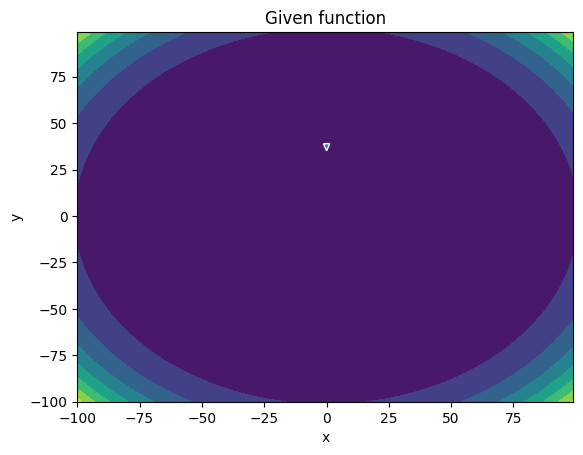

-------
Initial Coordinates:
[[3.35352430e-02]
 [3.88764062e+01]]
Final Coordinates:
[[ 0.04031882]
 [38.77725065]]
Gradient:
[[-1.75491904e+05]
 [ 2.95739589e+09]]


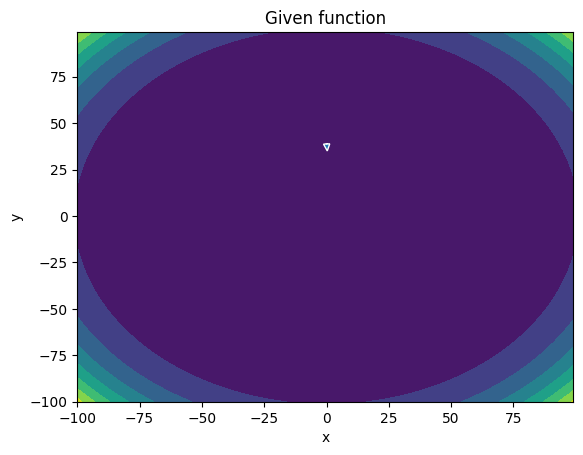

-------
Initial Coordinates:
[[ 0.04031882]
 [38.77725065]]
Final Coordinates:
[[3.34678284e-02]
 [3.86780996e+01]]
Gradient:
[[3.30650692e+05]
 [2.91986127e+09]]


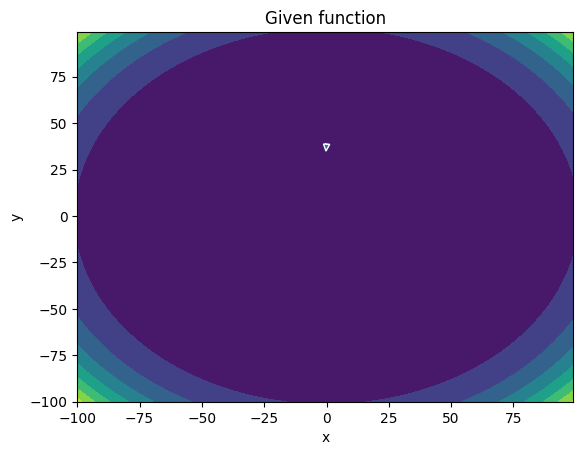

-------
Initial Coordinates:
[[3.34678284e-02]
 [3.86780996e+01]]
Final Coordinates:
[[3.46774259e-02]
 [3.85789531e+01]]
Gradient:
[[-1.90675834e+05]
 [ 2.88270652e+09]]


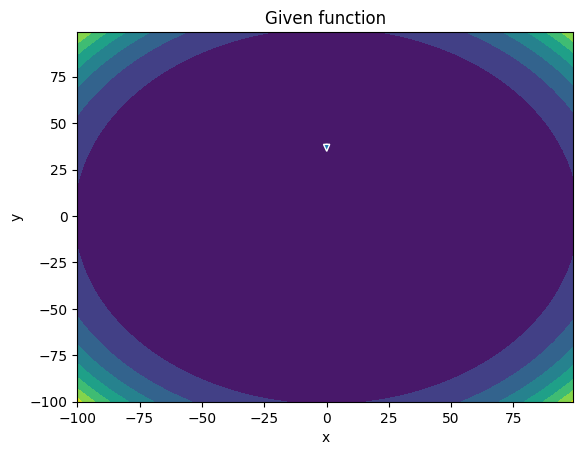

-------
Initial Coordinates:
[[3.46774259e-02]
 [3.85789531e+01]]
Final Coordinates:
[[ 0.04018984]
 [38.47981129]]
Gradient:
[[-1.06249494e+05]
 [ 2.84593485e+09]]


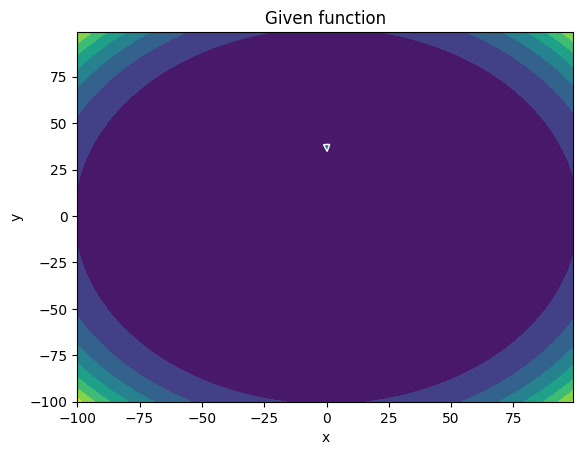

-------
Initial Coordinates:
[[ 0.04018984]
 [38.47981129]]
Final Coordinates:
[[3.33182456e-02]
 [3.83806741e+01]]
Gradient:
[[2.90898184e+05]
 [2.80954230e+09]]


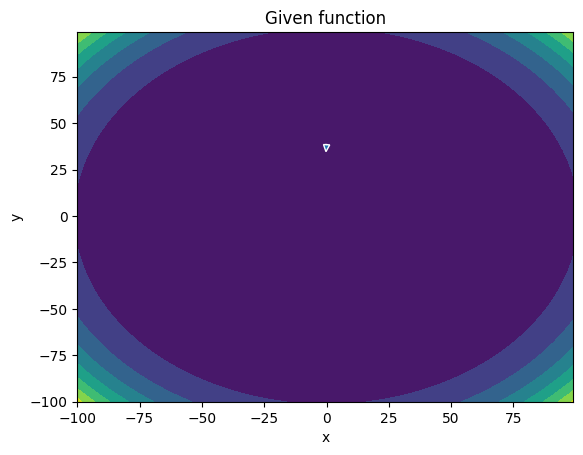

-------
Initial Coordinates:
[[3.33182456e-02]
 [3.83806741e+01]]
Final Coordinates:
[[3.58689717e-02]
 [3.82815416e+01]]
Gradient:
[[-2.15889975e+05]
 [ 2.77352120e+09]]


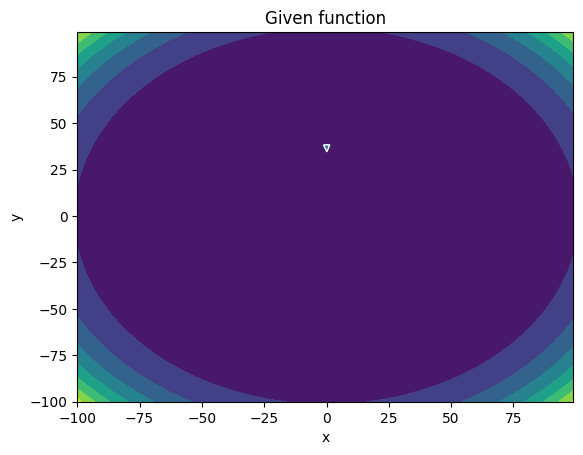

-------
Initial Coordinates:
[[3.58689717e-02]
 [3.82815416e+01]]
Final Coordinates:
[[ 0.03990961]
 [38.1824138 ]]
Gradient:
[[-3.7797587e+04]
 [ 2.7378747e+09]]


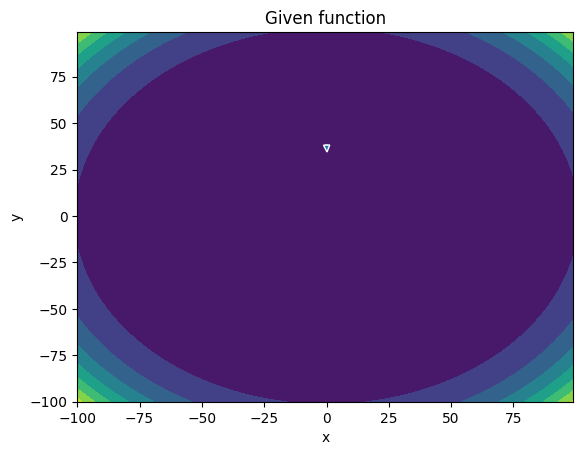

-------
Initial Coordinates:
[[ 0.03990961]
 [38.1824138 ]]
Final Coordinates:
[[3.31688216e-02]
 [3.80832908e+01]]
Gradient:
[[2.42173425e+05]
 [2.70259778e+09]]


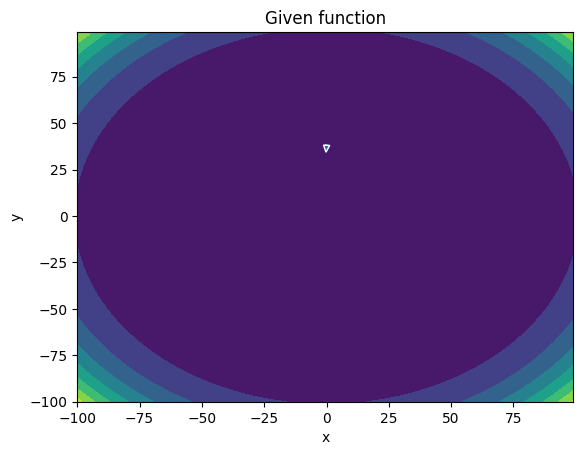

-------
Initial Coordinates:
[[3.31688216e-02]
 [3.80832908e+01]]
Final Coordinates:
[[3.73449886e-02]
 [3.79841726e+01]]
Gradient:
[[-2.39629829e+05]
 [ 2.66768412e+09]]


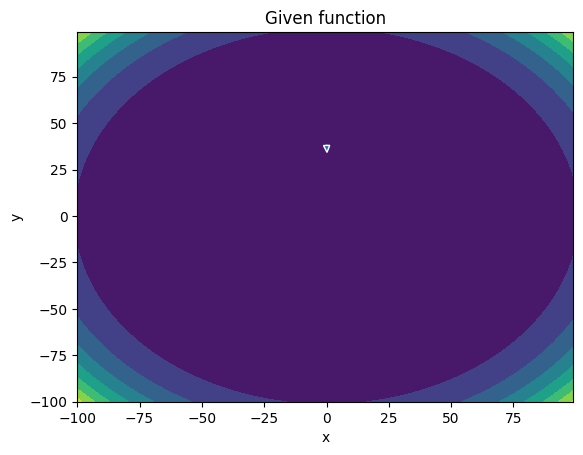

-------
Initial Coordinates:
[[3.73449886e-02]
 [3.79841726e+01]]
Final Coordinates:
[[ 0.03923285]
 [37.88505919]]
Gradient:
[[4.60108372e+04]
 [2.63313673e+09]]


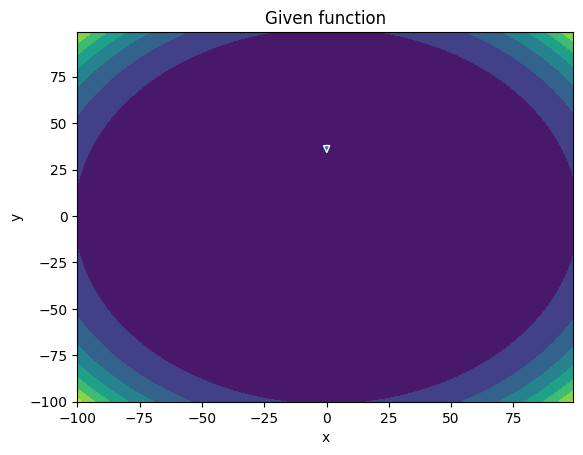

-------
Initial Coordinates:
[[ 0.03923285]
 [37.88505919]]
Final Coordinates:
[[3.32345111e-02]
 [3.77859507e+01]]
Gradient:
[[1.68577895e+05]
 [2.59894928e+09]]


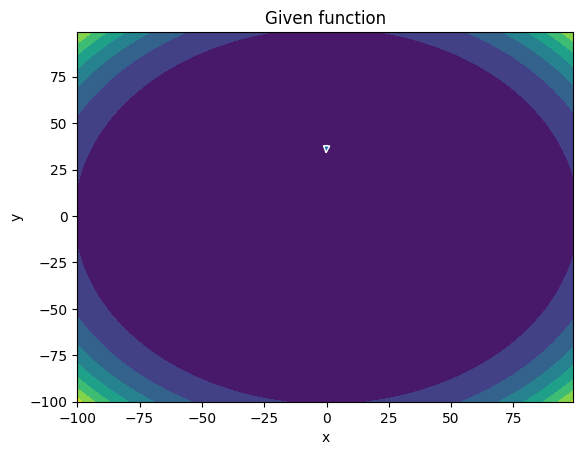

-------
Initial Coordinates:
[[3.32345111e-02]
 [3.77859507e+01]]
Final Coordinates:
[[ 0.03910063]
 [37.68684713]]
Gradient:
[[-2.47332883e+05]
 [ 2.56511739e+09]]


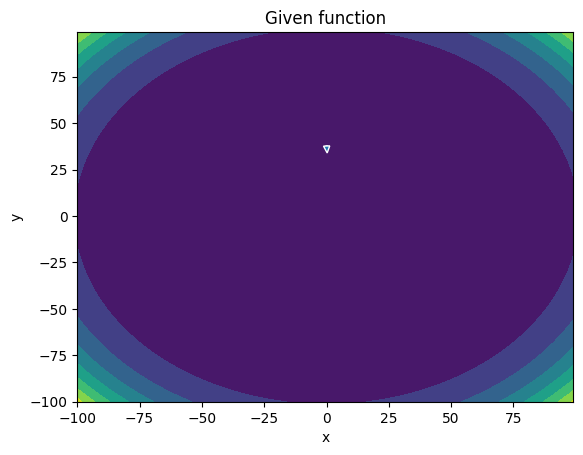

-------
Initial Coordinates:
[[ 0.03910063]
 [37.68684713]]
Final Coordinates:
[[ 0.03786677]
 [37.58774852]]
Gradient:
[[1.43180287e+05]
 [2.53164343e+09]]


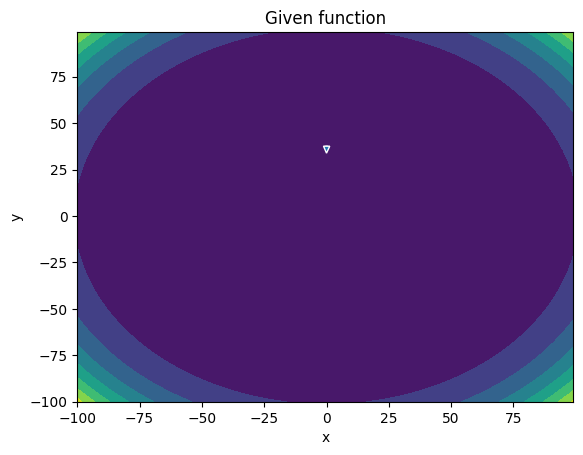

-------
Initial Coordinates:
[[ 0.03786677]
 [37.58774852]]
Final Coordinates:
[[3.41003228e-02]
 [3.74886549e+01]]
Gradient:
[[5.30965847e+04]
 [2.49851963e+09]]


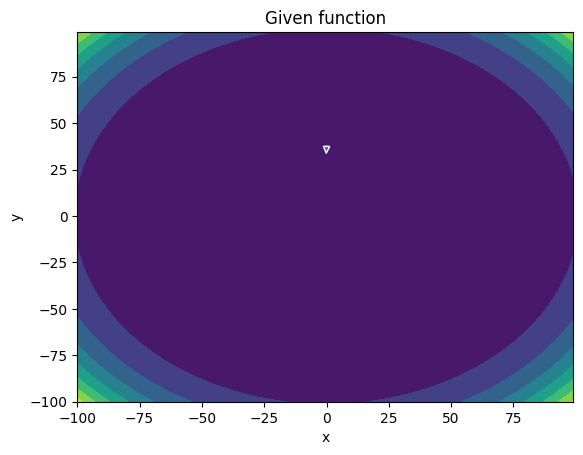

-------
Initial Coordinates:
[[3.41003228e-02]
 [3.74886549e+01]]
Final Coordinates:
[[ 0.0406034 ]
 [37.38956634]]
Gradient:
[[-2.01889298e+05]
 [ 2.46574444e+09]]


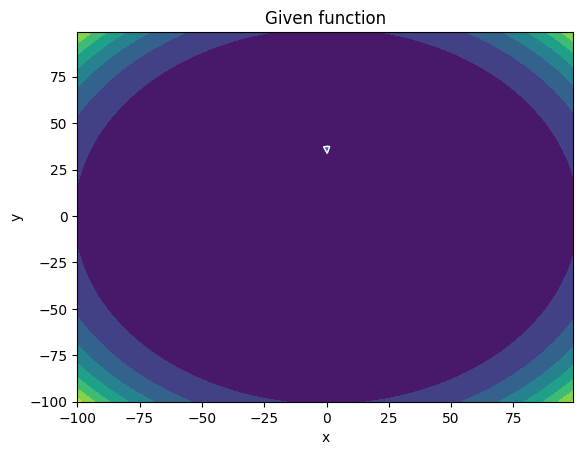

-------
Initial Coordinates:
[[ 0.0406034 ]
 [37.38956634]]
Final Coordinates:
[[3.58283880e-02]
 [3.72904829e+01]]
Gradient:
[[2.17464215e+05]
 [2.43331835e+09]]


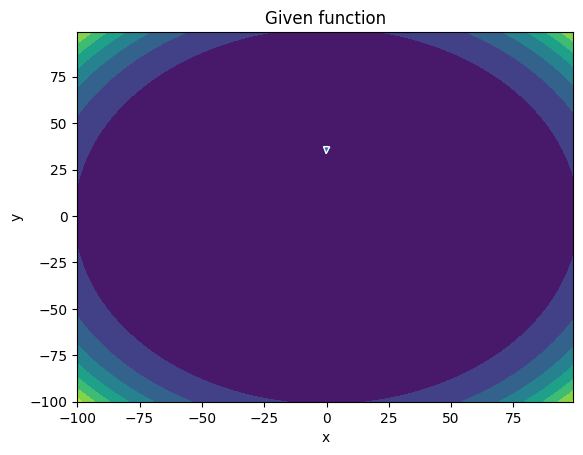

-------
Initial Coordinates:
[[3.58283880e-02]
 [3.72904829e+01]]
Final Coordinates:
[[3.63723998e-02]
 [3.71914045e+01]]
Gradient:
[[-9.89988640e+04]
 [ 2.40123297e+09]]


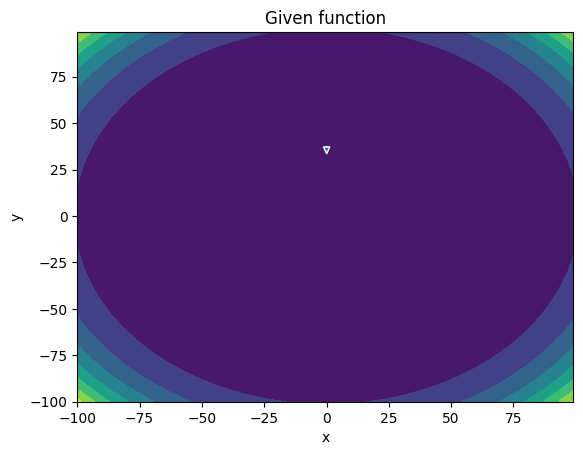

-------
Initial Coordinates:
[[3.63723998e-02]
 [3.71914045e+01]]
Final Coordinates:
[[ 0.04057743]
 [37.09233132]]
Gradient:
[[-6.96046088e+04]
 [ 2.36948993e+09]]


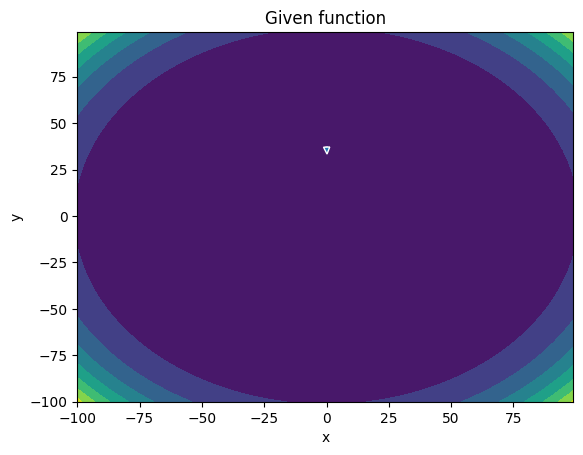

-------
Initial Coordinates:
[[ 0.04057743]
 [37.09233132]]
Final Coordinates:
[[3.42801604e-02]
 [3.69932633e+01]]
Gradient:
[[1.90150348e+05]
 [2.33808604e+09]]


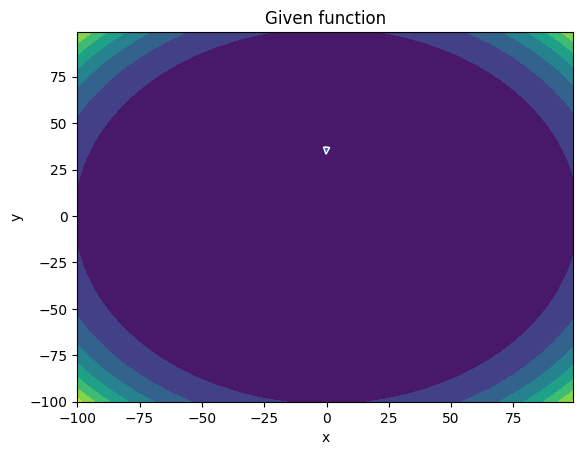

-------
Initial Coordinates:
[[3.42801604e-02]
 [3.69932633e+01]]
Final Coordinates:
[[ 0.03974167]
 [36.89420063]]
Gradient:
[[-2.11271488e+05]
 [ 2.30701492e+09]]


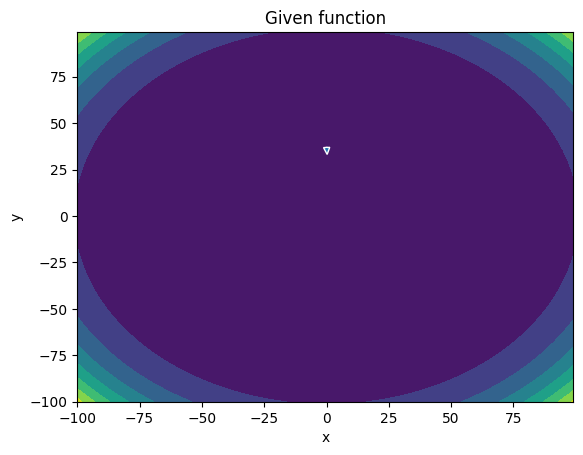

-------
Initial Coordinates:
[[ 0.03974167]
 [36.89420063]]
Final Coordinates:
[[ 0.03822335]
 [36.79514321]]
Gradient:
[[1.22043760e+05]
 [2.27627952e+09]]


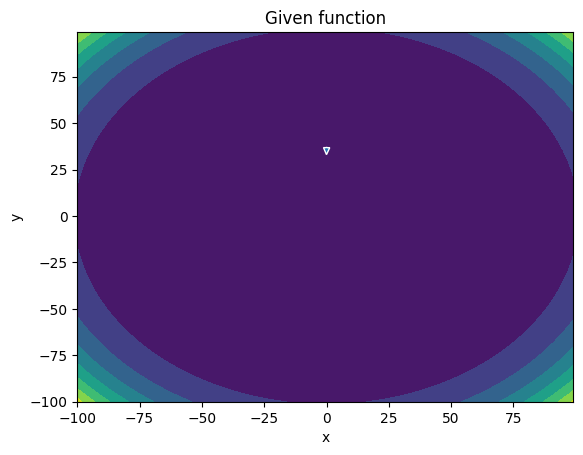

-------
Initial Coordinates:
[[ 0.03822335]
 [36.79514321]]
Final Coordinates:
[[3.55474067e-02]
 [3.66960911e+01]]
Gradient:
[[2.17569543e+04]
 [2.24587243e+09]]


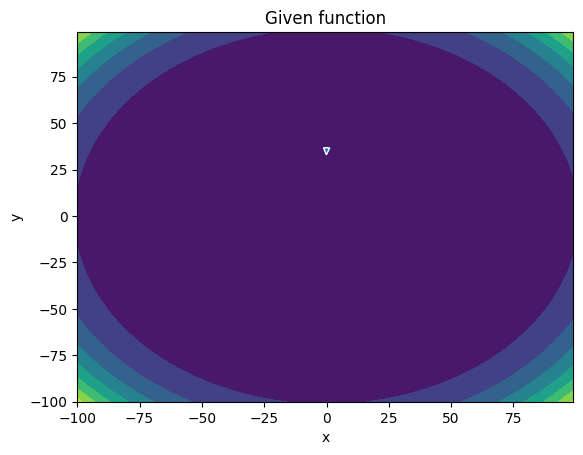

-------
Initial Coordinates:
[[3.55474067e-02]
 [3.66960911e+01]]
Final Coordinates:
[[ 0.04155353]
 [36.59704444]]
Gradient:
[[-1.46402083e+05]
 [ 2.21579249e+09]]


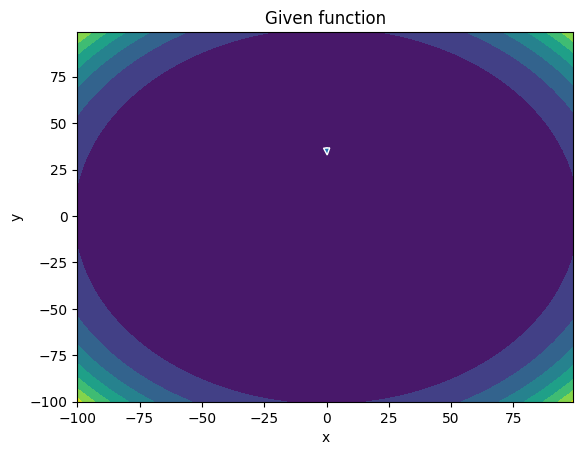

-------
Initial Coordinates:
[[ 0.04155353]
 [36.59704444]]
Final Coordinates:
[[3.50831116e-02]
 [3.64980032e+01]]
Gradient:
[[2.08163456e+05]
 [2.18603943e+09]]


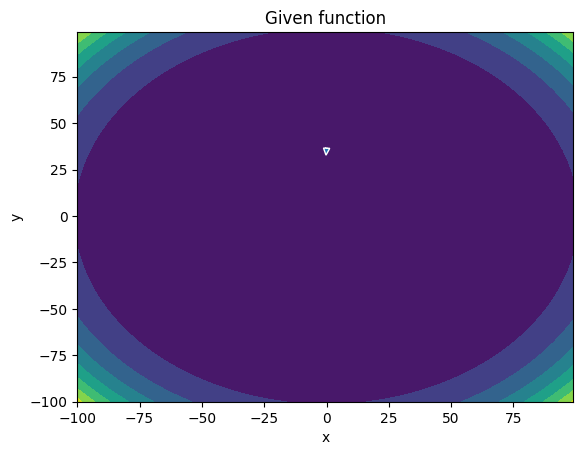

-------
Initial Coordinates:
[[3.50831116e-02]
 [3.64980032e+01]]
Final Coordinates:
[[ 0.03957808]
 [36.39896741]]
Gradient:
[[-1.82918919e+05]
 [ 2.15660533e+09]]


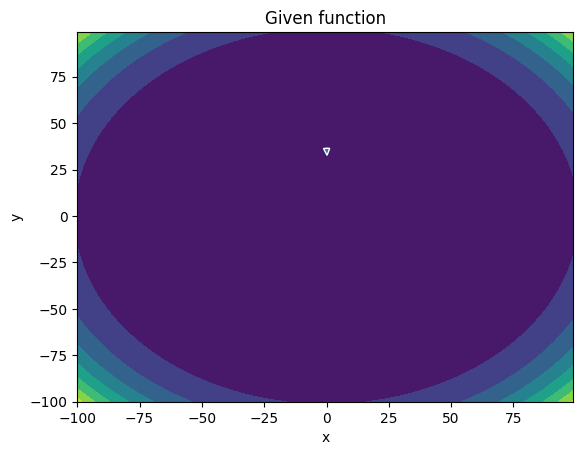

-------
Initial Coordinates:
[[ 0.03957808]
 [36.39896741]]
Final Coordinates:
[[ 0.03933529]
 [36.29993716]]
Gradient:
[[7.59854641e+04]
 [2.12749337e+09]]


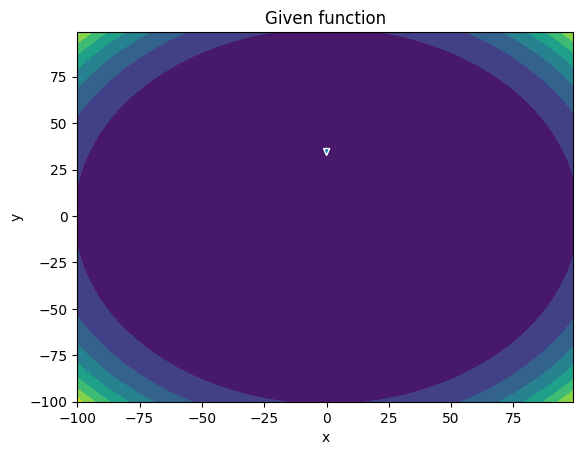

-------
Initial Coordinates:
[[ 0.03933529]
 [36.29993716]]
Final Coordinates:
[[3.57156452e-02]
 [3.62009125e+01]]
Gradient:
[[5.50659847e+04]
 [2.09869709e+09]]


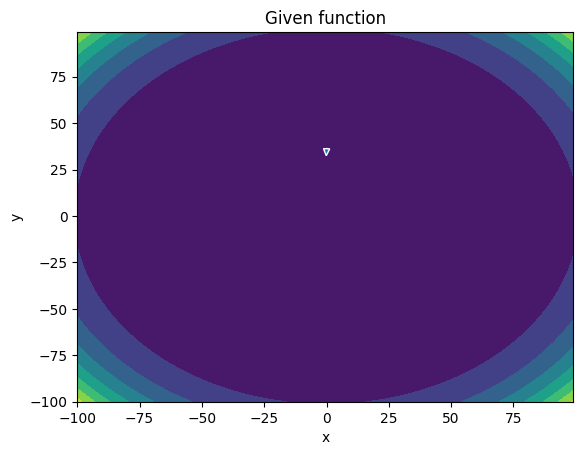

-------
Initial Coordinates:
[[3.57156452e-02]
 [3.62009125e+01]]
Final Coordinates:
[[ 0.04224798]
 [36.10189343]]
Gradient:
[[-1.58759758e+05]
 [ 2.07021423e+09]]


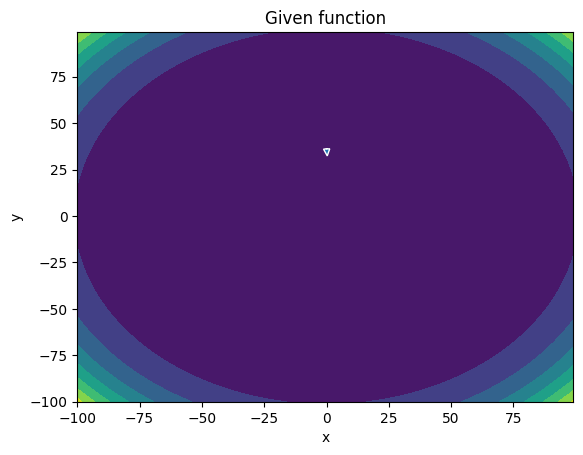

-------
Initial Coordinates:
[[ 0.04224798]
 [36.10189343]]
Final Coordinates:
[[3.55674627e-02]
 [3.60028800e+01]]
Gradient:
[[2.06879708e+05]
 [2.04204547e+09]]


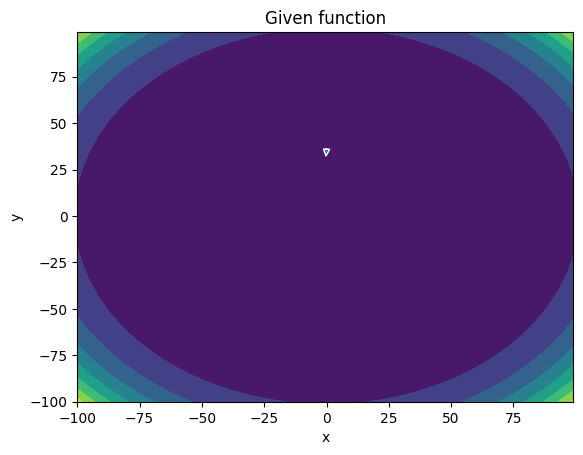

-------
Initial Coordinates:
[[3.55674627e-02]
 [3.60028800e+01]]
Final Coordinates:
[[ 0.04003477]
 [35.90387236]]
Gradient:
[[-1.75469914e+05]
 [ 2.01418253e+09]]


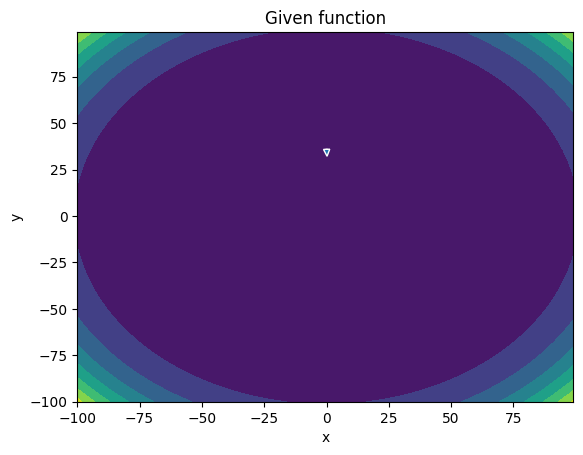

-------
Initial Coordinates:
[[ 0.04003477]
 [35.90387236]]
Final Coordinates:
[[ 0.04000516]
 [35.80487045]]
Gradient:
[[6.79932061e+04]
 [1.98662875e+09]]


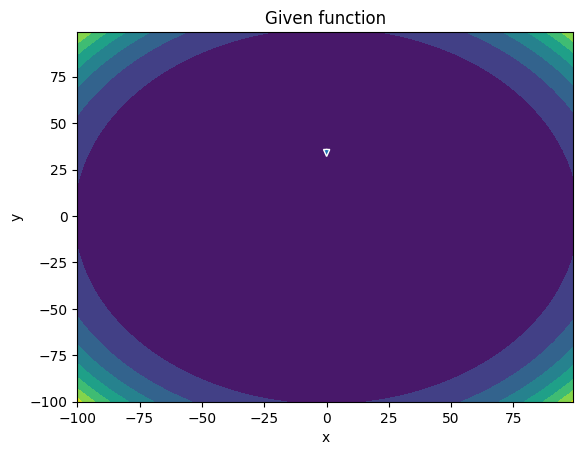

-------
Initial Coordinates:
[[ 0.04000516]
 [35.80487045]]
Final Coordinates:
[[ 0.03608941]
 [35.70587435]]
Gradient:
[[5.97461459e+04]
 [1.95937786e+09]]


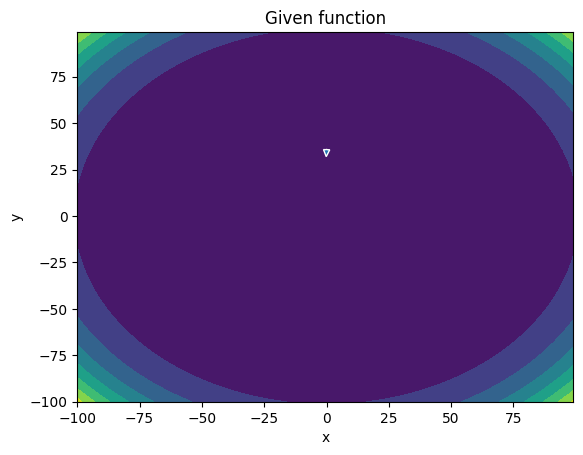

-------
Initial Coordinates:
[[ 0.03608941]
 [35.70587435]]
Final Coordinates:
[[ 0.04288273]
 [35.60688412]]
Gradient:
[[-1.58913245e+05]
 [ 1.93242748e+09]]


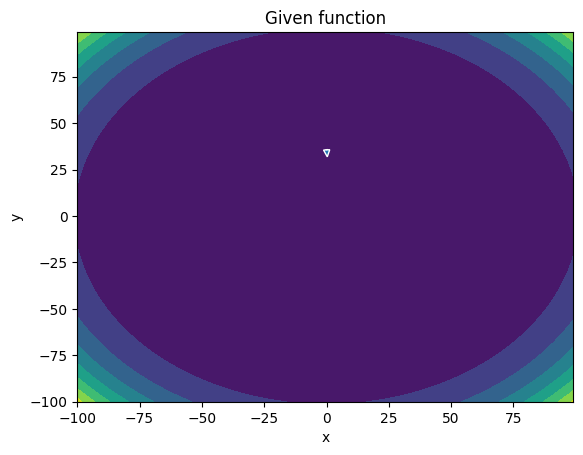

-------
Initial Coordinates:
[[ 0.04288273]
 [35.60688412]]
Final Coordinates:
[[ 0.03619046]
 [35.50789981]]
Gradient:
[[2.01026836e+05]
 [1.90577852e+09]]


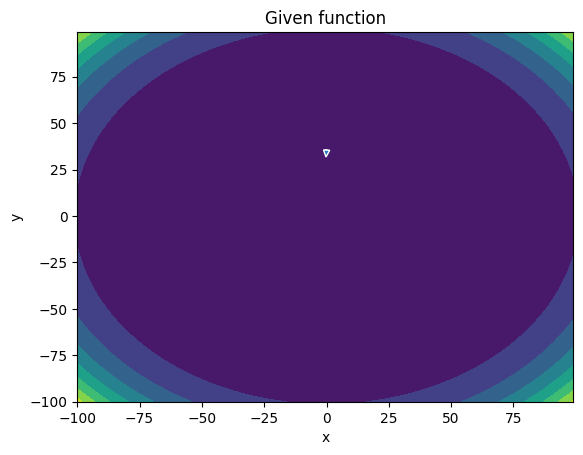

-------
Initial Coordinates:
[[ 0.03619046]
 [35.50789981]]
Final Coordinates:
[[ 0.04029277]
 [35.40892145]]
Gradient:
[[-1.61592323e+05]
 [ 1.87942274e+09]]


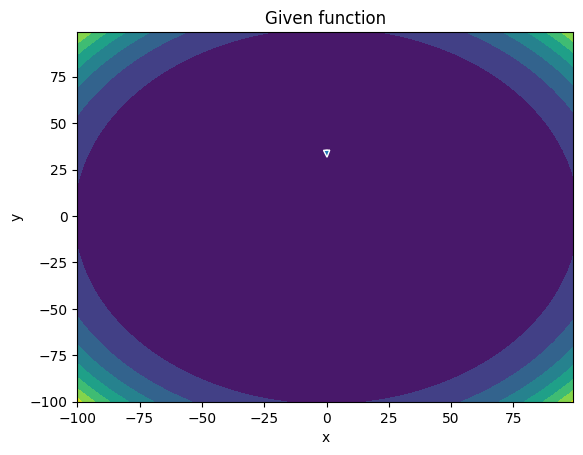

-------
Initial Coordinates:
[[ 0.04029277]
 [35.40892145]]
Final Coordinates:
[[ 0.04091991]
 [35.30994912]]
Gradient:
[[4.94157841e+04]
 [1.85336336e+09]]


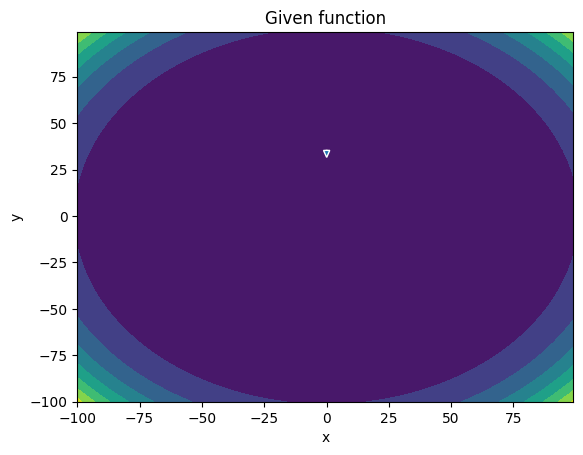

-------
Initial Coordinates:
[[ 0.04091991]
 [35.30994912]]
Final Coordinates:
[[ 0.03634235]
 [35.21098286]]
Gradient:
[[7.56468595e+04]
 [1.82759462e+09]]


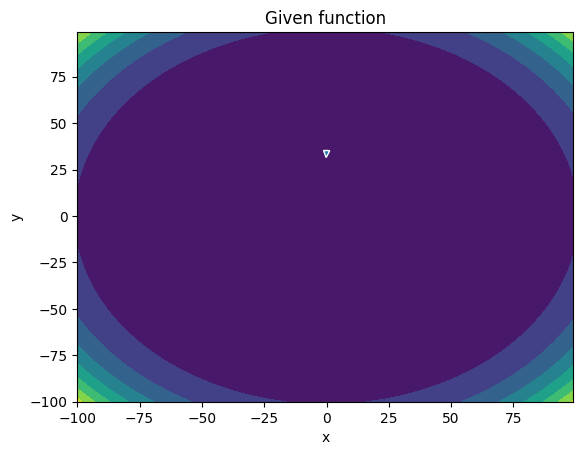

-------
Initial Coordinates:
[[ 0.03634235]
 [35.21098286]]
Final Coordinates:
[[ 0.04341962]
 [35.11202272]]
Gradient:
[[-1.65426111e+05]
 [ 1.80211365e+09]]


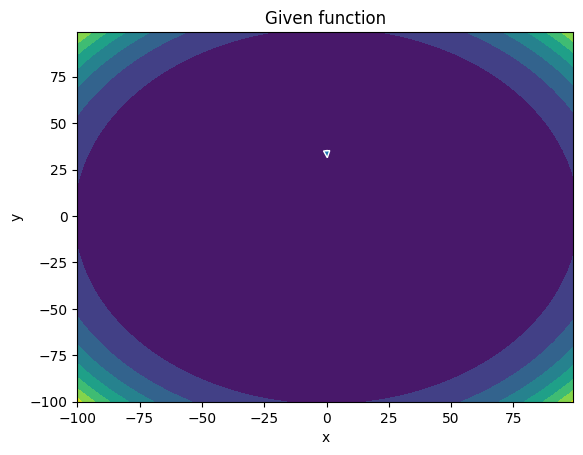

-------
Initial Coordinates:
[[ 0.04341962]
 [35.11202272]]
Final Coordinates:
[[ 0.03722788]
 [35.01306876]]
Gradient:
[[1.89341880e+05]
 [1.77692185e+09]]


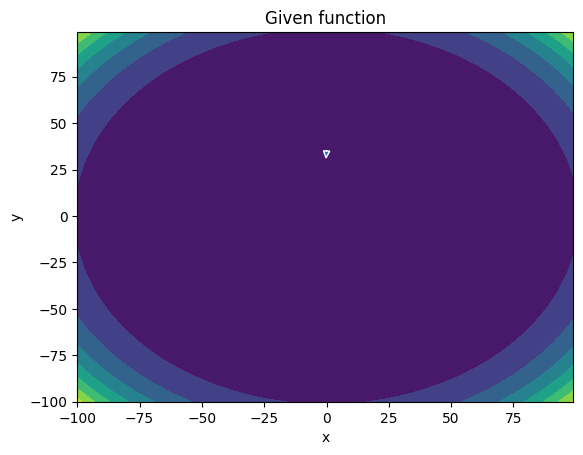

-------
Initial Coordinates:
[[ 0.03722788]
 [35.01306876]]
Final Coordinates:
[[ 0.04009885]
 [34.91412103]]
Gradient:
[[-1.28582125e+05]
 [ 1.75201105e+09]]


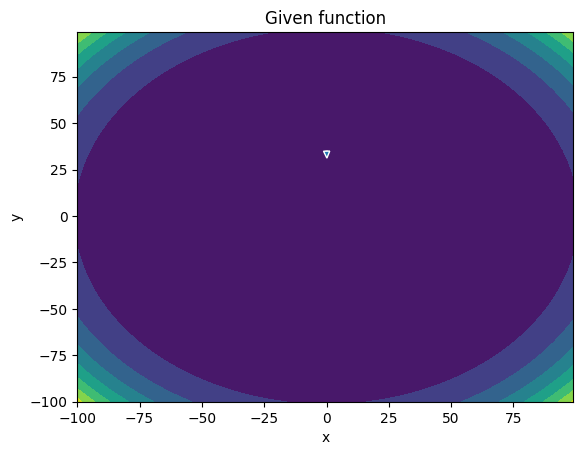

-------
Initial Coordinates:
[[ 0.04009885]
 [34.91412103]]
Final Coordinates:
[[ 0.04215906]
 [34.81517958]]
Gradient:
[[9.48381096e+03]
 [1.72738396e+09]]


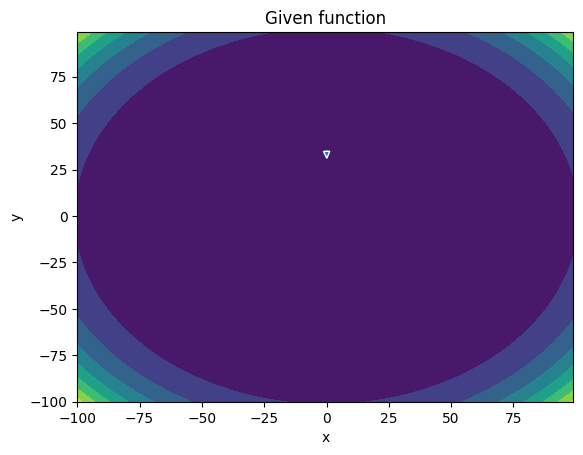

-------
Initial Coordinates:
[[ 0.04215906]
 [34.81517958]]
Final Coordinates:
[[ 0.03656304]
 [34.71624448]]
Gradient:
[[1.04717353e+05]
 [1.70303595e+09]]


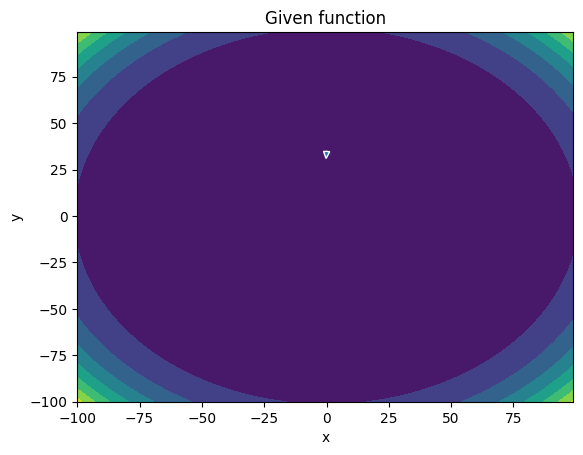

-------
Initial Coordinates:
[[ 0.03656304]
 [34.71624448]]
Final Coordinates:
[[ 0.04371653]
 [34.61731577]]
Gradient:
[[-1.72941466e+05]
 [ 1.67896308e+09]]


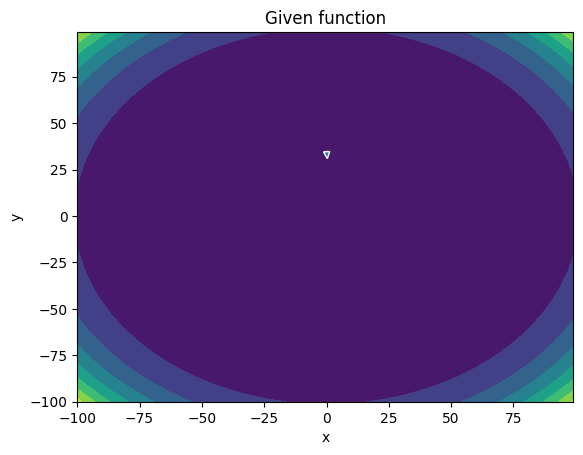

-------
Initial Coordinates:
[[ 0.04371653]
 [34.61731577]]
Final Coordinates:
[[ 0.03866547]
 [34.51839352]]
Gradient:
[[1.65961774e+05]
 [1.65516750e+09]]


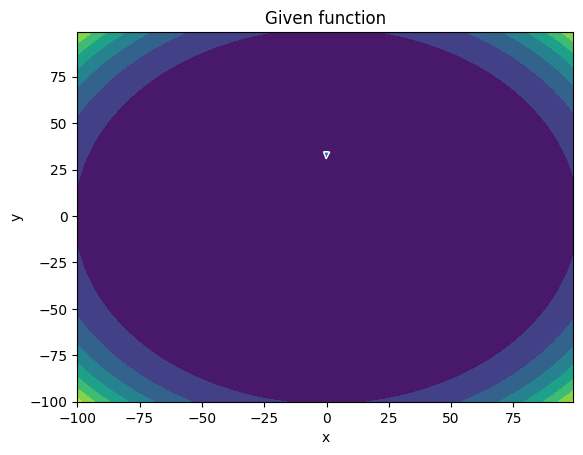

-------
Initial Coordinates:
[[ 0.03866547]
 [34.51839352]]
Final Coordinates:
[[ 0.03967103]
 [34.41947778]]
Gradient:
[[-8.04237731e+04]
 [ 1.63164128e+09]]


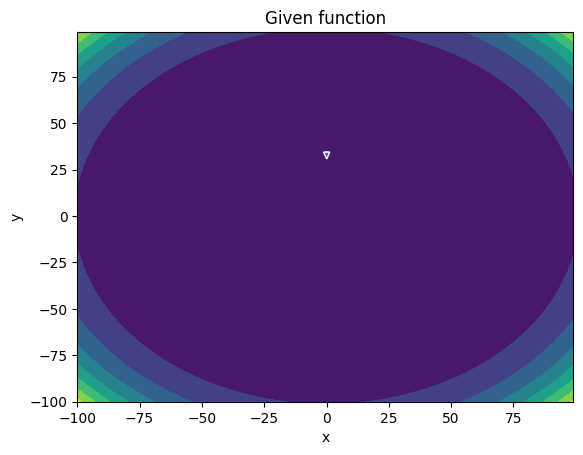

-------
Initial Coordinates:
[[ 0.03967103]
 [34.41947778]]
Final Coordinates:
[[ 0.04344953]
 [34.32056861]]
Gradient:
[[-3.78886009e+04]
 [ 1.60838617e+09]]


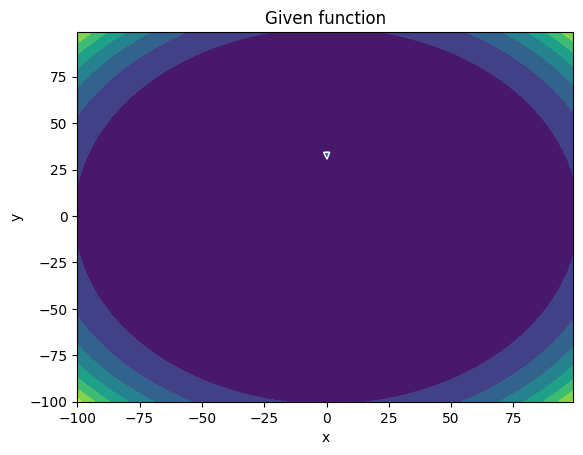

-------
Initial Coordinates:
[[ 0.04344953]
 [34.32056861]]
Final Coordinates:
[[ 0.03699404]
 [34.22166606]]
Gradient:
[[1.31900254e+05]
 [1.58539909e+09]]


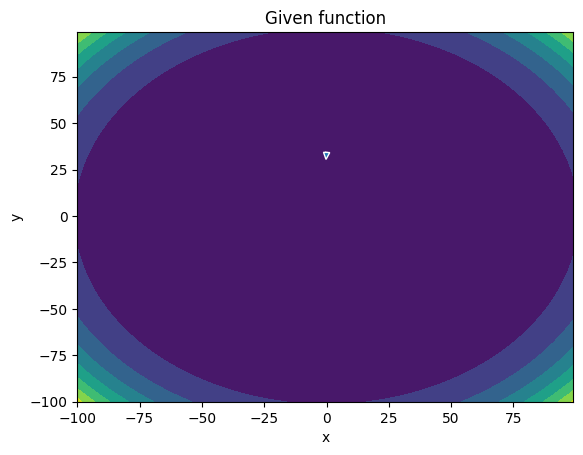

-------
Initial Coordinates:
[[ 0.03699404]
 [34.22166606]]
Final Coordinates:
[[ 0.04369816]
 [34.12277021]]
Gradient:
[[-1.70108737e+05]
 [ 1.56267486e+09]]


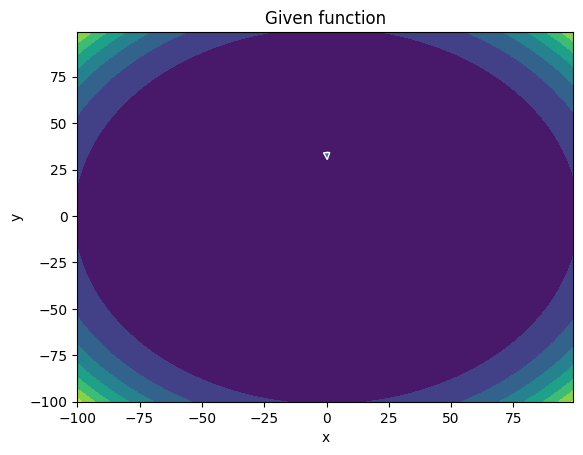

-------
Initial Coordinates:
[[ 0.04369816]
 [34.12277021]]
Final Coordinates:
[[ 0.04031678]
 [34.0238811 ]]
Gradient:
[[1.29487144e+05]
 [1.54021623e+09]]


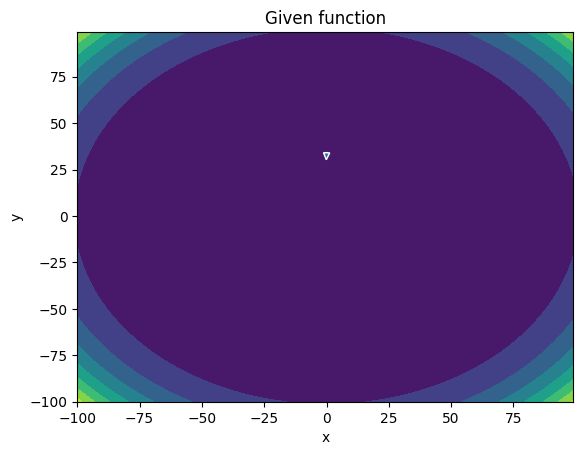

-------
Initial Coordinates:
[[ 0.04031678]
 [34.0238811 ]]
Final Coordinates:
[[ 0.03929288]
 [33.9249988 ]]
Gradient:
[[-2.83557461e+04]
 [ 1.51801588e+09]]


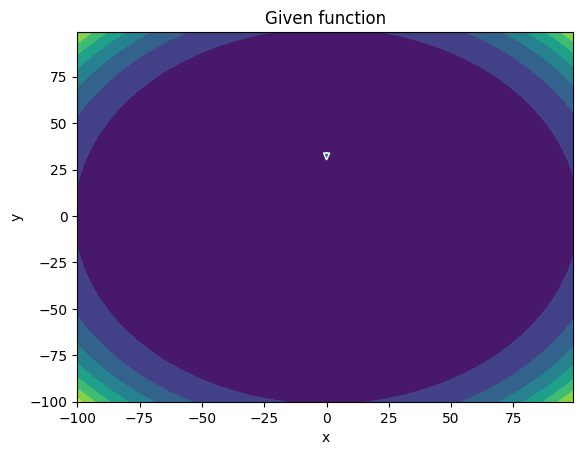

-------
Initial Coordinates:
[[ 0.03929288]
 [33.9249988 ]]
Final Coordinates:
[[ 0.04456761]
 [33.82612337]]
Gradient:
[[-7.85060334e+04]
 [ 1.49607426e+09]]


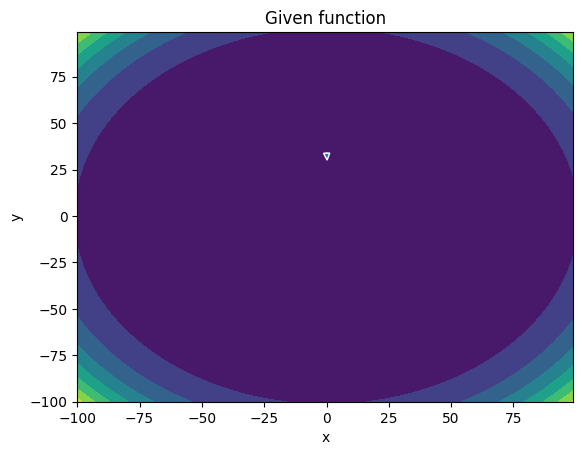

-------
Initial Coordinates:
[[ 0.04456761]
 [33.82612337]]
Final Coordinates:
[[ 0.03775014]
 [33.72725487]]
Gradient:
[[1.47358541e+05]
 [1.47438992e+09]]


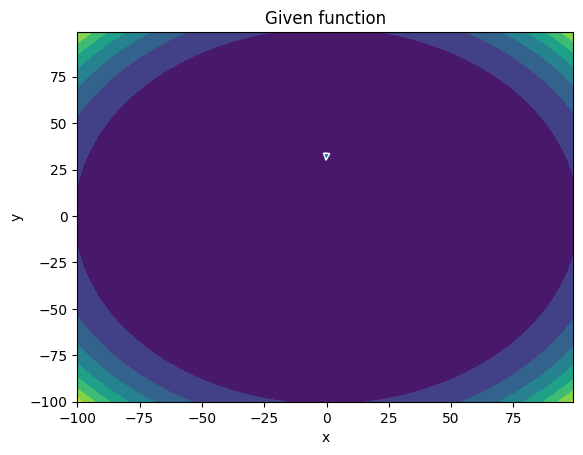

-------
Initial Coordinates:
[[ 0.03775014]
 [33.72725487]]
Final Coordinates:
[[ 0.04346021]
 [33.62839337]]
Gradient:
[[-1.53619739e+05]
 [ 1.45295664e+09]]


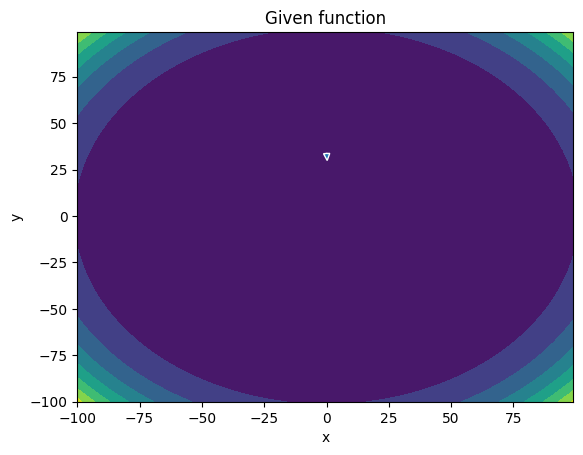

-------
Initial Coordinates:
[[ 0.04346021]
 [33.62839337]]
Final Coordinates:
[[ 0.04196539]
 [33.52953893]]
Gradient:
[[8.64112193e+04]
 [1.43177741e+09]]


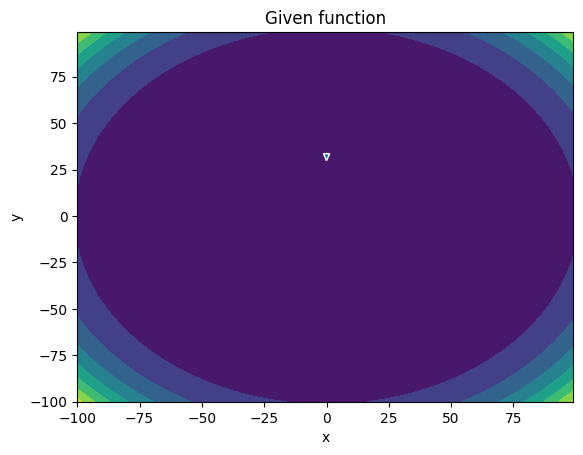

-------
Initial Coordinates:
[[ 0.04196539]
 [33.52953893]]
Final Coordinates:
[[ 0.03912013]
 [33.43069161]]
Gradient:
[[1.72762253e+04]
 [1.41084585e+09]]


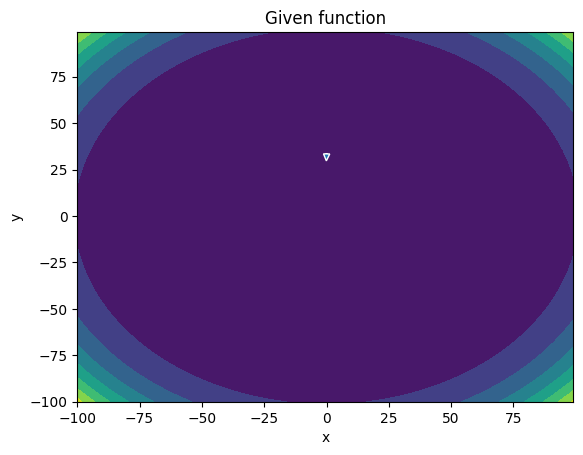

-------
Initial Coordinates:
[[ 0.03912013]
 [33.43069161]]
Final Coordinates:
[[ 0.04543775]
 [33.33185148]]
Gradient:
[[-1.06505698e+05]
 [ 1.39016101e+09]]


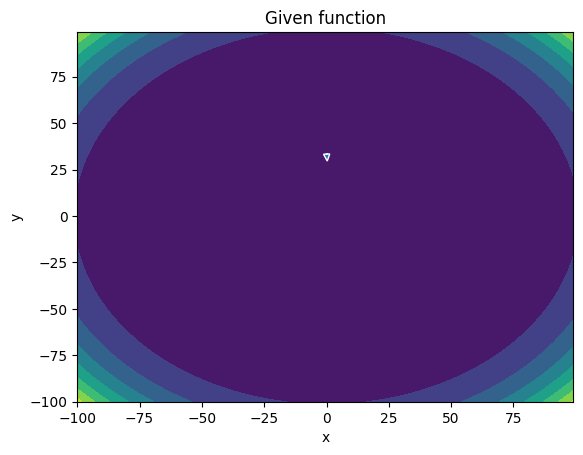

-------
Initial Coordinates:
[[ 0.04543775]
 [33.33185148]]
Final Coordinates:
[[ 0.03879682]
 [33.23301861]]
Gradient:
[[1.49602807e+05]
 [1.36972283e+09]]


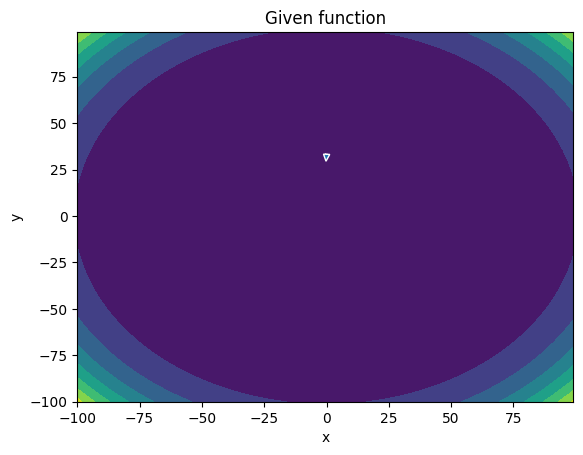

-------
Initial Coordinates:
[[ 0.03879682]
 [33.23301861]]
Final Coordinates:
[[ 0.04315688]
 [33.13419306]]
Gradient:
[[-1.27234424e+05]
 [ 1.34952452e+09]]


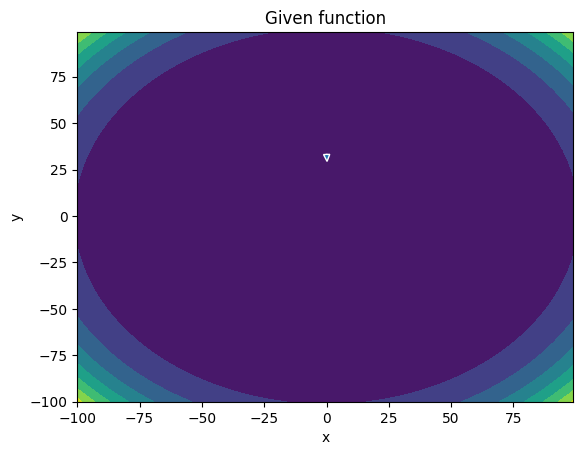

-------
Initial Coordinates:
[[ 0.04315688]
 [33.13419306]]
Final Coordinates:
[[ 0.04349407]
 [33.0353749 ]]
Gradient:
[[4.44261632e+04]
 [1.32956885e+09]]


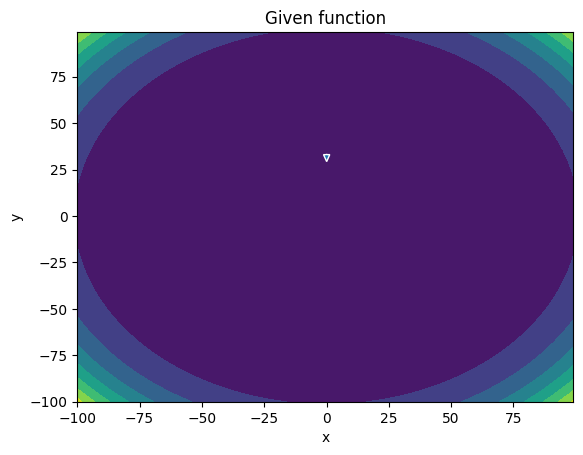

-------
Initial Coordinates:
[[ 0.04349407]
 [33.0353749 ]]
Final Coordinates:
[[ 0.03918381]
 [32.93656419]]
Gradient:
[[5.22916650e+04]
 [1.30985061e+09]]


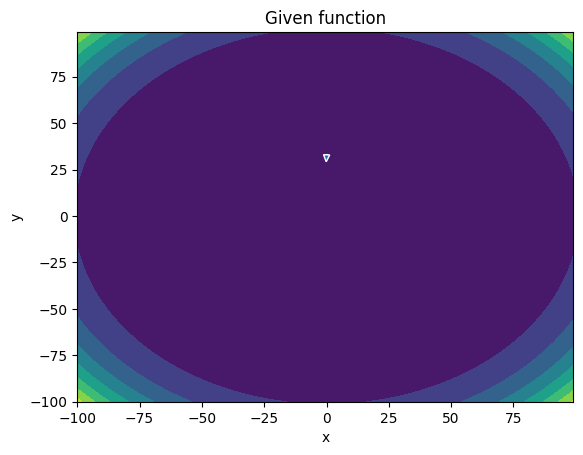

-------
Initial Coordinates:
[[ 0.03918381]
 [32.93656419]]
Final Coordinates:
[[ 0.04607322]
 [32.83776102]]
Gradient:
[[-1.22376978e+05]
 [ 1.29036752e+09]]


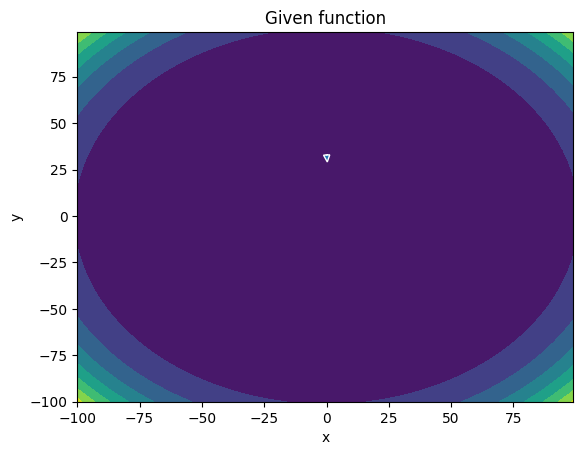

-------
Initial Coordinates:
[[ 0.04607322]
 [32.83776102]]
Final Coordinates:
[[ 0.04004731]
 [32.73896544]]
Gradient:
[[1.41180152e+05]
 [1.27112062e+09]]


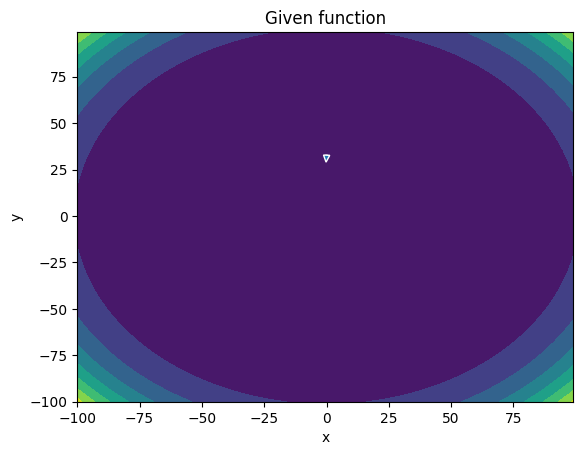

-------
Initial Coordinates:
[[ 0.04004731]
 [32.73896544]]
Final Coordinates:
[[ 0.04289104]
 [32.64017753]]
Gradient:
[[-9.61765099e+04]
 [ 1.25210291e+09]]


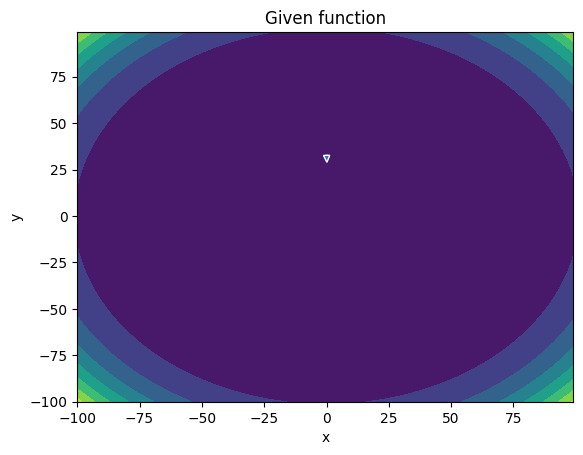

-------
Initial Coordinates:
[[ 0.04289104]
 [32.64017753]]
Final Coordinates:
[[ 0.04488328]
 [32.54139736]]
Gradient:
[[7.69765839e+03]
 [1.23331668e+09]]


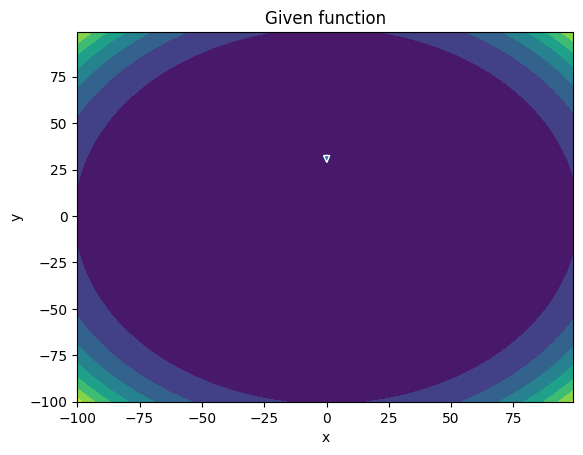

-------
Initial Coordinates:
[[ 0.04488328]
 [32.54139736]]
Final Coordinates:
[[ 0.0394672]
 [32.442625 ]]
Gradient:
[[7.72292328e+04]
 [1.21475789e+09]]


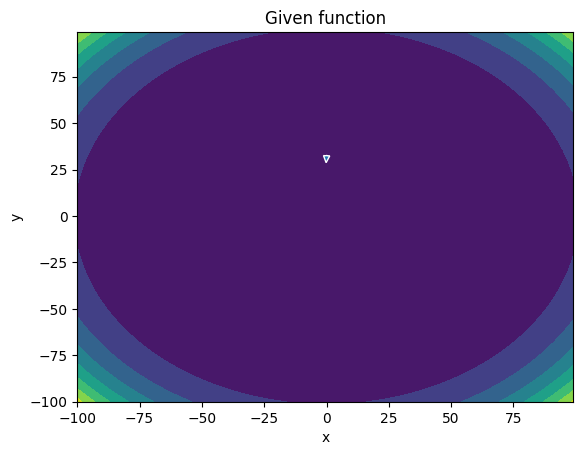

-------
Initial Coordinates:
[[ 0.0394672]
 [32.442625 ]]
Final Coordinates:
[[ 0.04650762]
 [32.34386053]]
Gradient:
[[-1.28518469e+05]
 [ 1.19642318e+09]]


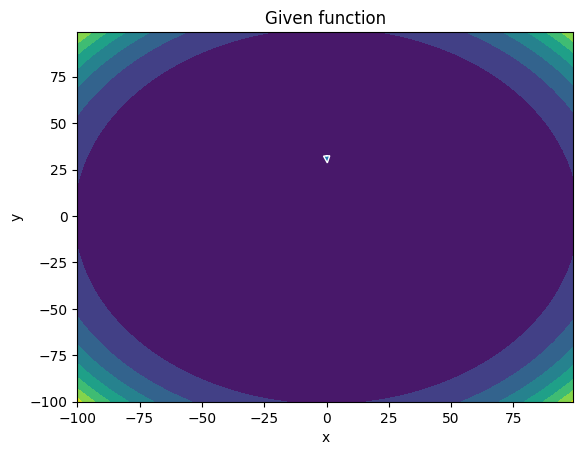

-------
Initial Coordinates:
[[ 0.04650762]
 [32.34386053]]
Final Coordinates:
[[ 0.04143298]
 [32.24510402]]
Gradient:
[[1.25086816e+05]
 [1.17831432e+09]]


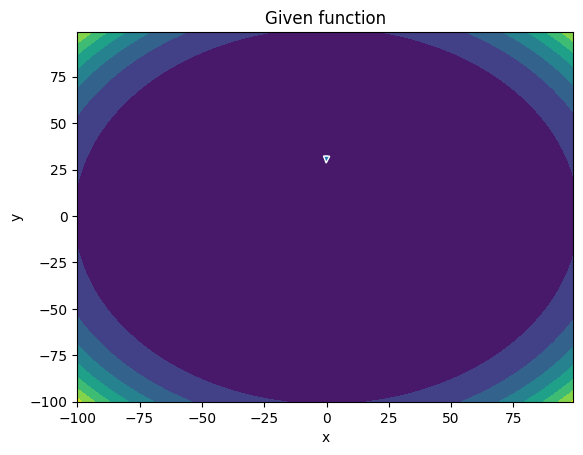

-------
Initial Coordinates:
[[ 0.04143298]
 [32.24510402]]
Final Coordinates:
[[ 0.0427016 ]
 [32.14635556]]
Gradient:
[[-6.40585189e+04]
 [ 1.16042446e+09]]


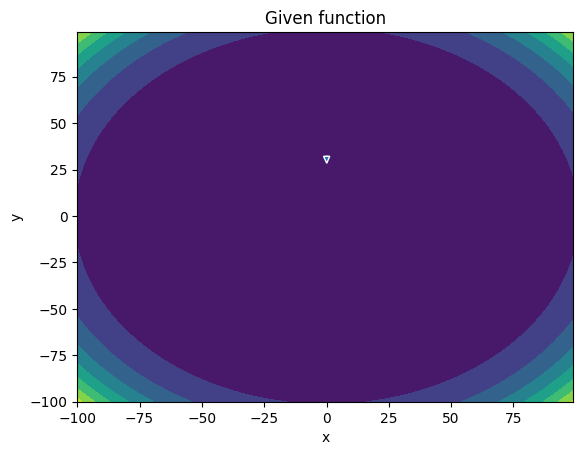

-------
Initial Coordinates:
[[ 0.0427016 ]
 [32.14635556]]
Final Coordinates:
[[ 0.04615007]
 [32.0476152 ]]
Gradient:
[[-2.28437443e+04]
 [ 1.14275518e+09]]


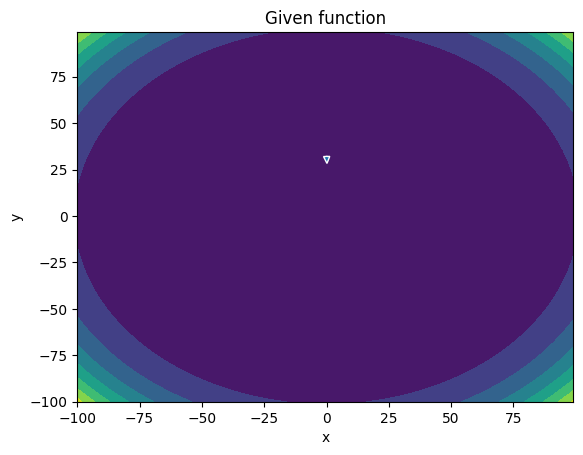

-------
Initial Coordinates:
[[ 0.04615007]
 [32.0476152 ]]
Final Coordinates:
[[ 0.03995918]
 [31.94888303]]
Gradient:
[[9.39930763e+04]
 [1.12530362e+09]]


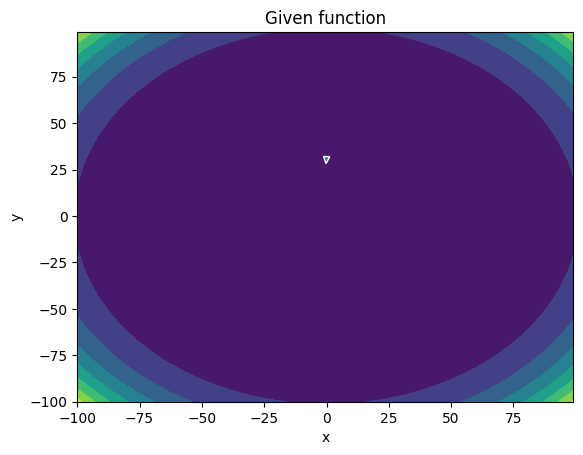

-------
Initial Coordinates:
[[ 0.03995918]
 [31.94888303]]
Final Coordinates:
[[ 0.04676529]
 [31.85015914]]
Gradient:
[[-1.26835799e+05]
 [ 1.10806550e+09]]


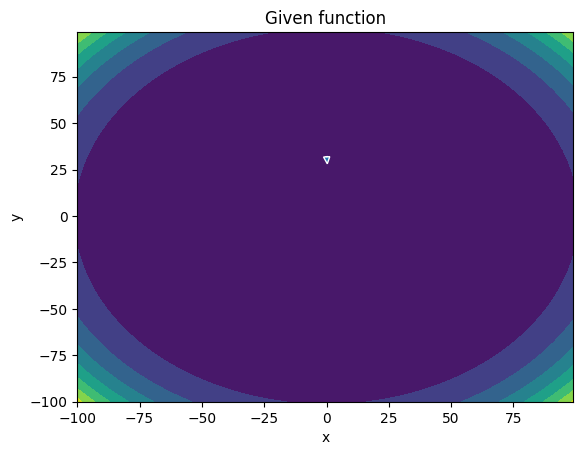

-------
Initial Coordinates:
[[ 0.04676529]
 [31.85015914]]
Final Coordinates:
[[ 0.04291058]
 [31.75144359]]
Gradient:
[[1.03555882e+05]
 [1.09104308e+09]]


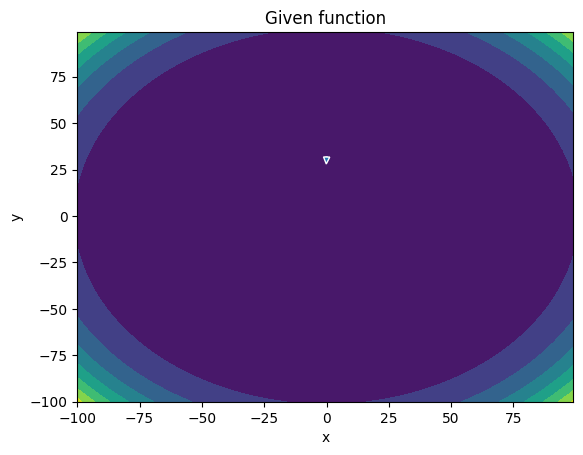

-------
Initial Coordinates:
[[ 0.04291058]
 [31.75144359]]
Final Coordinates:
[[ 0.04260066]
 [31.65273648]]
Gradient:
[[-3.29253916e+04]
 [ 1.07422991e+09]]


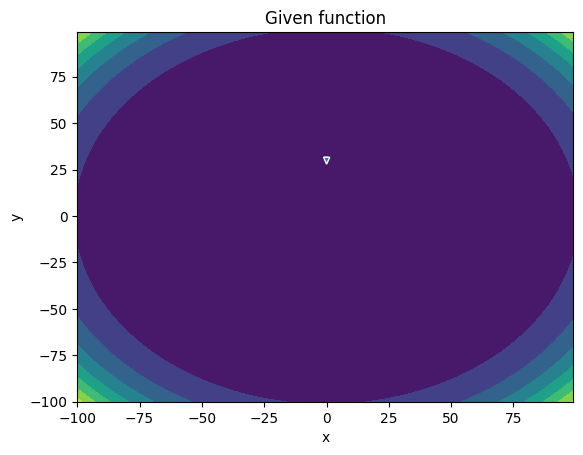

-------
Initial Coordinates:
[[ 0.04260066]
 [31.65273648]]
Final Coordinates:
[[ 0.04730226]
 [31.55403787]]
Gradient:
[[-4.74664501e+04]
 [ 1.05762670e+09]]


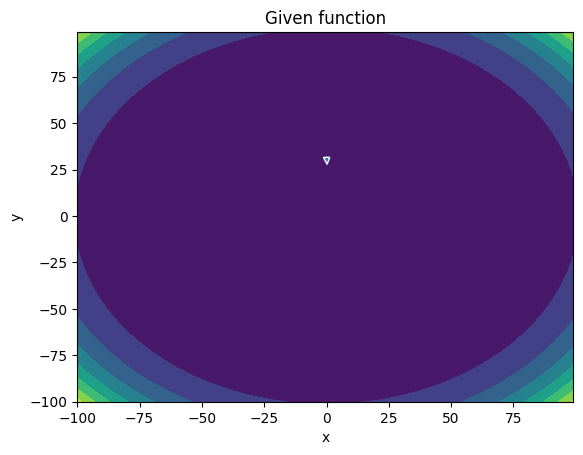

-------
Initial Coordinates:
[[ 0.04730226]
 [31.55403787]]
Final Coordinates:
[[ 0.04066733]
 [31.45534786]]
Gradient:
[[1.03936043e+05]
 [1.04123175e+09]]


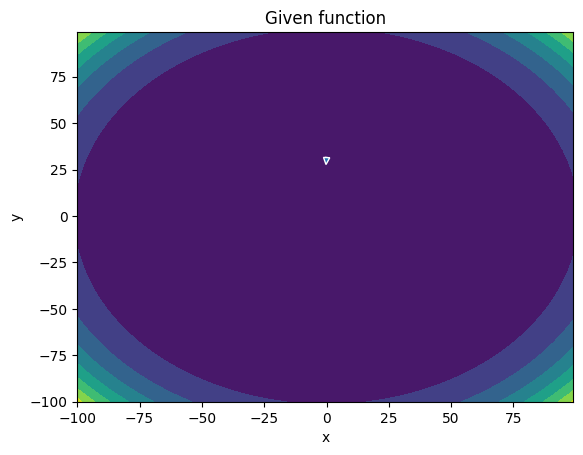

-------
Initial Coordinates:
[[ 0.04066733]
 [31.45534786]]
Final Coordinates:
[[ 0.04686859]
 [31.35666652]]
Gradient:
[[-1.18398577e+05]
 [ 1.02504003e+09]]


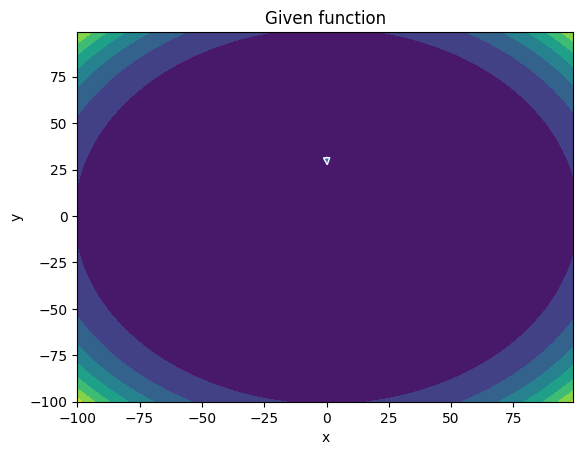

-------
Initial Coordinates:
[[ 0.04686859]
 [31.35666652]]
Final Coordinates:
[[ 0.04444082]
 [31.25799394]]
Gradient:
[[7.84276769e+04]
 [1.00905406e+09]]


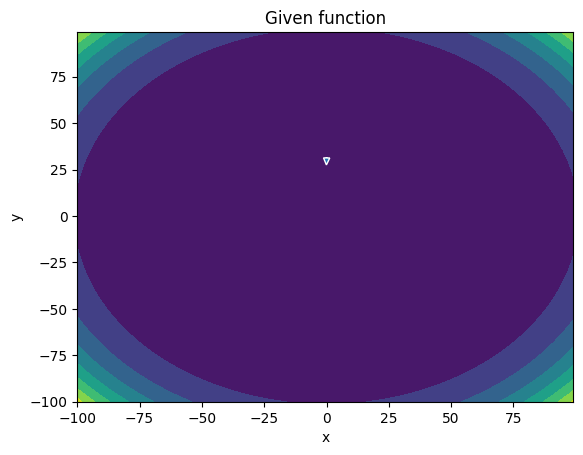

-------
Initial Coordinates:
[[ 0.04444082]
 [31.25799394]]
Final Coordinates:
[[ 0.04260402]
 [31.15933021]]
Gradient:
[[-4.27486881e+03]
 [ 9.93267967e+08]]


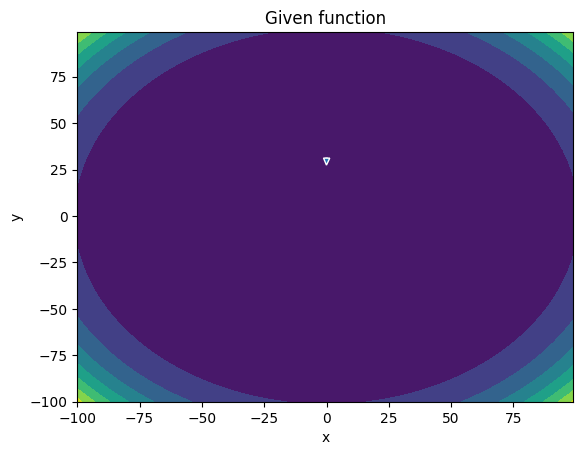

-------
Initial Coordinates:
[[ 0.04260402]
 [31.15933021]]
Final Coordinates:
[[ 0.04832609]
 [31.06067541]]
Gradient:
[[-6.63721904e+04]
 [ 9.77681554e+08]]


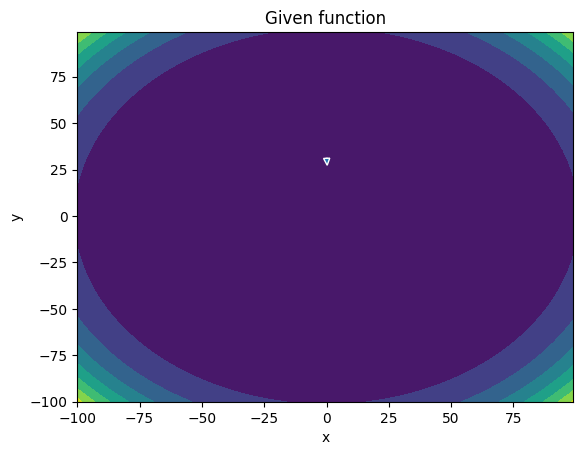

-------
Initial Coordinates:
[[ 0.04832609]
 [31.06067541]]
Final Coordinates:
[[ 0.04160243]
 [30.96202964]]
Gradient:
[[1.07591059e+05]
 [9.62294136e+08]]


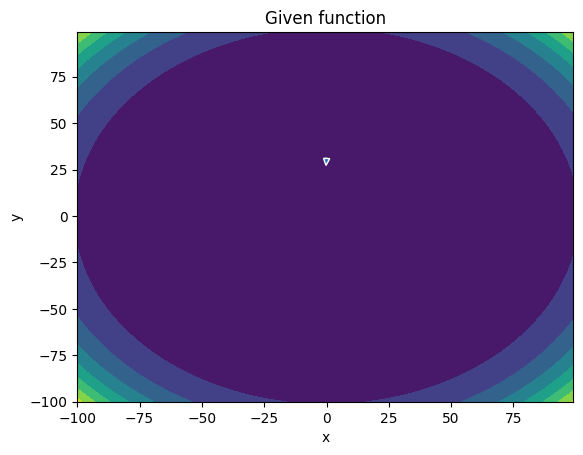

-------
Initial Coordinates:
[[ 0.04160243]
 [30.96202964]]
Final Coordinates:
[[ 0.04685694]
 [30.86339297]]
Gradient:
[[-1.04118411e+05]
 [ 9.47100208e+08]]


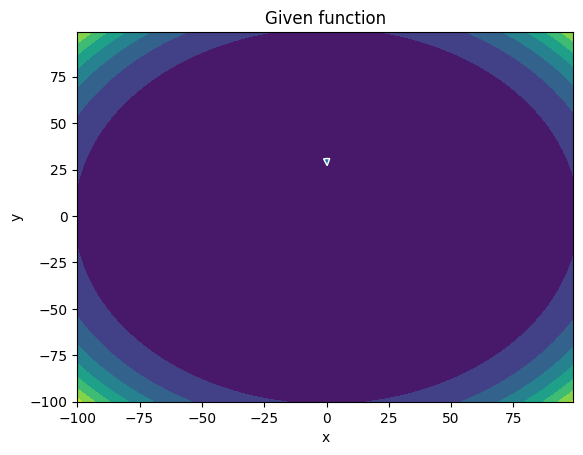

-------
Initial Coordinates:
[[ 0.04685694]
 [30.86339297]]
Final Coordinates:
[[ 0.04597649]
 [30.76476551]]
Gradient:
[[5.17762166e+04]
 [9.32102246e+08]]


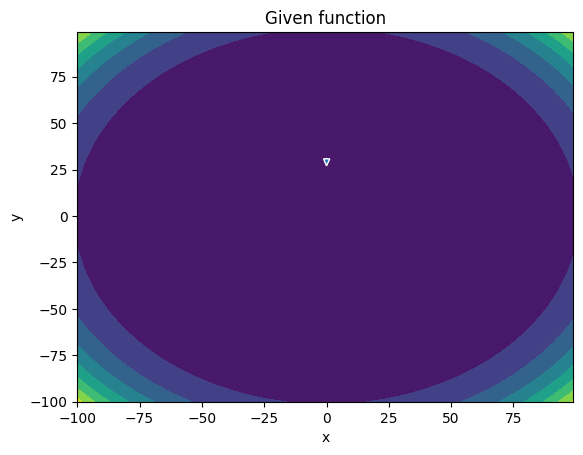

-------
Initial Coordinates:
[[ 0.04597649]
 [30.76476551]]
Final Coordinates:
[[ 0.04273718]
 [30.66614733]]
Gradient:
[[2.05052981e+04]
 [9.17295181e+08]]


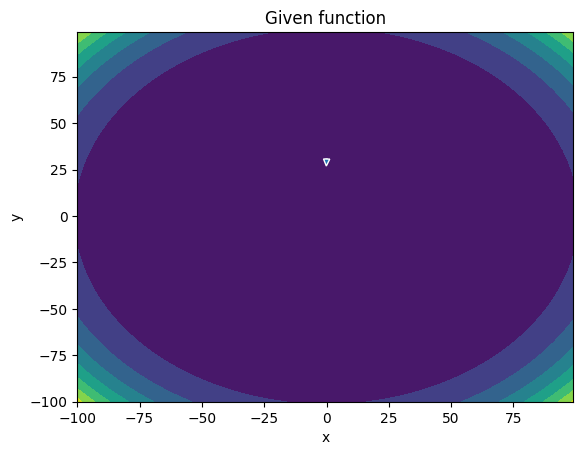

-------
Initial Coordinates:
[[ 0.04273718]
 [30.66614733]]
Final Coordinates:
[[ 0.04919848]
 [30.56753854]]
Gradient:
[[-7.95428489e+04]
 [ 9.02677838e+08]]


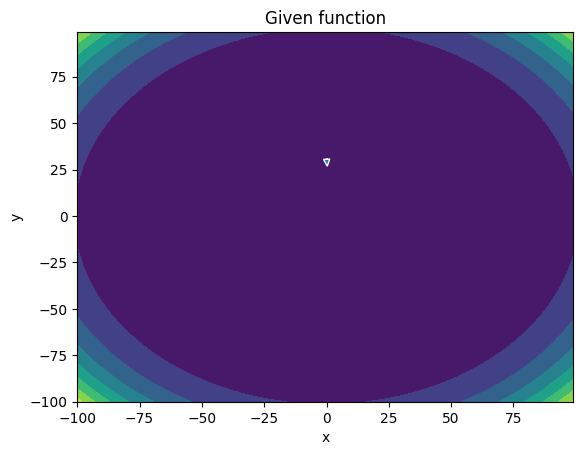

-------
Initial Coordinates:
[[ 0.04919848]
 [30.56753854]]
Final Coordinates:
[[ 0.04275526]
 [30.46893922]]
Gradient:
[[1.05247190e+05]
 [8.88250446e+08]]


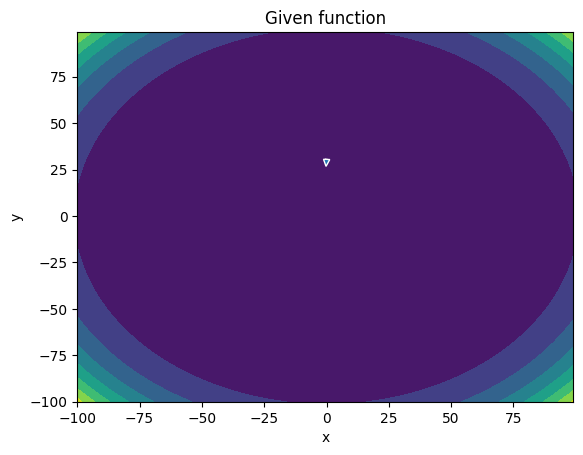

-------
Initial Coordinates:
[[ 0.04275526]
 [30.46893922]]
Final Coordinates:
[[ 0.04679155]
 [30.37034948]]
Gradient:
[[-8.54455561e+04]
 [ 8.74007225e+08]]


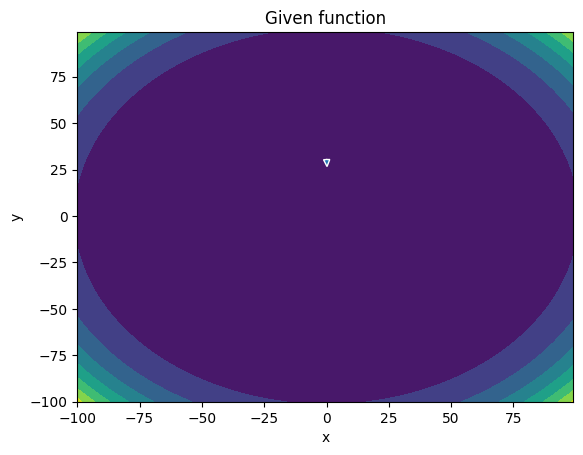

-------
Initial Coordinates:
[[ 0.04679155]
 [30.37034948]]
Final Coordinates:
[[ 0.04747074]
 [30.2717694 ]]
Gradient:
[[2.59080944e+04]
 [8.59950408e+08]]


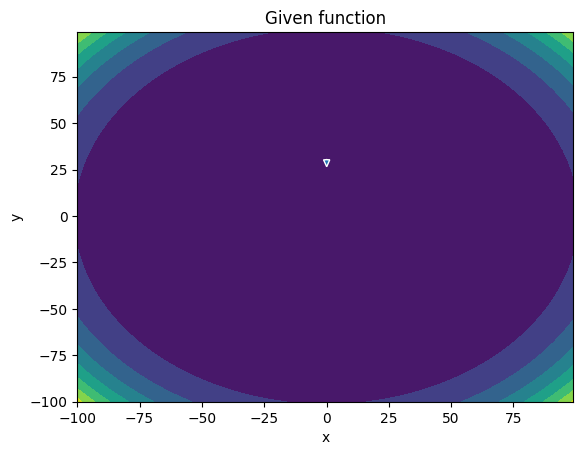

-------
Initial Coordinates:
[[ 0.04747074]
 [30.2717694 ]]
Final Coordinates:
[[ 0.04302644]
 [30.17319909]]
Gradient:
[[4.04032297e+04]
 [8.46075817e+08]]


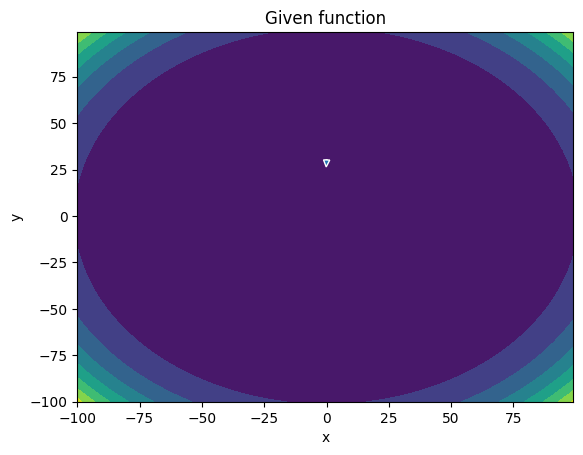

-------
Initial Coordinates:
[[ 0.04302644]
 [30.17319909]]
Final Coordinates:
[[ 0.04990636]
 [30.07463864]]
Gradient:
[[-8.70671709e+04]
 [ 8.32381360e+08]]


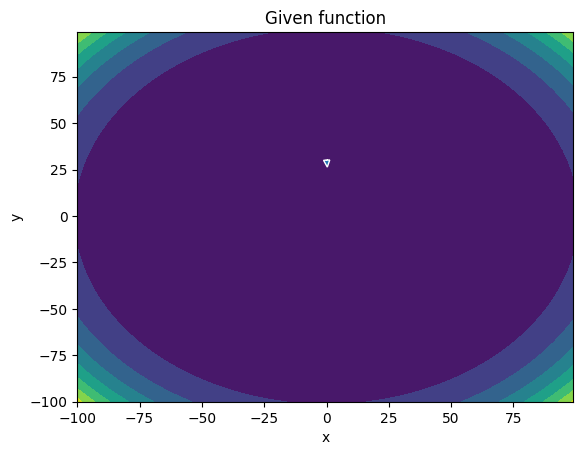

-------
Initial Coordinates:
[[ 0.04990636]
 [30.07463864]]
Final Coordinates:
[[ 0.04408866]
 [29.97608816]]
Gradient:
[[9.75532714e+04]
 [8.18868004e+08]]


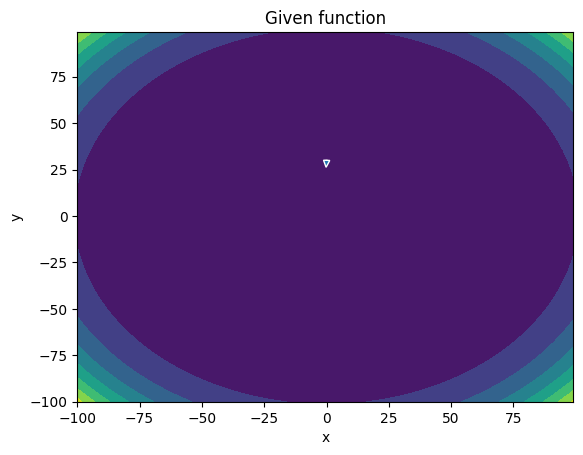

-------
Initial Coordinates:
[[ 0.04408866]
 [29.97608816]]
Final Coordinates:
[[ 0.04673849]
 [29.87754773]]
Gradient:
[[-6.43976233e+04]
 [ 8.05529920e+08]]


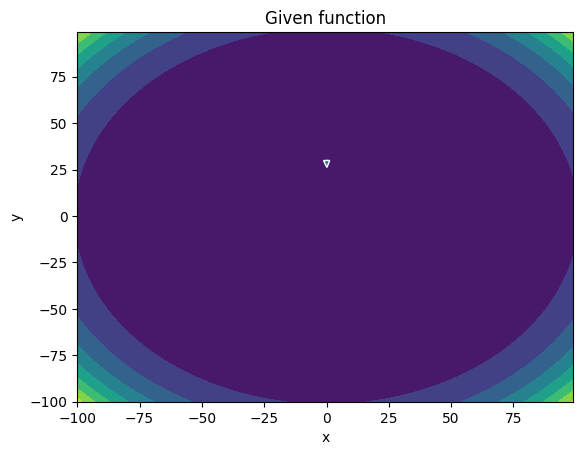

-------
Initial Coordinates:
[[ 0.04673849]
 [29.87754773]]
Final Coordinates:
[[ 0.04889149]
 [29.77901748]]
Gradient:
[[2.75808752e+03]
 [7.92368911e+08]]


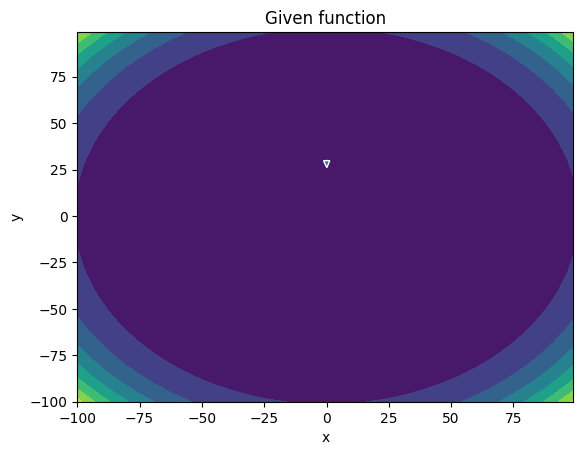

-------
Initial Coordinates:
[[ 0.04889149]
 [29.77901748]]
Final Coordinates:
[[ 0.04349023]
 [29.6804975 ]]
Gradient:
[[5.51147944e+04]
 [7.79381737e+08]]


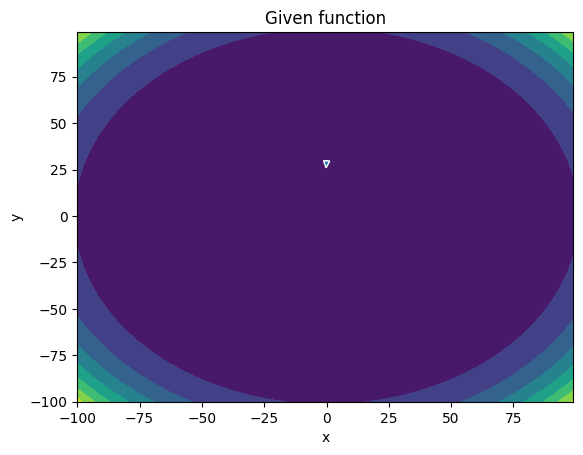

-------
Initial Coordinates:
[[ 0.04349023]
 [29.6804975 ]]
Final Coordinates:
[[ 0.05045542]
 [29.58198789]]
Gradient:
[[-8.93499513e+04]
 [ 7.66565490e+08]]


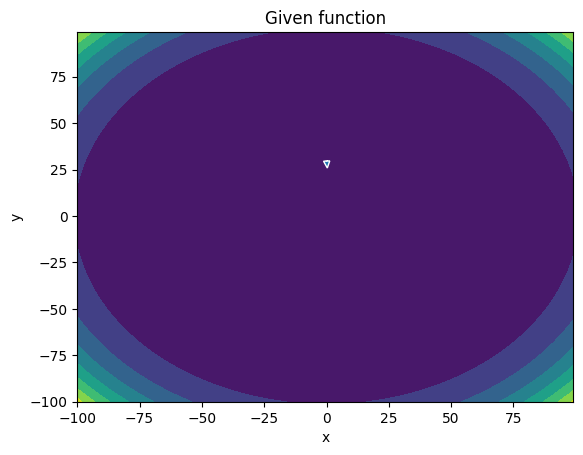

-------
Initial Coordinates:
[[ 0.05045542]
 [29.58198789]]
Final Coordinates:
[[ 0.04555113]
 [29.48348877]]
Gradient:
[[8.56373871e+04]
 [7.53921682e+08]]


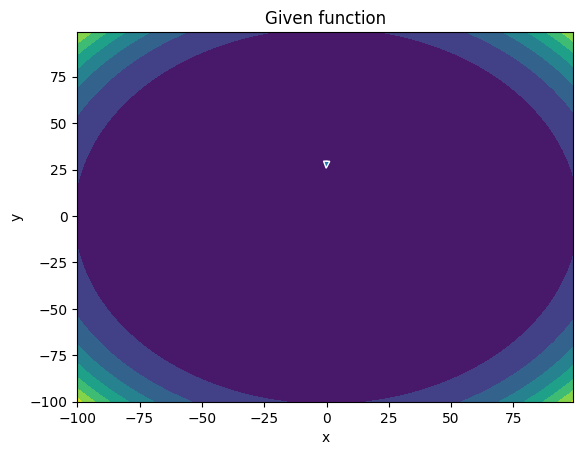

-------
Initial Coordinates:
[[ 0.04555113]
 [29.48348877]]
Final Coordinates:
[[ 0.0467478 ]
 [29.38500023]]
Gradient:
[[-4.29916461e+04]
 [ 7.41444645e+08]]


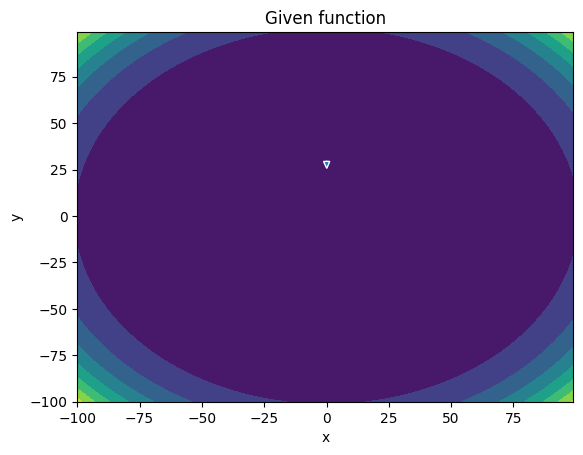

-------
Initial Coordinates:
[[ 0.0467478 ]
 [29.38500023]]
Final Coordinates:
[[ 0.05022454]
 [29.2865224 ]]
Gradient:
[[-1.66154101e+04]
 [ 7.29135614e+08]]


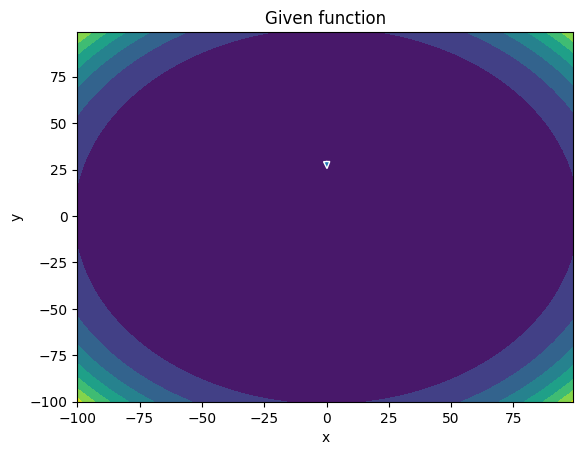

-------
Initial Coordinates:
[[ 0.05022454]
 [29.2865224 ]]
Final Coordinates:
[[ 0.0441392 ]
 [29.18805538]]
Gradient:
[[6.49529401e+04]
 [7.16992271e+08]]


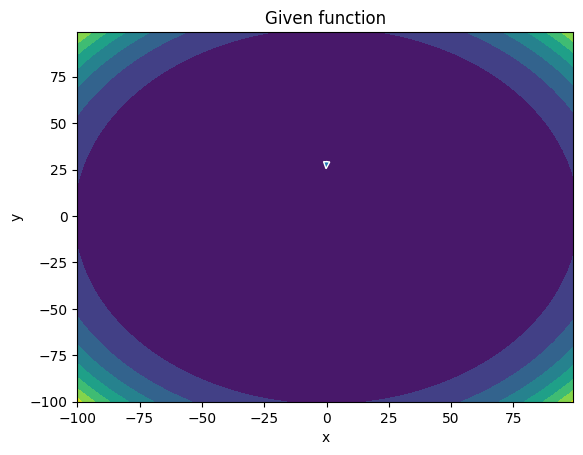

-------
Initial Coordinates:
[[ 0.0441392 ]
 [29.18805538]]
Final Coordinates:
[[ 0.05086538]
 [29.08959928]]
Gradient:
[[-8.70266174e+04]
 [ 7.05011038e+08]]


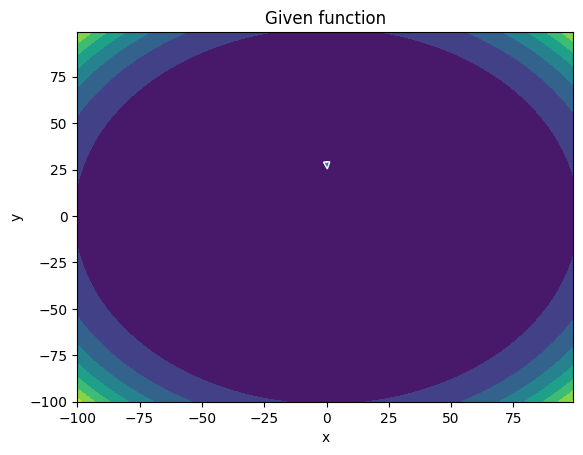

-------
Initial Coordinates:
[[ 0.05086538]
 [29.08959928]]
Final Coordinates:
[[ 0.04709408]
 [28.99115422]]
Gradient:
[[7.08324625e+04]
 [6.93193771e+08]]


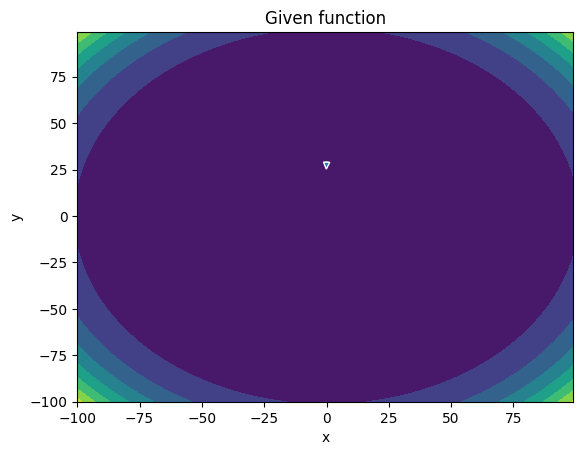

-------
Initial Coordinates:
[[ 0.04709408]
 [28.99115422]]
Final Coordinates:
[[ 0.04684854]
 [28.89272031]]
Gradient:
[[-2.27562512e+04]
 [ 6.81535143e+08]]


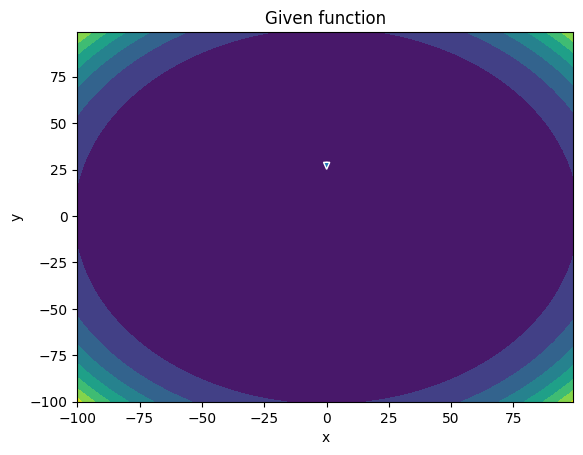

-------
Initial Coordinates:
[[ 0.04684854]
 [28.89272031]]
Final Coordinates:
[[ 0.05146378]
 [28.79429768]]
Gradient:
[[-3.19560576e+04]
 [ 6.70035734e+08]]


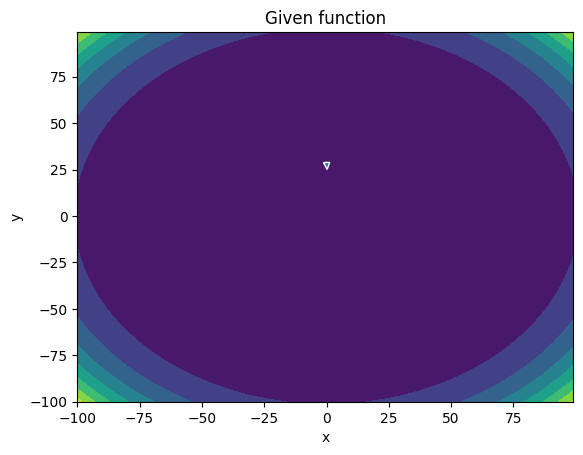

-------
Initial Coordinates:
[[ 0.05146378]
 [28.79429768]]
Final Coordinates:
[[ 0.04498003]
 [28.69588643]]
Gradient:
[[7.04559845e+04]
 [6.58694095e+08]]


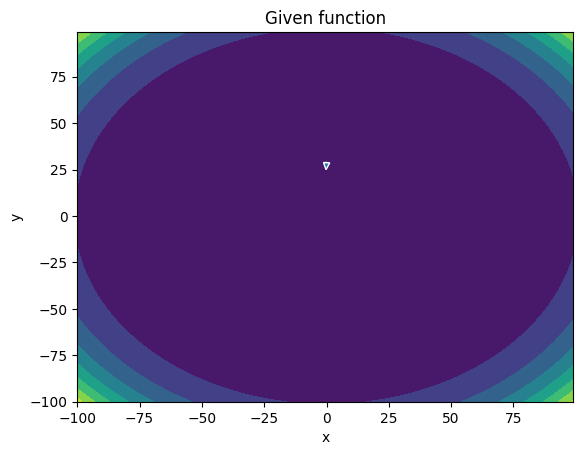

-------
Initial Coordinates:
[[ 0.04498003]
 [28.69588643]]
Final Coordinates:
[[ 0.05116442]
 [28.59748669]]
Gradient:
[[-8.08040436e+04]
 [ 6.47506128e+08]]


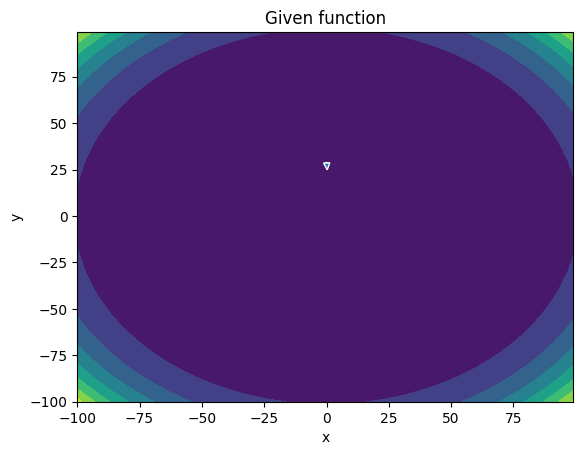

-------
Initial Coordinates:
[[ 0.05116442]
 [28.59748669]]
Final Coordinates:
[[ 0.04867682]
 [28.49909859]]
Gradient:
[[5.44509788e+04]
 [6.36473854e+08]]


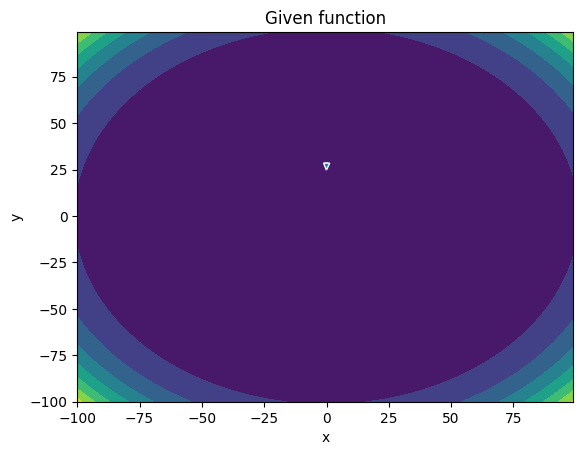

-------
Initial Coordinates:
[[ 0.04867682]
 [28.49909859]]
Final Coordinates:
[[ 0.04705837]
 [28.40072223]]
Gradient:
[[-4.69347220e+03]
 [ 6.25592428e+08]]


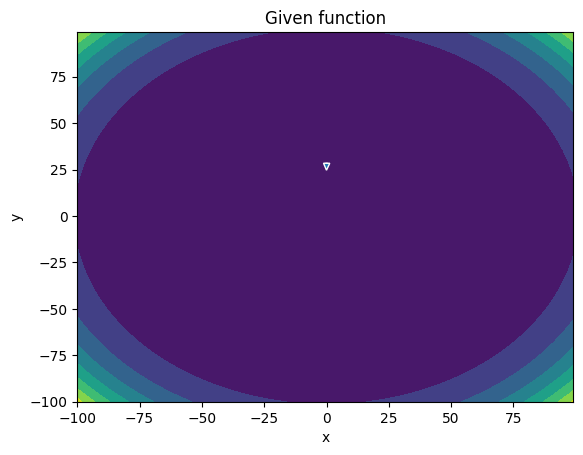

-------
Initial Coordinates:
[[ 0.04705837]
 [28.40072223]]
Final Coordinates:
[[ 0.05260161]
 [28.30235776]]
Gradient:
[[-4.34010769e+04]
 [ 6.14861729e+08]]


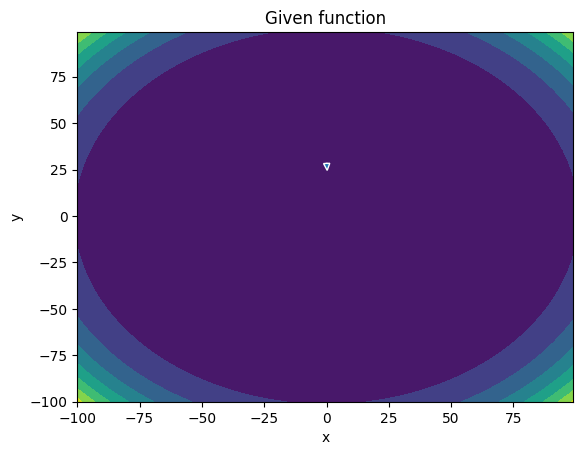

-------
Initial Coordinates:
[[ 0.05260161]
 [28.30235776]]
Final Coordinates:
[[ 0.04601367]
 [28.2040053 ]]
Gradient:
[[7.21103519e+04]
 [6.04281098e+08]]


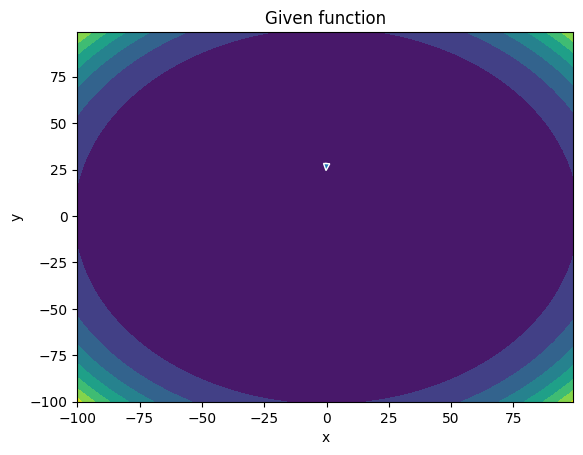

-------
Initial Coordinates:
[[ 0.04601367]
 [28.2040053 ]]
Final Coordinates:
[[ 0.05138996]
 [28.10566498]]
Gradient:
[[-7.14635610e+04]
 [ 5.93846079e+08]]


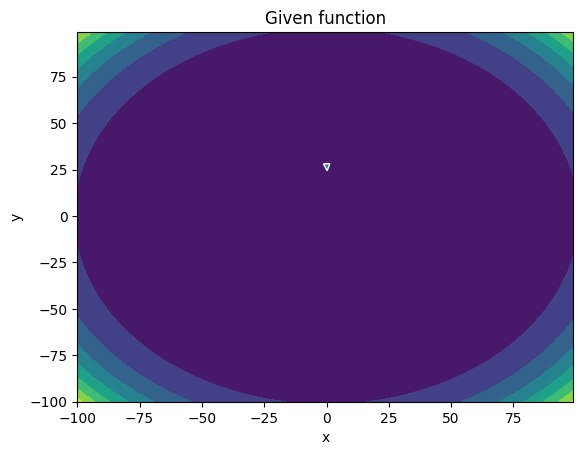

-------
Initial Coordinates:
[[ 0.05138996]
 [28.10566498]]
Final Coordinates:
[[ 0.05026352]
 [28.00733692]]
Gradient:
[[3.77583582e+04]
 [5.83558682e+08]]


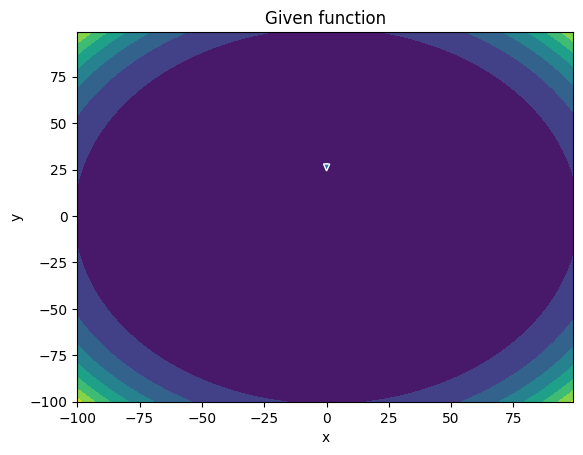

-------
Initial Coordinates:
[[ 0.05026352]
 [28.00733692]]
Final Coordinates:
[[ 0.0473925 ]
 [27.90902126]]
Gradient:
[[1.05595495e+04]
 [5.73414655e+08]]


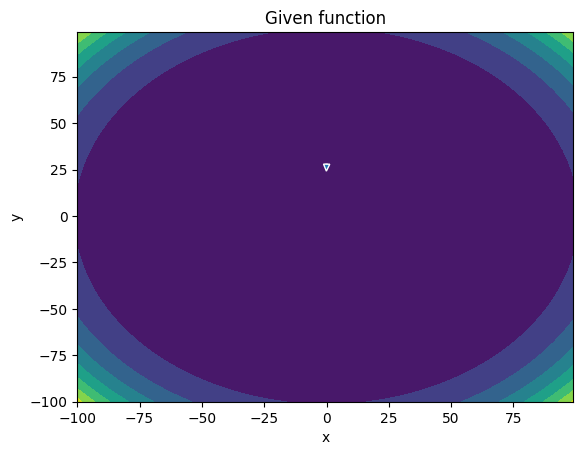

-------
Initial Coordinates:
[[ 0.0473925 ]
 [27.90902126]]
Final Coordinates:
[[ 0.05362912]
 [27.81071814]]
Gradient:
[[-5.11950991e+04]
 [ 5.63413174e+08]]


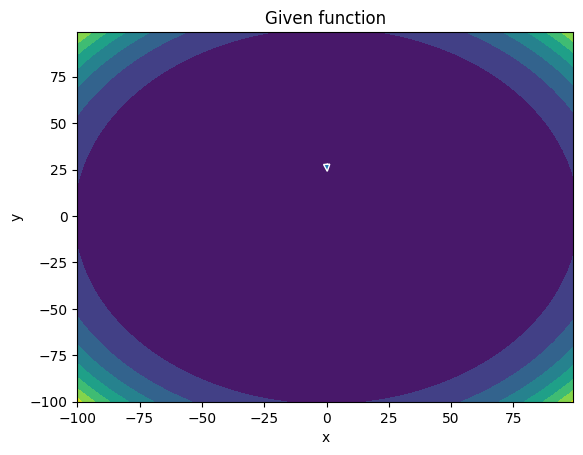

-------
Initial Coordinates:
[[ 0.05362912]
 [27.81071814]]
Final Coordinates:
[[ 0.04722819]
 [27.71242768]]
Gradient:
[[7.03643422e+04]
 [5.53554265e+08]]


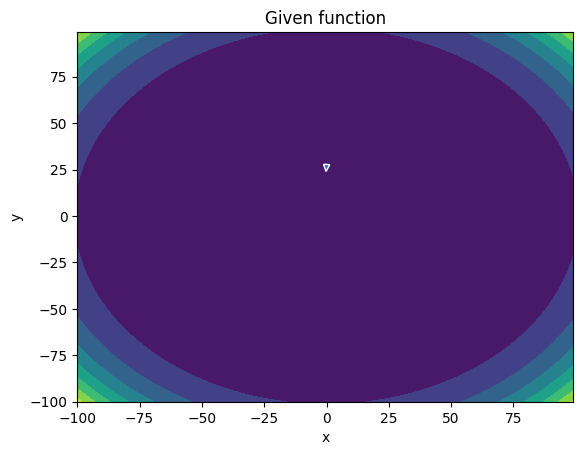

-------
Initial Coordinates:
[[ 0.04722819]
 [27.71242768]]
Final Coordinates:
[[ 0.05158857]
 [27.61415004]]
Gradient:
[[-5.99607968e+04]
 [ 5.43833272e+08]]


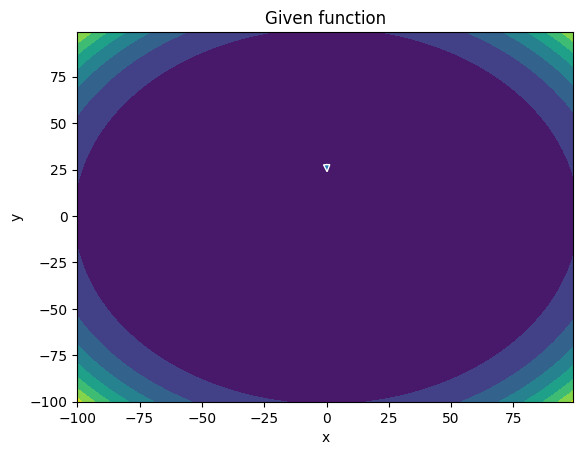

-------
Initial Coordinates:
[[ 0.05158857]
 [27.61415004]]
Final Coordinates:
[[ 0.05182385]
 [27.51588534]]
Gradient:
[[2.19323922e+04]
 [5.34252048e+08]]


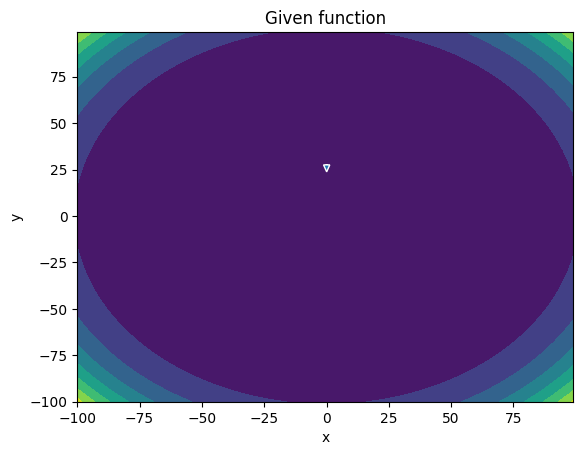

-------
Initial Coordinates:
[[ 0.05182385]
 [27.51588534]]
Final Coordinates:
[[ 0.04786448]
 [27.41763374]]
Gradient:
[[2.26745699e+04]
 [5.24806996e+08]]


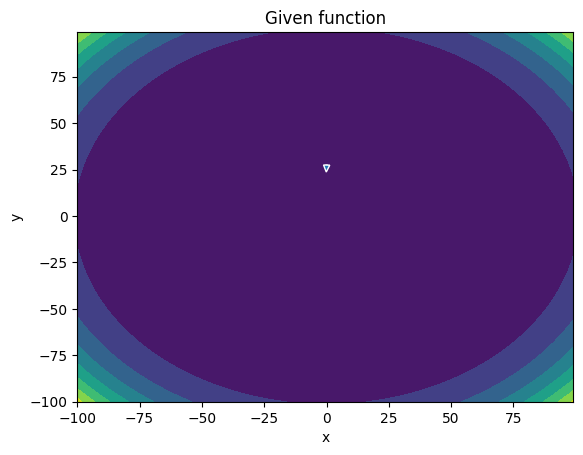

-------
Initial Coordinates:
[[ 0.04786448]
 [27.41763374]]
Final Coordinates:
[[ 0.05454342]
 [27.31939537]]
Gradient:
[[-5.56471537e+04]
 [ 5.15496634e+08]]


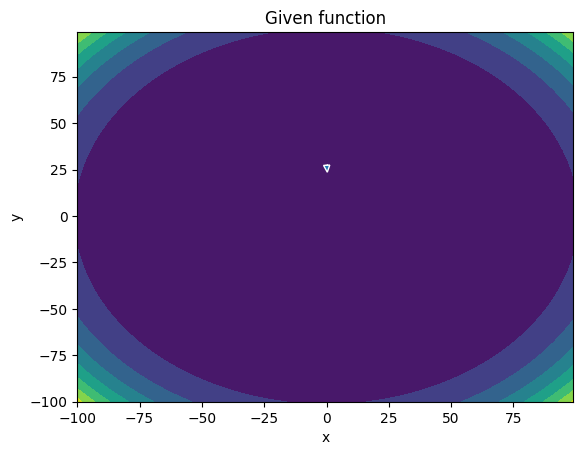

-------
Initial Coordinates:
[[ 0.05454342]
 [27.31939537]]
Final Coordinates:
[[ 0.04859618]
 [27.22117038]]
Gradient:
[[6.57688625e+04]
 [5.06321545e+08]]


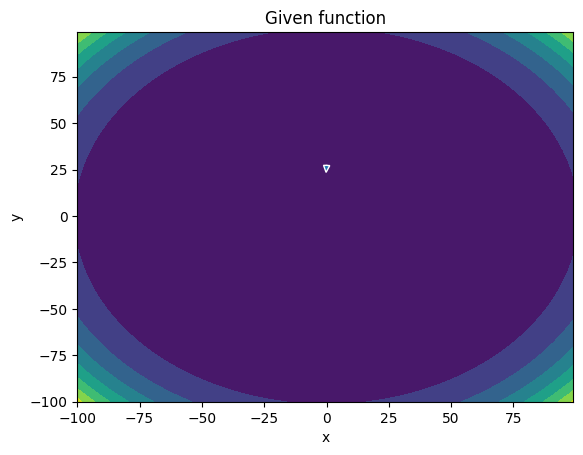

-------
Initial Coordinates:
[[ 0.04859618]
 [27.22117038]]
Final Coordinates:
[[ 0.05180772]
 [27.12295892]]
Gradient:
[[-4.73900361e+04]
 [ 4.97277028e+08]]


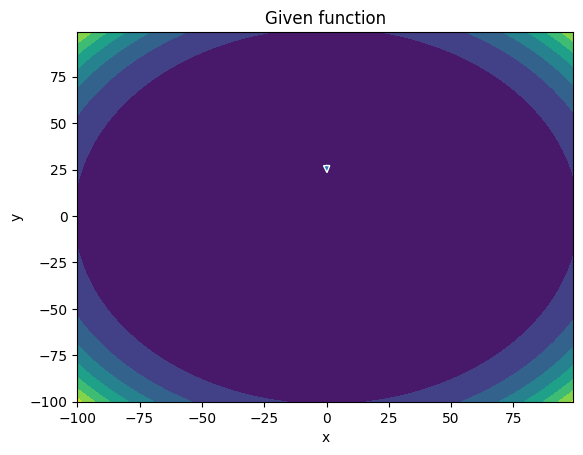

-------
Initial Coordinates:
[[ 0.05180772]
 [27.12295892]]
Final Coordinates:
[[ 0.05333803]
 [27.02476115]]
Gradient:
[[7.88253433e+03]
 [4.88364660e+08]]


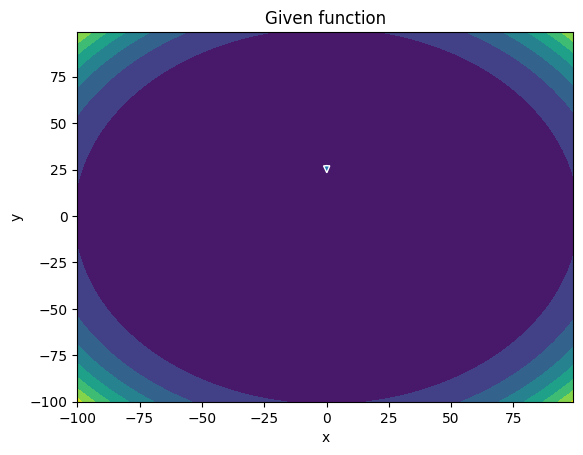

-------
Initial Coordinates:
[[ 0.05333803]
 [27.02476115]]
Final Coordinates:
[[ 0.04848317]
 [26.9265772 ]]
Gradient:
[[3.16591752e+04]
 [4.79581518e+08]]


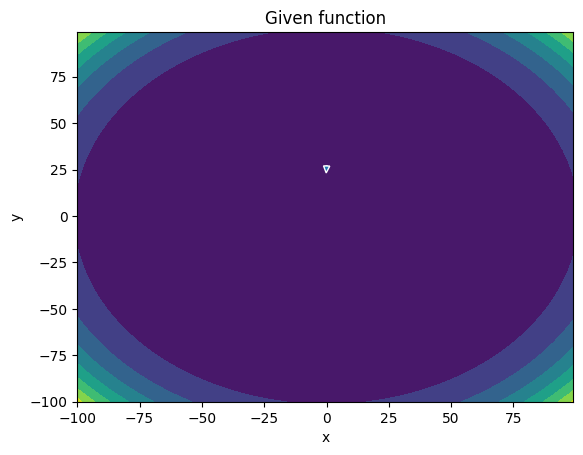

-------
Initial Coordinates:
[[ 0.04848317]
 [26.9265772 ]]
Final Coordinates:
[[ 0.0553519 ]
 [26.82840725]]
Gradient:
[[-5.71645997e+04]
 [ 4.70925540e+08]]


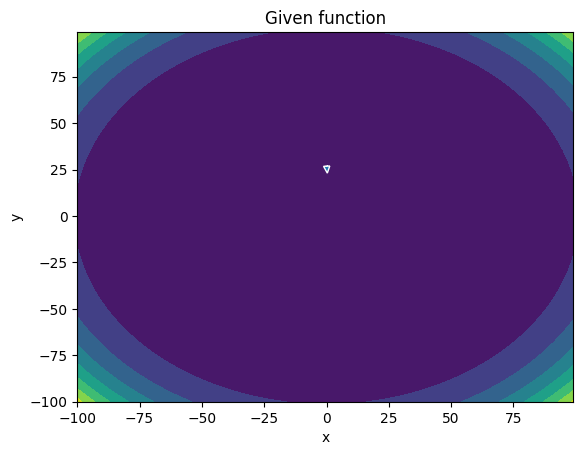

-------
Initial Coordinates:
[[ 0.0553519 ]
 [26.82840725]]
Final Coordinates:
[[ 0.05008229]
 [26.73025143]]
Gradient:
[[5.90102245e+04]
 [4.62397733e+08]]


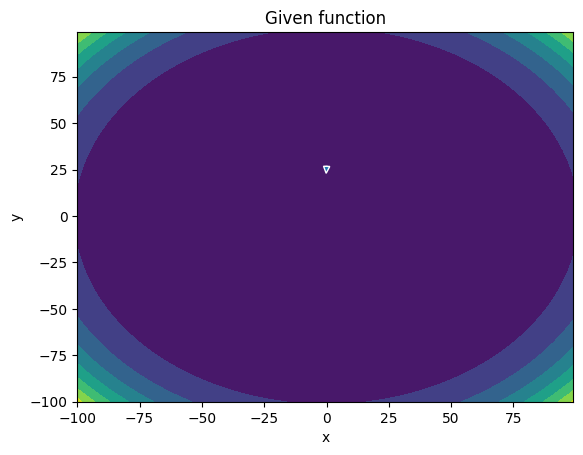

-------
Initial Coordinates:
[[ 0.05008229]
 [26.73025143]]
Final Coordinates:
[[ 0.0520843 ]
 [26.63210993]]
Gradient:
[[-3.47699689e+04]
 [ 4.53993488e+08]]


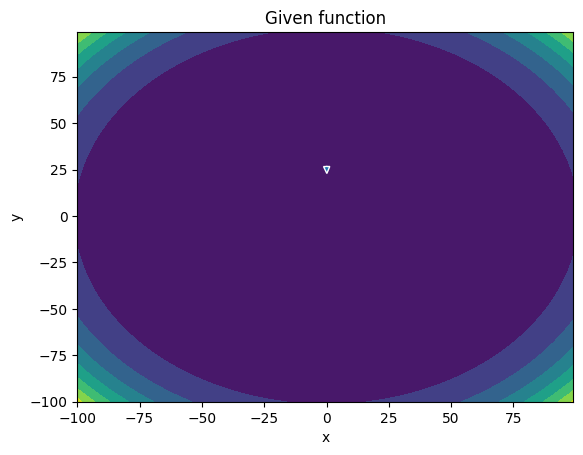

-------
Initial Coordinates:
[[ 0.0520843 ]
 [26.63210993]]
Final Coordinates:
[[ 0.05479867]
 [26.53398289]]
Gradient:
[[-3.91144458e+03]
 [ 4.45714015e+08]]


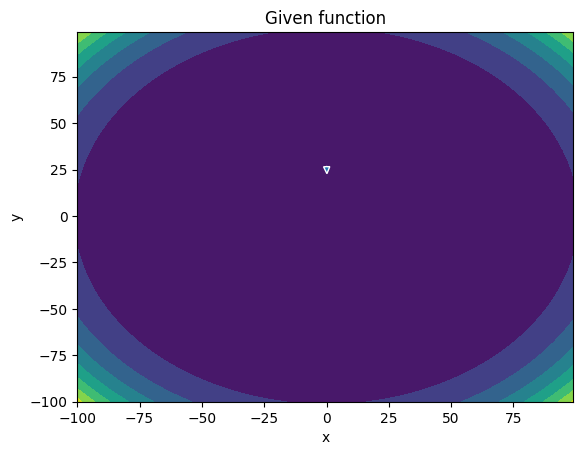

-------
Initial Coordinates:
[[ 0.05479867]
 [26.53398289]]
Final Coordinates:
[[ 0.04925264]
 [26.43587047]]
Gradient:
[[3.77992415e+04]
 [4.37557058e+08]]


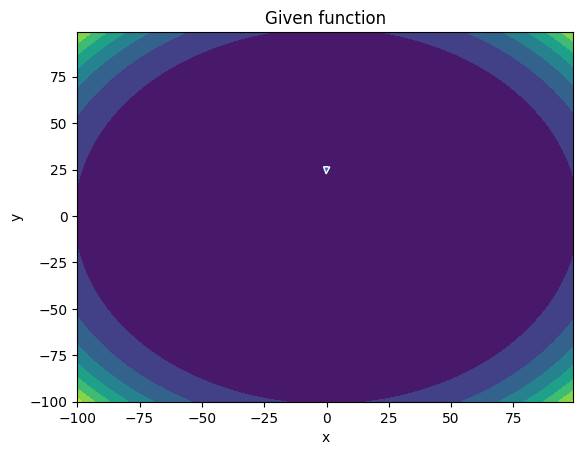

-------
Initial Coordinates:
[[ 0.04925264]
 [26.43587047]]
Final Coordinates:
[[ 0.05606964]
 [26.33777286]]
Gradient:
[[-5.62200612e+04]
 [ 4.29520065e+08]]


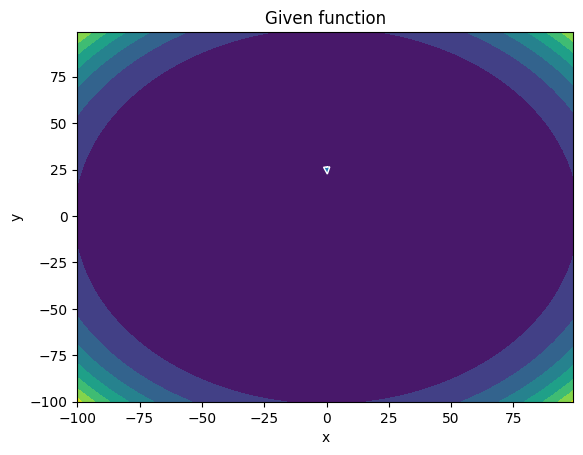

-------
Initial Coordinates:
[[ 0.05606964]
 [26.33777286]]
Final Coordinates:
[[ 0.05165368]
 [26.23969021]]
Gradient:
[[5.08053151e+04]
 [4.21604340e+08]]


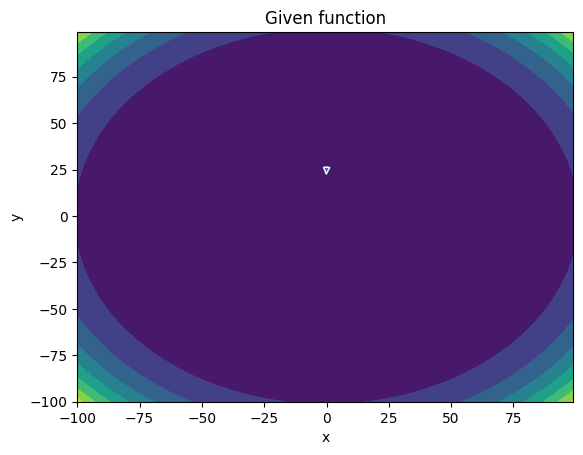

-------
Initial Coordinates:
[[ 0.05165368]
 [26.23969021]]
Final Coordinates:
[[ 0.05244067]
 [26.1416227 ]]
Gradient:
[[-2.28546008e+04]
 [ 4.13805480e+08]]


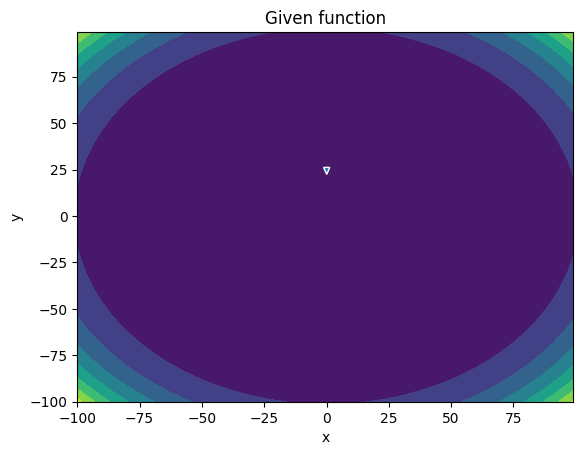

-------
Initial Coordinates:
[[ 0.05244067]
 [26.1416227 ]]
Final Coordinates:
[[ 0.05620581]
 [26.04357049]]
Gradient:
[[-1.33643213e+04]
 [ 4.06124273e+08]]


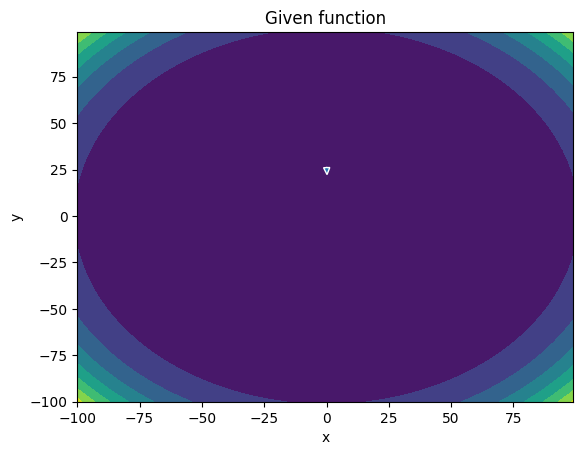

-------
Initial Coordinates:
[[ 0.05620581]
 [26.04357049]]
Final Coordinates:
[[ 0.05017501]
 [25.94553378]]
Gradient:
[[4.14968309e+04]
 [3.98559092e+08]]


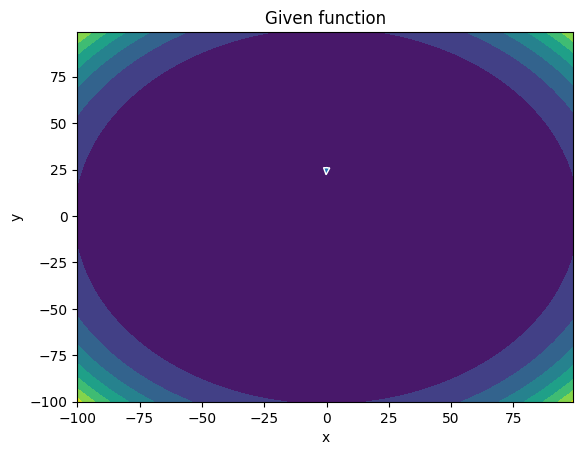

-------
Initial Coordinates:
[[ 0.05017501]
 [25.94553378]]
Final Coordinates:
[[ 0.05671529]
 [25.84751273]]
Gradient:
[[-5.32766188e+04]
 [ 3.91106998e+08]]


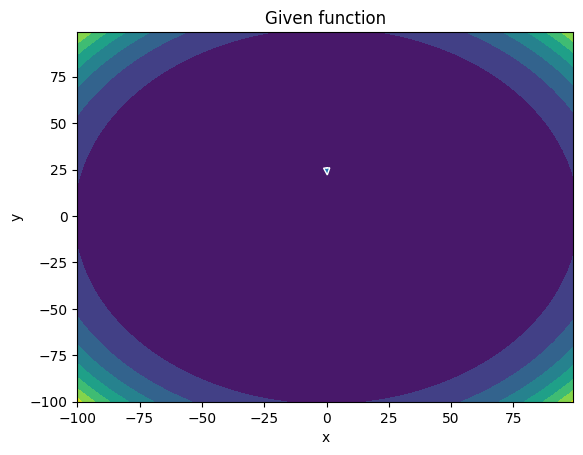

-------
Initial Coordinates:
[[ 0.05671529]
 [25.84751273]]
Final Coordinates:
[[ 0.05328374]
 [25.74950753]]
Gradient:
[[4.18041205e+04]
 [3.83769470e+08]]


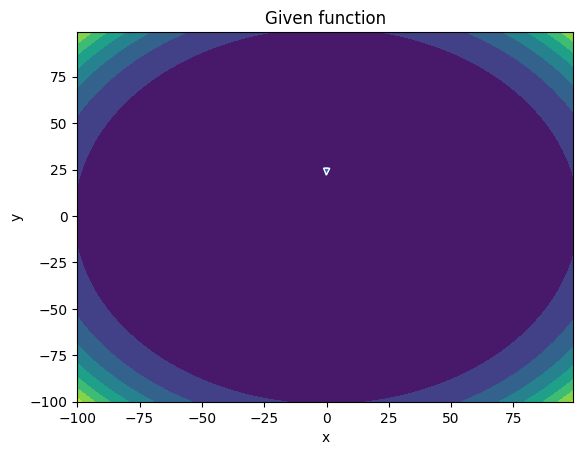

-------
Initial Coordinates:
[[ 0.05328374]
 [25.74950753]]
Final Coordinates:
[[ 0.05288976]
 [25.65151836]]
Gradient:
[[-1.21196666e+04]
 [ 3.76542403e+08]]


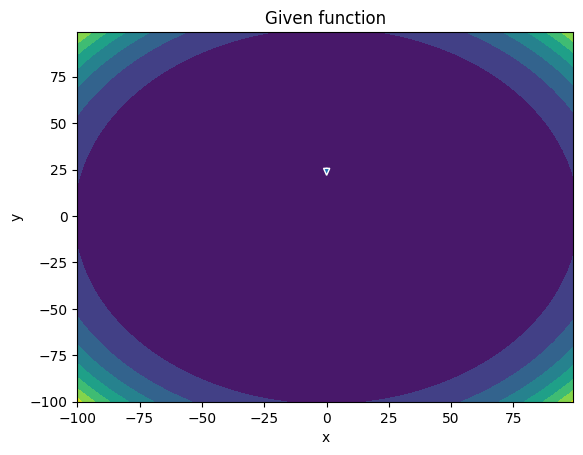

-------
Initial Coordinates:
[[ 0.05288976]
 [25.65151836]]
Final Coordinates:
[[ 0.05755999]
 [25.55354541]]
Gradient:
[[-2.06054506e+04]
 [ 3.69426135e+08]]


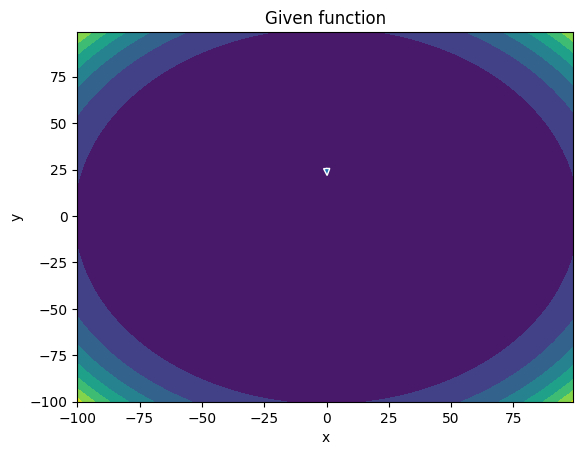

-------
Initial Coordinates:
[[ 0.05755999]
 [25.55354541]]
Final Coordinates:
[[ 0.0512516 ]
 [25.45558887]]
Gradient:
[[4.31266540e+04]
 [3.62419616e+08]]


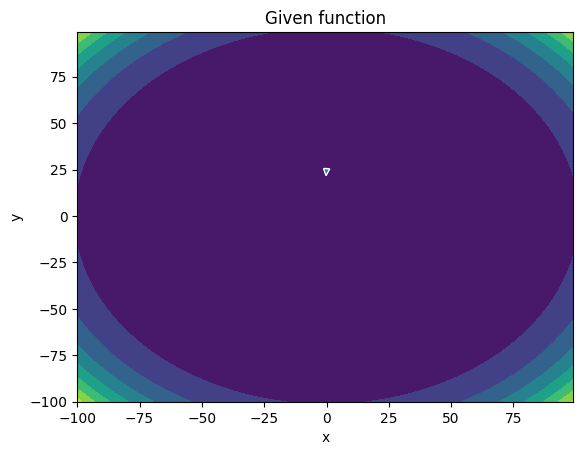

-------
Initial Coordinates:
[[ 0.0512516 ]
 [25.45558887]]
Final Coordinates:
[[ 0.05731107]
 [25.35764893]]
Gradient:
[[-4.87629677e+04]
 [ 3.55519619e+08]]


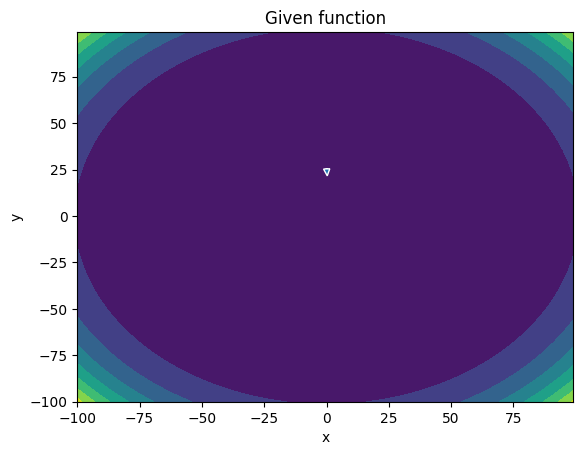

-------
Initial Coordinates:
[[ 0.05731107]
 [25.35764893]]
Final Coordinates:
[[ 0.05494947]
 [25.2597258 ]]
Gradient:
[[3.25832149e+04]
 [3.48727692e+08]]


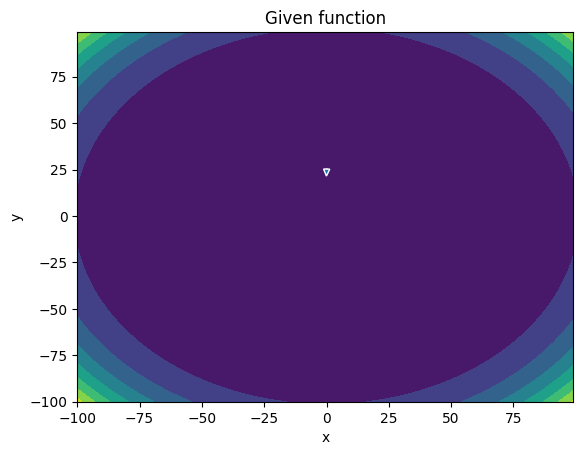

-------
Initial Coordinates:
[[ 0.05494947]
 [25.2597258 ]]
Final Coordinates:
[[ 0.05344195]
 [25.16181966]]
Gradient:
[[-2.85648290e+03]
 [ 3.42040099e+08]]


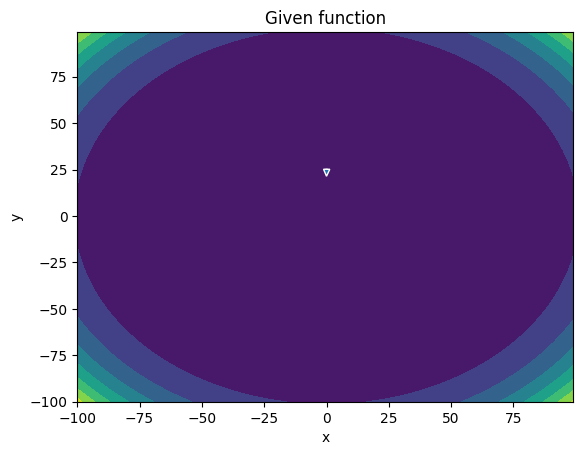

-------
Initial Coordinates:
[[ 0.05344195]
 [25.16181966]]
Final Coordinates:
[[ 0.05885959]
 [25.06393072]]
Gradient:
[[-2.58229164e+04]
 [ 3.35456718e+08]]


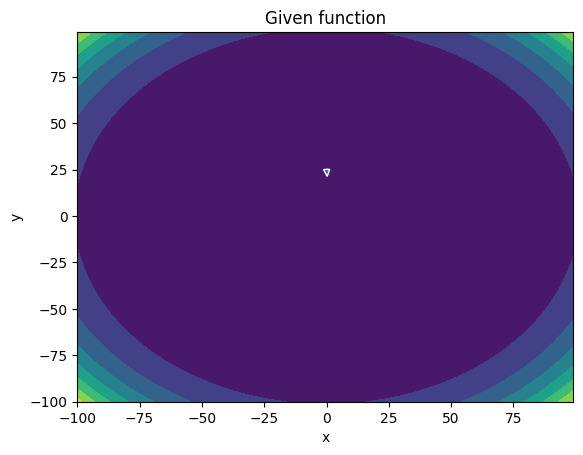

-------
Initial Coordinates:
[[ 0.05885959]
 [25.06393072]]
Final Coordinates:
[[ 0.05247968]
 [24.96605918]]
Gradient:
[[4.29997194e+04]
 [3.28977016e+08]]


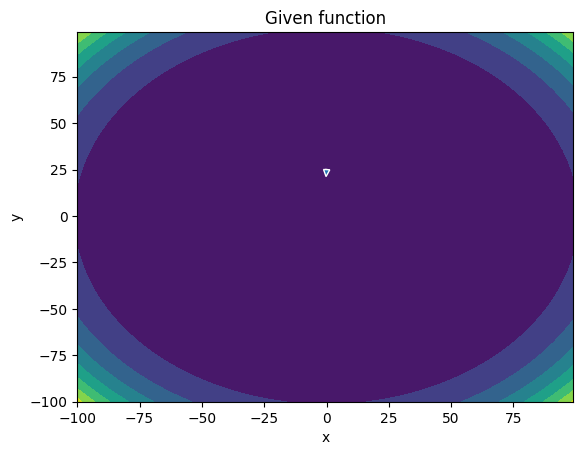

-------
Initial Coordinates:
[[ 0.05247968]
 [24.96605918]]
Final Coordinates:
[[ 0.05788518]
 [24.86820526]]
Gradient:
[[-4.31134360e+04]
 [ 3.22597575e+08]]


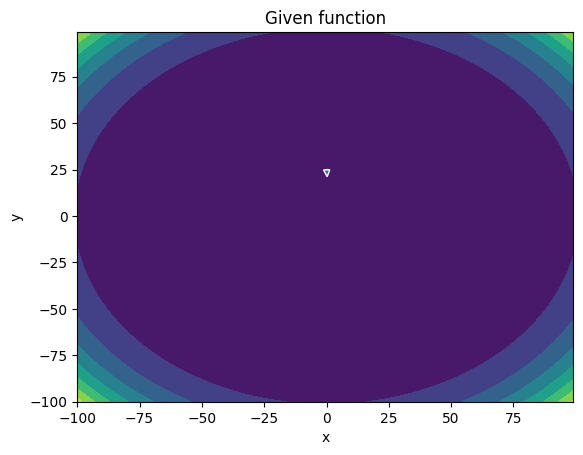

-------
Initial Coordinates:
[[ 0.05788518]
 [24.86820526]]
Final Coordinates:
[[ 0.05662918]
 [24.77036916]]
Gradient:
[[2.36720740e+04]
 [3.16319919e+08]]


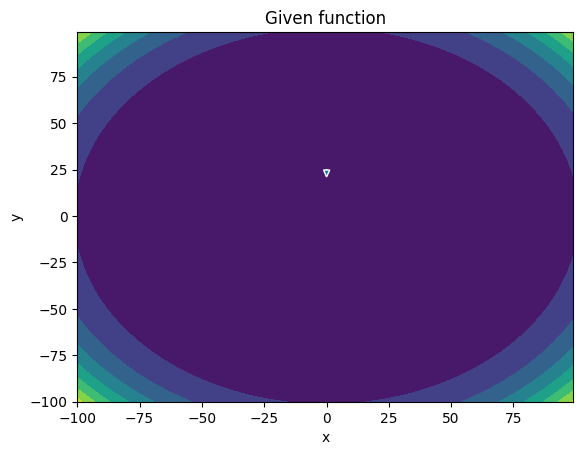

-------
Initial Coordinates:
[[ 0.05662918]
 [24.77036916]]
Final Coordinates:
[[ 0.05410759]
 [24.6725511 ]]
Gradient:
[[4.76277322e+03]
 [3.10140725e+08]]


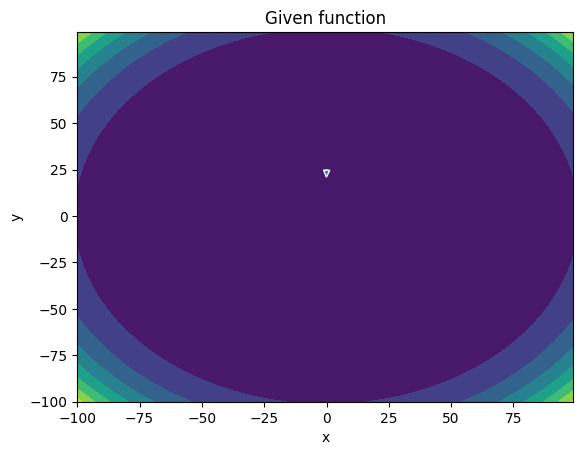

-------
Initial Coordinates:
[[ 0.05410759]
 [24.6725511 ]]
Final Coordinates:
[[ 0.0601036]
 [24.5747513]]
Gradient:
[[-2.92137849e+04]
 [ 3.04059432e+08]]


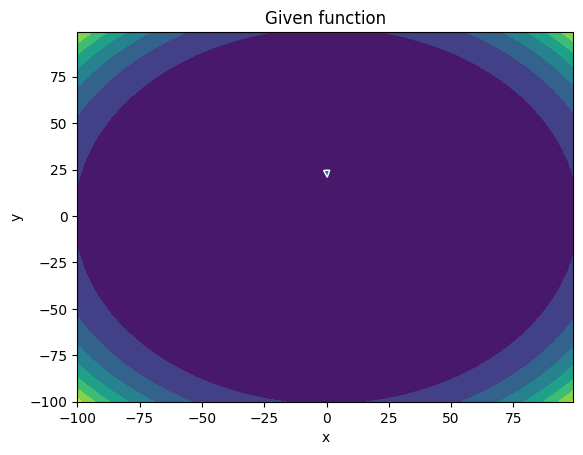

-------
Initial Coordinates:
[[ 0.0601036]
 [24.5747513]]
Final Coordinates:
[[ 0.05384808]
 [24.47696998]]
Gradient:
[[4.14110595e+04]
 [2.98075946e+08]]


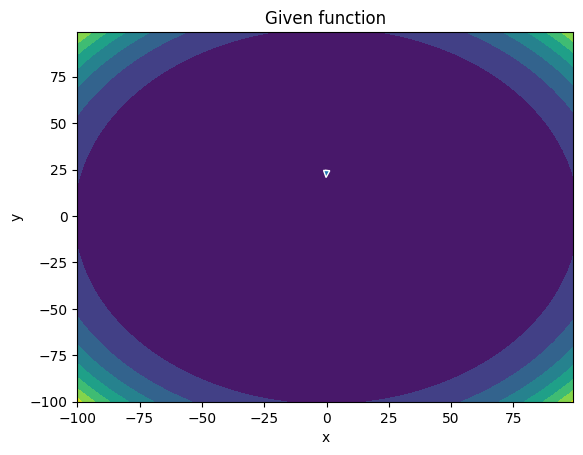

-------
Initial Coordinates:
[[ 0.05384808]
 [24.47696998]]
Final Coordinates:
[[ 0.05847103]
 [24.37920736]]
Gradient:
[[-3.68025273e+04]
 [ 2.92186755e+08]]


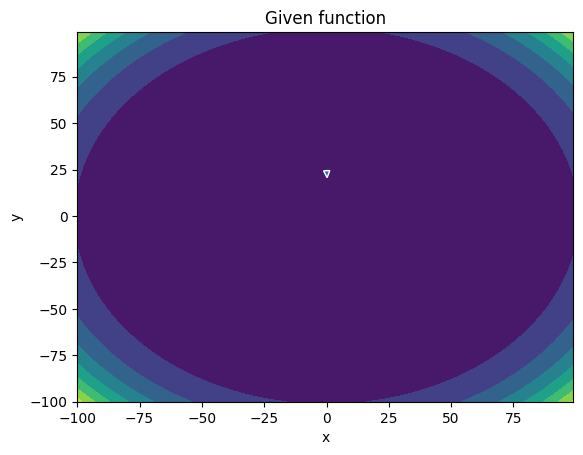

-------
Initial Coordinates:
[[ 0.05847103]
 [24.37920736]]
Final Coordinates:
[[ 0.05830458]
 [24.28146367]]
Gradient:
[[1.55300218e+04]
 [2.86393278e+08]]


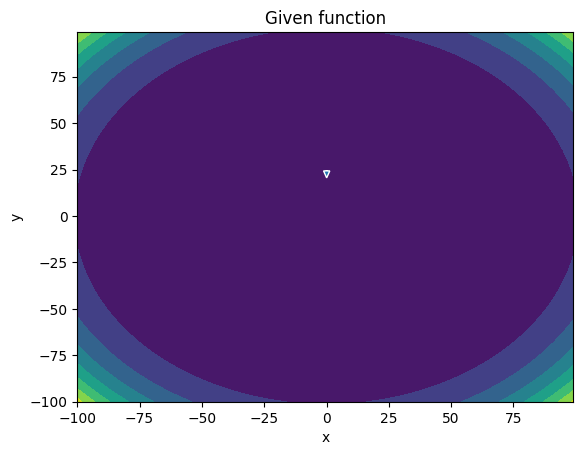

-------
Initial Coordinates:
[[ 0.05830458]
 [24.28146367]]
Final Coordinates:
[[ 0.05489501]
 [24.18373915]]
Gradient:
[[1.06879656e+04]
 [2.80692631e+08]]


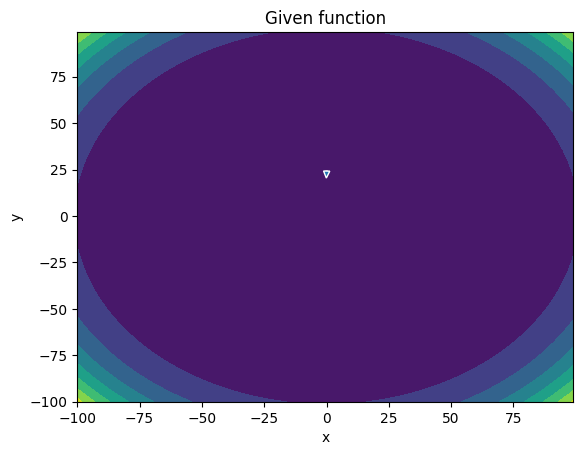

-------
Initial Coordinates:
[[ 0.05489501]
 [24.18373915]]
Final Coordinates:
[[ 0.06129627]
 [24.08603402]]
Gradient:
[[-3.1002856e+04]
 [ 2.7508385e+08]]


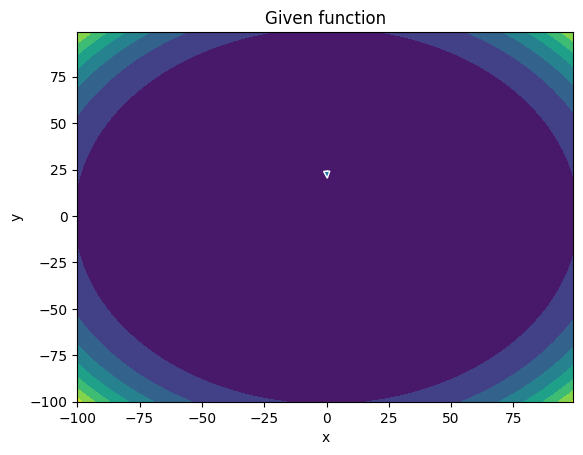

-------
Initial Coordinates:
[[ 0.06129627]
 [24.08603402]]
Final Coordinates:
[[ 0.05533724]
 [23.98834853]]
Gradient:
[[3.86883195e+04]
 [2.69567201e+08]]


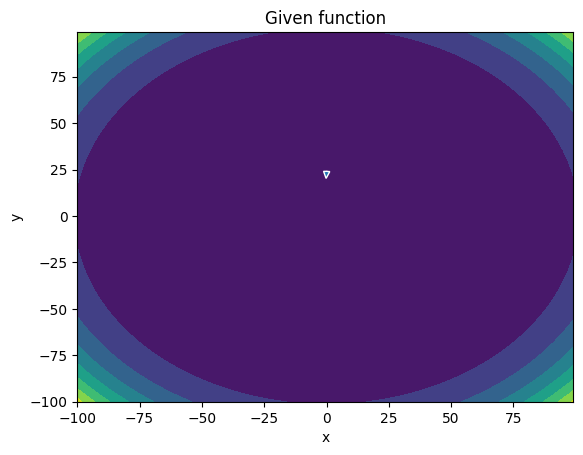

-------
Initial Coordinates:
[[ 0.05533724]
 [23.98834853]]
Final Coordinates:
[[ 0.05910131]
 [23.89068292]]
Gradient:
[[-3.03114414e+04]
 [ 2.64139161e+08]]


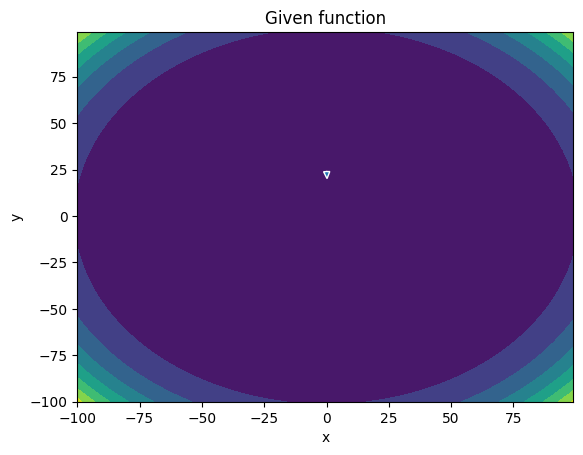

-------
Initial Coordinates:
[[ 0.05910131]
 [23.89068292]]
Final Coordinates:
[[ 0.05996492]
 [23.79303744]]
Gradient:
[[8.47599277e+03]
 [2.58800989e+08]]


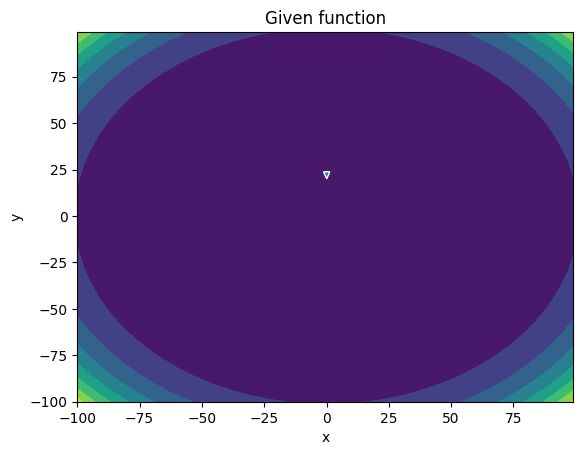

-------
Initial Coordinates:
[[ 0.05996492]
 [23.79303744]]
Final Coordinates:
[[ 0.05580794]
 [23.69541234]]
Gradient:
[[1.50073411e+04]
 [2.53550237e+08]]


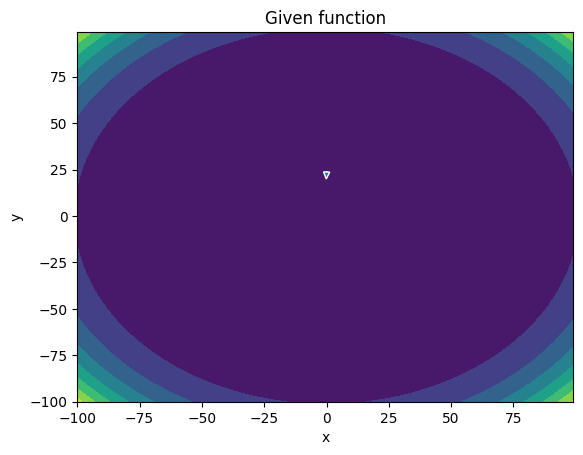

-------
Initial Coordinates:
[[ 0.05580794]
 [23.69541234]]
Final Coordinates:
[[ 0.06244847]
 [23.59780788]]
Gradient:
[[-3.14570161e+04]
 [ 2.48385589e+08]]


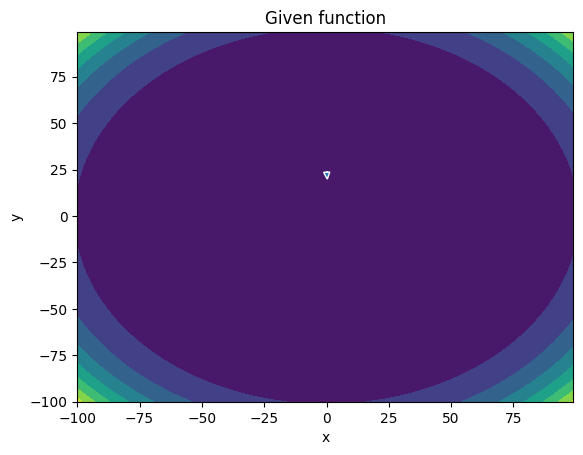

-------
Initial Coordinates:
[[ 0.06244847]
 [23.59780788]]
Final Coordinates:
[[ 0.05692461]
 [23.5002243 ]]
Gradient:
[[3.51845685e+04]
 [2.43307595e+08]]


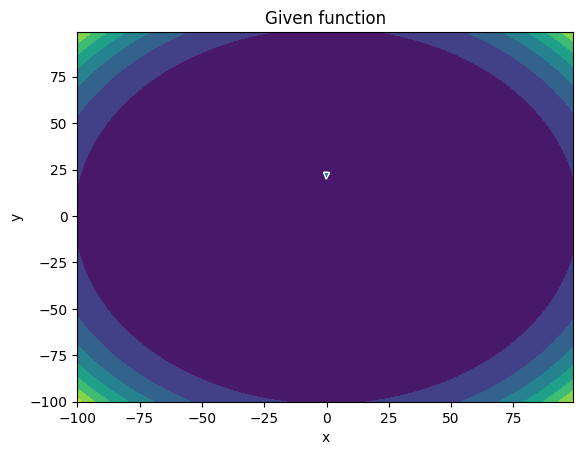

-------
Initial Coordinates:
[[ 0.05692461]
 [23.5002243 ]]
Final Coordinates:
[[ 0.05980118]
 [23.40266189]]
Gradient:
[[-2.40456952e+04]
 [ 2.38312791e+08]]


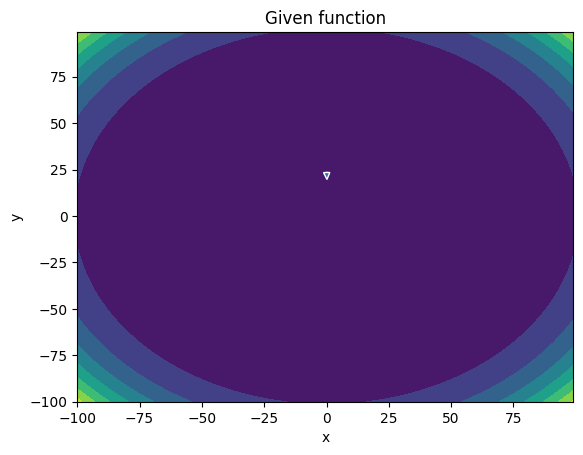

-------
Initial Coordinates:
[[ 0.05980118]
 [23.40266189]]
Final Coordinates:
[[ 0.06160868]
 [23.30512089]]
Gradient:
[[2.64225968e+03]
 [2.33402237e+08]]


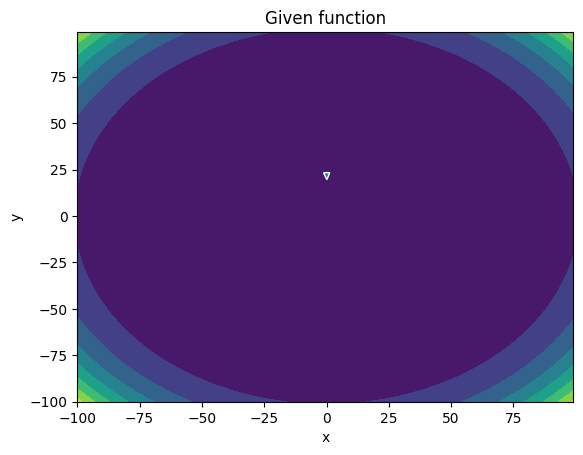

-------
Initial Coordinates:
[[ 0.06160868]
 [23.30512089]]
Final Coordinates:
[[ 0.05684559]
 [23.20760159]]
Gradient:
[[1.79218390e+04]
 [2.28573901e+08]]


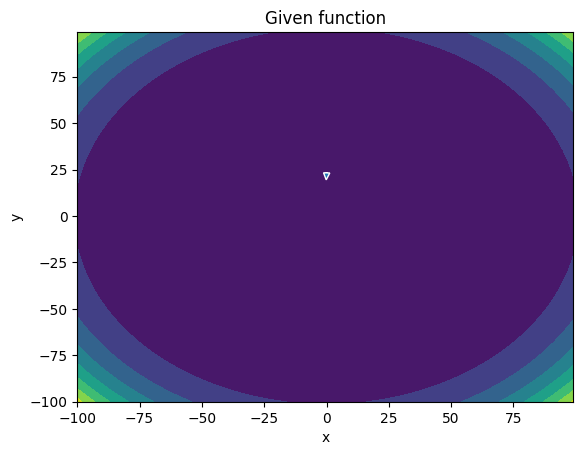

-------
Initial Coordinates:
[[ 0.05684559]
 [23.20760159]]
Final Coordinates:
[[ 0.0635751 ]
 [23.11010427]]
Gradient:
[[-3.08629306e+04]
 [ 2.23826181e+08]]


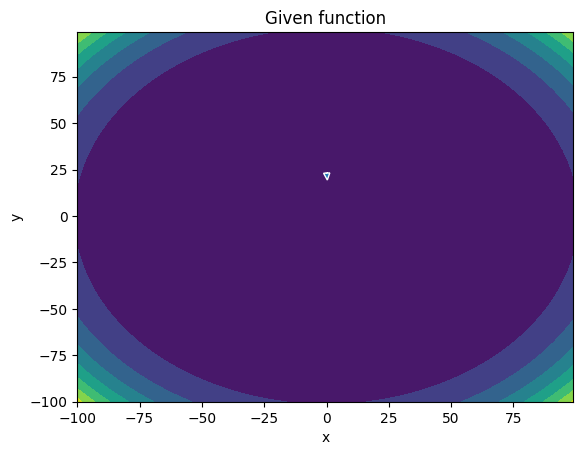

-------
Initial Coordinates:
[[ 0.0635751 ]
 [23.11010427]]
Final Coordinates:
[[ 0.05859098]
 [23.01262919]]
Gradient:
[[3.12298616e+04]
 [2.19159831e+08]]


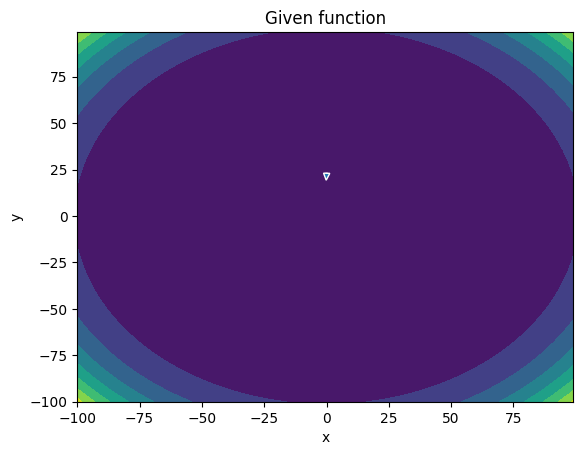

-------
Initial Coordinates:
[[ 0.05859098]
 [23.01262919]]
Final Coordinates:
[[ 0.06058578]
 [22.91517665]]
Gradient:
[[-1.82767349e+04]
 [ 2.14571508e+08]]


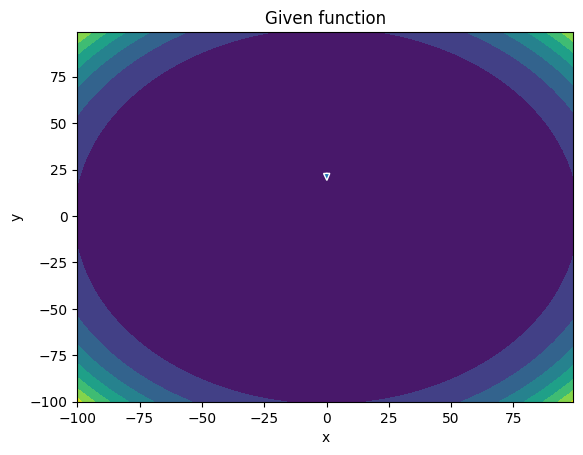

-------
Initial Coordinates:
[[ 0.06058578]
 [22.91517665]]
Final Coordinates:
[[ 0.06324109]
 [22.81774694]]
Gradient:
[[-2.00056229e+03]
 [ 2.10062045e+08]]


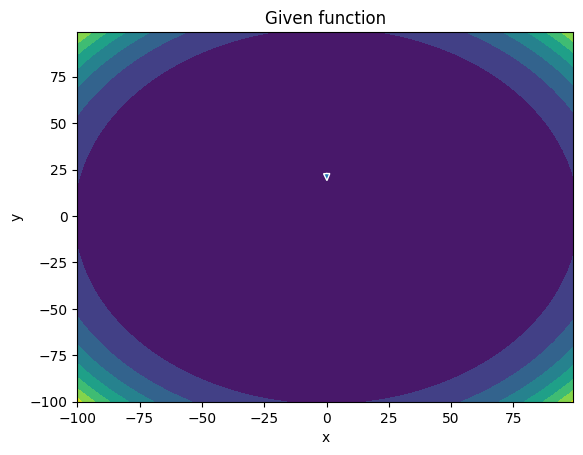

-------
Initial Coordinates:
[[ 0.06324109]
 [22.81774694]]
Final Coordinates:
[[ 0.05800516]
 [22.72034034]]
Gradient:
[[1.96810297e+04]
 [2.05629804e+08]]


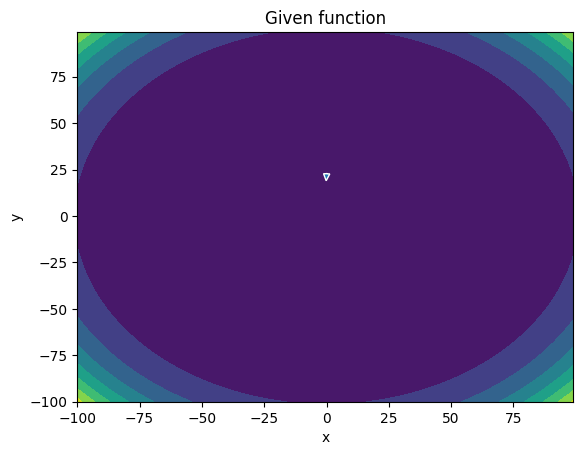

-------
Initial Coordinates:
[[ 0.05800516]
 [22.72034034]]
Final Coordinates:
[[ 0.06469166]
 [22.62295717]]
Gradient:
[[-2.94880543e+04]
 [ 2.01272951e+08]]


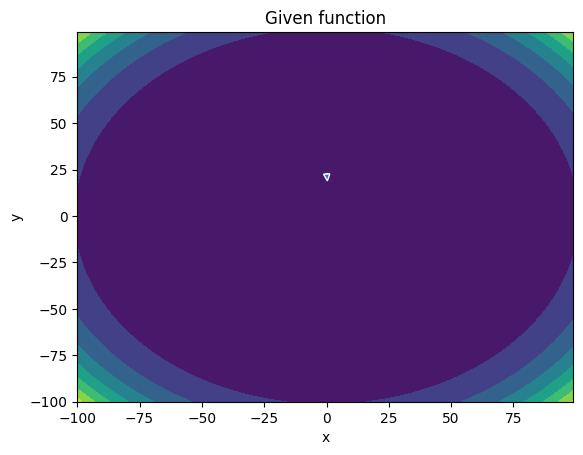

-------
Initial Coordinates:
[[ 0.06469166]
 [22.62295717]]
Final Coordinates:
[[ 0.06032308]
 [22.52559773]]
Gradient:
[[2.70926632e+04]
 [1.96992382e+08]]


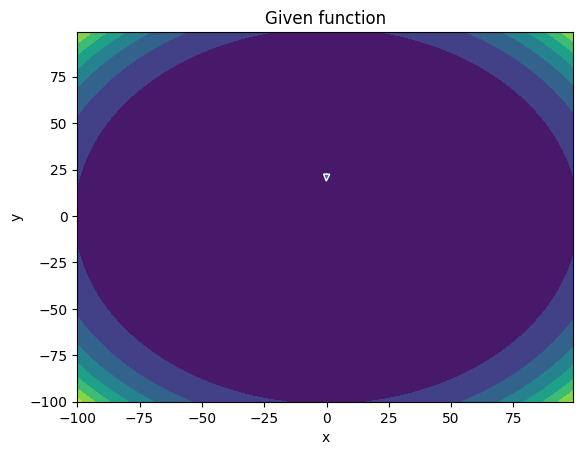

-------
Initial Coordinates:
[[ 0.06032308]
 [22.52559773]]
Final Coordinates:
[[ 0.06146297]
 [22.42826232]]
Gradient:
[[-1.31471116e+04]
 [ 1.92784916e+08]]


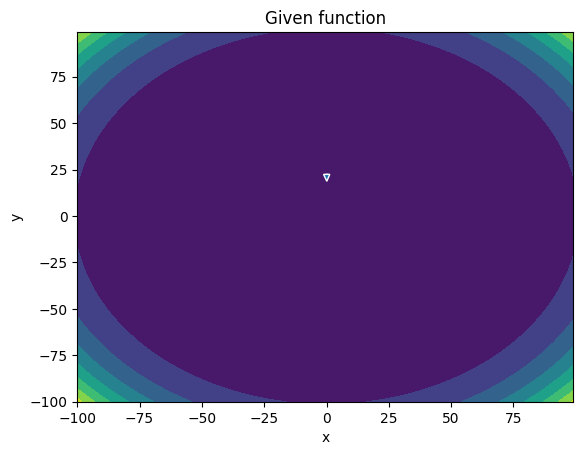

-------
Initial Coordinates:
[[ 0.06146297]
 [22.42826232]]
Final Coordinates:
[[ 0.06486984]
 [22.33095125]]
Gradient:
[[-5.57082721e+03]
 [ 1.88651155e+08]]


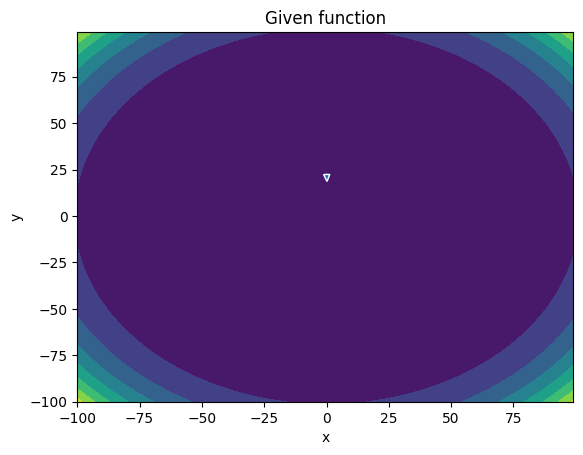

-------
Initial Coordinates:
[[ 0.06486984]
 [22.33095125]]
Final Coordinates:
[[ 0.05928414]
 [22.23366486]]
Gradient:
[[2.05221745e+04]
 [1.84589815e+08]]


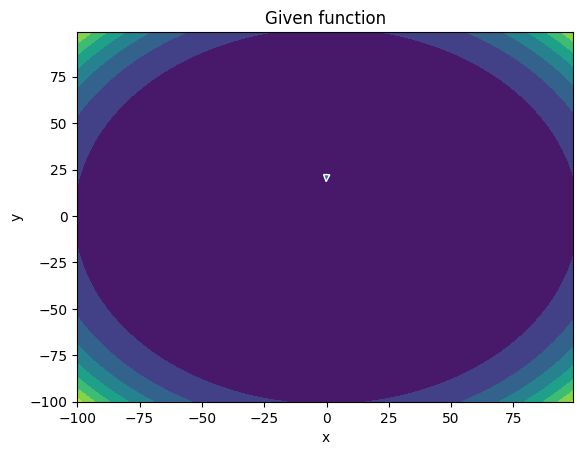

-------
Initial Coordinates:
[[ 0.05928414]
 [22.23366486]]
Final Coordinates:
[[ 0.06581301]
 [22.13640346]]
Gradient:
[[-2.75573428e+04]
 [ 1.80598890e+08]]


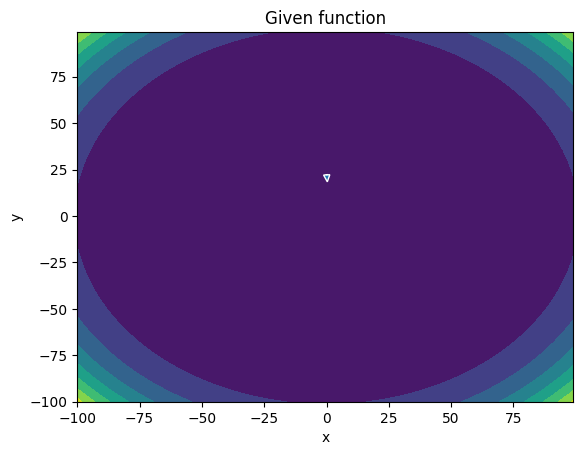

-------
Initial Coordinates:
[[ 0.06581301]
 [22.13640346]]
Final Coordinates:
[[ 0.06211196]
 [22.03916738]]
Gradient:
[[2.29766363e+04]
 [1.76679359e+08]]


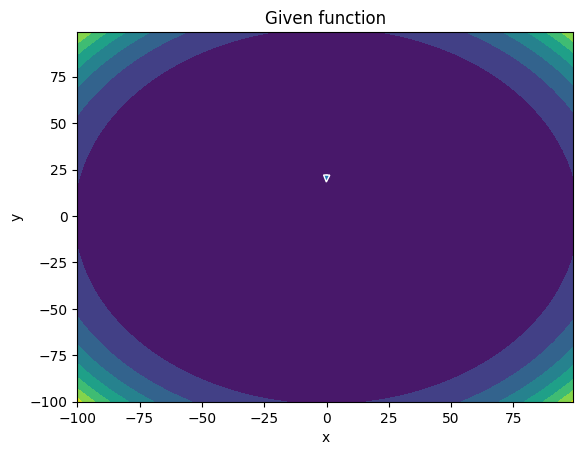

-------
Initial Coordinates:
[[ 0.06211196]
 [22.03916738]]
Final Coordinates:
[[ 0.06243785]
 [21.94195697]]
Gradient:
[[-8.71548761e+03]
 [ 1.72828239e+08]]


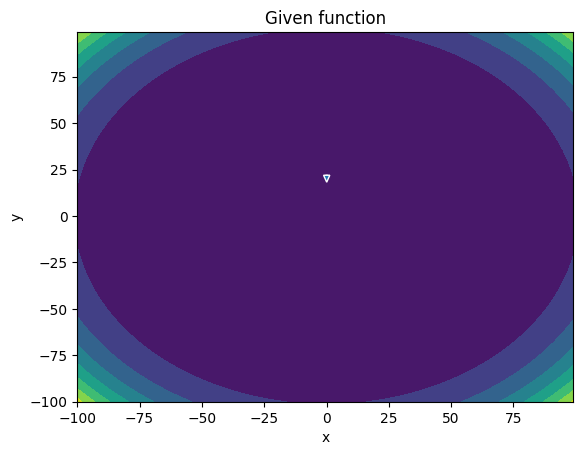

-------
Initial Coordinates:
[[ 0.06243785]
 [21.94195697]]
Final Coordinates:
[[ 0.06650201]
 [21.84477256]]
Gradient:
[[-8.20873366e+03]
 [ 1.69045898e+08]]


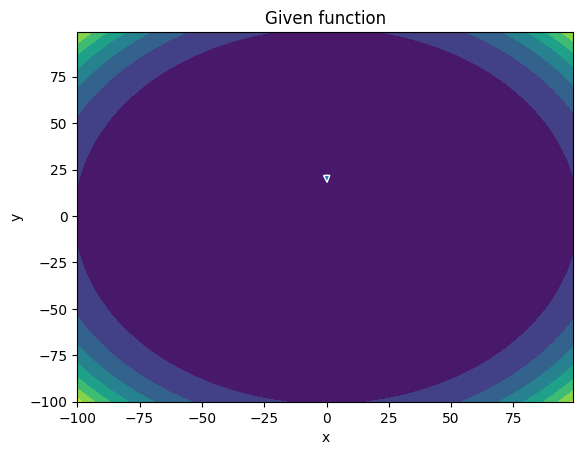

-------
Initial Coordinates:
[[ 0.06650201]
 [21.84477256]]
Final Coordinates:
[[ 0.06068068]
 [21.7476145 ]]
Gradient:
[[2.06414798e+04]
 [1.65331371e+08]]


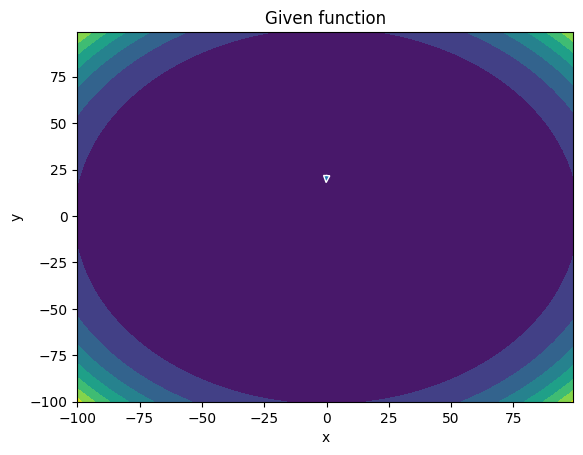

-------
Initial Coordinates:
[[ 0.06068068]
 [21.7476145 ]]
Final Coordinates:
[[ 0.0669545 ]
 [21.65048314]]
Gradient:
[[-2.52552945e+04]
 [ 1.61682530e+08]]


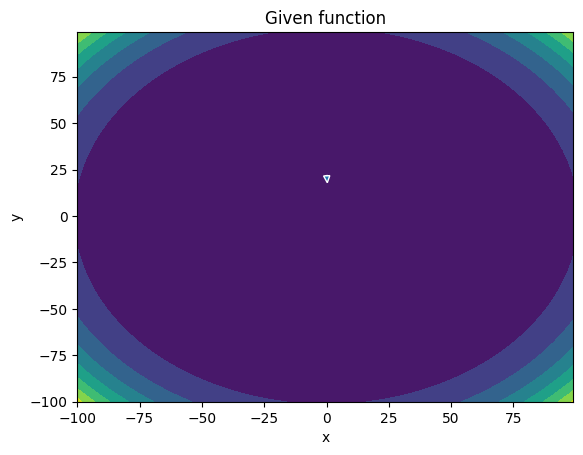

-------
Initial Coordinates:
[[ 0.0669545 ]
 [21.65048314]]
Final Coordinates:
[[ 0.06395017]
 [21.55337885]]
Gradient:
[[1.90389397e+04]
 [1.58100393e+08]]


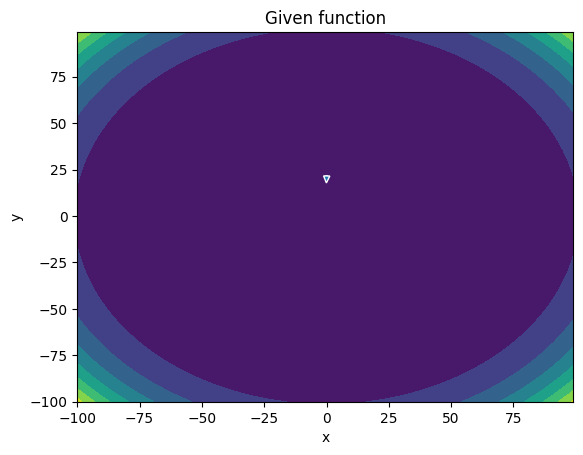

-------
Initial Coordinates:
[[ 0.06395017]
 [21.55337885]]
Final Coordinates:
[[ 0.06351589]
 [21.45630198]]
Gradient:
[[-4.99850048e+03]
 [ 1.54582192e+08]]


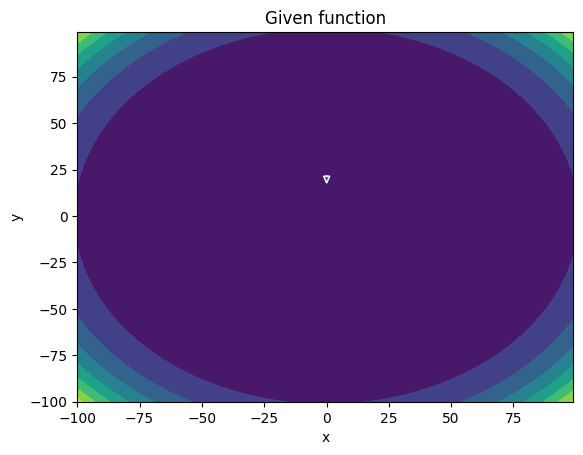

-------
Initial Coordinates:
[[ 0.06351589]
 [21.45630198]]
Final Coordinates:
[[ 0.06814343]
 [21.35925292]]
Gradient:
[[-1.00435115e+04]
 [ 1.51128072e+08]]


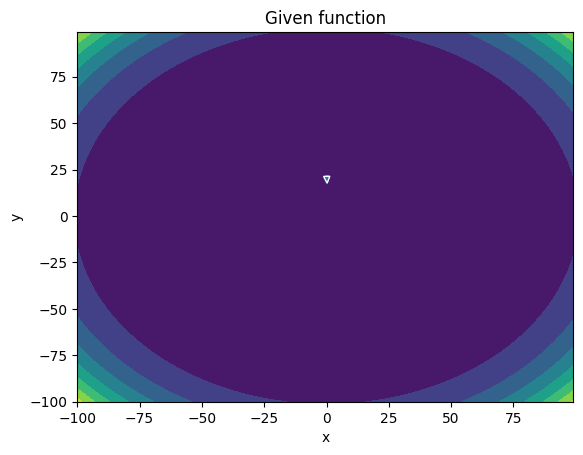

-------
Initial Coordinates:
[[ 0.06814343]
 [21.35925292]]
Final Coordinates:
[[ 0.06219228]
 [21.26223204]]
Gradient:
[[2.01962858e+04]
 [1.47737351e+08]]


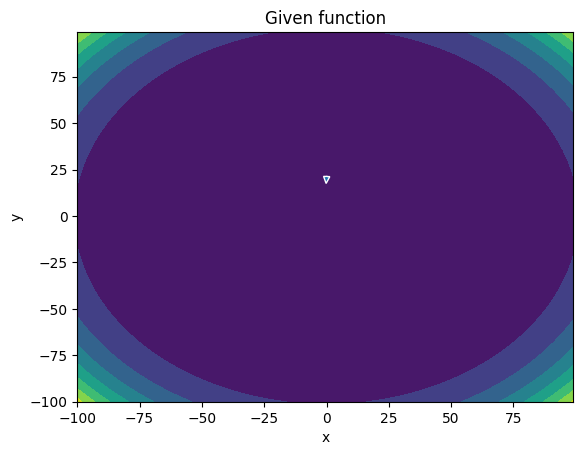

-------
Initial Coordinates:
[[ 0.06219228]
 [21.26223204]]
Final Coordinates:
[[ 0.06813344]
 [21.16523973]]
Gradient:
[[-2.27405460e+04]
 [ 1.44407822e+08]]


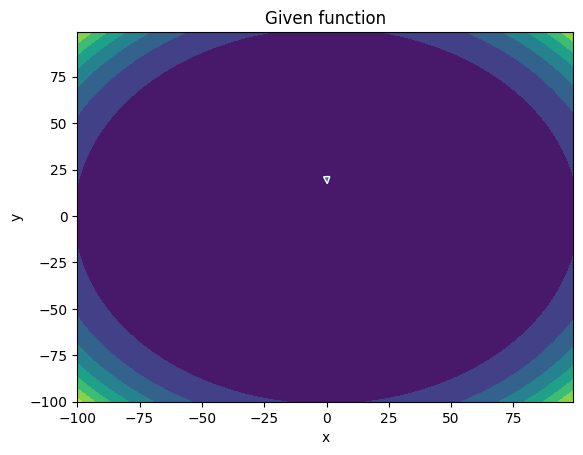

-------
Initial Coordinates:
[[ 0.06813344]
 [21.16523973]]
Final Coordinates:
[[ 0.06583051]
 [21.06827636]]
Gradient:
[[1.54057514e+04]
 [1.41140503e+08]]


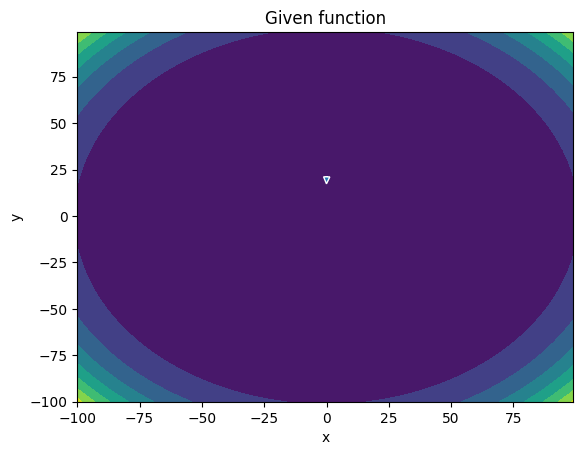

-------
Initial Coordinates:
[[ 0.06583051]
 [21.06827636]]
Final Coordinates:
[[ 0.06470351]
 [20.97134236]]
Gradient:
[[-1.98928331e+03]
 [ 1.37932856e+08]]


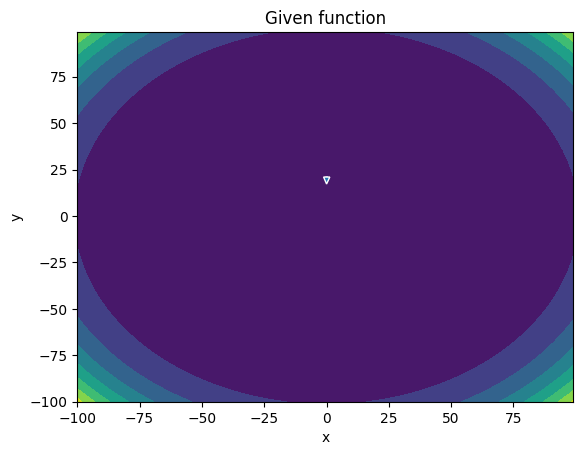

-------
Initial Coordinates:
[[ 0.06470351]
 [20.97134236]]
Final Coordinates:
[[ 0.06980002]
 [20.87443812]]
Gradient:
[[-1.11902821e+04]
 [ 1.34784819e+08]]


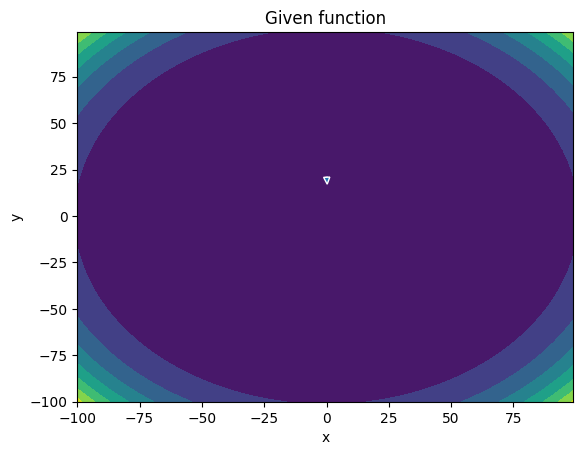

-------
Initial Coordinates:
[[ 0.06980002]
 [20.87443812]]
Final Coordinates:
[[ 0.06381426]
 [20.77756404]]
Gradient:
[[1.93205378e+04]
 [1.31695949e+08]]


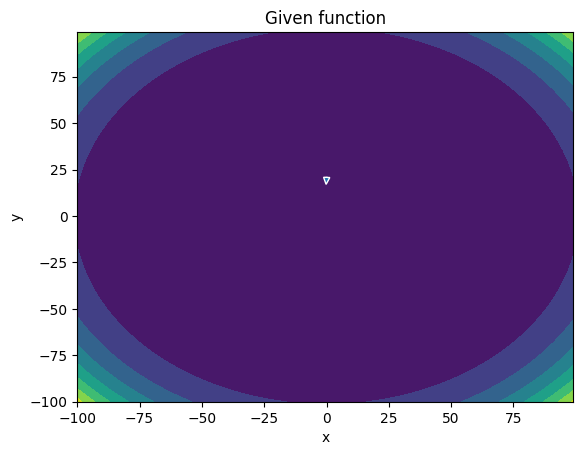

-------
Initial Coordinates:
[[ 0.06381426]
 [20.77756404]]
Final Coordinates:
[[ 0.06936921]
 [20.68072057]]
Gradient:
[[-2.01563082e+04]
 [ 1.28664006e+08]]


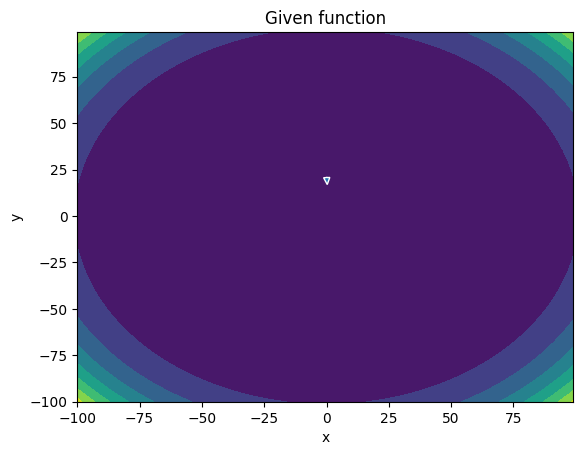

-------
Initial Coordinates:
[[ 0.06936921]
 [20.68072057]]
Final Coordinates:
[[ 0.06774669]
 [20.58390811]]
Gradient:
[[1.21741275e+04]
 [1.25689978e+08]]


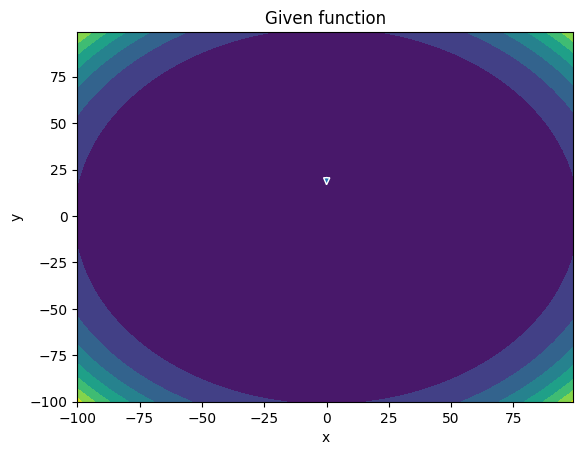

-------
Initial Coordinates:
[[ 0.06774669]
 [20.58390811]]
Final Coordinates:
[[ 0.06600698]
 [20.4871271 ]]
Gradient:
[[3.41996222e+02]
 [1.22771556e+08]]


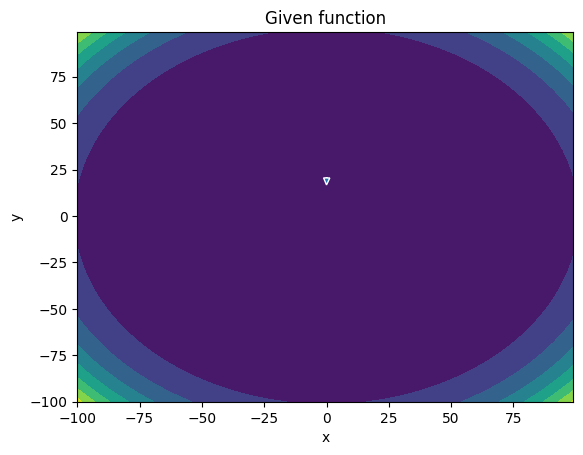

-------
Initial Coordinates:
[[ 0.06600698]
 [20.4871271 ]]
Final Coordinates:
[[ 0.07147948]
 [20.39037799]]
Gradient:
[[-1.17585087e+04]
 [ 1.19908495e+08]]


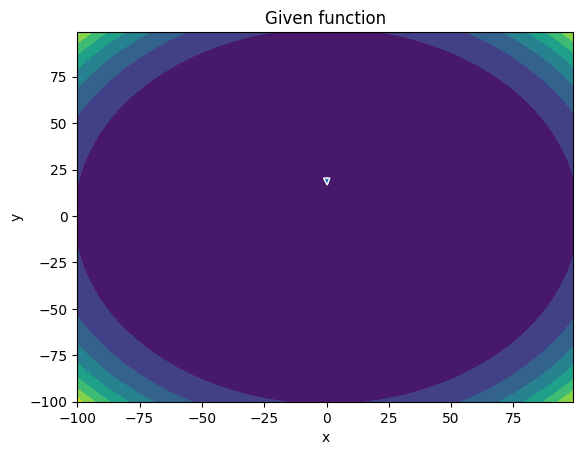

-------
Initial Coordinates:
[[ 0.07147948]
 [20.39037799]]
Final Coordinates:
[[ 0.06553949]
 [20.29366123]]
Gradient:
[[1.81371740e+04]
 [1.17100553e+08]]


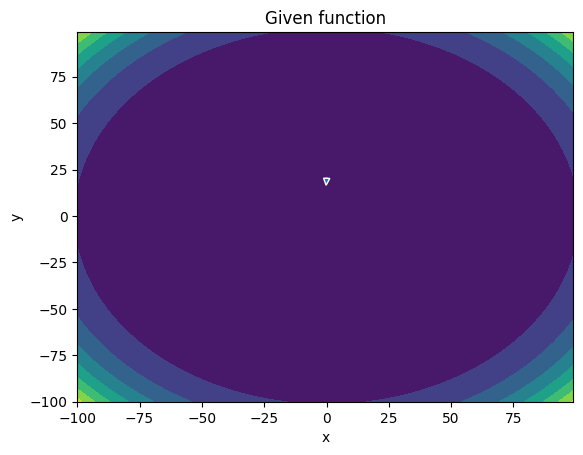

-------
Initial Coordinates:
[[ 0.06553949]
 [20.29366123]]
Final Coordinates:
[[ 0.07068178]
 [20.19697728]]
Gradient:
[[-1.76291854e+04]
 [ 1.14345491e+08]]


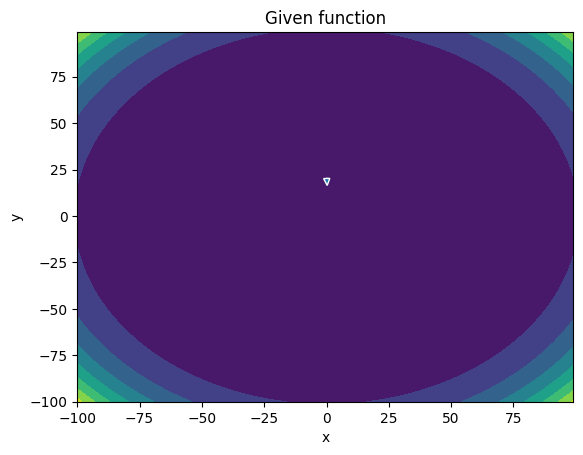

-------
Initial Coordinates:
[[ 0.07068178]
 [20.19697728]]
Final Coordinates:
[[ 0.06969493]
 [20.10032659]]
Gradient:
[[9.40480254e+03]
 [1.11644247e+08]]


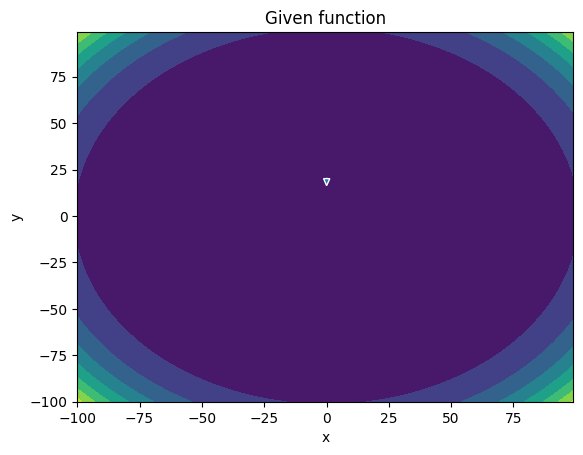

-------
Initial Coordinates:
[[ 0.06969493]
 [20.10032659]]
Final Coordinates:
[[ 0.06743115]
 [20.00370965]]
Gradient:
[[2.05133048e+03]
 [1.08994732e+08]]


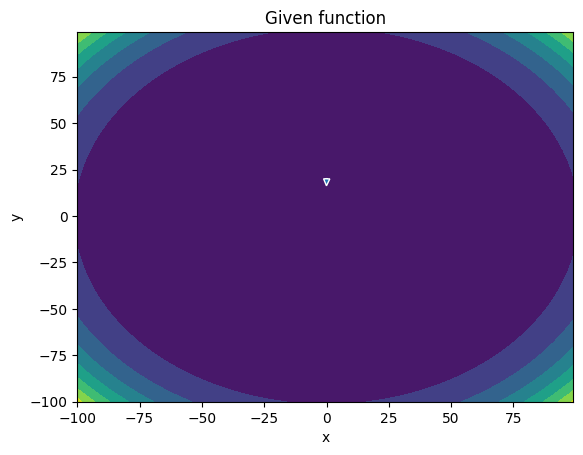

-------
Initial Coordinates:
[[ 0.06743115]
 [20.00370965]]
Final Coordinates:
[[ 0.07319213]
 [19.90712694]]
Gradient:
[[-1.18578315e+04]
 [ 1.06396549e+08]]


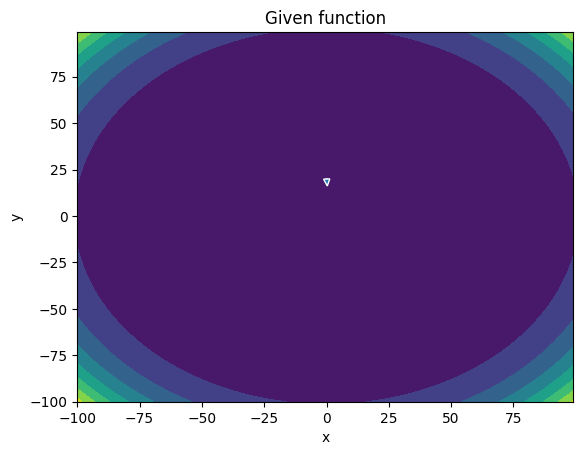

-------
Initial Coordinates:
[[ 0.07319213]
 [19.90712694]]
Final Coordinates:
[[ 0.06735959]
 [19.81057895]]
Gradient:
[[1.67605637e+04]
 [1.03849616e+08]]


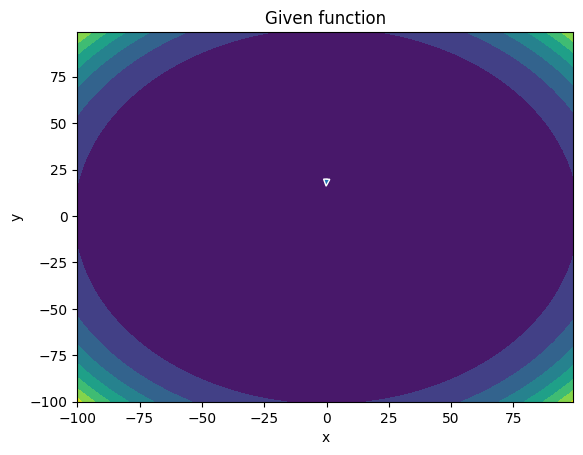

-------
Initial Coordinates:
[[ 0.06735959]
 [19.81057895]]
Final Coordinates:
[[ 0.07208943]
 [19.71406618]]
Gradient:
[[-1.52601077e+04]
 [ 1.01351727e+08]]


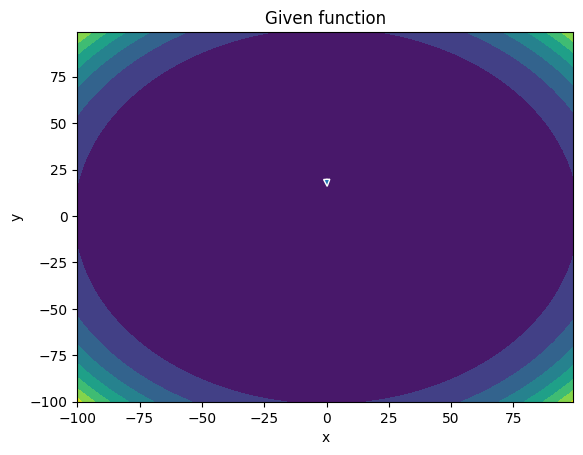

-------
Initial Coordinates:
[[ 0.07208943]
 [19.71406618]]
Final Coordinates:
[[ 0.07167538]
 [19.61758915]]
Gradient:
[[7.11664861e+03]
 [9.89037538e+07]]


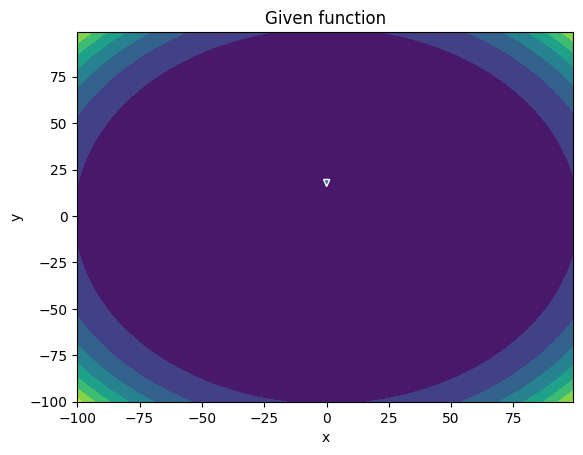

-------
Initial Coordinates:
[[ 0.07167538]
 [19.61758915]]
Final Coordinates:
[[ 0.06897889]
 [19.52114836]]
Gradient:
[[3.21809049e+03]
 [9.65038175e+07]]


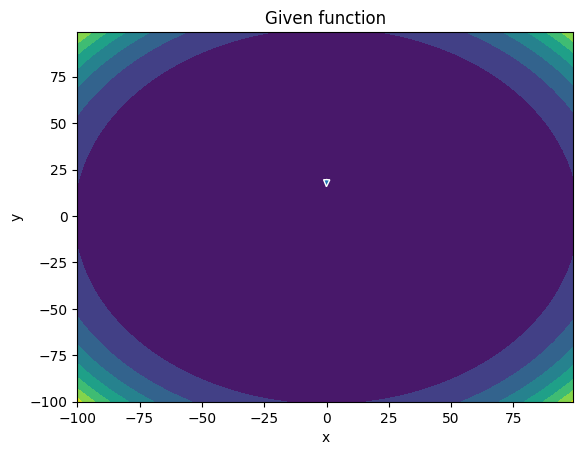

-------
Initial Coordinates:
[[ 0.06897889]
 [19.52114836]]
Final Coordinates:
[[ 0.0749506 ]
 [19.42474436]]
Gradient:
[[-1.15965468e+04]
 [ 9.41513976e+07]]


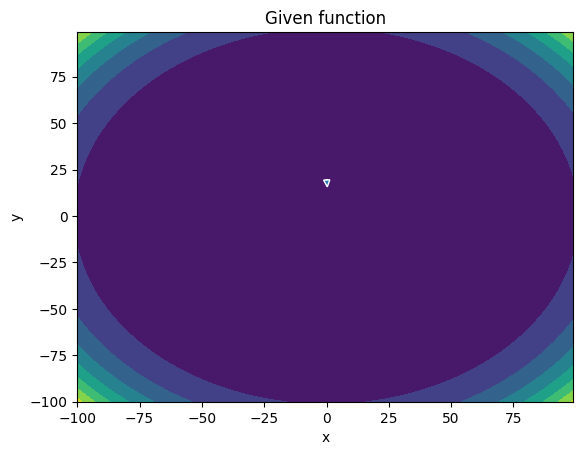

-------
Initial Coordinates:
[[ 0.0749506 ]
 [19.42474436]]
Final Coordinates:
[[ 0.06926702]
 [19.32837766]]
Gradient:
[[1.52913660e+04]
 [9.18465347e+07]]


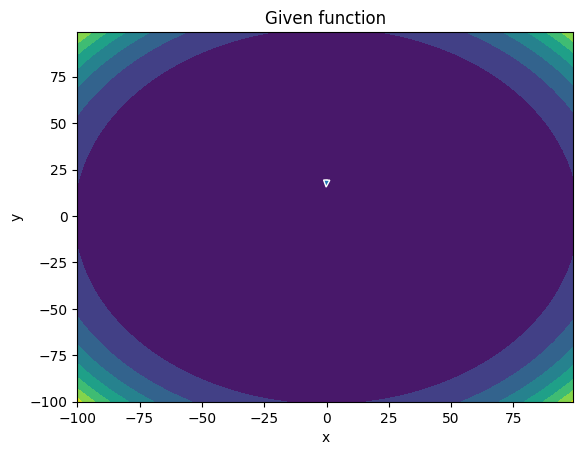

-------
Initial Coordinates:
[[ 0.06926702]
 [19.32837766]]
Final Coordinates:
[[ 0.07360723]
 [19.23204884]]
Gradient:
[[-1.31163328e+04]
 [ 8.95870805e+07]]


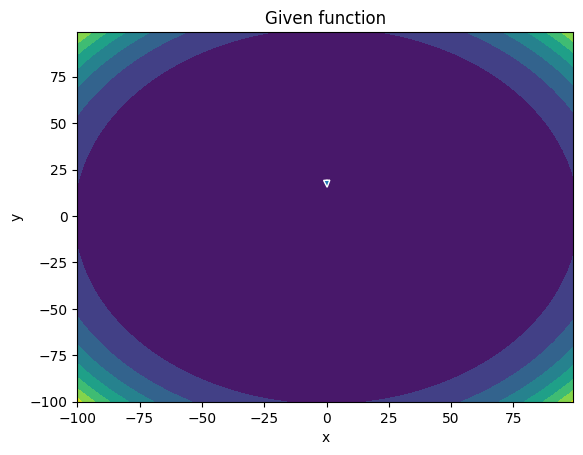

-------
Initial Coordinates:
[[ 0.07360723]
 [19.23204884]]
Final Coordinates:
[[ 0.07369219]
 [19.13575844]]
Gradient:
[[5.28991966e+03]
 [8.73738363e+07]]


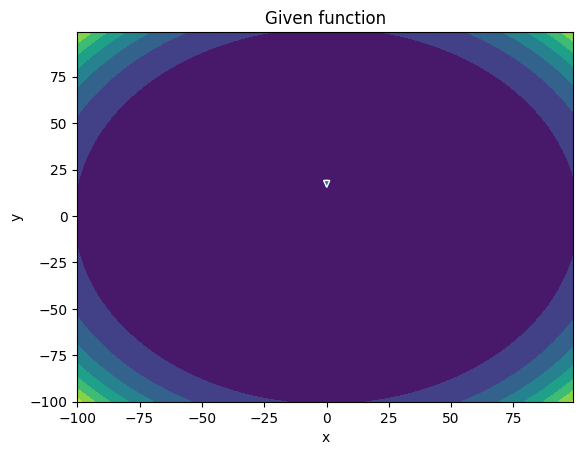

-------
Initial Coordinates:
[[ 0.07369219]
 [19.13575844]]
Final Coordinates:
[[ 0.07065158]
 [19.03950703]]
Gradient:
[[3.93514658e+03]
 [8.52051124e+07]]


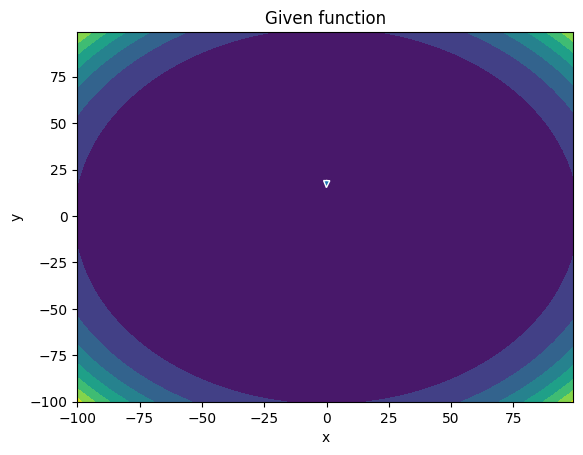

-------
Initial Coordinates:
[[ 0.07065158]
 [19.03950703]]
Final Coordinates:
[[ 0.07676867]
 [18.9432952 ]]
Gradient:
[[-1.10752451e+04]
 [ 8.30802968e+07]]


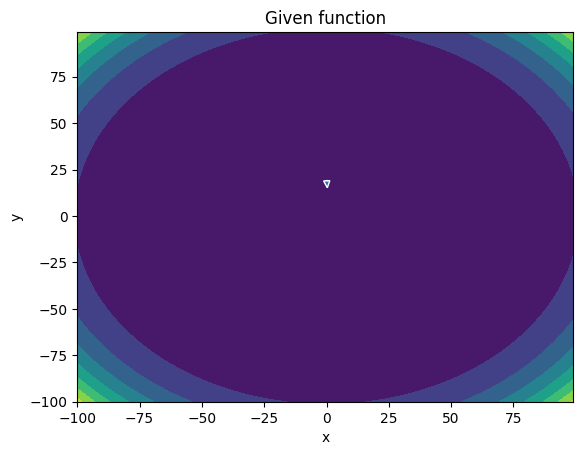

-------
Initial Coordinates:
[[ 0.07676867]
 [18.9432952 ]]
Final Coordinates:
[[ 0.07125672]
 [18.84712351]]
Gradient:
[[1.38102715e+04]
 [8.09995205e+07]]


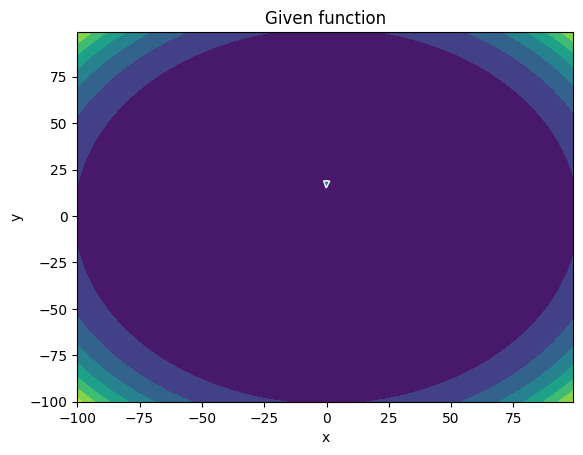

-------
Initial Coordinates:
[[ 0.07125672]
 [18.84712351]]
Final Coordinates:
[[ 0.07524675]
 [18.7509926 ]]
Gradient:
[[-1.12307994e+04]
 [ 7.89607111e+07]]


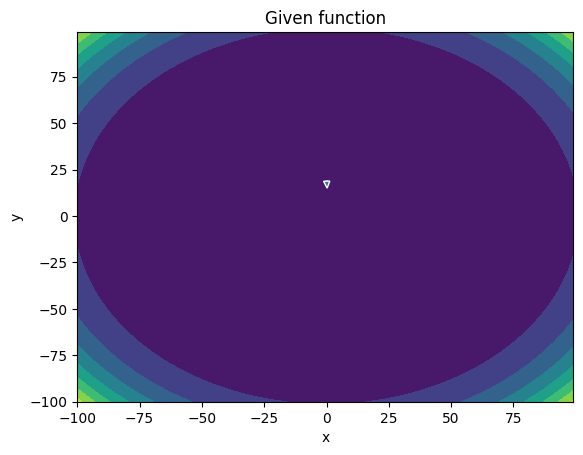

-------
Initial Coordinates:
[[ 0.07524675]
 [18.7509926 ]]
Final Coordinates:
[[ 0.0757527 ]
 [18.65490306]]
Gradient:
[[3.87776626e+03]
 [7.69645973e+07]]


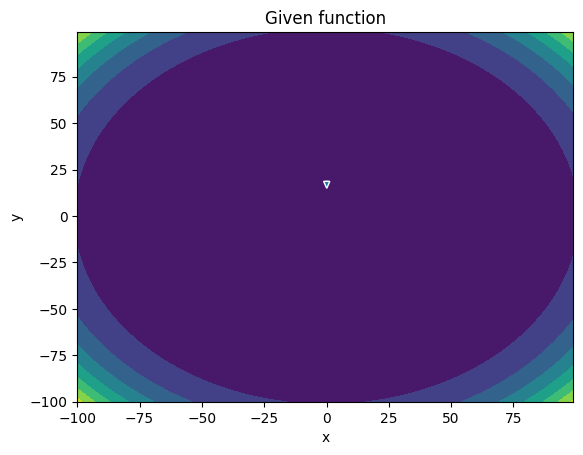

-------
Initial Coordinates:
[[ 0.0757527 ]
 [18.65490306]]
Final Coordinates:
[[ 0.07245015]
 [18.55885551]]
Gradient:
[[4.29645192e+03]
 [7.50096588e+07]]


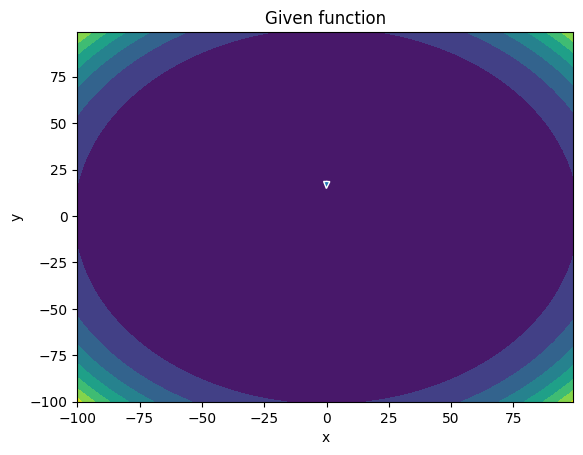

-------
Initial Coordinates:
[[ 0.07245015]
 [18.55885551]]
Final Coordinates:
[[ 0.07866022]
 [18.46285059]]
Gradient:
[[-1.03804388e+04]
 [ 7.30952213e+07]]


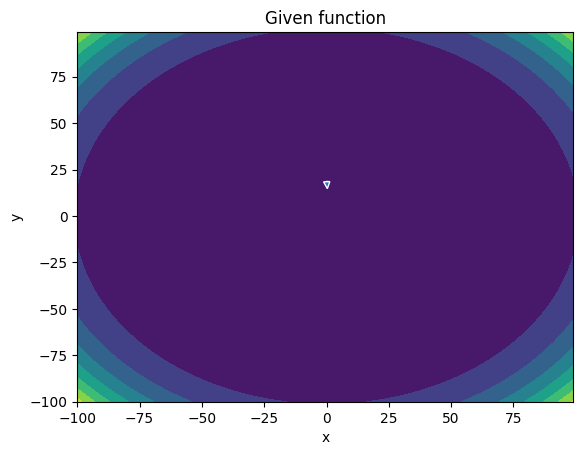

-------
Initial Coordinates:
[[ 0.07866022]
 [18.46285059]]
Final Coordinates:
[[ 0.07332671]
 [18.36688895]]
Gradient:
[[1.23754219e+04]
 [7.12214778e+07]]


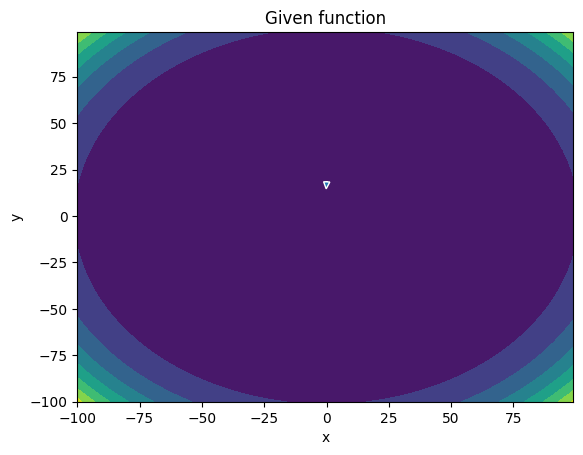

-------
Initial Coordinates:
[[ 0.07332671]
 [18.36688895]]
Final Coordinates:
[[ 0.07701701]
 [18.27097125]]
Gradient:
[[-9.60873297e+03]
 [ 6.93864448e+07]]


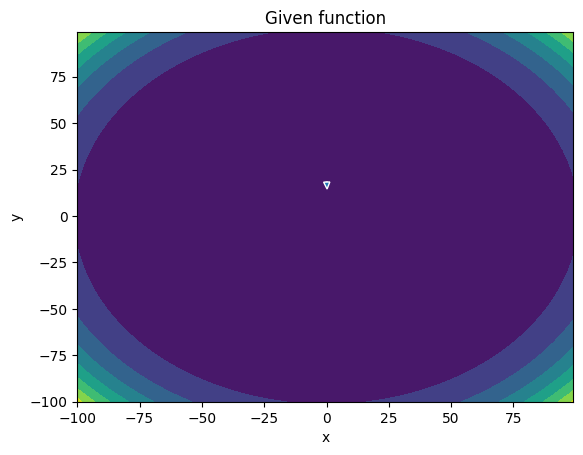

-------
Initial Coordinates:
[[ 0.07701701]
 [18.27097125]]
Final Coordinates:
[[ 0.07786608]
 [18.17509816]]
Gradient:
[[2.82045071e+03]
 [6.75907817e+07]]


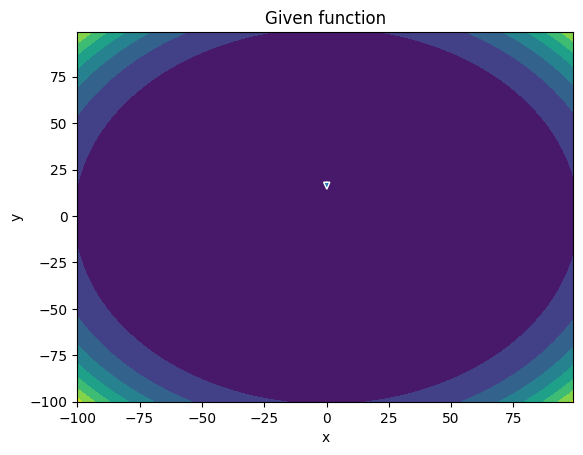

-------
Initial Coordinates:
[[ 0.07786608]
 [18.17509816]]
Final Coordinates:
[[ 0.07437608]
 [18.07927036]]
Gradient:
[[4.38716749e+03]
 [6.58331160e+07]]


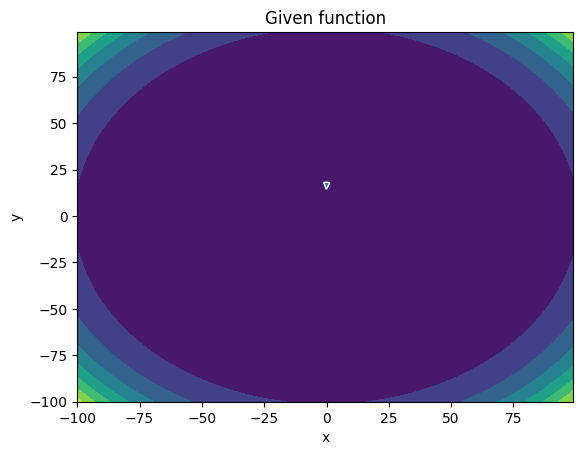

-------
Initial Coordinates:
[[ 0.07437608]
 [18.07927036]]
Final Coordinates:
[[ 0.08063857]
 [17.98348855]]
Gradient:
[[-9.58131895e+03]
 [ 6.41127371e+07]]


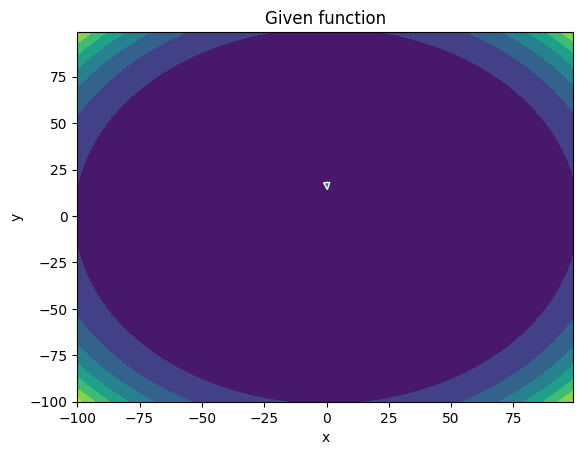

-------
Initial Coordinates:
[[ 0.08063857]
 [17.98348855]]
Final Coordinates:
[[ 0.07547788]
 [17.88775343]]
Gradient:
[[1.10242022e+04]
 [6.24298775e+07]]


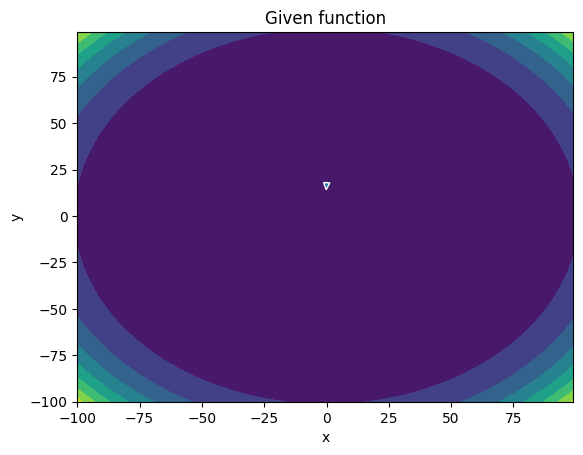

-------
Initial Coordinates:
[[ 0.07547788]
 [17.88775343]]
Final Coordinates:
[[ 0.07892595]
 [17.79206575]]
Gradient:
[[-8.23722427e+03]
 [ 6.07826501e+07]]


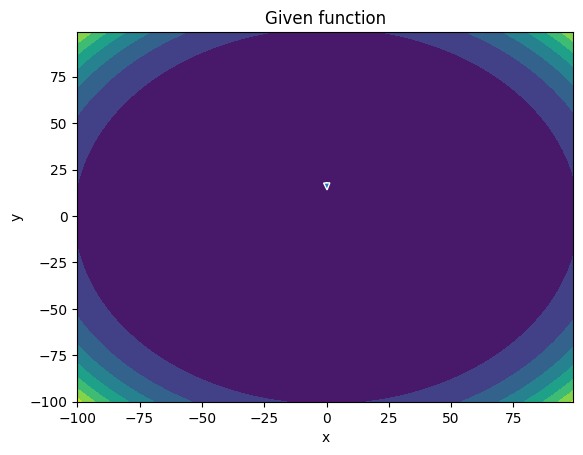

-------
Initial Coordinates:
[[ 0.07892595]
 [17.79206575]]
Final Coordinates:
[[ 0.08004215]
 [17.69642622]]
Gradient:
[[2.05683353e+03]
 [5.91716511e+07]]


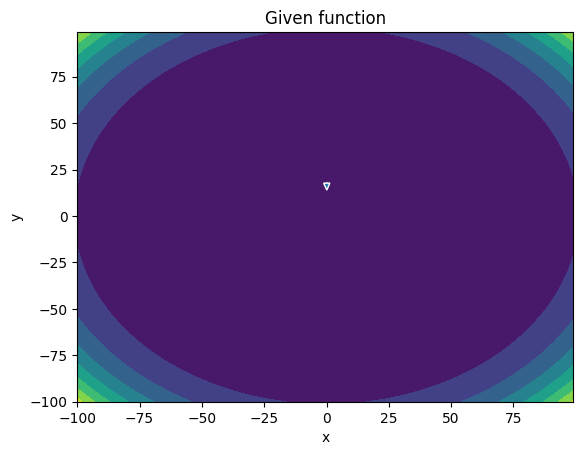

-------
Initial Coordinates:
[[ 0.08004215]
 [17.69642622]]
Final Coordinates:
[[ 0.07643222]
 [17.60083561]]
Gradient:
[[4.27865605e+03]
 [5.75956349e+07]]


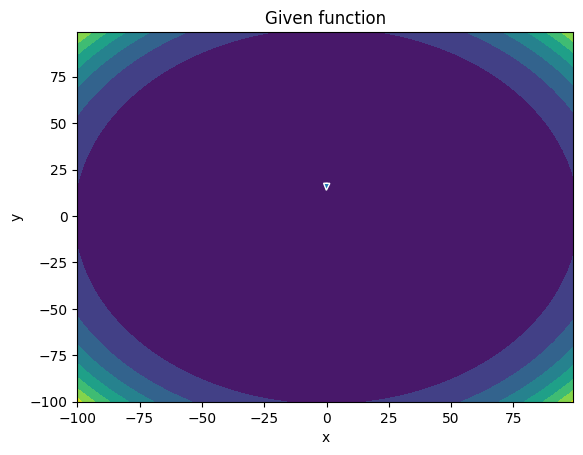

-------
Initial Coordinates:
[[ 0.07643222]
 [17.60083561]]
Final Coordinates:
[[ 0.08271639]
 [17.50529468]]
Gradient:
[[-8.72998067e+03]
 [ 5.60538775e+07]]


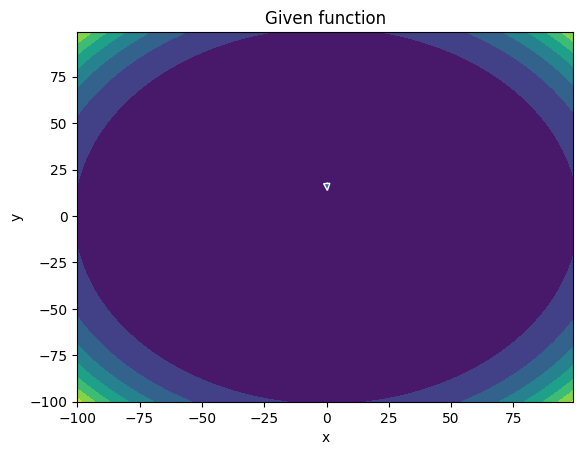

-------
Initial Coordinates:
[[ 0.08271639]
 [17.50529468]]
Final Coordinates:
[[ 0.07771329]
 [17.40980421]]
Gradient:
[[9.77741623e+03]
 [5.45466321e+07]]


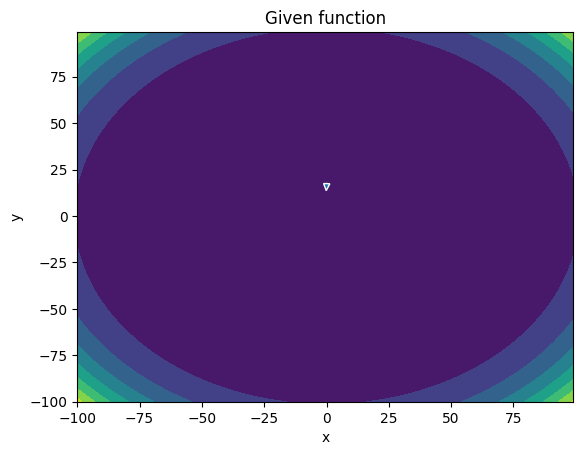

-------
Initial Coordinates:
[[ 0.07771329]
 [17.40980421]]
Final Coordinates:
[[ 0.08098156]
 [17.31436501]]
Gradient:
[[-7.09363035e+03]
 [ 5.30721125e+07]]


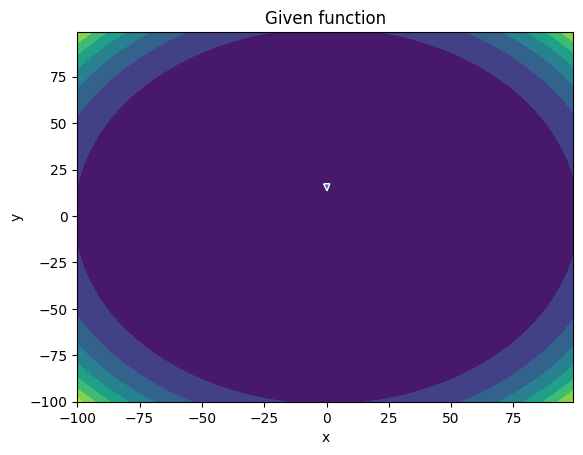

-------
Initial Coordinates:
[[ 0.08098156]
 [17.31436501]]
Final Coordinates:
[[ 0.08229074]
 [17.21897787]]
Gradient:
[[1.53089556e+03]
 [5.16308589e+07]]


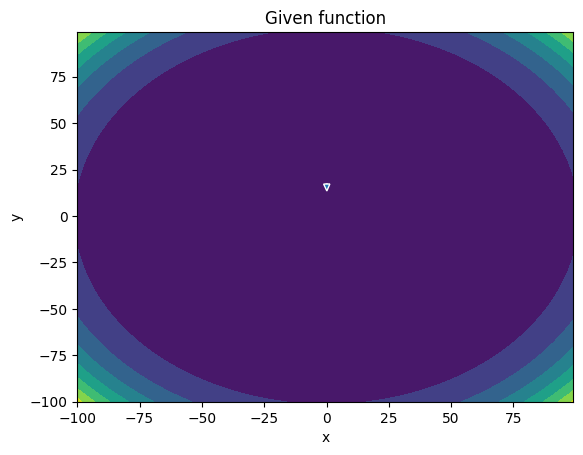

-------
Initial Coordinates:
[[ 0.08229074]
 [17.21897787]]
Final Coordinates:
[[ 0.07862312]
 [17.12364363]]
Gradient:
[[4.02779787e+03]
 [5.02217333e+07]]


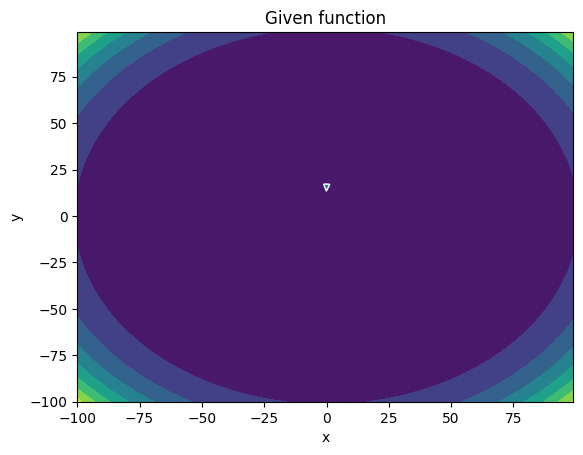

-------
Initial Coordinates:
[[ 0.07862312]
 [17.12364363]]
Final Coordinates:
[[ 0.08490578]
 [17.02836313]]
Gradient:
[[-7.86378897e+03]
 [ 4.88440177e+07]]


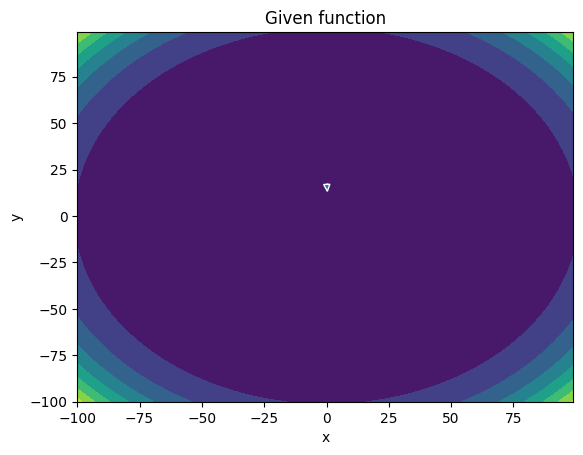

-------
Initial Coordinates:
[[ 0.08490578]
 [17.02836313]]
Final Coordinates:
[[ 0.08003779]
 [16.93313723]]
Gradient:
[[8.64367431e+03]
 [4.74979709e+07]]


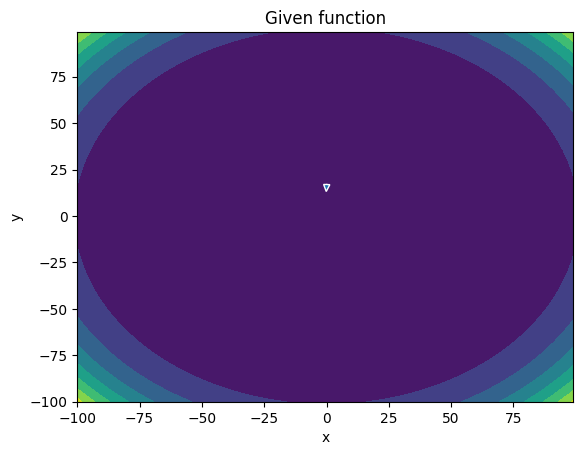

-------
Initial Coordinates:
[[ 0.08003779]
 [16.93313723]]
Final Coordinates:
[[ 0.08319267]
 [16.83796682]]
Gradient:
[[-6.15105064e+03]
 [ 4.61819093e+07]]


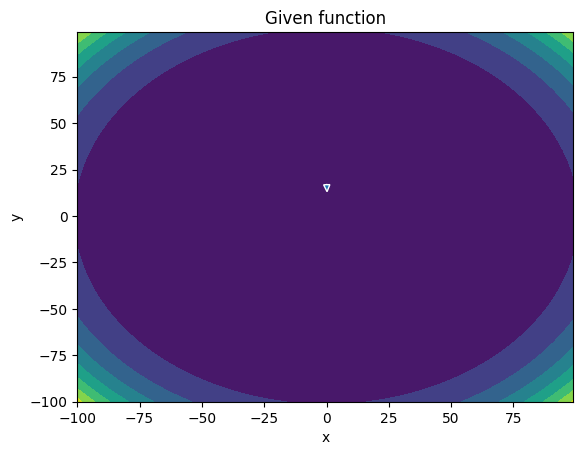

-------
Initial Coordinates:
[[ 0.08319267]
 [16.83796682]]
Final Coordinates:
[[ 0.08462142]
 [16.74285278]]
Gradient:
[[1.19398205e+03]
 [4.48963256e+07]]


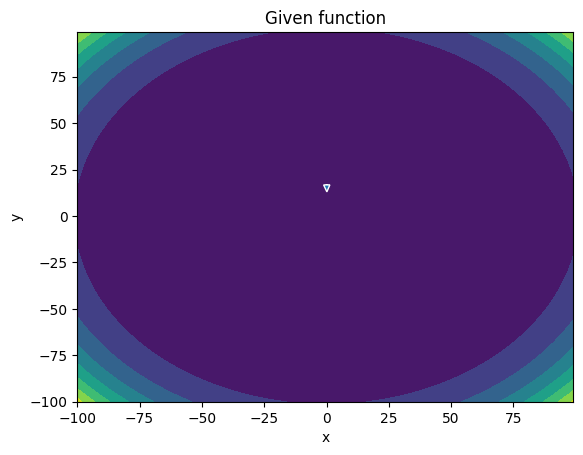

-------
Initial Coordinates:
[[ 0.08462142]
 [16.74285278]]
Final Coordinates:
[[ 0.08095526]
 [16.64779602]]
Gradient:
[[3.67877938e+03]
 [4.36401708e+07]]


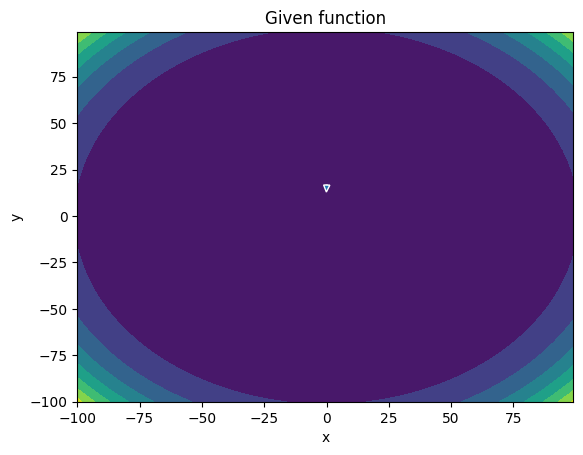

-------
Initial Coordinates:
[[ 0.08095526]
 [16.64779602]]
Final Coordinates:
[[ 0.08721833]
 [16.55279749]]
Gradient:
[[-7.00839852e+03]
 [ 4.24127500e+07]]


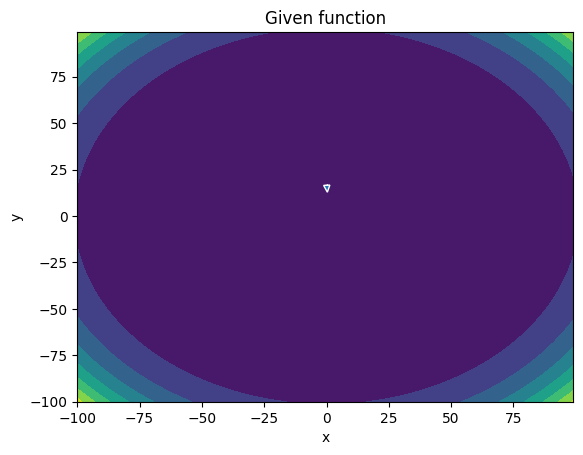

-------
Initial Coordinates:
[[ 0.08721833]
 [16.55279749]]
Final Coordinates:
[[ 0.08245779]
 [16.45785811]]
Gradient:
[[7.62292315e+03]
 [4.12143151e+07]]


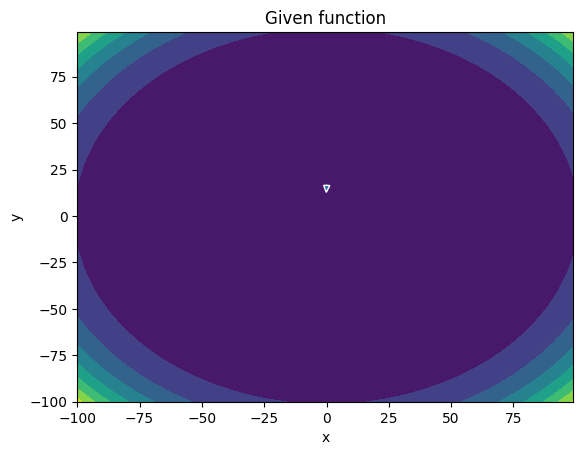

-------
Initial Coordinates:
[[ 0.08245779]
 [16.45785811]]
Final Coordinates:
[[ 0.08556915]
 [16.36297887]]
Gradient:
[[-5.38120266e+03]
 [ 4.00432851e+07]]


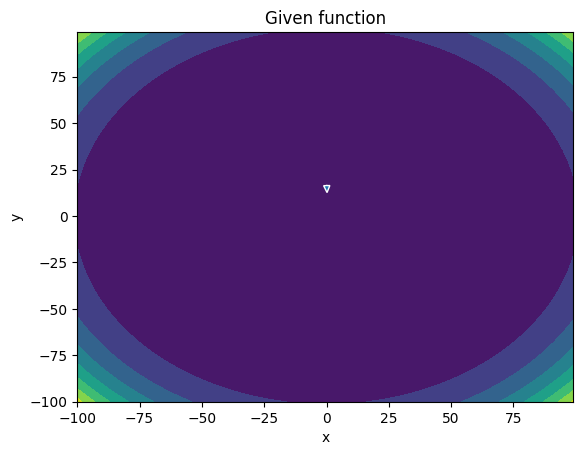

-------
Initial Coordinates:
[[ 0.08556915]
 [16.36297887]]
Final Coordinates:
[[ 0.08704359]
 [16.26816074]]
Gradient:
[[1.00460244e+03]
 [3.89001136e+07]]


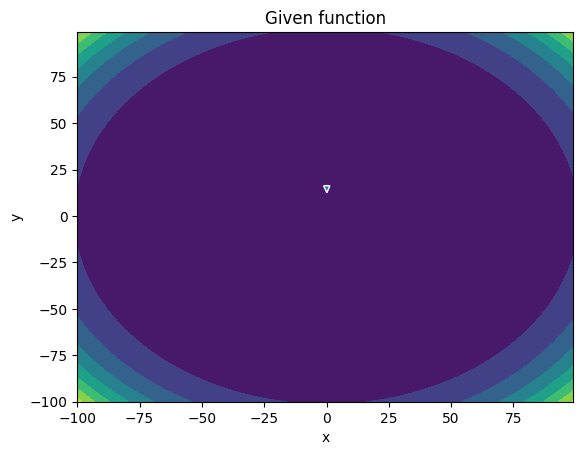

-------
Initial Coordinates:
[[ 0.08704359]
 [16.26816074]]
Final Coordinates:
[[ 0.0834372 ]
 [16.17340474]]
Gradient:
[[3.26565285e+03]
 [3.77838240e+07]]


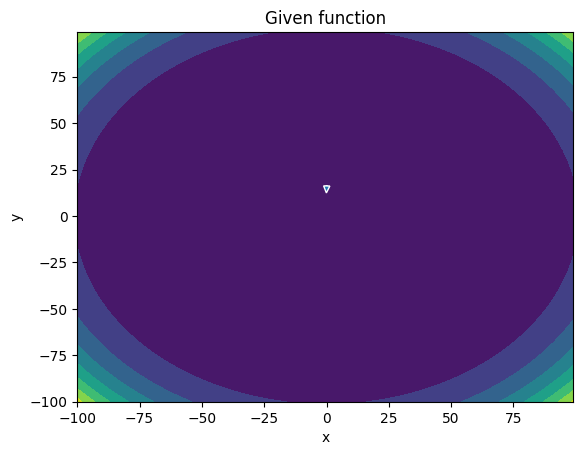

-------
Initial Coordinates:
[[ 0.0834372 ]
 [16.17340474]]
Final Coordinates:
[[ 0.08966507]
 [16.07871189]]
Gradient:
[[-6.18055059e+03]
 [ 3.66937587e+07]]


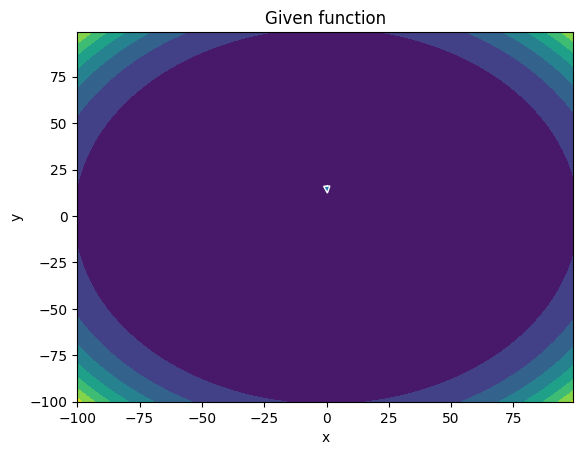

-------
Initial Coordinates:
[[ 0.08966507]
 [16.07871189]]
Final Coordinates:
[[ 0.08498149]
 [15.98408323]]
Gradient:
[[6.70904063e+03]
 [3.56301528e+07]]


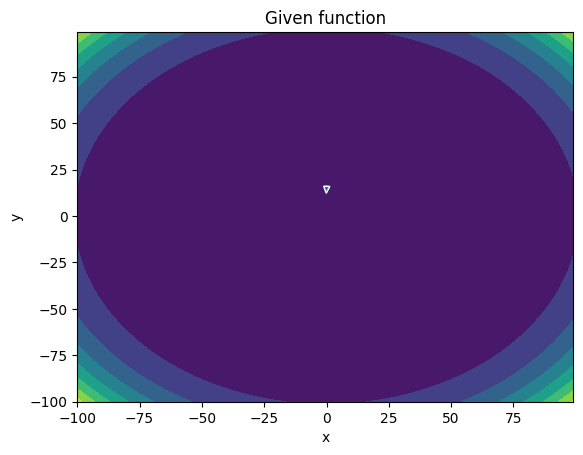

-------
Initial Coordinates:
[[ 0.08498149]
 [15.98408323]]
Final Coordinates:
[[ 0.088122  ]
 [15.88951985]]
Gradient:
[[-4.75577360e+03]
 [ 3.45915265e+07]]


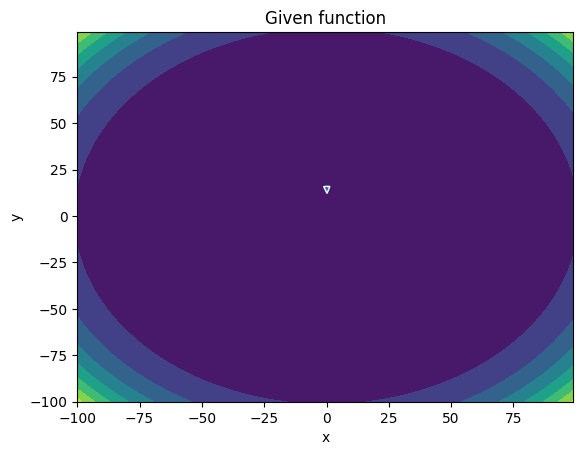

-------
Initial Coordinates:
[[ 0.088122  ]
 [15.88951985]]
Final Coordinates:
[[ 0.08956662]
 [15.79502281]]
Gradient:
[[9.27358837e+02]
 [3.35783025e+07]]


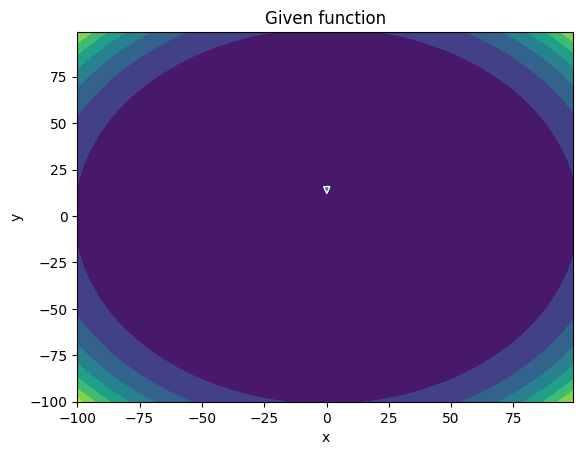

-------
Initial Coordinates:
[[ 0.08956662]
 [15.79502281]]
Final Coordinates:
[[ 0.08607973]
 [15.70059323]]
Gradient:
[[2.81470662e+03]
 [3.25895614e+07]]


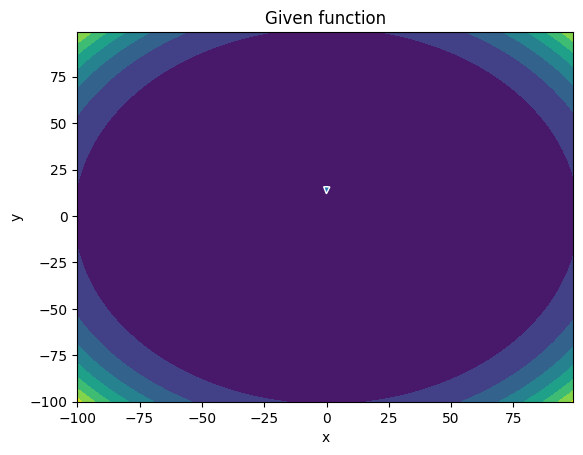

-------
Initial Coordinates:
[[ 0.08607973]
 [15.70059323]]
Final Coordinates:
[[ 0.09225637]
 [15.60623226]]
Gradient:
[[-5.39038539e+03]
 [ 3.16246955e+07]]


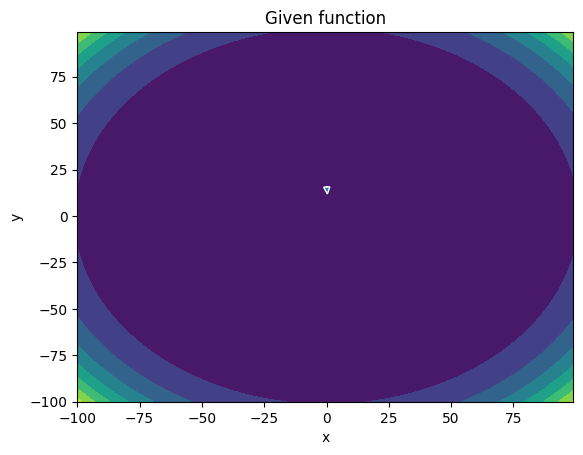

-------
Initial Coordinates:
[[ 0.09225637]
 [15.60623226]]
Final Coordinates:
[[ 0.08761929]
 [15.51194103]]
Gradient:
[[5.89182051e+03]
 [3.06839138e+07]]


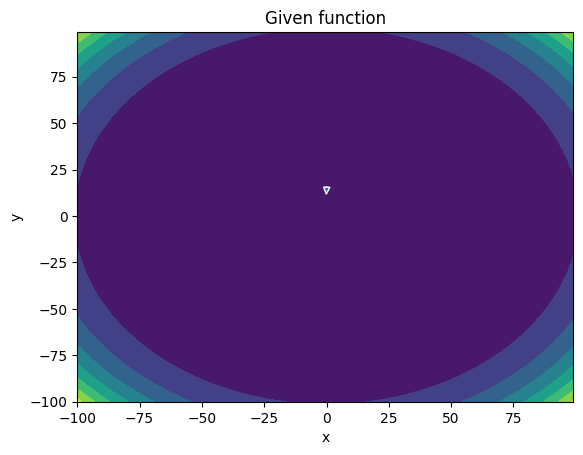

-------
Initial Coordinates:
[[ 0.08761929]
 [15.51194103]]
Final Coordinates:
[[ 0.09086314]
 [15.41772075]]
Gradient:
[[-4.24714134e+03]
 [ 2.97658372e+07]]


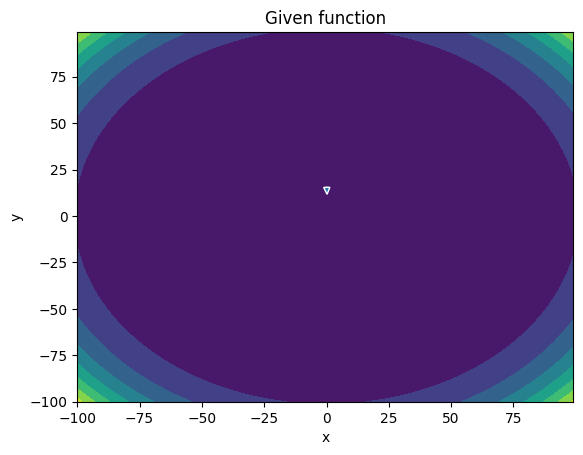

-------
Initial Coordinates:
[[ 0.09086314]
 [15.41772075]]
Final Coordinates:
[[ 0.09220006]
 [15.32357259]]
Gradient:
[[9.31839822e+02]
 [2.88708637e+07]]


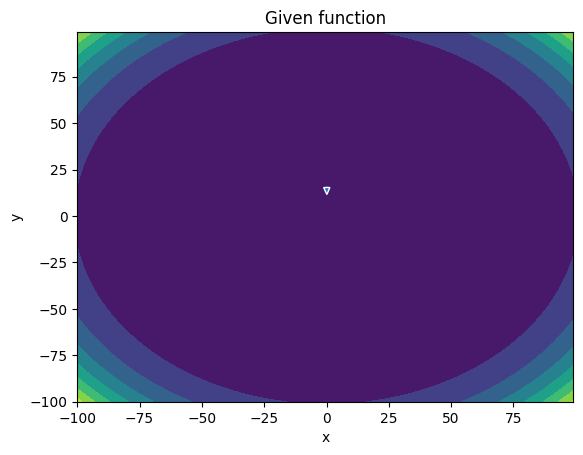

-------
Initial Coordinates:
[[ 0.09220006]
 [15.32357259]]
Final Coordinates:
[[ 0.08889607]
 [15.2294978 ]]
Gradient:
[[2.34634814e+03]
 [2.79981184e+07]]


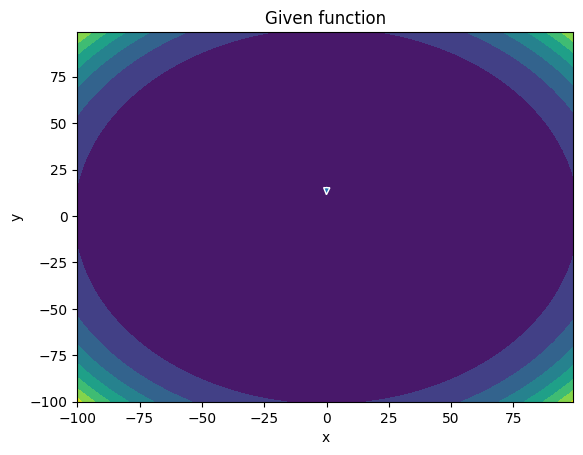

-------
Initial Coordinates:
[[ 0.08889607]
 [15.2294978 ]]
Final Coordinates:
[[ 0.09500172]
 [15.13549763]]
Gradient:
[[-4.64333029e+03]
 [ 2.71470537e+07]]


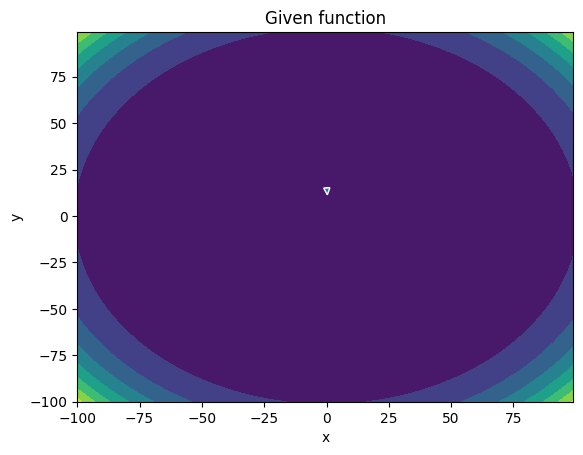

-------
Initial Coordinates:
[[ 0.09500172]
 [15.13549763]]
Final Coordinates:
[[ 0.09038427]
 [15.04157334]]
Gradient:
[[5.15864660e+03]
 [2.63178452e+07]]


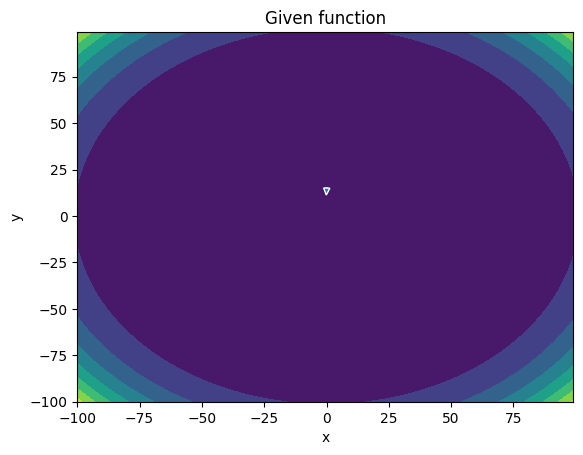

-------
Initial Coordinates:
[[ 0.09038427]
 [15.04157334]]
Final Coordinates:
[[ 0.09380523]
 [14.94772625]]
Gradient:
[[-3.82891708e+03]
 [ 2.55092128e+07]]


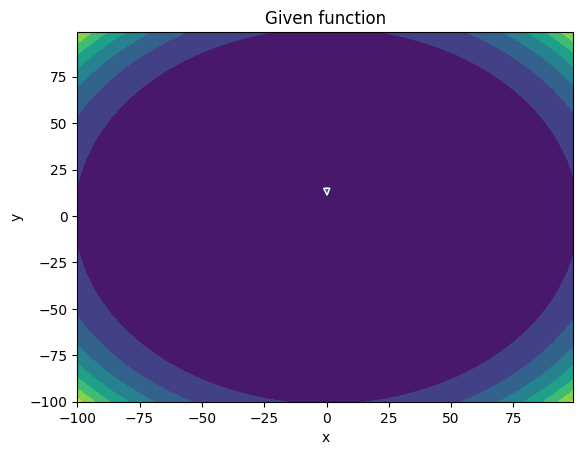

-------
Initial Coordinates:
[[ 0.09380523]
 [14.94772625]]
Final Coordinates:
[[ 0.09495388]
 [14.8539577 ]]
Gradient:
[[9.91727292e+02]
 [2.47215359e+07]]


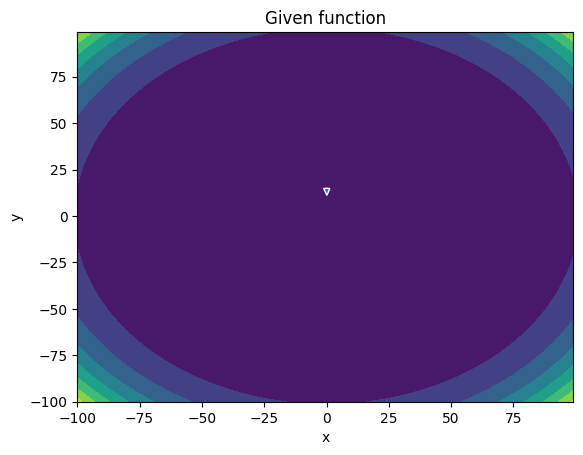

-------
Initial Coordinates:
[[ 0.09495388]
 [14.8539577 ]]
Final Coordinates:
[[ 0.09190203]
 [14.76026902]]
Gradient:
[[1.87655308e+03]
 [2.39539725e+07]]


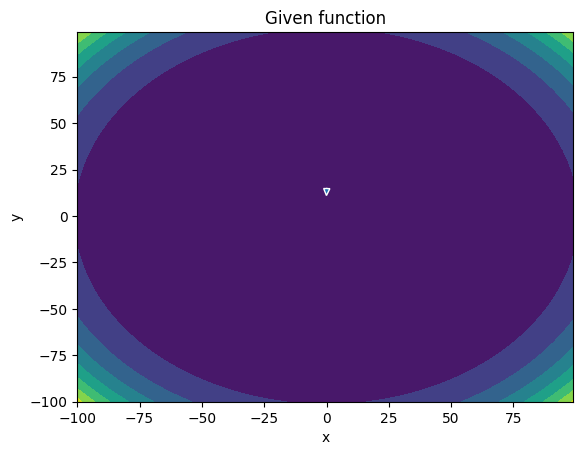

-------
Initial Coordinates:
[[ 0.09190203]
 [14.76026902]]
Final Coordinates:
[[ 0.0979096 ]
 [14.66666163]]
Gradient:
[[-3.94168870e+03]
 [ 2.32060441e+07]]


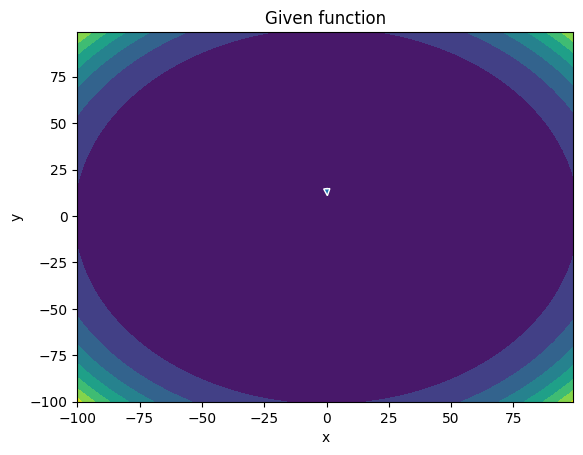

-------
Initial Coordinates:
[[ 0.0979096 ]
 [14.66666163]]
Final Coordinates:
[[ 0.09329286]
 [14.57313691]]
Gradient:
[[4.49600259e+03]
 [2.24778858e+07]]


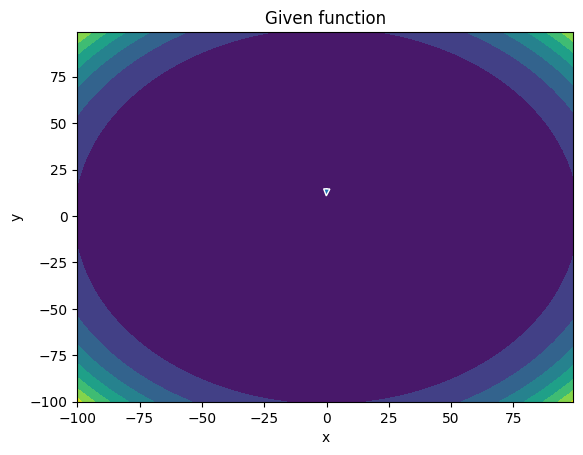

-------
Initial Coordinates:
[[ 0.09329286]
 [14.57313691]]
Final Coordinates:
[[ 0.09696131]
 [14.47969633]]
Gradient:
[[-3.47645286e+03]
 [ 2.17683163e+07]]


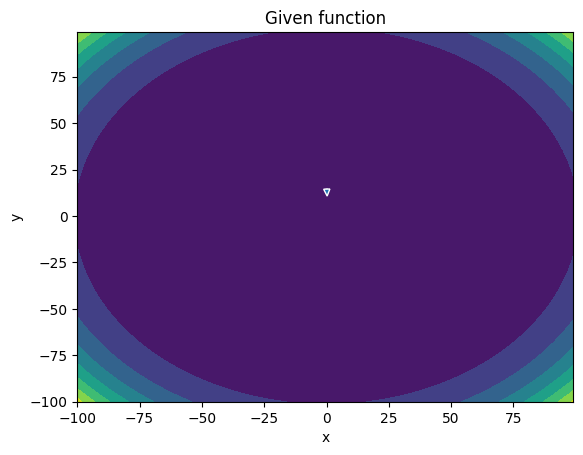

-------
Initial Coordinates:
[[ 0.09696131]
 [14.47969633]]
Final Coordinates:
[[ 0.09783878]
 [14.38634134]]
Gradient:
[[1.08409105e+03]
 [2.10776996e+07]]


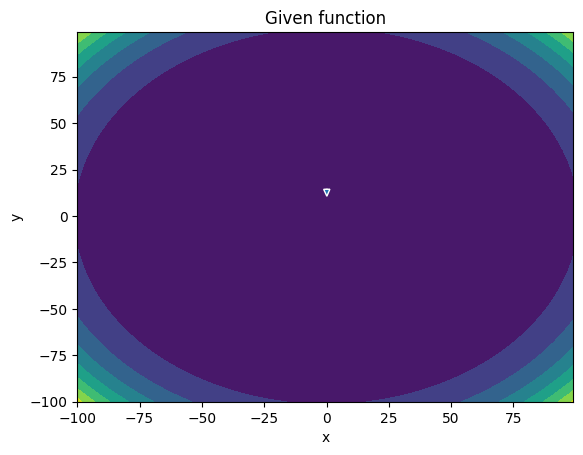

-------
Initial Coordinates:
[[ 0.09783878]
 [14.38634134]]
Final Coordinates:
[[ 0.09511608]
 [14.29307346]]
Gradient:
[[1.41802348e+03]
 [2.04052183e+07]]


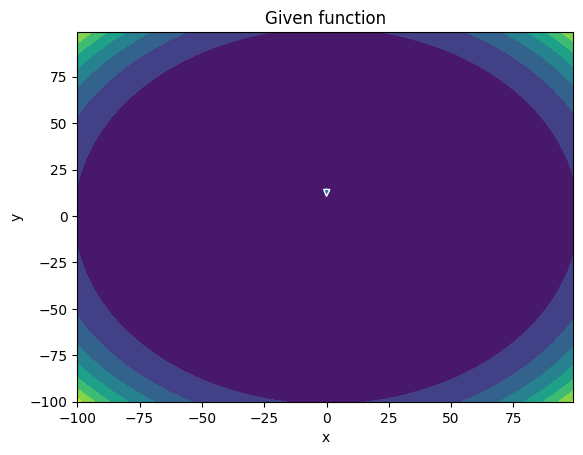

-------
Initial Coordinates:
[[ 0.09511608]
 [14.29307346]]
Final Coordinates:
[[ 0.10098751]
 [14.19989422]]
Gradient:
[[-3.28599912e+03]
 [ 1.97504695e+07]]


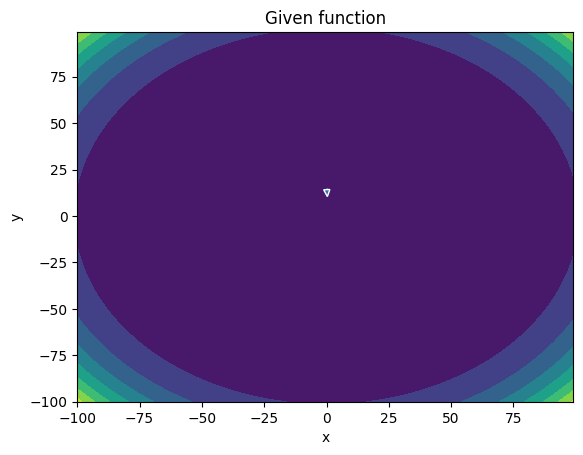

-------
Initial Coordinates:
[[ 0.10098751]
 [14.19989422]]
Final Coordinates:
[[ 0.09636555]
 [14.10680517]]
Gradient:
[[3.89084766e+03]
 [1.91135416e+07]]


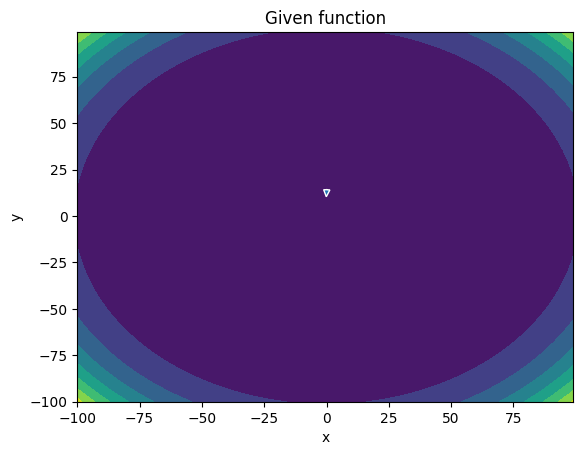

-------
Initial Coordinates:
[[ 0.09636555]
 [14.10680517]]
Final Coordinates:
[[ 0.10034425]
 [14.01380793]]
Gradient:
[[-3.16735236e+03]
 [ 1.84933526e+07]]


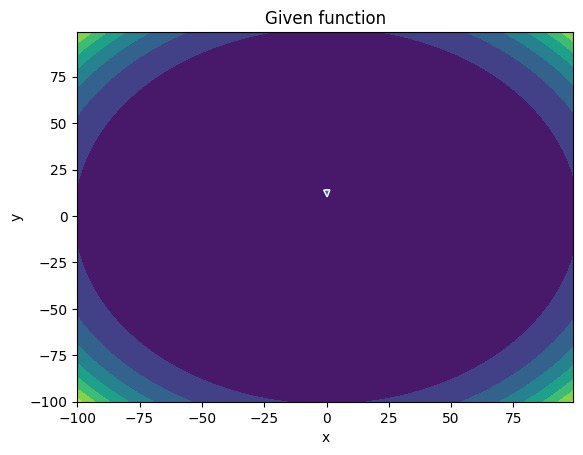

-------
Initial Coordinates:
[[ 0.10034425]
 [14.01380793]]
Final Coordinates:
[[ 0.10086666]
 [13.92090412]]
Gradient:
[[1.18881298e+03]
 [1.78902524e+07]]


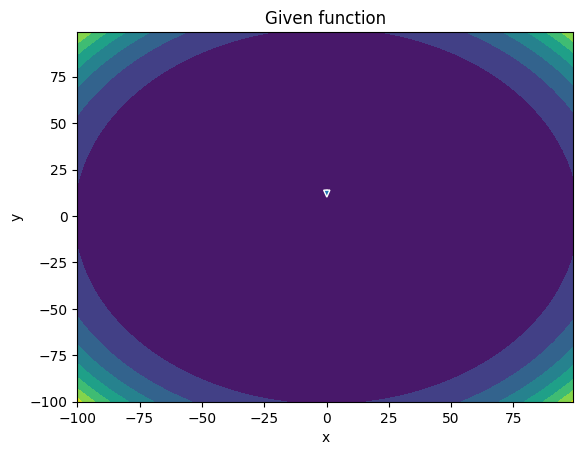

-------
Initial Coordinates:
[[ 0.10086666]
 [13.92090412]]
Final Coordinates:
[[ 0.09855933]
 [13.82809539]]
Gradient:
[[9.81156985e+02]
 [1.73034423e+07]]


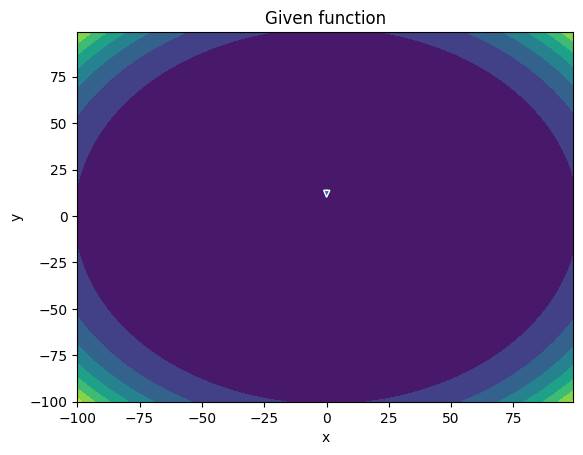

-------
Initial Coordinates:
[[ 0.09855933]
 [13.82809539]]
Final Coordinates:
[[ 0.10424213]
 [13.73538347]]
Gradient:
[[-2.67615993e+03]
 [ 1.67325995e+07]]


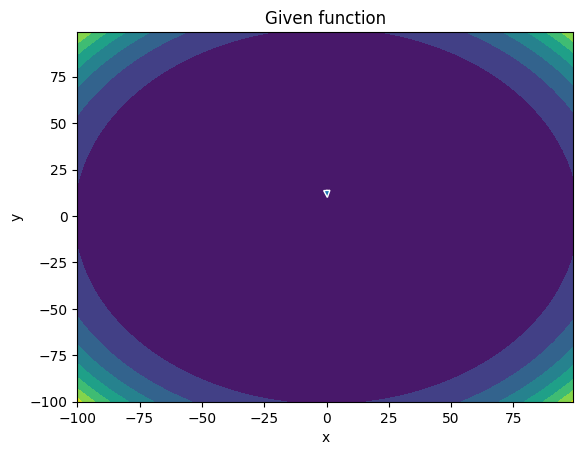

-------
Initial Coordinates:
[[ 0.10424213]
 [13.73538347]]
Final Coordinates:
[[ 0.09962768]
 [13.64277006]]
Gradient:
[[3.33182924e+03]
 [1.61777604e+07]]


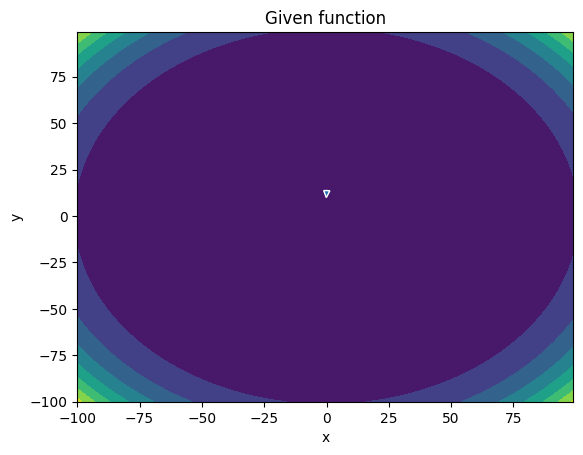

-------
Initial Coordinates:
[[ 0.09962768]
 [13.64277006]]
Final Coordinates:
[[ 0.10396599]
 [13.55025695]]
Gradient:
[[-2.88203856e+03]
 [ 1.56379437e+07]]


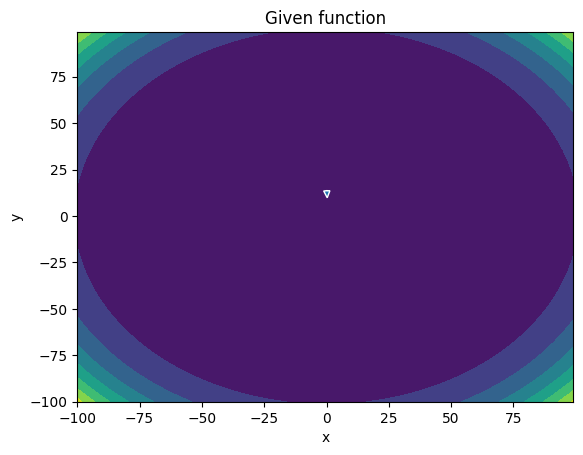

-------
Initial Coordinates:
[[ 0.10396599]
 [13.55025695]]
Final Coordinates:
[[ 0.10405141]
 [13.45784594]]
Gradient:
[[1.28816209e+03]
 [1.51134839e+07]]


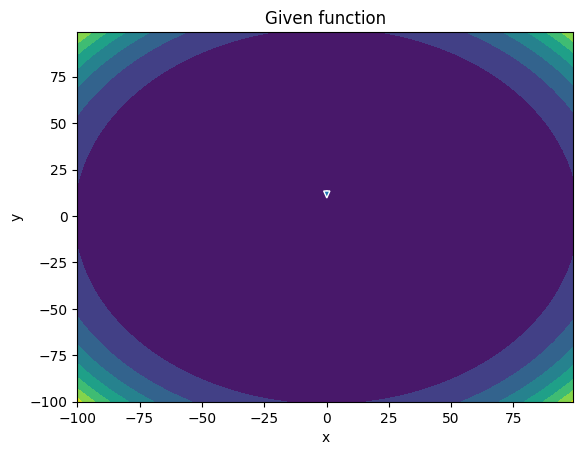

-------
Initial Coordinates:
[[ 0.10405141]
 [13.45784594]]
Final Coordinates:
[[ 0.10225532]
 [13.36553886]]
Gradient:
[[5.74855357e+02]
 [1.46035980e+07]]


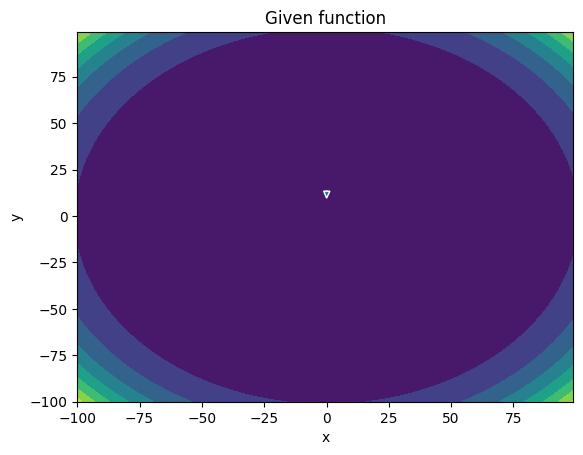

-------
Initial Coordinates:
[[ 0.10225532]
 [13.36553886]]
Final Coordinates:
[[ 0.10767982]
 [13.27333762]]
Gradient:
[[-2.11226495e+03]
 [ 1.41080460e+07]]


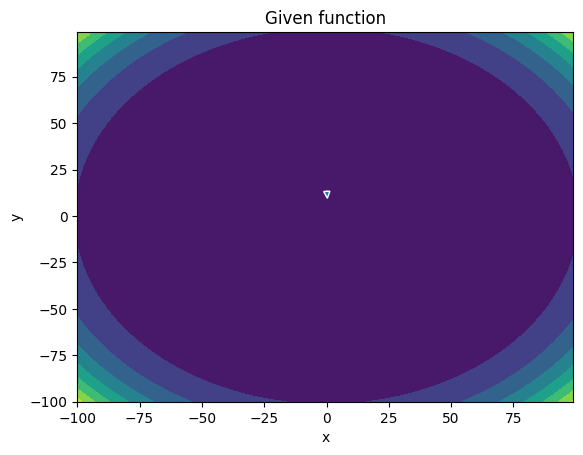

-------
Initial Coordinates:
[[ 0.10767982]
 [13.27333762]]
Final Coordinates:
[[ 0.10310998]
 [13.1812441 ]]
Gradient:
[[2.81025786e+03]
 [1.36268072e+07]]


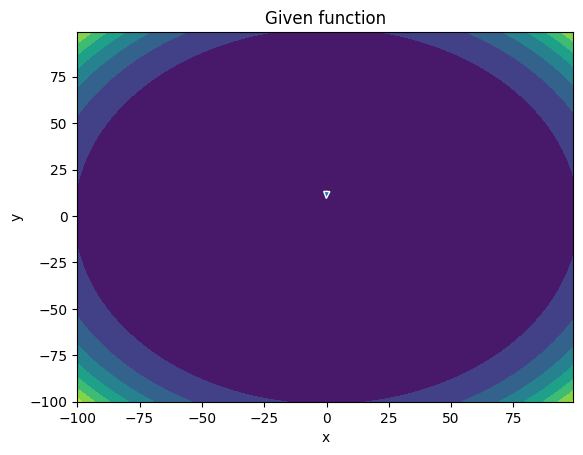

-------
Initial Coordinates:
[[ 0.10310998]
 [13.1812441 ]]
Final Coordinates:
[[ 0.10783646]
 [13.0892603 ]]
Gradient:
[[-2.60444606e+03]
 [ 1.31590035e+07]]


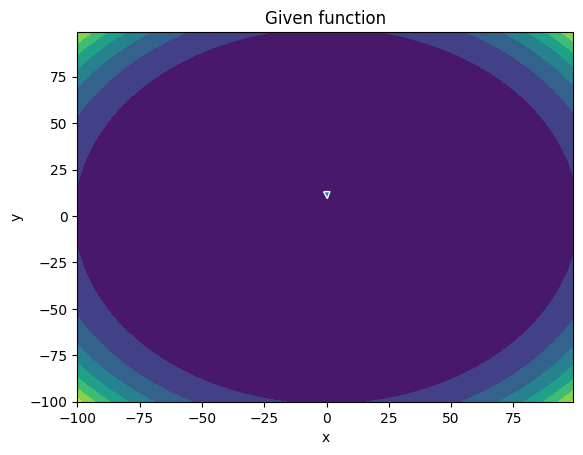

-------
Initial Coordinates:
[[ 0.10783646]
 [13.0892603 ]]
Final Coordinates:
[[ 0.10740995]
 [12.99738819]]
Gradient:
[[1.36663081e+03]
 [1.27049506e+07]]


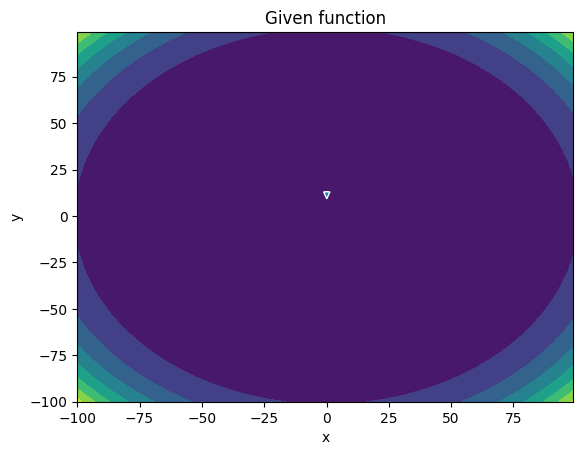

-------
Initial Coordinates:
[[ 0.10740995]
 [12.99738819]]
Final Coordinates:
[[ 0.10622964]
 [12.90562981]]
Gradient:
[[2.07141079e+02]
 [1.22638810e+07]]


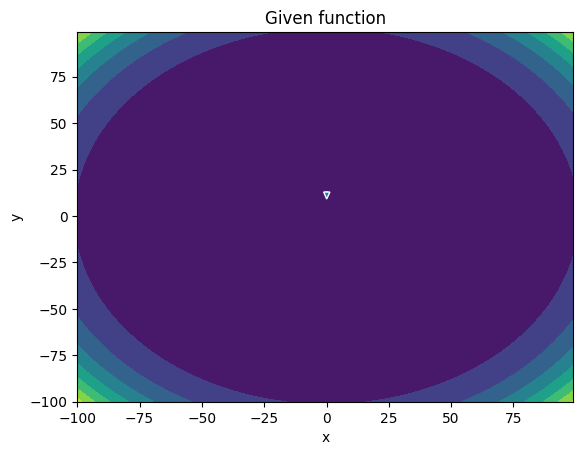

-------
Initial Coordinates:
[[ 0.10622964]
 [12.90562981]]
Final Coordinates:
[[ 0.11130741]
 [12.81398727]]
Gradient:
[[-1.59508464e+03]
 [ 1.18356375e+07]]


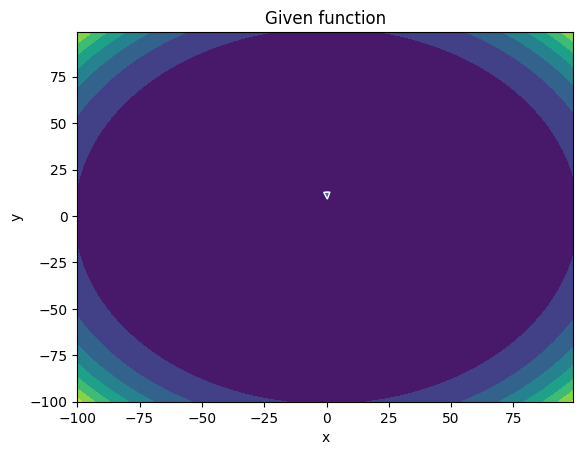

-------
Initial Coordinates:
[[ 0.11130741]
 [12.81398727]]
Final Coordinates:
[[ 0.1068488 ]
 [12.72246266]]
Gradient:
[[2.32070494e+03]
 [1.14201389e+07]]


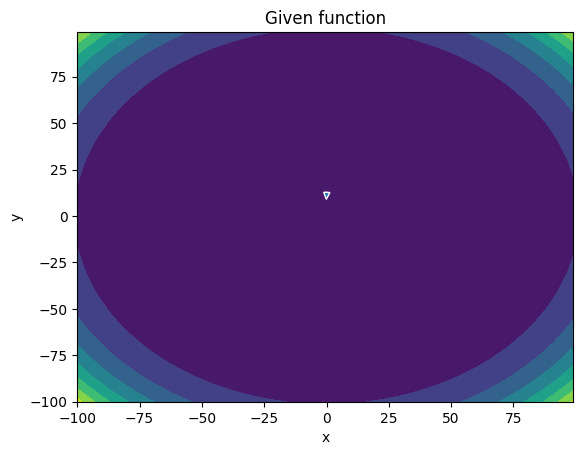

-------
Initial Coordinates:
[[ 0.1068488 ]
 [12.72246266]]
Final Coordinates:
[[ 0.11196262]
 [12.63105818]]
Gradient:
[[-2.32282612e+03]
 [ 1.10166130e+07]]


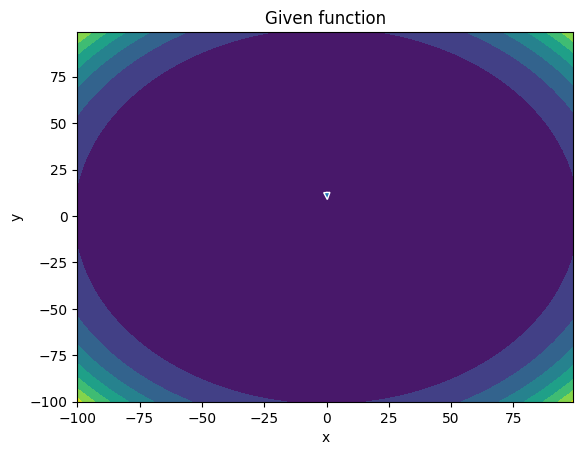

-------
Initial Coordinates:
[[ 0.11196262]
 [12.63105818]]
Final Coordinates:
[[ 0.11096377]
 [12.53977601]]
Gradient:
[[1.41115948e+03]
 [1.06253508e+07]]


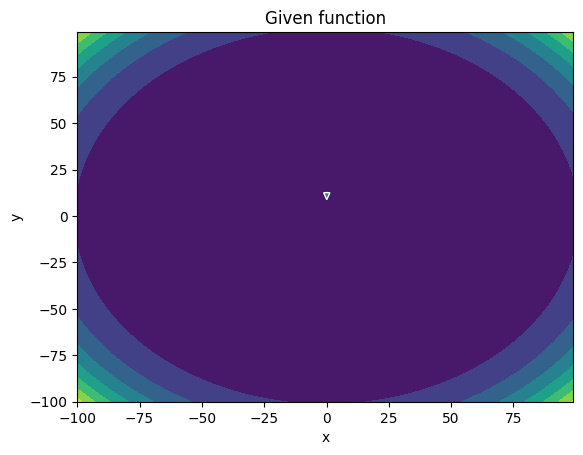

-------
Initial Coordinates:
[[ 0.11096377]
 [12.53977601]]
Final Coordinates:
[[ 0.11050949]
 [12.44861843]]
Gradient:
[[-1.14468266e+02]
 [ 1.02456037e+07]]


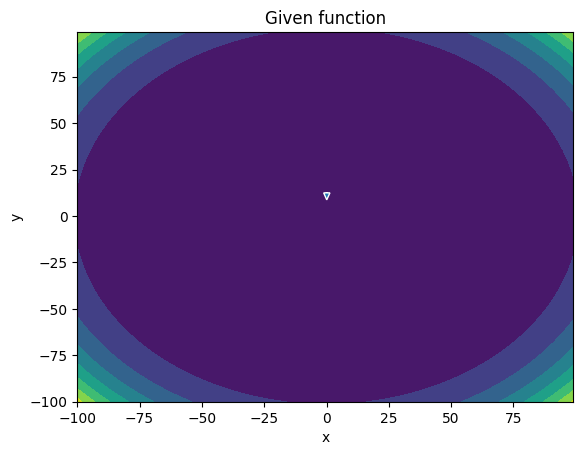

-------
Initial Coordinates:
[[ 0.11050949]
 [12.44861843]]
Final Coordinates:
[[ 0.11513321]
 [12.35758776]]
Gradient:
[[-1.12618465e+03]
 [ 9.87729471e+06]]


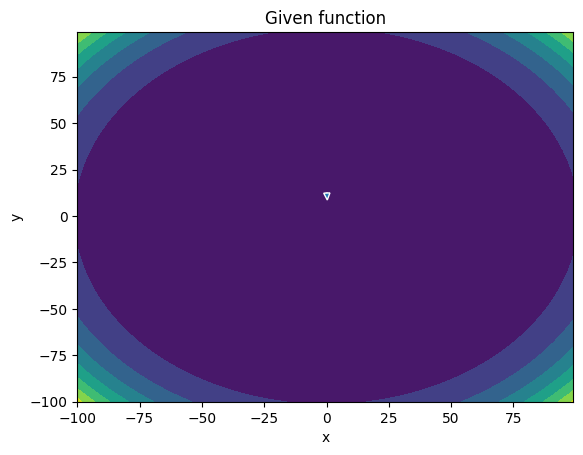

-------
Initial Coordinates:
[[ 0.11513321]
 [12.35758776]]
Final Coordinates:
[[ 0.11088567]
 [12.2666863 ]]
Gradient:
[[1.8610519e+03]
 [9.5202791e+06]]


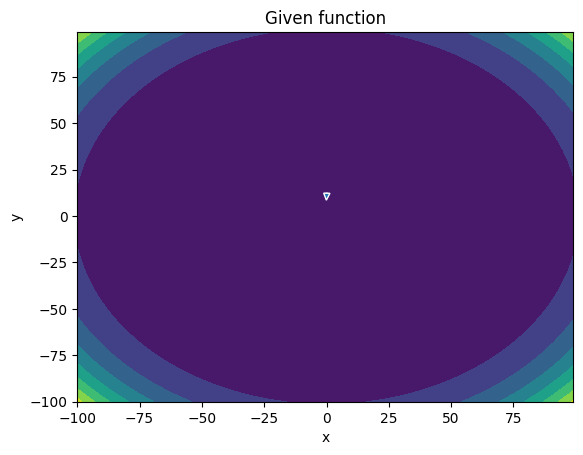

-------
Initial Coordinates:
[[ 0.11088567]
 [12.2666863 ]]
Final Coordinates:
[[ 0.11634763]
 [12.17591651]]
Gradient:
[[-2.03046285e+03]
 [ 9.17389478e+06]]


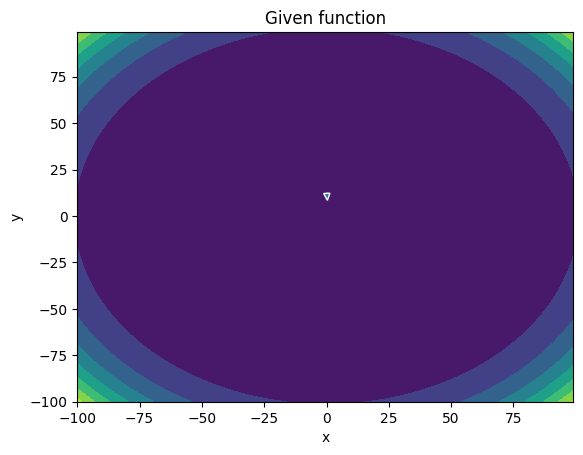

-------
Initial Coordinates:
[[ 0.11634763]
 [12.17591651]]
Final Coordinates:
[[ 0.11474095]
 [12.08528079]]
Gradient:
[[1.41175519e+03]
 [8.83839945e+06]]


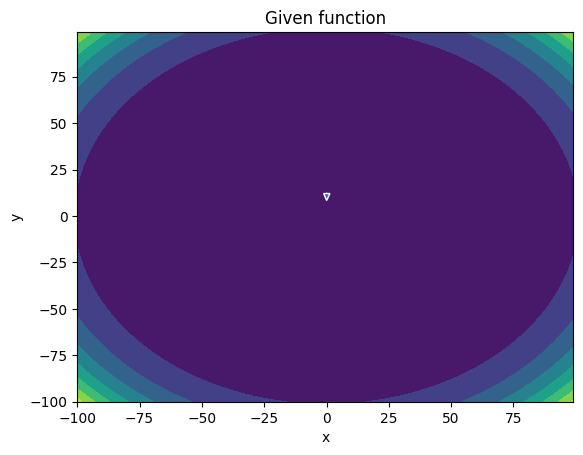

-------
Initial Coordinates:
[[ 0.11474095]
 [12.08528079]]
Final Coordinates:
[[ 0.1151231 ]
 [11.99478166]]
Gradient:
[[-3.82833519e+02]
 [ 8.51307053e+06]]


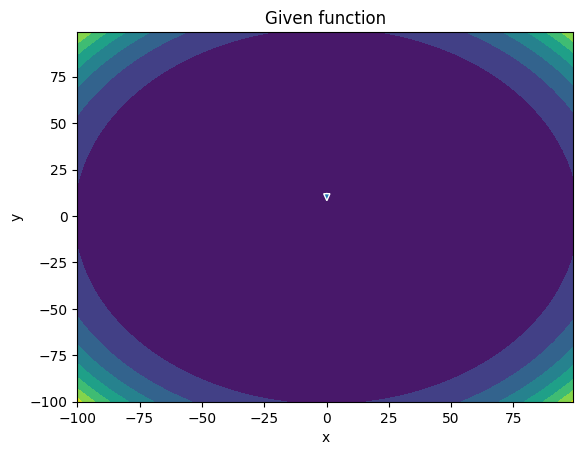

-------
Initial Coordinates:
[[ 0.1151231 ]
 [11.99478166]]
Final Coordinates:
[[ 0.11916786]
 [11.90442168]]
Gradient:
[[-7.07817459e+02]
 [ 8.19790450e+06]]


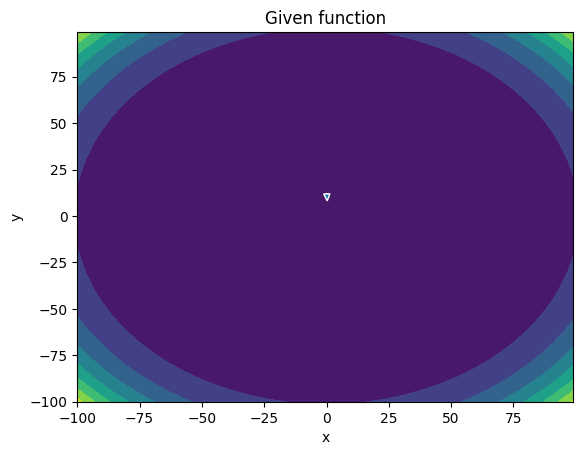

-------
Initial Coordinates:
[[ 0.11916786]
 [11.90442168]]
Final Coordinates:
[[ 0.11526625]
 [11.81420341]]
Gradient:
[[1.43193375e+03]
 [7.89269340e+06]]


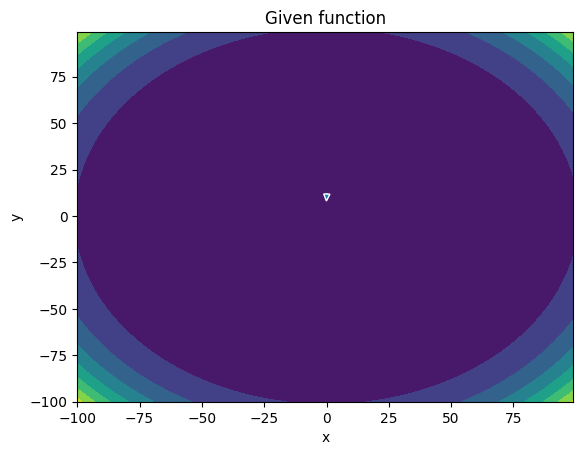

-------
Initial Coordinates:
[[ 0.11526625]
 [11.81420341]]
Final Coordinates:
[[ 0.12099065]
 [11.72412955]]
Gradient:
[[-1.72593977e+03]
 [ 7.59688790e+06]]


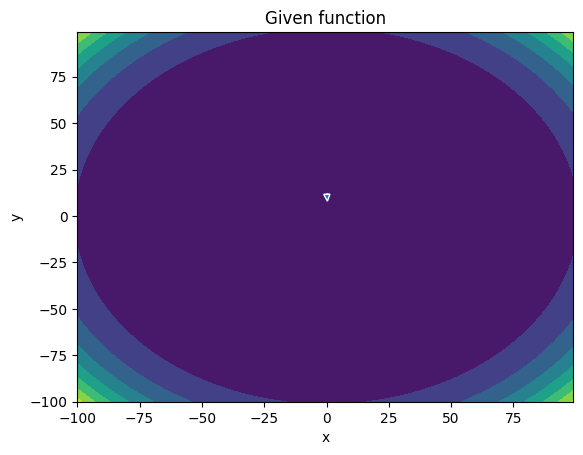

-------
Initial Coordinates:
[[ 0.12099065]
 [11.72412955]]
Final Coordinates:
[[ 0.11877887]
 [11.63420276]]
Gradient:
[[1.36229146e+03]
 [7.31070305e+06]]


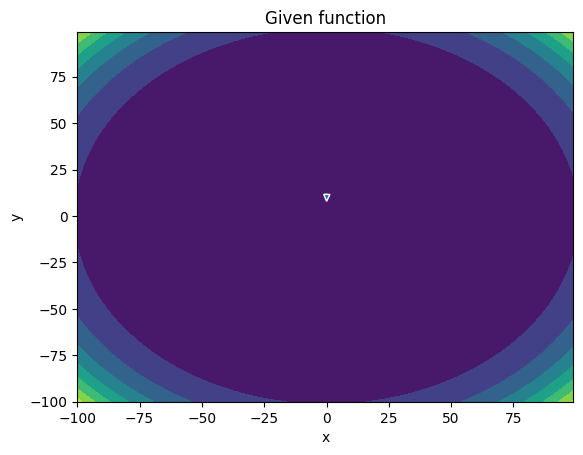

-------
Initial Coordinates:
[[ 0.11877887]
 [11.63420276]]
Final Coordinates:
[[ 0.12009841]
 [11.54442583]]
Gradient:
[[-5.91226740e+02]
 [ 7.03345214e+06]]


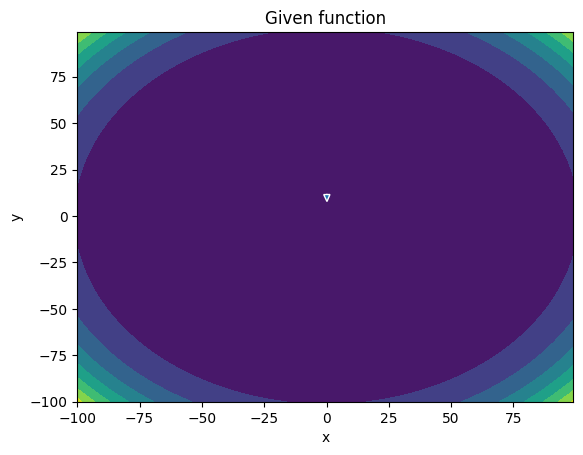

-------
Initial Coordinates:
[[ 0.12009841]
 [11.54442583]]
Final Coordinates:
[[ 0.12342507]
 [11.45480157]]
Gradient:
[[-3.42904431e+02]
 [ 6.76519533e+06]]


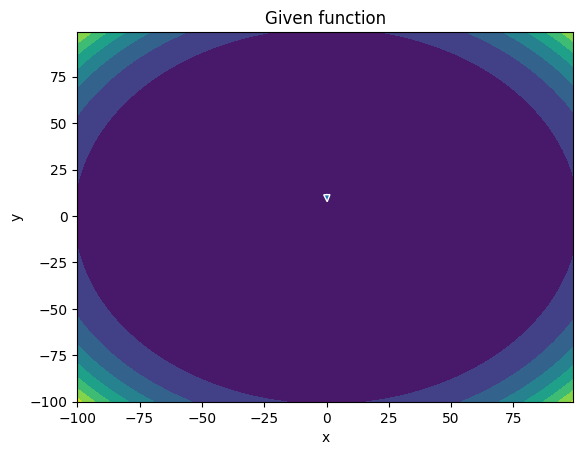

-------
Initial Coordinates:
[[ 0.12342507]
 [11.45480157]]
Final Coordinates:
[[ 0.12003902]
 [11.36533283]]
Gradient:
[[1.03583751e+03]
 [6.50566368e+06]]


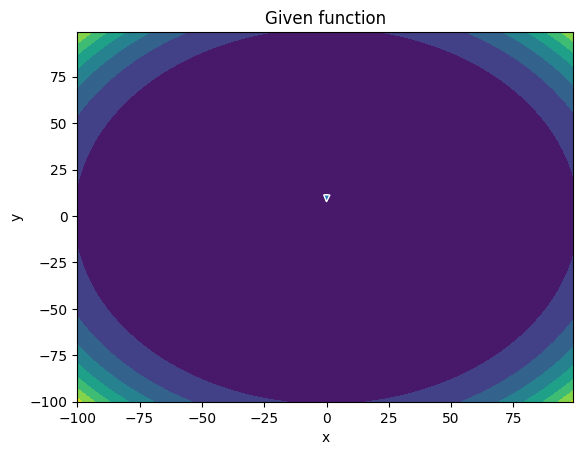

-------
Initial Coordinates:
[[ 0.12003902]
 [11.36533283]]
Final Coordinates:
[[ 0.12588732]
 [11.27602257]]
Gradient:
[[-1.41271148e+03]
 [ 6.25442263e+06]]


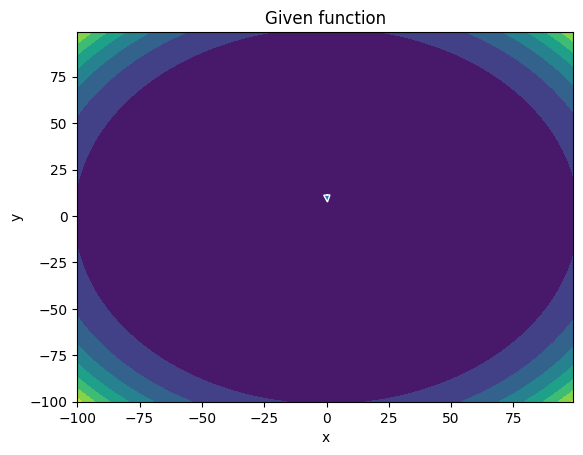

-------
Initial Coordinates:
[[ 0.12588732]
 [11.27602257]]
Final Coordinates:
[[ 0.12312797]
 [11.18687372]]
Gradient:
[[1.26119015e+03]
 [6.01163443e+06]]


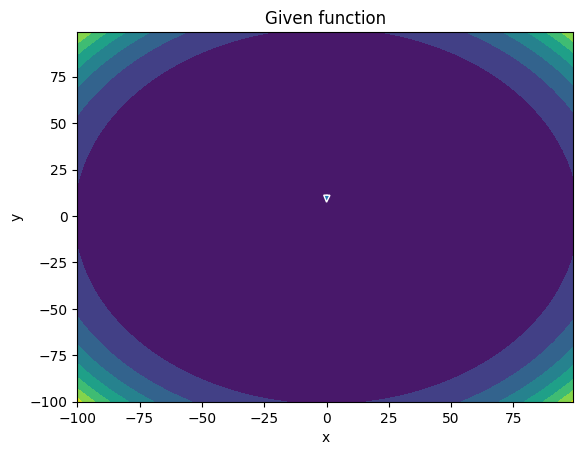

-------
Initial Coordinates:
[[ 0.12312797]
 [11.18687372]]
Final Coordinates:
[[ 0.12546001]
 [11.09788938]]
Gradient:
[[-7.33446825e+02]
 [ 5.77666069e+06]]


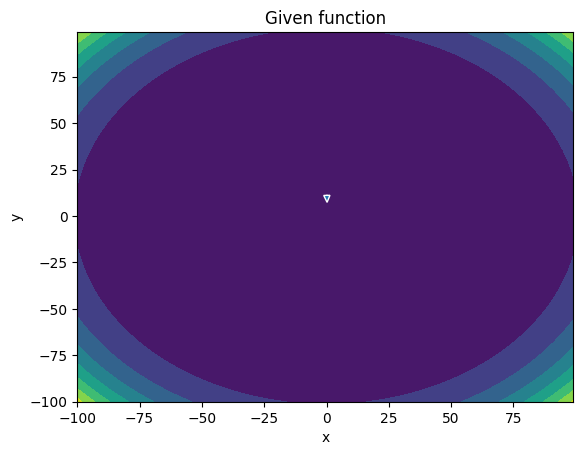

-------
Initial Coordinates:
[[ 0.12546001]
 [11.09788938]]
Final Coordinates:
[[ 0.12792288]
 [11.00907262]]
Gradient:
[[-3.54531637e+01]
 [ 5.54961158e+06]]


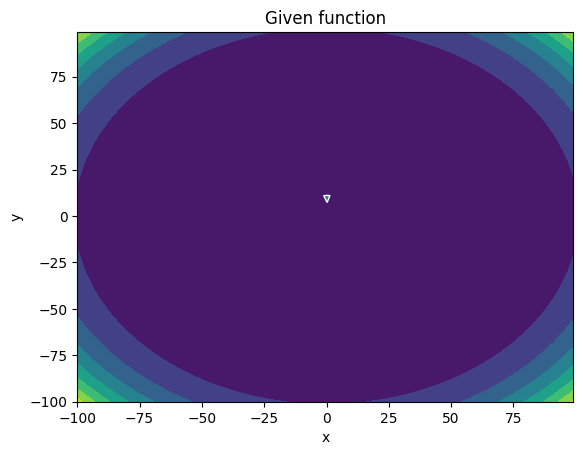

-------
Initial Coordinates:
[[ 0.12792288]
 [11.00907262]]
Final Coordinates:
[[ 0.12525357]
 [10.92042659]]
Gradient:
[[6.76435018e+02]
 [5.33016300e+06]]


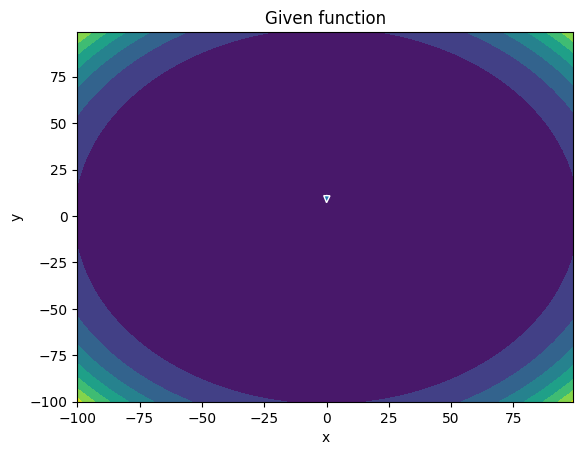

-------
Initial Coordinates:
[[ 0.12525357]
 [10.92042659]]
Final Coordinates:
[[ 0.13103164]
 [10.83195455]]
Gradient:
[[-1.09813759e+03]
 [ 5.11799502e+06]]


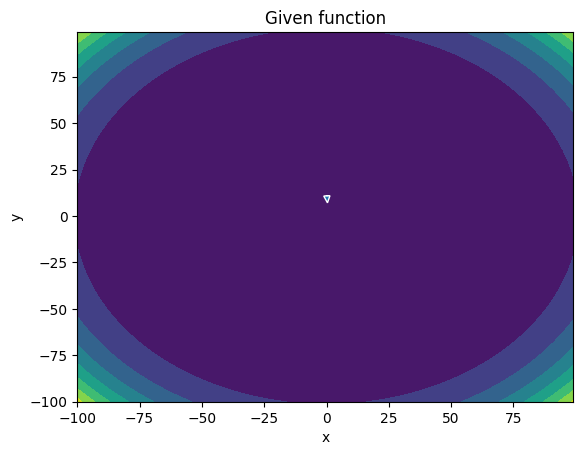

-------
Initial Coordinates:
[[ 0.13103164]
 [10.83195455]]
Final Coordinates:
[[ 0.1278561 ]
 [10.74365973]]
Gradient:
[[1.11195399e+03]
 [4.91320737e+06]]


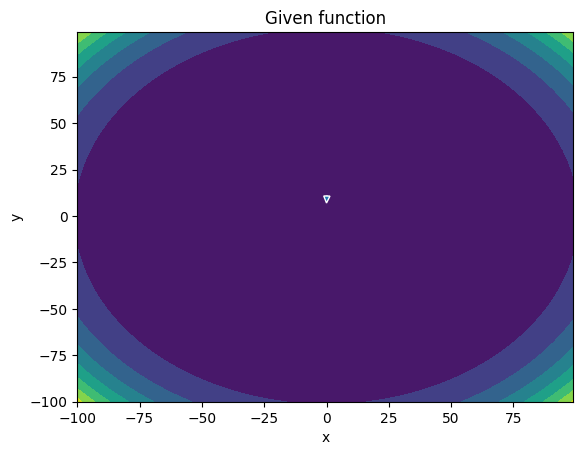

-------
Initial Coordinates:
[[ 0.1278561 ]
 [10.74365973]]
Final Coordinates:
[[ 0.13122298]
 [10.65554553]]
Gradient:
[[-8.04353843e+02]
 [ 4.71522419e+06]]


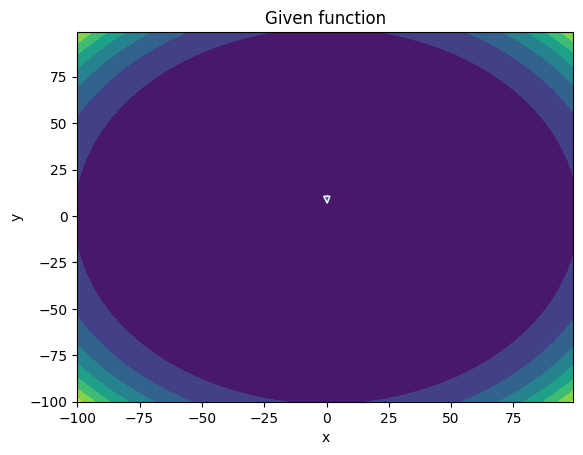

-------
Initial Coordinates:
[[ 0.13122298]
 [10.65554553]]
Final Coordinates:
[[ 0.1326869 ]
 [10.56761533]]
Gradient:
[[2.08682751e+02]
 [4.52418807e+06]]


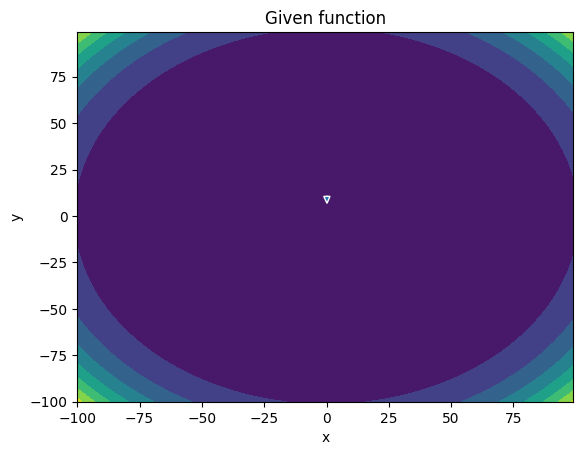

-------
Initial Coordinates:
[[ 0.1326869 ]
 [10.56761533]]
Final Coordinates:
[[ 0.13095821]
 [10.47987259]]
Gradient:
[[3.58660797e+02]
 [4.33973006e+06]]


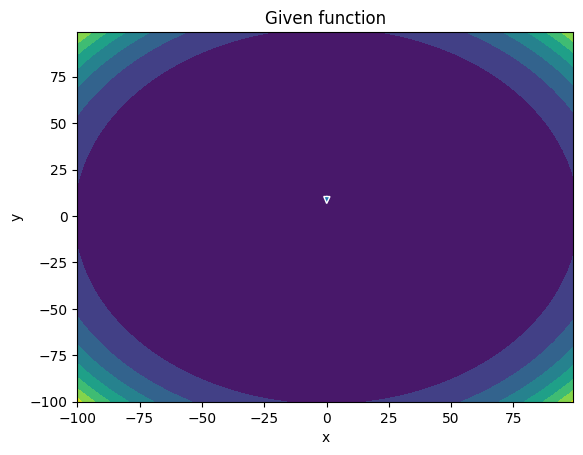

-------
Initial Coordinates:
[[ 0.13095821]
 [10.47987259]]
Final Coordinates:
[[ 0.13642063]
 [10.39232089]]
Gradient:
[[-7.92341439e+02]
 [ 4.16164137e+06]]


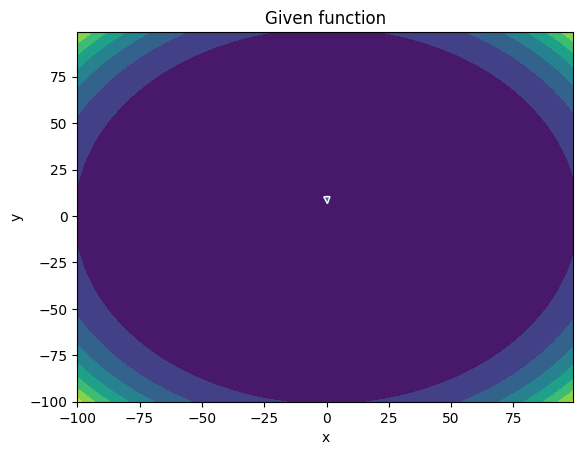

-------
Initial Coordinates:
[[ 0.13642063]
 [10.39232089]]
Final Coordinates:
[[ 0.13305033]
 [10.30496377]]
Gradient:
[[9.23711757e+02]
 [3.98995120e+06]]


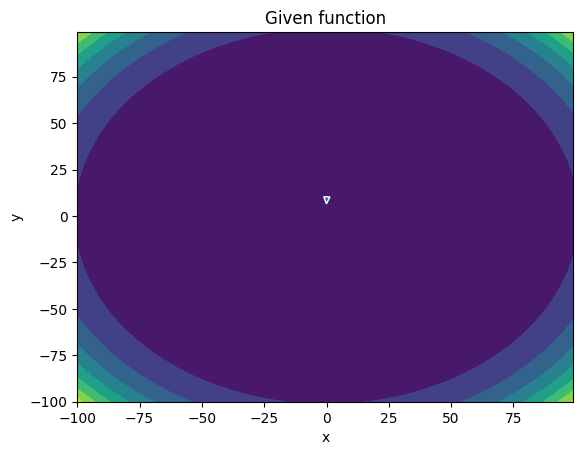

-------
Initial Coordinates:
[[ 0.13305033]
 [10.30496377]]
Final Coordinates:
[[ 0.13738425]
 [10.21780496]]
Gradient:
[[-8.01829717e+02]
 [ 3.82416086e+06]]


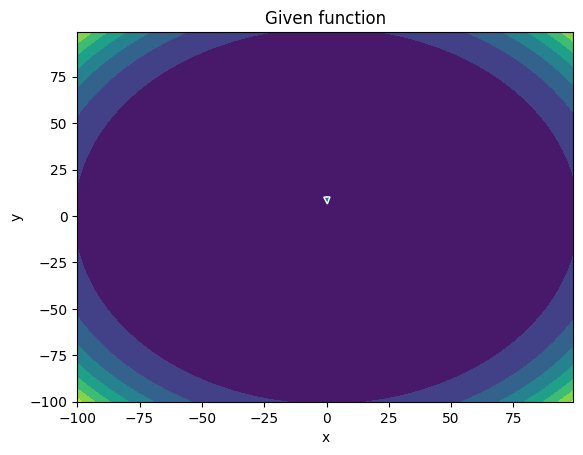

-------
Initial Coordinates:
[[ 0.13738425]
 [10.21780496]]
Final Coordinates:
[[ 0.13775765]
 [10.13084815]]
Gradient:
[[3.81852711e+02]
 [3.66442446e+06]]


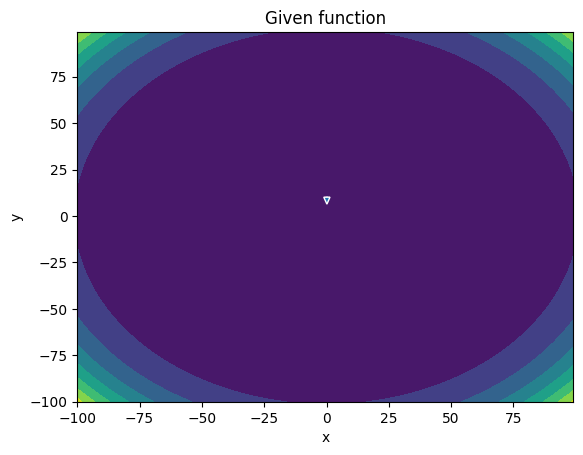

-------
Initial Coordinates:
[[ 0.13775765]
 [10.13084815]]
Final Coordinates:
[[ 0.13719671]
 [10.04409715]]
Gradient:
[[8.93898791e+01]
 [3.51034375e+06]]


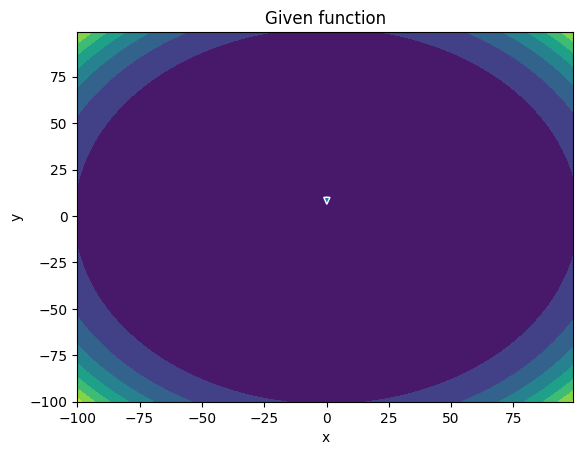

-------
Initial Coordinates:
[[ 0.13719671]
 [10.04409715]]
Final Coordinates:
[[0.14206217]
 [9.95755585]]
Gradient:
[[-5.06935866e+02]
 [ 3.36181262e+06]]


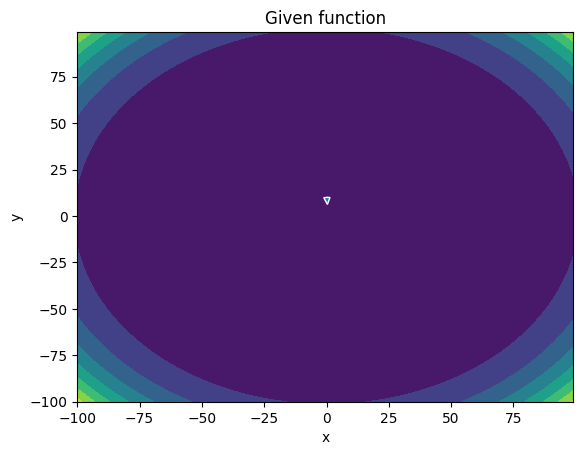

-------
Initial Coordinates:
[[0.14206217]
 [9.95755585]]
Final Coordinates:
[[0.13880993]
 [9.87122814]]
Gradient:
[[7.11119235e+02]
 [3.21878523e+06]]


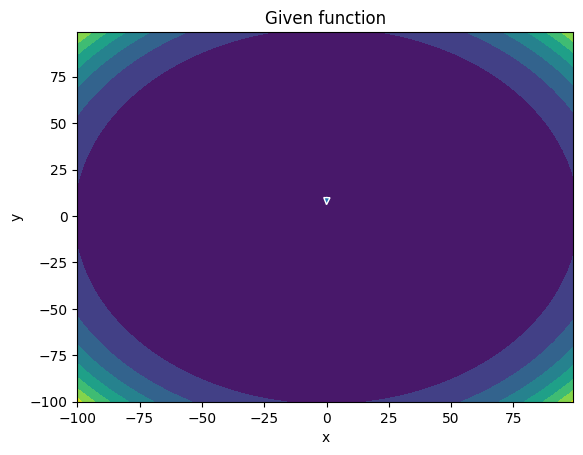

-------
Initial Coordinates:
[[0.13880993]
 [9.87122814]]
Final Coordinates:
[[0.14391749]
 [9.78511809]]
Gradient:
[[-7.30555028e+02]
 [ 3.08085329e+06]]


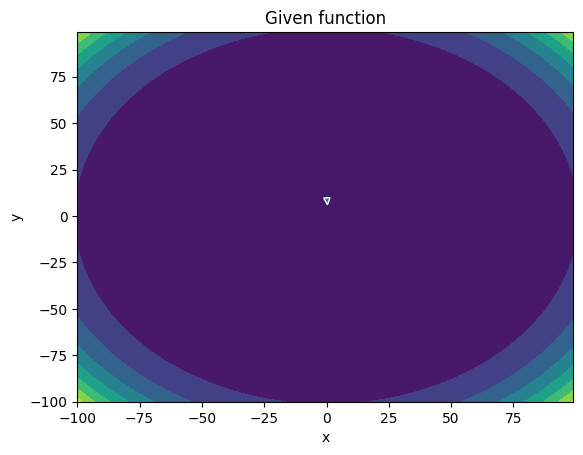

-------
Initial Coordinates:
[[0.14391749]
 [9.78511809]]
Final Coordinates:
[[0.14320188]
 [9.6992297 ]]
Gradient:
[[4.77344973e+02]
 [2.94815946e+06]]


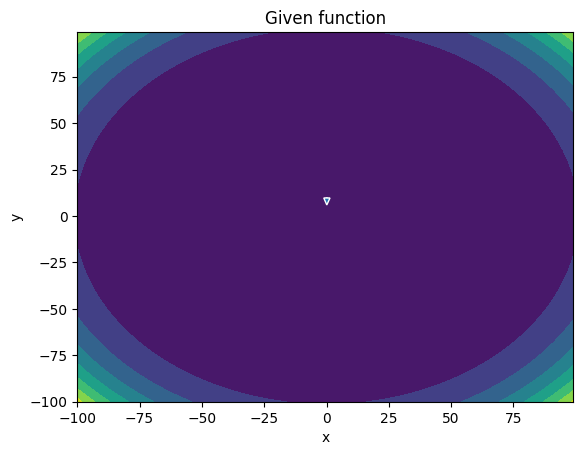

-------
Initial Coordinates:
[[0.14320188]
 [9.6992297 ]]
Final Coordinates:
[[0.14400442]
 [9.61356716]]
Gradient:
[[-1.22325166e+02]
 [ 2.82029738e+06]]


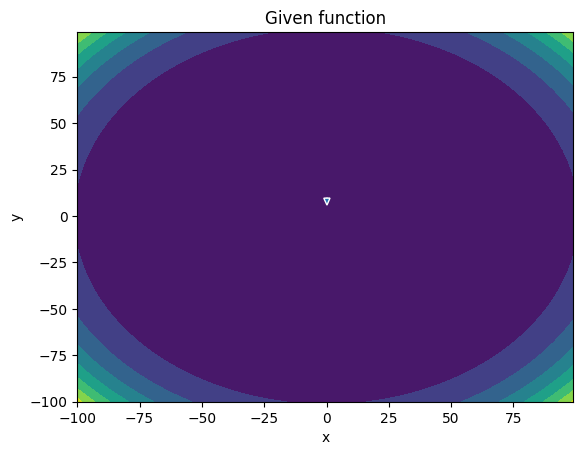

-------
Initial Coordinates:
[[0.14400442]
 [9.61356716]]
Final Coordinates:
[[0.14798149]
 [9.52813468]]
Gradient:
[[-2.53656857e+02]
 [ 2.69724844e+06]]


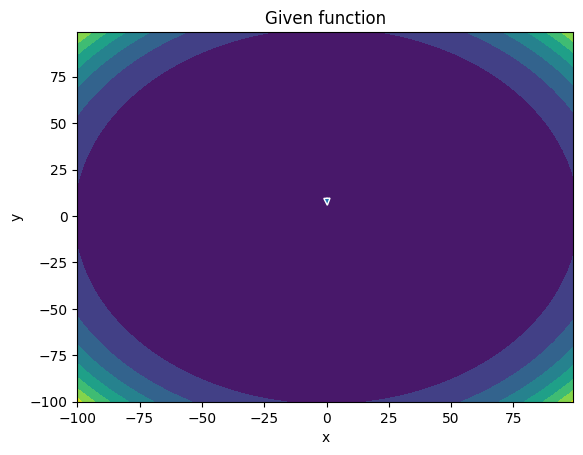

-------
Initial Coordinates:
[[0.14798149]
 [9.52813468]]
Final Coordinates:
[[0.14522977]
 [9.44293648]]
Gradient:
[[4.92070329e+02]
 [2.57889288e+06]]


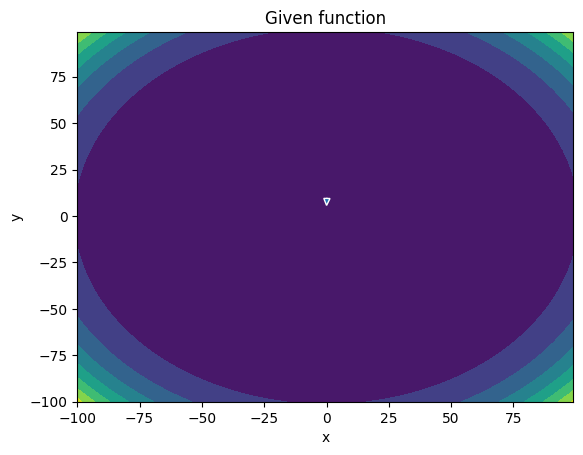

-------
Initial Coordinates:
[[0.14522977]
 [9.44293648]]
Final Coordinates:
[[0.15078054]
 [9.357977  ]]
Gradient:
[[-6.04869939e+02]
 [ 2.46492213e+06]]


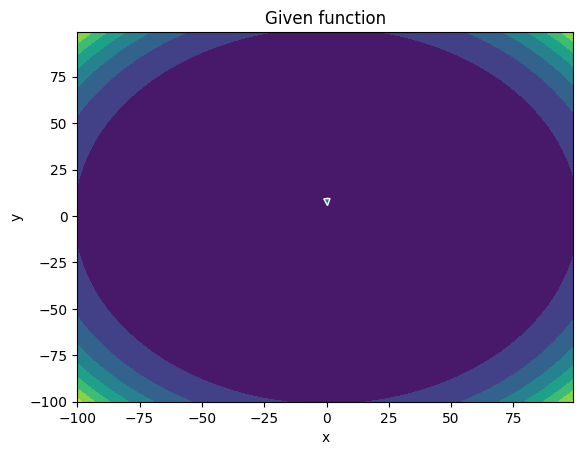

-------
Initial Coordinates:
[[0.15078054]
 [9.357977  ]]
Final Coordinates:
[[0.14912451]
 [9.27326058]]
Gradient:
[[4.94725881e+02]
 [2.35544521e+06]]


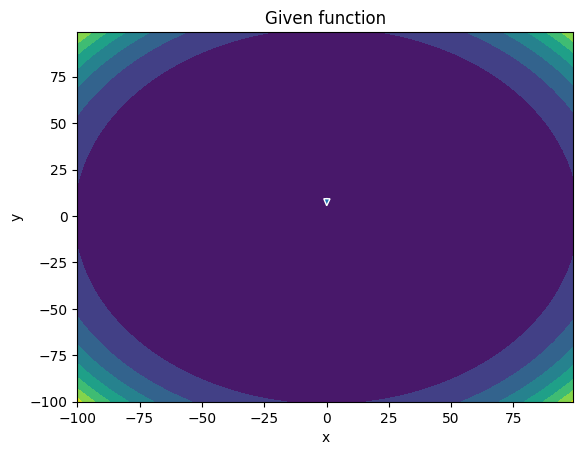

-------
Initial Coordinates:
[[0.14912451]
 [9.27326058]]
Final Coordinates:
[[0.15140032]
 [9.18879175]]
Gradient:
[[-2.66726573e+02]
 [ 2.25007271e+06]]


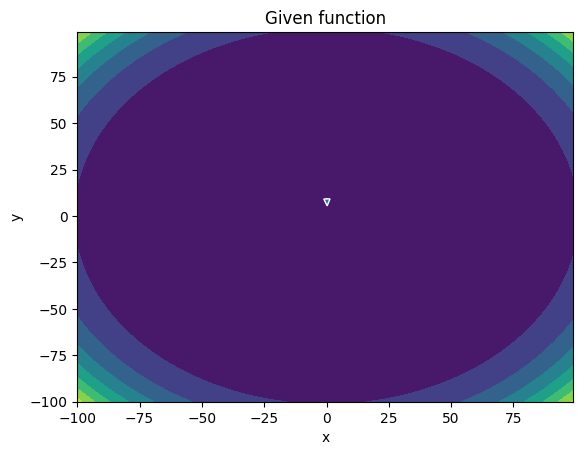

-------
Initial Coordinates:
[[0.15140032]
 [9.18879175]]
Final Coordinates:
[[0.15422249]
 [9.10457506]]
Gradient:
[[-4.3793250e+01]
 [ 2.1488512e+06]]


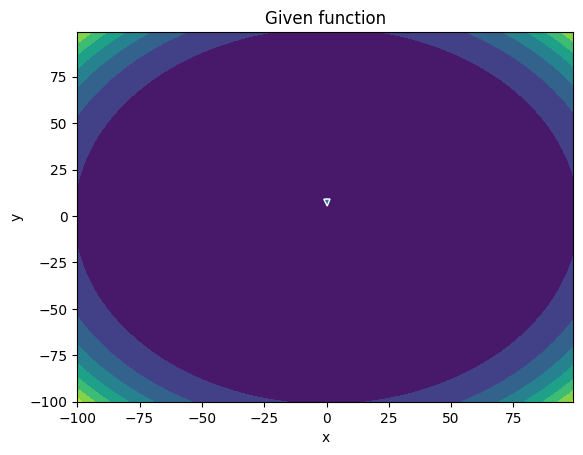

-------
Initial Coordinates:
[[0.15422249]
 [9.10457506]]
Final Coordinates:
[[0.15238456]
 [9.02061509]]
Gradient:
[[2.83855277e+02]
 [2.05159550e+06]]


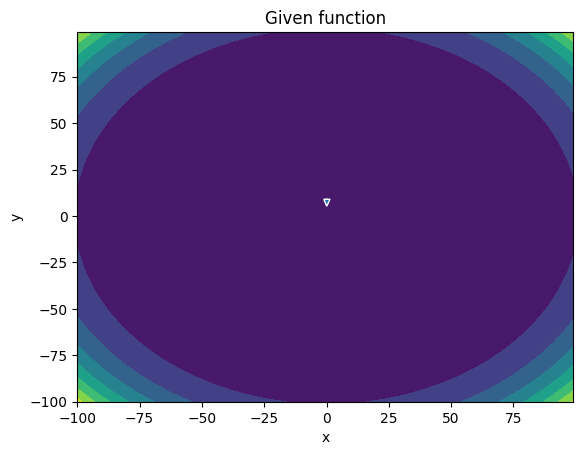

-------
Initial Coordinates:
[[0.15238456]
 [9.02061509]]
Final Coordinates:
[[0.15793624]
 [8.93691663]]
Gradient:
[[-4.46827490e+02]
 [ 1.95809994e+06]]


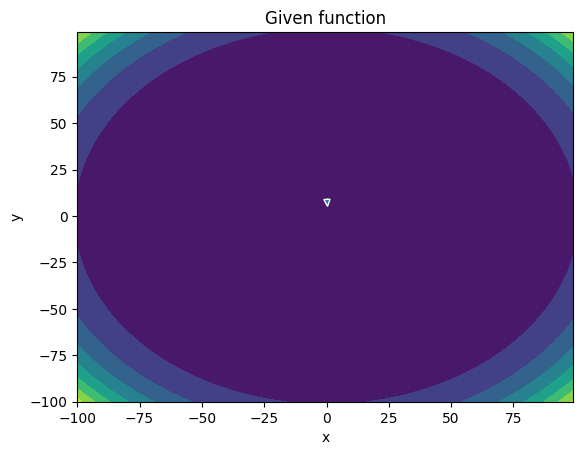

-------
Initial Coordinates:
[[0.15793624]
 [8.93691663]]
Final Coordinates:
[[0.15567387]
 [8.85348432]]
Gradient:
[[4.44049648e+02]
 [1.86842154e+06]]


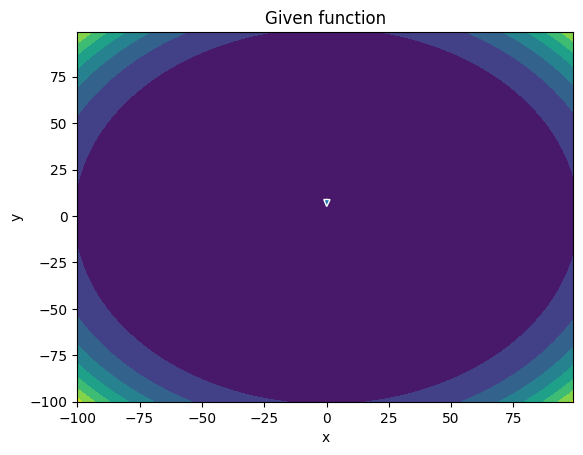

-------
Initial Coordinates:
[[0.15567387]
 [8.85348432]]
Final Coordinates:
[[0.15936999]
 [8.77032309]]
Gradient:
[[-3.36978628e+02]
 [ 1.78221360e+06]]


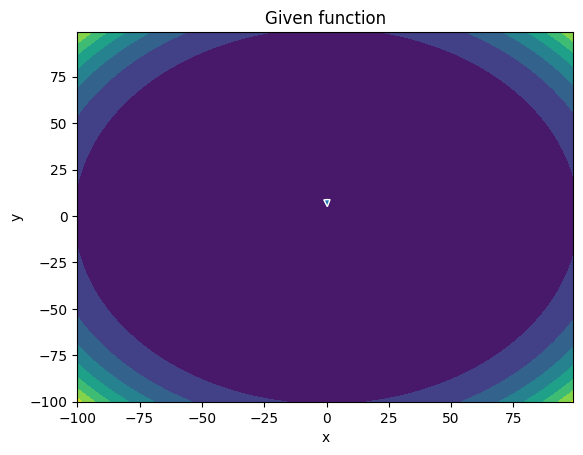

-------
Initial Coordinates:
[[0.15936999]
 [8.77032309]]
Final Coordinates:
[[0.16085229]
 [8.68743777]]
Gradient:
[[1.11287855e+02]
 [1.69955958e+06]]


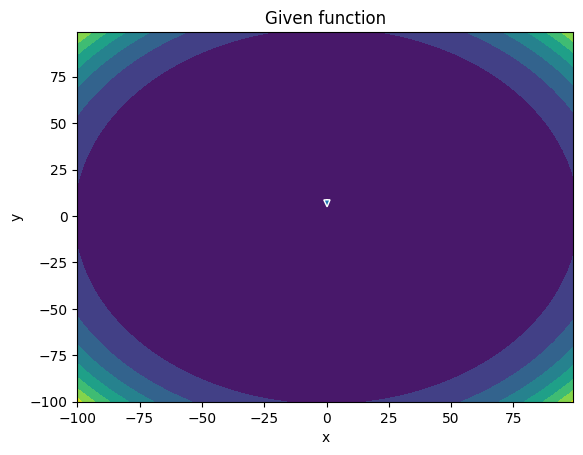

-------
Initial Coordinates:
[[0.16085229]
 [8.68743777]]
Final Coordinates:
[[0.16032297]
 [8.60483334]]
Gradient:
[[1.01364429e+02]
 [1.62022595e+06]]


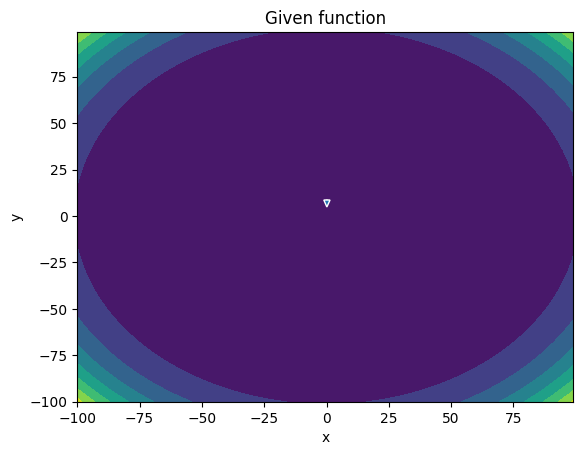

-------
Initial Coordinates:
[[0.16032297]
 [8.60483334]]
Final Coordinates:
[[0.16537925]
 [8.52251486]]
Gradient:
[[-2.80499747e+02]
 [ 1.54410487e+06]]


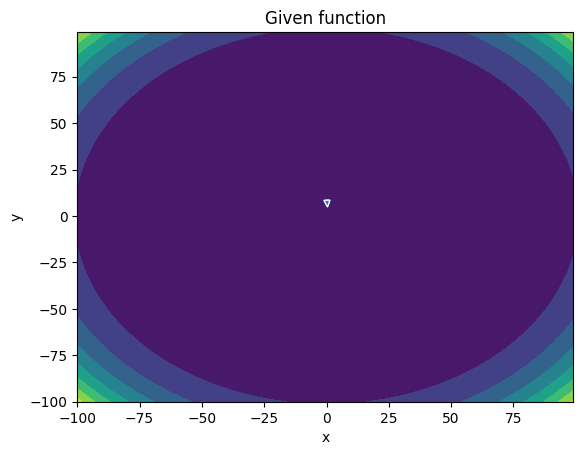

-------
Initial Coordinates:
[[0.16537925]
 [8.52251486]]
Final Coordinates:
[[0.16302479]
 [8.44048734]]
Gradient:
[[3.45739767e+02]
 [1.47118979e+06]]


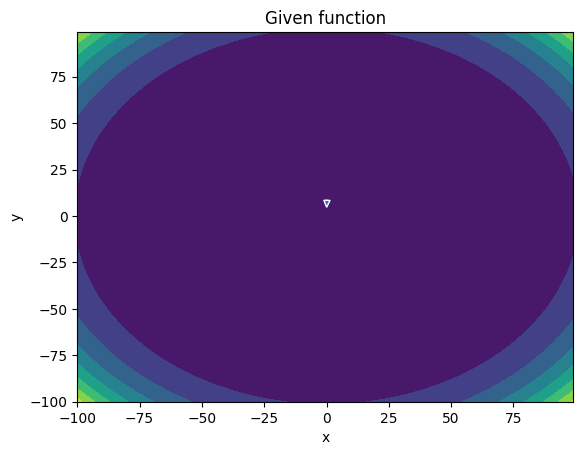

-------
Initial Coordinates:
[[0.16302479]
 [8.44048734]]
Final Coordinates:
[[0.16784865]
 [8.35875603]]
Gradient:
[[-3.34952175e+02]
 [ 1.40119912e+06]]


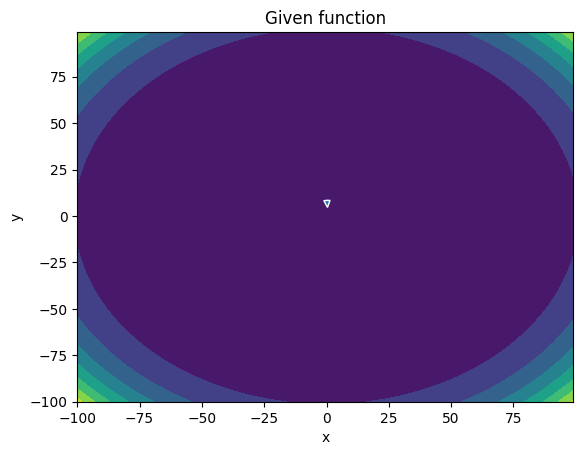

-------
Initial Coordinates:
[[0.16784865]
 [8.35875603]]
Final Coordinates:
[[0.16798149]
 [8.27732605]]
Gradient:
[[2.01592135e+02]
 [1.33422205e+06]]


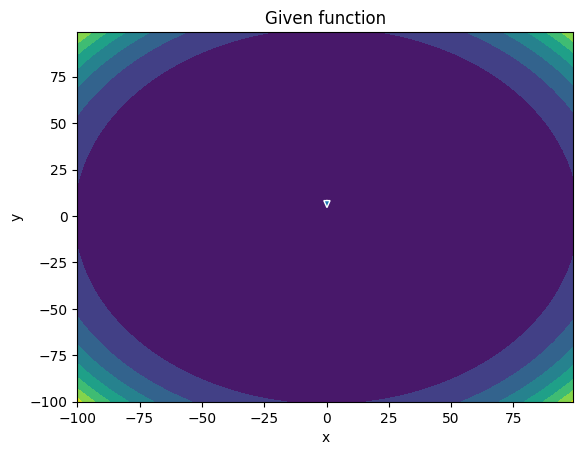

-------
Initial Coordinates:
[[0.16798149]
 [8.27732605]]
Final Coordinates:
[[0.1690669 ]
 [8.19620272]]
Gradient:
[[-4.17312386e+01]
 [ 1.27000226e+06]]


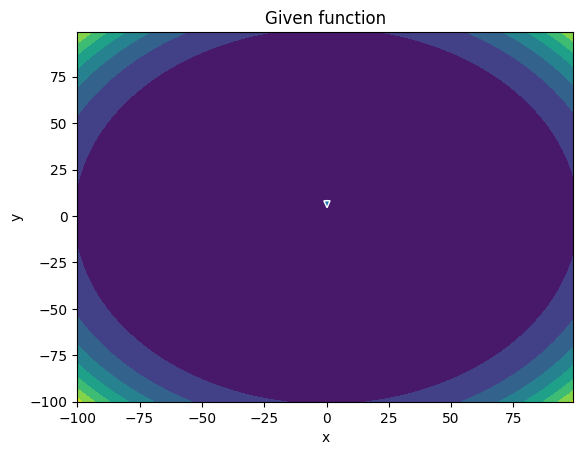

-------
Initial Coordinates:
[[0.1690669 ]
 [8.19620272]]
Final Coordinates:
[[0.17315494]
 [8.11539139]]
Gradient:
[[-1.26994069e+02]
 [ 1.20851433e+06]]


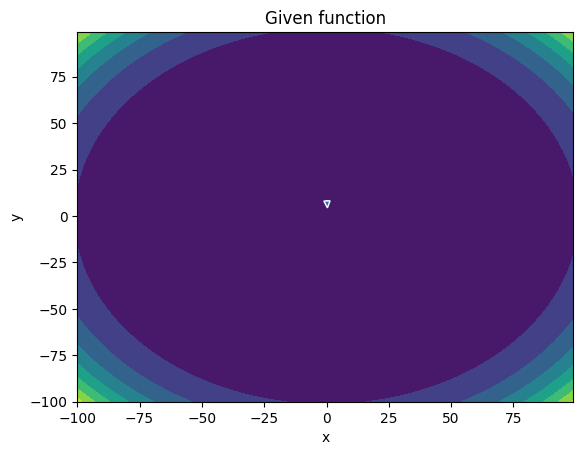

-------
Initial Coordinates:
[[0.17315494]
 [8.11539139]]
Final Coordinates:
[[0.17132849]
 [8.03489737]]
Gradient:
[[2.25542262e+02]
 [1.14968622e+06]]


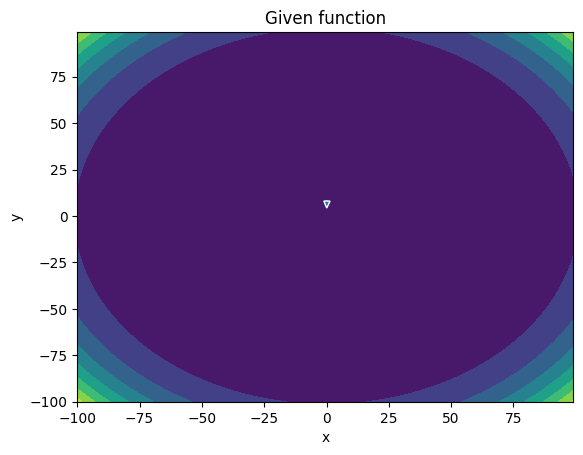

-------
Initial Coordinates:
[[0.17132849]
 [8.03489737]]
Final Coordinates:
[[0.17673956]
 [7.95472622]]
Gradient:
[[-2.76275371e+02]
 [ 1.09331631e+06]]


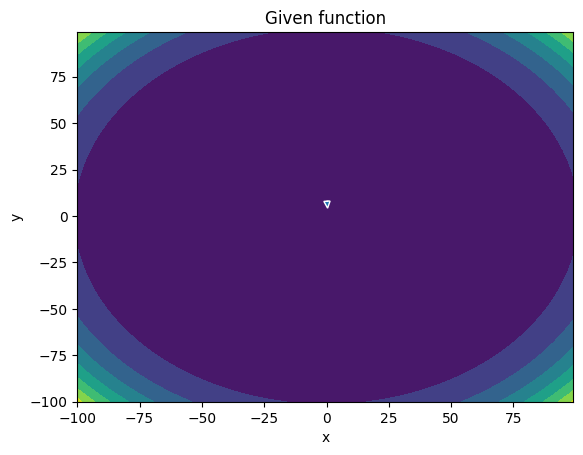

-------
Initial Coordinates:
[[0.17673956]
 [7.95472622]]
Final Coordinates:
[[0.17579113]
 [7.8748833 ]]
Gradient:
[[2.25171152e+02]
 [1.03947073e+06]]


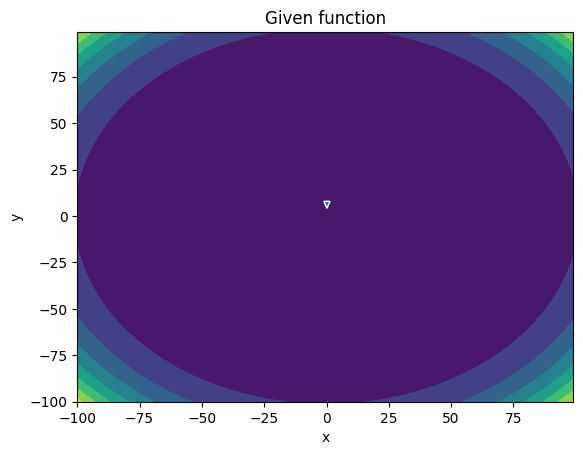

-------
Initial Coordinates:
[[0.17579113]
 [7.8748833 ]]
Final Coordinates:
[[0.17860117]
 [7.79537426]]
Gradient:
[[-1.33018020e+02]
 [ 9.87900932e+05]]


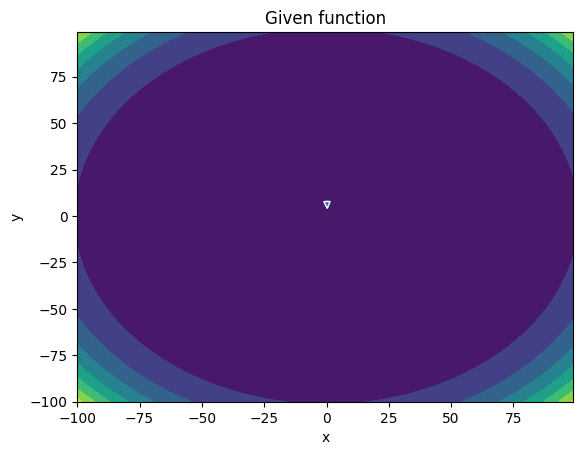

-------
Initial Coordinates:
[[0.17860117]
 [7.79537426]]
Final Coordinates:
[[0.18135571]
 [7.71620464]]
Gradient:
[[-3.02257095e+00]
 [ 9.38638311e+05]]


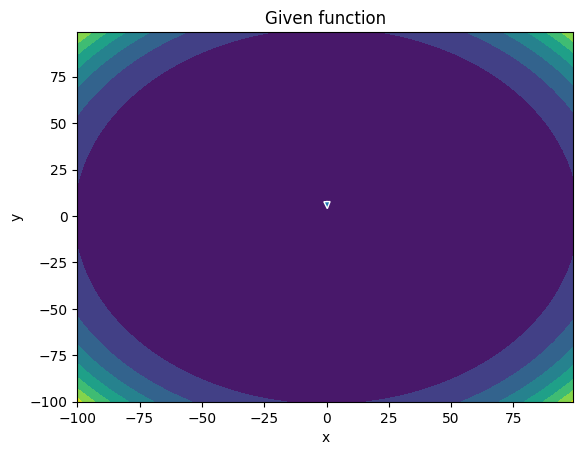

-------
Initial Coordinates:
[[0.18135571]
 [7.71620464]]
Final Coordinates:
[[0.18066744]
 [7.63738005]]
Gradient:
[[1.06838493e+02]
 [8.91554912e+05]]


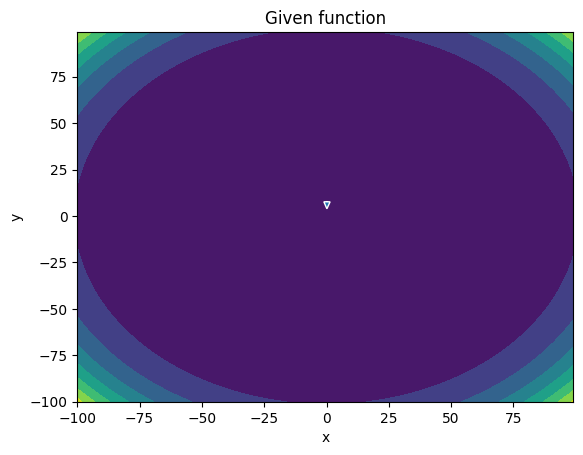

-------
Initial Coordinates:
[[0.18066744]
 [7.63738005]]
Final Coordinates:
[[0.18597801]
 [7.55890627]]
Gradient:
[[-1.8685019e+02]
 [ 8.4653317e+05]]


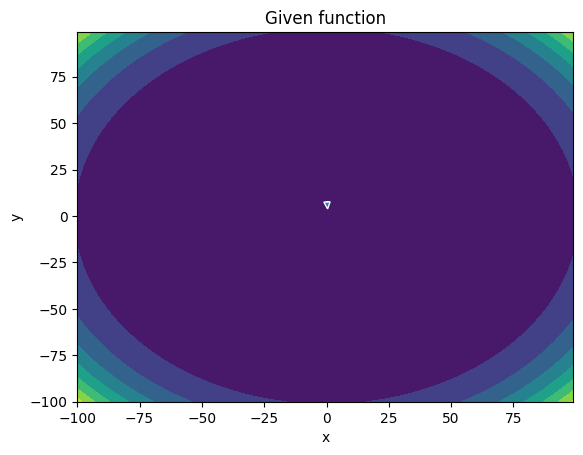

-------
Initial Coordinates:
[[0.18597801]
 [7.55890627]]
Final Coordinates:
[[0.1845279 ]
 [7.48078887]]
Gradient:
[[1.94142212e+02]
 [8.03595372e+05]]


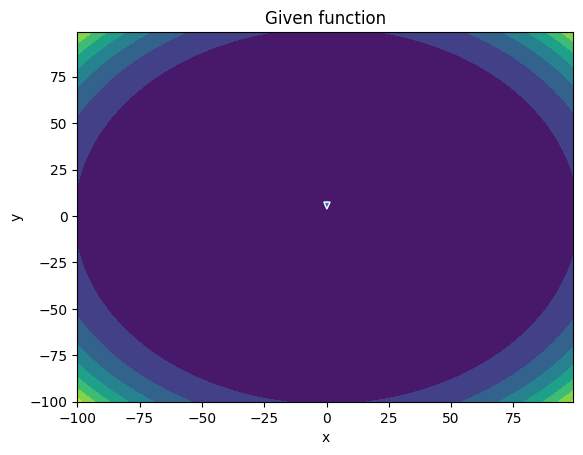

-------
Initial Coordinates:
[[0.1845279 ]
 [7.48078887]]
Final Coordinates:
[[0.18884384]
 [7.40303375]]
Gradient:
[[-1.66244487e+02]
 [ 7.62529827e+05]]


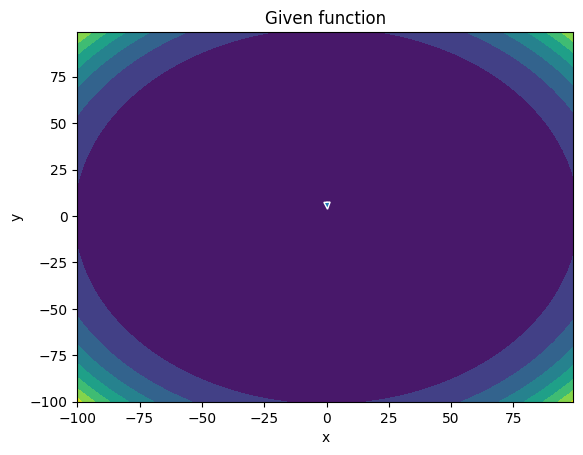

-------
Initial Coordinates:
[[0.18884384]
 [7.40303375]]
Final Coordinates:
[[0.19012311]
 [7.32564658]]
Gradient:
[[7.81743651e+01]
 [7.23392459e+05]]


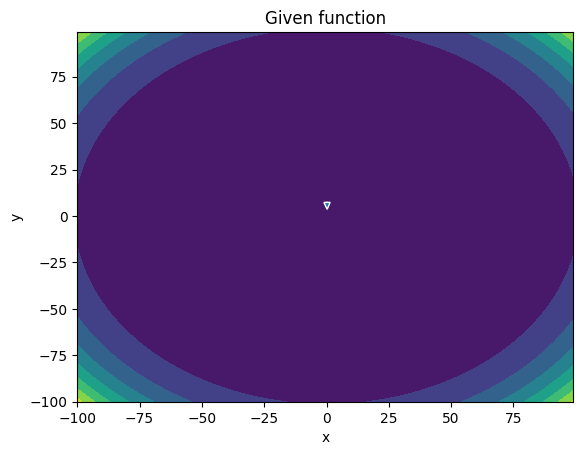

-------
Initial Coordinates:
[[0.19012311]
 [7.32564658]]
Final Coordinates:
[[0.19105479]
 [7.24863322]]
Gradient:
[[7.46911928e+00]
 [6.86020742e+05]]


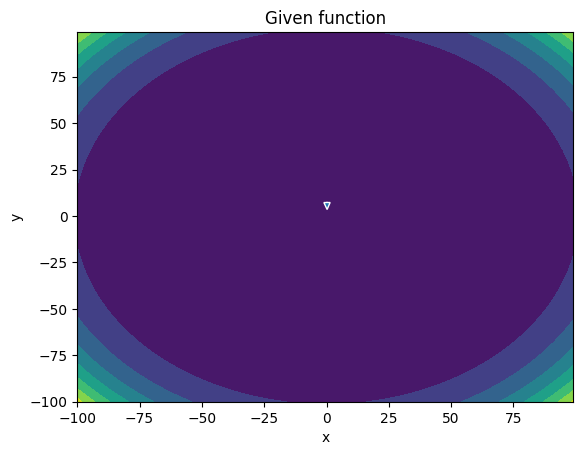

-------
Initial Coordinates:
[[0.19105479]
 [7.24863322]]
Final Coordinates:
[[0.19559141]
 [7.17199955]]
Gradient:
[[-9.25879964e+01]
 [ 6.50372441e+05]]


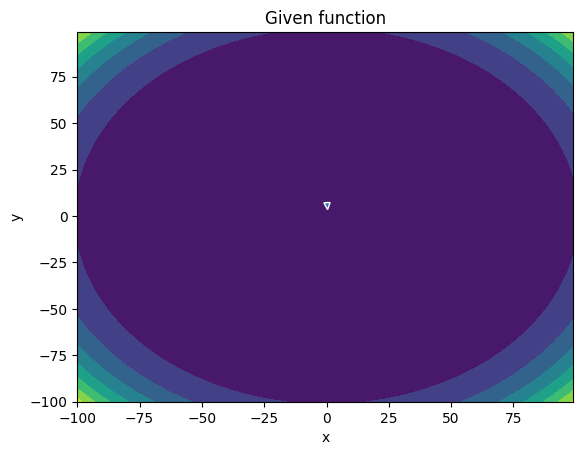

-------
Initial Coordinates:
[[0.19559141]
 [7.17199955]]
Final Coordinates:
[[0.19442795]
 [7.09575131]]
Gradient:
[[1.31673806e+02]
 [6.16417051e+05]]


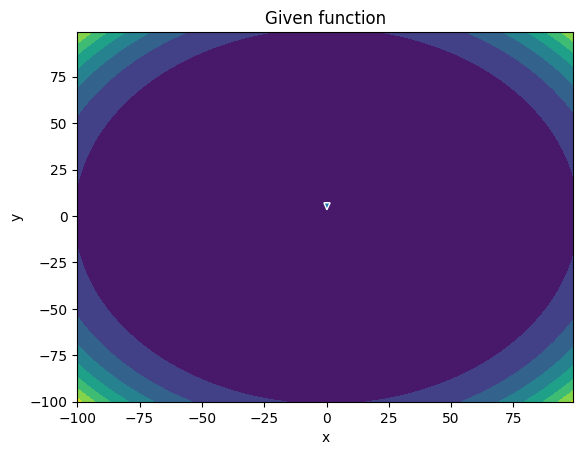

-------
Initial Coordinates:
[[0.19442795]
 [7.09575131]]
Final Coordinates:
[[0.19964726]
 [7.01989454]]
Gradient:
[[-1.48631184e+02]
 [ 5.84000628e+05]]


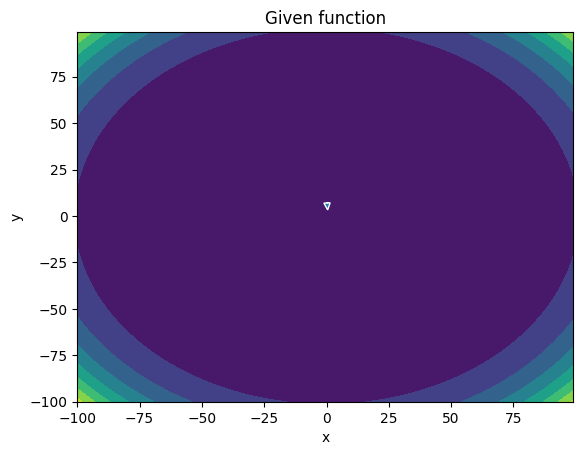

-------
Initial Coordinates:
[[0.19964726]
 [7.01989454]]
Final Coordinates:
[[0.19968381]
 [6.94443496]]
Gradient:
[[1.09977570e+02]
 [5.53171839e+05]]


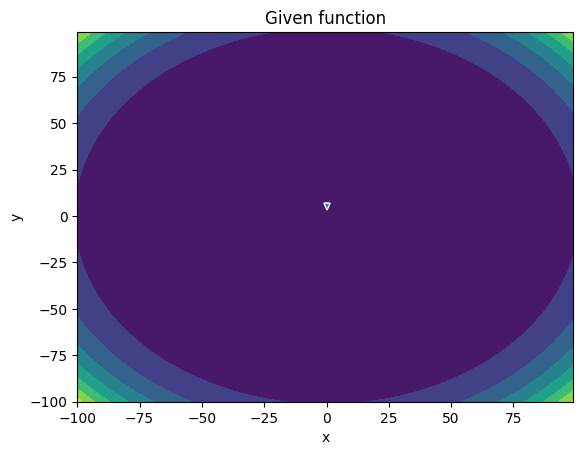

-------
Initial Coordinates:
[[0.19968381]
 [6.94443496]]
Final Coordinates:
[[0.2024441 ]
 [6.86937859]]
Gradient:
[[-5.87807548e+01]
 [ 5.23762974e+05]]


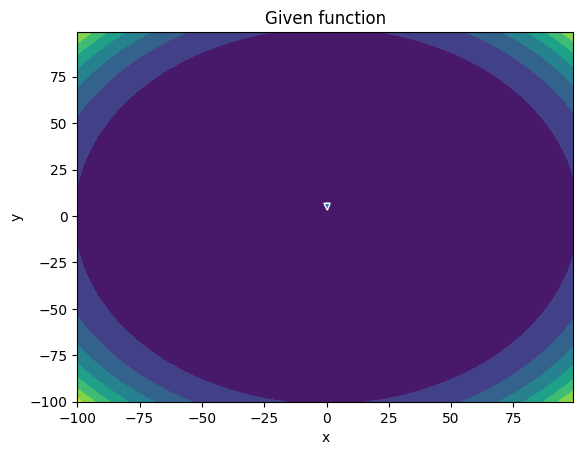

-------
Initial Coordinates:
[[0.2024441 ]
 [6.86937859]]
Final Coordinates:
[[0.20570429]
 [6.79473129]]
Gradient:
[[-1.31385911e+01]
 [ 4.95785543e+05]]


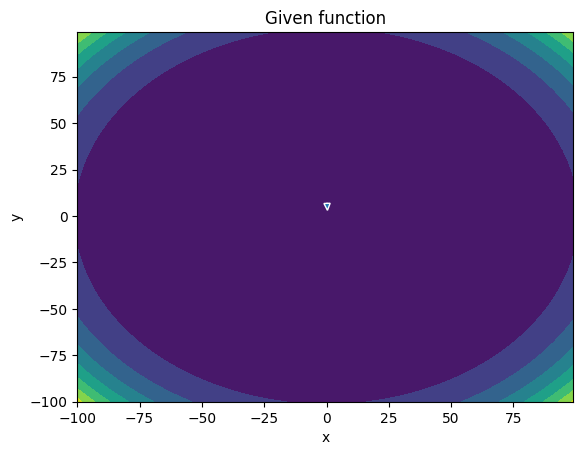

-------
Initial Coordinates:
[[0.20570429]
 [6.79473129]]
Final Coordinates:
[[0.20561086]
 [6.7204989 ]]
Gradient:
[[6.18634445e+01]
 [4.69161267e+05]]


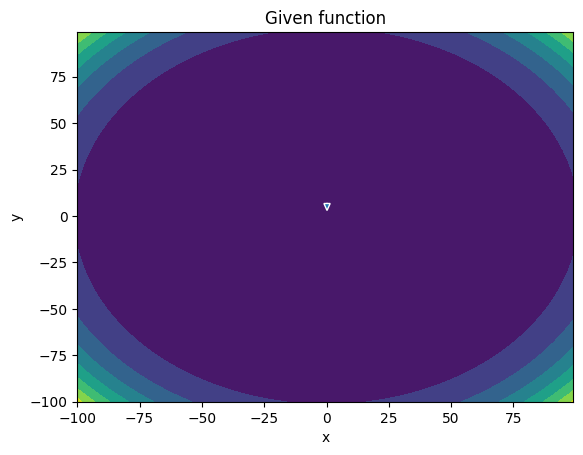

-------
Initial Coordinates:
[[0.20561086]
 [6.7204989 ]]
Final Coordinates:
[[0.21089703]
 [6.64668745]]
Gradient:
[[-1.00929475e+02]
 [ 4.43801969e+05]]


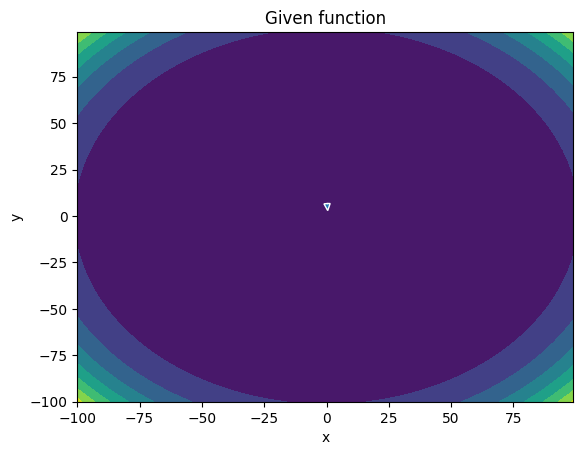

-------
Initial Coordinates:
[[0.21089703]
 [6.64668745]]
Final Coordinates:
[[0.21035204]
 [6.57330264]]
Gradient:
[[9.92205507e+01]
 [4.19725845e+05]]


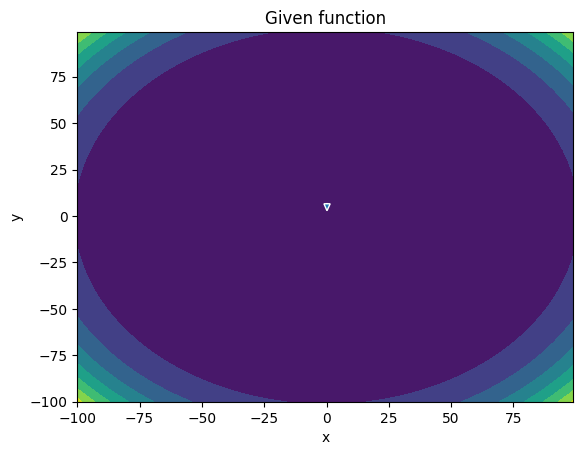

-------
Initial Coordinates:
[[0.21035204]
 [6.57330264]]
Final Coordinates:
[[0.21470683]
 [6.5003505 ]]
Gradient:
[[-8.45235568e+01]
 [ 3.96789015e+05]]


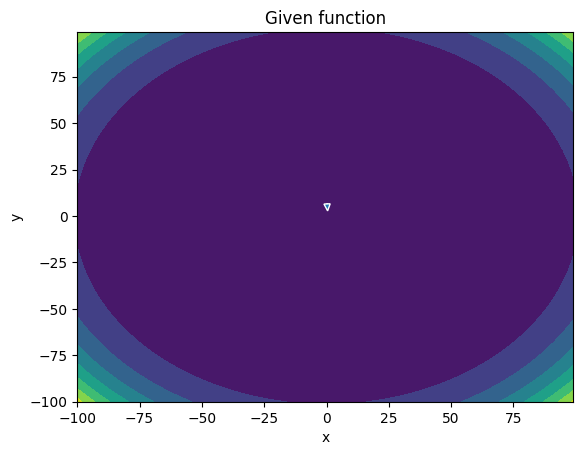

-------
Initial Coordinates:
[[0.21470683]
 [6.5003505 ]]
Final Coordinates:
[[0.21651625]
 [6.42783674]]
Gradient:
[[3.81850126e+01]
 [3.75026862e+05]]


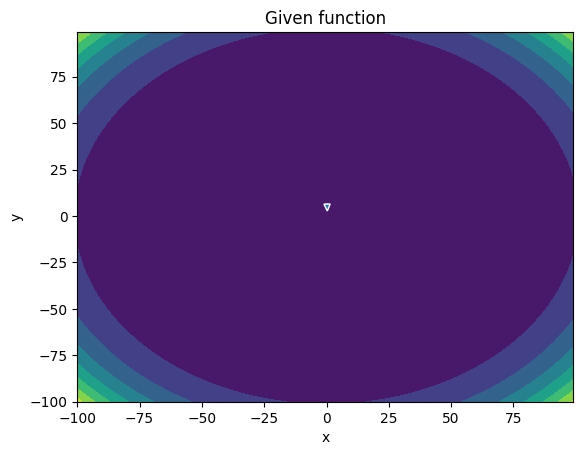

-------
Initial Coordinates:
[[0.21651625]
 [6.42783674]]
Final Coordinates:
[[0.21806479]
 [6.35576722]]
Gradient:
[[2.63368614e+00]
 [3.54331736e+05]]


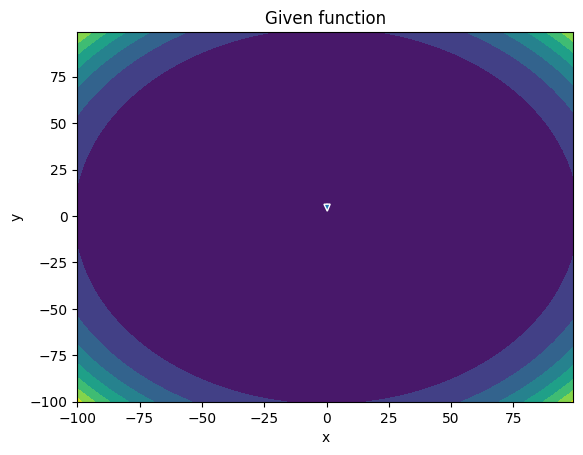

-------
Initial Coordinates:
[[0.21806479]
 [6.35576722]]
Final Coordinates:
[[0.22262249]
 [6.28414775]]
Gradient:
[[-4.62611769e+01]
 [ 3.34674611e+05]]


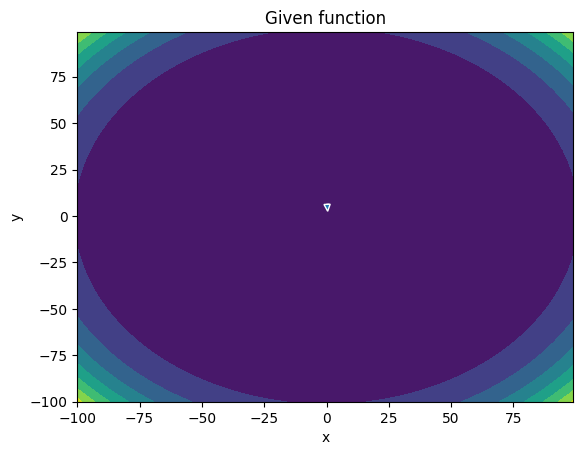

-------
Initial Coordinates:
[[0.22262249]
 [6.28414775]]
Final Coordinates:
[[0.22241054]
 [6.21298395]]
Gradient:
[[6.43337286e+01]
 [3.16033616e+05]]


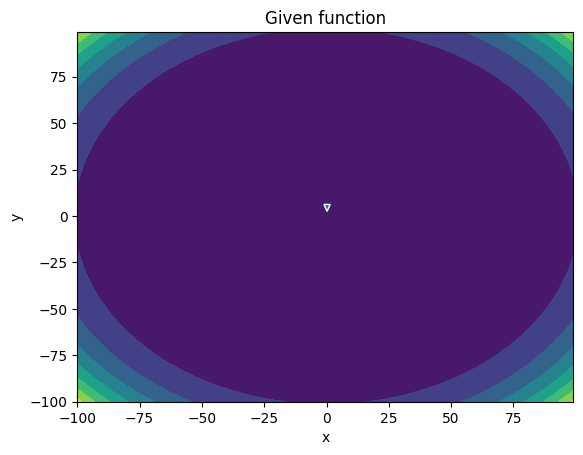

-------
Initial Coordinates:
[[0.22241054]
 [6.21298395]]
Final Coordinates:
[[0.22764758]
 [6.14228166]]
Gradient:
[[-7.49632632e+01]
 [ 2.98308507e+05]]


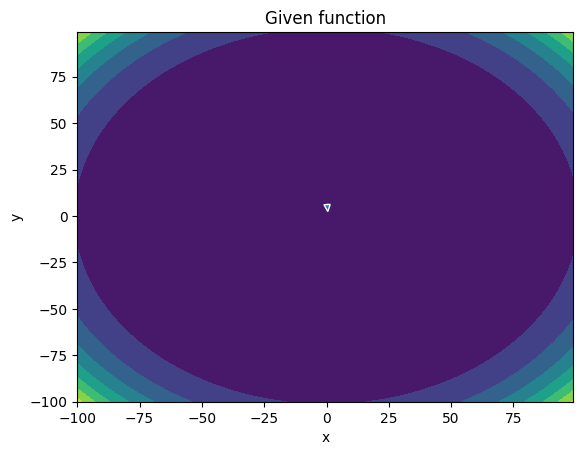

-------
Initial Coordinates:
[[0.22764758]
 [6.14228166]]
Final Coordinates:
[[0.22832452]
 [6.07204634]]
Gradient:
[[5.60696431e+01]
 [2.81529558e+05]]


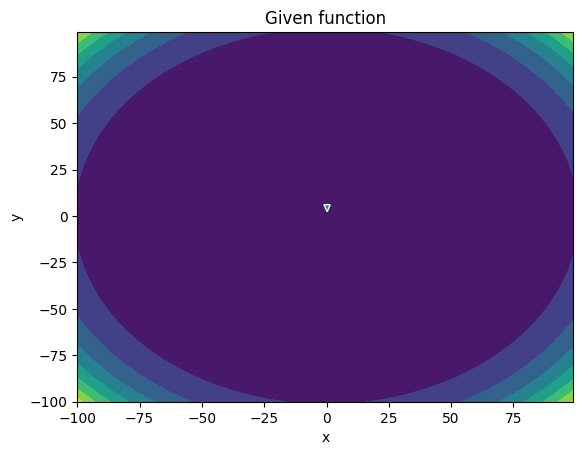

-------
Initial Coordinates:
[[0.22832452]
 [6.07204634]]
Final Coordinates:
[[0.23168378]
 [6.0022837 ]]
Gradient:
[[-3.41919048e+01]
 [ 2.65586042e+05]]


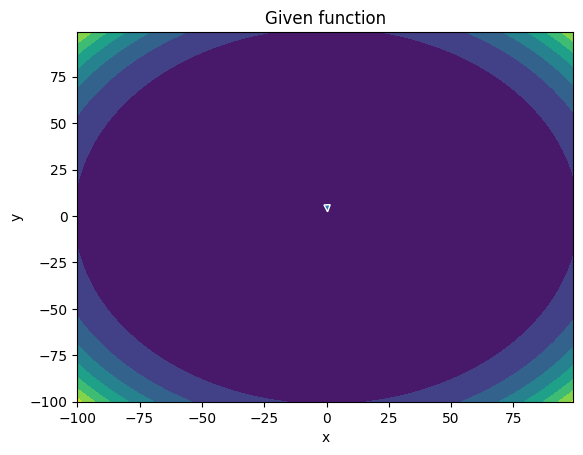

-------
Initial Coordinates:
[[0.23168378]
 [6.0022837 ]]
Final Coordinates:
[[0.23499704]
 [5.93299918]]
Gradient:
[[-1.50798031e+00]
 [ 2.50488341e+05]]


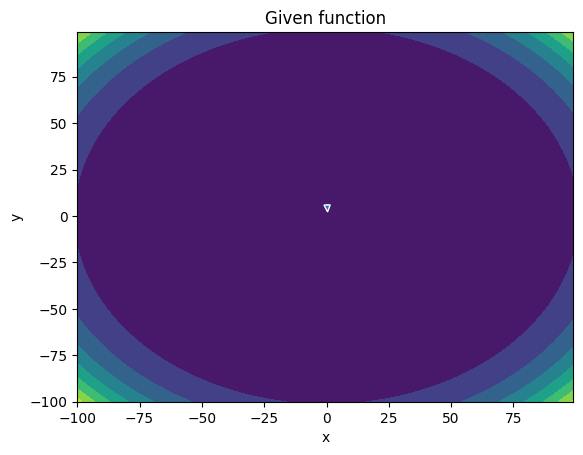

-------
Initial Coordinates:
[[0.23499704]
 [5.93299918]]
Final Coordinates:
[[0.23596105]
 [5.86419816]]
Gradient:
[[2.46343246e+01]
 [2.36179837e+05]]


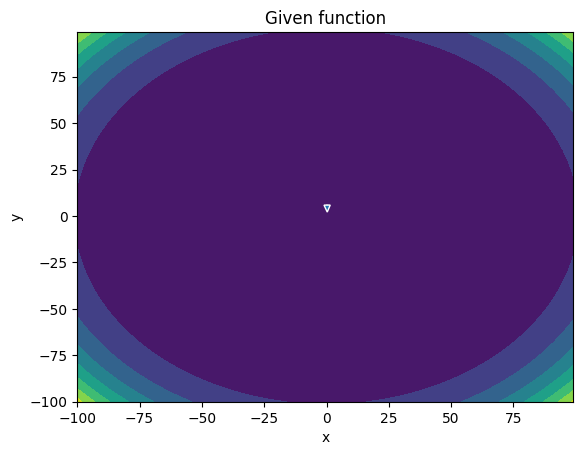

-------
Initial Coordinates:
[[0.23596105]
 [5.86419816]]
Final Coordinates:
[[0.24115161]
 [5.79588613]]
Gradient:
[[-4.65328768e+01]
 [ 2.22609671e+05]]


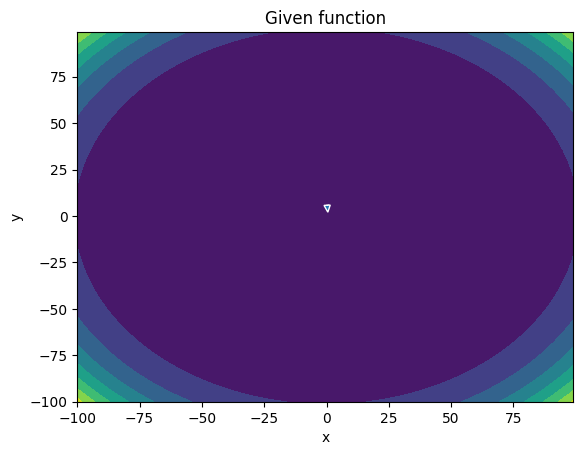

-------
Initial Coordinates:
[[0.24115161]
 [5.79588613]]
Final Coordinates:
[[0.24149153]
 [5.72806816]]
Gradient:
[[4.71975979e+01]
 [2.09783999e+05]]


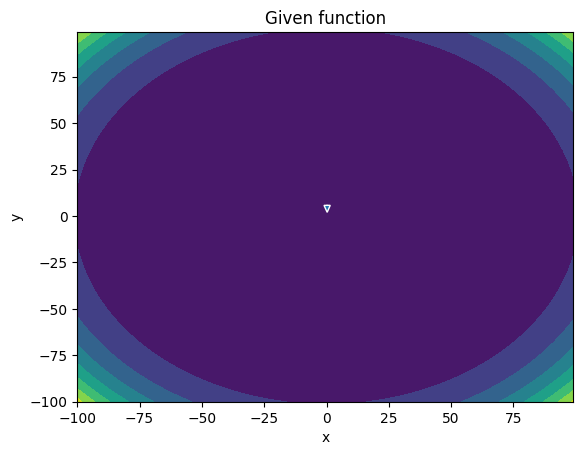

-------
Initial Coordinates:
[[0.24149153]
 [5.72806816]]
Final Coordinates:
[[0.24627099]
 [5.66074961]]
Gradient:
[[-4.44974535e+01]
 [ 1.97613074e+05]]


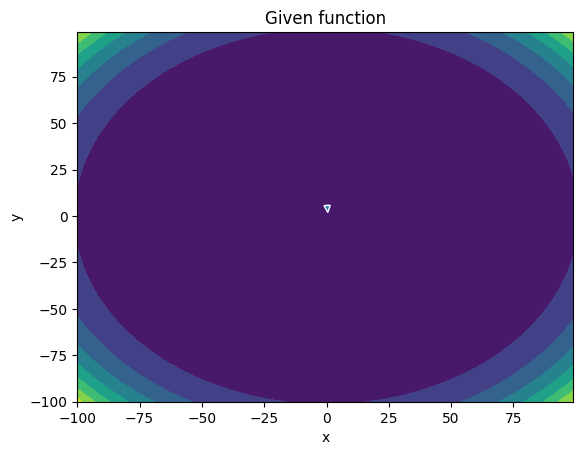

-------
Initial Coordinates:
[[0.24627099]
 [5.66074961]]
Final Coordinates:
[[0.24829195]
 [5.59393539]]
Gradient:
[[2.37267068e+01]
 [1.86120688e+05]]


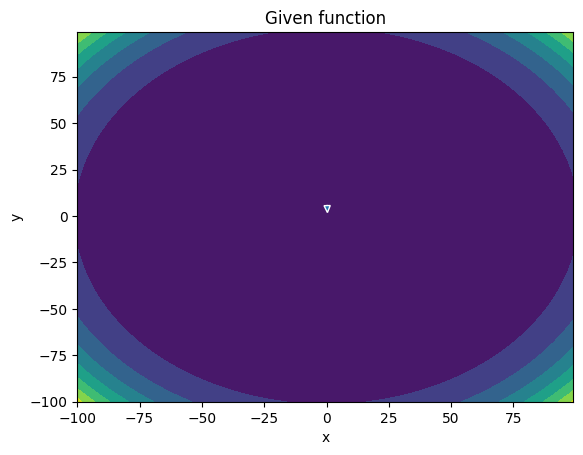

-------
Initial Coordinates:
[[0.24829195]
 [5.59393539]]
Final Coordinates:
[[0.25092967]
 [5.52763053]]
Gradient:
[[-6.49539960e+00]
 [ 1.75232913e+05]]


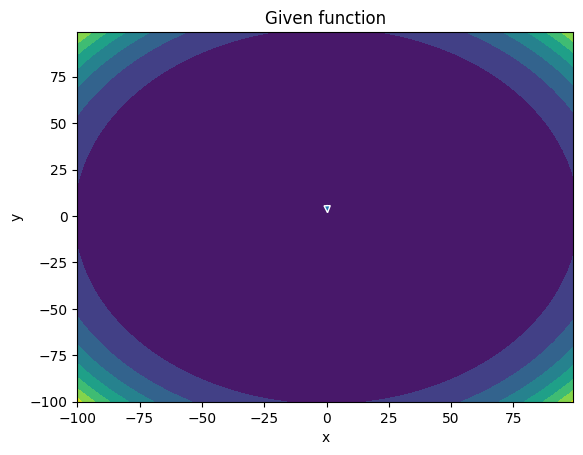

-------
Initial Coordinates:
[[0.25092967]
 [5.52763053]]
Final Coordinates:
[[0.25530234]
 [5.4618399 ]]
Gradient:
[[-1.60516826e+01]
 [ 1.64939728e+05]]


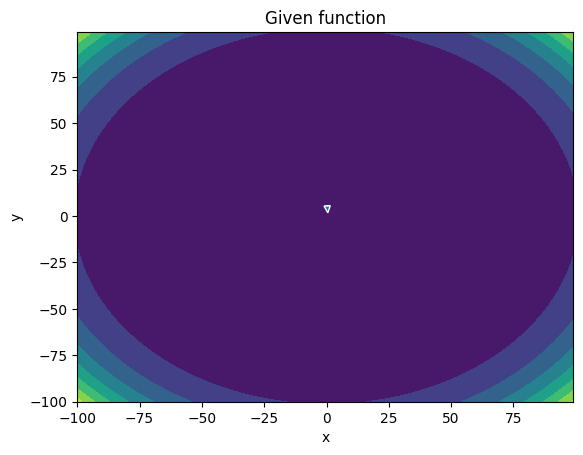

-------
Initial Coordinates:
[[0.25530234]
 [5.4618399 ]]
Final Coordinates:
[[0.25626358]
 [5.39656809]]
Gradient:
[[2.58481370e+01]
 [1.55218229e+05]]


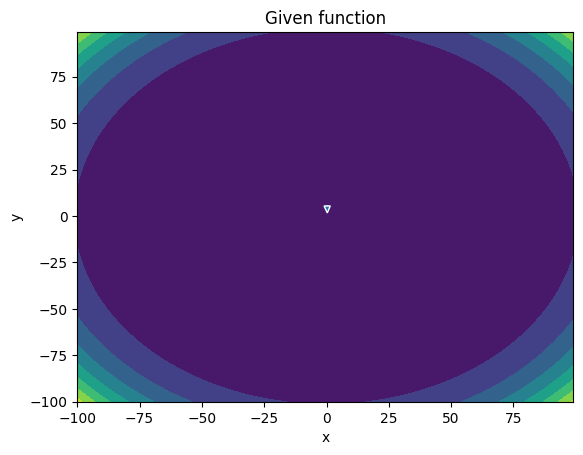

-------
Initial Coordinates:
[[0.25626358]
 [5.39656809]]
Final Coordinates:
[[0.26161719]
 [5.33181989]]
Gradient:
[[-3.48171357e+01]
 [ 1.46013016e+05]]


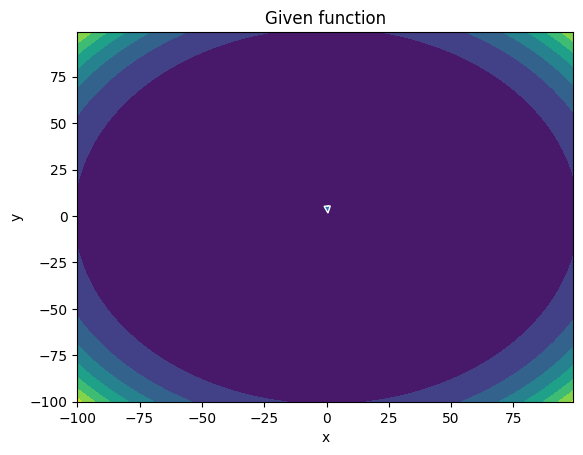

-------
Initial Coordinates:
[[0.26161719]
 [5.33181989]]
Final Coordinates:
[[0.26286663]
 [5.26759955]]
Gradient:
[[2.83519356e+01]
 [1.37339230e+05]]


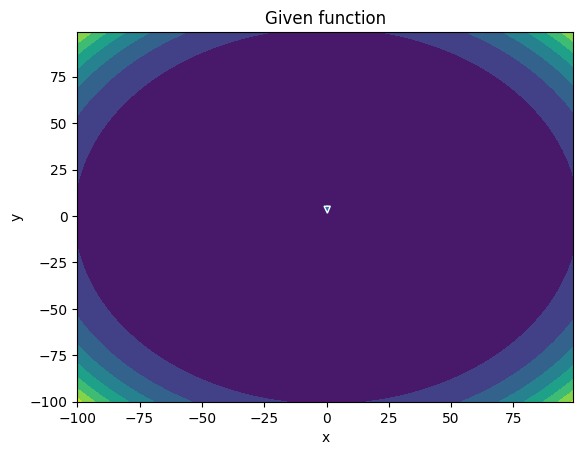

-------
Initial Coordinates:
[[0.26286663]
 [5.26759955]]
Final Coordinates:
[[0.26713308]
 [5.20391155]]
Gradient:
[[-2.19954767e+01]
 [ 1.29127197e+05]]


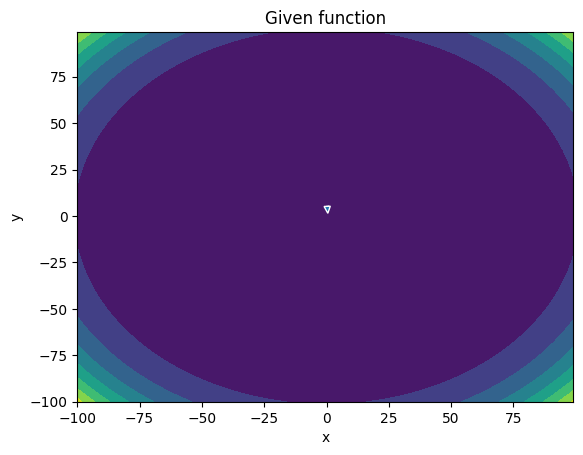

-------
Initial Coordinates:
[[0.26713308]
 [5.20391155]]
Final Coordinates:
[[0.27033617]
 [5.14075997]]
Gradient:
[[5.70057719e+00]
 [1.21389145e+05]]


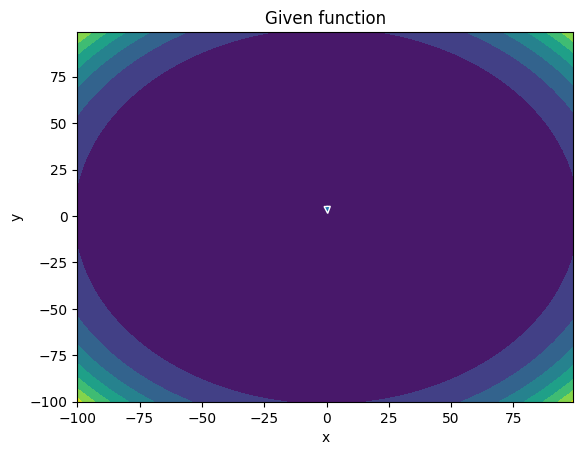

-------
Initial Coordinates:
[[0.27033617]
 [5.14075997]]
Final Coordinates:
[[0.27264969]
 [5.0781488 ]]
Gradient:
[[4.64851267e+00]
 [1.14081265e+05]]


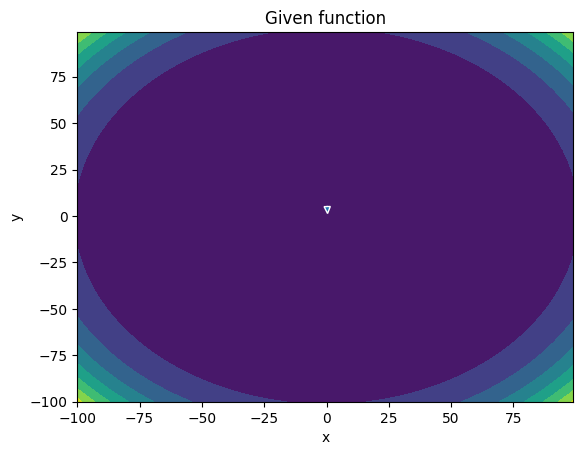

-------
Initial Coordinates:
[[0.27264969]
 [5.0781488 ]]
Final Coordinates:
[[0.2776787]
 [5.016082 ]]
Gradient:
[[-1.73786368e+01]
 [ 1.07182561e+05]]


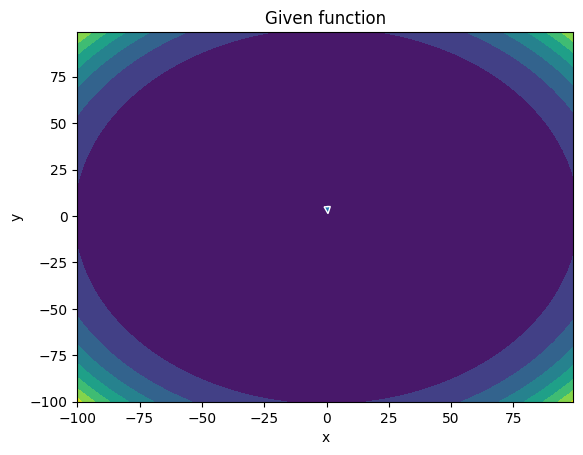

-------
Initial Coordinates:
[[0.2776787]
 [5.016082 ]]
Final Coordinates:
[[0.27905288]
 [4.95456308]]
Gradient:
[[1.96517993e+01]
 [1.00688494e+05]]


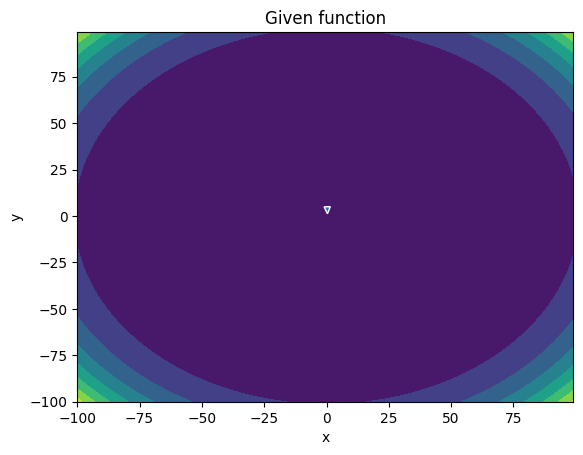

-------
Initial Coordinates:
[[0.27905288]
 [4.95456308]]
Final Coordinates:
[[0.28432965]
 [4.89359576]]
Gradient:
[[-2.22169286e+01]
 [ 9.45496123e+04]]


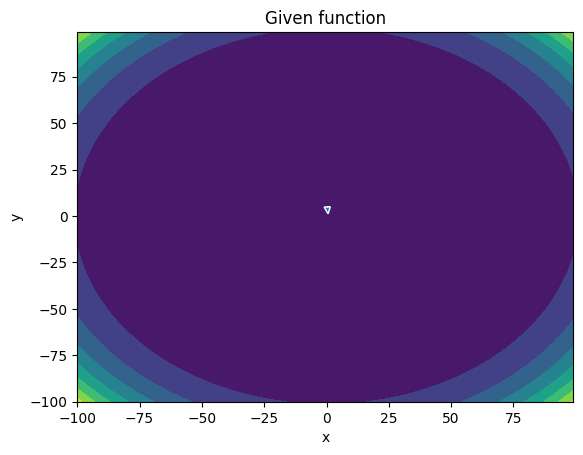

-------
Initial Coordinates:
[[0.28432965]
 [4.89359576]]
Final Coordinates:
[[0.28657935]
 [4.83318316]]
Gradient:
[[1.45387360e+01]
 [8.87804029e+04]]


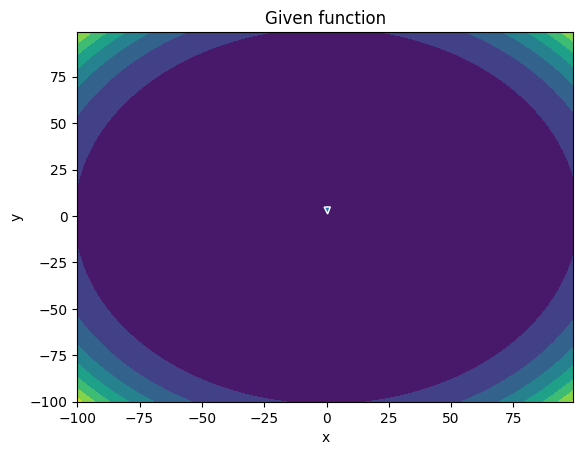

-------
Initial Coordinates:
[[0.28657935]
 [4.83318316]]
Final Coordinates:
[[0.29049003]
 [4.77332858]]
Gradient:
[[-8.98168516e+00]
 [ 8.33318909e+04]]


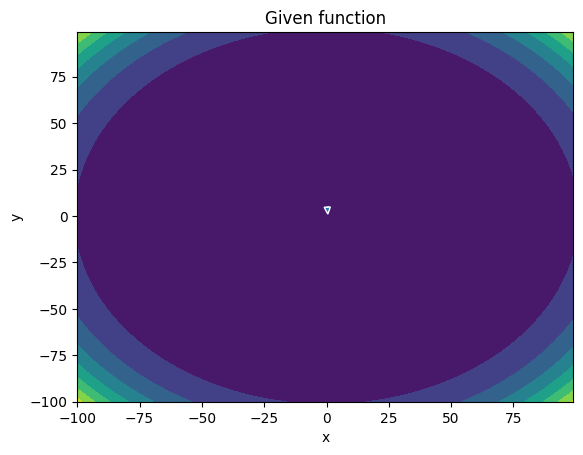

-------
Initial Coordinates:
[[0.29049003]
 [4.77332858]]
Final Coordinates:
[[0.29461533]
 [4.71403492]]
Gradient:
[[-1.99002495e+00]
 [ 7.82066258e+04]]


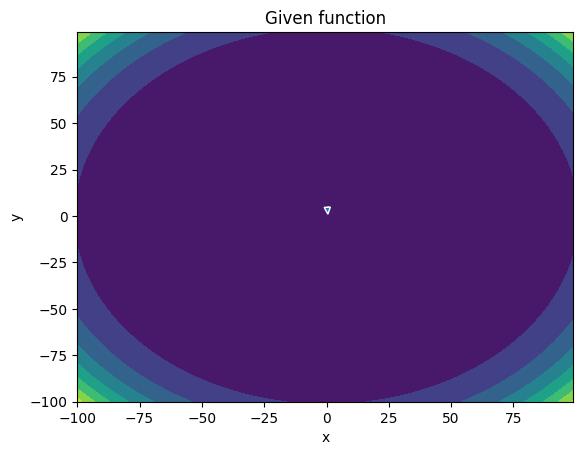

-------
Initial Coordinates:
[[0.29461533]
 [4.71403492]]
Final Coordinates:
[[0.29696695]
 [4.65530488]]
Gradient:
[[7.08186511e+00]
 [7.33814379e+04]]


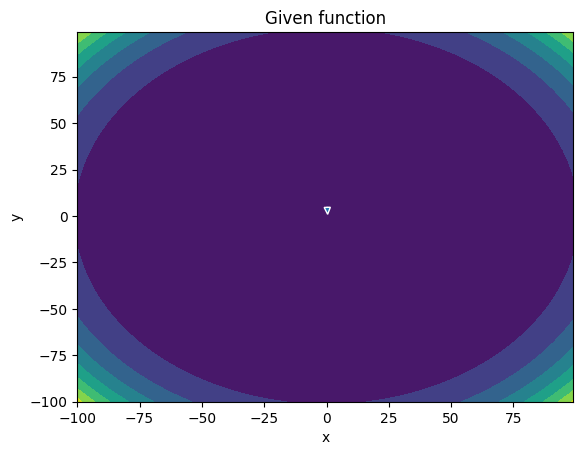

-------
Initial Coordinates:
[[0.29696695]
 [4.65530488]]
Final Coordinates:
[[0.30236588]
 [4.59714118]]
Gradient:
[[-1.37863998e+01]
 [ 6.88324421e+04]]


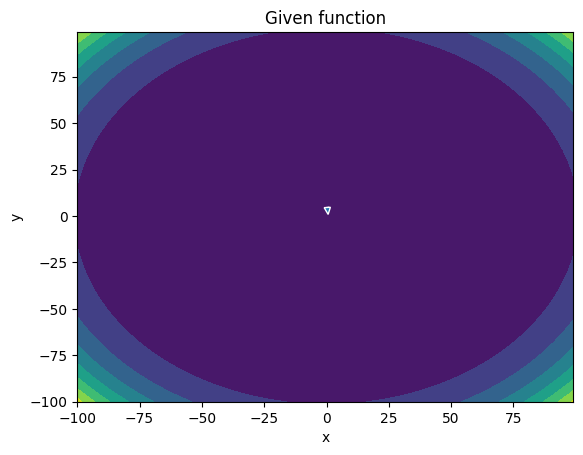

-------
Initial Coordinates:
[[0.30236588]
 [4.59714118]]
Final Coordinates:
[[0.30438085]
 [4.53954596]]
Gradient:
[[1.27414273e+01]
 [6.45631524e+04]]


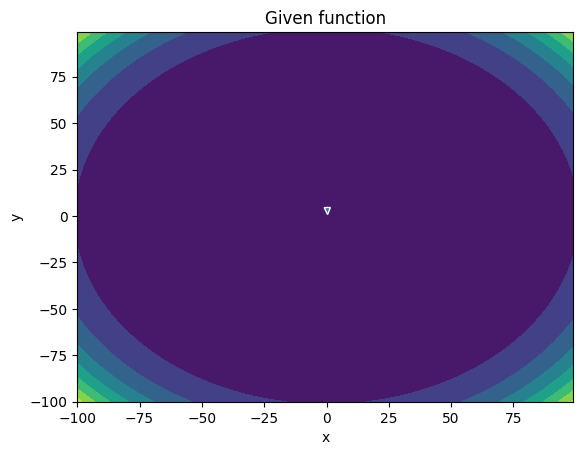

-------
Initial Coordinates:
[[0.30438085]
 [4.53954596]]
Final Coordinates:
[[0.30953692]
 [4.4825216 ]]
Gradient:
[[-1.28307828e+01]
 [ 6.05342921e+04]]


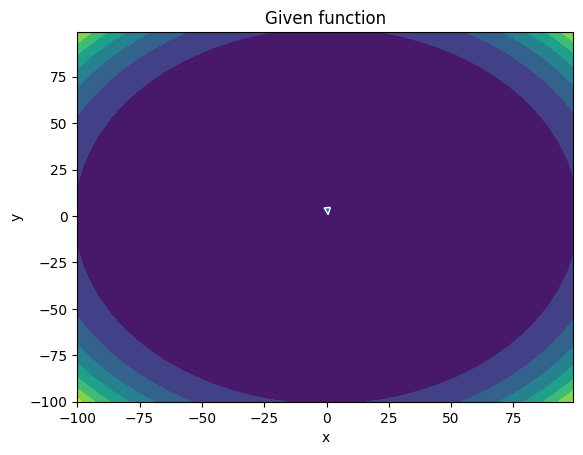

-------
Initial Coordinates:
[[0.30953692]
 [4.4825216 ]]
Final Coordinates:
[[0.31270228]
 [4.42606986]]
Gradient:
[[6.43808153e+00]
 [5.67564572e+04]]


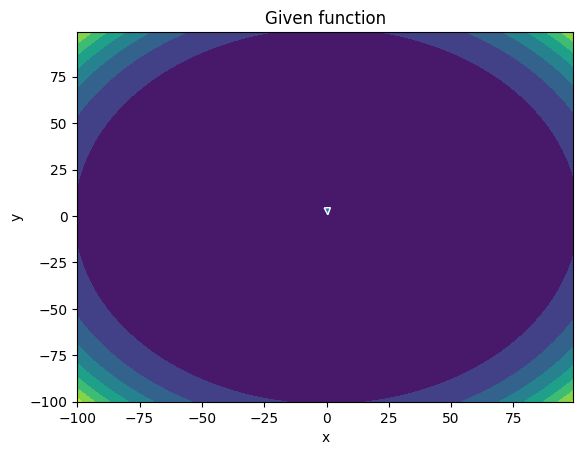

-------
Initial Coordinates:
[[0.31270228]
 [4.42606986]]
Final Coordinates:
[[0.31649804]
 [4.37019255]]
Gradient:
[[-2.82143720e+00]
 [ 5.31975331e+04]]


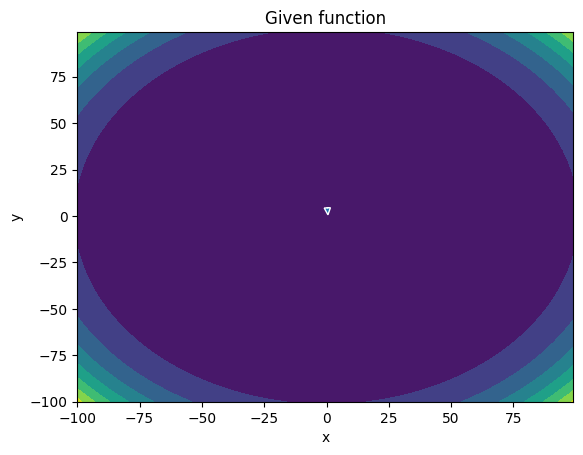

-------
Initial Coordinates:
[[0.31649804]
 [4.37019255]]
Final Coordinates:
[[0.32128796]
 [4.31489119]]
Gradient:
[[-4.02072960e+00]
 [ 4.98544604e+04]]


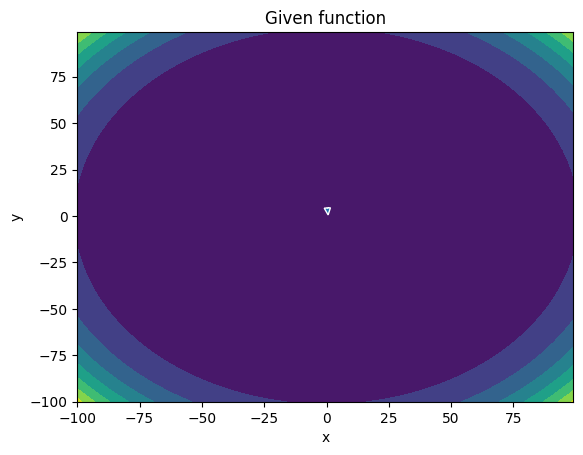

-------
Initial Coordinates:
[[0.32128796]
 [4.31489119]]
Final Coordinates:
[[0.32394333]
 [4.26016694]]
Gradient:
[[6.03137040e+00]
 [4.67163251e+04]]


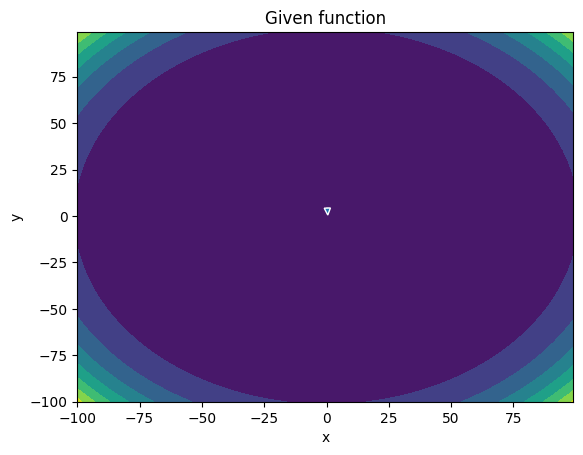

-------
Initial Coordinates:
[[0.32394333]
 [4.26016694]]
Final Coordinates:
[[0.32955574]
 [4.20602107]]
Gradient:
[[-9.49403734e+00]
 [ 4.37613713e+04]]


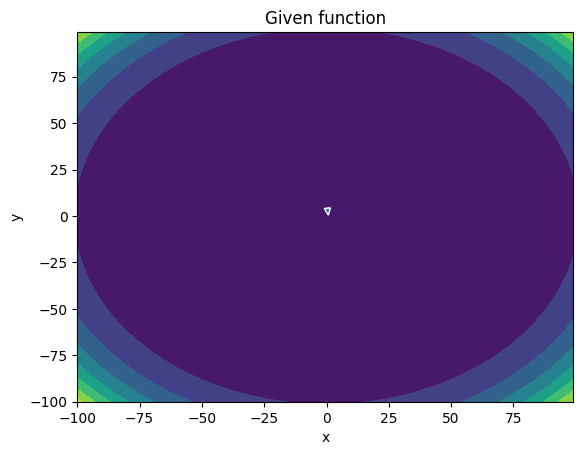

-------
Initial Coordinates:
[[0.32955574]
 [4.20602107]]
Final Coordinates:
[[0.33226713]
 [4.15245418]]
Gradient:
[[7.55184499e+00]
 [4.09954324e+04]]


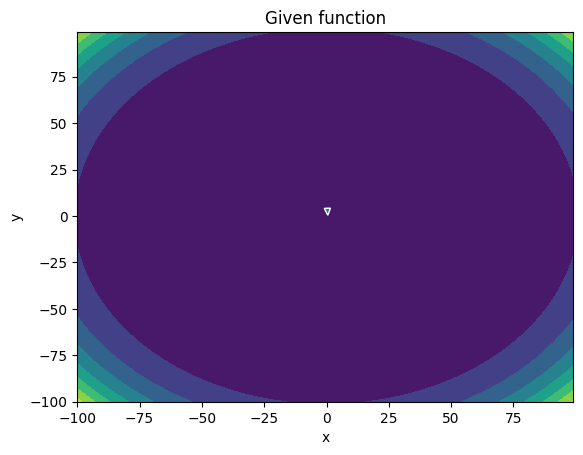

-------
Initial Coordinates:
[[0.33226713]
 [4.15245418]]
Final Coordinates:
[[0.33739906]
 [4.09946709]]
Gradient:
[[-7.11366039e+00]
 [ 3.83895304e+04]]


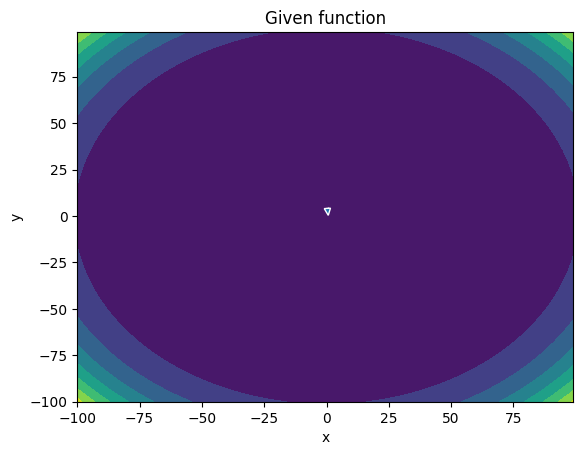

-------
Initial Coordinates:
[[0.33739906]
 [4.09946709]]
Final Coordinates:
[[0.34129306]
 [4.04706004]]
Gradient:
[[2.55609796e+00]
 [3.59505897e+04]]


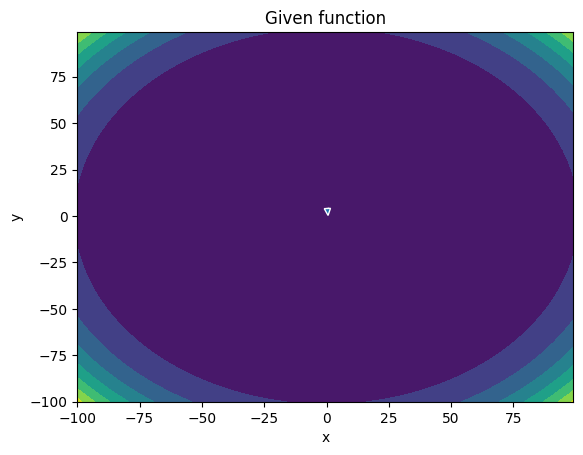

-------
Initial Coordinates:
[[0.34129306]
 [4.04706004]]
Final Coordinates:
[[0.3452244 ]
 [3.99523322]]
Gradient:
[[-5.91805396e-01]
 [ 3.36581684e+04]]


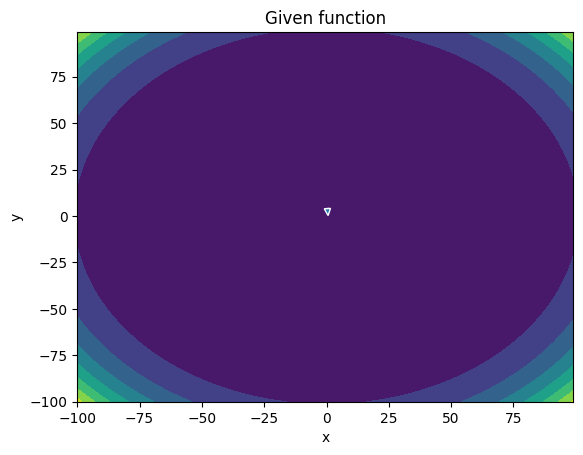

-------
Initial Coordinates:
[[0.3452244 ]
 [3.99523322]]
Final Coordinates:
[[0.35045913]
 [3.94398662]]
Gradient:
[[-3.57561468e+00]
 [ 3.15074485e+04]]


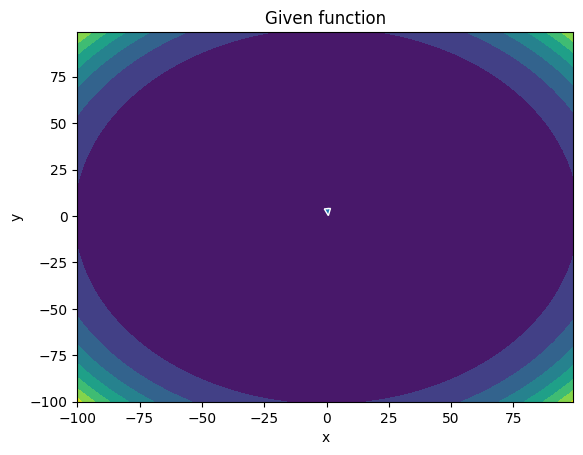

-------
Initial Coordinates:
[[0.35045913]
 [3.94398662]]
Final Coordinates:
[[0.35357104]
 [3.89331977]]
Gradient:
[[4.15504365e+00]
 [2.94936453e+04]]


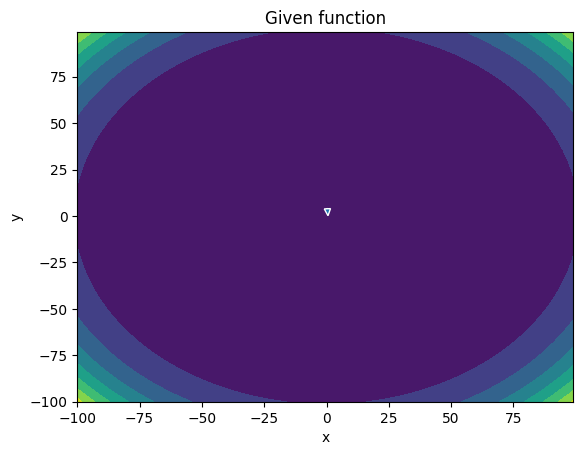

-------
Initial Coordinates:
[[0.35357104]
 [3.89331977]]
Final Coordinates:
[[0.35935814]
 [3.84323238]]
Gradient:
[[-6.10478382e+00]
 [ 2.75994440e+04]]


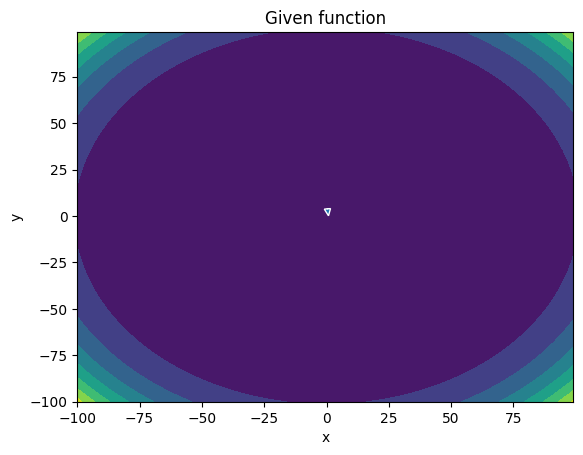

-------
Initial Coordinates:
[[0.35935814]
 [3.84323238]]
Final Coordinates:
[[0.36267604]
 [3.7937234 ]]
Gradient:
[[4.40322374e+00]
 [2.58304349e+04]]


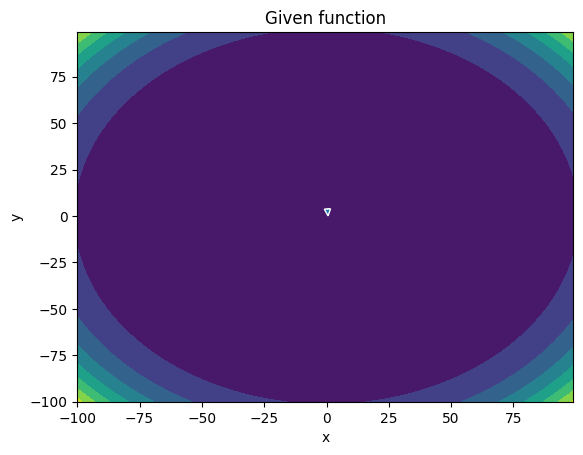

-------
Initial Coordinates:
[[0.36267604]
 [3.7937234 ]]
Final Coordinates:
[[0.36797341]
 [3.7447921 ]]
Gradient:
[[-4.18254356e+00]
 [ 2.41659642e+04]]


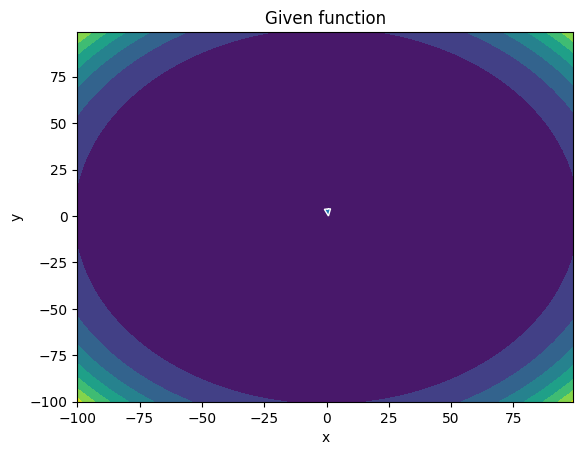

-------
Initial Coordinates:
[[0.36797341]
 [3.7447921 ]]
Final Coordinates:
[[0.37233931]
 [3.69643709]]
Gradient:
[[1.21162772e+00]
 [2.26109261e+04]]


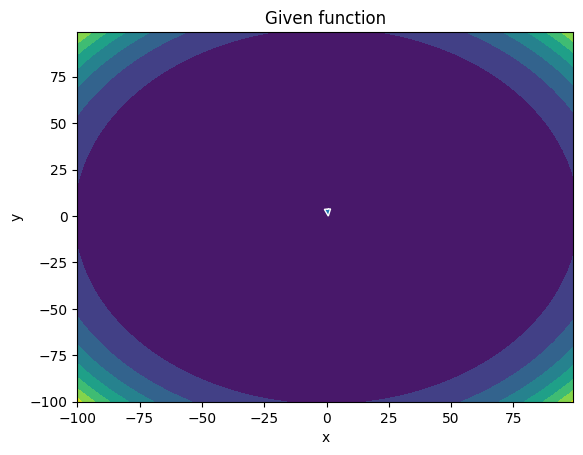

-------
Initial Coordinates:
[[0.37233931]
 [3.69643709]]
Final Coordinates:
[[0.37664594]
 [3.64865699]]
Gradient:
[[-2.87738303e-01]
 [ 2.11516523e+04]]


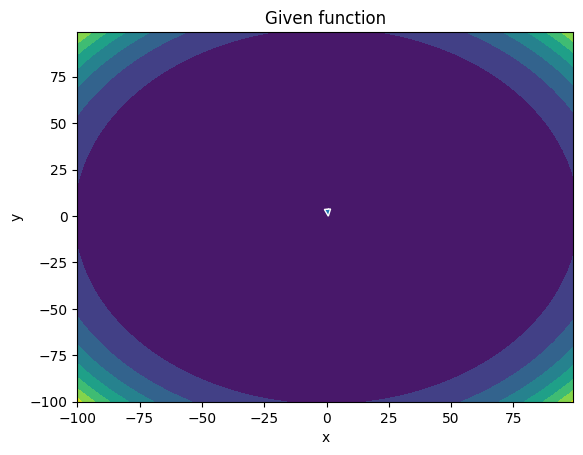

-------
Initial Coordinates:
[[0.37664594]
 [3.64865699]]
Final Coordinates:
[[0.38212885]
 [3.60145019]]
Gradient:
[[-2.32274691e+00]
 [ 1.97844571e+04]]


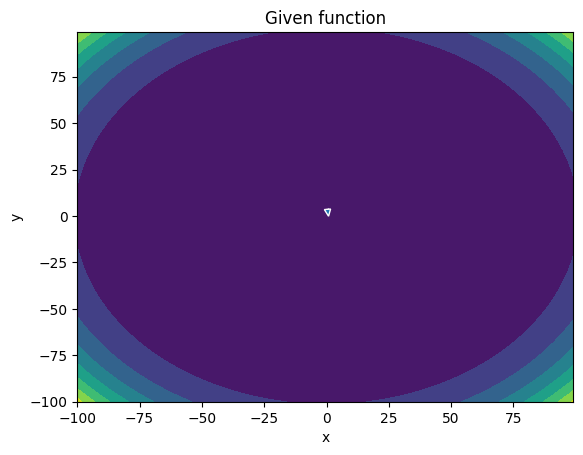

-------
Initial Coordinates:
[[0.38212885]
 [3.60145019]]
Final Coordinates:
[[0.38576376]
 [3.55481466]]
Gradient:
[[2.45653495e+00]
 [1.85065804e+04]]


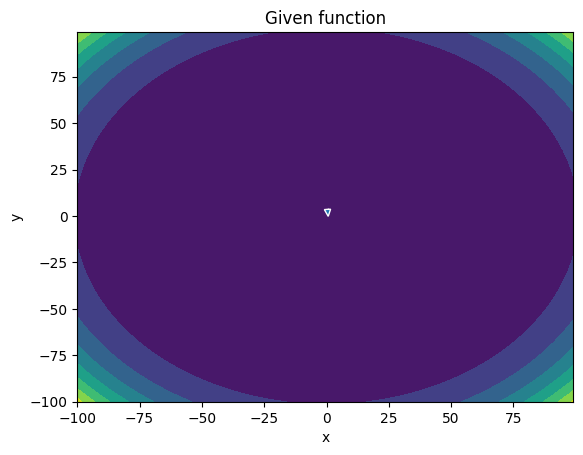

-------
Initial Coordinates:
[[0.38576376]
 [3.55481466]]
Final Coordinates:
[[0.39175578]
 [3.50874853]]
Gradient:
[[-3.82863694e+00]
 [ 1.73058315e+04]]


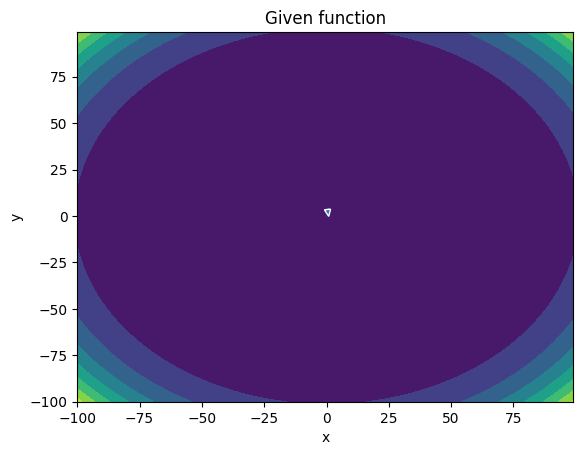

-------
Initial Coordinates:
[[0.39175578]
 [3.50874853]]
Final Coordinates:
[[0.39548708]
 [3.46324923]]
Gradient:
[[2.76671139e+00]
 [1.61866393e+04]]


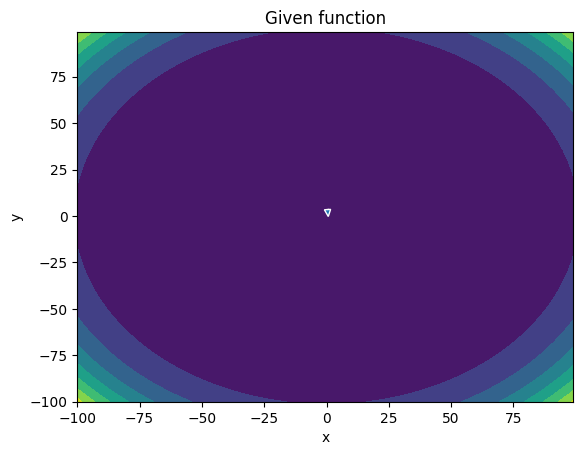

-------
Initial Coordinates:
[[0.39548708]
 [3.46324923]]
Final Coordinates:
[[0.40119839]
 [3.4183145 ]]
Gradient:
[[-2.95260475e+00]
 [ 1.51342153e+04]]


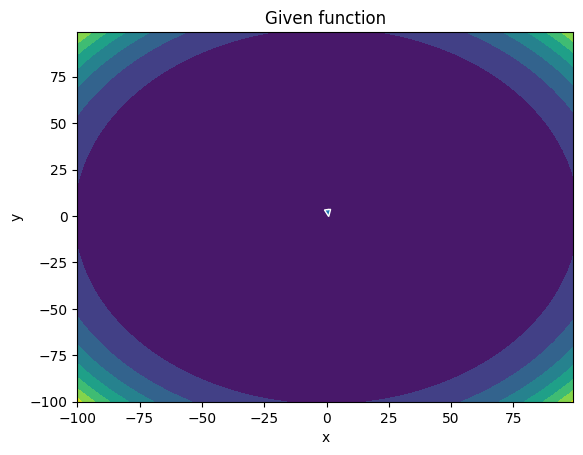

-------
Initial Coordinates:
[[0.40119839]
 [3.4183145 ]]
Final Coordinates:
[[0.40569293]
 [3.37394141]]
Gradient:
[[1.18440396e+00]
 [1.41531807e+04]]


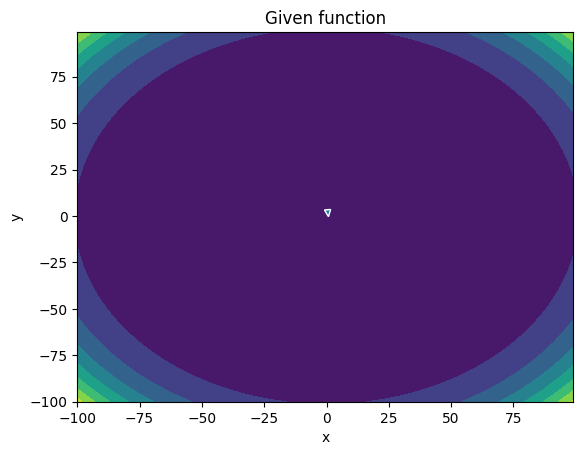

-------
Initial Coordinates:
[[0.40569293]
 [3.37394141]]
Final Coordinates:
[[0.41066186]
 [3.33012715]]
Gradient:
[[-8.61347019e-01]
 [ 1.32326978e+04]]


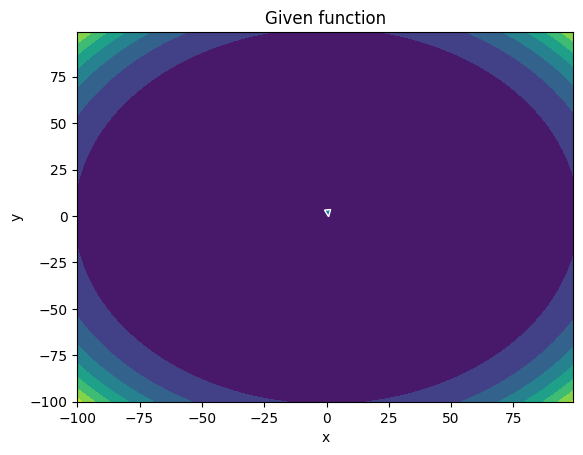

-------
Initial Coordinates:
[[0.41066186]
 [3.33012715]]
Final Coordinates:
[[0.41610028]
 [3.2868686 ]]
Gradient:
[[-8.40096201e-01]
 [ 1.23723091e+04]]


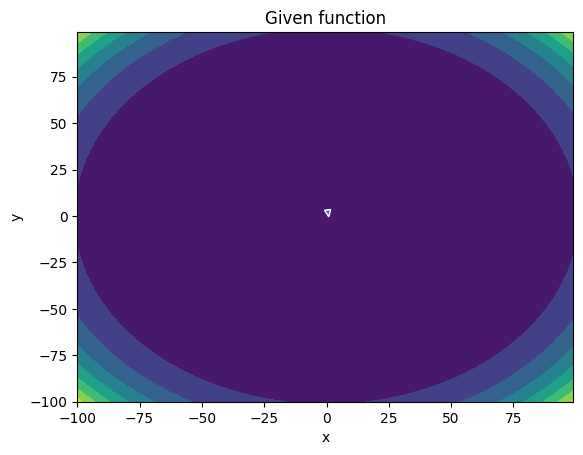

-------
Initial Coordinates:
[[0.41610028]
 [3.2868686 ]]
Final Coordinates:
[[0.42039448]
 [3.24416235]]
Gradient:
[[9.48275401e-01]
 [1.15682366e+04]]


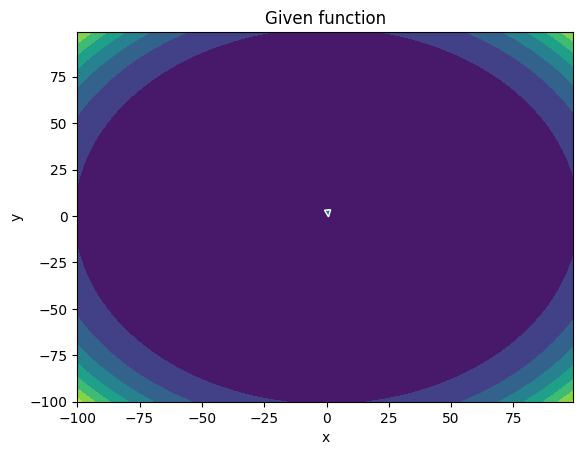

-------
Initial Coordinates:
[[0.42039448]
 [3.24416235]]
Final Coordinates:
[[0.42649939]
 [3.2020051 ]]
Gradient:
[[-2.13007331e+00]
 [ 1.08139929e+04]]


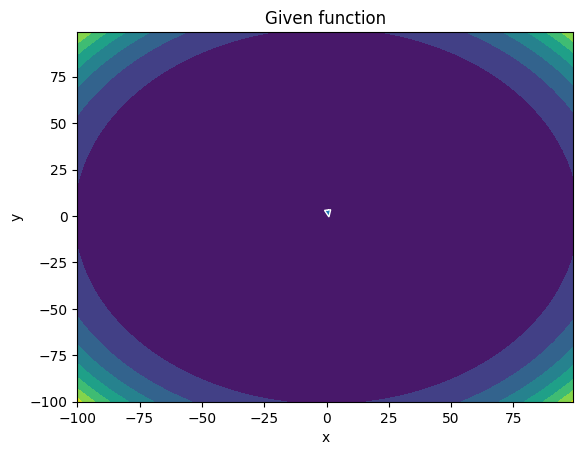

-------
Initial Coordinates:
[[0.42649939]
 [3.2020051 ]]
Final Coordinates:
[[0.43052037]
 [3.1603929 ]]
Gradient:
[[1.74810253e+00]
 [1.01117218e+04]]


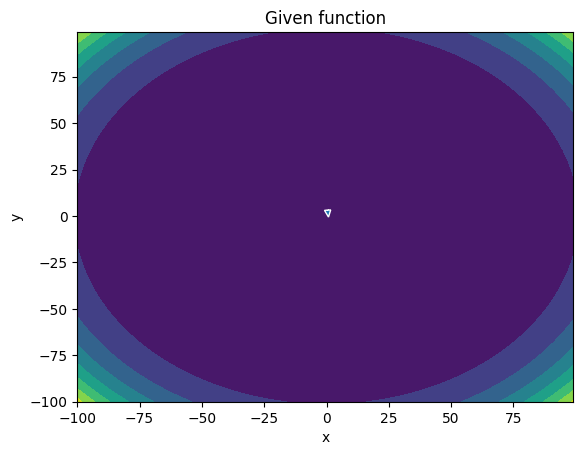

-------
Initial Coordinates:
[[0.43052037]
 [3.1603929 ]]
Final Coordinates:
[[0.43682459]
 [3.11932222]]
Gradient:
[[-2.36240209e+00]
 [ 9.45137124e+03]]


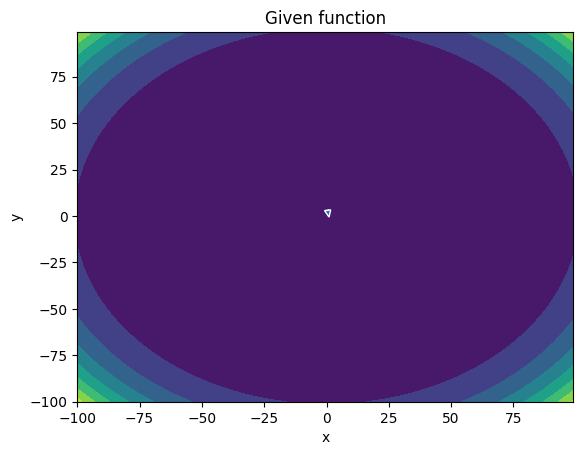

-------
Initial Coordinates:
[[0.43682459]
 [3.11932222]]
Final Coordinates:
[[0.44102914]
 [3.07878871]]
Gradient:
[[1.58536208e+00]
 [8.83767117e+03]]


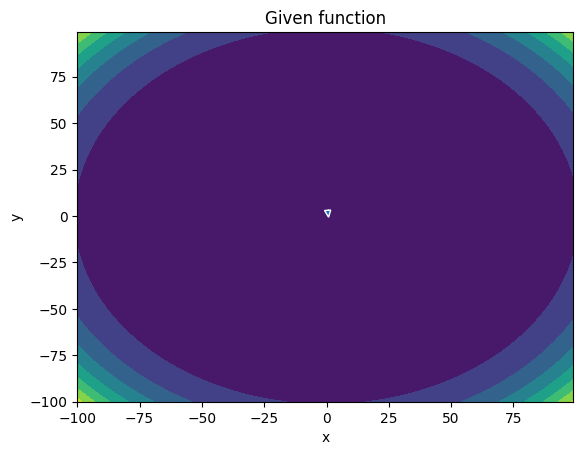

-------
Initial Coordinates:
[[0.44102914]
 [3.07878871]]
Final Coordinates:
[[0.44711583]
 [3.03878848]]
Gradient:
[[-1.79744921e+00]
 [ 8.26044829e+03]]


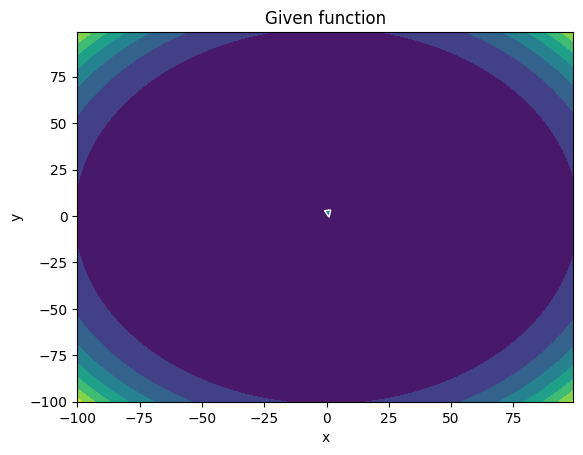

-------
Initial Coordinates:
[[0.44711583]
 [3.03878848]]
Final Coordinates:
[[0.45181783]
 [2.99931694]]
Gradient:
[[8.65735798e-01]
 [7.72374629e+03]]


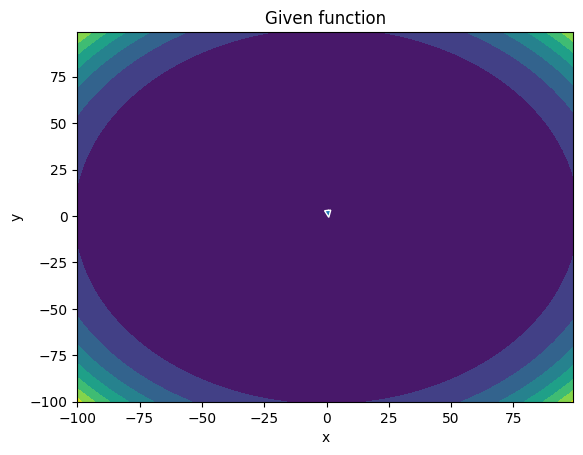

-------
Initial Coordinates:
[[0.45181783]
 [2.99931694]]
Final Coordinates:
[[0.45746745]
 [2.96036978]]
Gradient:
[[-9.16547846e-01]
 [ 7.21989294e+03]]


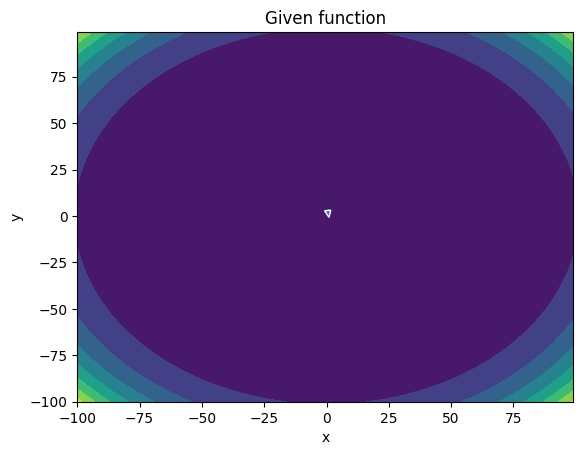

-------
Initial Coordinates:
[[0.45746745]
 [2.96036978]]
Final Coordinates:
[[0.46276288]
 [2.92194226]]
Gradient:
[[4.68432141e-02]
 [6.75031115e+03]]


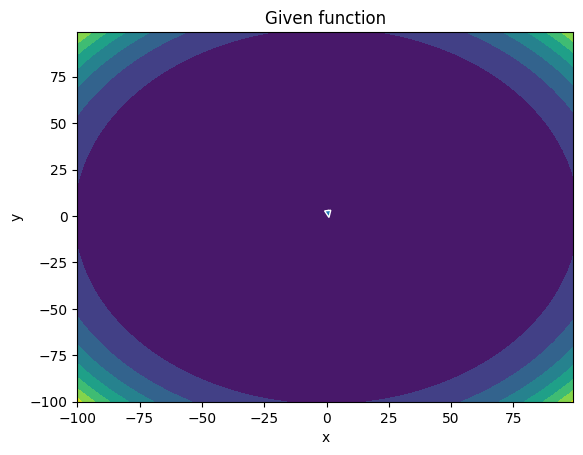

-------
Initial Coordinates:
[[0.46276288]
 [2.92194226]]
Final Coordinates:
[[0.46795053]
 [2.88402961]]
Gradient:
[[-1.13536677e-01]
 [ 6.31087993e+03]]


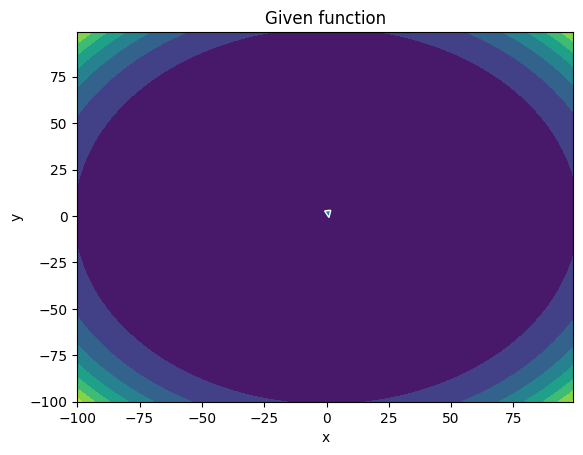

-------
Initial Coordinates:
[[0.46795053]
 [2.88402961]]
Final Coordinates:
[[0.47379902]
 [2.84662699]]
Gradient:
[[-6.10276685e-01]
 [ 5.90001450e+03]]


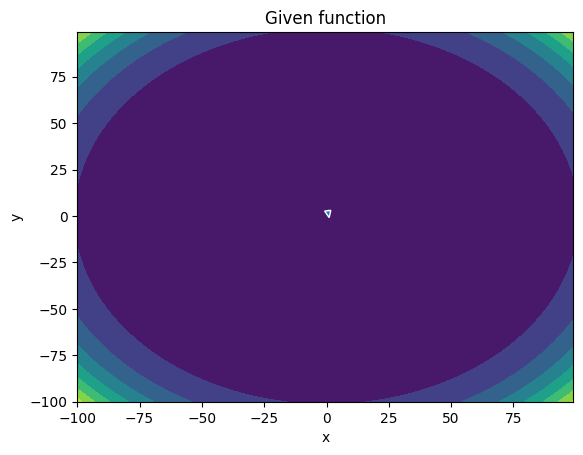

-------
Initial Coordinates:
[[0.47379902]
 [2.84662699]]
Final Coordinates:
[[0.47855834]
 [2.80972922]]
Gradient:
[[4.90681736e-01]
 [5.51692806e+03]]


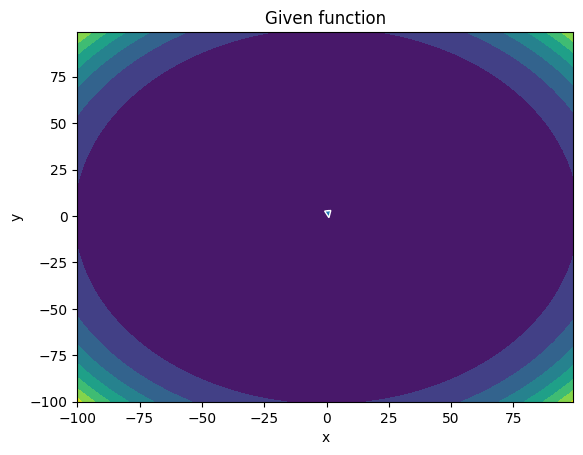

-------
Initial Coordinates:
[[0.47855834]
 [2.80972922]]
Final Coordinates:
[[0.48494136]
 [2.77333139]]
Gradient:
[[-1.11114858e+00]
 [ 5.15747099e+03]]


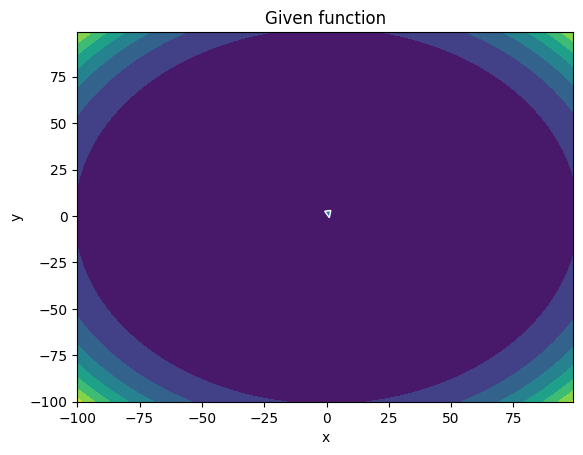

-------
Initial Coordinates:
[[0.48494136]
 [2.77333139]]
Final Coordinates:
[[0.48920626]
 [2.73742789]]
Gradient:
[[1.00232604e+00]
 [4.82365406e+03]]


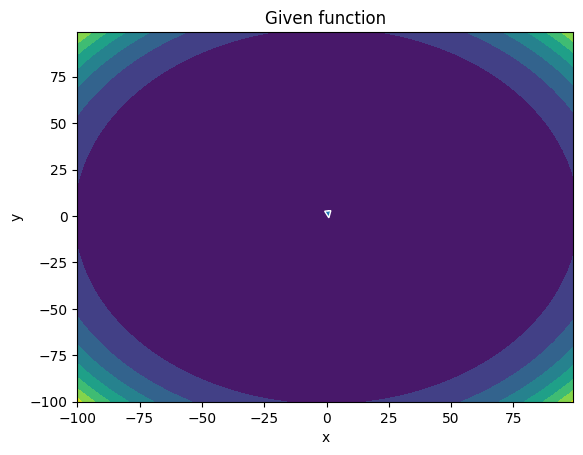

-------
Initial Coordinates:
[[0.48920626]
 [2.73742789]]
Final Coordinates:
[[0.49626804]
 [2.70201381]]
Gradient:
[[-1.62774668e+00]
 [ 4.50905862e+03]]


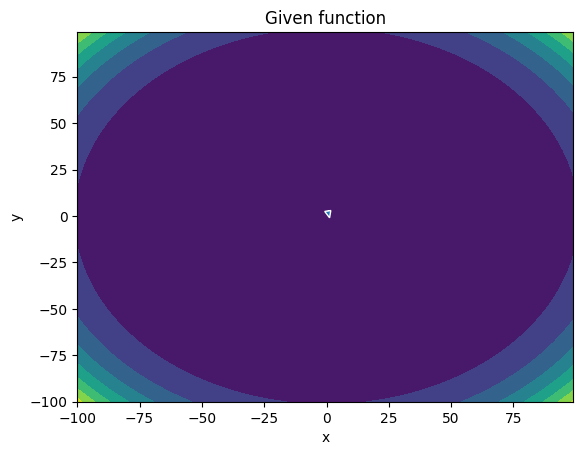

-------
Initial Coordinates:
[[0.49626804]
 [2.70201381]]
Final Coordinates:
[[0.49974992]
 [2.66708308]]
Gradient:
[[1.62831185e+00]
 [4.21849706e+03]]


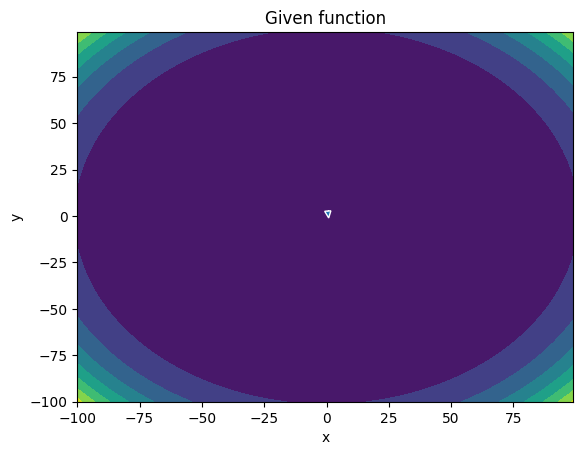

-------
Initial Coordinates:
[[0.49974992]
 [2.66708308]]
Final Coordinates:
[[0.50788115]
 [2.63263094]]
Gradient:
[[-2.39045107e+00]
 [ 3.94275637e+03]]


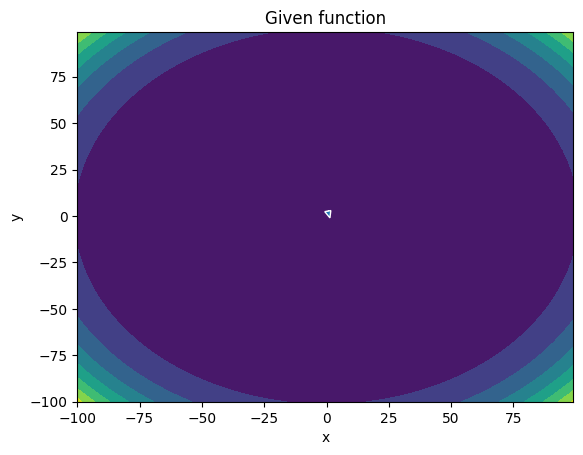

-------
Initial Coordinates:
[[0.50788115]
 [2.63263094]]
Final Coordinates:
[[0.51008167]
 [2.59865071]]
Gradient:
[[2.55346256e+00]
 [3.69045205e+03]]


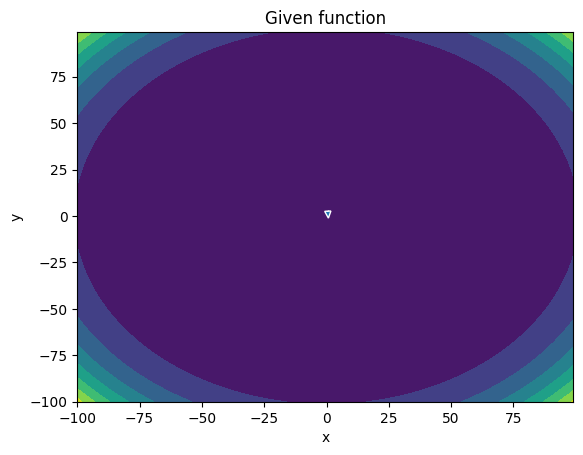

-------
Initial Coordinates:
[[0.51008167]
 [2.59865071]]
Final Coordinates:
[[0.51964485]
 [2.56513803]]
Gradient:
[[  -3.48084657]
 [3448.07928882]]


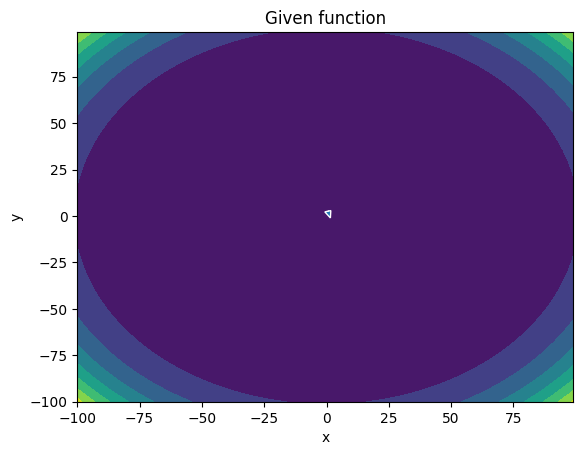

-------
Initial Coordinates:
[[0.51964485]
 [2.56513803]]
Final Coordinates:
[[0.5207143 ]
 [2.53208544]]
Gradient:
[[   3.49229663]
 [3229.59904814]]


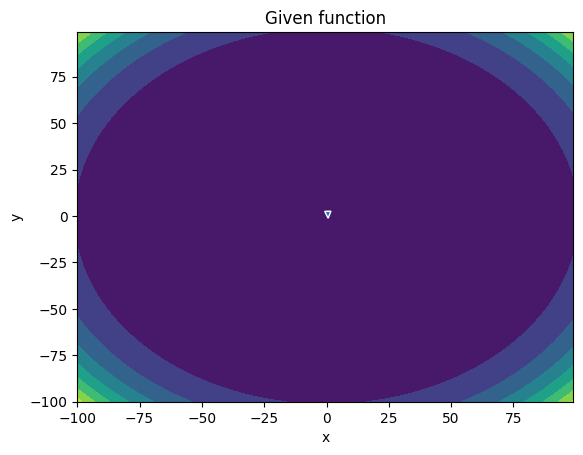

-------
Initial Coordinates:
[[0.5207143 ]
 [2.53208544]]
Final Coordinates:
[[0.53050281]
 [2.49948901]]
Gradient:
[[  -3.9348773 ]
 [3016.50607706]]


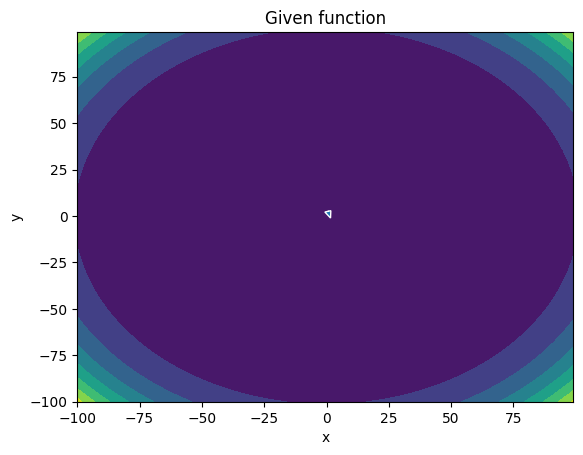

-------
Initial Coordinates:
[[0.53050281]
 [2.49948901]]
Final Coordinates:
[[0.53308966]
 [2.46734097]]
Gradient:
[[2.81335819e+00]
 [2.82631255e+03]]


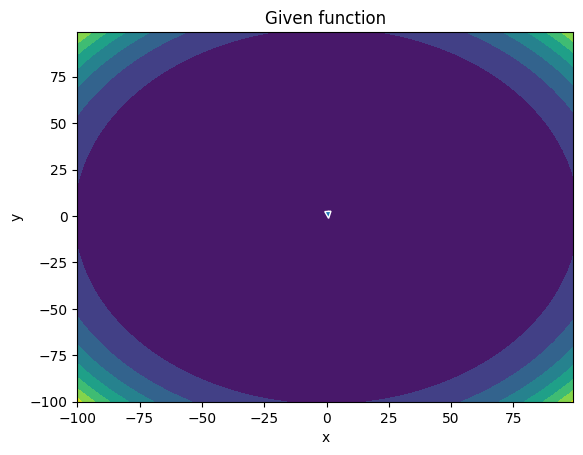

-------
Initial Coordinates:
[[0.53308966]
 [2.46734097]]
Final Coordinates:
[[0.53967531]
 [2.4356367 ]]
Gradient:
[[-1.71990580e+00]
 [ 2.64144462e+03]]


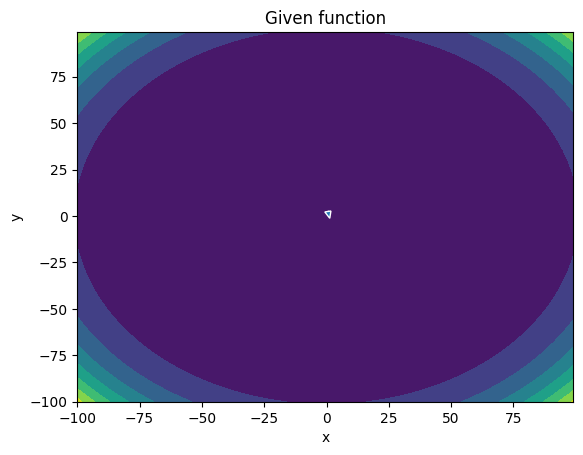

-------
Initial Coordinates:
[[0.53967531]
 [2.4356367 ]]
Final Coordinates:
[[0.54636366]
 [2.40436974]]
Gradient:
[[-1.73426597e-01]
 [ 2.47255375e+03]]


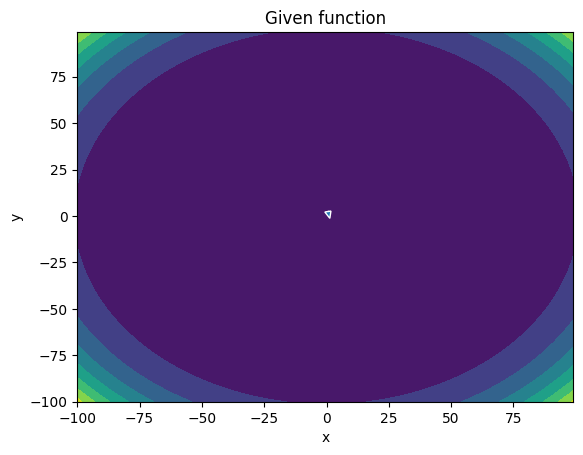

-------
Initial Coordinates:
[[0.54636366]
 [2.40436974]]
Final Coordinates:
[[0.54894951]
 [2.37353352]]
Gradient:
[[1.39463927e+00]
 [2.31484385e+03]]


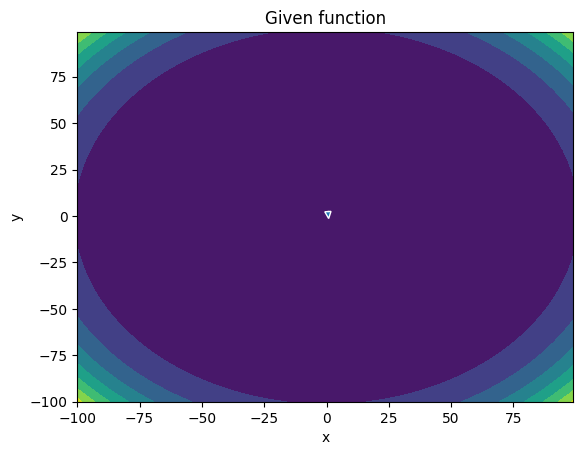

-------
Initial Coordinates:
[[0.54894951]
 [2.37353352]]
Final Coordinates:
[[0.55824138]
 [2.3431234 ]]
Gradient:
[[  -2.51712333]
 [2163.7287855 ]]


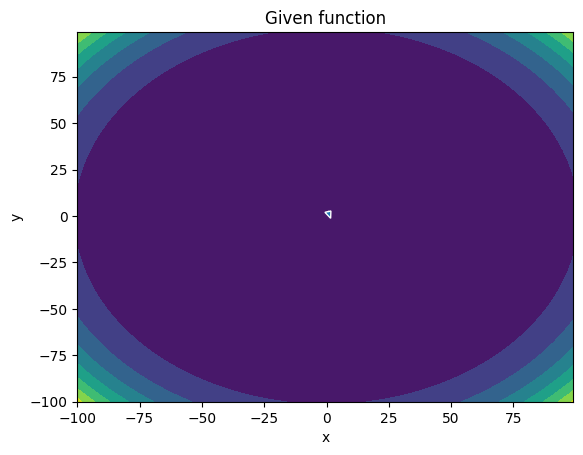

-------
Initial Coordinates:
[[0.55824138]
 [2.3431234 ]]
Final Coordinates:
[[0.56034425]
 [2.31313142]]
Gradient:
[[   2.30766489]
 [2028.44151722]]


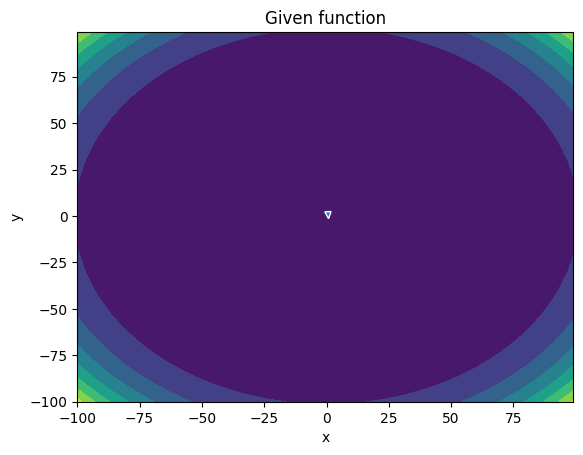

-------
Initial Coordinates:
[[0.56034425]
 [2.31313142]]
Final Coordinates:
[[0.56781974]
 [2.28355324]]
Gradient:
[[-1.87857748e+00]
 [ 1.89584092e+03]]


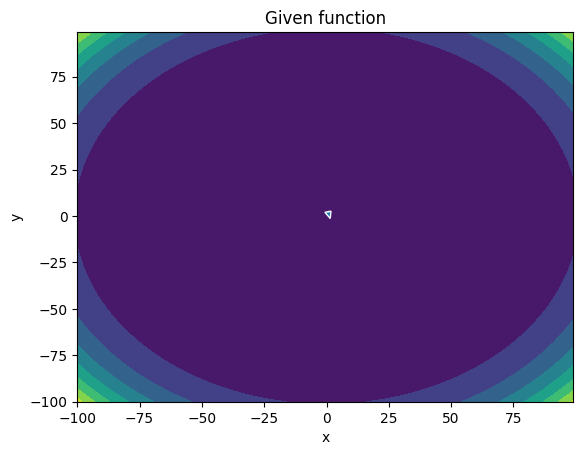

-------
Initial Coordinates:
[[0.56781974]
 [2.28355324]]
Final Coordinates:
[[0.57340828]
 [2.25438171]]
Gradient:
[[4.84097174e-01]
 [1.77638758e+03]]


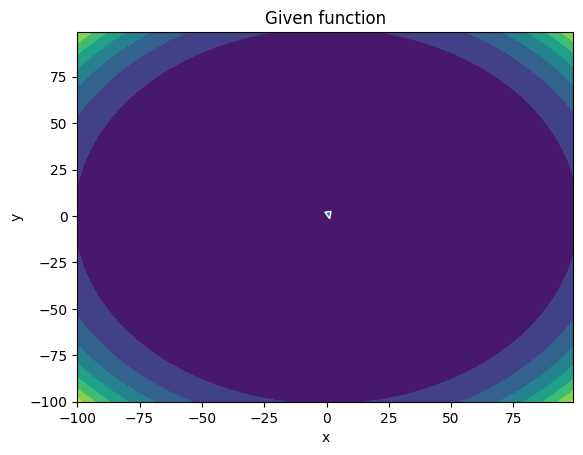

-------
Initial Coordinates:
[[0.57340828]
 [2.25438171]]
Final Coordinates:
[[0.57676093]
 [2.22561066]]
Gradient:
[[5.96671340e-01]
 [1.66322629e+03]]


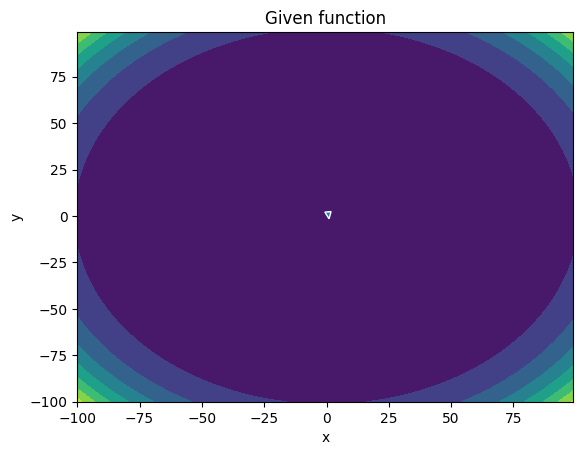

-------
Initial Coordinates:
[[0.57676093]
 [2.22561066]]
Final Coordinates:
[[0.58544445]
 [2.19723514]]
Gradient:
[[  -1.64650223]
 [1555.69684936]]


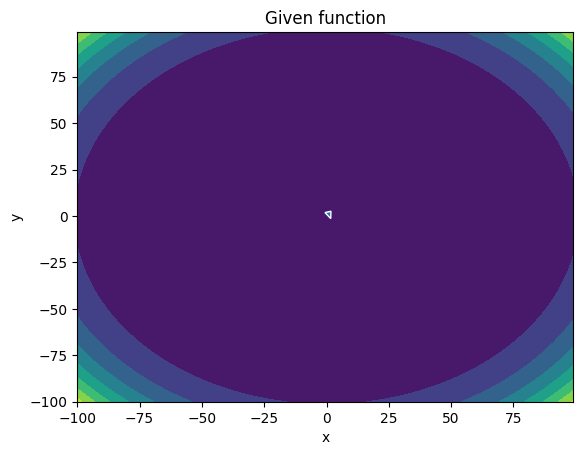

-------
Initial Coordinates:
[[0.58544445]
 [2.19723514]]
Final Coordinates:
[[0.58742819]
 [2.16924722]]
Gradient:
[[   1.7487399 ]
 [1459.25388623]]


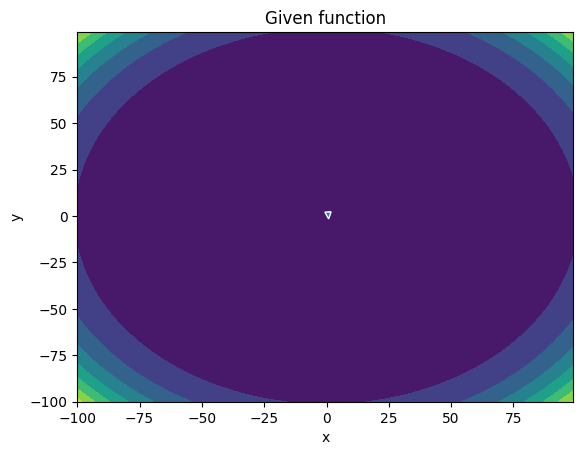

-------
Initial Coordinates:
[[0.58742819]
 [2.16924722]]
Final Coordinates:
[[0.59523963]
 [2.14164279]]
Gradient:
[[  -1.6516939 ]
 [1364.14138936]]


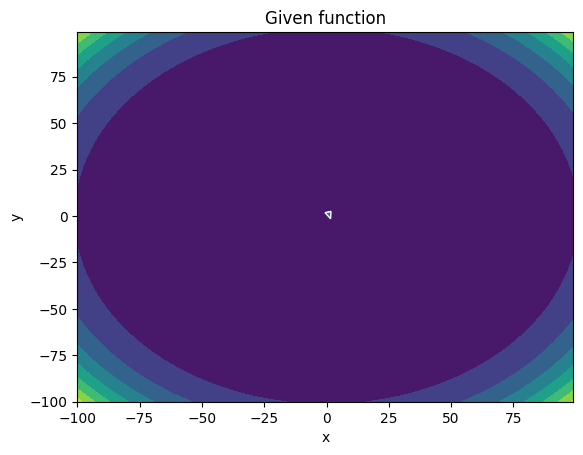

-------
Initial Coordinates:
[[0.59523963]
 [2.14164279]]
Final Coordinates:
[[0.59986917]
 [2.11441434]]
Gradient:
[[7.26093019e-01]
 [1.27940880e+03]]


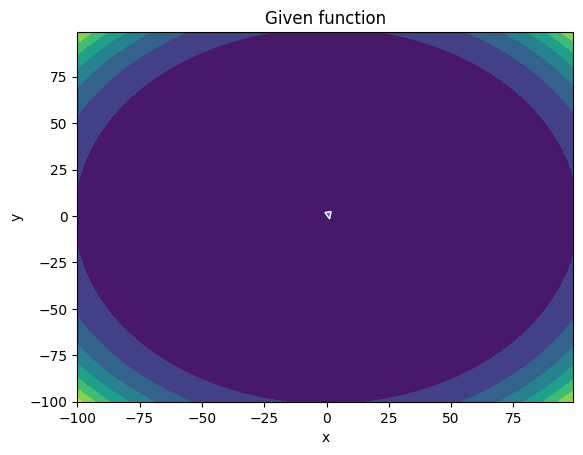

-------
Initial Coordinates:
[[0.59986917]
 [2.11441434]]
Final Coordinates:
[[0.60394986]
 [2.08755627]]
Gradient:
[[7.78238571e-02]
 [1.19797920e+03]]


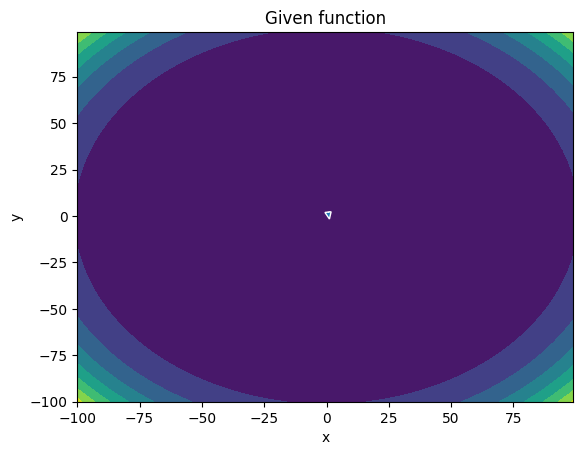

-------
Initial Coordinates:
[[0.60394986]
 [2.08755627]]
Final Coordinates:
[[0.61181391]
 [2.06106332]]
Gradient:
[[-9.63269754e-01]
 [ 1.12147026e+03]]


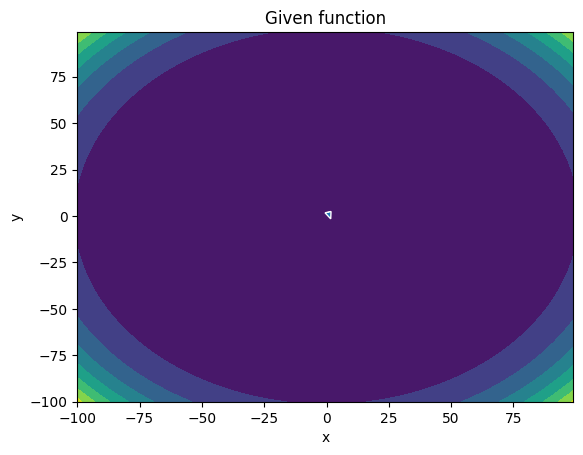

-------
Initial Coordinates:
[[0.61181391]
 [2.06106332]]
Final Coordinates:
[[0.61361411]
 [2.03492789]]
Gradient:
[[   1.27887941]
 [1052.41825446]]


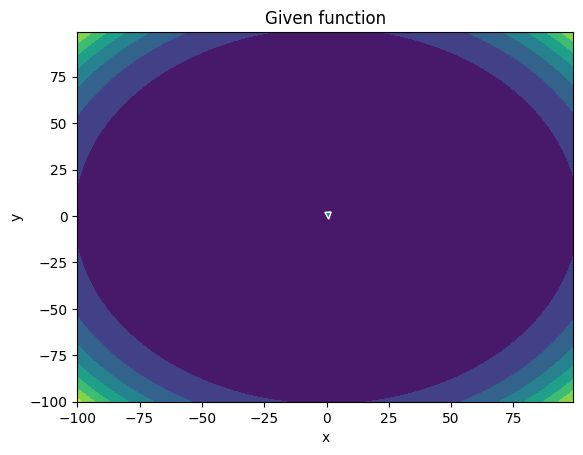

-------
Initial Coordinates:
[[0.61361411]
 [2.03492789]]
Final Coordinates:
[[0.62196377]
 [2.00914625]]
Gradient:
[[ -1.49562219]
 [983.98281552]]


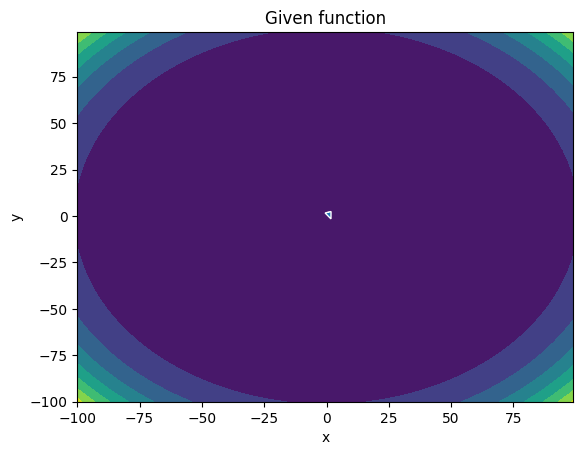

-------
Initial Coordinates:
[[0.62196377]
 [2.00914625]]
Final Coordinates:
[[0.62488159]
 [1.98371043]]
Gradient:
[[  1.05505677]
 [924.02860724]]


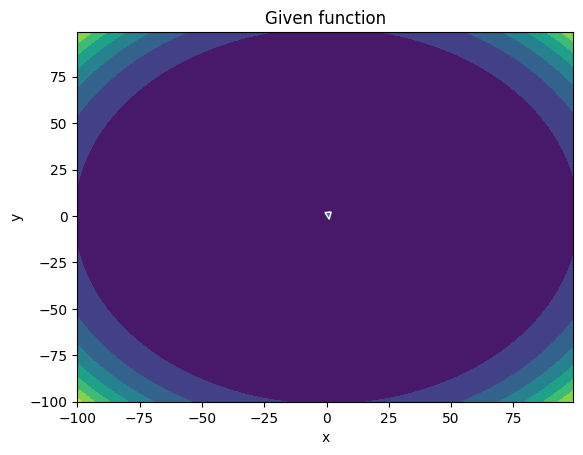

-------
Initial Coordinates:
[[0.62488159]
 [1.98371043]]
Final Coordinates:
[[0.63057288]
 [1.9586161 ]]
Gradient:
[[-6.01310320e-01]
 [ 8.64701397e+02]]


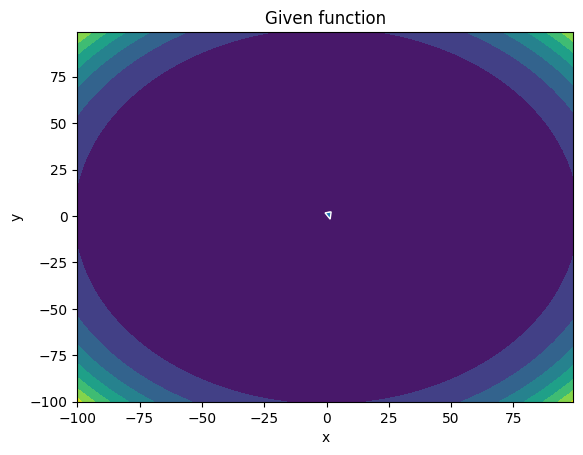

-------
Initial Coordinates:
[[0.63057288]
 [1.9586161 ]]
Final Coordinates:
[[0.63648234]
 [1.93385706]]
Gradient:
[[-9.93406397e-02]
 [ 8.10821073e+02]]


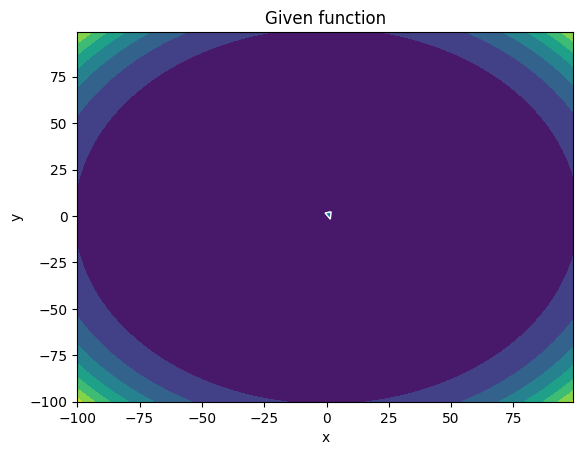

-------
Initial Coordinates:
[[0.63648234]
 [1.93385706]]
Final Coordinates:
[[0.639038  ]
 [1.90942699]]
Gradient:
[[5.60344474e-01]
 [7.60546734e+02]]


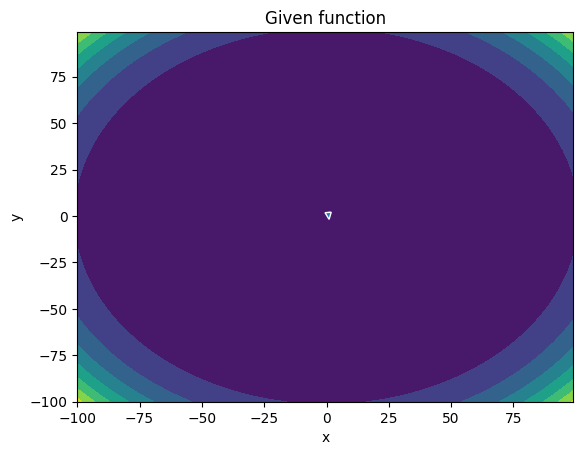

-------
Initial Coordinates:
[[0.639038  ]
 [1.90942699]]
Final Coordinates:
[[0.64719103]
 [1.88532197]]
Gradient:
[[ -1.03130813]
 [711.67926824]]


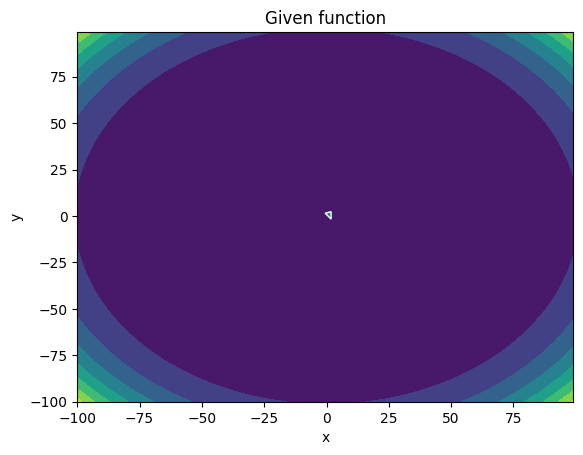

-------
Initial Coordinates:
[[0.64719103]
 [1.88532197]]
Final Coordinates:
[[0.64813526]
 [1.86153405]]
Gradient:
[[  1.14791372]
 [668.93003173]]


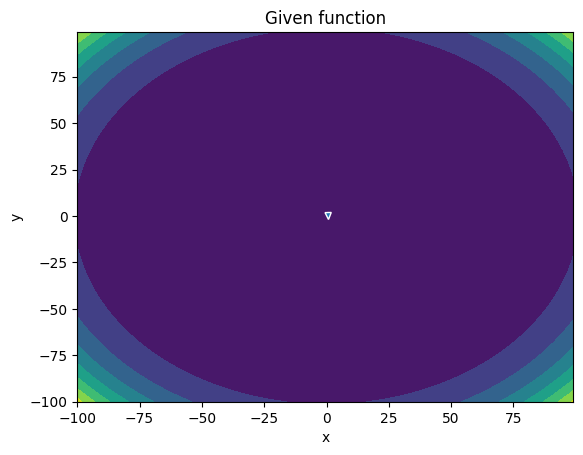

-------
Initial Coordinates:
[[0.64813526]
 [1.86153405]]
Final Coordinates:
[[0.65654744]
 [1.83806067]]
Gradient:
[[ -1.27789856]
 [625.22319161]]


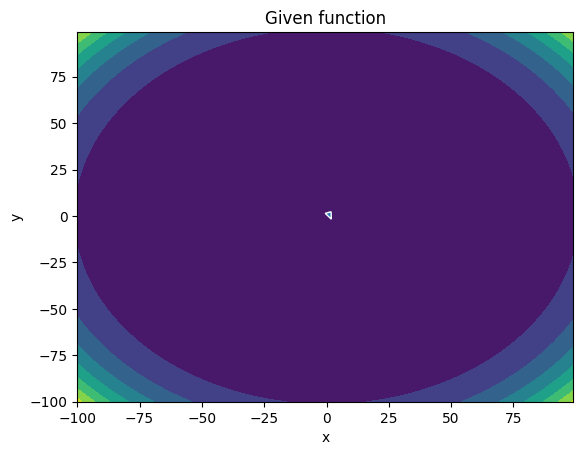

-------
Initial Coordinates:
[[0.65654744]
 [1.83806067]]
Final Coordinates:
[[0.65826246]
 [1.81489361]]
Gradient:
[[  1.00177407]
 [588.04795429]]


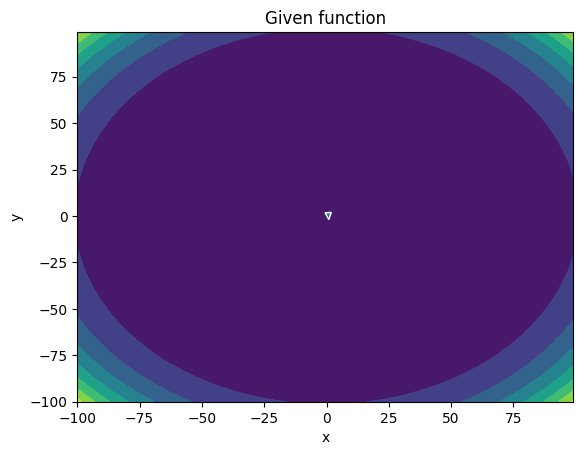

-------
Initial Coordinates:
[[0.65826246]
 [1.81489361]]
Final Coordinates:
[[0.66449155]
 [1.79202991]]
Gradient:
[[ -0.72582912]
 [550.0221236 ]]


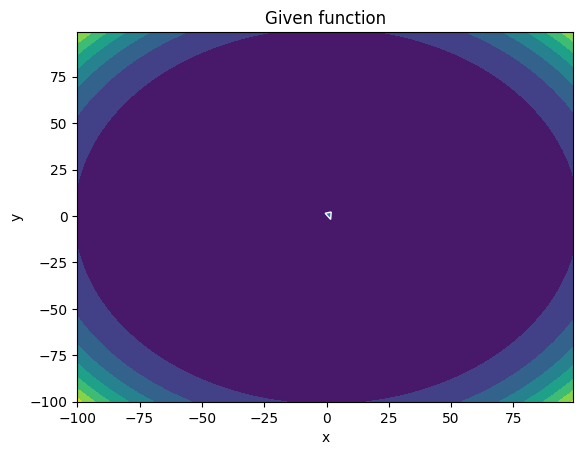

-------
Initial Coordinates:
[[0.66449155]
 [1.79202991]]
Final Coordinates:
[[0.66876982]
 [1.76946305]]
Gradient:
[[2.42271163e-01]
 [5.16548083e+02]]


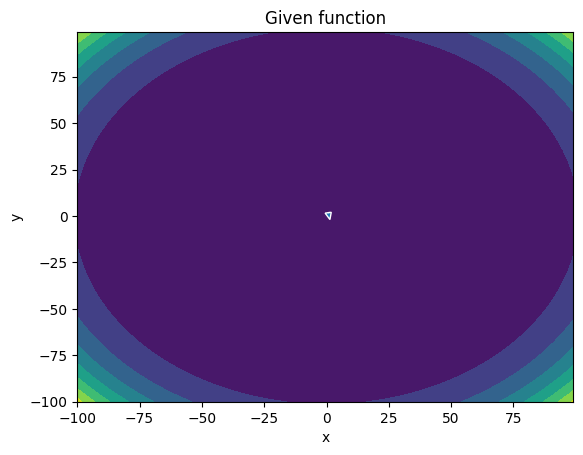

-------
Initial Coordinates:
[[0.66876982]
 [1.76946305]]
Final Coordinates:
[[0.67190991]
 [1.74718813]]
Gradient:
[[1.29876076e-01]
 [4.84333074e+02]]


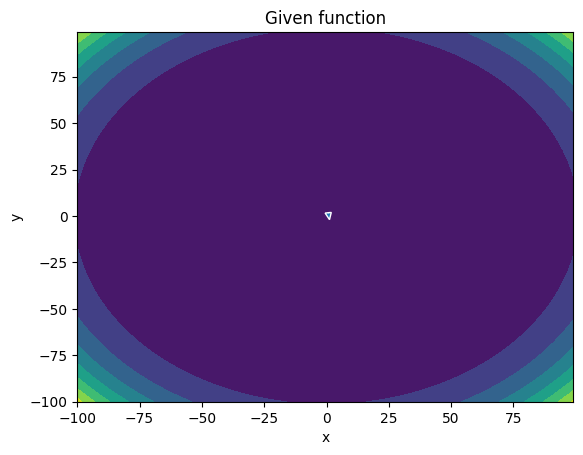

-------
Initial Coordinates:
[[0.67190991]
 [1.74718813]]
Final Coordinates:
[[0.67877719]
 [1.7252012 ]]
Gradient:
[[ -0.52975247]
 [453.67691606]]


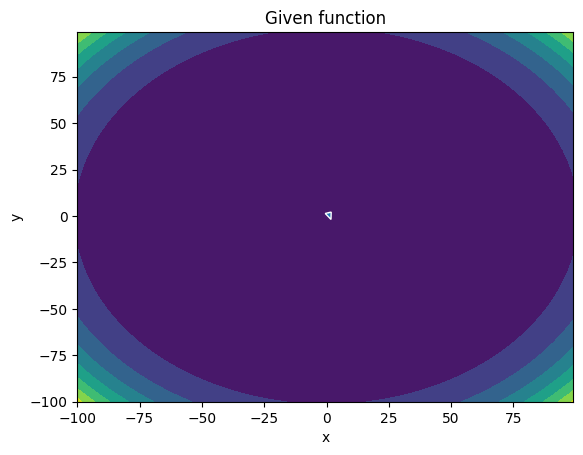

-------
Initial Coordinates:
[[0.67877719]
 [1.7252012 ]]
Final Coordinates:
[[0.67913773]
 [1.70349523]]
Gradient:
[[  0.78989906]
 [426.56931662]]


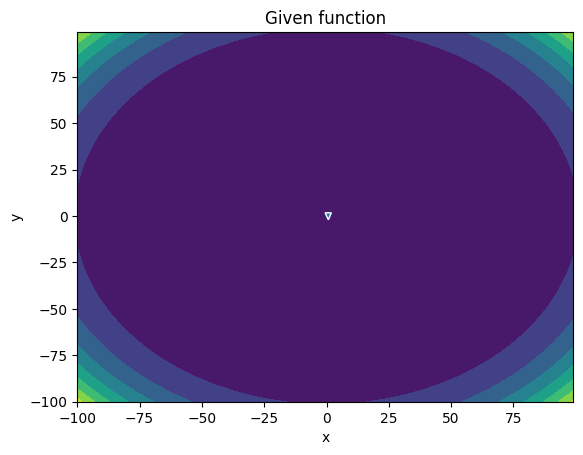

-------
Initial Coordinates:
[[0.67913773]
 [1.70349523]]
Final Coordinates:
[[0.6882135 ]
 [1.68206883]]
Gradient:
[[ -1.13044234]
 [398.50340836]]


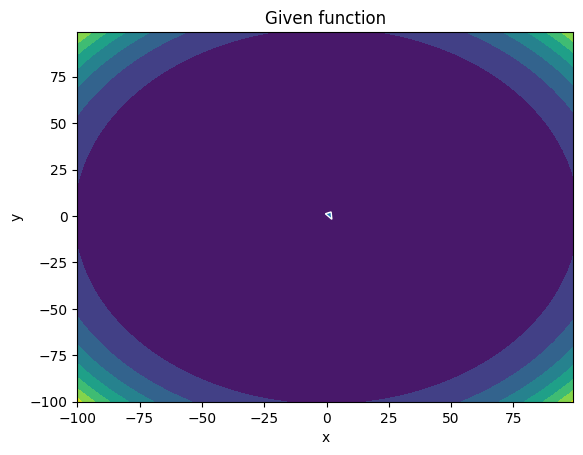

-------
Initial Coordinates:
[[0.6882135 ]
 [1.68206883]]
Final Coordinates:
[[0.68663416]
 [1.66091294]]
Gradient:
[[  1.25923343]
 [375.71405413]]


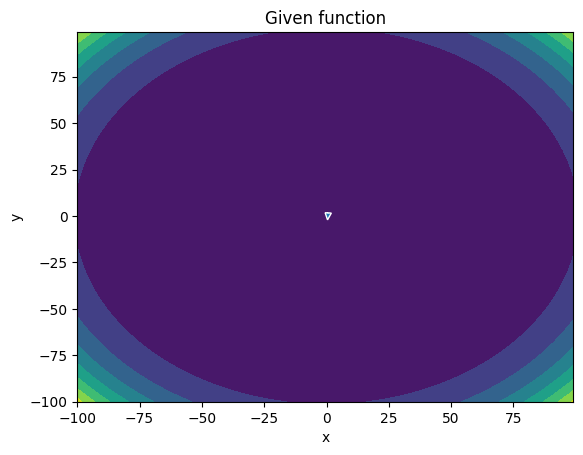

-------
Initial Coordinates:
[[0.68663416]
 [1.66091294]]
Final Coordinates:
[[0.69575978]
 [1.64002816]]
Gradient:
[[ -1.36710876]
 [350.245825  ]]


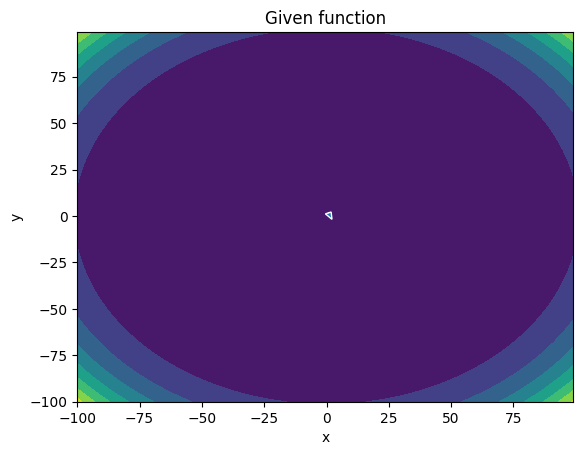

-------
Initial Coordinates:
[[0.69575978]
 [1.64002816]]
Final Coordinates:
[[0.69639791]
 [1.61940526]]
Gradient:
[[  0.98446254]
 [330.41373222]]


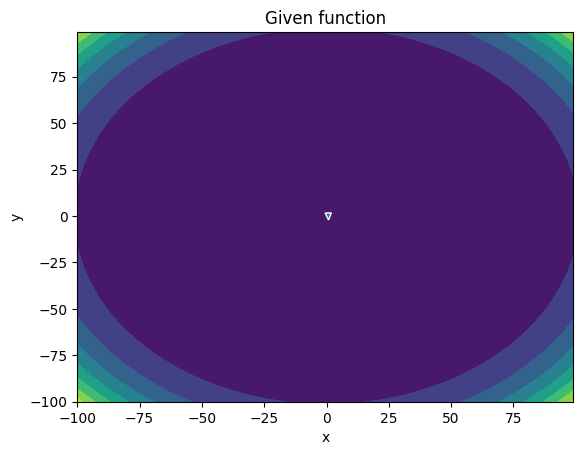

-------
Initial Coordinates:
[[0.69639791]
 [1.61940526]]
Final Coordinates:
[[0.7005927 ]
 [1.59904304]]
Gradient:
[[ -0.43563276]
 [308.75762266]]


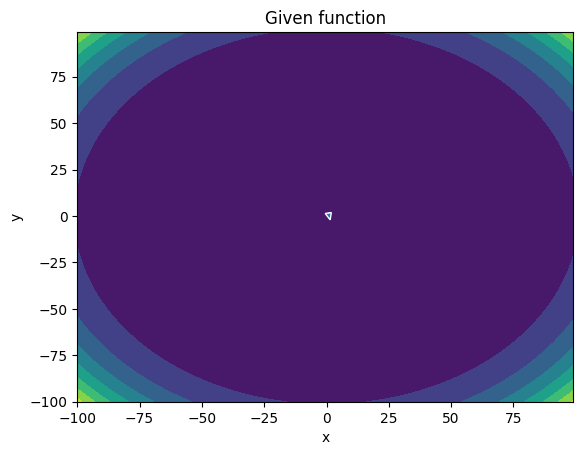

-------
Initial Coordinates:
[[0.7005927 ]
 [1.59904304]]
Final Coordinates:
[[0.70662572]
 [1.57893688]]
Gradient:
[[-2.37686899e-01]
 [ 2.89729009e+02]]


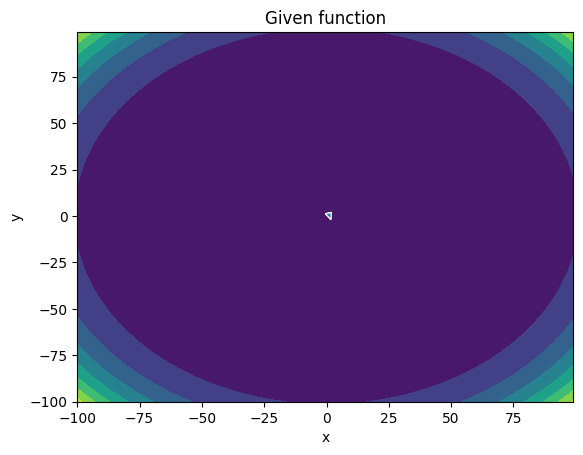

-------
Initial Coordinates:
[[0.70662572]
 [1.57893688]]
Final Coordinates:
[[0.7056418 ]
 [1.55908043]]
Gradient:
[[  0.73584494]
 [272.53524125]]


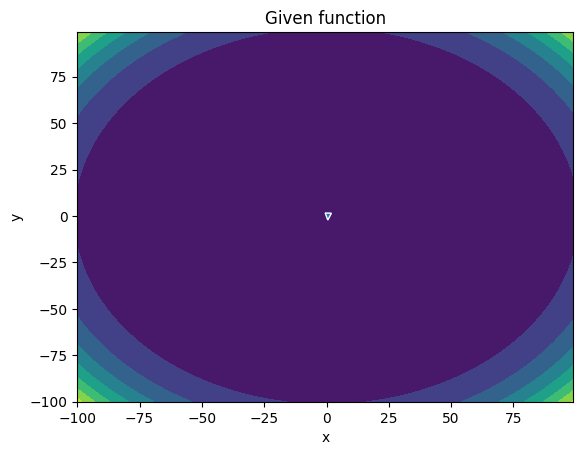

-------
Initial Coordinates:
[[0.7056418 ]
 [1.55908043]]
Final Coordinates:
[[0.71436317]
 [1.53947435]]
Gradient:
[[ -1.07006007]
 [254.11933742]]


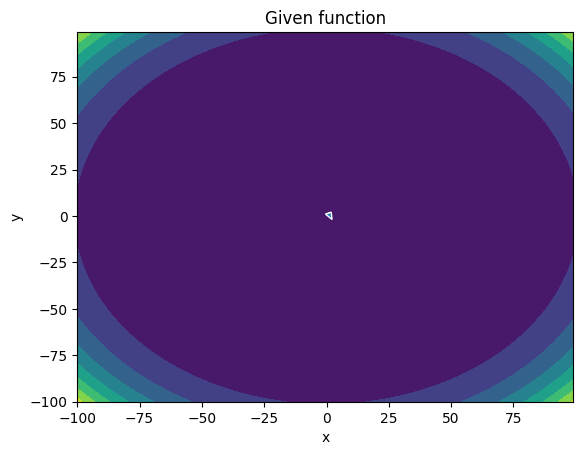

-------
Initial Coordinates:
[[0.71436317]
 [1.53947435]]
Final Coordinates:
[[0.7134668 ]
 [1.52010945]]
Gradient:
[[  0.97257169]
 [239.96433045]]


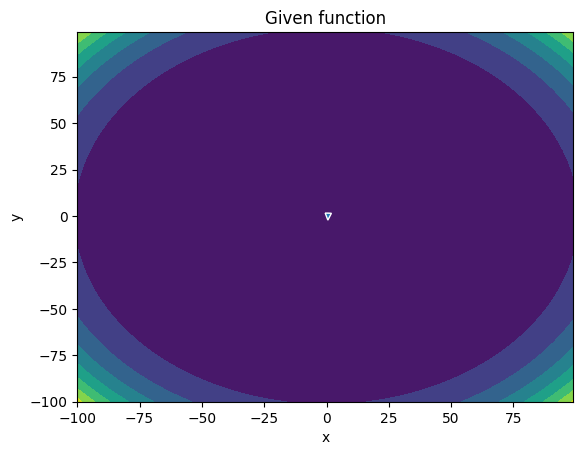

-------
Initial Coordinates:
[[0.7134668 ]
 [1.52010945]]
Final Coordinates:
[[0.71854571]
 [1.50098658]]
Gradient:
[[ -0.62844212]
 [223.73713705]]


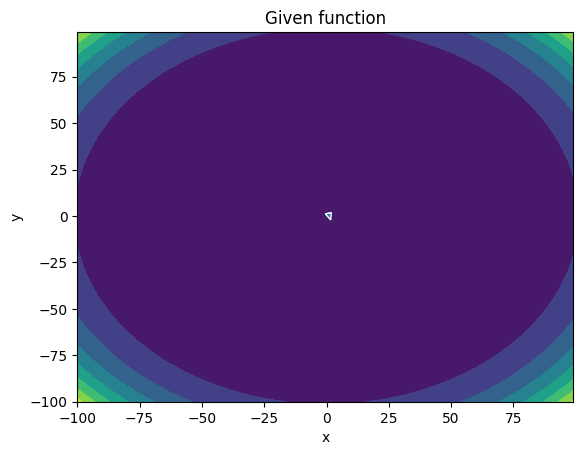

-------
Initial Coordinates:
[[0.71854571]
 [1.50098658]]
Final Coordinates:
[[0.72287776]
 [1.48210025]]
Gradient:
[[4.89414586e-02]
 [2.10321637e+02]]


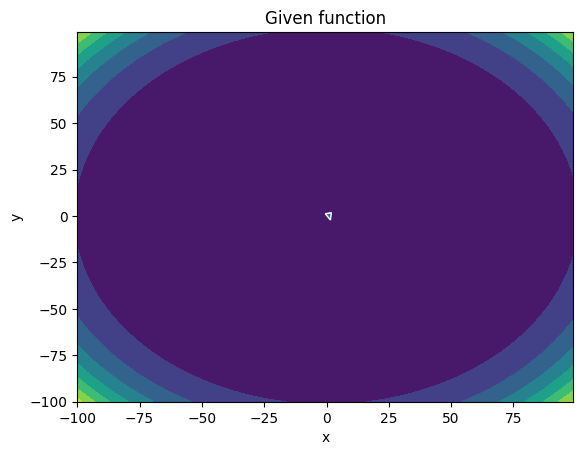

-------
Initial Coordinates:
[[0.72287776]
 [1.48210025]]
Final Coordinates:
[[0.72212952]
 [1.46344584]]
Gradient:
[[  0.46551164]
 [197.5403718 ]]


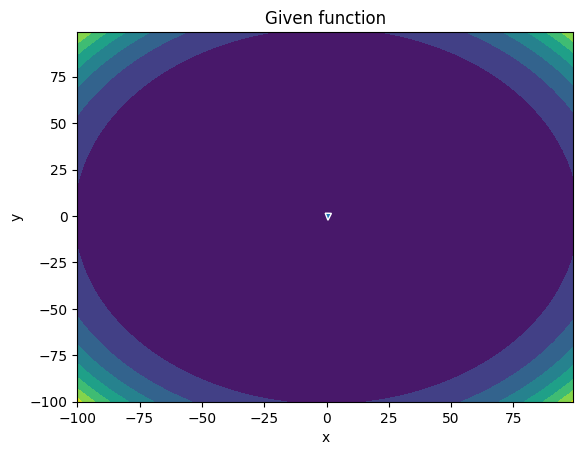

-------
Initial Coordinates:
[[0.72212952]
 [1.46344584]]
Final Coordinates:
[[0.73007531]
 [1.44502429]]
Gradient:
[[ -0.82357186]
 [184.1514923 ]]


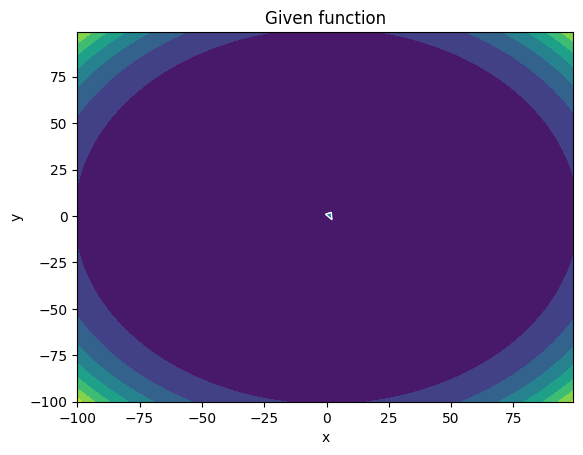

-------
Initial Coordinates:
[[0.73007531]
 [1.44502429]]
Final Coordinates:
[[0.7282728 ]
 [1.42682686]]
Gradient:
[[  0.8528746 ]
 [173.95454906]]


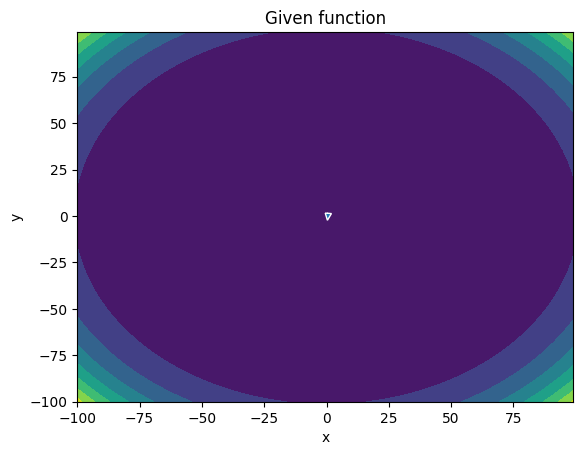

-------
Initial Coordinates:
[[0.7282728 ]
 [1.42682686]]
Final Coordinates:
[[0.73359841]
 [1.40885592]]
Gradient:
[[ -0.64283346]
 [161.85943663]]


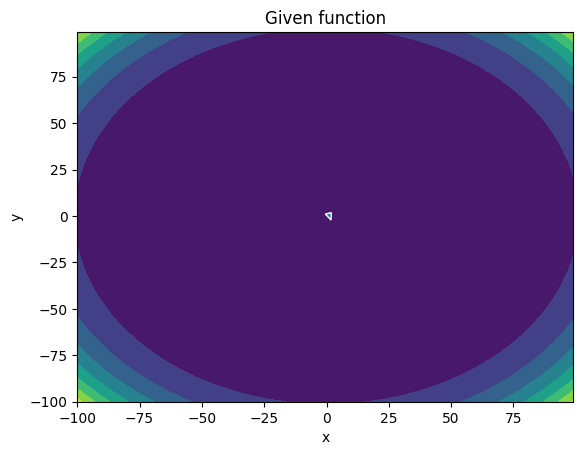

-------
Initial Coordinates:
[[0.73359841]
 [1.40885592]]
Final Coordinates:
[[0.73646536]
 [1.39110559]]
Gradient:
[[  0.18996923]
 [152.32711607]]


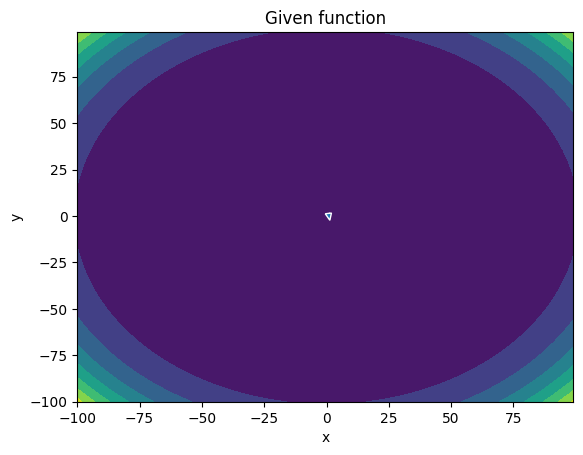

-------
Initial Coordinates:
[[0.73646536]
 [1.39110559]]
Final Coordinates:
[[0.73592127]
 [1.37357293]]
Gradient:
[[  0.27092725]
 [142.7995715 ]]


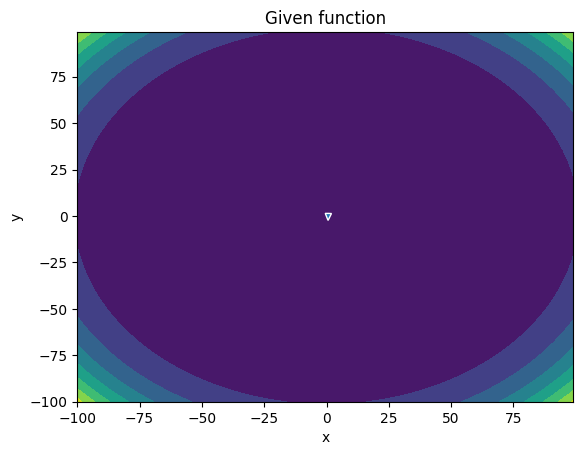

-------
Initial Coordinates:
[[0.73592127]
 [1.37357293]]
Final Coordinates:
[[0.7429859 ]
 [1.35625906]]
Gradient:
[[ -0.61641897]
 [133.07554596]]


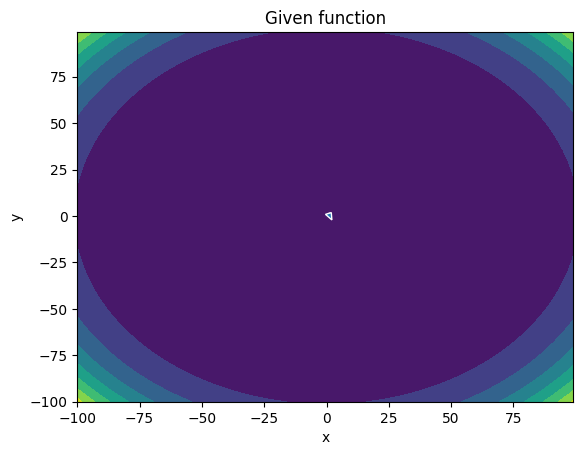

-------
Initial Coordinates:
[[0.7429859 ]
 [1.35625906]]
Final Coordinates:
[[0.74021487]
 [1.33915581]]
Gradient:
[[  0.74188902]
 [125.6951947 ]]


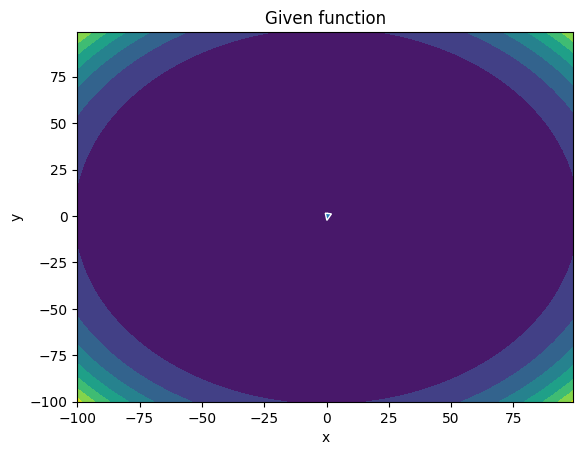

-------
Initial Coordinates:
[[0.74021487]
 [1.33915581]]
Final Coordinates:
[[0.74602794]
 [1.3222673 ]]
Gradient:
[[ -0.66342259]
 [116.62547756]]


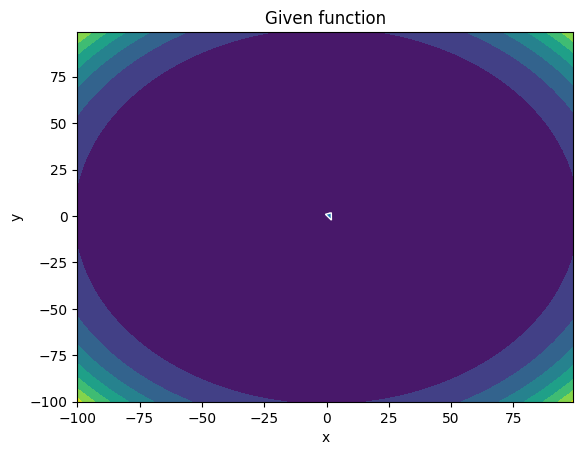

-------
Initial Coordinates:
[[0.74602794]
 [1.3222673 ]]
Final Coordinates:
[[0.74694231]
 [1.30558672]]
Gradient:
[[  0.3460931 ]
 [109.94914256]]


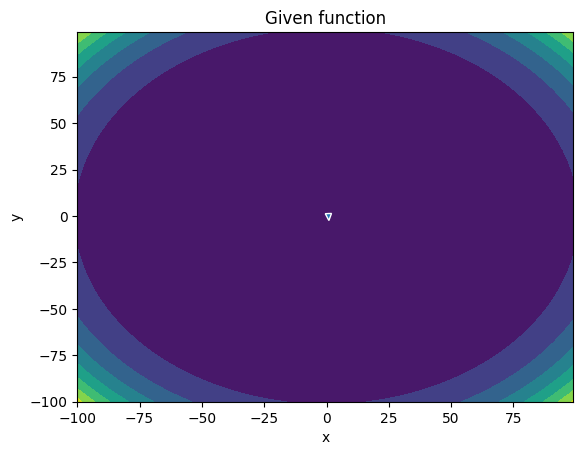

-------
Initial Coordinates:
[[0.74694231]
 [1.30558672]]
Final Coordinates:
[[0.74709963]
 [1.28911362]]
Gradient:
[[5.13219316e-02]
 [1.02695656e+02]]


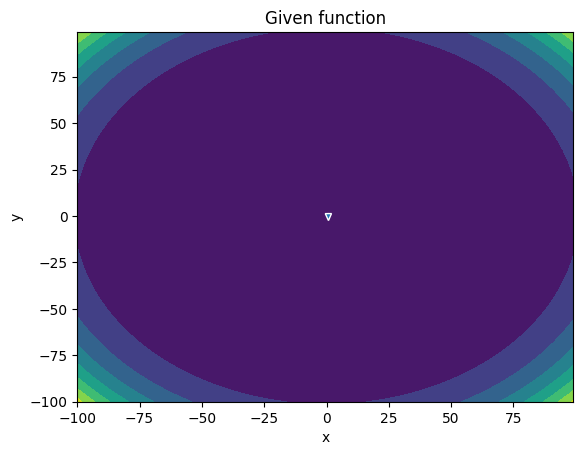

-------
Initial Coordinates:
[[0.74709963]
 [1.28911362]]
Final Coordinates:
[[0.75282563]
 [1.27284849]]
Gradient:
[[-0.38880495]
 [95.75739575]]


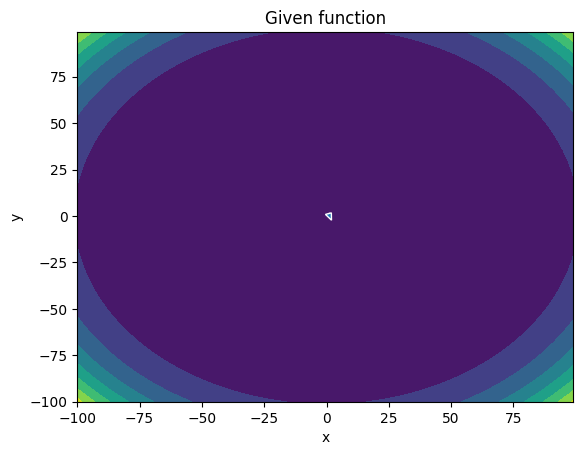

-------
Initial Coordinates:
[[0.75282563]
 [1.27284849]]
Final Coordinates:
[[0.74930727]
 [1.2567844 ]]
Gradient:
[[ 0.60120531]
 [90.31936122]]


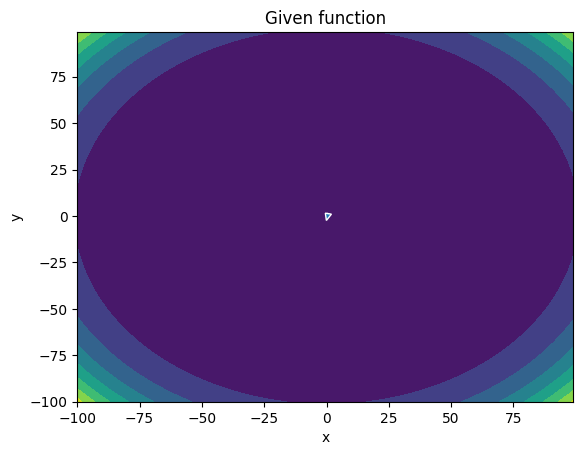

-------
Initial Coordinates:
[[0.74930727]
 [1.2567844 ]]
Final Coordinates:
[[0.75572662]
 [1.24092695]]
Gradient:
[[-0.65767336]
 [83.53412149]]


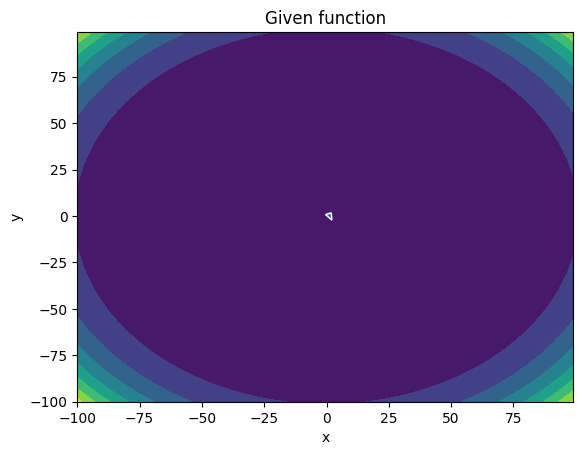

-------
Initial Coordinates:
[[0.75572662]
 [1.24092695]]
Final Coordinates:
[[0.75413307]
 [1.225268  ]]
Gradient:
[[ 0.5024708 ]
 [78.93913151]]


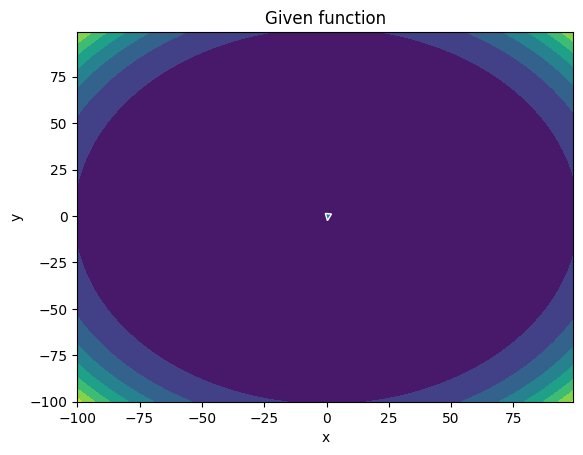

-------
Initial Coordinates:
[[0.75413307]
 [1.225268  ]]
Final Coordinates:
[[0.75571653]
 [1.20981066]]
Gradient:
[[-0.1969944]
 [73.2722036]]


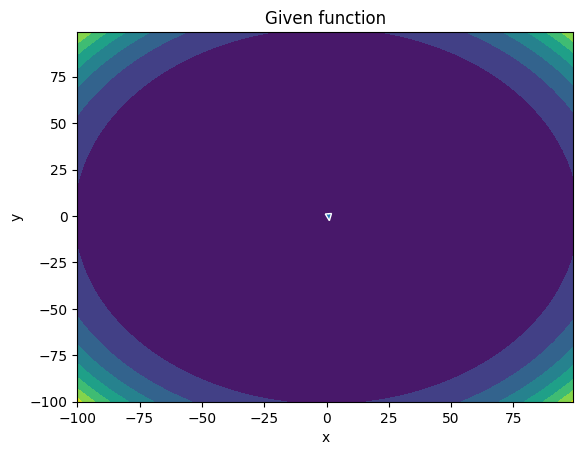

-------
Initial Coordinates:
[[0.75571653]
 [1.20981066]]
Final Coordinates:
[[0.75932813]
 [1.19455342]]
Gradient:
[[-0.12817325]
 [68.49359283]]


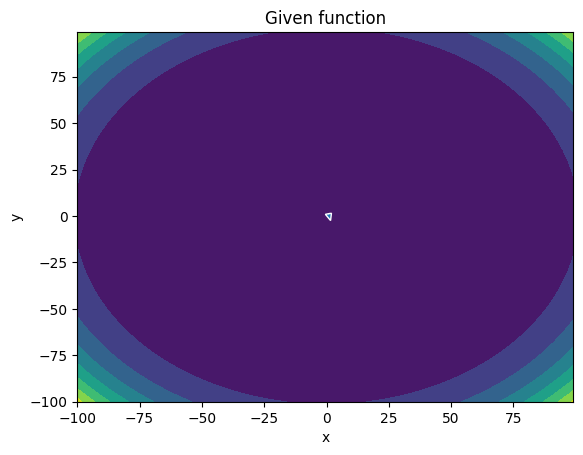

-------
Initial Coordinates:
[[0.75932813]
 [1.19455342]]
Final Coordinates:
[[0.75587273]
 [1.17949188]]
Gradient:
[[ 0.40083078]
 [64.34259641]]


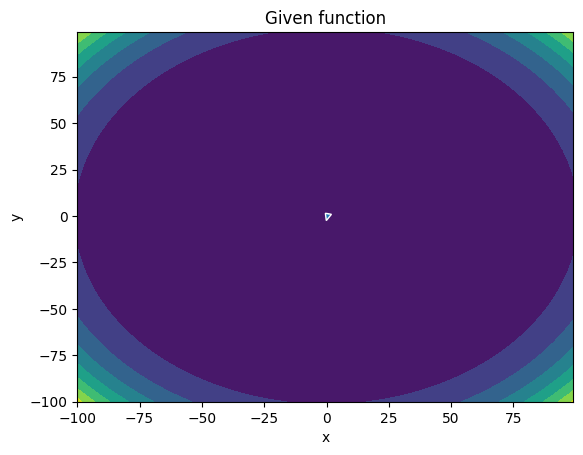

-------
Initial Coordinates:
[[0.75587273]
 [1.17949188]]
Final Coordinates:
[[0.7622309 ]
 [1.16463192]]
Gradient:
[[-0.55600816]
 [59.38490202]]


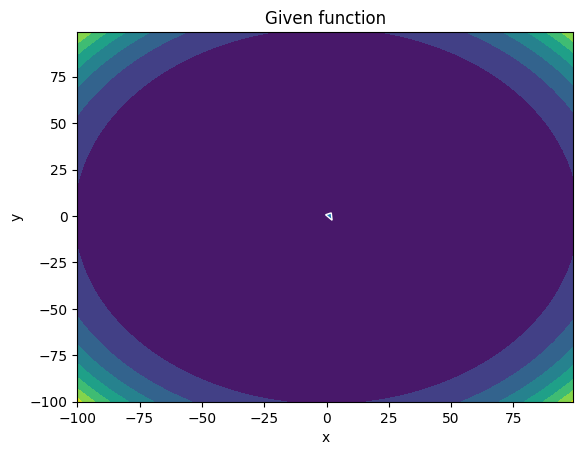

-------
Initial Coordinates:
[[0.7622309 ]
 [1.16463192]]
Final Coordinates:
[[0.75830093]
 [1.14996478]]
Gradient:
[[ 0.56505039]
 [56.18640245]]


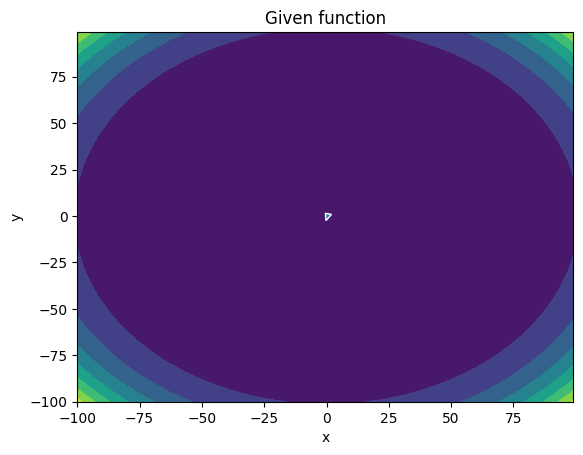

-------
Initial Coordinates:
[[0.75830093]
 [1.14996478]]
Final Coordinates:
[[0.76163277]
 [1.13549724]]
Gradient:
[[-0.39598467]
 [51.74242835]]


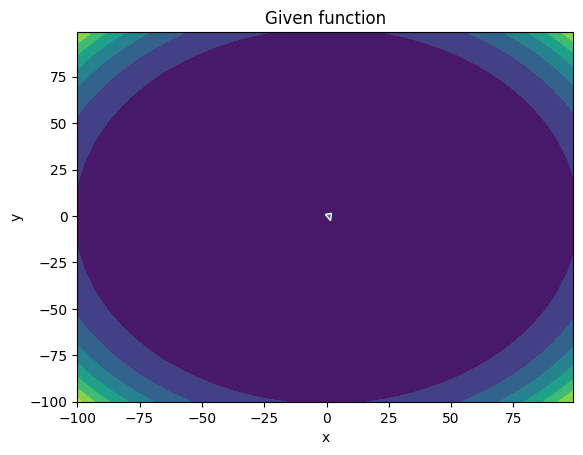

-------
Initial Coordinates:
[[0.76163277]
 [1.13549724]]
Final Coordinates:
[[0.76253922]
 [1.12122485]]
Gradient:
[[ 0.12141282]
 [48.57591247]]


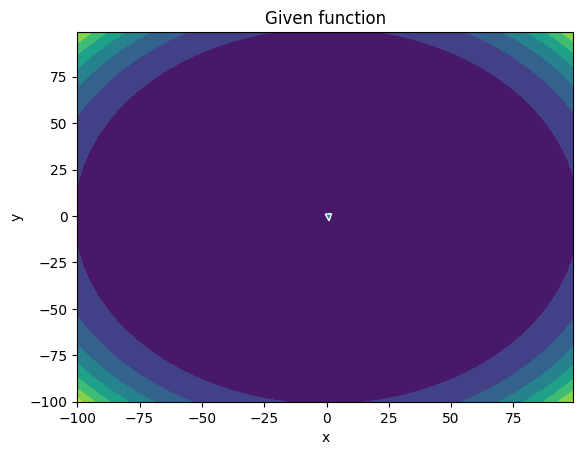

-------
Initial Coordinates:
[[0.76253922]
 [1.12122485]]
Final Coordinates:
[[0.75994566]
 [1.10714693]]
Gradient:
[[ 0.17791052]
 [45.29846559]]


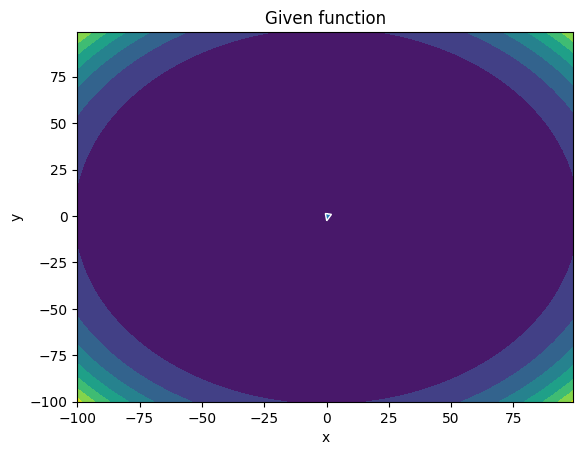

-------
Initial Coordinates:
[[0.75994566]
 [1.10714693]]
Final Coordinates:
[[0.76525538]
 [1.0932682 ]]
Gradient:
[[-0.38842435]
 [41.79877918]]


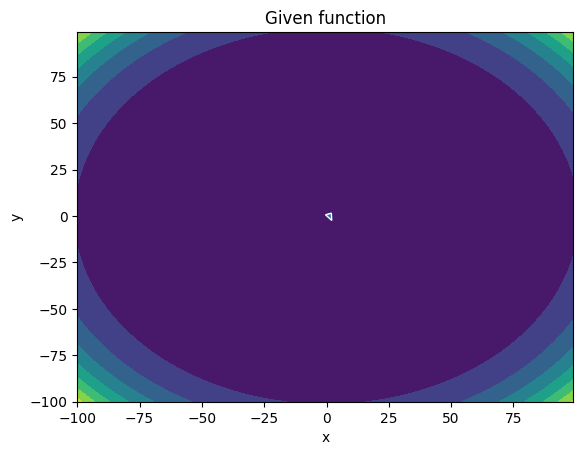

-------
Initial Coordinates:
[[0.76525538]
 [1.0932682 ]]
Final Coordinates:
[[0.75999398]
 [1.07958073]]
Gradient:
[[ 0.50691683]
 [39.48319469]]


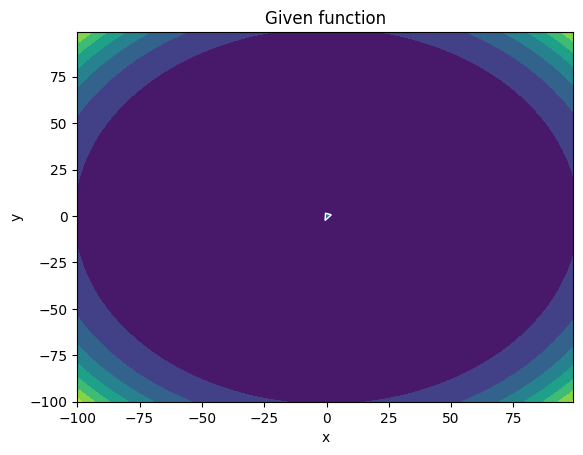

-------
Initial Coordinates:
[[0.75999398]
 [1.07958073]]
Final Coordinates:
[[0.76448064]
 [1.06609365]]
Gradient:
[[-0.46401472]
 [36.09330102]]


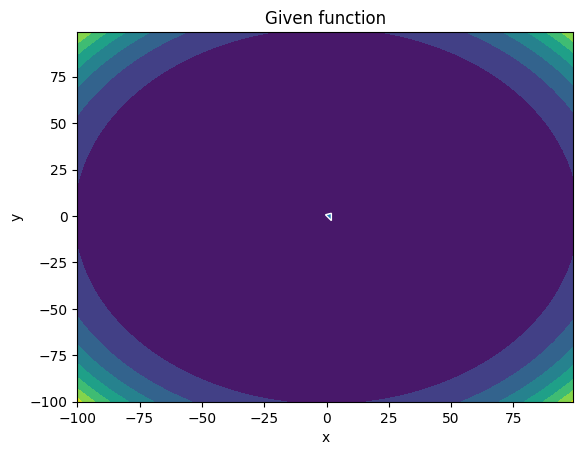

-------
Initial Coordinates:
[[0.76448064]
 [1.06609365]]
Final Coordinates:
[[0.76278328]
 [1.0528    ]]
Gradient:
[[ 0.28452518]
 [34.016193  ]]


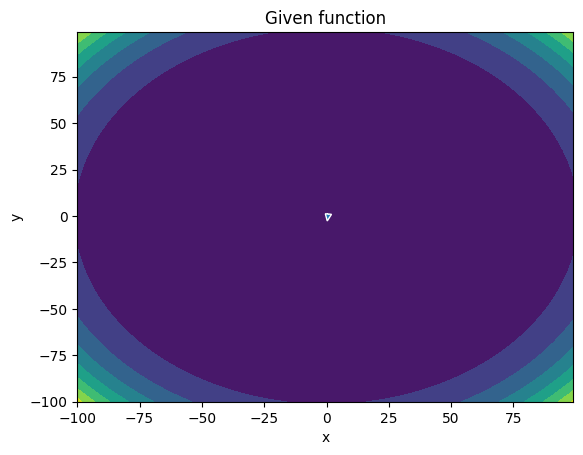

-------
Initial Coordinates:
[[0.76278328]
 [1.0528    ]]
Final Coordinates:
[[0.76131729]
 [1.0397031 ]]
Gradient:
[[-6.61580204e-03]
 [ 3.14137759e+01]]


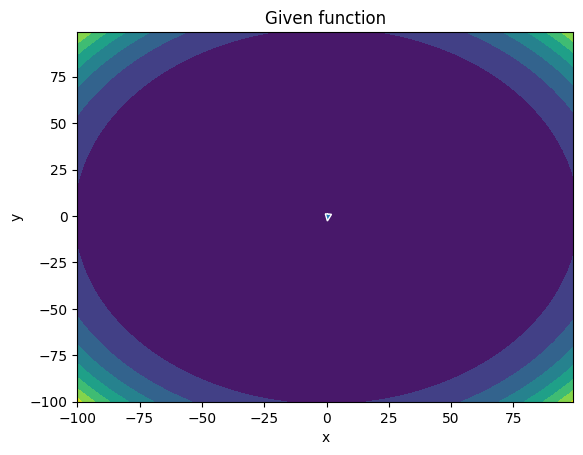

-------
Initial Coordinates:
[[0.76131729]
 [1.0397031 ]]
Final Coordinates:
[[0.7650738 ]
 [1.02680569]]
Gradient:
[[-0.2264494]
 [29.0122362]]


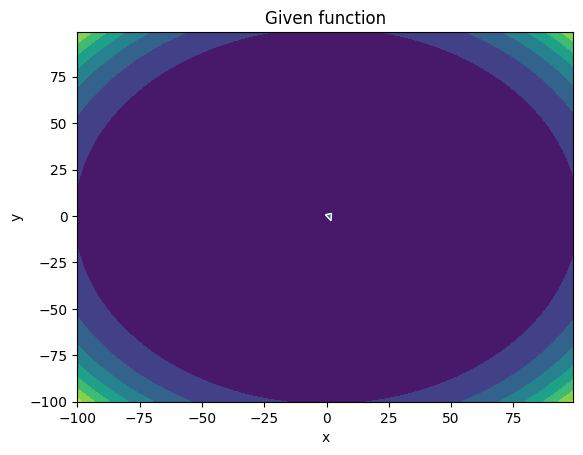

-------
Initial Coordinates:
[[0.7650738 ]
 [1.02680569]]
Final Coordinates:
[[0.75934946]
 [1.01410162]]
Gradient:
[[ 0.3997943 ]
 [27.28702264]]


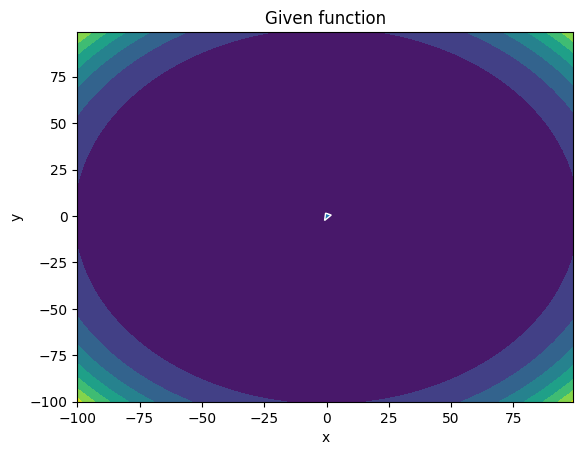

-------
Initial Coordinates:
[[0.75934946]
 [1.01410162]]
Final Coordinates:
[[0.76413245]
 [1.00160096]]
Gradient:
[[-0.43469216]
 [24.78069615]]


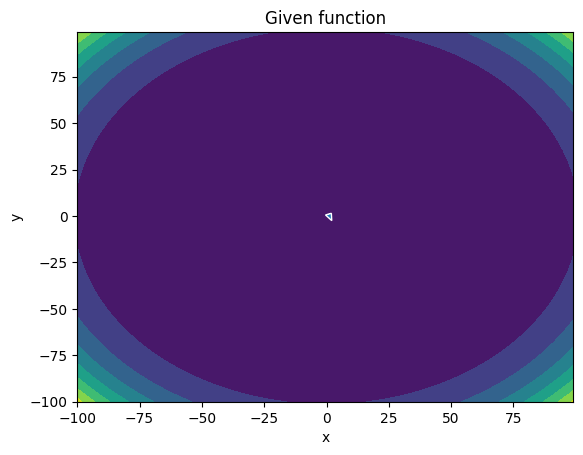

-------
Initial Coordinates:
[[0.76413245]
 [1.00160096]]
Final Coordinates:
[[0.76042491]
 [0.98929537]]
Gradient:
[[ 0.34749825]
 [23.39958634]]


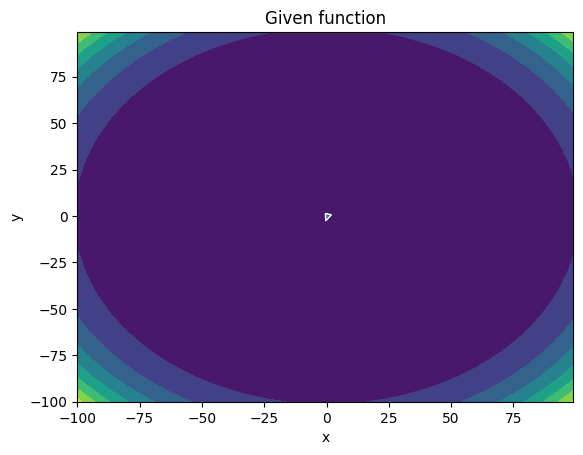

-------
Initial Coordinates:
[[0.76042491]
 [0.98929537]]
Final Coordinates:
[[0.75992584]
 [0.97719147]]
Gradient:
[[-0.12284999]
 [21.37137371]]


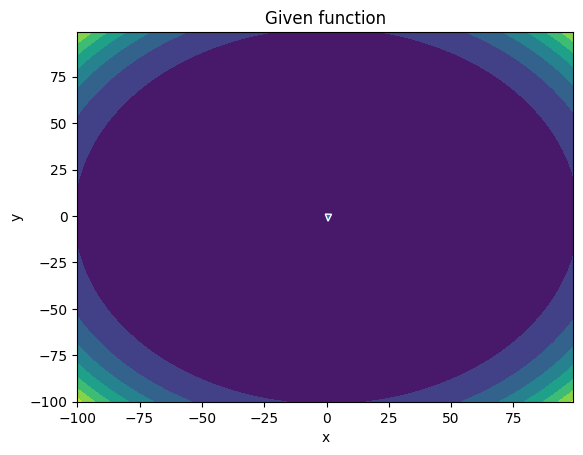

-------
Initial Coordinates:
[[0.75992584]
 [0.97719147]]
Final Coordinates:
[[0.76206671]
 [0.96528995]]
Gradient:
[[-0.10179749]
 [19.75304966]]


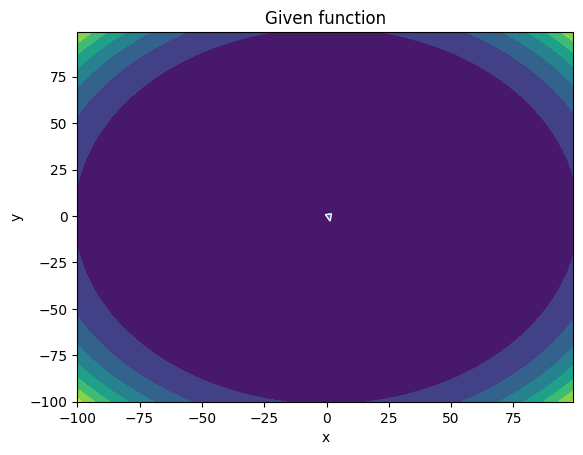

-------
Initial Coordinates:
[[0.76206671]
 [0.96528995]]
Final Coordinates:
[[0.75629576]
 [0.95358675]]
Gradient:
[[ 0.29513108]
 [18.4570662 ]]


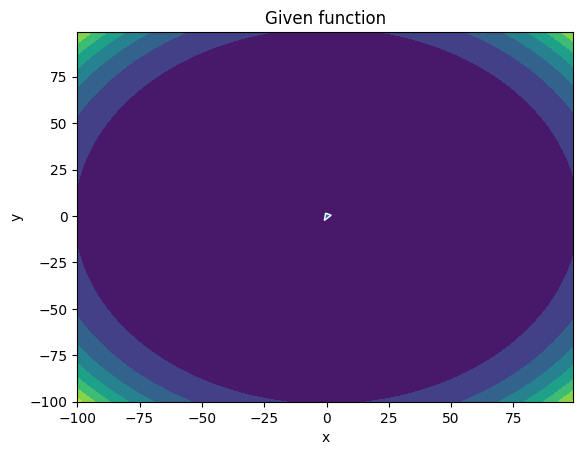

-------
Initial Coordinates:
[[0.75629576]
 [0.95358675]]
Final Coordinates:
[[0.76086925]
 [0.94209202]]
Gradient:
[[-0.37207347]
 [16.64503337]]


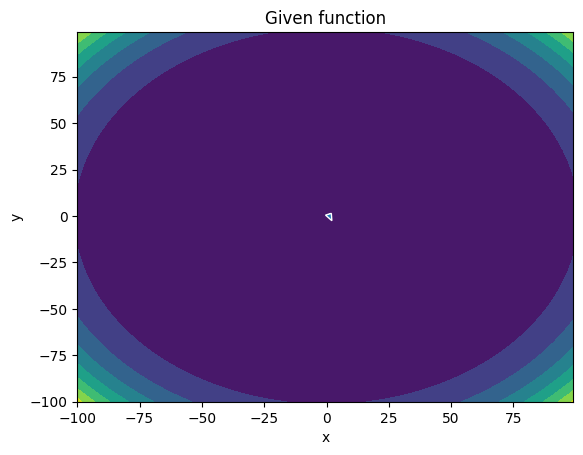

-------
Initial Coordinates:
[[0.76086925]
 [0.94209202]]
Final Coordinates:
[[0.75568015]
 [0.93079686]]
Gradient:
[[ 0.35272108]
 [15.71942434]]


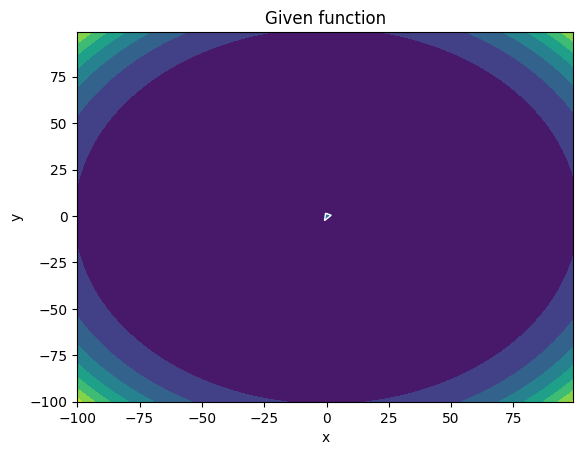

-------
Initial Coordinates:
[[0.75568015]
 [0.93079686]]
Final Coordinates:
[[0.75594994]
 [0.91971041]]
Gradient:
[[-0.18629492]
 [14.17066901]]


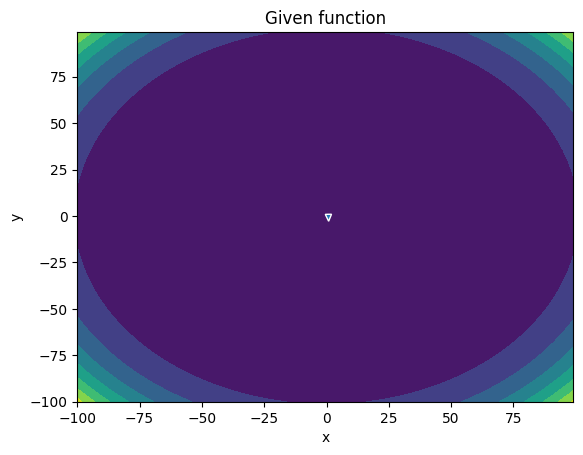

-------
Initial Coordinates:
[[0.75594994]
 [0.91971041]]
Final Coordinates:
[[0.75654165]
 [0.90883142]]
Gradient:
[[-1.15794827e-02]
 [ 1.31009988e+01]]


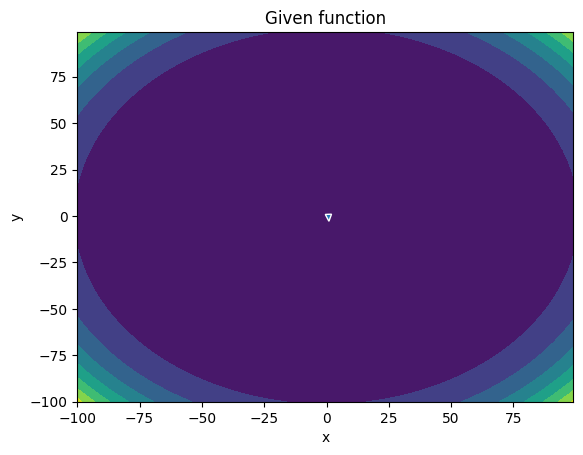

-------
Initial Coordinates:
[[0.75654165]
 [0.90883142]]
Final Coordinates:
[[0.7509494 ]
 [0.89815798]]
Gradient:
[[ 0.2048872 ]
 [12.12744835]]


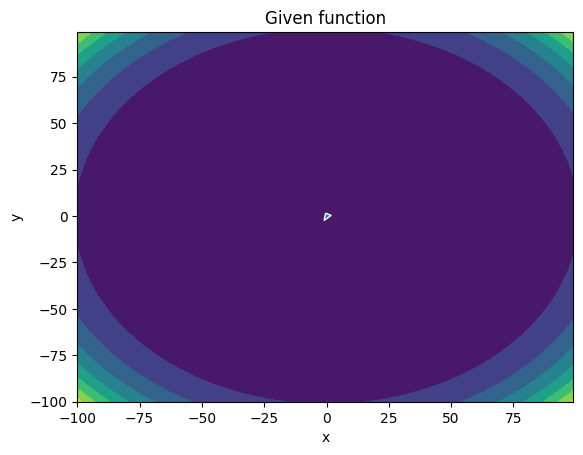

-------
Initial Coordinates:
[[0.7509494 ]
 [0.89815798]]
Final Coordinates:
[[0.75508315]
 [0.88769982]]
Gradient:
[[-0.30464029]
 [10.8435282 ]]


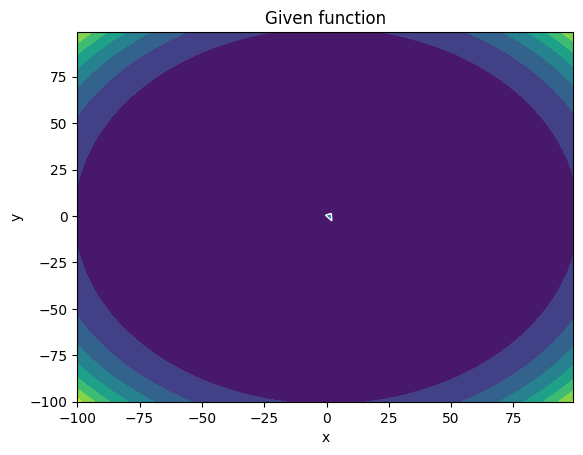

-------
Initial Coordinates:
[[0.75508315]
 [0.88769982]]
Final Coordinates:
[[0.74876387]
 [0.87744787]]
Gradient:
[[ 0.33232604]
 [10.22524666]]


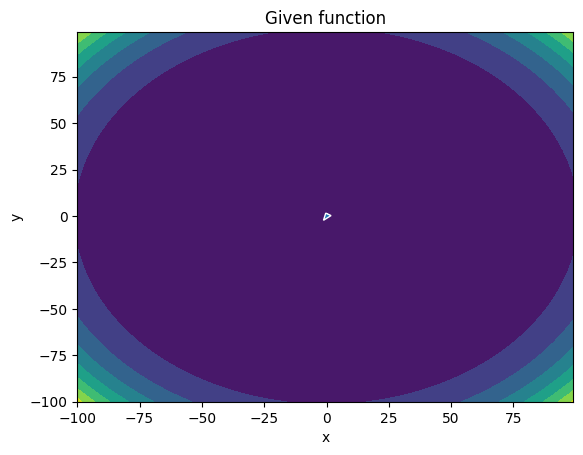

-------
Initial Coordinates:
[[0.74876387]
 [0.87744787]]
Final Coordinates:
[[0.74974155]
 [0.8674133 ]]
Gradient:
[[-0.21977145]
 [ 9.06147117]]


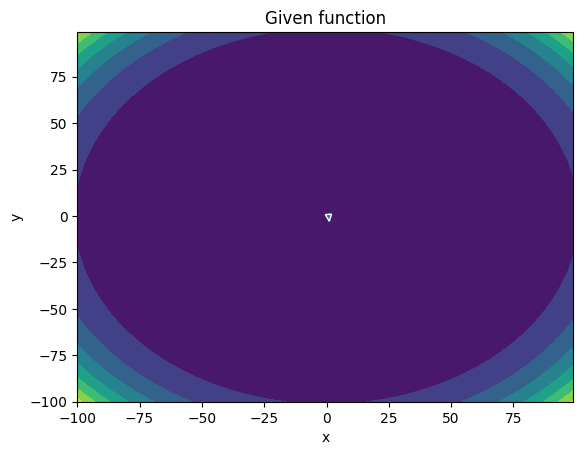

-------
Initial Coordinates:
[[0.74974155]
 [0.8674133 ]]
Final Coordinates:
[[0.74881554]
 [0.85759282]]
Gradient:
[[0.05663601]
 [8.37717203]]


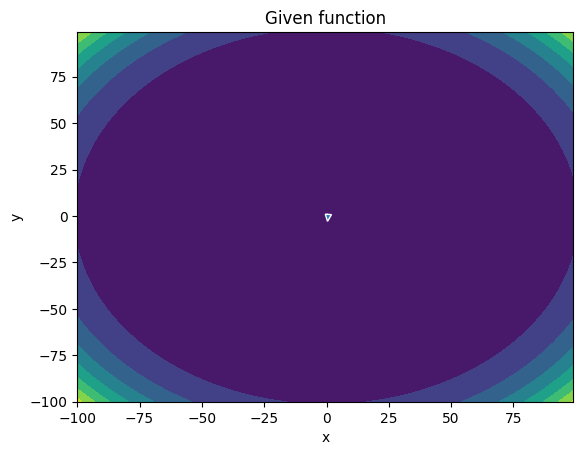

-------
Initial Coordinates:
[[0.74881554]
 [0.85759282]]
Final Coordinates:
[[0.74363106]
 [0.8479869 ]]
Gradient:
[[0.12639197]
 [7.64450568]]


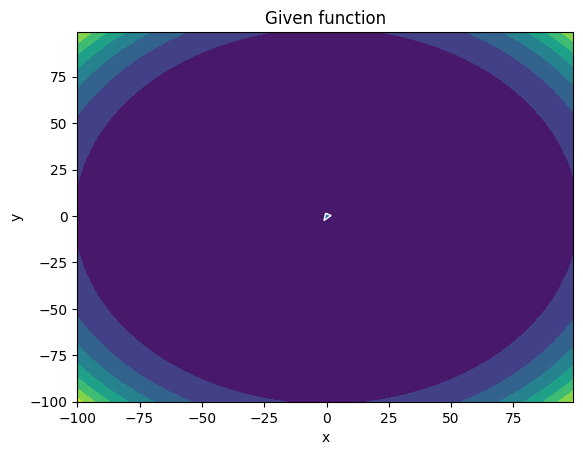

-------
Initial Coordinates:
[[0.74363106]
 [0.8479869 ]]
Final Coordinates:
[[0.74719018]
 [0.83860424]]
Gradient:
[[-0.23923841]
 [ 6.75779582]]


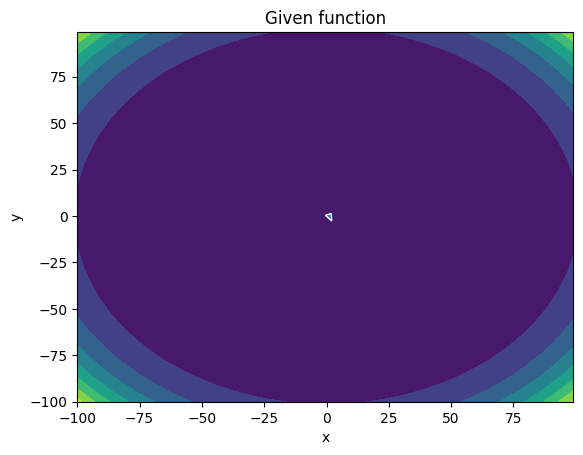

-------
Initial Coordinates:
[[0.74719018]
 [0.83860424]]
Final Coordinates:
[[0.74002469]
 [0.82943603]]
Gradient:
[[0.29965759]
 [6.34774032]]


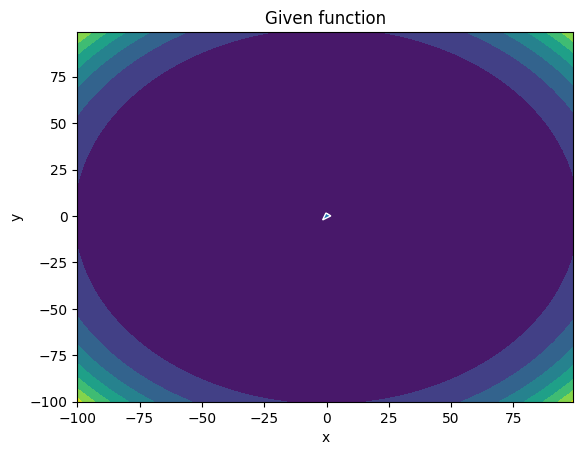

-------
Initial Coordinates:
[[0.74002469]
 [0.82943603]]
Final Coordinates:
[[0.74176095]
 [0.82049499]]
Gradient:
[[-0.23604394]
 [ 5.48640799]]


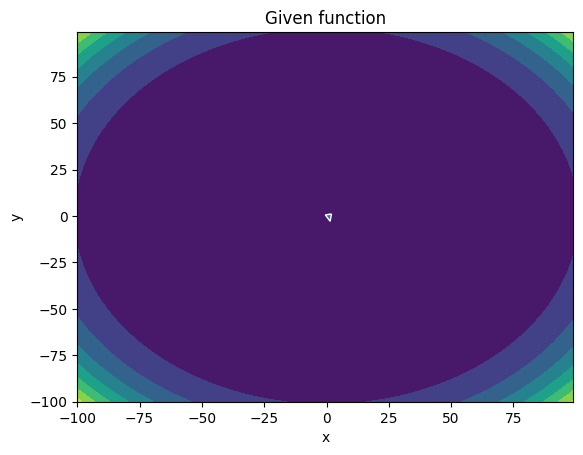

-------
Initial Coordinates:
[[0.74176095]
 [0.82049499]]
Final Coordinates:
[[0.73928912]
 [0.81177567]]
Gradient:
[[0.11179416]
 [5.0722832 ]]


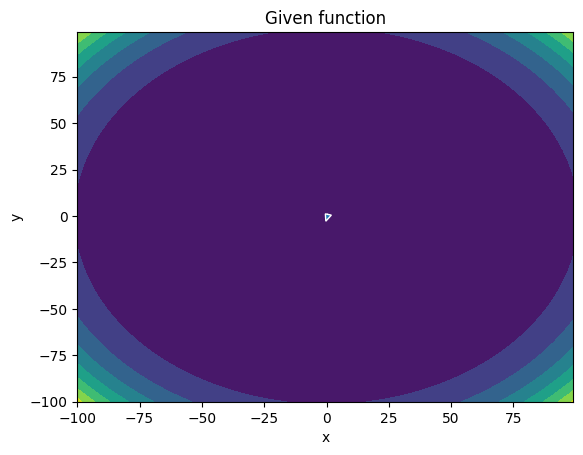

-------
Initial Coordinates:
[[0.73928912]
 [0.81177567]]
Final Coordinates:
[[0.73482285]
 [0.80328121]]
Gradient:
[[0.05509534]
 [4.51696042]]


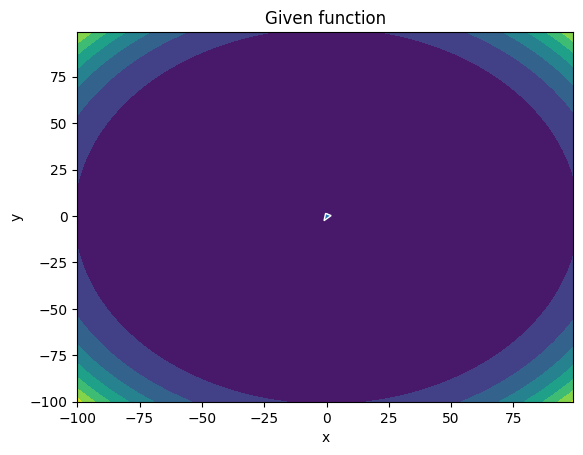

-------
Initial Coordinates:
[[0.73482285]
 [0.80328121]]
Final Coordinates:
[[0.73766262]
 [0.79501863]]
Gradient:
[[-0.17568002]
 [ 3.92746823]]


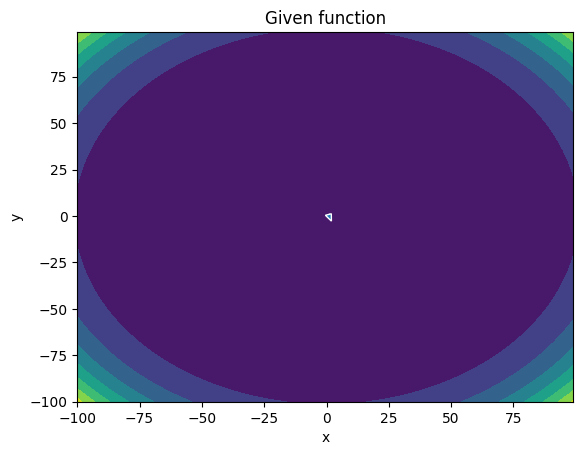

-------
Initial Coordinates:
[[0.73766262]
 [0.79501863]]
Final Coordinates:
[[0.72998108]
 [0.78697988]]
Gradient:
[[0.25857473]
 [3.65554447]]


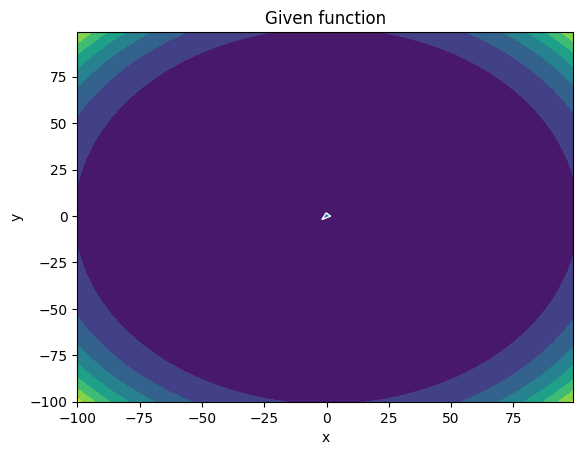

-------
Initial Coordinates:
[[0.72998108]
 [0.78697988]]
Final Coordinates:
[[0.7325583 ]
 [0.77917874]]
Gradient:
[[-0.23958855]
 [ 3.03009177]]


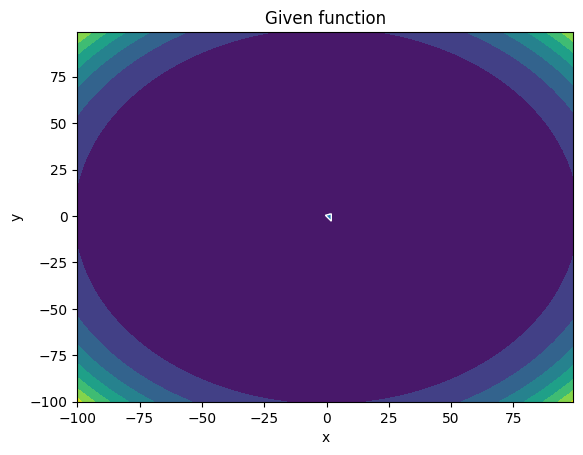

-------
Initial Coordinates:
[[0.7325583 ]
 [0.77917874]]
Final Coordinates:
[[0.72848112]
 [0.77160742]]
Gradient:
[[0.15779703]
 [2.80198872]]


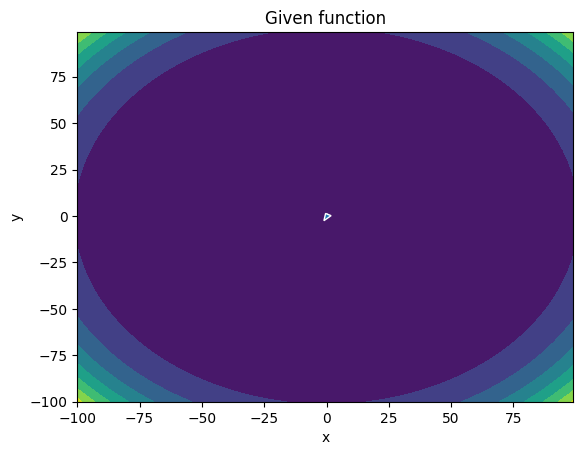

-------
Initial Coordinates:
[[0.72848112]
 [0.77160742]]
Final Coordinates:
[[0.72515407]
 [0.76427225]]
Gradient:
[[-0.01248723]
 [ 2.37577658]]


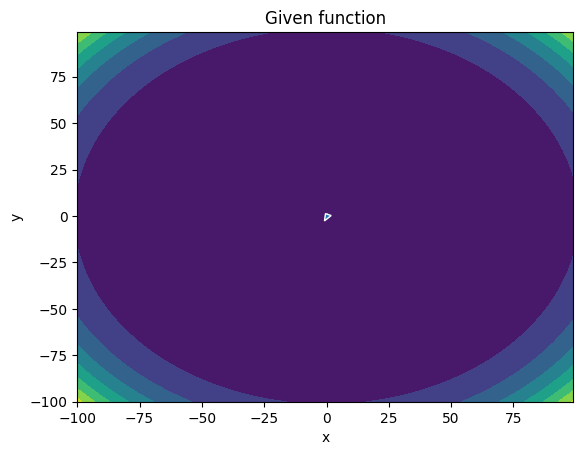

-------
Initial Coordinates:
[[0.72515407]
 [0.76427225]]
Final Coordinates:
[[0.72706592]
 [0.75717773]]
Gradient:
[[-0.11184658]
 [ 2.00750548]]


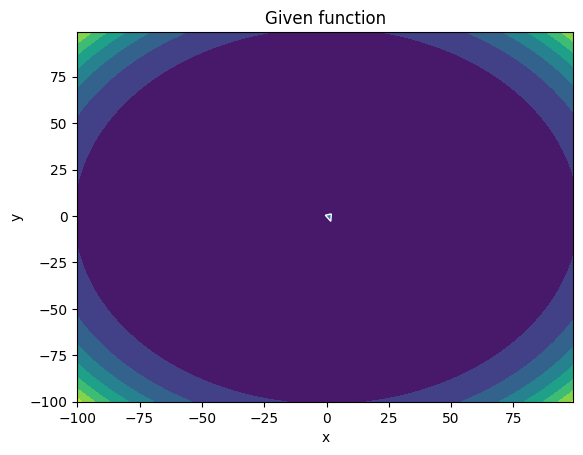

-------
Initial Coordinates:
[[0.72706592]
 [0.75717773]]
Final Coordinates:
[[0.7193244 ]
 [0.75031733]]
Gradient:
[[0.2096246]
 [1.8232279]]


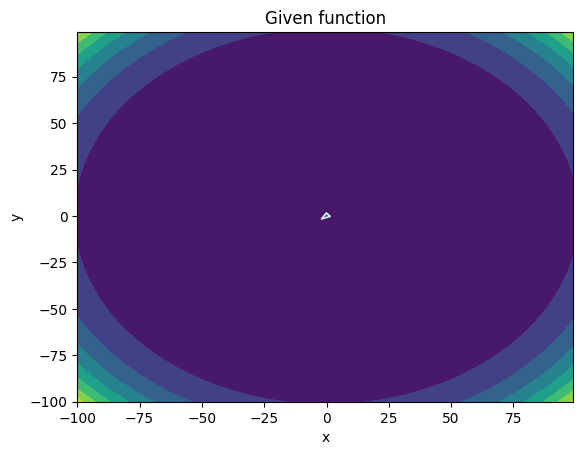

-------
Initial Coordinates:
[[0.7193244 ]
 [0.75031733]]
Final Coordinates:
[[0.7227596 ]
 [0.74370516]]
Gradient:
[[-0.23059881]
 [ 1.38165907]]


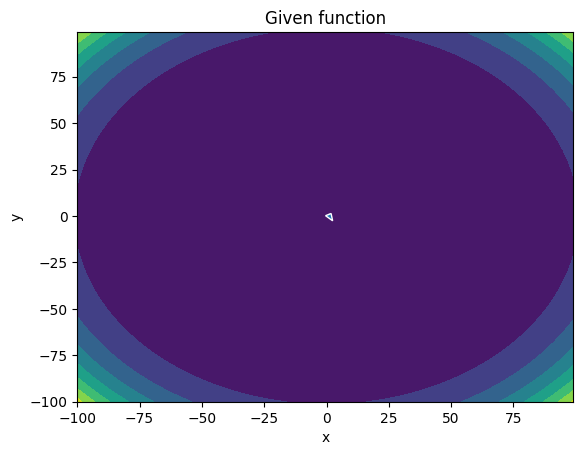

-------
Initial Coordinates:
[[0.7227596 ]
 [0.74370516]]
Final Coordinates:
[[0.71705227]
 [0.7373312 ]]
Gradient:
[[0.19420567]
 [1.27638444]]


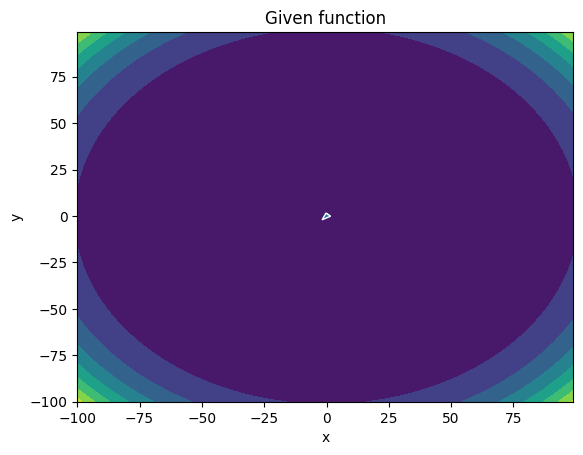

-------
Initial Coordinates:
[[0.71705227]
 [0.7373312 ]]
Final Coordinates:
[[0.71538843]
 [0.73120548]]
Gradient:
[[-0.07796072]
 [ 0.94431294]]


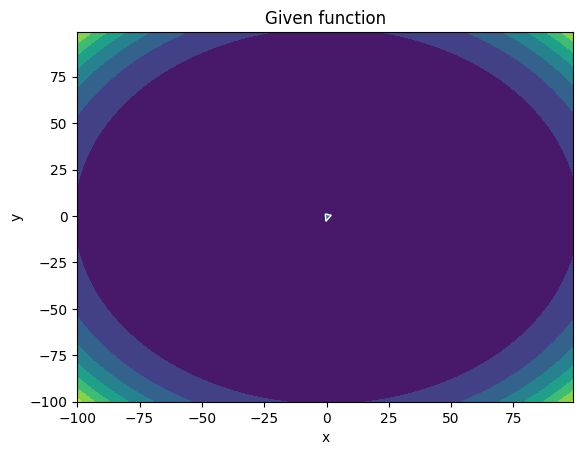

-------
Initial Coordinates:
[[0.71538843]
 [0.73120548]]
Final Coordinates:
[[0.716088  ]
 [0.72532904]]
Gradient:
[[-0.04543282]
 [ 0.73929041]]


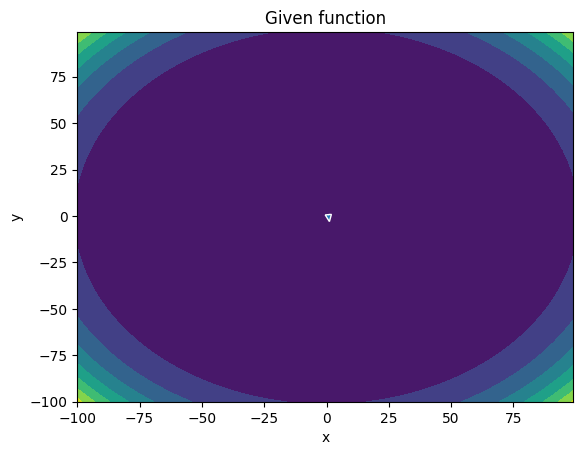

-------
Initial Coordinates:
[[0.716088  ]
 [0.72532904]]
Final Coordinates:
[[0.70890045]
 [0.71969785]]
Gradient:
[[0.15328487]
 [0.60690113]]


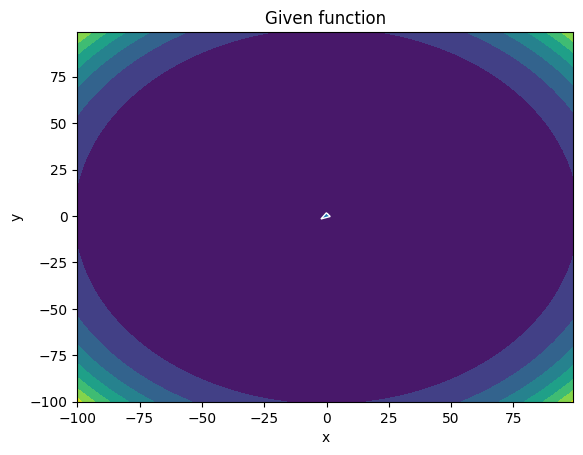

-------
Initial Coordinates:
[[0.70890045]
 [0.71969785]]
Final Coordinates:
[[0.7130223 ]
 [0.71432547]]
Gradient:
[[-0.20787875]
 [ 0.3085119 ]]


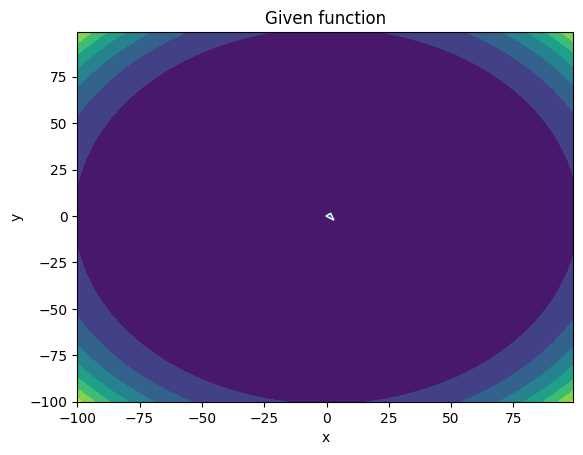

-------
Initial Coordinates:
[[0.7130223 ]
 [0.71432547]]
Final Coordinates:
[[0.70586303]
 [0.70920013]]
Gradient:
[[0.21570352]
 [0.27786481]]


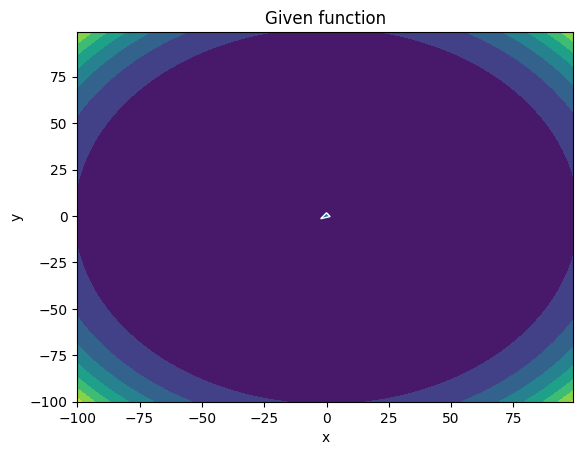

-------
Initial Coordinates:
[[0.70586303]
 [0.70920013]]
Final Coordinates:
[[0.70635707]
 [0.70433592]]
Gradient:
[[-0.13790728]
 [ 0.01735104]]


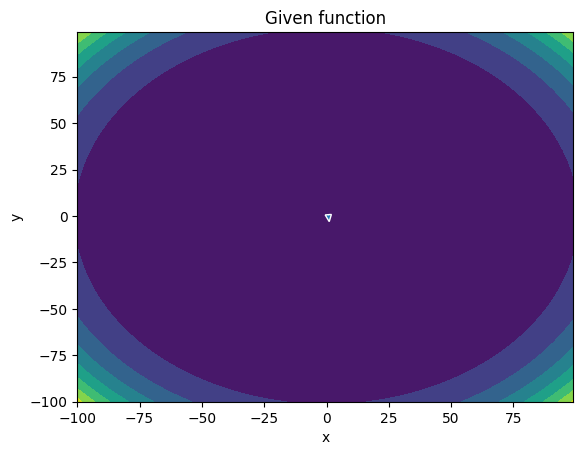

-------
Initial Coordinates:
[[0.70635707]
 [0.70433592]]
Final Coordinates:
[[0.70557753]
 [0.69972937]]
Gradient:
[[ 0.0229859 ]
 [-0.07021741]]


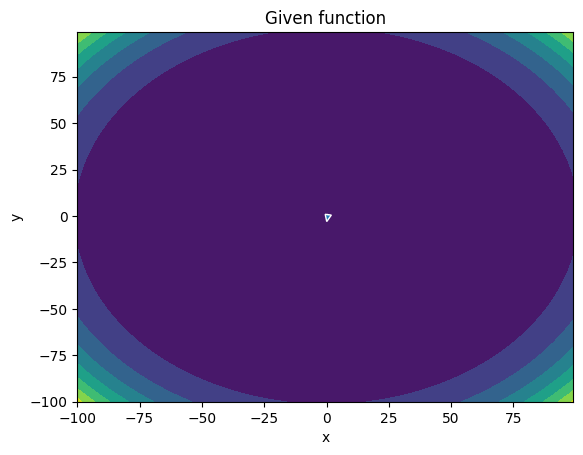

-------
Initial Coordinates:
[[0.70557753]
 [0.69972937]]
Final Coordinates:
[[0.69960321]
 [0.69538021]]
Gradient:
[[ 0.09299378]
 [-0.17376275]]


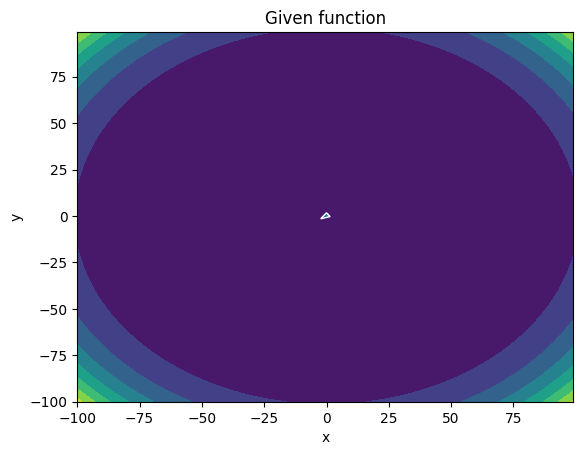

-------
Initial Coordinates:
[[0.69960321]
 [0.69538021]]
Final Coordinates:
[[0.70405546]
 [0.69130042]]
Gradient:
[[-0.17416632]
 [-0.36280192]]


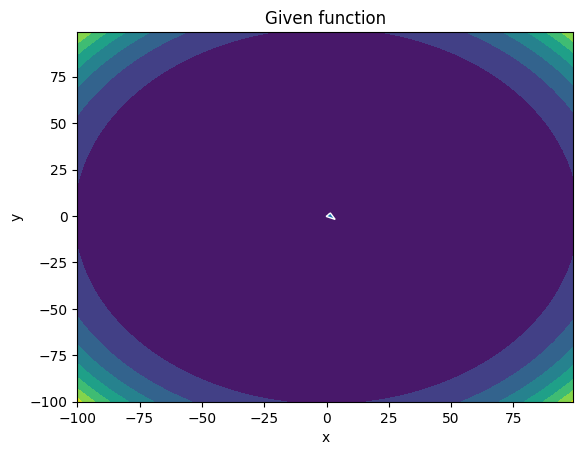

In [77]:
# Adam Optimizer

np.random.seed(42)
params = np.random.rand(2, 1)*100
beta1 = 0.9
beta2 = 0.9
step_size = 0.1
epsilon = 0.001

dx = gradient_x1(params[0], params[1]) # Gradient with respect to x computed by hand
dy = gradient_y1(params[0], params[1]) # Gradient with respect to y computed by hand

final_gradient = np.array([dx, dy])
initial_gradient = np.array([[0],[0]])

Vdw = 0.0
Sdw = 0.0
t = 1

while np.all(step_size*abs(final_gradient - initial_gradient) > epsilon) :
    initial_gradient = final_gradient
    
    Vdw = beta1*Vdw + (1-beta1)*initial_gradient # Averaging out the gradients to smoothen the descent and give it momentum in the direction of descent
    Sdw = beta2*Sdw + (1-beta2)*initial_gradient*initial_gradient

    Vdwcorrected = Vdw/(1 - beta1**t)
    Sdwcorrected = Sdw/(1 - beta2**t)
    
    paramsf = params - step_size*(Vdwcorrected/(np.sqrt(Sdwcorrected) + epsilon)) # Taking the jump using the velocity term above

    dx = gradient_x1(paramsf[0], paramsf[1]) # Getting gradients of new parameters
    dy = gradient_y1(paramsf[0], paramsf[1])

    final_gradient = np.array([dx, dy])
    print('-------')
    print('Initial Coordinates:')
    print(params)
    print('Final Coordinates:')
    print(paramsf)
    print('Gradient:')
    print(initial_gradient)
    
    plt.figure()
    plt.contourf(X, Y, Function)
    plt.arrow(np.squeeze(params[0]), np.squeeze(params[1]), np.squeeze(paramsf[0] - params[0]), np.squeeze(paramsf[1] - params[1]), head_width = 2.5, width = 0.5, ec = 'white')
    plt.xlabel('x')
    plt.ylabel('y')
    plt.title('Given function')
    plt.show()

    params = paramsf
    t += 1

As we can observe, the descent may have been slow but it lead to convergence to the optimal point more better. This shows that adam optimization gives better results.

This marks the end of the forst 2 questions of assignment 1